# Dataset 3

**Study Case**

Perusahaan XYZ merupakan perusahaan hedge fund reksadana. Perusahaan Hedge Fund merupakan perusahaan pengumpul dana masyarakat yang dipercaya masyarakat untuk mengelola dana dengan tujuan investasi/mengembangkan dana masyarakat. Dengan tujuan tersebut, perusahaan hedge fund berkewajiban untuk memastikan pengembalian dana investasi semaksimal mungkin dan sebisa mungkin diatas dari bunga deposito perbankan. Selama masa covid (2020 - 2022), performa perusahaan XYZ dalam pengembalian dana masyarakat mengalami dibawah bunga deposito yang diharapkan. Hal ini berakibatturunnya dana pengelolaan sebanyak 35%.


Dalam skenario ini, kamu direkrut oleh perusahaan hedge fund reksadana XYZ sebagai data scientist consultant dengan tujuan memberikan actionable insight terhadap perubahan-perubahan yang terjadi terutama semenjak covid terjadi dan memastikan tujuan dari perusahaan XYZ tercapai (yaitu memastikan pengembalian dana masyarakat semaksimal mungkin) pada tahun-tahun mendatang. Dikarenakan hedge fund XYZ memiliki risk appetite yang telah ditentukan C-level, kamu diminta untuk dapat menganalisa saham perbankan yang memiliki volatilitas yang lebih stabil.


Untuk mencapaitujuan diberikan beberapa data dalam folder.Berikut adalah penjelasannya:
- Balancesheet: berisi data-data mengenai informasi perusahaan setiap tahunnya,
seperti Share Issued, Total Debt, Tangible Book Value, Net Tangible Assets, dan
lain sebagainya.
- Cashflow: berisi data-data mengenai cash flow perusahaan setiap tahunnya.
- Corp_actions: berisi informasi tanggal corp actions dilakukan, yaitu Stock Splits
dan pembagian dividen.
- Historical_value: berisi informasi harga saham dan volume transaksi setiap
harinya
- Income_stat: berisi informasi mengenai NetIncome dari perusahaan tersebut.
- Key_stat :Berisi informasi mengenai valuasi perusahaan terkini.

# Import Library

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
!pip install pmdarima

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.1/2.1 MB 13.3 MB/s eta 0:00:00


In [ ]:
pip install keras-tuner

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 129.1/129.1 kB 1.5 MB/s eta 0:00:00


In [ ]:
pip install pandas_market_calendars

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 106.6/106.6 kB 1.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 192.6/192.6 kB 10.7 MB/s eta 0:00:00


In [ ]:
# Library yang digunakan
import pandas as pd  # Untuk bekerja dengan data dalam bentuk tabel
import numpy as np  # Untuk melakukan operasi matematika pada data
import math  # Untuk melakukan operasi matematika tambahan
import itertools  # Untuk membuat kombinasi dari elemen-elemen data
import matplotlib.pyplot as plt  # Untuk membuat grafik dan visualisasi data
import seaborn as sns  # Untuk membuat visualisasi data yang lebih menarik
import lightgbm as lgb  # Untuk membuat model pembelajaran mesin menggunakan algoritma LightGBM
import tensorflow as tf  # Untuk membuat model pembelajaran mesin menggunakan TensorFlow
from matplotlib.ticker import MaxNLocator  # Untuk mengatur penanda sumbu pada grafik
from sklearn.metrics import mean_absolute_error, mean_squared_error  # Untuk mengukur seberapa baik kinerja model
from statsmodels.tsa.arima.model import ARIMA  # Untuk memodelkan data deret waktu menggunakan metode ARIMA
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf  # Untuk membuat plot ACF dan PACF dari data deret waktu
from statsmodels.tsa.stattools import adfuller  # Untuk melakukan uji keberartian stasioneritas data
from statsmodels.tsa.statespace.sarimax import SARIMAX  # Untuk memodelkan data deret waktu dengan metode SARIMA
from sklearn.preprocessing import MinMaxScaler  # Untuk menyesuaikan skala data agar berada di rentang tertentu
from tensorflow.keras.models import Sequential  # Untuk membuat model neural network secara berurutan
from tensorflow.keras.layers import Dense  # Untuk menambahkan layer dense ke dalam model neural network
from tensorflow.keras.layers import LSTM, GRU  # Untuk menambahkan layer LSTM dan GRU ke dalam model neural network
from pmdarima.arima import auto_arima  # Untuk memodelkan data deret waktu menggunakan ARIMA secara otomatis
from pmdarima.arima import ndiffs  # Untuk menentukan jumlah differencing yang diperlukan pada ARIMA
from kerastuner import HyperModel, RandomSearch  # Untuk menyetel hyperparameter model menggunakan Kerastuner
from kerastuner.engine.hyperparameters import HyperParameters  # Untuk mengatur hyperparameter pada model
from kerastuner.tuners import RandomSearch  # Untuk menyetel hyperparameter model secara acak
from tensorflow.keras.models import load_model  # Untuk memuat kembali model yang sudah disimpan
import pandas_market_calendars as mcal
from pytz import timezone
from IPython.display import Image

# Menyembunyikan peringatan dari scikit-learn
from warnings import simplefilter  # Untuk menyembunyikan peringatan dari scikit-learn
simplefilter(action='ignore', category=FutureWarning)  # Menyembunyikan peringatan FutureWarning
simplefilter(action='ignore', category=DeprecationWarning)  # Menyembunyikan peringatan DeprecationWarning

# Menyembunyikan peringatan umum
import warnings  # Untuk menangani peringatan
warnings.filterwarnings('ignore')  # Menyembunyikan semua jenis peringatan


<ipython-input-6-8ed56140d31d>:22: DeprecationWarning: `import kerastuner` is deprecated, please use `import keras_tuner`.
  from kerastuner import HyperModel, RandomSearch  # Untuk menyetel hyperparameter model menggunakan Kerastuner


# Import Data

In [ ]:
# data dalam dataset

# balancesheet
arto_balancesheet = pd.read_csv("/content/drive/MyDrive/Dataset_Bank/balancesheet/arto_balance_sheet.csv")
bank_balancesheet = pd.read_csv("/content/drive/MyDrive/Dataset_Bank/balancesheet/bank_balance_sheet.csv")
bbca_balancesheet = pd.read_csv("/content/drive/MyDrive/Dataset_Bank/balancesheet/bbca_balance_sheet.csv")
bbni_balancesheet = pd.read_csv("/content/drive/MyDrive/Dataset_Bank/balancesheet/bbni_balance_sheet.csv")
bbri_balancesheet = pd.read_csv("/content/drive/MyDrive/Dataset_Bank/balancesheet/bbri_balance_sheet.csv")
bbtn_balancesheet = pd.read_csv("/content/drive/MyDrive/Dataset_Bank/balancesheet/bbtn_balance_sheet.csv")
bbyb_balancesheet = pd.read_csv("/content/drive/MyDrive/Dataset_Bank/balancesheet/bbyb_balance_sheet.csv")
bmri_balancesheet = pd.read_csv("/content/drive/MyDrive/Dataset_Bank/balancesheet/bmri_balance_sheet.csv")
bnga_balancesheet = pd.read_csv("/content/drive/MyDrive/Dataset_Bank/balancesheet/bnga_balance_sheet.csv")
bris_balancesheet = pd.read_csv("/content/drive/MyDrive/Dataset_Bank/balancesheet/bris_balance_sheet.csv")
mega_balancesheet = pd.read_csv("/content/drive/MyDrive/Dataset_Bank/balancesheet/mega_balance_sheet.csv")
nisp_balancesheet = pd.read_csv("/content/drive/MyDrive/Dataset_Bank/balancesheet/nisp_balance_sheet.csv")

# cashflow
arto_cashflow = pd.read_csv("/content/drive/MyDrive/Dataset_Bank/cashflow/arto_cashflow.csv")
bank_cashflow = pd.read_csv("/content/drive/MyDrive/Dataset_Bank/cashflow/bank_cashflow.csv")
bbca_cashflow = pd.read_csv("/content/drive/MyDrive/Dataset_Bank/cashflow/bbca_cashflow.csv")
bbni_cashflow = pd.read_csv("/content/drive/MyDrive/Dataset_Bank/cashflow/bbni_cashflow.csv")
bbri_cashflow = pd.read_csv("/content/drive/MyDrive/Dataset_Bank/cashflow/bbri_cashflow.csv")
bbtn_cashflow = pd.read_csv("/content/drive/MyDrive/Dataset_Bank/cashflow/bbtn_cashflow.csv")
bbyb_cashflow = pd.read_csv("/content/drive/MyDrive/Dataset_Bank/cashflow/bbyb_cashflow.csv")
bmri_cashflow = pd.read_csv("/content/drive/MyDrive/Dataset_Bank/cashflow/bmri_cashflow.csv")
bnga_cashflow = pd.read_csv("/content/drive/MyDrive/Dataset_Bank/cashflow/bnga_cashflow.csv")
bris_cashflow = pd.read_csv("/content/drive/MyDrive/Dataset_Bank/cashflow/bris_cashflow.csv")
mega_cashflow = pd.read_csv("/content/drive/MyDrive/Dataset_Bank/cashflow/mega_cashflow.csv")
nisp_cashflow = pd.read_csv("/content/drive/MyDrive/Dataset_Bank/cashflow/nisp_cashflow.csv")

# income stat
arto_income_stat = pd.read_csv("/content/drive/MyDrive/Dataset_Bank/income_stat/arto_income_stat.csv")
bank_income_stat = pd.read_csv("/content/drive/MyDrive/Dataset_Bank/income_stat/bank_income_stat.csv")
bbca_income_stat = pd.read_csv("/content/drive/MyDrive/Dataset_Bank/income_stat/bbca_income_stat.csv")
bbni_income_stat = pd.read_csv("/content/drive/MyDrive/Dataset_Bank/income_stat/bbni_income_stat.csv")
bbri_income_stat = pd.read_csv("/content/drive/MyDrive/Dataset_Bank/income_stat/bbri_income_stat.csv")
bbtn_income_stat = pd.read_csv("/content/drive/MyDrive/Dataset_Bank/income_stat/bbtn_income_stat.csv")
bbyb_income_stat = pd.read_csv("/content/drive/MyDrive/Dataset_Bank/income_stat/bbyb_income_stat.csv")
bmri_income_stat = pd.read_csv("/content/drive/MyDrive/Dataset_Bank/income_stat/bmri_income_stat.csv")
bnga_income_stat = pd.read_csv("/content/drive/MyDrive/Dataset_Bank/income_stat/bnga_income_stat.csv")
bris_income_stat = pd.read_csv("/content/drive/MyDrive/Dataset_Bank/income_stat/bris_income_stat.csv")
mega_income_stat = pd.read_csv("/content/drive/MyDrive/Dataset_Bank/income_stat/mega_income_stat.csv")
nisp_income_stat = pd.read_csv("/content/drive/MyDrive/Dataset_Bank/income_stat/nisp_income_stat.csv")

# keystat
arto_keystat = pd.read_csv("/content/drive/MyDrive/Dataset_Bank/keystat/arto_keystat.csv")
bank_keystat = pd.read_csv("/content/drive/MyDrive/Dataset_Bank/keystat/bank_keystat.csv")
bbca_keystat = pd.read_csv("/content/drive/MyDrive/Dataset_Bank/keystat/bbca_keystat.csv")
bbni_keystat = pd.read_csv("/content/drive/MyDrive/Dataset_Bank/keystat/bbni_keystat.csv")
bbri_keystat = pd.read_csv("/content/drive/MyDrive/Dataset_Bank/keystat/bbri_keystat.csv")
bbtn_keystat = pd.read_csv("/content/drive/MyDrive/Dataset_Bank/keystat/bbtn_keystat.csv")
bbyb_keystat = pd.read_csv("/content/drive/MyDrive/Dataset_Bank/keystat/bbyb_keystat.csv")
bmri_keystat = pd.read_csv("/content/drive/MyDrive/Dataset_Bank/keystat/bmri_keystat.csv")
bnga_keystat = pd.read_csv("/content/drive/MyDrive/Dataset_Bank/keystat/bnga_keystat.csv")
bris_keystat = pd.read_csv("/content/drive/MyDrive/Dataset_Bank/keystat/bris_keystat.csv")
mega_keystat = pd.read_csv("/content/drive/MyDrive/Dataset_Bank/keystat/mega_keystat.csv")
nisp_keystat = pd.read_csv("/content/drive/MyDrive/Dataset_Bank/keystat/nisp_keystat.csv")

# historical
arto_hist = pd.read_csv("/content/drive/MyDrive/Dataset_Bank/historical_value/arto_hist.csv")
bank_hist = pd.read_csv("/content/drive/MyDrive/Dataset_Bank/historical_value/bank_hist.csv")
bbca_hist = pd.read_csv("/content/drive/MyDrive/Dataset_Bank/historical_value/bbca_hist.csv")
bbni_hist = pd.read_csv("/content/drive/MyDrive/Dataset_Bank/historical_value/bbni_hist.csv")
bbri_hist = pd.read_csv("/content/drive/MyDrive/Dataset_Bank/historical_value/bbri_hist.csv")
bbtn_hist = pd.read_csv("/content/drive/MyDrive/Dataset_Bank/historical_value/bbtn_hist.csv")
bbyb_hist = pd.read_csv("/content/drive/MyDrive/Dataset_Bank/historical_value/bbyb_hist.csv")
bmri_hist = pd.read_csv("/content/drive/MyDrive/Dataset_Bank/historical_value/bmri_hist.csv")
bnga_hist = pd.read_csv("/content/drive/MyDrive/Dataset_Bank/historical_value/bnga_hist.csv")
bris_hist = pd.read_csv("/content/drive/MyDrive/Dataset_Bank/historical_value/bris_hist.csv")
mega_hist = pd.read_csv("/content/drive/MyDrive/Dataset_Bank/historical_value/mega_hist.csv")
nisp_hist = pd.read_csv("/content/drive/MyDrive/Dataset_Bank/historical_value/nisp_hist.csv")

# Data Preprocessing

## Balancesheet

In [ ]:
# Melihat isi data dari arto_balancesheet
arto_balancesheet

,Unnamed: 0,2023-12-31,2022-12-31,2021-12-31,2020-12-31
0,Ordinary Shares Number,1.385625e+10,1.385625e+10,1.385625e+10,1.309041e+10
1,Share Issued,1.385625e+10,1.385625e+10,1.385625e+10,1.309041e+10
2,Total Debt,5.470800e+10,5.954100e+10,6.364200e+10,7.110100e+10
3,Tangible Book Value,6.963386e+12,7.376270e+12,7.753180e+12,1.082092e+12
4,Net Tangible Assets,6.963386e+12,7.376270e+12,7.753180e+12,1.082092e+12
5,Common Stock Equity,8.356792e+12,8.263757e+12,8.249455e+12,1.232333e+12
6,Total Equity Gross Minority Interest,8.356792e+12,8.263757e+12,8.249455e+12,1.232333e+12
7,Stockholders Equity,8.356792e+12,8.263757e+12,8.249455e+12,1.232333e+12
8,Other Equity Interest,2.048800e+10,NaN,NaN,1.000000e+11
9,Fixed Assets Revaluation Reserve,8.427000e+09,9.932000e+09,8.103000e+09,8.152000e+09


In [ ]:
arto_balancesheet.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 37 entries, 0 to 36
Data columns (total 5 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   Unnamed: 0  37 non-null     object 
 1   2023-12-31  36 non-null     float64
 2   2022-12-31  36 non-null     float64
 3   2021-12-31  36 non-null     float64
 4   2020-12-31  37 non-null     float64
dtypes: float64(4), object(1)
memory usage: 1.6+ KB


In [ ]:
# Transpose dataframe
arto_balancesheet = arto_balancesheet.transpose().rename(columns=arto_balancesheet.iloc[:,0]).drop(index='Unnamed: 0')
arto_balancesheet

,Ordinary Shares Number,Share Issued,Total Debt,Tangible Book Value,Net Tangible Assets,Common Stock Equity,Total Equity Gross Minority Interest,Stockholders Equity,Other Equity Interest,Fixed Assets Revaluation Reserve,...,Gross PPE,Other Properties,Machinery Furniture Equipment,Buildings And Improvements,Land And Improvements,Prepaid Assets,Receivables,Cash And Cash Equivalents,Cash Equivalents,Cash Financial
2023-12-31,13856250000.0,13856250000.0,54708000000.0,6963386000000.0,6963386000000.0,8356792000000.0,8356792000000.0,8356792000000.0,20488000000.0,8427000000.0,...,203860000000.0,46789000000.0,21459000000.0,124460000000.0,11152000000.0,69106000000.0,240395000000.0,2982098000000.0,NaN,8863000000.0
2022-12-31,13856250000.0,13856250000.0,59541000000.0,7376270000000.0,7376270000000.0,8263757000000.0,8263757000000.0,8263757000000.0,NaN,9932000000.0,...,199527000000.0,40979000000.0,21746000000.0,124460000000.0,12342000000.0,70633000000.0,204388000000.0,1479037000000.0,-376000000.0,10107000000.0
2021-12-31,13856250000.0,13856250000.0,63642000000.0,7753180000000.0,7753180000000.0,8249455000000.0,8249455000000.0,8249455000000.0,NaN,8103000000.0,...,175159000000.0,18104000000.0,22623000000.0,123919000000.0,10513000000.0,42635000000.0,130814000000.0,1428037000000.0,-29000000.0,9986000000.0
2020-12-31,13090411968.0,13090411968.0,71101000000.0,1082092000000.0,1082092000000.0,1232333000000.0,1232333000000.0,1232333000000.0,100000000000.0,8152000000.0,...,151855000000.0,12301000000.0,11322000000.0,117719000000.0,10513000000.0,90074000000.0,21704000000.0,450574000000.0,0.0,11283000000.0


In [ ]:
# Sort Index dataframe agar tanggal terurut dari terlama sampai terbaru
arto_balancesheet = arto_balancesheet.sort_index()
arto_balancesheet

,Ordinary Shares Number,Share Issued,Total Debt,Tangible Book Value,Net Tangible Assets,Common Stock Equity,Total Equity Gross Minority Interest,Stockholders Equity,Other Equity Interest,Fixed Assets Revaluation Reserve,...,Gross PPE,Other Properties,Machinery Furniture Equipment,Buildings And Improvements,Land And Improvements,Prepaid Assets,Receivables,Cash And Cash Equivalents,Cash Equivalents,Cash Financial
2020-12-31,13090411968.0,13090411968.0,71101000000.0,1082092000000.0,1082092000000.0,1232333000000.0,1232333000000.0,1232333000000.0,100000000000.0,8152000000.0,...,151855000000.0,12301000000.0,11322000000.0,117719000000.0,10513000000.0,90074000000.0,21704000000.0,450574000000.0,0.0,11283000000.0
2021-12-31,13856250000.0,13856250000.0,63642000000.0,7753180000000.0,7753180000000.0,8249455000000.0,8249455000000.0,8249455000000.0,NaN,8103000000.0,...,175159000000.0,18104000000.0,22623000000.0,123919000000.0,10513000000.0,42635000000.0,130814000000.0,1428037000000.0,-29000000.0,9986000000.0
2022-12-31,13856250000.0,13856250000.0,59541000000.0,7376270000000.0,7376270000000.0,8263757000000.0,8263757000000.0,8263757000000.0,NaN,9932000000.0,...,199527000000.0,40979000000.0,21746000000.0,124460000000.0,12342000000.0,70633000000.0,204388000000.0,1479037000000.0,-376000000.0,10107000000.0
2023-12-31,13856250000.0,13856250000.0,54708000000.0,6963386000000.0,6963386000000.0,8356792000000.0,8356792000000.0,8356792000000.0,20488000000.0,8427000000.0,...,203860000000.0,46789000000.0,21459000000.0,124460000000.0,11152000000.0,69106000000.0,240395000000.0,2982098000000.0,NaN,8863000000.0


In [ ]:
# Transpose & Sort Index Dataframe lain
bank_balancesheet = bank_balancesheet.transpose().rename(columns=bank_balancesheet.iloc[:,0]).drop(index='Unnamed: 0')
bank_balancesheet = bank_balancesheet.sort_index()

bbca_balancesheet = bbca_balancesheet.transpose().rename(columns=bbca_balancesheet.iloc[:,0]).drop(index='Unnamed: 0')
bbca_balancesheet = bbca_balancesheet.sort_index()

bbni_balancesheet = bbni_balancesheet.transpose().rename(columns=bbni_balancesheet.iloc[:,0]).drop(index='Unnamed: 0')
bbni_balancesheet = bank_balancesheet.sort_index()

bbri_balancesheet = bbri_balancesheet.transpose().rename(columns=bbri_balancesheet.iloc[:,0]).drop(index='Unnamed: 0')
bbri_balancesheet = bbri_balancesheet.sort_index()

bbtn_balancesheet = bbtn_balancesheet.transpose().rename(columns=bbtn_balancesheet.iloc[:,0]).drop(index='Unnamed: 0')
bbtn_balancesheet = bbtn_balancesheet.sort_index()

bbyb_balancesheet = bbyb_balancesheet.transpose().rename(columns=bbyb_balancesheet.iloc[:,0]).drop(index='Unnamed: 0')
bbyb_balancesheet = bbyb_balancesheet.sort_index()

bmri_balancesheet = bmri_balancesheet.transpose().rename(columns=bmri_balancesheet.iloc[:,0]).drop(index='Unnamed: 0')
bmri_balancesheet = bmri_balancesheet.sort_index()

bnga_balancesheet = bnga_balancesheet.transpose().rename(columns=bnga_balancesheet.iloc[:,0]).drop(index='Unnamed: 0')
bnga_balancesheet = bnga_balancesheet.sort_index()

bris_balancesheet = bris_balancesheet.transpose().rename(columns=bris_balancesheet.iloc[:,0]).drop(index='Unnamed: 0')
bris_balancesheet = bris_balancesheet.sort_index()

mega_balancesheet = mega_balancesheet.transpose().rename(columns=mega_balancesheet.iloc[:,0]).drop(index='Unnamed: 0')
mega_balancesheet = mega_balancesheet.sort_index()

nisp_balancesheet = nisp_balancesheet.transpose().rename(columns=nisp_balancesheet.iloc[:,0]).drop(index='Unnamed: 0')
nisp_balancesheet = nisp_balancesheet.sort_index()

In [ ]:
# Mengubah tipe data menjadi numerik (float)
arto_balancesheet = arto_balancesheet.astype(np.float64)
bank_balancesheet = bank_balancesheet.astype(np.float64)
bbca_balancesheet = bbca_balancesheet.astype(np.float64)
bbni_balancesheet = bbni_balancesheet.astype(np.float64)
bbri_balancesheet = bbri_balancesheet.astype(np.float64)
bbtn_balancesheet = bbtn_balancesheet.astype(np.float64)
bbyb_balancesheet = bbyb_balancesheet.astype(np.float64)
bmri_balancesheet = bmri_balancesheet.astype(np.float64)
bnga_balancesheet = bnga_balancesheet.astype(np.float64)
bris_balancesheet = bris_balancesheet.astype(np.float64)
mega_balancesheet = mega_balancesheet.astype(np.float64)
nisp_balancesheet = nisp_balancesheet.astype(np.float64)

In [ ]:
arto_balancesheet.info()

<class 'pandas.core.frame.DataFrame'>
Index: 4 entries, 2020-12-31 to 2023-12-31
Data columns (total 37 columns):
 #   Column                                       Non-Null Count  Dtype  
---  ------                                       --------------  -----  
 0   Ordinary Shares Number                       4 non-null      float64
 1   Share Issued                                 4 non-null      float64
 2   Total Debt                                   4 non-null      float64
 3   Tangible Book Value                          4 non-null      float64
 4   Net Tangible Assets                          4 non-null      float64
 5   Common Stock Equity                          4 non-null      float64
 6   Total Equity Gross Minority Interest         4 non-null      float64
 7   Stockholders Equity                          4 non-null      float64
 8   Other Equity Interest                        2 non-null      float64
 9   Fixed Assets Revaluation Reserve             4 non-null      float6

1. Bank Jago

In [ ]:
# Melihat Dataframe
arto_balancesheet

,Ordinary Shares Number,Share Issued,Total Debt,Tangible Book Value,Net Tangible Assets,Common Stock Equity,Total Equity Gross Minority Interest,Stockholders Equity,Other Equity Interest,Fixed Assets Revaluation Reserve,...,Gross PPE,Other Properties,Machinery Furniture Equipment,Buildings And Improvements,Land And Improvements,Prepaid Assets,Receivables,Cash And Cash Equivalents,Cash Equivalents,Cash Financial
2020-12-31,1.309041e+10,1.309041e+10,7.110100e+10,1.082092e+12,1.082092e+12,1.232333e+12,1.232333e+12,1.232333e+12,1.000000e+11,8.152000e+09,...,1.518550e+11,1.230100e+10,1.132200e+10,1.177190e+11,1.051300e+10,9.007400e+10,2.170400e+10,4.505740e+11,0.0,1.128300e+10
2021-12-31,1.385625e+10,1.385625e+10,6.364200e+10,7.753180e+12,7.753180e+12,8.249455e+12,8.249455e+12,8.249455e+12,NaN,8.103000e+09,...,1.751590e+11,1.810400e+10,2.262300e+10,1.239190e+11,1.051300e+10,4.263500e+10,1.308140e+11,1.428037e+12,-29000000.0,9.986000e+09
2022-12-31,1.385625e+10,1.385625e+10,5.954100e+10,7.376270e+12,7.376270e+12,8.263757e+12,8.263757e+12,8.263757e+12,NaN,9.932000e+09,...,1.995270e+11,4.097900e+10,2.174600e+10,1.244600e+11,1.234200e+10,7.063300e+10,2.043880e+11,1.479037e+12,-376000000.0,1.010700e+10
2023-12-31,1.385625e+10,1.385625e+10,5.470800e+10,6.963386e+12,6.963386e+12,8.356792e+12,8.356792e+12,8.356792e+12,2.048800e+10,8.427000e+09,...,2.038600e+11,4.678900e+10,2.145900e+10,1.244600e+11,1.115200e+10,6.910600e+10,2.403950e+11,2.982098e+12,NaN,8.863000e+09


In [ ]:
# Membuat feature baru Total Equity
arto_balancesheet['Total Equity'] = arto_balancesheet['Total Assets'] - arto_balancesheet['Total Debt']
arto_balancesheet

,Ordinary Shares Number,Share Issued,Total Debt,Tangible Book Value,Net Tangible Assets,Common Stock Equity,Total Equity Gross Minority Interest,Stockholders Equity,Other Equity Interest,Fixed Assets Revaluation Reserve,...,Other Properties,Machinery Furniture Equipment,Buildings And Improvements,Land And Improvements,Prepaid Assets,Receivables,Cash And Cash Equivalents,Cash Equivalents,Cash Financial,Total Equity
2020-12-31,1.309041e+10,1.309041e+10,7.110100e+10,1.082092e+12,1.082092e+12,1.232333e+12,1.232333e+12,1.232333e+12,1.000000e+11,8.152000e+09,...,1.230100e+10,1.132200e+10,1.177190e+11,1.051300e+10,9.007400e+10,2.170400e+10,4.505740e+11,0.0,1.128300e+10,2.108772e+12
2021-12-31,1.385625e+10,1.385625e+10,6.364200e+10,7.753180e+12,7.753180e+12,8.249455e+12,8.249455e+12,8.249455e+12,NaN,8.103000e+09,...,1.810400e+10,2.262300e+10,1.239190e+11,1.051300e+10,4.263500e+10,1.308140e+11,1.428037e+12,-29000000.0,9.986000e+09,1.224878e+13
2022-12-31,1.385625e+10,1.385625e+10,5.954100e+10,7.376270e+12,7.376270e+12,8.263757e+12,8.263757e+12,8.263757e+12,NaN,9.932000e+09,...,4.097900e+10,2.174600e+10,1.244600e+11,1.234200e+10,7.063300e+10,2.043880e+11,1.479037e+12,-376000000.0,1.010700e+10,1.690575e+13
2023-12-31,1.385625e+10,1.385625e+10,5.470800e+10,6.963386e+12,6.963386e+12,8.356792e+12,8.356792e+12,8.356792e+12,2.048800e+10,8.427000e+09,...,4.678900e+10,2.145900e+10,1.244600e+11,1.115200e+10,6.910600e+10,2.403950e+11,2.982098e+12,NaN,8.863000e+09,2.124113e+13


In [ ]:
# Melihat informasi dataframe
arto_balancesheet.info()

<class 'pandas.core.frame.DataFrame'>
Index: 4 entries, 2020-12-31 to 2023-12-31
Data columns (total 38 columns):
 #   Column                                       Non-Null Count  Dtype  
---  ------                                       --------------  -----  
 0   Ordinary Shares Number                       4 non-null      float64
 1   Share Issued                                 4 non-null      float64
 2   Total Debt                                   4 non-null      float64
 3   Tangible Book Value                          4 non-null      float64
 4   Net Tangible Assets                          4 non-null      float64
 5   Common Stock Equity                          4 non-null      float64
 6   Total Equity Gross Minority Interest         4 non-null      float64
 7   Stockholders Equity                          4 non-null      float64
 8   Other Equity Interest                        2 non-null      float64
 9   Fixed Assets Revaluation Reserve             4 non-null      float6

In [ ]:
# Cek Missing Values
arto_balancesheet.isnull().sum()

Ordinary Shares Number                         0
Share Issued                                   0
Total Debt                                     0
Tangible Book Value                            0
Net Tangible Assets                            0
Common Stock Equity                            0
Total Equity Gross Minority Interest           0
Stockholders Equity                            0
Other Equity Interest                          2
Fixed Assets Revaluation Reserve               0
Retained Earnings                              0
Additional Paid In Capital                     0
Capital Stock                                  0
Common Stock                                   0
Total Liabilities Net Minority Interest        0
Long Term Debt And Capital Lease Obligation    0
Payables                                       0
Total Tax Payable                              0
Accounts Payable                               0
Total Assets                                   0
Investments And Adva

Catatan: ada beberapa misising value pada data, namun untuk saat ini akan diabaikan (tidak akan didelete atau di impute) karena data tersebut memang tidak ada nilainya, sehingga tidak akan mempengaruhi perhitungan saat proses modelling.

In [ ]:
# Cek Duplicated values
arto_balancesheet.duplicated().sum()

0

Catatan: Hasil pengecekan duplicated value pada range data 4 tahun (2020-2023) adalah nol atau tidak ada. Sehingga tidak akan dilakukan pre-processing lebih jauh.

In [ ]:
# Melihat Statistik Deskriptif
arto_balancesheet.describe()

,Ordinary Shares Number,Share Issued,Total Debt,Tangible Book Value,Net Tangible Assets,Common Stock Equity,Total Equity Gross Minority Interest,Stockholders Equity,Other Equity Interest,Fixed Assets Revaluation Reserve,...,Other Properties,Machinery Furniture Equipment,Buildings And Improvements,Land And Improvements,Prepaid Assets,Receivables,Cash And Cash Equivalents,Cash Equivalents,Cash Financial,Total Equity
count,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,2.000000e+00,4.000000e+00,...,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,3.000000e+00,4.000000e+00,4.000000e+00
mean,1.366479e+10,1.366479e+10,6.224800e+10,5.793732e+12,5.793732e+12,6.525584e+12,6.525584e+12,6.525584e+12,6.024400e+10,8.653500e+09,...,2.954325e+10,1.928750e+10,1.226395e+11,1.113000e+10,6.811200e+10,1.493252e+11,1.584936e+12,-1.350000e+08,1.005975e+10,1.312611e+13
std,3.829190e+08,3.829190e+08,6.940180e+09,3.157610e+12,3.157610e+12,3.529155e+12,3.529155e+12,3.529155e+12,5.622347e+10,8.641792e+08,...,1.689521e+10,5.333366e+09,3.290232e+09,8.623236e+08,1.948290e+10,9.653230e+10,1.044776e+12,2.092152e+08,9.893134e+08,8.211592e+12
min,1.309041e+10,1.309041e+10,5.470800e+10,1.082092e+12,1.082092e+12,1.232333e+12,1.232333e+12,1.232333e+12,2.048800e+10,8.103000e+09,...,1.230100e+10,1.132200e+10,1.177190e+11,1.051300e+10,4.263500e+10,2.170400e+10,4.505740e+11,-3.760000e+08,8.863000e+09,2.108772e+12
25%,1.366479e+10,1.366479e+10,5.833275e+10,5.493062e+12,5.493062e+12,6.495174e+12,6.495174e+12,6.495174e+12,4.036600e+10,8.139750e+09,...,1.665325e+10,1.892475e+10,1.223690e+11,1.051300e+10,6.248825e+10,1.035365e+11,1.183671e+12,-2.025000e+08,9.705250e+09,9.713778e+12
50%,1.385625e+10,1.385625e+10,6.159150e+10,7.169828e+12,7.169828e+12,8.256606e+12,8.256606e+12,8.256606e+12,6.024400e+10,8.289500e+09,...,2.954150e+10,2.160250e+10,1.241895e+11,1.083250e+10,6.986950e+10,1.676010e+11,1.453537e+12,-2.900000e+07,1.004650e+10,1.457727e+13
75%,1.385625e+10,1.385625e+10,6.550675e+10,7.470498e+12,7.470498e+12,8.287016e+12,8.287016e+12,8.287016e+12,8.012200e+10,8.803250e+09,...,4.243150e+10,2.196525e+10,1.244600e+11,1.144950e+10,7.549325e+10,2.133898e+11,1.854802e+12,-1.450000e+07,1.040100e+10,1.798960e+13
max,1.385625e+10,1.385625e+10,7.110100e+10,7.753180e+12,7.753180e+12,8.356792e+12,8.356792e+12,8.356792e+12,1.000000e+11,9.932000e+09,...,4.678900e+10,2.262300e+10,1.244600e+11,1.234200e+10,9.007400e+10,2.403950e+11,2.982098e+12,0.000000e+00,1.128300e+10,2.124113e+13


2. Bank Aladin Syariah

In [ ]:
# Melihat Dataframe
bank_balancesheet

,Ordinary Shares Number,Share Issued,Total Debt,Tangible Book Value,Invested Capital,Net Tangible Assets,Common Stock Equity,Total Capitalization,Total Equity Gross Minority Interest,Stockholders Equity,...,Accumulated Depreciation,Gross PPE,Construction In Progress,Other Properties,Machinery Furniture Equipment,Buildings And Improvements,Prepaid Assets,Receivables,Cash And Cash Equivalents,Cash Financial
2020-12-31,1.469233e+10,1.469233e+10,0.000000e+00,6.411890e+11,NaN,6.411890e+11,6.412740e+11,NaN,6.412740e+11,6.412740e+11,...,-1.973900e+10,3.236900e+10,NaN,1.732000e+09,2.352200e+10,7.115000e+09,3.664500e+10,1.259000e+09,5.934800e+10,1.820000e+08
2021-12-31,1.489505e+10,1.489505e+10,2.790200e+10,1.040724e+12,NaN,1.040724e+12,1.046327e+12,NaN,1.046327e+12,1.046327e+12,...,-2.802900e+10,7.914300e+10,247000000.0,4.939000e+09,3.151300e+10,4.244400e+10,4.846500e+10,2.324000e+09,1.161117e+12,2.240000e+08
2022-12-31,1.377051e+10,1.377051e+10,7.076890e+11,3.091738e+12,3.827276e+12,3.091738e+12,3.143276e+12,3.827276e+12,3.143276e+12,3.143276e+12,...,-2.856000e+10,7.373700e+10,525000000.0,4.129000e+09,2.243600e+10,4.664700e+10,2.357750e+11,1.532100e+10,1.822574e+12,6.510000e+08
2023-12-31,1.391838e+10,1.391838e+10,3.042300e+10,3.007902e+12,NaN,3.007902e+12,3.085241e+12,NaN,3.085241e+12,3.085241e+12,...,-3.057200e+10,7.793900e+10,251000000.0,4.388000e+09,2.378800e+10,4.951200e+10,2.840600e+11,2.785200e+10,2.191278e+12,1.013000e+09


In [ ]:
# Membuat feature baru Total Equity
bank_balancesheet['Total Equity'] = bank_balancesheet['Total Assets'] - bank_balancesheet['Total Debt']
bank_balancesheet

,Ordinary Shares Number,Share Issued,Total Debt,Tangible Book Value,Invested Capital,Net Tangible Assets,Common Stock Equity,Total Capitalization,Total Equity Gross Minority Interest,Stockholders Equity,...,Gross PPE,Construction In Progress,Other Properties,Machinery Furniture Equipment,Buildings And Improvements,Prepaid Assets,Receivables,Cash And Cash Equivalents,Cash Financial,Total Equity
2020-12-31,1.469233e+10,1.469233e+10,0.000000e+00,6.411890e+11,NaN,6.411890e+11,6.412740e+11,NaN,6.412740e+11,6.412740e+11,...,3.236900e+10,NaN,1.732000e+09,2.352200e+10,7.115000e+09,3.664500e+10,1.259000e+09,5.934800e+10,1.820000e+08,7.213970e+11
2021-12-31,1.489505e+10,1.489505e+10,2.790200e+10,1.040724e+12,NaN,1.040724e+12,1.046327e+12,NaN,1.046327e+12,1.046327e+12,...,7.914300e+10,247000000.0,4.939000e+09,3.151300e+10,4.244400e+10,4.846500e+10,2.324000e+09,1.161117e+12,2.240000e+08,2.145260e+12
2022-12-31,1.377051e+10,1.377051e+10,7.076890e+11,3.091738e+12,3.827276e+12,3.091738e+12,3.143276e+12,3.827276e+12,3.143276e+12,3.143276e+12,...,7.373700e+10,525000000.0,4.129000e+09,2.243600e+10,4.664700e+10,2.357750e+11,1.532100e+10,1.822574e+12,6.510000e+08,4.025712e+12
2023-12-31,1.391838e+10,1.391838e+10,3.042300e+10,3.007902e+12,NaN,3.007902e+12,3.085241e+12,NaN,3.085241e+12,3.085241e+12,...,7.793900e+10,251000000.0,4.388000e+09,2.378800e+10,4.951200e+10,2.840600e+11,2.785200e+10,2.191278e+12,1.013000e+09,7.061697e+12


In [ ]:
# Melihat informasi dataframe
bank_balancesheet.info()

<class 'pandas.core.frame.DataFrame'>
Index: 4 entries, 2020-12-31 to 2023-12-31
Data columns (total 37 columns):
 #   Column                                       Non-Null Count  Dtype  
---  ------                                       --------------  -----  
 0   Ordinary Shares Number                       4 non-null      float64
 1   Share Issued                                 4 non-null      float64
 2   Total Debt                                   4 non-null      float64
 3   Tangible Book Value                          4 non-null      float64
 4   Invested Capital                             1 non-null      float64
 5   Net Tangible Assets                          4 non-null      float64
 6   Common Stock Equity                          4 non-null      float64
 7   Total Capitalization                         1 non-null      float64
 8   Total Equity Gross Minority Interest         4 non-null      float64
 9   Stockholders Equity                          4 non-null      float6

In [ ]:
# Cek Missing Values
bank_balancesheet.isnull().sum()

Ordinary Shares Number                         0
Share Issued                                   0
Total Debt                                     0
Tangible Book Value                            0
Invested Capital                               3
Net Tangible Assets                            0
Common Stock Equity                            0
Total Capitalization                           3
Total Equity Gross Minority Interest           0
Stockholders Equity                            0
Other Equity Interest                          2
Retained Earnings                              0
Additional Paid In Capital                     0
Capital Stock                                  0
Common Stock                                   0
Total Liabilities Net Minority Interest        0
Long Term Debt And Capital Lease Obligation    0
Payables                                       0
Total Tax Payable                              0
Total Assets                                   0
Investments And Adva

In [ ]:
# cek Duplicated values
bank_balancesheet.duplicated().sum()

0

In [ ]:
# Melihat Statistik Deskriptif
bank_balancesheet.describe()

,Ordinary Shares Number,Share Issued,Total Debt,Tangible Book Value,Invested Capital,Net Tangible Assets,Common Stock Equity,Total Capitalization,Total Equity Gross Minority Interest,Stockholders Equity,...,Gross PPE,Construction In Progress,Other Properties,Machinery Furniture Equipment,Buildings And Improvements,Prepaid Assets,Receivables,Cash And Cash Equivalents,Cash Financial,Total Equity
count,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,1.000000e+00,4.000000e+00,4.000000e+00,1.000000e+00,4.000000e+00,4.000000e+00,...,4.000000e+00,3.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00
mean,1.431907e+10,1.431907e+10,1.915035e+11,1.945388e+12,3.827276e+12,1.945388e+12,1.979030e+12,3.827276e+12,1.979030e+12,1.979030e+12,...,6.579700e+10,3.410000e+08,3.797000e+09,2.531475e+10,3.642950e+10,1.512362e+11,1.168900e+10,1.308579e+12,5.175000e+08,3.488516e+12
std,5.575407e+08,5.575407e+08,3.443997e+11,1.286132e+12,NaN,1.286132e+12,1.321451e+12,NaN,1.321451e+12,1.321451e+12,...,2.240550e+10,1.593612e+08,1.417497e+09,4.173345e+09,1.975739e+10,1.271247e+11,1.252893e+10,9.355340e+11,3.924474e+08,2.739677e+12
min,1.377051e+10,1.377051e+10,0.000000e+00,6.411890e+11,3.827276e+12,6.411890e+11,6.412740e+11,3.827276e+12,6.412740e+11,6.412740e+11,...,3.236900e+10,2.470000e+08,1.732000e+09,2.243600e+10,7.115000e+09,3.664500e+10,1.259000e+09,5.934800e+10,1.820000e+08,7.213970e+11
25%,1.388141e+10,1.388141e+10,2.092650e+10,9.408402e+11,3.827276e+12,9.408402e+11,9.450638e+11,3.827276e+12,9.450638e+11,9.450638e+11,...,6.339500e+10,2.490000e+08,3.529750e+09,2.325050e+10,3.361175e+10,4.551000e+10,2.057750e+09,8.856748e+11,2.135000e+08,1.789294e+12
50%,1.430536e+10,1.430536e+10,2.916250e+10,2.024313e+12,3.827276e+12,2.024313e+12,2.065784e+12,3.827276e+12,2.065784e+12,2.065784e+12,...,7.583800e+10,2.510000e+08,4.258500e+09,2.365500e+10,4.454550e+10,1.421200e+11,8.822500e+09,1.491846e+12,4.375000e+08,3.085486e+12
75%,1.474301e+10,1.474301e+10,1.997395e+11,3.028861e+12,3.827276e+12,3.028861e+12,3.099750e+12,3.827276e+12,3.099750e+12,3.099750e+12,...,7.824000e+10,3.880000e+08,4.525750e+09,2.571925e+10,4.736325e+10,2.478462e+11,1.845375e+10,1.914750e+12,7.415000e+08,4.784708e+12
max,1.489505e+10,1.489505e+10,7.076890e+11,3.091738e+12,3.827276e+12,3.091738e+12,3.143276e+12,3.827276e+12,3.143276e+12,3.143276e+12,...,7.914300e+10,5.250000e+08,4.939000e+09,3.151300e+10,4.951200e+10,2.840600e+11,2.785200e+10,2.191278e+12,1.013000e+09,7.061697e+12


3. Bank BCA

In [ ]:
# Melihat Dataframe
bbca_balancesheet

,Treasury Shares Number,Ordinary Shares Number,Share Issued,Total Debt,Tangible Book Value,Invested Capital,Net Tangible Assets,Common Stock Equity,Total Capitalization,Total Equity Gross Minority Interest,...,Gross PPE,Construction In Progress,Other Properties,Machinery Furniture Equipment,Buildings And Improvements,Land And Improvements,Prepaid Assets,Receivables,Cash And Cash Equivalents,Cash Financial
2020-12-31,NaN,1.232750e+11,1.232750e+11,2.718014e+12,1.829667e+14,1.869939e+14,1.829667e+14,1.845963e+14,1.869939e+14,1.847147e+14,...,3.390976e+13,1.445777e+12,6.848400e+10,1.183433e+13,6.890380e+12,1.367078e+13,8.197980e+11,1.808950e+13,1.112278e+14,2.432234e+13
2021-12-31,NaN,1.232750e+11,1.232750e+11,2.289222e+12,2.011305e+14,2.046706e+14,2.011305e+14,2.027128e+14,2.046706e+14,2.028489e+14,...,3.110837e+13,9.024220e+11,5.838400e+10,8.576543e+12,7.690124e+12,1.388090e+13,6.602740e+11,1.637525e+13,1.881546e+14,2.361564e+13
2022-12-31,NaN,1.232750e+11,1.232750e+11,2.105543e+12,2.194515e+14,2.228350e+14,2.194515e+14,2.210186e+14,2.228350e+14,2.211817e+14,...,3.478053e+13,1.763047e+12,1.799600e+10,9.633436e+12,8.130322e+12,1.523573e+13,8.786890e+11,1.626994e+13,1.615989e+14,2.135951e+13
2023-12-31,0.0,1.232750e+11,1.232750e+11,2.371888e+12,2.407915e+14,2.444853e+14,2.407915e+14,2.423563e+14,2.444853e+14,2.425376e+14,...,3.692487e+13,2.827584e+12,1.877000e+10,1.025781e+13,8.314756e+12,1.550595e+13,1.063898e+12,2.460072e+13,1.279336e+14,2.170151e+13


In [ ]:
# Membuat feature baru Total Equity
bbca_balancesheet['Total Equity'] = bbca_balancesheet['Total Assets'] - bbca_balancesheet['Total Debt']
bbca_balancesheet

,Treasury Shares Number,Ordinary Shares Number,Share Issued,Total Debt,Tangible Book Value,Invested Capital,Net Tangible Assets,Common Stock Equity,Total Capitalization,Total Equity Gross Minority Interest,...,Construction In Progress,Other Properties,Machinery Furniture Equipment,Buildings And Improvements,Land And Improvements,Prepaid Assets,Receivables,Cash And Cash Equivalents,Cash Financial,Total Equity
2020-12-31,NaN,1.232750e+11,1.232750e+11,2.718014e+12,1.829667e+14,1.869939e+14,1.829667e+14,1.845963e+14,1.869939e+14,1.847147e+14,...,1.445777e+12,6.848400e+10,1.183433e+13,6.890380e+12,1.367078e+13,8.197980e+11,1.808950e+13,1.112278e+14,2.432234e+13,1.072852e+15
2021-12-31,NaN,1.232750e+11,1.232750e+11,2.289222e+12,2.011305e+14,2.046706e+14,2.011305e+14,2.027128e+14,2.046706e+14,2.028489e+14,...,9.024220e+11,5.838400e+10,8.576543e+12,7.690124e+12,1.388090e+13,6.602740e+11,1.637525e+13,1.881546e+14,2.361564e+13,1.226055e+15
2022-12-31,NaN,1.232750e+11,1.232750e+11,2.105543e+12,2.194515e+14,2.228350e+14,2.194515e+14,2.210186e+14,2.228350e+14,2.211817e+14,...,1.763047e+12,1.799600e+10,9.633436e+12,8.130322e+12,1.523573e+13,8.786890e+11,1.626994e+13,1.615989e+14,2.135951e+13,1.312626e+15
2023-12-31,0.0,1.232750e+11,1.232750e+11,2.371888e+12,2.407915e+14,2.444853e+14,2.407915e+14,2.423563e+14,2.444853e+14,2.425376e+14,...,2.827584e+12,1.877000e+10,1.025781e+13,8.314756e+12,1.550595e+13,1.063898e+12,2.460072e+13,1.279336e+14,2.170151e+13,1.405735e+15


In [ ]:
# Melihat informasi dataframe
bbca_balancesheet.info()

<class 'pandas.core.frame.DataFrame'>
Index: 4 entries, 2020-12-31 to 2023-12-31
Data columns (total 47 columns):
 #   Column                                                                Non-Null Count  Dtype  
---  ------                                                                --------------  -----  
 0   Treasury Shares Number                                                1 non-null      float64
 1   Ordinary Shares Number                                                4 non-null      float64
 2   Share Issued                                                          4 non-null      float64
 3   Total Debt                                                            4 non-null      float64
 4   Tangible Book Value                                                   4 non-null      float64
 5   Invested Capital                                                      4 non-null      float64
 6   Net Tangible Assets                                                   4 non-null      flo

In [ ]:
# Cek Missing Values
bbca_balancesheet.isnull().sum()

Treasury Shares Number                                                  3
Ordinary Shares Number                                                  0
Share Issued                                                            0
Total Debt                                                              0
Tangible Book Value                                                     0
Invested Capital                                                        0
Net Tangible Assets                                                     0
Common Stock Equity                                                     0
Total Capitalization                                                    0
Total Equity Gross Minority Interest                                    0
Minority Interest                                                       0
Stockholders Equity                                                     0
Other Equity Interest                                                   0
Fixed Assets Revaluation Reserve      

In [ ]:
# Cek Duplicated values
bbca_balancesheet.duplicated().sum()

0

In [ ]:
# Melihat data Statistik Deskriptif
bbca_balancesheet.describe()

,Treasury Shares Number,Ordinary Shares Number,Share Issued,Total Debt,Tangible Book Value,Invested Capital,Net Tangible Assets,Common Stock Equity,Total Capitalization,Total Equity Gross Minority Interest,...,Construction In Progress,Other Properties,Machinery Furniture Equipment,Buildings And Improvements,Land And Improvements,Prepaid Assets,Receivables,Cash And Cash Equivalents,Cash Financial,Total Equity
count,1.0,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,...,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00
mean,0.0,1.232750e+11,1.232750e+11,2.371167e+12,2.110850e+14,2.147462e+14,2.110850e+14,2.126710e+14,2.147462e+14,2.128207e+14,...,1.734708e+12,4.090850e+10,1.007553e+13,7.756396e+12,1.457334e+13,8.556648e+11,1.883385e+13,1.472287e+14,2.274975e+13,1.254317e+15
std,NaN,0.000000e+00,0.000000e+00,2.566284e+11,2.478040e+13,2.464111e+13,2.478040e+13,2.475379e+13,2.464111e+13,2.478159e+13,...,8.106298e+11,2.633690e+10,1.362475e+12,6.340248e+11,9.314146e+11,1.666885e+11,3.934006e+12,3.439863e+13,1.443878e+12,1.414868e+14
min,0.0,1.232750e+11,1.232750e+11,2.105543e+12,1.829667e+14,1.869939e+14,1.829667e+14,1.845963e+14,1.869939e+14,1.847147e+14,...,9.024220e+11,1.799600e+10,8.576543e+12,6.890380e+12,1.367078e+13,6.602740e+11,1.626994e+13,1.112278e+14,2.135951e+13,1.072852e+15
25%,0.0,1.232750e+11,1.232750e+11,2.243302e+12,1.965895e+14,2.002514e+14,1.965895e+14,1.981837e+14,2.002514e+14,1.983154e+14,...,1.309938e+12,1.857650e+10,9.369213e+12,7.490188e+12,1.382837e+13,7.799170e+11,1.634892e+13,1.237572e+14,2.161601e+13,1.187755e+15
50%,0.0,1.232750e+11,1.232750e+11,2.330555e+12,2.102910e+14,2.137528e+14,2.102910e+14,2.118657e+14,2.137528e+14,2.120153e+14,...,1.604412e+12,3.857700e+10,9.945623e+12,7.910223e+12,1.455832e+13,8.492435e+11,1.723238e+13,1.447663e+14,2.265857e+13,1.269341e+15
75%,0.0,1.232750e+11,1.232750e+11,2.458420e+12,2.247865e+14,2.282476e+14,2.247865e+14,2.263530e+14,2.282476e+14,2.265206e+14,...,2.029181e+12,6.090900e+10,1.065194e+13,8.176430e+12,1.530329e+13,9.249912e+11,1.971731e+13,1.682378e+14,2.379231e+13,1.335903e+15
max,0.0,1.232750e+11,1.232750e+11,2.718014e+12,2.407915e+14,2.444853e+14,2.407915e+14,2.423563e+14,2.444853e+14,2.425376e+14,...,2.827584e+12,6.848400e+10,1.183433e+13,8.314756e+12,1.550595e+13,1.063898e+12,2.460072e+13,1.881546e+14,2.432234e+13,1.405735e+15


4. Bank BNI

In [ ]:
# Melihat Dataframe
bbni_balancesheet

,Ordinary Shares Number,Share Issued,Total Debt,Tangible Book Value,Invested Capital,Net Tangible Assets,Common Stock Equity,Total Capitalization,Total Equity Gross Minority Interest,Stockholders Equity,...,Accumulated Depreciation,Gross PPE,Construction In Progress,Other Properties,Machinery Furniture Equipment,Buildings And Improvements,Prepaid Assets,Receivables,Cash And Cash Equivalents,Cash Financial
2020-12-31,1.469233e+10,1.469233e+10,0.000000e+00,6.411890e+11,NaN,6.411890e+11,6.412740e+11,NaN,6.412740e+11,6.412740e+11,...,-1.973900e+10,3.236900e+10,NaN,1.732000e+09,2.352200e+10,7.115000e+09,3.664500e+10,1.259000e+09,5.934800e+10,1.820000e+08
2021-12-31,1.489505e+10,1.489505e+10,2.790200e+10,1.040724e+12,NaN,1.040724e+12,1.046327e+12,NaN,1.046327e+12,1.046327e+12,...,-2.802900e+10,7.914300e+10,247000000.0,4.939000e+09,3.151300e+10,4.244400e+10,4.846500e+10,2.324000e+09,1.161117e+12,2.240000e+08
2022-12-31,1.377051e+10,1.377051e+10,7.076890e+11,3.091738e+12,3.827276e+12,3.091738e+12,3.143276e+12,3.827276e+12,3.143276e+12,3.143276e+12,...,-2.856000e+10,7.373700e+10,525000000.0,4.129000e+09,2.243600e+10,4.664700e+10,2.357750e+11,1.532100e+10,1.822574e+12,6.510000e+08
2023-12-31,1.391838e+10,1.391838e+10,3.042300e+10,3.007902e+12,NaN,3.007902e+12,3.085241e+12,NaN,3.085241e+12,3.085241e+12,...,-3.057200e+10,7.793900e+10,251000000.0,4.388000e+09,2.378800e+10,4.951200e+10,2.840600e+11,2.785200e+10,2.191278e+12,1.013000e+09


In [ ]:
# Membuat feature baru Total Equity
bbni_balancesheet['Total Equity'] = bbni_balancesheet['Total Assets'] - bbni_balancesheet['Total Debt']
bbni_balancesheet

,Ordinary Shares Number,Share Issued,Total Debt,Tangible Book Value,Invested Capital,Net Tangible Assets,Common Stock Equity,Total Capitalization,Total Equity Gross Minority Interest,Stockholders Equity,...,Gross PPE,Construction In Progress,Other Properties,Machinery Furniture Equipment,Buildings And Improvements,Prepaid Assets,Receivables,Cash And Cash Equivalents,Cash Financial,Total Equity
2020-12-31,1.469233e+10,1.469233e+10,0.000000e+00,6.411890e+11,NaN,6.411890e+11,6.412740e+11,NaN,6.412740e+11,6.412740e+11,...,3.236900e+10,NaN,1.732000e+09,2.352200e+10,7.115000e+09,3.664500e+10,1.259000e+09,5.934800e+10,1.820000e+08,7.213970e+11
2021-12-31,1.489505e+10,1.489505e+10,2.790200e+10,1.040724e+12,NaN,1.040724e+12,1.046327e+12,NaN,1.046327e+12,1.046327e+12,...,7.914300e+10,247000000.0,4.939000e+09,3.151300e+10,4.244400e+10,4.846500e+10,2.324000e+09,1.161117e+12,2.240000e+08,2.145260e+12
2022-12-31,1.377051e+10,1.377051e+10,7.076890e+11,3.091738e+12,3.827276e+12,3.091738e+12,3.143276e+12,3.827276e+12,3.143276e+12,3.143276e+12,...,7.373700e+10,525000000.0,4.129000e+09,2.243600e+10,4.664700e+10,2.357750e+11,1.532100e+10,1.822574e+12,6.510000e+08,4.025712e+12
2023-12-31,1.391838e+10,1.391838e+10,3.042300e+10,3.007902e+12,NaN,3.007902e+12,3.085241e+12,NaN,3.085241e+12,3.085241e+12,...,7.793900e+10,251000000.0,4.388000e+09,2.378800e+10,4.951200e+10,2.840600e+11,2.785200e+10,2.191278e+12,1.013000e+09,7.061697e+12


In [ ]:
# Melihat informasi dataframe
bbni_balancesheet.info()

<class 'pandas.core.frame.DataFrame'>
Index: 4 entries, 2020-12-31 to 2023-12-31
Data columns (total 37 columns):
 #   Column                                       Non-Null Count  Dtype  
---  ------                                       --------------  -----  
 0   Ordinary Shares Number                       4 non-null      float64
 1   Share Issued                                 4 non-null      float64
 2   Total Debt                                   4 non-null      float64
 3   Tangible Book Value                          4 non-null      float64
 4   Invested Capital                             1 non-null      float64
 5   Net Tangible Assets                          4 non-null      float64
 6   Common Stock Equity                          4 non-null      float64
 7   Total Capitalization                         1 non-null      float64
 8   Total Equity Gross Minority Interest         4 non-null      float64
 9   Stockholders Equity                          4 non-null      float6

In [ ]:
# Cek Missing Values
bbni_balancesheet.isnull().sum()

Ordinary Shares Number                         0
Share Issued                                   0
Total Debt                                     0
Tangible Book Value                            0
Invested Capital                               3
Net Tangible Assets                            0
Common Stock Equity                            0
Total Capitalization                           3
Total Equity Gross Minority Interest           0
Stockholders Equity                            0
Other Equity Interest                          2
Retained Earnings                              0
Additional Paid In Capital                     0
Capital Stock                                  0
Common Stock                                   0
Total Liabilities Net Minority Interest        0
Long Term Debt And Capital Lease Obligation    0
Payables                                       0
Total Tax Payable                              0
Total Assets                                   0
Investments And Adva

In [ ]:
# Cek Duplicated values
bbni_balancesheet.duplicated().sum()

0

In [ ]:
# Melihat Statistika Deskriptif
bbni_balancesheet.describe()

,Ordinary Shares Number,Share Issued,Total Debt,Tangible Book Value,Invested Capital,Net Tangible Assets,Common Stock Equity,Total Capitalization,Total Equity Gross Minority Interest,Stockholders Equity,...,Gross PPE,Construction In Progress,Other Properties,Machinery Furniture Equipment,Buildings And Improvements,Prepaid Assets,Receivables,Cash And Cash Equivalents,Cash Financial,Total Equity
count,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,1.000000e+00,4.000000e+00,4.000000e+00,1.000000e+00,4.000000e+00,4.000000e+00,...,4.000000e+00,3.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00
mean,1.431907e+10,1.431907e+10,1.915035e+11,1.945388e+12,3.827276e+12,1.945388e+12,1.979030e+12,3.827276e+12,1.979030e+12,1.979030e+12,...,6.579700e+10,3.410000e+08,3.797000e+09,2.531475e+10,3.642950e+10,1.512362e+11,1.168900e+10,1.308579e+12,5.175000e+08,3.488516e+12
std,5.575407e+08,5.575407e+08,3.443997e+11,1.286132e+12,NaN,1.286132e+12,1.321451e+12,NaN,1.321451e+12,1.321451e+12,...,2.240550e+10,1.593612e+08,1.417497e+09,4.173345e+09,1.975739e+10,1.271247e+11,1.252893e+10,9.355340e+11,3.924474e+08,2.739677e+12
min,1.377051e+10,1.377051e+10,0.000000e+00,6.411890e+11,3.827276e+12,6.411890e+11,6.412740e+11,3.827276e+12,6.412740e+11,6.412740e+11,...,3.236900e+10,2.470000e+08,1.732000e+09,2.243600e+10,7.115000e+09,3.664500e+10,1.259000e+09,5.934800e+10,1.820000e+08,7.213970e+11
25%,1.388141e+10,1.388141e+10,2.092650e+10,9.408402e+11,3.827276e+12,9.408402e+11,9.450638e+11,3.827276e+12,9.450638e+11,9.450638e+11,...,6.339500e+10,2.490000e+08,3.529750e+09,2.325050e+10,3.361175e+10,4.551000e+10,2.057750e+09,8.856748e+11,2.135000e+08,1.789294e+12
50%,1.430536e+10,1.430536e+10,2.916250e+10,2.024313e+12,3.827276e+12,2.024313e+12,2.065784e+12,3.827276e+12,2.065784e+12,2.065784e+12,...,7.583800e+10,2.510000e+08,4.258500e+09,2.365500e+10,4.454550e+10,1.421200e+11,8.822500e+09,1.491846e+12,4.375000e+08,3.085486e+12
75%,1.474301e+10,1.474301e+10,1.997395e+11,3.028861e+12,3.827276e+12,3.028861e+12,3.099750e+12,3.827276e+12,3.099750e+12,3.099750e+12,...,7.824000e+10,3.880000e+08,4.525750e+09,2.571925e+10,4.736325e+10,2.478462e+11,1.845375e+10,1.914750e+12,7.415000e+08,4.784708e+12
max,1.489505e+10,1.489505e+10,7.076890e+11,3.091738e+12,3.827276e+12,3.091738e+12,3.143276e+12,3.827276e+12,3.143276e+12,3.143276e+12,...,7.914300e+10,5.250000e+08,4.939000e+09,3.151300e+10,4.951200e+10,2.840600e+11,2.785200e+10,2.191278e+12,1.013000e+09,7.061697e+12


5. Bank BRI

In [ ]:
# Melihat Dataframe
bbri_balancesheet

,Treasury Shares Number,Ordinary Shares Number,Share Issued,Total Debt,Tangible Book Value,Invested Capital,Net Tangible Assets,Common Stock Equity,Total Capitalization,Total Equity Gross Minority Interest,...,Construction In Progress,Other Properties,Machinery Furniture Equipment,Buildings And Improvements,Land And Improvements,Prepaid Assets,Receivables,Taxes Receivable,Cash And Cash Equivalents,Cash Financial
2020-12-31,825524108.0,1.340317e+11,1.348572e+11,1.317546e+14,1.972732e+14,3.586707e+14,1.972732e+14,2.269161e+14,3.586707e+14,2.294669e+14,...,1.385639e+12,6.501026e+12,1.491585e+13,8.439460e+12,2.964288e+13,3.486437e+12,1.069879e+14,7.264700e+10,1.634696e+14,3.227499e+13
2021-12-31,15931600.0,1.515431e+11,1.515590e+11,1.243938e+14,2.587206e+14,4.131287e+14,2.587206e+14,2.887350e+14,4.131287e+14,2.917868e+14,...,4.202191e+12,7.287125e+12,1.450428e+13,9.420713e+12,3.001442e+13,5.388833e+12,9.898390e+13,1.392820e+11,1.555967e+14,2.629997e+13
2022-12-31,488321600.0,1.510707e+11,1.515590e+11,1.441131e+14,2.658876e+14,4.429292e+14,2.658876e+14,2.992940e+14,4.429292e+14,3.033953e+14,...,5.606600e+12,7.702375e+12,1.553342e+13,1.221968e+13,3.340637e+13,5.428023e+12,6.001397e+13,NaN,2.685045e+14,2.740748e+13
2023-12-31,768144900.0,1.507909e+11,1.515590e+11,1.498492e+14,2.780461e+14,4.605615e+14,2.780461e+14,3.113636e+14,4.605615e+14,3.164721e+14,...,3.288878e+12,9.839391e+12,2.084223e+13,1.512785e+13,NaN,1.175789e+13,7.424039e+13,NaN,2.250064e+14,3.160378e+13


In [ ]:
# Membuat feature baru Total Equity
bbri_balancesheet['Total Equity'] = bbri_balancesheet['Total Assets'] - bbri_balancesheet['Total Debt']
bbri_balancesheet

,Treasury Shares Number,Ordinary Shares Number,Share Issued,Total Debt,Tangible Book Value,Invested Capital,Net Tangible Assets,Common Stock Equity,Total Capitalization,Total Equity Gross Minority Interest,...,Other Properties,Machinery Furniture Equipment,Buildings And Improvements,Land And Improvements,Prepaid Assets,Receivables,Taxes Receivable,Cash And Cash Equivalents,Cash Financial,Total Equity
2020-12-31,825524108.0,1.340317e+11,1.348572e+11,1.317546e+14,1.972732e+14,3.586707e+14,1.972732e+14,2.269161e+14,3.586707e+14,2.294669e+14,...,6.501026e+12,1.491585e+13,8.439460e+12,2.964288e+13,3.486437e+12,1.069879e+14,7.264700e+10,1.634696e+14,3.227499e+13,1.478311e+15
2021-12-31,15931600.0,1.515431e+11,1.515590e+11,1.243938e+14,2.587206e+14,4.131287e+14,2.587206e+14,2.887350e+14,4.131287e+14,2.917868e+14,...,7.287125e+12,1.450428e+13,9.420713e+12,3.001442e+13,5.388833e+12,9.898390e+13,1.392820e+11,1.555967e+14,2.629997e+13,1.553704e+15
2022-12-31,488321600.0,1.510707e+11,1.515590e+11,1.441131e+14,2.658876e+14,4.429292e+14,2.658876e+14,2.992940e+14,4.429292e+14,3.033953e+14,...,7.702375e+12,1.553342e+13,1.221968e+13,3.340637e+13,5.428023e+12,6.001397e+13,NaN,2.685045e+14,2.740748e+13,1.721526e+15
2023-12-31,768144900.0,1.507909e+11,1.515590e+11,1.498492e+14,2.780461e+14,4.605615e+14,2.780461e+14,3.113636e+14,4.605615e+14,3.164721e+14,...,9.839391e+12,2.084223e+13,1.512785e+13,NaN,1.175789e+13,7.424039e+13,NaN,2.250064e+14,3.160378e+13,1.815158e+15


In [ ]:
# Melihat informasi dataframe
bbri_balancesheet.info()

<class 'pandas.core.frame.DataFrame'>
Index: 4 entries, 2020-12-31 to 2023-12-31
Data columns (total 52 columns):
 #   Column                                                                Non-Null Count  Dtype  
---  ------                                                                --------------  -----  
 0   Treasury Shares Number                                                4 non-null      float64
 1   Ordinary Shares Number                                                4 non-null      float64
 2   Share Issued                                                          4 non-null      float64
 3   Total Debt                                                            4 non-null      float64
 4   Tangible Book Value                                                   4 non-null      float64
 5   Invested Capital                                                      4 non-null      float64
 6   Net Tangible Assets                                                   4 non-null      flo

In [ ]:
# Cek Missing Values
bbri_balancesheet.isnull().sum()

Treasury Shares Number                                                  0
Ordinary Shares Number                                                  0
Share Issued                                                            0
Total Debt                                                              0
Tangible Book Value                                                     0
Invested Capital                                                        0
Net Tangible Assets                                                     0
Common Stock Equity                                                     0
Total Capitalization                                                    0
Total Equity Gross Minority Interest                                    0
Minority Interest                                                       0
Stockholders Equity                                                     0
Other Equity Interest                                                   0
Fixed Assets Revaluation Reserve      

In [ ]:
# Cek Duplicated values
bbri_balancesheet.duplicated().sum()

0

In [ ]:
# Melihat Statistika Deskriptif
bbri_balancesheet.describe()

,Treasury Shares Number,Ordinary Shares Number,Share Issued,Total Debt,Tangible Book Value,Invested Capital,Net Tangible Assets,Common Stock Equity,Total Capitalization,Total Equity Gross Minority Interest,...,Other Properties,Machinery Furniture Equipment,Buildings And Improvements,Land And Improvements,Prepaid Assets,Receivables,Taxes Receivable,Cash And Cash Equivalents,Cash Financial,Total Equity
count,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,...,4.000000e+00,4.000000e+00,4.000000e+00,3.000000e+00,4.000000e+00,4.000000e+00,2.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00
mean,5.244806e+08,1.468591e+11,1.473836e+11,1.375276e+14,2.499819e+14,4.188225e+14,2.499819e+14,2.815772e+14,4.188225e+14,2.852803e+14,...,7.832479e+12,1.644894e+13,1.130193e+13,3.102123e+13,6.515295e+12,8.505655e+13,1.059645e+11,2.031443e+14,2.939656e+13,1.642175e+15
std,3.696526e+08,8.557224e+09,8.350896e+09,1.156164e+13,3.603317e+13,4.462413e+13,3.603317e+13,3.759516e+13,4.462413e+13,3.855108e+13,...,1.427679e+12,2.959236e+12,3.011791e+12,2.073934e+12,3.610625e+12,2.174916e+13,4.711806e+10,5.349382e+13,2.983426e+12,1.537295e+14
min,1.593160e+07,1.340317e+11,1.348572e+11,1.243938e+14,1.972732e+14,3.586707e+14,1.972732e+14,2.269161e+14,3.586707e+14,2.294669e+14,...,6.501026e+12,1.450428e+13,8.439460e+12,2.964288e+13,3.486437e+12,6.001397e+13,7.264700e+10,1.555967e+14,2.629997e+13,1.478311e+15
25%,3.702241e+08,1.466011e+11,1.473836e+11,1.299144e+14,2.433587e+14,3.995142e+14,2.433587e+14,2.732802e+14,3.995142e+14,2.762068e+14,...,7.090600e+12,1.481296e+13,9.175400e+12,2.982865e+13,4.913234e+12,7.068378e+13,8.930575e+10,1.615014e+14,2.713060e+13,1.534856e+15
50%,6.282332e+08,1.509308e+11,1.515590e+11,1.379338e+14,2.623041e+14,4.280290e+14,2.623041e+14,2.940145e+14,4.280290e+14,2.975911e+14,...,7.494750e+12,1.522463e+13,1.082020e+13,3.001442e+13,5.408428e+12,8.661214e+13,1.059645e+11,1.942380e+14,2.950563e+13,1.637615e+15
75%,7.824897e+08,1.511888e+11,1.515590e+11,1.455471e+14,2.689273e+14,4.473373e+14,2.689273e+14,3.023114e+14,4.473373e+14,3.066645e+14,...,8.236629e+12,1.686062e+13,1.294672e+13,3.171040e+13,7.010489e+12,1.009849e+14,1.226232e+11,2.358809e+14,3.177158e+13,1.744934e+15
max,8.255241e+08,1.515431e+11,1.515590e+11,1.498492e+14,2.780461e+14,4.605615e+14,2.780461e+14,3.113636e+14,4.605615e+14,3.164721e+14,...,9.839391e+12,2.084223e+13,1.512785e+13,3.340637e+13,1.175789e+13,1.069879e+14,1.392820e+11,2.685045e+14,3.227499e+13,1.815158e+15


6. Bank BTN

In [ ]:
# Melihat Dataframe
bbtn_balancesheet

,Ordinary Shares Number,Share Issued,Net Debt,Total Debt,Tangible Book Value,Invested Capital,Net Tangible Assets,Common Stock Equity,Total Capitalization,Total Equity Gross Minority Interest,...,Gross PPE,Construction In Progress,Other Properties,Machinery Furniture Equipment,Buildings And Improvements,Land And Improvements,Prepaid Assets,Receivables,Cash And Cash Equivalents,Cash Financial
2020-12-31,1.192026e+10,1.192026e+10,1.422918e+13,5.002549e+13,1.998784e+13,6.979988e+13,1.998784e+13,1.998784e+13,6.979988e+13,1.998784e+13,...,9.053182e+12,5.666200e+10,8.295000e+10,2.891976e+12,2.051202e+12,3.970392e+12,7.892760e+11,7.361901e+12,3.558285e+13,1.429426e+12
2021-12-31,1.192026e+10,1.192026e+10,1.965534e+12,4.332009e+13,2.140665e+13,6.460039e+13,2.140665e+13,2.140665e+13,6.460039e+13,2.140665e+13,...,9.468655e+12,7.168900e+10,6.752000e+10,3.188072e+12,2.159843e+12,3.981531e+12,7.703530e+11,1.009488e+13,4.122821e+13,1.539577e+12
2022-12-31,1.059000e+10,1.059000e+10,1.106545e+12,4.279912e+13,2.590935e+13,6.854084e+13,2.590935e+13,2.590935e+13,6.854084e+13,2.590935e+13,...,1.059985e+13,6.968500e+10,1.542960e+11,3.673813e+12,2.295911e+12,4.406143e+12,5.053460e+11,1.189429e+13,4.152494e+13,1.661533e+12
2023-12-31,1.403444e+10,1.403444e+10,NaN,5.133372e+13,3.047915e+13,8.162618e+13,3.047915e+13,3.047915e+13,8.162618e+13,3.047915e+13,...,1.295375e+13,1.634202e+12,2.170570e+11,4.111287e+12,2.443019e+12,4.548181e+12,6.982000e+11,1.343236e+13,5.303597e+13,2.127489e+12


In [ ]:
# Membuat feature baru Total Equity
bbtn_balancesheet['Total Equity'] = bbtn_balancesheet['Total Assets'] - bbtn_balancesheet['Total Debt']
bbtn_balancesheet

,Ordinary Shares Number,Share Issued,Net Debt,Total Debt,Tangible Book Value,Invested Capital,Net Tangible Assets,Common Stock Equity,Total Capitalization,Total Equity Gross Minority Interest,...,Construction In Progress,Other Properties,Machinery Furniture Equipment,Buildings And Improvements,Land And Improvements,Prepaid Assets,Receivables,Cash And Cash Equivalents,Cash Financial,Total Equity
2020-12-31,1.192026e+10,1.192026e+10,1.422918e+13,5.002549e+13,1.998784e+13,6.979988e+13,1.998784e+13,1.998784e+13,6.979988e+13,1.998784e+13,...,5.666200e+10,8.295000e+10,2.891976e+12,2.051202e+12,3.970392e+12,7.892760e+11,7.361901e+12,3.558285e+13,1.429426e+12,3.111829e+14
2021-12-31,1.192026e+10,1.192026e+10,1.965534e+12,4.332009e+13,2.140665e+13,6.460039e+13,2.140665e+13,2.140665e+13,6.460039e+13,2.140665e+13,...,7.168900e+10,6.752000e+10,3.188072e+12,2.159843e+12,3.981531e+12,7.703530e+11,1.009488e+13,4.122821e+13,1.539577e+12,3.285482e+14
2022-12-31,1.059000e+10,1.059000e+10,1.106545e+12,4.279912e+13,2.590935e+13,6.854084e+13,2.590935e+13,2.590935e+13,6.854084e+13,2.590935e+13,...,6.968500e+10,1.542960e+11,3.673813e+12,2.295911e+12,4.406143e+12,5.053460e+11,1.189429e+13,4.152494e+13,1.661533e+12,3.593492e+14
2023-12-31,1.403444e+10,1.403444e+10,NaN,5.133372e+13,3.047915e+13,8.162618e+13,3.047915e+13,3.047915e+13,8.162618e+13,3.047915e+13,...,1.634202e+12,2.170570e+11,4.111287e+12,2.443019e+12,4.548181e+12,6.982000e+11,1.343236e+13,5.303597e+13,2.127489e+12,3.874160e+14


In [ ]:
# Melihat informasi dataframe
bbtn_balancesheet.info()

<class 'pandas.core.frame.DataFrame'>
Index: 4 entries, 2020-12-31 to 2023-12-31
Data columns (total 40 columns):
 #   Column                                                                Non-Null Count  Dtype  
---  ------                                                                --------------  -----  
 0   Ordinary Shares Number                                                4 non-null      float64
 1   Share Issued                                                          4 non-null      float64
 2   Net Debt                                                              3 non-null      float64
 3   Total Debt                                                            4 non-null      float64
 4   Tangible Book Value                                                   4 non-null      float64
 5   Invested Capital                                                      4 non-null      float64
 6   Net Tangible Assets                                                   4 non-null      flo

In [ ]:
# Cek Missing Values
bbtn_balancesheet.isnull().sum()

Ordinary Shares Number                                                  0
Share Issued                                                            0
Net Debt                                                                1
Total Debt                                                              0
Tangible Book Value                                                     0
Invested Capital                                                        0
Net Tangible Assets                                                     0
Common Stock Equity                                                     0
Total Capitalization                                                    0
Total Equity Gross Minority Interest                                    0
Stockholders Equity                                                     0
Fixed Assets Revaluation Reserve                                        0
Retained Earnings                                                       0
Additional Paid In Capital            

In [ ]:
# Cek Duplicated values
bbtn_balancesheet.duplicated().sum()

0

In [ ]:
# Melihat Statistika Deskriptif
bbtn_balancesheet.describe()

,Ordinary Shares Number,Share Issued,Net Debt,Total Debt,Tangible Book Value,Invested Capital,Net Tangible Assets,Common Stock Equity,Total Capitalization,Total Equity Gross Minority Interest,...,Construction In Progress,Other Properties,Machinery Furniture Equipment,Buildings And Improvements,Land And Improvements,Prepaid Assets,Receivables,Cash And Cash Equivalents,Cash Financial,Total Equity
count,4.000000e+00,4.000000e+00,3.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,...,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00
mean,1.211624e+10,1.211624e+10,5.767088e+12,4.686960e+13,2.444575e+13,7.114182e+13,2.444575e+13,2.444575e+13,7.114182e+13,2.444575e+13,...,4.580595e+11,1.304558e+11,3.466287e+12,2.237494e+12,4.226562e+12,6.907938e+11,1.069586e+13,4.284299e+13,1.689506e+12,3.466241e+14
std,1.424281e+09,1.424281e+09,7.340965e+12,4.436810e+12,4.748794e+12,7.332074e+12,4.748794e+12,4.748794e+12,7.332074e+12,4.748794e+12,...,7.841233e+11,6.900686e+10,5.373791e+11,1.696933e+11,2.951561e+11,1.297101e+11,2.607753e+12,7.324642e+12,3.069918e+11,3.370818e+13
min,1.059000e+10,1.059000e+10,1.106545e+12,4.279912e+13,1.998784e+13,6.460039e+13,1.998784e+13,1.998784e+13,6.460039e+13,1.998784e+13,...,5.666200e+10,6.752000e+10,2.891976e+12,2.051202e+12,3.970392e+12,5.053460e+11,7.361901e+12,3.558285e+13,1.429426e+12,3.111829e+14
25%,1.158770e+10,1.158770e+10,1.536040e+12,4.318985e+13,2.105195e+13,6.755573e+13,2.105195e+13,2.105195e+13,6.755573e+13,2.105195e+13,...,6.642925e+10,7.909250e+10,3.114048e+12,2.132683e+12,3.978746e+12,6.499865e+11,9.411634e+12,3.981687e+13,1.512039e+12,3.242069e+14
50%,1.192026e+10,1.192026e+10,1.965534e+12,4.667279e+13,2.365800e+13,6.917036e+13,2.365800e+13,2.365800e+13,6.917036e+13,2.365800e+13,...,7.068700e+10,1.186230e+11,3.430942e+12,2.227877e+12,4.193837e+12,7.342765e+11,1.099458e+13,4.137657e+13,1.600555e+12,3.439487e+14
75%,1.244881e+10,1.244881e+10,8.097359e+12,5.035255e+13,2.705180e+13,7.275645e+13,2.705180e+13,2.705180e+13,7.275645e+13,2.705180e+13,...,4.623172e+11,1.699862e+11,3.783182e+12,2.332688e+12,4.441652e+12,7.750838e+11,1.227881e+13,4.440270e+13,1.778022e+12,3.663659e+14
max,1.403444e+10,1.403444e+10,1.422918e+13,5.133372e+13,3.047915e+13,8.162618e+13,3.047915e+13,3.047915e+13,8.162618e+13,3.047915e+13,...,1.634202e+12,2.170570e+11,4.111287e+12,2.443019e+12,4.548181e+12,7.892760e+11,1.343236e+13,5.303597e+13,2.127489e+12,3.874160e+14


7. Bank Neo Commerce

In [ ]:
# Melihat Dataframe
bbyb_balancesheet

,Ordinary Shares Number,Share Issued,Total Debt,Tangible Book Value,Net Tangible Assets,Common Stock Equity,Total Equity Gross Minority Interest,Stockholders Equity,Fixed Assets Revaluation Reserve,Retained Earnings,...,Gross PPE,Construction In Progress,Other Properties,Machinery Furniture Equipment,Buildings And Improvements,Land And Improvements,Prepaid Assets,Receivables,Cash And Cash Equivalents,Cash Financial
2020-12-31,7.374178e+09,7.374178e+09,5.656675e+09,1.119434e+12,1.119434e+12,1.120619e+12,1.120619e+12,1.120619e+12,4.143401e+10,3.392051e+10,...,2.206539e+11,NaN,1.776261e+10,5.891118e+10,9.290015e+10,5.108000e+10,1.555306e+11,5.667325e+10,3.546787e+11,2.572837e+10
2021-12-31,1.009030e+10,1.009030e+10,5.792800e+10,2.792213e+12,2.792213e+12,2.889827e+12,2.889827e+12,2.889827e+12,4.702600e+10,-9.537460e+11,...,3.229190e+11,0.000000e+00,1.731300e+10,8.382700e+10,1.658840e+11,5.589500e+10,1.537030e+11,5.717940e+11,2.402288e+12,2.127000e+10
2022-12-31,1.203882e+10,1.203882e+10,5.053400e+10,3.617241e+12,3.617241e+12,3.744590e+12,3.744590e+12,3.744590e+12,4.670900e+10,-1.745466e+12,...,3.875910e+11,5.225000e+09,1.465600e+10,1.378430e+11,1.230500e+11,1.068170e+11,1.407890e+11,7.065410e+11,4.596116e+12,1.668100e+10
2023-12-31,1.203882e+10,1.203882e+10,5.282100e+10,3.178253e+12,3.178253e+12,3.323039e+12,3.323039e+12,3.323039e+12,4.640300e+10,-2.316811e+12,...,4.441840e+11,1.528000e+09,1.627500e+10,1.701110e+11,1.489330e+11,1.073370e+11,1.100710e+11,6.911460e+11,2.614629e+12,1.295800e+10


In [ ]:
# Membuat feature baru Total Equity
bbyb_balancesheet['Total Equity'] = bbyb_balancesheet['Total Assets'] - bbyb_balancesheet['Total Debt']
bbyb_balancesheet

,Ordinary Shares Number,Share Issued,Total Debt,Tangible Book Value,Net Tangible Assets,Common Stock Equity,Total Equity Gross Minority Interest,Stockholders Equity,Fixed Assets Revaluation Reserve,Retained Earnings,...,Construction In Progress,Other Properties,Machinery Furniture Equipment,Buildings And Improvements,Land And Improvements,Prepaid Assets,Receivables,Cash And Cash Equivalents,Cash Financial,Total Equity
2020-12-31,7.374178e+09,7.374178e+09,5.656675e+09,1.119434e+12,1.119434e+12,1.120619e+12,1.120619e+12,1.120619e+12,4.143401e+10,3.392051e+10,...,NaN,1.776261e+10,5.891118e+10,9.290015e+10,5.108000e+10,1.555306e+11,5.667325e+10,3.546787e+11,2.572837e+10,5.415668e+12
2021-12-31,1.009030e+10,1.009030e+10,5.792800e+10,2.792213e+12,2.792213e+12,2.889827e+12,2.889827e+12,2.889827e+12,4.702600e+10,-9.537460e+11,...,0.000000e+00,1.731300e+10,8.382700e+10,1.658840e+11,5.589500e+10,1.537030e+11,5.717940e+11,2.402288e+12,2.127000e+10,1.127988e+13
2022-12-31,1.203882e+10,1.203882e+10,5.053400e+10,3.617241e+12,3.617241e+12,3.744590e+12,3.744590e+12,3.744590e+12,4.670900e+10,-1.745466e+12,...,5.225000e+09,1.465600e+10,1.378430e+11,1.230500e+11,1.068170e+11,1.407890e+11,7.065410e+11,4.596116e+12,1.668100e+10,1.964375e+13
2023-12-31,1.203882e+10,1.203882e+10,5.282100e+10,3.178253e+12,3.178253e+12,3.323039e+12,3.323039e+12,3.323039e+12,4.640300e+10,-2.316811e+12,...,1.528000e+09,1.627500e+10,1.701110e+11,1.489330e+11,1.073370e+11,1.100710e+11,6.911460e+11,2.614629e+12,1.295800e+10,1.811672e+13


In [ ]:
# Melihat informasi dataframe
bbyb_balancesheet.info()

<class 'pandas.core.frame.DataFrame'>
Index: 4 entries, 2020-12-31 to 2023-12-31
Data columns (total 39 columns):
 #   Column                                       Non-Null Count  Dtype  
---  ------                                       --------------  -----  
 0   Ordinary Shares Number                       4 non-null      float64
 1   Share Issued                                 4 non-null      float64
 2   Total Debt                                   4 non-null      float64
 3   Tangible Book Value                          4 non-null      float64
 4   Net Tangible Assets                          4 non-null      float64
 5   Common Stock Equity                          4 non-null      float64
 6   Total Equity Gross Minority Interest         4 non-null      float64
 7   Stockholders Equity                          4 non-null      float64
 8   Fixed Assets Revaluation Reserve             4 non-null      float64
 9   Retained Earnings                            4 non-null      float6

In [ ]:
# Cek Missing Values
bbyb_balancesheet.isnull().sum()

Ordinary Shares Number                         0
Share Issued                                   0
Total Debt                                     0
Tangible Book Value                            0
Net Tangible Assets                            0
Common Stock Equity                            0
Total Equity Gross Minority Interest           0
Stockholders Equity                            0
Fixed Assets Revaluation Reserve               0
Retained Earnings                              0
Additional Paid In Capital                     0
Capital Stock                                  0
Common Stock                                   0
Total Liabilities Net Minority Interest        0
Long Term Debt And Capital Lease Obligation    0
Payables                                       0
Other Payable                                  0
Total Tax Payable                              0
Accounts Payable                               0
Total Assets                                   0
Investments And Adva

In [ ]:
# cek Duplicated values
bbyb_balancesheet.duplicated().sum()

0

In [ ]:
# Melihat Statistika Deskriptif
bbyb_balancesheet.describe()

,Ordinary Shares Number,Share Issued,Total Debt,Tangible Book Value,Net Tangible Assets,Common Stock Equity,Total Equity Gross Minority Interest,Stockholders Equity,Fixed Assets Revaluation Reserve,Retained Earnings,...,Construction In Progress,Other Properties,Machinery Furniture Equipment,Buildings And Improvements,Land And Improvements,Prepaid Assets,Receivables,Cash And Cash Equivalents,Cash Financial,Total Equity
count,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,...,3.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00
mean,1.038553e+10,1.038553e+10,4.173492e+10,2.676785e+12,2.676785e+12,2.769519e+12,2.769519e+12,2.769519e+12,4.539300e+10,-1.245526e+12,...,2.251000e+09,1.650165e+10,1.126730e+11,1.326918e+11,8.028225e+10,1.400234e+11,5.065386e+11,2.491928e+12,1.915934e+10,1.361400e+13
std,2.207722e+09,2.207722e+09,2.424995e+10,1.091573e+12,1.091573e+12,1.153327e+12,1.153327e+12,1.153327e+12,2.651556e+09,1.019757e+12,...,2.686485e+09,1.379141e+09,5.051428e+10,3.184252e+10,3.100302e+10,2.101854e+10,3.058965e+11,1.733833e+12,5.543939e+09,6.564884e+12
min,7.374178e+09,7.374178e+09,5.656675e+09,1.119434e+12,1.119434e+12,1.120619e+12,1.120619e+12,1.120619e+12,4.143401e+10,-2.316811e+12,...,0.000000e+00,1.465600e+10,5.891118e+10,9.290015e+10,5.108000e+10,1.100710e+11,5.667325e+10,3.546787e+11,1.295800e+10,5.415668e+12
25%,9.411271e+09,9.411271e+09,3.931467e+10,2.374018e+12,2.374018e+12,2.447525e+12,2.447525e+12,2.447525e+12,4.516075e+10,-1.888302e+12,...,7.640000e+08,1.587025e+10,7.759804e+10,1.155125e+11,5.469125e+10,1.331095e+11,4.430138e+11,1.890386e+12,1.575025e+10,9.813828e+12
50%,1.106456e+10,1.106456e+10,5.167750e+10,2.985233e+12,2.985233e+12,3.106433e+12,3.106433e+12,3.106433e+12,4.655600e+10,-1.349606e+12,...,1.528000e+09,1.679400e+10,1.108350e+11,1.359915e+11,8.135600e+10,1.472460e+11,6.314700e+11,2.508458e+12,1.897550e+10,1.469830e+13
75%,1.203882e+10,1.203882e+10,5.409775e+10,3.288000e+12,3.288000e+12,3.428427e+12,3.428427e+12,3.428427e+12,4.678825e+10,-7.068294e+11,...,3.376500e+09,1.742540e+10,1.459100e+11,1.531708e+11,1.069470e+11,1.541599e+11,6.949948e+11,3.110001e+12,2.238459e+10,1.849848e+13
max,1.203882e+10,1.203882e+10,5.792800e+10,3.617241e+12,3.617241e+12,3.744590e+12,3.744590e+12,3.744590e+12,4.702600e+10,3.392051e+10,...,5.225000e+09,1.776261e+10,1.701110e+11,1.658840e+11,1.073370e+11,1.555306e+11,7.065410e+11,4.596116e+12,2.572837e+10,1.964375e+13


8. Bank Mandiri

In [ ]:
# Melihat Dataframe
bmri_balancesheet

,Treasury Shares Number,Ordinary Shares Number,Share Issued,Total Debt,Tangible Book Value,Invested Capital,Net Tangible Assets,Common Stock Equity,Total Capitalization,Total Equity Gross Minority Interest,...,Gross PPE,Construction In Progress,Other Properties,Machinery Furniture Equipment,Buildings And Improvements,Land And Improvements,Prepaid Assets,Receivables,Cash And Cash Equivalents,Cash Financial
2020-12-31,70800000.0,9.326253e+10,9.333333e+10,8.953758e+13,1.848330e+14,2.782178e+14,1.848330e+14,1.893785e+14,2.782178e+14,2.046997e+14,...,6.432249e+13,2.828546e+12,7.710400e+11,1.365184e+13,1.139369e+13,3.567737e+13,3.805193e+12,4.620293e+13,1.872816e+14,2.622509e+13
2021-12-31,70800000.0,9.326253e+10,9.333333e+10,9.443307e+13,1.995749e+14,2.980734e+14,1.995749e+14,2.046866e+14,2.980734e+14,2.221113e+14,...,6.750327e+13,3.799035e+12,1.138142e+12,1.407030e+13,1.279278e+13,3.570301e+13,3.543976e+12,4.494604e+13,1.962999e+14,2.394848e+13
2022-12-31,NaN,9.333333e+10,9.333333e+10,1.071461e+14,2.245852e+14,3.359568e+14,2.245852e+14,2.296788e+14,3.359568e+14,2.522455e+14,...,7.796990e+13,3.121729e+12,1.308682e+12,1.520783e+13,1.697478e+13,4.135688e+13,3.060428e+12,5.366190e+13,2.778486e+14,2.721276e+13
2023-12-31,0.0,9.333333e+10,9.333333e+10,1.342563e+14,2.549782e+14,3.941141e+14,2.549782e+14,2.608528e+14,3.941141e+14,2.874950e+14,...,8.231503e+13,4.438613e+12,1.559783e+12,1.564628e+13,1.925264e+13,4.141772e+13,3.156321e+12,5.049643e+13,2.493962e+14,2.643174e+13


In [ ]:
# Membuat feature baru Total Equity
bmri_balancesheet['Total Equity'] = bmri_balancesheet['Total Assets'] - bmri_balancesheet['Total Debt']
bmri_balancesheet

,Treasury Shares Number,Ordinary Shares Number,Share Issued,Total Debt,Tangible Book Value,Invested Capital,Net Tangible Assets,Common Stock Equity,Total Capitalization,Total Equity Gross Minority Interest,...,Construction In Progress,Other Properties,Machinery Furniture Equipment,Buildings And Improvements,Land And Improvements,Prepaid Assets,Receivables,Cash And Cash Equivalents,Cash Financial,Total Equity
2020-12-31,70800000.0,9.326253e+10,9.333333e+10,8.953758e+13,1.848330e+14,2.782178e+14,1.848330e+14,1.893785e+14,2.782178e+14,2.046997e+14,...,2.828546e+12,7.710400e+11,1.365184e+13,1.139369e+13,3.567737e+13,3.805193e+12,4.620293e+13,1.872816e+14,2.622509e+13,1.452427e+15
2021-12-31,70800000.0,9.326253e+10,9.333333e+10,9.443307e+13,1.995749e+14,2.980734e+14,1.995749e+14,2.046866e+14,2.980734e+14,2.221113e+14,...,3.799035e+12,1.138142e+12,1.407030e+13,1.279278e+13,3.570301e+13,3.543976e+12,4.494604e+13,1.962999e+14,2.394848e+13,1.631178e+15
2022-12-31,NaN,9.333333e+10,9.333333e+10,1.071461e+14,2.245852e+14,3.359568e+14,2.245852e+14,2.296788e+14,3.359568e+14,2.522455e+14,...,3.121729e+12,1.308682e+12,1.520783e+13,1.697478e+13,4.135688e+13,3.060428e+12,5.366190e+13,2.778486e+14,2.721276e+13,1.885399e+15
2023-12-31,0.0,9.333333e+10,9.333333e+10,1.342563e+14,2.549782e+14,3.941141e+14,2.549782e+14,2.608528e+14,3.941141e+14,2.874950e+14,...,4.438613e+12,1.559783e+12,1.564628e+13,1.925264e+13,4.141772e+13,3.156321e+12,5.049643e+13,2.493962e+14,2.643174e+13,2.039963e+15


In [ ]:
# Melihat informasi dataframe
bmri_balancesheet.info()

<class 'pandas.core.frame.DataFrame'>
Index: 4 entries, 2020-12-31 to 2023-12-31
Data columns (total 49 columns):
 #   Column                                                                Non-Null Count  Dtype  
---  ------                                                                --------------  -----  
 0   Treasury Shares Number                                                3 non-null      float64
 1   Ordinary Shares Number                                                4 non-null      float64
 2   Share Issued                                                          4 non-null      float64
 3   Total Debt                                                            4 non-null      float64
 4   Tangible Book Value                                                   4 non-null      float64
 5   Invested Capital                                                      4 non-null      float64
 6   Net Tangible Assets                                                   4 non-null      flo

In [ ]:
# Cek Missing Values
bmri_balancesheet.isnull().sum()

Treasury Shares Number                                                  1
Ordinary Shares Number                                                  0
Share Issued                                                            0
Total Debt                                                              0
Tangible Book Value                                                     0
Invested Capital                                                        0
Net Tangible Assets                                                     0
Common Stock Equity                                                     0
Total Capitalization                                                    0
Total Equity Gross Minority Interest                                    0
Minority Interest                                                       0
Stockholders Equity                                                     0
Other Equity Interest                                                   0
Fixed Assets Revaluation Reserve      

In [ ]:
# Cek Duplicated values
bmri_balancesheet.duplicated().sum()

0

In [ ]:
# Melihat Statistika Deskriptif
bmri_balancesheet.describe()

,Treasury Shares Number,Ordinary Shares Number,Share Issued,Total Debt,Tangible Book Value,Invested Capital,Net Tangible Assets,Common Stock Equity,Total Capitalization,Total Equity Gross Minority Interest,...,Construction In Progress,Other Properties,Machinery Furniture Equipment,Buildings And Improvements,Land And Improvements,Prepaid Assets,Receivables,Cash And Cash Equivalents,Cash Financial,Total Equity
count,3.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,...,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00
mean,4.720000e+07,9.329793e+10,9.333333e+10,1.063433e+14,2.159928e+14,3.265905e+14,2.159928e+14,2.211492e+14,3.265905e+14,2.416378e+14,...,3.546981e+12,1.194412e+12,1.464406e+13,1.510347e+13,3.853875e+13,3.391480e+12,4.882682e+13,2.277066e+14,2.595452e+13,1.752242e+15
std,4.087640e+07,4.087640e+07,0.000000e+00,2.003386e+13,3.073635e+13,5.099122e+13,3.073635e+13,3.124913e+13,5.099122e+13,3.633691e+13,...,7.200757e+11,3.311413e+11,9.373658e+11,3.643219e+12,3.289340e+12,3.460774e+11,4.004618e+12,4.322508e+13,1.403364e+12,2.614445e+14
min,0.000000e+00,9.326253e+10,9.333333e+10,8.953758e+13,1.848330e+14,2.782178e+14,1.848330e+14,1.893785e+14,2.782178e+14,2.046997e+14,...,2.828546e+12,7.710400e+11,1.365184e+13,1.139369e+13,3.567737e+13,3.060428e+12,4.494604e+13,1.872816e+14,2.394848e+13,1.452427e+15
25%,3.540000e+07,9.326253e+10,9.333333e+10,9.320920e+13,1.958894e+14,2.931095e+14,1.958894e+14,2.008596e+14,2.931095e+14,2.177584e+14,...,3.048433e+12,1.046366e+12,1.396569e+13,1.244301e+13,3.569660e+13,3.132348e+12,4.588870e+13,1.940453e+14,2.565594e+13,1.586490e+15
50%,7.080000e+07,9.329793e+10,9.333333e+10,1.007896e+14,2.120800e+14,3.170151e+14,2.120800e+14,2.171827e+14,3.170151e+14,2.371784e+14,...,3.460382e+12,1.223412e+12,1.463906e+13,1.488378e+13,3.852994e+13,3.350148e+12,4.834968e+13,2.228480e+14,2.632841e+13,1.758288e+15
75%,7.080000e+07,9.333333e+10,9.333333e+10,1.139236e+14,2.321834e+14,3.504962e+14,2.321834e+14,2.374723e+14,3.504962e+14,2.610578e+14,...,3.958930e+12,1.371457e+12,1.531744e+13,1.754424e+13,4.137209e+13,3.609280e+12,5.128780e+13,2.565093e+14,2.662699e+13,1.924040e+15
max,7.080000e+07,9.333333e+10,9.333333e+10,1.342563e+14,2.549782e+14,3.941141e+14,2.549782e+14,2.608528e+14,3.941141e+14,2.874950e+14,...,4.438613e+12,1.559783e+12,1.564628e+13,1.925264e+13,4.141772e+13,3.805193e+12,5.366190e+13,2.778486e+14,2.721276e+13,2.039963e+15


9. Bank CIMB Niaga

In [ ]:
# Melihat Dataframe
bnga_balancesheet

,Treasury Shares Number,Ordinary Shares Number,Share Issued,Total Debt,Tangible Book Value,Invested Capital,Net Tangible Assets,Common Stock Equity,Total Capitalization,Total Equity Gross Minority Interest,...,Gross PPE,Construction In Progress,Other Properties,Machinery Furniture Equipment,Buildings And Improvements,Land And Improvements,Prepaid Assets,Receivables,Cash And Cash Equivalents,Cash Financial
2020-12-31,203949749.0,2.492766e+10,2.513161e+10,9.212325e+12,3.927373e+13,5.002666e+13,3.927373e+13,4.103894e+13,5.002666e+13,4.105305e+13,...,9.427365e+12,7.950040e+11,7.963800e+10,2.860280e+12,2.668186e+12,3.024257e+12,2.955336e+12,5.348207e+12,2.807624e+13,4.777284e+12
2021-12-31,201892882.0,2.492971e+10,2.513161e+10,9.723683e+12,4.134390e+13,5.268716e+13,4.134390e+13,4.337712e+13,5.268716e+13,4.338836e+13,...,9.273885e+12,3.868560e+11,7.026400e+10,2.804138e+12,2.961988e+12,3.050639e+12,2.599988e+12,5.609940e+12,4.703966e+13,4.548210e+12
2022-12-31,198482882.0,2.493312e+10,2.513161e+10,6.704803e+12,4.311507e+13,5.165055e+13,4.311507e+13,4.519189e+13,5.165055e+13,4.527626e+13,...,9.744353e+12,3.815250e+11,7.042300e+10,2.736142e+12,2.964266e+12,3.591997e+12,2.504561e+12,7.900664e+12,3.207450e+13,5.439398e+12
2023-12-31,107167682.0,2.502444e+10,2.513161e+10,8.831174e+12,4.711789e+13,5.793439e+13,4.711789e+13,4.919254e+13,5.793439e+13,4.933737e+13,...,9.563327e+12,1.856380e+11,2.980700e+10,2.761732e+12,2.983451e+12,3.602699e+12,3.124178e+12,8.411564e+12,2.438190e+13,3.928446e+12


In [ ]:
# Membuat feature baru Total Equity
bnga_balancesheet['Total Equity'] = bnga_balancesheet['Total Assets'] - bnga_balancesheet['Total Debt']
bnga_balancesheet

,Treasury Shares Number,Ordinary Shares Number,Share Issued,Total Debt,Tangible Book Value,Invested Capital,Net Tangible Assets,Common Stock Equity,Total Capitalization,Total Equity Gross Minority Interest,...,Construction In Progress,Other Properties,Machinery Furniture Equipment,Buildings And Improvements,Land And Improvements,Prepaid Assets,Receivables,Cash And Cash Equivalents,Cash Financial,Total Equity
2020-12-31,203949749.0,2.492766e+10,2.513161e+10,9.212325e+12,3.927373e+13,5.002666e+13,3.927373e+13,4.103894e+13,5.002666e+13,4.105305e+13,...,7.950040e+11,7.963800e+10,2.860280e+12,2.668186e+12,3.024257e+12,2.955336e+12,5.348207e+12,2.807624e+13,4.777284e+12,2.717313e+14
2021-12-31,201892882.0,2.492971e+10,2.513161e+10,9.723683e+12,4.134390e+13,5.268716e+13,4.134390e+13,4.337712e+13,5.268716e+13,4.338836e+13,...,3.868560e+11,7.026400e+10,2.804138e+12,2.961988e+12,3.050639e+12,2.599988e+12,5.609940e+12,4.703966e+13,4.548210e+12,3.010633e+14
2022-12-31,198482882.0,2.493312e+10,2.513161e+10,6.704803e+12,4.311507e+13,5.165055e+13,4.311507e+13,4.519189e+13,5.165055e+13,4.527626e+13,...,3.815250e+11,7.042300e+10,2.736142e+12,2.964266e+12,3.591997e+12,2.504561e+12,7.900664e+12,3.207450e+13,5.439398e+12,3.000495e+14
2023-12-31,107167682.0,2.502444e+10,2.513161e+10,8.831174e+12,4.711789e+13,5.793439e+13,4.711789e+13,4.919254e+13,5.793439e+13,4.933737e+13,...,1.856380e+11,2.980700e+10,2.761732e+12,2.983451e+12,3.602699e+12,3.124178e+12,8.411564e+12,2.438190e+13,3.928446e+12,3.255381e+14


In [ ]:
# Melihat informasi dataframe
bnga_balancesheet.info()

<class 'pandas.core.frame.DataFrame'>
Index: 4 entries, 2020-12-31 to 2023-12-31
Data columns (total 49 columns):
 #   Column                                                                Non-Null Count  Dtype  
---  ------                                                                --------------  -----  
 0   Treasury Shares Number                                                4 non-null      float64
 1   Ordinary Shares Number                                                4 non-null      float64
 2   Share Issued                                                          4 non-null      float64
 3   Total Debt                                                            4 non-null      float64
 4   Tangible Book Value                                                   4 non-null      float64
 5   Invested Capital                                                      4 non-null      float64
 6   Net Tangible Assets                                                   4 non-null      flo

In [ ]:
# Cek Missing Values
bnga_balancesheet.isnull().sum()

Treasury Shares Number                                                  0
Ordinary Shares Number                                                  0
Share Issued                                                            0
Total Debt                                                              0
Tangible Book Value                                                     0
Invested Capital                                                        0
Net Tangible Assets                                                     0
Common Stock Equity                                                     0
Total Capitalization                                                    0
Total Equity Gross Minority Interest                                    0
Minority Interest                                                       0
Stockholders Equity                                                     0
Other Equity Interest                                                   0
Fixed Assets Revaluation Reserve      

In [ ]:
# Cek Duplicated values
bnga_balancesheet.duplicated().sum()

0

In [ ]:
# Melihat Statistika Deskriptif
bnga_balancesheet.describe()

,Treasury Shares Number,Ordinary Shares Number,Share Issued,Total Debt,Tangible Book Value,Invested Capital,Net Tangible Assets,Common Stock Equity,Total Capitalization,Total Equity Gross Minority Interest,...,Construction In Progress,Other Properties,Machinery Furniture Equipment,Buildings And Improvements,Land And Improvements,Prepaid Assets,Receivables,Cash And Cash Equivalents,Cash Financial,Total Equity
count,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,...,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00
mean,1.778733e+08,2.495373e+10,2.513161e+10,8.617996e+12,4.271265e+13,5.307469e+13,4.271265e+13,4.470012e+13,5.307469e+13,4.476376e+13,...,4.372558e+11,6.253300e+10,2.790573e+12,2.894473e+12,3.317398e+12,2.796016e+12,6.817594e+12,3.289307e+13,4.673334e+12,2.995955e+14
std,4.719096e+07,4.719096e+07,0.000000e+00,1.326841e+12,3.330051e+12,3.419821e+12,3.330051e+12,3.443752e+12,3.419821e+12,3.504362e+12,...,2.562169e+11,2.225303e+10,5.427588e+10,1.511646e+11,3.234673e+11,2.923731e+11,1.563256e+12,9.940457e+12,6.240122e+11,2.199842e+13
min,1.071677e+08,2.492766e+10,2.513161e+10,6.704803e+12,3.927373e+13,5.002666e+13,3.927373e+13,4.103894e+13,5.002666e+13,4.105305e+13,...,1.856380e+11,2.980700e+10,2.736142e+12,2.668186e+12,3.024257e+12,2.504561e+12,5.348207e+12,2.438190e+13,3.928446e+12,2.717313e+14
25%,1.756541e+08,2.492920e+10,2.513161e+10,8.299581e+12,4.082636e+13,5.124458e+13,4.082636e+13,4.279258e+13,5.124458e+13,4.280453e+13,...,3.325532e+11,6.014975e+10,2.755334e+12,2.888538e+12,3.044044e+12,2.576131e+12,5.544507e+12,2.715265e+13,4.393269e+12,2.929699e+14
50%,2.001879e+08,2.493142e+10,2.513161e+10,9.021750e+12,4.222948e+13,5.216886e+13,4.222948e+13,4.428451e+13,5.216886e+13,4.433231e+13,...,3.841905e+11,7.034350e+10,2.782935e+12,2.963127e+12,3.321318e+12,2.777662e+12,6.755302e+12,3.007537e+13,4.662747e+12,3.005564e+14
75%,2.024071e+08,2.495595e+10,2.513161e+10,9.340164e+12,4.411577e+13,5.399897e+13,4.411577e+13,4.619205e+13,5.399897e+13,4.629154e+13,...,4.888930e+11,7.272675e+10,2.818174e+12,2.969062e+12,3.594672e+12,2.997546e+12,8.028389e+12,3.581579e+13,4.942812e+12,3.071820e+14
max,2.039497e+08,2.502444e+10,2.513161e+10,9.723683e+12,4.711789e+13,5.793439e+13,4.711789e+13,4.919254e+13,5.793439e+13,4.933737e+13,...,7.950040e+11,7.963800e+10,2.860280e+12,2.983451e+12,3.602699e+12,3.124178e+12,8.411564e+12,4.703966e+13,5.439398e+12,3.255381e+14


10. Bank BSI

In [ ]:
# Melihat Dataframe
bris_balancesheet

,Ordinary Shares Number,Share Issued,Total Debt,Tangible Book Value,Invested Capital,Net Tangible Assets,Common Stock Equity,Total Capitalization,Total Equity Gross Minority Interest,Stockholders Equity,...,Gross PPE,Construction In Progress,Other Properties,Machinery Furniture Equipment,Buildings And Improvements,Land And Improvements,Prepaid Assets,Receivables,Cash And Cash Equivalents,Cash Financial
2020-12-31,1.015115e+10,1.015115e+10,1.555927e+12,2.174314e+13,2.311814e+13,2.174314e+13,2.174314e+13,2.311814e+13,2.174314e+13,2.174314e+13,...,8.808375e+12,2.070980e+11,8.863530e+11,3.367313e+12,2.769275e+12,1.578336e+12,5.186650e+11,9.479180e+11,3.343032e+13,3.180739e+12
2021-12-31,4.217055e+10,4.217055e+10,1.679130e+12,2.501393e+13,2.640396e+13,2.501393e+13,2.501393e+13,2.640396e+13,2.501393e+13,2.501393e+13,...,9.626107e+12,4.328530e+11,8.521440e+11,3.540156e+12,3.155001e+12,1.645953e+12,4.833990e+11,1.208200e+12,2.657690e+13,4.119903e+12
2022-12-31,4.612926e+10,4.612926e+10,2.346852e+12,3.350561e+13,3.568646e+13,3.350561e+13,3.350561e+13,3.568646e+13,3.350561e+13,3.350561e+13,...,1.157313e+13,5.350110e+11,8.119410e+11,4.477304e+12,3.378244e+12,2.370626e+12,7.594730e+11,1.547907e+12,3.926007e+13,4.951469e+12
2023-12-31,4.612926e+10,4.612926e+10,1.104265e+12,3.761079e+13,3.972019e+13,3.761079e+13,3.873912e+13,3.972019e+13,3.873912e+13,3.873912e+13,...,1.220000e+13,8.280390e+11,5.641370e+11,4.264895e+12,4.098085e+12,2.444841e+12,1.194999e+12,1.875576e+12,4.004731e+13,5.255841e+12


In [ ]:
# Membuat feature baru Total Equity
bris_balancesheet['Total Equity'] = bris_balancesheet['Total Assets'] - bris_balancesheet['Total Debt']
bris_balancesheet

,Ordinary Shares Number,Share Issued,Total Debt,Tangible Book Value,Invested Capital,Net Tangible Assets,Common Stock Equity,Total Capitalization,Total Equity Gross Minority Interest,Stockholders Equity,...,Construction In Progress,Other Properties,Machinery Furniture Equipment,Buildings And Improvements,Land And Improvements,Prepaid Assets,Receivables,Cash And Cash Equivalents,Cash Financial,Total Equity
2020-12-31,1.015115e+10,1.015115e+10,1.555927e+12,2.174314e+13,2.311814e+13,2.174314e+13,2.174314e+13,2.311814e+13,2.174314e+13,2.174314e+13,...,2.070980e+11,8.863530e+11,3.367313e+12,2.769275e+12,1.578336e+12,5.186650e+11,9.479180e+11,3.343032e+13,3.180739e+12,2.380256e+14
2021-12-31,4.217055e+10,4.217055e+10,1.679130e+12,2.501393e+13,2.640396e+13,2.501393e+13,2.501393e+13,2.640396e+13,2.501393e+13,2.501393e+13,...,4.328530e+11,8.521440e+11,3.540156e+12,3.155001e+12,1.645953e+12,4.833990e+11,1.208200e+12,2.657690e+13,4.119903e+12,2.636100e+14
2022-12-31,4.612926e+10,4.612926e+10,2.346852e+12,3.350561e+13,3.568646e+13,3.350561e+13,3.350561e+13,3.568646e+13,3.350561e+13,3.350561e+13,...,5.350110e+11,8.119410e+11,4.477304e+12,3.378244e+12,2.370626e+12,7.594730e+11,1.547907e+12,3.926007e+13,4.951469e+12,3.033806e+14
2023-12-31,4.612926e+10,4.612926e+10,1.104265e+12,3.761079e+13,3.972019e+13,3.761079e+13,3.873912e+13,3.972019e+13,3.873912e+13,3.873912e+13,...,8.280390e+11,5.641370e+11,4.264895e+12,4.098085e+12,2.444841e+12,1.194999e+12,1.875576e+12,4.004731e+13,5.255841e+12,3.525199e+14


In [ ]:
# Melihat informasi dataframe
bris_balancesheet.info()

<class 'pandas.core.frame.DataFrame'>
Index: 4 entries, 2020-12-31 to 2023-12-31
Data columns (total 42 columns):
 #   Column                                                                Non-Null Count  Dtype  
---  ------                                                                --------------  -----  
 0   Ordinary Shares Number                                                4 non-null      float64
 1   Share Issued                                                          4 non-null      float64
 2   Total Debt                                                            4 non-null      float64
 3   Tangible Book Value                                                   4 non-null      float64
 4   Invested Capital                                                      4 non-null      float64
 5   Net Tangible Assets                                                   4 non-null      float64
 6   Common Stock Equity                                                   4 non-null      flo

In [ ]:
# Cek Missing Values
bris_balancesheet.isnull().sum()

Ordinary Shares Number                                                  0
Share Issued                                                            0
Total Debt                                                              0
Tangible Book Value                                                     0
Invested Capital                                                        0
Net Tangible Assets                                                     0
Common Stock Equity                                                     0
Total Capitalization                                                    0
Total Equity Gross Minority Interest                                    0
Stockholders Equity                                                     0
Other Equity Interest                                                   3
Fixed Assets Revaluation Reserve                                        0
Retained Earnings                                                       0
Additional Paid In Capital            

In [ ]:
# Cek Duplicated values
bris_balancesheet.duplicated().sum()

0

In [ ]:
# Melihat Statistika Deskriptif
bris_balancesheet.describe()

,Ordinary Shares Number,Share Issued,Total Debt,Tangible Book Value,Invested Capital,Net Tangible Assets,Common Stock Equity,Total Capitalization,Total Equity Gross Minority Interest,Stockholders Equity,...,Construction In Progress,Other Properties,Machinery Furniture Equipment,Buildings And Improvements,Land And Improvements,Prepaid Assets,Receivables,Cash And Cash Equivalents,Cash Financial,Total Equity
count,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,...,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00
mean,3.614506e+10,3.614506e+10,1.671544e+12,2.946837e+13,3.123219e+13,2.946837e+13,2.975045e+13,3.123219e+13,2.975045e+13,2.975045e+13,...,5.007502e+11,7.786438e+11,3.912417e+12,3.350151e+12,2.009939e+12,7.391340e+11,1.394900e+12,3.482865e+13,4.376988e+12,2.893840e+14
std,1.742946e+10,1.742946e+10,5.135728e+11,7.351176e+12,7.768231e+12,7.351176e+12,7.777081e+12,7.768231e+12,7.777081e+12,7.777081e+12,...,2.576389e+11,1.462024e+11,5.413116e+11,5.584786e+11,4.611586e+11,3.277365e+11,4.037781e+11,6.242825e+12,9.308626e+11,4.994673e+13
min,1.015115e+10,1.015115e+10,1.104265e+12,2.174314e+13,2.311814e+13,2.174314e+13,2.174314e+13,2.311814e+13,2.174314e+13,2.174314e+13,...,2.070980e+11,5.641370e+11,3.367313e+12,2.769275e+12,1.578336e+12,4.833990e+11,9.479180e+11,2.657690e+13,3.180739e+12,2.380256e+14
25%,3.416570e+10,3.416570e+10,1.443012e+12,2.419624e+13,2.558251e+13,2.419624e+13,2.419624e+13,2.558251e+13,2.419624e+13,2.419624e+13,...,3.764142e+11,7.499900e+11,3.496945e+12,3.058570e+12,1.629049e+12,5.098485e+11,1.143130e+12,3.171697e+13,3.885112e+12,2.572139e+14
50%,4.414990e+10,4.414990e+10,1.617528e+12,2.925977e+13,3.104521e+13,2.925977e+13,2.925977e+13,3.104521e+13,2.925977e+13,2.925977e+13,...,4.839320e+11,8.320425e+11,3.902526e+12,3.266622e+12,2.008290e+12,6.390690e+11,1.378054e+12,3.634520e+13,4.535686e+12,2.834953e+14
75%,4.612926e+10,4.612926e+10,1.846060e+12,3.453190e+13,3.669489e+13,3.453190e+13,3.481399e+13,3.669489e+13,3.481399e+13,3.481399e+13,...,6.082680e+11,8.606962e+11,4.317997e+12,3.558204e+12,2.389180e+12,8.683545e+11,1.629824e+12,3.945688e+13,5.027562e+12,3.156654e+14
max,4.612926e+10,4.612926e+10,2.346852e+12,3.761079e+13,3.972019e+13,3.761079e+13,3.873912e+13,3.972019e+13,3.873912e+13,3.873912e+13,...,8.280390e+11,8.863530e+11,4.477304e+12,4.098085e+12,2.444841e+12,1.194999e+12,1.875576e+12,4.004731e+13,5.255841e+12,3.525199e+14


11. Bank Mega

In [ ]:
# Melihat Dataframe
mega_balancesheet

,Ordinary Shares Number,Share Issued,Total Debt,Tangible Book Value,Invested Capital,Net Tangible Assets,Common Stock Equity,Total Capitalization,Total Equity Gross Minority Interest,Stockholders Equity,...,Gross PPE,Construction In Progress,Other Properties,Machinery Furniture Equipment,Buildings And Improvements,Land And Improvements,Prepaid Assets,Receivables,Cash And Cash Equivalents,Cash Financial
2020-12-31,1.214561e+10,1.214561e+10,3.728320e+11,1.820815e+13,1.853915e+13,1.820815e+13,1.820815e+13,1.853915e+13,1.820815e+13,1.820815e+13,...,7.515437e+12,1.263900e+10,1.422120e+11,1.273414e+12,2.546874e+12,3.540298e+12,1.949340e+11,1.362202e+12,7.710273e+12,9.694210e+11
2021-12-31,1.214561e+10,1.214561e+10,3.693380e+11,1.914446e+13,1.947951e+13,1.914446e+13,1.914446e+13,1.947951e+13,1.914446e+13,1.914446e+13,...,7.594102e+12,8.019000e+09,1.408950e+11,1.315737e+12,2.589153e+12,3.540298e+12,2.400500e+11,1.128001e+12,1.761123e+13,9.009190e+11
2022-12-31,1.174092e+10,1.174092e+10,1.929933e+12,2.063368e+13,2.253989e+13,2.063368e+13,2.063368e+13,2.253989e+13,2.063368e+13,2.063368e+13,...,7.999048e+12,5.505000e+09,1.465250e+11,1.350274e+12,2.681754e+12,3.814990e+12,3.029800e+10,1.348532e+12,1.953706e+13,9.016160e+11
2023-12-31,1.174092e+10,1.174092e+10,2.979219e+12,2.175544e+13,2.471467e+13,2.175544e+13,2.175544e+13,2.471467e+13,2.175544e+13,2.175544e+13,...,8.121885e+12,1.799800e+10,1.464940e+11,1.408010e+12,2.725390e+12,3.823993e+12,3.033000e+10,1.444130e+12,1.169584e+13,8.552220e+11


In [ ]:
# Membuat feature baru Total Equity
mega_balancesheet['Total Equity'] = mega_balancesheet['Total Assets'] - mega_balancesheet['Total Debt']
mega_balancesheet

,Ordinary Shares Number,Share Issued,Total Debt,Tangible Book Value,Invested Capital,Net Tangible Assets,Common Stock Equity,Total Capitalization,Total Equity Gross Minority Interest,Stockholders Equity,...,Construction In Progress,Other Properties,Machinery Furniture Equipment,Buildings And Improvements,Land And Improvements,Prepaid Assets,Receivables,Cash And Cash Equivalents,Cash Financial,Total Equity
2020-12-31,1.214561e+10,1.214561e+10,3.728320e+11,1.820815e+13,1.853915e+13,1.820815e+13,1.820815e+13,1.853915e+13,1.820815e+13,1.820815e+13,...,1.263900e+10,1.422120e+11,1.273414e+12,2.546874e+12,3.540298e+12,1.949340e+11,1.362202e+12,7.710273e+12,9.694210e+11,1.118298e+14
2021-12-31,1.214561e+10,1.214561e+10,3.693380e+11,1.914446e+13,1.947951e+13,1.914446e+13,1.914446e+13,1.947951e+13,1.914446e+13,1.914446e+13,...,8.019000e+09,1.408950e+11,1.315737e+12,2.589153e+12,3.540298e+12,2.400500e+11,1.128001e+12,1.761123e+13,9.009190e+11,1.325101e+14
2022-12-31,1.174092e+10,1.174092e+10,1.929933e+12,2.063368e+13,2.253989e+13,2.063368e+13,2.063368e+13,2.253989e+13,2.063368e+13,2.063368e+13,...,5.505000e+09,1.465250e+11,1.350274e+12,2.681754e+12,3.814990e+12,3.029800e+10,1.348532e+12,1.953706e+13,9.016160e+11,1.398205e+14
2023-12-31,1.174092e+10,1.174092e+10,2.979219e+12,2.175544e+13,2.471467e+13,2.175544e+13,2.175544e+13,2.471467e+13,2.175544e+13,2.175544e+13,...,1.799800e+10,1.464940e+11,1.408010e+12,2.725390e+12,3.823993e+12,3.033000e+10,1.444130e+12,1.169584e+13,8.552220e+11,1.290704e+14


In [ ]:
# Melihat informasi dataframe
mega_balancesheet.info()

<class 'pandas.core.frame.DataFrame'>
Index: 4 entries, 2020-12-31 to 2023-12-31
Data columns (total 40 columns):
 #   Column                                                                Non-Null Count  Dtype  
---  ------                                                                --------------  -----  
 0   Ordinary Shares Number                                                4 non-null      float64
 1   Share Issued                                                          4 non-null      float64
 2   Total Debt                                                            4 non-null      float64
 3   Tangible Book Value                                                   4 non-null      float64
 4   Invested Capital                                                      4 non-null      float64
 5   Net Tangible Assets                                                   4 non-null      float64
 6   Common Stock Equity                                                   4 non-null      flo

In [ ]:
# Cek Missing Values
mega_balancesheet.isnull().sum()

Ordinary Shares Number                                                  0
Share Issued                                                            0
Total Debt                                                              0
Tangible Book Value                                                     0
Invested Capital                                                        0
Net Tangible Assets                                                     0
Common Stock Equity                                                     0
Total Capitalization                                                    0
Total Equity Gross Minority Interest                                    0
Stockholders Equity                                                     0
Retained Earnings                                                       0
Additional Paid In Capital                                              0
Capital Stock                                                           0
Common Stock                          

In [ ]:
# Cek Duplicated values
mega_balancesheet.duplicated().sum()

0

In [ ]:
# Melihat Statistika Deskriptif
mega_balancesheet.describe()

,Ordinary Shares Number,Share Issued,Total Debt,Tangible Book Value,Invested Capital,Net Tangible Assets,Common Stock Equity,Total Capitalization,Total Equity Gross Minority Interest,Stockholders Equity,...,Construction In Progress,Other Properties,Machinery Furniture Equipment,Buildings And Improvements,Land And Improvements,Prepaid Assets,Receivables,Cash And Cash Equivalents,Cash Financial,Total Equity
count,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,...,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00
mean,1.194327e+10,1.194327e+10,1.412830e+12,1.993543e+13,2.131831e+13,1.993543e+13,1.993543e+13,2.131831e+13,1.993543e+13,1.993543e+13,...,1.104025e+10,1.440315e+11,1.336859e+12,2.635793e+12,3.679895e+12,1.239030e+11,1.320716e+12,1.413860e+13,9.067945e+11,1.283077e+14
std,2.336464e+08,2.336464e+08,1.276903e+12,1.571530e+12,2.836220e+12,1.571530e+12,1.571530e+12,2.836220e+12,1.571530e+12,1.571530e+12,...,5.499492e+09,2.911452e+09,5.690294e+10,8.210139e+10,1.612343e+11,1.096256e+11,1.352342e+11,5.431177e+12,4.705720e+10,1.186461e+13
min,1.174092e+10,1.174092e+10,3.693380e+11,1.820815e+13,1.853915e+13,1.820815e+13,1.820815e+13,1.853915e+13,1.820815e+13,1.820815e+13,...,5.505000e+09,1.408950e+11,1.273414e+12,2.546874e+12,3.540298e+12,3.029800e+10,1.128001e+12,7.710273e+12,8.552220e+11,1.118298e+14
25%,1.174092e+10,1.174092e+10,3.719585e+11,1.891039e+13,1.924442e+13,1.891039e+13,1.891039e+13,1.924442e+13,1.891039e+13,1.891039e+13,...,7.390500e+09,1.418828e+11,1.305156e+12,2.578583e+12,3.540298e+12,3.032200e+10,1.293399e+12,1.069945e+13,8.894948e+11,1.247602e+14
50%,1.194327e+10,1.194327e+10,1.151382e+12,1.988907e+13,2.100970e+13,1.988907e+13,1.988907e+13,2.100970e+13,1.988907e+13,1.988907e+13,...,1.032900e+10,1.443530e+11,1.333006e+12,2.635454e+12,3.677644e+12,1.126320e+11,1.355367e+12,1.465354e+13,9.012675e+11,1.307902e+14
75%,1.214561e+10,1.214561e+10,2.192254e+12,2.091412e+13,2.308359e+13,2.091412e+13,2.091412e+13,2.308359e+13,2.091412e+13,2.091412e+13,...,1.397875e+10,1.465018e+11,1.364708e+12,2.692663e+12,3.817241e+12,2.062130e+11,1.382684e+12,1.809269e+13,9.185672e+11,1.343377e+14
max,1.214561e+10,1.214561e+10,2.979219e+12,2.175544e+13,2.471467e+13,2.175544e+13,2.175544e+13,2.471467e+13,2.175544e+13,2.175544e+13,...,1.799800e+10,1.465250e+11,1.408010e+12,2.725390e+12,3.823993e+12,2.400500e+11,1.444130e+12,1.953706e+13,9.694210e+11,1.398205e+14


12. Bank OCBC NISP

In [ ]:
# Melihat Dataframe
nisp_balancesheet

,Ordinary Shares Number,Share Issued,Total Debt,Tangible Book Value,Invested Capital,Net Tangible Assets,Common Stock Equity,Total Capitalization,Total Equity Gross Minority Interest,Minority Interest,...,Gross PPE,Construction In Progress,Other Properties,Machinery Furniture Equipment,Buildings And Improvements,Land And Improvements,Prepaid Assets,Receivables,Cash And Cash Equivalents,Cash Financial
2020-12-31,2.294530e+10,2.294530e+10,6.049225e+12,2.982921e+13,3.586039e+13,2.982921e+13,2.982921e+13,3.586039e+13,2.982932e+13,103000000.0,...,4.081183e+12,1.730500e+11,4.868100e+10,1.318860e+12,7.848410e+11,1.755751e+12,5.255420e+11,2.388290e+12,1.186098e+13,1.121079e+12
2021-12-31,2.294530e+10,2.294530e+10,5.135629e+12,3.232737e+13,3.745262e+13,3.232737e+13,3.232737e+13,3.745262e+13,3.232757e+13,198000000.0,...,4.426542e+12,3.669520e+11,3.250400e+10,1.331324e+12,8.728630e+11,1.822899e+12,4.101610e+11,2.531901e+12,1.257540e+13,1.008415e+12
2022-12-31,2.294530e+10,2.294530e+10,5.205632e+12,3.421077e+13,3.940519e+13,3.421077e+13,3.421077e+13,3.940519e+13,3.421104e+13,261000000.0,...,5.194072e+12,8.899900e+10,2.852600e+10,1.719342e+12,1.486374e+12,1.870831e+12,4.411630e+11,2.160733e+12,1.462762e+13,1.355048e+12
2023-12-31,2.294530e+10,2.294530e+10,3.102653e+12,3.731989e+13,4.039549e+13,3.731989e+13,3.731989e+13,4.039549e+13,3.732027e+13,376000000.0,...,5.615160e+12,3.275300e+10,2.441900e+10,2.081329e+12,1.576561e+12,1.900098e+12,4.413730e+11,3.046667e+12,1.075137e+13,9.725350e+11


In [ ]:
# Membuat feature baru Total Equity
nisp_balancesheet['Total Equity'] = nisp_balancesheet['Total Assets'] - nisp_balancesheet['Total Debt']
nisp_balancesheet

,Ordinary Shares Number,Share Issued,Total Debt,Tangible Book Value,Invested Capital,Net Tangible Assets,Common Stock Equity,Total Capitalization,Total Equity Gross Minority Interest,Minority Interest,...,Construction In Progress,Other Properties,Machinery Furniture Equipment,Buildings And Improvements,Land And Improvements,Prepaid Assets,Receivables,Cash And Cash Equivalents,Cash Financial,Total Equity
2020-12-31,2.294530e+10,2.294530e+10,6.049225e+12,2.982921e+13,3.586039e+13,2.982921e+13,2.982921e+13,3.586039e+13,2.982932e+13,103000000.0,...,1.730500e+11,4.868100e+10,1.318860e+12,7.848410e+11,1.755751e+12,5.255420e+11,2.388290e+12,1.186098e+13,1.121079e+12,2.002480e+14
2021-12-31,2.294530e+10,2.294530e+10,5.135629e+12,3.232737e+13,3.745262e+13,3.232737e+13,3.232737e+13,3.745262e+13,3.232757e+13,198000000.0,...,3.669520e+11,3.250400e+10,1.331324e+12,8.728630e+11,1.822899e+12,4.101610e+11,2.531901e+12,1.257540e+13,1.008415e+12,2.092600e+14
2022-12-31,2.294530e+10,2.294530e+10,5.205632e+12,3.421077e+13,3.940519e+13,3.421077e+13,3.421077e+13,3.940519e+13,3.421104e+13,261000000.0,...,8.899900e+10,2.852600e+10,1.719342e+12,1.486374e+12,1.870831e+12,4.411630e+11,2.160733e+12,1.462762e+13,1.355048e+12,2.332929e+14
2023-12-31,2.294530e+10,2.294530e+10,3.102653e+12,3.731989e+13,4.039549e+13,3.731989e+13,3.731989e+13,4.039549e+13,3.732027e+13,376000000.0,...,3.275300e+10,2.441900e+10,2.081329e+12,1.576561e+12,1.900098e+12,4.413730e+11,3.046667e+12,1.075137e+13,9.725350e+11,2.466545e+14


In [ ]:
# Melihat informasi dataframe
nisp_balancesheet.info()

<class 'pandas.core.frame.DataFrame'>
Index: 4 entries, 2020-12-31 to 2023-12-31
Data columns (total 40 columns):
 #   Column                                                                Non-Null Count  Dtype  
---  ------                                                                --------------  -----  
 0   Ordinary Shares Number                                                4 non-null      float64
 1   Share Issued                                                          4 non-null      float64
 2   Total Debt                                                            4 non-null      float64
 3   Tangible Book Value                                                   4 non-null      float64
 4   Invested Capital                                                      4 non-null      float64
 5   Net Tangible Assets                                                   4 non-null      float64
 6   Common Stock Equity                                                   4 non-null      flo

In [ ]:
# Cek Missing Values
nisp_balancesheet.isnull().sum()

Ordinary Shares Number                                                  0
Share Issued                                                            0
Total Debt                                                              0
Tangible Book Value                                                     0
Invested Capital                                                        0
Net Tangible Assets                                                     0
Common Stock Equity                                                     0
Total Capitalization                                                    0
Total Equity Gross Minority Interest                                    0
Minority Interest                                                       0
Stockholders Equity                                                     0
Fixed Assets Revaluation Reserve                                        0
Retained Earnings                                                       0
Additional Paid In Capital            

In [ ]:
# Cek Duplicated values
nisp_balancesheet.duplicated().sum()

0

In [ ]:
# Melihat Statistika Deskriptif
nisp_balancesheet.describe()

,Ordinary Shares Number,Share Issued,Total Debt,Tangible Book Value,Invested Capital,Net Tangible Assets,Common Stock Equity,Total Capitalization,Total Equity Gross Minority Interest,Minority Interest,...,Construction In Progress,Other Properties,Machinery Furniture Equipment,Buildings And Improvements,Land And Improvements,Prepaid Assets,Receivables,Cash And Cash Equivalents,Cash Financial,Total Equity
count,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,...,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00
mean,2.294530e+10,2.294530e+10,4.873285e+12,3.342181e+13,3.827842e+13,3.342181e+13,3.342181e+13,3.827842e+13,3.342205e+13,2.345000e+08,...,1.654385e+11,3.353250e+10,1.612714e+12,1.180160e+12,1.837395e+12,4.545598e+11,2.531898e+12,1.245384e+13,1.114269e+12,2.223638e+14
std,0.000000e+00,0.000000e+00,1.251300e+12,3.158167e+12,2.023233e+12,3.158167e+12,3.158167e+12,2.023233e+12,3.158281e+12,1.145266e+08,...,1.461894e+11,1.062475e+10,3.635474e+11,4.089048e+11,6.304895e+10,4.954154e+10,3.756656e+11,1.631973e+12,1.725442e+11,2.137212e+13
min,2.294530e+10,2.294530e+10,3.102653e+12,2.982921e+13,3.586039e+13,2.982921e+13,2.982921e+13,3.586039e+13,2.982932e+13,1.030000e+08,...,3.275300e+10,2.441900e+10,1.318860e+12,7.848410e+11,1.755751e+12,4.101610e+11,2.160733e+12,1.075137e+13,9.725350e+11,2.002480e+14
25%,2.294530e+10,2.294530e+10,4.627385e+12,3.170283e+13,3.705456e+13,3.170283e+13,3.170283e+13,3.705456e+13,3.170301e+13,1.742500e+08,...,7.493750e+10,2.749925e+10,1.328208e+12,8.508575e+11,1.806112e+12,4.334125e+11,2.331401e+12,1.158358e+13,9.994450e+11,2.070070e+14
50%,2.294530e+10,2.294530e+10,5.170630e+12,3.326907e+13,3.842890e+13,3.326907e+13,3.326907e+13,3.842890e+13,3.326930e+13,2.295000e+08,...,1.310245e+11,3.051500e+10,1.525333e+12,1.179618e+12,1.846865e+12,4.412680e+11,2.460096e+12,1.221819e+13,1.064747e+12,2.212765e+14
75%,2.294530e+10,2.294530e+10,5.416530e+12,3.498805e+13,3.965276e+13,3.498805e+13,3.498805e+13,3.965276e+13,3.498834e+13,2.897500e+08,...,2.215255e+11,3.654825e+10,1.809839e+12,1.508921e+12,1.878148e+12,4.624152e+11,2.660592e+12,1.308846e+13,1.179571e+12,2.366333e+14
max,2.294530e+10,2.294530e+10,6.049225e+12,3.731989e+13,4.039549e+13,3.731989e+13,3.731989e+13,4.039549e+13,3.732027e+13,3.760000e+08,...,3.669520e+11,4.868100e+10,2.081329e+12,1.576561e+12,1.900098e+12,5.255420e+11,3.046667e+12,1.462762e+13,1.355048e+12,2.466545e+14


## Cashflow

1. Bank Jago

In [ ]:
# Melihat Dataframe
arto_cashflow

,Unnamed: 0,2023-12-31,2022-12-31,2021-12-31,2020-12-31
0,Free Cash Flow,1.598594e+12,1.016381e+12,-4.191790e+12,-5.286300e+11
1,Issuance Of Capital Stock,NaN,0.000000e+00,6.950000e+12,6.584920e+11
2,Capital Expenditure,-6.514820e+11,-4.883480e+11,-4.052520e+11,-2.014480e+11
3,End Cash Position,2.954422e+12,1.460371e+12,1.418471e+12,4.475060e+11
4,Beginning Cash Position,1.460371e+12,1.418471e+12,4.475060e+11,3.034940e+11
5,Changes In Cash,1.494051e+12,4.190000e+10,9.709650e+11,1.440120e+11
6,Financing Cash Flow,-1.156100e+10,-1.062400e+10,6.922891e+12,7.361470e+11
7,Net Other Financing Charges,NaN,NaN,NaN,1.000000e+11
8,Net Common Stock Issuance,NaN,0.000000e+00,6.950000e+12,6.584920e+11
9,Common Stock Issuance,NaN,0.000000e+00,6.950000e+12,6.584920e+11


In [ ]:
# Melihat informasi dataframe
arto_cashflow.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 26 entries, 0 to 25
Data columns (total 5 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   Unnamed: 0  26 non-null     object 
 1   2023-12-31  22 non-null     float64
 2   2022-12-31  25 non-null     float64
 3   2021-12-31  25 non-null     float64
 4   2020-12-31  26 non-null     float64
dtypes: float64(4), object(1)
memory usage: 1.1+ KB


In [ ]:
# Display the number of duplicate values
print("Number of duplicate values across all variables in Arto Cashflow:", arto_cashflow.duplicated().sum())

Number of duplicate values across all variables in Arto Cashflow: 0


In [ ]:
# Transpose dataframe
arto_cashflow = arto_cashflow.transpose().rename(columns=arto_cashflow.iloc[:,0]).drop(index='Unnamed: 0')
arto_cashflow

,Free Cash Flow,Issuance Of Capital Stock,Capital Expenditure,End Cash Position,Beginning Cash Position,Changes In Cash,Financing Cash Flow,Net Other Financing Charges,Net Common Stock Issuance,Common Stock Issuance,...,Net PPE Purchase And Sale,Sale Of PPE,Purchase Of PPE,Operating Cash Flow,Cash Flowsfromusedin Operating Activities Direct,Classesof Cash Payments,Other Cash Paymentsfrom Operating Activities,Paymentson Behalfof Employees,Classesof Cash Receiptsfrom Operating Activities,Other Cash Receiptsfrom Operating Activities
2023-12-31,1598594000000.0,NaN,-651482000000.0,2954422000000.0,1460371000000.0,1494051000000.0,-11561000000.0,NaN,NaN,NaN,...,-6670000000.0,2274000000.0,-8944000000.0,2250076000000.0,2250076000000.0,-5659602000000.0,-534521000000.0,-437486000000.0,7909678000000.0,324244000000.0
2022-12-31,1016381000000.0,0.0,-488348000000.0,1460371000000.0,1418471000000.0,41900000000.0,-10624000000.0,NaN,0.0,0.0,...,-24175000000.0,32000000.0,-24207000000.0,1504729000000.0,1504729000000.0,-5385852000000.0,-616165000000.0,-318479000000.0,6890581000000.0,50783000000.0
2021-12-31,-4191790000000.0,6950000000000.0,-405252000000.0,1418471000000.0,447506000000.0,970965000000.0,6922891000000.0,NaN,6950000000000.0,6950000000000.0,...,-29333000000.0,1388000000.0,-30721000000.0,-3786538000000.0,-3786538000000.0,-7517730000000.0,-380244000000.0,-177440000000.0,3731192000000.0,238401000000.0
2020-12-31,-528630000000.0,658492000000.0,-201448000000.0,447506000000.0,303494000000.0,144012000000.0,736147000000.0,100000000000.0,658492000000.0,658492000000.0,...,1332000000.0,52521000000.0,-51189000000.0,-327182000000.0,-327182000000.0,-1063743000000.0,-153230000000.0,-165015000000.0,736561000000.0,61609000000.0


In [ ]:
# Sort Index dataframe
arto_cashflow = arto_cashflow.sort_index()
arto_cashflow

,Free Cash Flow,Issuance Of Capital Stock,Capital Expenditure,End Cash Position,Beginning Cash Position,Changes In Cash,Financing Cash Flow,Net Other Financing Charges,Net Common Stock Issuance,Common Stock Issuance,...,Net PPE Purchase And Sale,Sale Of PPE,Purchase Of PPE,Operating Cash Flow,Cash Flowsfromusedin Operating Activities Direct,Classesof Cash Payments,Other Cash Paymentsfrom Operating Activities,Paymentson Behalfof Employees,Classesof Cash Receiptsfrom Operating Activities,Other Cash Receiptsfrom Operating Activities
2020-12-31,-528630000000.0,658492000000.0,-201448000000.0,447506000000.0,303494000000.0,144012000000.0,736147000000.0,100000000000.0,658492000000.0,658492000000.0,...,1332000000.0,52521000000.0,-51189000000.0,-327182000000.0,-327182000000.0,-1063743000000.0,-153230000000.0,-165015000000.0,736561000000.0,61609000000.0
2021-12-31,-4191790000000.0,6950000000000.0,-405252000000.0,1418471000000.0,447506000000.0,970965000000.0,6922891000000.0,NaN,6950000000000.0,6950000000000.0,...,-29333000000.0,1388000000.0,-30721000000.0,-3786538000000.0,-3786538000000.0,-7517730000000.0,-380244000000.0,-177440000000.0,3731192000000.0,238401000000.0
2022-12-31,1016381000000.0,0.0,-488348000000.0,1460371000000.0,1418471000000.0,41900000000.0,-10624000000.0,NaN,0.0,0.0,...,-24175000000.0,32000000.0,-24207000000.0,1504729000000.0,1504729000000.0,-5385852000000.0,-616165000000.0,-318479000000.0,6890581000000.0,50783000000.0
2023-12-31,1598594000000.0,NaN,-651482000000.0,2954422000000.0,1460371000000.0,1494051000000.0,-11561000000.0,NaN,NaN,NaN,...,-6670000000.0,2274000000.0,-8944000000.0,2250076000000.0,2250076000000.0,-5659602000000.0,-534521000000.0,-437486000000.0,7909678000000.0,324244000000.0


In [ ]:
# Melihat informasi dataframe
arto_cashflow.info()

<class 'pandas.core.frame.DataFrame'>
Index: 4 entries, 2020-12-31 to 2023-12-31
Data columns (total 26 columns):
 #   Column                                            Non-Null Count  Dtype 
---  ------                                            --------------  ----- 
 0   Free Cash Flow                                    4 non-null      object
 1   Issuance Of Capital Stock                         3 non-null      object
 2   Capital Expenditure                               4 non-null      object
 3   End Cash Position                                 4 non-null      object
 4   Beginning Cash Position                           4 non-null      object
 5   Changes In Cash                                   4 non-null      object
 6   Financing Cash Flow                               4 non-null      object
 7   Net Other Financing Charges                       1 non-null      object
 8   Net Common Stock Issuance                         3 non-null      object
 9   Common Stock Issuance  

In [ ]:
# Mengubah tipe data menjadi numerik (float)
arto_cashflow = arto_cashflow.astype(np.float64)

In [ ]:
# Melihat informasi dataframe
arto_cashflow.info()

<class 'pandas.core.frame.DataFrame'>
Index: 4 entries, 2020-12-31 to 2023-12-31
Data columns (total 26 columns):
 #   Column                                            Non-Null Count  Dtype  
---  ------                                            --------------  -----  
 0   Free Cash Flow                                    4 non-null      float64
 1   Issuance Of Capital Stock                         3 non-null      float64
 2   Capital Expenditure                               4 non-null      float64
 3   End Cash Position                                 4 non-null      float64
 4   Beginning Cash Position                           4 non-null      float64
 5   Changes In Cash                                   4 non-null      float64
 6   Financing Cash Flow                               4 non-null      float64
 7   Net Other Financing Charges                       1 non-null      float64
 8   Net Common Stock Issuance                         3 non-null      float64
 9   Common Stock

In [ ]:
# Melihat Statistik Deskriptif
arto_cashflow.describe()

,Free Cash Flow,Issuance Of Capital Stock,Capital Expenditure,End Cash Position,Beginning Cash Position,Changes In Cash,Financing Cash Flow,Net Other Financing Charges,Net Common Stock Issuance,Common Stock Issuance,...,Net PPE Purchase And Sale,Sale Of PPE,Purchase Of PPE,Operating Cash Flow,Cash Flowsfromusedin Operating Activities Direct,Classesof Cash Payments,Other Cash Paymentsfrom Operating Activities,Paymentson Behalfof Employees,Classesof Cash Receiptsfrom Operating Activities,Other Cash Receiptsfrom Operating Activities
count,4.000000e+00,3.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,1.000000e+00,3.000000e+00,3.000000e+00,...,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00
mean,-5.263612e+11,2.536164e+12,-4.366325e+11,1.570192e+12,9.074605e+11,6.627320e+11,1.909213e+12,1.000000e+11,2.536164e+12,2.536164e+12,...,-1.471150e+10,1.405375e+10,-2.876525e+10,-8.972875e+10,-8.972875e+10,-4.906732e+12,-4.210400e+11,-2.746050e+11,4.817003e+12,1.687592e+11
std,2.603258e+12,3.836648e+12,1.871998e+11,1.034665e+12,6.172993e+11,6.929650e+11,3.360962e+12,NaN,3.836648e+12,3.836648e+12,...,1.443844e+10,2.566140e+10,1.751484e+10,2.691949e+12,2.691949e+12,2.731437e+12,2.035831e+11,1.289782e+11,3.250300e+12,1.346911e+11
min,-4.191790e+12,0.000000e+00,-6.514820e+11,4.475060e+11,3.034940e+11,4.190000e+10,-1.156100e+10,1.000000e+11,0.000000e+00,0.000000e+00,...,-2.933300e+10,3.200000e+07,-5.118900e+10,-3.786538e+12,-3.786538e+12,-7.517730e+12,-6.161650e+11,-4.374860e+11,7.365610e+11,5.078300e+10
25%,-1.444420e+12,3.292460e+11,-5.291315e+11,1.175730e+12,4.115030e+11,1.184840e+11,-1.085825e+10,1.000000e+11,3.292460e+11,3.292460e+11,...,-2.546450e+10,1.049000e+09,-3.583800e+10,-1.192021e+12,-1.192021e+12,-6.124134e+12,-5.549320e+11,-3.482308e+11,2.982534e+12,5.890250e+10
50%,2.438755e+11,6.584920e+11,-4.468000e+11,1.439421e+12,9.329885e+11,5.574885e+11,3.627615e+11,1.000000e+11,6.584920e+11,6.584920e+11,...,-1.542250e+10,1.831000e+09,-2.746400e+10,5.887735e+11,5.887735e+11,-5.522727e+12,-4.573825e+11,-2.479595e+11,5.310886e+12,1.500050e+11
75%,1.161934e+12,3.804246e+12,-3.543010e+11,1.833884e+12,1.428946e+12,1.101736e+12,2.282833e+12,1.000000e+11,3.804246e+12,3.804246e+12,...,-4.669500e+09,1.483575e+10,-2.039125e+10,1.691066e+12,1.691066e+12,-4.305325e+12,-3.234905e+11,-1.743338e+11,7.145355e+12,2.598618e+11
max,1.598594e+12,6.950000e+12,-2.014480e+11,2.954422e+12,1.460371e+12,1.494051e+12,6.922891e+12,1.000000e+11,6.950000e+12,6.950000e+12,...,1.332000e+09,5.252100e+10,-8.944000e+09,2.250076e+12,2.250076e+12,-1.063743e+12,-1.532300e+11,-1.650150e+11,7.909678e+12,3.242440e+11


2. Bank Aladin Syariah

In [ ]:
# Melihat Dataframe
bank_cashflow

,Unnamed: 0,2023-12-31,2022-12-31,2021-12-31,2020-12-31
0,Free Cash Flow,4.069430e+11,-1.387754e+12,8.788500e+11,-4.948000e+09
1,Repurchase Of Capital Stock,0.000000e+00,-5.031000e+09,-4.612000e+09,0.000000e+00
2,Issuance Of Capital Stock,1.649050e+11,2.372445e+12,5.229940e+11,0.000000e+00
3,Capital Expenditure,-3.567300e+10,-5.321900e+10,-1.932000e+10,-1.271700e+10
4,End Cash Position,2.191111e+12,1.819974e+12,1.158523e+12,5.548300e+10
5,Beginning Cash Position,1.819974e+12,1.158523e+12,5.548300e+10,1.215470e+11
6,Effect Of Exchange Rate Changes,-1.600000e+07,1.250000e+08,3.800000e+07,2.140000e+08
7,Changes In Cash,3.711530e+11,6.613260e+11,1.103002e+12,-6.627800e+10
8,Financing Cash Flow,1.525290e+11,2.355076e+12,5.096890e+11,0.000000e+00
9,Net Common Stock Issuance,1.649050e+11,2.367414e+12,5.183820e+11,0.000000e+00


In [ ]:
# Melihat informasi dataframe
bank_cashflow.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 24 entries, 0 to 23
Data columns (total 5 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   Unnamed: 0  24 non-null     object 
 1   2023-12-31  24 non-null     float64
 2   2022-12-31  24 non-null     float64
 3   2021-12-31  24 non-null     float64
 4   2020-12-31  24 non-null     float64
dtypes: float64(4), object(1)
memory usage: 1.1+ KB


In [ ]:
# Display the number of duplicate values
print("Number of duplicate values across all variables in Bank Cashflow:", bank_cashflow.duplicated().sum())

Number of duplicate values across all variables in Bank Cashflow: 0


In [ ]:
# Transpose dataframe
bank_cashflow = bank_cashflow.transpose().rename(columns=bank_cashflow.iloc[:,0]).drop(index='Unnamed: 0')
bank_cashflow

,Free Cash Flow,Repurchase Of Capital Stock,Issuance Of Capital Stock,Capital Expenditure,End Cash Position,Beginning Cash Position,Effect Of Exchange Rate Changes,Changes In Cash,Financing Cash Flow,Net Common Stock Issuance,...,Sale Of Investment,Purchase Of Investment,Net PPE Purchase And Sale,Purchase Of PPE,Operating Cash Flow,Cash Flowsfromusedin Operating Activities Direct,Classesof Cash Payments,Other Cash Paymentsfrom Operating Activities,Classesof Cash Receiptsfrom Operating Activities,Other Cash Receiptsfrom Operating Activities
2023-12-31,406943000000.0,0.0,164905000000.0,-35673000000.0,2191111000000.0,1819974000000.0,-16000000.0,371153000000.0,152529000000.0,164905000000.0,...,654674000000.0,-842993000000.0,-35673000000.0,-35673000000.0,442616000000.0,442616000000.0,-3048544000000.0,-1195659000000.0,3491160000000.0,97134000000.0
2022-12-31,-1387754000000.0,-5031000000.0,2372445000000.0,-53219000000.0,1819974000000.0,1158523000000.0,125000000.0,661326000000.0,2355076000000.0,2367414000000.0,...,18009441000000.0,-18315437000000.0,-53219000000.0,-53219000000.0,-1334535000000.0,-1334535000000.0,-2118210000000.0,-474469000000.0,783675000000.0,22979000000.0
2021-12-31,878850000000.0,-4612000000.0,522994000000.0,-19320000000.0,1158523000000.0,55483000000.0,38000000.0,1103002000000.0,509689000000.0,518382000000.0,...,10923278000000.0,-11208815000000.0,-19320000000.0,-19320000000.0,898170000000.0,898170000000.0,-160047000000.0,-159639000000.0,1058217000000.0,22691000000.0
2020-12-31,-4948000000.0,0.0,0.0,-12717000000.0,55483000000.0,121547000000.0,214000000.0,-66278000000.0,0.0,0.0,...,0.0,-61330000000.0,-12717000000.0,-12717000000.0,7769000000.0,7769000000.0,-71327000000.0,-71169000000.0,79096000000.0,2483000000.0


In [ ]:
# Sort Index dataframe
bank_cashflow = bank_cashflow.sort_index()
bank_cashflow

,Free Cash Flow,Repurchase Of Capital Stock,Issuance Of Capital Stock,Capital Expenditure,End Cash Position,Beginning Cash Position,Effect Of Exchange Rate Changes,Changes In Cash,Financing Cash Flow,Net Common Stock Issuance,...,Sale Of Investment,Purchase Of Investment,Net PPE Purchase And Sale,Purchase Of PPE,Operating Cash Flow,Cash Flowsfromusedin Operating Activities Direct,Classesof Cash Payments,Other Cash Paymentsfrom Operating Activities,Classesof Cash Receiptsfrom Operating Activities,Other Cash Receiptsfrom Operating Activities
2020-12-31,-4948000000.0,0.0,0.0,-12717000000.0,55483000000.0,121547000000.0,214000000.0,-66278000000.0,0.0,0.0,...,0.0,-61330000000.0,-12717000000.0,-12717000000.0,7769000000.0,7769000000.0,-71327000000.0,-71169000000.0,79096000000.0,2483000000.0
2021-12-31,878850000000.0,-4612000000.0,522994000000.0,-19320000000.0,1158523000000.0,55483000000.0,38000000.0,1103002000000.0,509689000000.0,518382000000.0,...,10923278000000.0,-11208815000000.0,-19320000000.0,-19320000000.0,898170000000.0,898170000000.0,-160047000000.0,-159639000000.0,1058217000000.0,22691000000.0
2022-12-31,-1387754000000.0,-5031000000.0,2372445000000.0,-53219000000.0,1819974000000.0,1158523000000.0,125000000.0,661326000000.0,2355076000000.0,2367414000000.0,...,18009441000000.0,-18315437000000.0,-53219000000.0,-53219000000.0,-1334535000000.0,-1334535000000.0,-2118210000000.0,-474469000000.0,783675000000.0,22979000000.0
2023-12-31,406943000000.0,0.0,164905000000.0,-35673000000.0,2191111000000.0,1819974000000.0,-16000000.0,371153000000.0,152529000000.0,164905000000.0,...,654674000000.0,-842993000000.0,-35673000000.0,-35673000000.0,442616000000.0,442616000000.0,-3048544000000.0,-1195659000000.0,3491160000000.0,97134000000.0


In [ ]:
# Melihat informasi dataframe
bank_cashflow.info()

<class 'pandas.core.frame.DataFrame'>
Index: 4 entries, 2020-12-31 to 2023-12-31
Data columns (total 24 columns):
 #   Column                                            Non-Null Count  Dtype 
---  ------                                            --------------  ----- 
 0   Free Cash Flow                                    4 non-null      object
 1   Repurchase Of Capital Stock                       4 non-null      object
 2   Issuance Of Capital Stock                         4 non-null      object
 3   Capital Expenditure                               4 non-null      object
 4   End Cash Position                                 4 non-null      object
 5   Beginning Cash Position                           4 non-null      object
 6   Effect Of Exchange Rate Changes                   4 non-null      object
 7   Changes In Cash                                   4 non-null      object
 8   Financing Cash Flow                               4 non-null      object
 9   Net Common Stock Issuan

In [ ]:
# Mengubah tipe data menjadi numerik (float)
bank_cashflow = bank_cashflow.astype(np.float64)

In [ ]:
# Melihat informasi dataframe
bank_cashflow.info()

<class 'pandas.core.frame.DataFrame'>
Index: 4 entries, 2020-12-31 to 2023-12-31
Data columns (total 24 columns):
 #   Column                                            Non-Null Count  Dtype  
---  ------                                            --------------  -----  
 0   Free Cash Flow                                    4 non-null      float64
 1   Repurchase Of Capital Stock                       4 non-null      float64
 2   Issuance Of Capital Stock                         4 non-null      float64
 3   Capital Expenditure                               4 non-null      float64
 4   End Cash Position                                 4 non-null      float64
 5   Beginning Cash Position                           4 non-null      float64
 6   Effect Of Exchange Rate Changes                   4 non-null      float64
 7   Changes In Cash                                   4 non-null      float64
 8   Financing Cash Flow                               4 non-null      float64
 9   Net Common S

In [ ]:
# Melihat Statistik Deskriptif
bank_cashflow.describe()

,Free Cash Flow,Repurchase Of Capital Stock,Issuance Of Capital Stock,Capital Expenditure,End Cash Position,Beginning Cash Position,Effect Of Exchange Rate Changes,Changes In Cash,Financing Cash Flow,Net Common Stock Issuance,...,Sale Of Investment,Purchase Of Investment,Net PPE Purchase And Sale,Purchase Of PPE,Operating Cash Flow,Cash Flowsfromusedin Operating Activities Direct,Classesof Cash Payments,Other Cash Paymentsfrom Operating Activities,Classesof Cash Receiptsfrom Operating Activities,Other Cash Receiptsfrom Operating Activities
count,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,...,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00
mean,-2.672725e+10,-2.410750e+09,7.650860e+11,-3.023225e+10,1.306273e+12,7.888818e+11,9.025000e+07,5.173008e+11,7.543235e+11,7.626752e+11,...,7.396848e+12,-7.607144e+12,-3.023225e+10,-3.023225e+10,3.505000e+09,3.505000e+09,-1.349532e+12,-4.752340e+11,1.353037e+12,3.632175e+10
std,9.765600e+11,2.788945e+09,1.093585e+12,1.810942e+10,9.368623e+11,8.530329e+11,1.008972e+08,4.918376e+11,1.088334e+12,1.091462e+12,...,8.664739e+12,8.762279e+12,1.810942e+10,1.810942e+10,9.632606e+11,9.632606e+11,1.474923e+12,5.105166e+11,1.483867e+12,4.166140e+10
min,-1.387754e+12,-5.031000e+09,0.000000e+00,-5.321900e+10,5.548300e+10,5.548300e+10,-1.600000e+07,-6.627800e+10,0.000000e+00,0.000000e+00,...,0.000000e+00,-1.831544e+13,-5.321900e+10,-5.321900e+10,-1.334535e+12,-1.334535e+12,-3.048544e+12,-1.195659e+12,7.909600e+10,2.483000e+09
25%,-3.506495e+11,-4.716750e+09,1.236788e+11,-4.005950e+10,8.827630e+11,1.050310e+11,2.450000e+07,2.617952e+11,1.143968e+11,1.236788e+11,...,4.910055e+11,-1.298547e+13,-4.005950e+10,-4.005950e+10,-3.278070e+11,-3.278070e+11,-2.350794e+12,-6.547665e+11,6.075302e+11,1.763900e+10
50%,2.009975e+11,-2.306000e+09,3.439495e+11,-2.749650e+10,1.489248e+12,6.400350e+11,8.150000e+07,5.162395e+11,3.311090e+11,3.416435e+11,...,5.788976e+12,-6.025904e+12,-2.749650e+10,-2.749650e+10,2.251925e+11,2.251925e+11,-1.139128e+12,-3.170540e+11,9.209460e+11,2.283500e+10
75%,5.249198e+11,0.000000e+00,9.853568e+11,-1.766925e+10,1.912758e+12,1.323886e+12,1.472500e+08,7.717450e+11,9.710358e+11,9.806400e+11,...,1.269482e+13,-6.475772e+11,-1.766925e+10,-1.766925e+10,5.565045e+11,5.565045e+11,-1.378670e+11,-1.375215e+11,1.666453e+12,4.151775e+10
max,8.788500e+11,0.000000e+00,2.372445e+12,-1.271700e+10,2.191111e+12,1.819974e+12,2.140000e+08,1.103002e+12,2.355076e+12,2.367414e+12,...,1.800944e+13,-6.133000e+10,-1.271700e+10,-1.271700e+10,8.981700e+11,8.981700e+11,-7.132700e+10,-7.116900e+10,3.491160e+12,9.713400e+10


3. Bank BCA

In [ ]:
# Melihat Dataframe
bbca_cashflow

,Unnamed: 0,2023-12-31,2022-12-31,2021-12-31,2020-12-31
0,Free Cash Flow,5.301612e+13,3.042426e+13,1.228809e+14,4.830514e+13
1,Repayment Of Debt,-4.960767e+13,-2.372080e+13,-7.669654e+12,-3.088038e+13
2,Issuance Of Debt,4.992882e+13,2.354654e+13,7.227273e+12,2.909672e+13
3,Capital Expenditure,-5.099348e+12,-3.355006e+12,-3.305452e+12,-2.673737e+12
4,End Cash Position,1.243960e+14,1.604224e+14,1.772687e+14,1.062712e+14
5,Beginning Cash Position,1.604224e+14,1.772687e+14,1.062712e+14,1.130675e+14
6,Effect Of Exchange Rate Changes,7.255800e+11,8.736250e+11,1.572170e+11,1.895929e+12
7,Changes In Cash,-3.675196e+13,-1.771994e+13,7.084023e+13,-8.692237e+12
8,Financing Cash Flow,-2.507068e+13,-1.911622e+13,-1.409823e+13,-1.555327e+13
9,Net Other Financing Charges,8.041130e+11,1.656790e+11,7.699200e+10,-1.353890e+11


In [ ]:
# Melihat informasi dataframe
bbca_cashflow.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 33 entries, 0 to 32
Data columns (total 5 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   Unnamed: 0  33 non-null     object 
 1   2023-12-31  31 non-null     float64
 2   2022-12-31  31 non-null     float64
 3   2021-12-31  33 non-null     float64
 4   2020-12-31  33 non-null     float64
dtypes: float64(4), object(1)
memory usage: 1.4+ KB


In [ ]:
# Display the number of duplicate values
print("Number of duplicate values across all variables in BBCA Cashflow:", bbca_cashflow.duplicated().sum())

Number of duplicate values across all variables in BBCA Cashflow: 0


In [ ]:
# Transpose dataframe
bbca_cashflow = bbca_cashflow.transpose().rename(columns=bbca_cashflow.iloc[:,0]).drop(index='Unnamed: 0')
bbca_cashflow

,Free Cash Flow,Repayment Of Debt,Issuance Of Debt,Capital Expenditure,End Cash Position,Beginning Cash Position,Effect Of Exchange Rate Changes,Changes In Cash,Financing Cash Flow,Net Other Financing Charges,...,Net PPE Purchase And Sale,Sale Of PPE,Purchase Of PPE,Operating Cash Flow,Cash Flowsfromusedin Operating Activities Direct,Classesof Cash Payments,Other Cash Paymentsfrom Operating Activities,Paymentson Behalfof Employees,Classesof Cash Receiptsfrom Operating Activities,Other Cash Receiptsfrom Operating Activities
2023-12-31,53016118000000.0,-49607671000000.0,49928825000000.0,-5099348000000.0,124395987000000.0,160422371000000.0,725580000000.0,-36751964000000.0,-25070681000000.0,804113000000.0,...,-5077262000000.0,22086000000.0,-5099348000000.0,58115466000000.0,58115466000000.0,-190581829000000.0,-62708376000000.0,-1029720000000.0,248697295000000.0,15938749000000.0
2022-12-31,30424257000000.0,-23720805000000.0,23546543000000.0,-3355006000000.0,160422371000000.0,177268685000000.0,873625000000.0,-17719939000000.0,-19116216000000.0,165679000000.0,...,-3349686000000.0,5320000000.0,-3355006000000.0,33779263000000.0,33779263000000.0,-137618243000000.0,-34272471000000.0,-855848000000.0,171397506000000.0,14628211000000.0
2021-12-31,122880866000000.0,-7669654000000.0,7227273000000.0,-3305452000000.0,177268685000000.0,106271237000000.0,157217000000.0,70840231000000.0,-14098229000000.0,76992000000.0,...,-3290443000000.0,15009000000.0,-3305452000000.0,126186318000000.0,126186318000000.0,-109445797000000.0,-30210904000000.0,-2461267000000.0,235632115000000.0,12729075000000.0
2020-12-31,48305138000000.0,-30880379000000.0,29096721000000.0,-2673737000000.0,106271237000000.0,113067545000000.0,1895929000000.0,-8692237000000.0,-15553268000000.0,-135389000000.0,...,-2663982000000.0,9755000000.0,-2673737000000.0,50978875000000.0,50978875000000.0,-189930430000000.0,-29511711000000.0,-1476769000000.0,240909305000000.0,8816357000000.0


In [ ]:
# Sort Index dataframe
bbca_cashflow = bbca_cashflow.sort_index()
bbca_cashflow

,Free Cash Flow,Repayment Of Debt,Issuance Of Debt,Capital Expenditure,End Cash Position,Beginning Cash Position,Effect Of Exchange Rate Changes,Changes In Cash,Financing Cash Flow,Net Other Financing Charges,...,Net PPE Purchase And Sale,Sale Of PPE,Purchase Of PPE,Operating Cash Flow,Cash Flowsfromusedin Operating Activities Direct,Classesof Cash Payments,Other Cash Paymentsfrom Operating Activities,Paymentson Behalfof Employees,Classesof Cash Receiptsfrom Operating Activities,Other Cash Receiptsfrom Operating Activities
2020-12-31,48305138000000.0,-30880379000000.0,29096721000000.0,-2673737000000.0,106271237000000.0,113067545000000.0,1895929000000.0,-8692237000000.0,-15553268000000.0,-135389000000.0,...,-2663982000000.0,9755000000.0,-2673737000000.0,50978875000000.0,50978875000000.0,-189930430000000.0,-29511711000000.0,-1476769000000.0,240909305000000.0,8816357000000.0
2021-12-31,122880866000000.0,-7669654000000.0,7227273000000.0,-3305452000000.0,177268685000000.0,106271237000000.0,157217000000.0,70840231000000.0,-14098229000000.0,76992000000.0,...,-3290443000000.0,15009000000.0,-3305452000000.0,126186318000000.0,126186318000000.0,-109445797000000.0,-30210904000000.0,-2461267000000.0,235632115000000.0,12729075000000.0
2022-12-31,30424257000000.0,-23720805000000.0,23546543000000.0,-3355006000000.0,160422371000000.0,177268685000000.0,873625000000.0,-17719939000000.0,-19116216000000.0,165679000000.0,...,-3349686000000.0,5320000000.0,-3355006000000.0,33779263000000.0,33779263000000.0,-137618243000000.0,-34272471000000.0,-855848000000.0,171397506000000.0,14628211000000.0
2023-12-31,53016118000000.0,-49607671000000.0,49928825000000.0,-5099348000000.0,124395987000000.0,160422371000000.0,725580000000.0,-36751964000000.0,-25070681000000.0,804113000000.0,...,-5077262000000.0,22086000000.0,-5099348000000.0,58115466000000.0,58115466000000.0,-190581829000000.0,-62708376000000.0,-1029720000000.0,248697295000000.0,15938749000000.0


In [ ]:
# Melihat informasi dataframe
bbca_cashflow.info()

<class 'pandas.core.frame.DataFrame'>
Index: 4 entries, 2020-12-31 to 2023-12-31
Data columns (total 33 columns):
 #   Column                                            Non-Null Count  Dtype 
---  ------                                            --------------  ----- 
 0   Free Cash Flow                                    4 non-null      object
 1   Repayment Of Debt                                 4 non-null      object
 2   Issuance Of Debt                                  4 non-null      object
 3   Capital Expenditure                               4 non-null      object
 4   End Cash Position                                 4 non-null      object
 5   Beginning Cash Position                           4 non-null      object
 6   Effect Of Exchange Rate Changes                   4 non-null      object
 7   Changes In Cash                                   4 non-null      object
 8   Financing Cash Flow                               4 non-null      object
 9   Net Other Financing Cha

In [ ]:
# Mengubah tipe data menjadi numerik (float)
bbca_cashflow = bbca_cashflow.astype(np.float64)

In [ ]:
# Melihat informasi dataframe
bbca_cashflow.info()

<class 'pandas.core.frame.DataFrame'>
Index: 4 entries, 2020-12-31 to 2023-12-31
Data columns (total 33 columns):
 #   Column                                            Non-Null Count  Dtype  
---  ------                                            --------------  -----  
 0   Free Cash Flow                                    4 non-null      float64
 1   Repayment Of Debt                                 4 non-null      float64
 2   Issuance Of Debt                                  4 non-null      float64
 3   Capital Expenditure                               4 non-null      float64
 4   End Cash Position                                 4 non-null      float64
 5   Beginning Cash Position                           4 non-null      float64
 6   Effect Of Exchange Rate Changes                   4 non-null      float64
 7   Changes In Cash                                   4 non-null      float64
 8   Financing Cash Flow                               4 non-null      float64
 9   Net Other Fi

In [ ]:
# Melihat Statistik Deskriptif
bbca_cashflow.describe()

,Free Cash Flow,Repayment Of Debt,Issuance Of Debt,Capital Expenditure,End Cash Position,Beginning Cash Position,Effect Of Exchange Rate Changes,Changes In Cash,Financing Cash Flow,Net Other Financing Charges,...,Net PPE Purchase And Sale,Sale Of PPE,Purchase Of PPE,Operating Cash Flow,Cash Flowsfromusedin Operating Activities Direct,Classesof Cash Payments,Other Cash Paymentsfrom Operating Activities,Paymentson Behalfof Employees,Classesof Cash Receiptsfrom Operating Activities,Other Cash Receiptsfrom Operating Activities
count,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,...,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00
mean,6.365659e+13,-2.796963e+13,2.744984e+13,-3.608386e+12,1.420896e+14,1.392575e+14,9.130878e+11,1.919023e+12,-1.845960e+13,2.278488e+11,...,-3.595343e+12,1.304250e+10,-3.608386e+12,6.726498e+13,6.726498e+13,-1.568941e+14,-3.917587e+13,-1.455901e+12,2.241591e+14,1.302810e+13
std,4.066444e+13,1.738600e+13,1.762768e+13,1.041234e+12,3.250476e+13,3.496097e+13,7.243466e+11,4.741261e+13,4.885552e+12,4.044111e+11,...,1.035508e+12,7.213337e+09,1.041234e+12,4.058722e+13,4.058722e+13,4.020432e+13,1.582813e+13,7.194651e+11,3.558140e+13,3.101635e+12
min,3.042426e+13,-4.960767e+13,7.227273e+12,-5.099348e+12,1.062712e+14,1.062712e+14,1.572170e+11,-3.675196e+13,-2.507068e+13,-1.353890e+11,...,-5.077262e+12,5.320000e+09,-5.099348e+12,3.377926e+13,3.377926e+13,-1.905818e+14,-6.270838e+13,-2.461267e+12,1.713975e+14,8.816357e+12
25%,4.383492e+13,-3.556220e+13,1.946673e+13,-3.791092e+12,1.198648e+14,1.113685e+14,5.834892e+11,-2.247795e+13,-2.060483e+13,2.389675e+10,...,-3.781580e+12,8.646250e+09,-3.791092e+12,4.667897e+13,4.667897e+13,-1.900933e+14,-4.138145e+13,-1.722894e+12,2.195735e+14,1.175090e+13
50%,5.066063e+13,-2.730059e+13,2.632163e+13,-3.330229e+12,1.424092e+14,1.367450e+14,7.996025e+11,-1.320609e+13,-1.733474e+13,1.213355e+11,...,-3.320064e+12,1.238200e+10,-3.330229e+12,5.454717e+13,5.454717e+13,-1.637743e+14,-3.224169e+13,-1.253244e+12,2.382707e+14,1.367864e+13
75%,7.048230e+13,-1.970802e+13,3.430475e+13,-3.147523e+12,1.646339e+14,1.646339e+14,1.129201e+12,1.119088e+13,-1.518951e+13,3.252875e+11,...,-3.133828e+12,1.677825e+10,-3.147523e+12,7.513318e+13,7.513318e+13,-1.305751e+14,-3.003611e+13,-9.862520e+11,2.428563e+14,1.495585e+13
max,1.228809e+14,-7.669654e+12,4.992882e+13,-2.673737e+12,1.772687e+14,1.772687e+14,1.895929e+12,7.084023e+13,-1.409823e+13,8.041130e+11,...,-2.663982e+12,2.208600e+10,-2.673737e+12,1.261863e+14,1.261863e+14,-1.094458e+14,-2.951171e+13,-8.558480e+11,2.486973e+14,1.593875e+13


4. Bank BNI

In [ ]:
# Melihat Dataframe
bbni_cashflow

,Unnamed: 0,2023-12-31,2022-12-31,2021-12-31,2020-12-31
0,Free Cash Flow,8.037804e+12,1.751131e+13,9.562862e+13,7.298048e+13
1,Repurchase Of Capital Stock,-1.799600e+11,0.000000e+00,-1.280260e+11,-7.944900e+10
2,Repayment Of Debt,-2.065802e+13,-1.391938e+13,-1.415618e+13,-1.353056e+13
3,Issuance Of Debt,1.589953e+13,1.866840e+13,1.771878e+13,0.000000e+00
4,Capital Expenditure,-2.355060e+12,-2.441525e+12,-1.850402e+12,-1.273440e+12
5,End Cash Position,1.548791e+14,1.639003e+14,1.733403e+14,1.269076e+14
6,Other Cash Adjustment Outside Changein Cash,NaN,NaN,-3.761398e+13,NaN
7,Beginning Cash Position,1.639003e+14,1.733403e+14,1.269076e+14,8.118460e+13
8,Effect Of Exchange Rate Changes,-1.503420e+11,1.151050e+11,5.052580e+11,6.003620e+11
9,Changes In Cash,-8.870886e+12,-9.555077e+12,8.354142e+13,4.512264e+13


In [ ]:
# Melihat informasi dataframe
bbni_cashflow.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 37 entries, 0 to 36
Data columns (total 5 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   Unnamed: 0  37 non-null     object 
 1   2023-12-31  35 non-null     float64
 2   2022-12-31  36 non-null     float64
 3   2021-12-31  37 non-null     float64
 4   2020-12-31  30 non-null     float64
dtypes: float64(4), object(1)
memory usage: 1.6+ KB


In [ ]:
# Display the number of duplicate values
print("Number of duplicate values across all variables in BBNI Cashflow:", bbni_cashflow.duplicated().sum())

Number of duplicate values across all variables in BBNI Cashflow: 0


In [ ]:
# Transpose dataframe
bbni_cashflow = bbni_cashflow.transpose().rename(columns=bbni_cashflow.iloc[:,0]).drop(index='Unnamed: 0')
bbni_cashflow

,Free Cash Flow,Repurchase Of Capital Stock,Repayment Of Debt,Issuance Of Debt,Capital Expenditure,End Cash Position,Other Cash Adjustment Outside Changein Cash,Beginning Cash Position,Effect Of Exchange Rate Changes,Changes In Cash,...,Net PPE Purchase And Sale,Sale Of PPE,Purchase Of PPE,Operating Cash Flow,Cash Flowsfromusedin Operating Activities Direct,Classesof Cash Payments,Other Cash Paymentsfrom Operating Activities,Paymentson Behalfof Employees,Classesof Cash Receiptsfrom Operating Activities,Other Cash Receiptsfrom Operating Activities
2023-12-31,8037804000000.0,-179960000000.0,-20658021000000.0,15899532000000.0,-2355060000000.0,154879093000000.0,NaN,163900321000000.0,-150342000000.0,-8870886000000.0,...,-2341941000000.0,13119000000.0,-2355060000000.0,10392864000000.0,10392864000000.0,-128483921000000.0,-36271611000000.0,NaN,138876785000000.0,33745919000000.0
2022-12-31,17511310000000.0,0.0,-13919385000000.0,18668405000000.0,-2441525000000.0,163900321000000.0,NaN,173340293000000.0,115105000000.0,-9555077000000.0,...,-1488748000000.0,952777000000.0,-2441525000000.0,19952835000000.0,19952835000000.0,-116746915000000.0,-27461881000000.0,-252786000000.0,136699750000000.0,37362583000000.0
2021-12-31,95628623000000.0,-128026000000.0,-14156183000000.0,17718782000000.0,-1850402000000.0,173340293000000.0,-37613983000000.0,126907599000000.0,505258000000.0,83541419000000.0,...,-1523677000000.0,326725000000.0,-1850402000000.0,97479025000000.0,97479025000000.0,-70115598000000.0,-34975305000000.0,-1300303000000.0,167594623000000.0,29587037000000.0
2020-12-31,72980484000000.0,-79449000000.0,-13530558000000.0,0.0,-1273440000000.0,126907599000000.0,NaN,81184598000000.0,600362000000.0,45122639000000.0,...,-1247432000000.0,26008000000.0,-1273440000000.0,74253924000000.0,74253924000000.0,-103340539000000.0,-32725097000000.0,NaN,177594463000000.0,27277143000000.0


In [ ]:
# Sort Index dataframe
bbni_cashflow = bbni_cashflow.sort_index()
bbni_cashflow

,Free Cash Flow,Repurchase Of Capital Stock,Repayment Of Debt,Issuance Of Debt,Capital Expenditure,End Cash Position,Other Cash Adjustment Outside Changein Cash,Beginning Cash Position,Effect Of Exchange Rate Changes,Changes In Cash,...,Net PPE Purchase And Sale,Sale Of PPE,Purchase Of PPE,Operating Cash Flow,Cash Flowsfromusedin Operating Activities Direct,Classesof Cash Payments,Other Cash Paymentsfrom Operating Activities,Paymentson Behalfof Employees,Classesof Cash Receiptsfrom Operating Activities,Other Cash Receiptsfrom Operating Activities
2020-12-31,72980484000000.0,-79449000000.0,-13530558000000.0,0.0,-1273440000000.0,126907599000000.0,NaN,81184598000000.0,600362000000.0,45122639000000.0,...,-1247432000000.0,26008000000.0,-1273440000000.0,74253924000000.0,74253924000000.0,-103340539000000.0,-32725097000000.0,NaN,177594463000000.0,27277143000000.0
2021-12-31,95628623000000.0,-128026000000.0,-14156183000000.0,17718782000000.0,-1850402000000.0,173340293000000.0,-37613983000000.0,126907599000000.0,505258000000.0,83541419000000.0,...,-1523677000000.0,326725000000.0,-1850402000000.0,97479025000000.0,97479025000000.0,-70115598000000.0,-34975305000000.0,-1300303000000.0,167594623000000.0,29587037000000.0
2022-12-31,17511310000000.0,0.0,-13919385000000.0,18668405000000.0,-2441525000000.0,163900321000000.0,NaN,173340293000000.0,115105000000.0,-9555077000000.0,...,-1488748000000.0,952777000000.0,-2441525000000.0,19952835000000.0,19952835000000.0,-116746915000000.0,-27461881000000.0,-252786000000.0,136699750000000.0,37362583000000.0
2023-12-31,8037804000000.0,-179960000000.0,-20658021000000.0,15899532000000.0,-2355060000000.0,154879093000000.0,NaN,163900321000000.0,-150342000000.0,-8870886000000.0,...,-2341941000000.0,13119000000.0,-2355060000000.0,10392864000000.0,10392864000000.0,-128483921000000.0,-36271611000000.0,NaN,138876785000000.0,33745919000000.0


In [ ]:
# Melihat informasi dataframe
bbni_cashflow.info()

<class 'pandas.core.frame.DataFrame'>
Index: 4 entries, 2020-12-31 to 2023-12-31
Data columns (total 37 columns):
 #   Column                                            Non-Null Count  Dtype 
---  ------                                            --------------  ----- 
 0   Free Cash Flow                                    4 non-null      object
 1   Repurchase Of Capital Stock                       4 non-null      object
 2   Repayment Of Debt                                 4 non-null      object
 3   Issuance Of Debt                                  4 non-null      object
 4   Capital Expenditure                               4 non-null      object
 5   End Cash Position                                 4 non-null      object
 6   Other Cash Adjustment Outside Changein Cash       1 non-null      object
 7   Beginning Cash Position                           4 non-null      object
 8   Effect Of Exchange Rate Changes                   4 non-null      object
 9   Changes In Cash        

In [ ]:
# Mengubah tipe data menjadi numerik (float)
bbni_cashflow = bbni_cashflow.astype(np.float64)

In [ ]:
# Melihat informasi dataframe
bbni_cashflow.info()

<class 'pandas.core.frame.DataFrame'>
Index: 4 entries, 2020-12-31 to 2023-12-31
Data columns (total 37 columns):
 #   Column                                            Non-Null Count  Dtype  
---  ------                                            --------------  -----  
 0   Free Cash Flow                                    4 non-null      float64
 1   Repurchase Of Capital Stock                       4 non-null      float64
 2   Repayment Of Debt                                 4 non-null      float64
 3   Issuance Of Debt                                  4 non-null      float64
 4   Capital Expenditure                               4 non-null      float64
 5   End Cash Position                                 4 non-null      float64
 6   Other Cash Adjustment Outside Changein Cash       1 non-null      float64
 7   Beginning Cash Position                           4 non-null      float64
 8   Effect Of Exchange Rate Changes                   4 non-null      float64
 9   Changes In C

In [ ]:
# Melihat Statistik Deskriptif
bbni_cashflow.describe()

,Free Cash Flow,Repurchase Of Capital Stock,Repayment Of Debt,Issuance Of Debt,Capital Expenditure,End Cash Position,Other Cash Adjustment Outside Changein Cash,Beginning Cash Position,Effect Of Exchange Rate Changes,Changes In Cash,...,Net PPE Purchase And Sale,Sale Of PPE,Purchase Of PPE,Operating Cash Flow,Cash Flowsfromusedin Operating Activities Direct,Classesof Cash Payments,Other Cash Paymentsfrom Operating Activities,Paymentson Behalfof Employees,Classesof Cash Receiptsfrom Operating Activities,Other Cash Receiptsfrom Operating Activities
count,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,1.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,...,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,2.000000e+00,4.000000e+00,4.000000e+00
mean,4.853956e+13,-9.685875e+10,-1.556604e+13,1.307168e+13,-1.980107e+12,1.547568e+14,-3.761398e+13,1.363332e+14,2.675958e+11,2.755952e+13,...,-1.650450e+12,3.296572e+11,-1.980107e+12,5.051966e+13,5.051966e+13,-1.046717e+14,-3.285847e+13,-7.765445e+11,1.551914e+14,3.199317e+13
std,4.249660e+13,7.651129e+10,3.404440e+12,8.789851e+12,5.384230e+11,2.003782e+13,NaN,4.187155e+13,3.488754e+11,4.526626e+13,...,4.770752e+11,4.399569e+11,5.384230e+11,4.208320e+13,4.208320e+13,2.522386e+13,3.884649e+12,7.407064e+11,2.052515e+13,4.469642e+12
min,8.037804e+12,-1.799600e+11,-2.065802e+13,0.000000e+00,-2.441525e+12,1.269076e+14,-3.761398e+13,8.118460e+13,-1.503420e+11,-9.555077e+12,...,-2.341941e+12,1.311900e+10,-2.441525e+12,1.039286e+13,1.039286e+13,-1.284839e+14,-3.627161e+13,-1.300303e+12,1.366998e+14,2.727714e+13
25%,1.514293e+13,-1.410095e+11,-1.578164e+13,1.192465e+13,-2.376676e+12,1.478862e+14,-3.761398e+13,1.154768e+14,4.874325e+10,-9.041934e+12,...,-1.728243e+12,2.278575e+10,-2.376676e+12,1.756284e+13,1.756284e+13,-1.196812e+14,-3.529938e+13,-1.038424e+12,1.383325e+14,2.900956e+13
50%,4.524590e+13,-1.037375e+11,-1.403778e+13,1.680916e+13,-2.102731e+12,1.593897e+14,-3.761398e+13,1.454040e+14,3.101815e+11,1.812588e+13,...,-1.506212e+12,1.763665e+11,-2.102731e+12,4.710338e+13,4.710338e+13,-1.100437e+14,-3.385020e+13,-7.765445e+11,1.532357e+14,3.166648e+13
75%,7.864252e+13,-5.958675e+10,-1.382218e+13,1.795619e+13,-1.706162e+12,1.662603e+14,-3.761398e+13,1.662603e+14,5.290340e+11,5.472733e+13,...,-1.428419e+12,4.832380e+11,-1.706162e+12,8.006020e+13,8.006020e+13,-9.503430e+13,-3.140929e+13,-5.146652e+11,1.700946e+14,3.465008e+13
max,9.562862e+13,0.000000e+00,-1.353056e+13,1.866840e+13,-1.273440e+12,1.733403e+14,-3.761398e+13,1.733403e+14,6.003620e+11,8.354142e+13,...,-1.247432e+12,9.527770e+11,-1.273440e+12,9.747902e+13,9.747902e+13,-7.011560e+13,-2.746188e+13,-2.527860e+11,1.775945e+14,3.736258e+13


5. Bank BRI

In [ ]:
# Melihat Dataframe
bbri_cashflow

,Unnamed: 0,2023-12-31,2022-12-31,2021-12-31,2020-12-31
0,Free Cash Flow,-1.314875e+13,8.696777e+13,2.433426e+13,2.542952e+13
1,Repurchase Of Capital Stock,-1.382284e+12,-2.187544e+12,0.000000e+00,NaN
2,Repayment Of Debt,-4.085472e+13,-2.366104e+13,-1.883744e+13,-1.124530e+13
3,Issuance Of Debt,4.618055e+13,4.181907e+13,1.254767e+13,5.375025e+13
4,Issuance Of Capital Stock,NaN,0.000000e+00,4.105921e+13,0.000000e+00
5,Capital Expenditure,-8.177296e+12,-1.053823e+13,-8.254116e+12,-4.375066e+12
6,End Cash Position,2.186777e+14,2.681922e+14,1.539246e+14,1.717902e+14
7,Beginning Cash Position,2.681922e+14,1.539246e+14,1.717902e+14,2.369064e+14
8,Effect Of Exchange Rate Changes,-2.663000e+09,-3.028700e+10,-2.190000e+09,-3.528780e+11
9,Changes In Cash,-4.951177e+13,1.142979e+14,-1.786338e+13,-6.476338e+13


In [ ]:
# Melihat informasi dataframe
bbri_cashflow.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 38 entries, 0 to 37
Data columns (total 5 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   Unnamed: 0  38 non-null     object 
 1   2023-12-31  34 non-null     float64
 2   2022-12-31  36 non-null     float64
 3   2021-12-31  35 non-null     float64
 4   2020-12-31  33 non-null     float64
dtypes: float64(4), object(1)
memory usage: 1.6+ KB


In [ ]:
# Display the number of duplicate values
print("Number of duplicate values across all variables in BBRI Cashflow:", bbri_cashflow.duplicated().sum())

Number of duplicate values across all variables in BBRI Cashflow: 0


In [ ]:
# Transpose dataframe
bbri_cashflow = bbri_cashflow.transpose().rename(columns=bbri_cashflow.iloc[:,0]).drop(index='Unnamed: 0')
bbri_cashflow

,Free Cash Flow,Repurchase Of Capital Stock,Repayment Of Debt,Issuance Of Debt,Issuance Of Capital Stock,Capital Expenditure,End Cash Position,Beginning Cash Position,Effect Of Exchange Rate Changes,Changes In Cash,...,Purchase Of Business,Net PPE Purchase And Sale,Sale Of PPE,Purchase Of PPE,Operating Cash Flow,Cash Flowsfromusedin Operating Activities Direct,Classesof Cash Payments,Other Cash Paymentsfrom Operating Activities,Classesof Cash Receiptsfrom Operating Activities,Other Cash Receiptsfrom Operating Activities
2023-12-31,-13148750000000.0,-1382284000000.0,-40854721000000.0,46180546000000.0,NaN,-8177296000000.0,218677734000000.0,268192168000000.0,-2663000000.0,-49511771000000.0,...,NaN,-8008321000000.0,168975000000.0,-8177296000000.0,-4971454000000.0,-4971454000000.0,-346057532000000.0,-128553670000000.0,341086078000000.0,83075021000000.0
2022-12-31,86967772000000.0,-2187544000000.0,-23661036000000.0,41819072000000.0,0.0,-10538233000000.0,268192168000000.0,153924601000000.0,-30287000000.0,114297854000000.0,...,-145649000000.0,-10195038000000.0,343195000000.0,-10538233000000.0,97506005000000.0,97506005000000.0,-285144481000000.0,-110737710000000.0,382650486000000.0,72931846000000.0
2021-12-31,24334258000000.0,0.0,-18837435000000.0,12547672000000.0,41059206000000.0,-8254116000000.0,153924601000000.0,171790168000000.0,-2190000000.0,-17863377000000.0,...,-315724000000.0,-8202462000000.0,51654000000.0,-8254116000000.0,32588374000000.0,32588374000000.0,-287977541000000.0,-127556690000000.0,320565915000000.0,58256837000000.0
2020-12-31,25429518000000.0,NaN,-11245300000000.0,53750254000000.0,0.0,-4375066000000.0,171790168000000.0,236906429000000.0,-352878000000.0,-64763383000000.0,...,-284347000000.0,-4339852000000.0,35214000000.0,-4375066000000.0,29804584000000.0,29804584000000.0,-291716512000000.0,-105923974000000.0,321521096000000.0,90806726000000.0


In [ ]:
# Sort Index dataframe
bbri_cashflow = bbri_cashflow.sort_index()
bbri_cashflow

,Free Cash Flow,Repurchase Of Capital Stock,Repayment Of Debt,Issuance Of Debt,Issuance Of Capital Stock,Capital Expenditure,End Cash Position,Beginning Cash Position,Effect Of Exchange Rate Changes,Changes In Cash,...,Purchase Of Business,Net PPE Purchase And Sale,Sale Of PPE,Purchase Of PPE,Operating Cash Flow,Cash Flowsfromusedin Operating Activities Direct,Classesof Cash Payments,Other Cash Paymentsfrom Operating Activities,Classesof Cash Receiptsfrom Operating Activities,Other Cash Receiptsfrom Operating Activities
2020-12-31,25429518000000.0,NaN,-11245300000000.0,53750254000000.0,0.0,-4375066000000.0,171790168000000.0,236906429000000.0,-352878000000.0,-64763383000000.0,...,-284347000000.0,-4339852000000.0,35214000000.0,-4375066000000.0,29804584000000.0,29804584000000.0,-291716512000000.0,-105923974000000.0,321521096000000.0,90806726000000.0
2021-12-31,24334258000000.0,0.0,-18837435000000.0,12547672000000.0,41059206000000.0,-8254116000000.0,153924601000000.0,171790168000000.0,-2190000000.0,-17863377000000.0,...,-315724000000.0,-8202462000000.0,51654000000.0,-8254116000000.0,32588374000000.0,32588374000000.0,-287977541000000.0,-127556690000000.0,320565915000000.0,58256837000000.0
2022-12-31,86967772000000.0,-2187544000000.0,-23661036000000.0,41819072000000.0,0.0,-10538233000000.0,268192168000000.0,153924601000000.0,-30287000000.0,114297854000000.0,...,-145649000000.0,-10195038000000.0,343195000000.0,-10538233000000.0,97506005000000.0,97506005000000.0,-285144481000000.0,-110737710000000.0,382650486000000.0,72931846000000.0
2023-12-31,-13148750000000.0,-1382284000000.0,-40854721000000.0,46180546000000.0,NaN,-8177296000000.0,218677734000000.0,268192168000000.0,-2663000000.0,-49511771000000.0,...,NaN,-8008321000000.0,168975000000.0,-8177296000000.0,-4971454000000.0,-4971454000000.0,-346057532000000.0,-128553670000000.0,341086078000000.0,83075021000000.0


In [ ]:
# Melihat informasi dataframe
bbri_cashflow.info()

<class 'pandas.core.frame.DataFrame'>
Index: 4 entries, 2020-12-31 to 2023-12-31
Data columns (total 38 columns):
 #   Column                                            Non-Null Count  Dtype 
---  ------                                            --------------  ----- 
 0   Free Cash Flow                                    4 non-null      object
 1   Repurchase Of Capital Stock                       3 non-null      object
 2   Repayment Of Debt                                 4 non-null      object
 3   Issuance Of Debt                                  4 non-null      object
 4   Issuance Of Capital Stock                         3 non-null      object
 5   Capital Expenditure                               4 non-null      object
 6   End Cash Position                                 4 non-null      object
 7   Beginning Cash Position                           4 non-null      object
 8   Effect Of Exchange Rate Changes                   4 non-null      object
 9   Changes In Cash        

In [ ]:
# Mengubah tipe data menjadi numerik (float)
bbri_cashflow = bbri_cashflow.astype(np.float64)

In [ ]:
# Melihat informasi dataframe
bbri_cashflow.info()

<class 'pandas.core.frame.DataFrame'>
Index: 4 entries, 2020-12-31 to 2023-12-31
Data columns (total 38 columns):
 #   Column                                            Non-Null Count  Dtype  
---  ------                                            --------------  -----  
 0   Free Cash Flow                                    4 non-null      float64
 1   Repurchase Of Capital Stock                       3 non-null      float64
 2   Repayment Of Debt                                 4 non-null      float64
 3   Issuance Of Debt                                  4 non-null      float64
 4   Issuance Of Capital Stock                         3 non-null      float64
 5   Capital Expenditure                               4 non-null      float64
 6   End Cash Position                                 4 non-null      float64
 7   Beginning Cash Position                           4 non-null      float64
 8   Effect Of Exchange Rate Changes                   4 non-null      float64
 9   Changes In C

In [ ]:
# Melihat Statistik Deskriptif
bbri_cashflow.describe()

,Free Cash Flow,Repurchase Of Capital Stock,Repayment Of Debt,Issuance Of Debt,Issuance Of Capital Stock,Capital Expenditure,End Cash Position,Beginning Cash Position,Effect Of Exchange Rate Changes,Changes In Cash,...,Purchase Of Business,Net PPE Purchase And Sale,Sale Of PPE,Purchase Of PPE,Operating Cash Flow,Cash Flowsfromusedin Operating Activities Direct,Classesof Cash Payments,Other Cash Paymentsfrom Operating Activities,Classesof Cash Receiptsfrom Operating Activities,Other Cash Receiptsfrom Operating Activities
count,4.000000e+00,3.000000e+00,4.000000e+00,4.000000e+00,3.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,...,3.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00
mean,3.089570e+13,-1.189943e+12,-2.364962e+13,3.857439e+13,1.368640e+13,-7.836178e+12,2.031462e+14,2.077033e+14,-9.700450e+10,-4.460169e+12,...,-2.485733e+11,-7.686418e+12,1.497595e+11,-7.836178e+12,3.873188e+13,3.873188e+13,-3.027240e+14,-1.181930e+14,3.414559e+14,7.626761e+13
std,4.146051e+13,1.106383e+12,1.255707e+13,1.803772e+13,2.370554e+13,2.554175e+12,5.124507e+13,5.383192e+13,1.710873e+11,8.154598e+13,...,9.050521e+10,2.440123e+12,1.420468e+11,2.554175e+12,4.274661e+13,4.274661e+13,2.901412e+13,1.156334e+13,2.904547e+13,1.406227e+13
min,-1.314875e+13,-2.187544e+12,-4.085472e+13,1.254767e+13,0.000000e+00,-1.053823e+13,1.539246e+14,1.539246e+14,-3.528780e+11,-6.476338e+13,...,-3.157240e+11,-1.019504e+13,3.521400e+10,-1.053823e+13,-4.971454e+12,-4.971454e+12,-3.460575e+14,-1.285537e+14,3.205659e+14,5.825684e+13
25%,1.496351e+13,-1.784914e+12,-2.795946e+13,3.450122e+13,0.000000e+00,-8.825145e+12,1.673238e+14,1.673238e+14,-1.109348e+11,-5.332467e+13,...,-3.000355e+11,-8.700606e+12,4.754400e+10,-8.825145e+12,2.111057e+13,2.111057e+13,-3.053018e+14,-1.278059e+14,3.212823e+14,6.926309e+13
50%,2.488189e+13,-1.382284e+12,-2.124924e+13,4.399981e+13,0.000000e+00,-8.215706e+12,1.952340e+14,2.043483e+14,-1.647500e+10,-3.368757e+13,...,-2.843470e+11,-8.105392e+12,1.103145e+11,-8.215706e+12,3.119648e+13,3.119648e+13,-2.898470e+14,-1.191472e+14,3.313036e+14,7.800343e+13
75%,4.081408e+13,-6.911420e+11,-1.693940e+13,4.807297e+13,2.052960e+13,-7.226738e+12,2.310563e+14,2.447279e+14,-2.544750e+09,1.517693e+13,...,-2.149980e+11,-7.091204e+12,2.125300e+11,-7.226738e+12,4.881778e+13,4.881778e+13,-2.872693e+14,-1.095343e+14,3.514772e+14,8.500795e+13
max,8.696777e+13,0.000000e+00,-1.124530e+13,5.375025e+13,4.105921e+13,-4.375066e+12,2.681922e+14,2.681922e+14,-2.190000e+09,1.142979e+14,...,-1.456490e+11,-4.339852e+12,3.431950e+11,-4.375066e+12,9.750600e+13,9.750600e+13,-2.851445e+14,-1.059240e+14,3.826505e+14,9.080673e+13


6. Bank BTN

In [ ]:
# Melihat Dataframe
bbtn_cashflow

,Unnamed: 0,2023-12-31,2022-12-31,2021-12-31,2020-12-31
0,Free Cash Flow,4.320863e+12,2.226090e+11,9.136459e+12,2.586052e+13
1,Repayment Of Debt,-4.957340e+12,-1.435888e+13,-1.465969e+13,-1.314551e+13
2,Issuance Of Debt,1.363418e+13,1.335616e+13,7.965615e+12,1.468314e+13
3,Issuance Of Capital Stock,1.330093e+12,2.756575e+12,0.000000e+00,NaN
4,Capital Expenditure,-2.313490e+12,-1.042464e+12,-4.154730e+11,-7.980860e+11
5,End Cash Position,5.303777e+13,4.152669e+13,4.122991e+13,3.463756e+13
6,Beginning Cash Position,4.152669e+13,4.122991e+13,3.463756e+13,3.124991e+13
7,Changes In Cash,1.151108e+13,2.967790e+11,6.592352e+12,3.387647e+12
8,Financing Cash Flow,9.315946e+12,1.431240e+12,-6.794035e+12,4.559200e+11
9,Net Other Financing Charges,NaN,NaN,NaN,-9.350000e+11


In [ ]:
# Melihat informasi dataframe
bbtn_cashflow.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 31 entries, 0 to 30
Data columns (total 5 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   Unnamed: 0  31 non-null     object 
 1   2023-12-31  30 non-null     float64
 2   2022-12-31  30 non-null     float64
 3   2021-12-31  28 non-null     float64
 4   2020-12-31  28 non-null     float64
dtypes: float64(4), object(1)
memory usage: 1.3+ KB


In [ ]:
# Display the number of duplicate values
print("Number of duplicate values across all variables in BBTN Cashflow:", bbtn_cashflow.duplicated().sum())

Number of duplicate values across all variables in BBTN Cashflow: 0


In [ ]:
# Transpose dataframe
bbtn_cashflow = bbtn_cashflow.transpose().rename(columns=bbtn_cashflow.iloc[:,0]).drop(index='Unnamed: 0')
bbtn_cashflow

,Free Cash Flow,Repayment Of Debt,Issuance Of Debt,Issuance Of Capital Stock,Capital Expenditure,End Cash Position,Beginning Cash Position,Changes In Cash,Financing Cash Flow,Net Other Financing Charges,...,Sale Of Investment,Purchase Of Investment,Net PPE Purchase And Sale,Purchase Of PPE,Operating Cash Flow,Cash Flowsfromusedin Operating Activities Direct,Classesof Cash Payments,Other Cash Paymentsfrom Operating Activities,Classesof Cash Receiptsfrom Operating Activities,Other Cash Receiptsfrom Operating Activities
2023-12-31,4320863000000.0,-4957340000000.0,13634181000000.0,1330093000000.0,-2313490000000.0,53037770000000.0,41526686000000.0,11511084000000.0,9315946000000.0,NaN,...,2211325000000.0,-5771240000000.0,-2313490000000.0,-2313490000000.0,6634353000000.0,6634353000000.0,-71132046000000.0,-11185056000000.0,77766399000000.0,198420000000.0
2022-12-31,222609000000.0,-14358884000000.0,13356156000000.0,2756575000000.0,-1042464000000.0,41526686000000.0,41229907000000.0,296779000000.0,1431240000000.0,NaN,...,6295946000000.0,-7816426000000.0,-1042464000000.0,-1042464000000.0,1265073000000.0,1265073000000.0,-61688591000000.0,-12653940000000.0,62953664000000.0,701620000000.0
2021-12-31,9136459000000.0,-14659691000000.0,7965615000000.0,0.0,-415473000000.0,41229907000000.0,34637555000000.0,6592352000000.0,-6794035000000.0,NaN,...,11052482000000.0,-6159184000000.0,-415473000000.0,-415473000000.0,9551932000000.0,9551932000000.0,-39713774000000.0,-7539260000000.0,49265706000000.0,1499653000000.0
2020-12-31,25860517000000.0,-13145508000000.0,14683143000000.0,NaN,-798086000000.0,34637555000000.0,31249908000000.0,3387647000000.0,455920000000.0,-935000000000.0,...,2143787000000.0,-25992844000000.0,-798086000000.0,-798086000000.0,26658603000000.0,26658603000000.0,-55006139000000.0,-23453767000000.0,81664742000000.0,2750146000000.0


In [ ]:
# Sort Index dataframe
bbtn_cashflow = bbtn_cashflow.sort_index()
bbtn_cashflow

,Free Cash Flow,Repayment Of Debt,Issuance Of Debt,Issuance Of Capital Stock,Capital Expenditure,End Cash Position,Beginning Cash Position,Changes In Cash,Financing Cash Flow,Net Other Financing Charges,...,Sale Of Investment,Purchase Of Investment,Net PPE Purchase And Sale,Purchase Of PPE,Operating Cash Flow,Cash Flowsfromusedin Operating Activities Direct,Classesof Cash Payments,Other Cash Paymentsfrom Operating Activities,Classesof Cash Receiptsfrom Operating Activities,Other Cash Receiptsfrom Operating Activities
2020-12-31,25860517000000.0,-13145508000000.0,14683143000000.0,NaN,-798086000000.0,34637555000000.0,31249908000000.0,3387647000000.0,455920000000.0,-935000000000.0,...,2143787000000.0,-25992844000000.0,-798086000000.0,-798086000000.0,26658603000000.0,26658603000000.0,-55006139000000.0,-23453767000000.0,81664742000000.0,2750146000000.0
2021-12-31,9136459000000.0,-14659691000000.0,7965615000000.0,0.0,-415473000000.0,41229907000000.0,34637555000000.0,6592352000000.0,-6794035000000.0,NaN,...,11052482000000.0,-6159184000000.0,-415473000000.0,-415473000000.0,9551932000000.0,9551932000000.0,-39713774000000.0,-7539260000000.0,49265706000000.0,1499653000000.0
2022-12-31,222609000000.0,-14358884000000.0,13356156000000.0,2756575000000.0,-1042464000000.0,41526686000000.0,41229907000000.0,296779000000.0,1431240000000.0,NaN,...,6295946000000.0,-7816426000000.0,-1042464000000.0,-1042464000000.0,1265073000000.0,1265073000000.0,-61688591000000.0,-12653940000000.0,62953664000000.0,701620000000.0
2023-12-31,4320863000000.0,-4957340000000.0,13634181000000.0,1330093000000.0,-2313490000000.0,53037770000000.0,41526686000000.0,11511084000000.0,9315946000000.0,NaN,...,2211325000000.0,-5771240000000.0,-2313490000000.0,-2313490000000.0,6634353000000.0,6634353000000.0,-71132046000000.0,-11185056000000.0,77766399000000.0,198420000000.0


In [ ]:
# Melihat informasi dataframe
bbtn_cashflow.info()

<class 'pandas.core.frame.DataFrame'>
Index: 4 entries, 2020-12-31 to 2023-12-31
Data columns (total 31 columns):
 #   Column                                            Non-Null Count  Dtype 
---  ------                                            --------------  ----- 
 0   Free Cash Flow                                    4 non-null      object
 1   Repayment Of Debt                                 4 non-null      object
 2   Issuance Of Debt                                  4 non-null      object
 3   Issuance Of Capital Stock                         3 non-null      object
 4   Capital Expenditure                               4 non-null      object
 5   End Cash Position                                 4 non-null      object
 6   Beginning Cash Position                           4 non-null      object
 7   Changes In Cash                                   4 non-null      object
 8   Financing Cash Flow                               4 non-null      object
 9   Net Other Financing Cha

In [ ]:
# Mengubah tipe data menjadi numerik (float)
bbtn_cashflow = bbtn_cashflow.astype(np.float64)

In [ ]:
# Melihat informasi dataframe
bbtn_cashflow.info()

<class 'pandas.core.frame.DataFrame'>
Index: 4 entries, 2020-12-31 to 2023-12-31
Data columns (total 31 columns):
 #   Column                                            Non-Null Count  Dtype  
---  ------                                            --------------  -----  
 0   Free Cash Flow                                    4 non-null      float64
 1   Repayment Of Debt                                 4 non-null      float64
 2   Issuance Of Debt                                  4 non-null      float64
 3   Issuance Of Capital Stock                         3 non-null      float64
 4   Capital Expenditure                               4 non-null      float64
 5   End Cash Position                                 4 non-null      float64
 6   Beginning Cash Position                           4 non-null      float64
 7   Changes In Cash                                   4 non-null      float64
 8   Financing Cash Flow                               4 non-null      float64
 9   Net Other Fi

In [ ]:
# Melihat Statistik Deskriptif
bbtn_cashflow.describe()

,Free Cash Flow,Repayment Of Debt,Issuance Of Debt,Issuance Of Capital Stock,Capital Expenditure,End Cash Position,Beginning Cash Position,Changes In Cash,Financing Cash Flow,Net Other Financing Charges,...,Sale Of Investment,Purchase Of Investment,Net PPE Purchase And Sale,Purchase Of PPE,Operating Cash Flow,Cash Flowsfromusedin Operating Activities Direct,Classesof Cash Payments,Other Cash Paymentsfrom Operating Activities,Classesof Cash Receiptsfrom Operating Activities,Other Cash Receiptsfrom Operating Activities
count,4.000000e+00,4.000000e+00,4.000000e+00,3.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,1.000000e+00,...,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00
mean,9.885112e+12,-1.178036e+13,1.240977e+13,1.362223e+12,-1.142378e+12,4.260798e+13,3.716101e+13,5.446966e+12,1.102268e+12,-9.350000e+11,...,5.425885e+12,-1.143492e+13,-1.142378e+12,-1.142378e+12,1.102749e+13,1.102749e+13,-5.688514e+13,-1.370801e+13,6.791263e+13,1.287460e+12
std,1.125609e+13,4.595526e+12,3.017370e+12,1.378568e+12,8.222761e+11,7.645837e+12,5.063727e+12,4.790639e+12,6.591462e+12,NaN,...,4.223788e+12,9.745722e+12,8.222761e+11,8.222761e+11,1.097138e+13,1.097138e+13,1.322162e+13,6.843723e+12,1.481572e+13,1.112608e+12
min,2.226090e+11,-1.465969e+13,7.965615e+12,0.000000e+00,-2.313490e+12,3.463756e+13,3.124991e+13,2.967790e+11,-6.794035e+12,-9.350000e+11,...,2.143787e+12,-2.599284e+13,-2.313490e+12,-2.313490e+12,1.265073e+12,1.265073e+12,-7.113205e+13,-2.345377e+13,4.926571e+13,1.984200e+11
25%,3.296300e+12,-1.443409e+13,1.200852e+13,6.650465e+11,-1.360220e+12,3.958182e+13,3.379064e+13,2.614930e+12,-1.356569e+12,-9.350000e+11,...,2.194440e+12,-1.236053e+13,-1.360220e+12,-1.360220e+12,5.292033e+12,5.292033e+12,-6.404945e+13,-1.535390e+13,5.953167e+13,5.758200e+11
50%,6.728661e+12,-1.375220e+13,1.349517e+13,1.330093e+12,-9.202750e+11,4.137830e+13,3.793373e+13,4.990000e+12,9.435800e+11,-9.350000e+11,...,4.253636e+12,-6.987805e+12,-9.202750e+11,-9.202750e+11,8.093142e+12,8.093142e+12,-5.834736e+13,-1.191950e+13,7.036003e+13,1.100636e+12
75%,1.331747e+13,-1.109847e+13,1.389642e+13,2.043334e+12,-7.024328e+11,4.440446e+13,4.130410e+13,7.822035e+12,3.402416e+12,-9.350000e+11,...,7.485080e+12,-6.062198e+12,-7.024328e+11,-7.024328e+11,1.382860e+13,1.382860e+13,-5.118305e+13,-1.027361e+13,7.874098e+13,1.812276e+12
max,2.586052e+13,-4.957340e+12,1.468314e+13,2.756575e+12,-4.154730e+11,5.303777e+13,4.152669e+13,1.151108e+13,9.315946e+12,-9.350000e+11,...,1.105248e+13,-5.771240e+12,-4.154730e+11,-4.154730e+11,2.665860e+13,2.665860e+13,-3.971377e+13,-7.539260e+12,8.166474e+13,2.750146e+12


7. Bank Neo Commerce

In [ ]:
# Melihat Dataframe
bbyb_cashflow

,Unnamed: 0,2023-12-31,2022-12-31,2021-12-31,2020-12-31
0,Free Cash Flow,-2.257906e+12,2.890715e+12,2.372420e+11,-1.762683e+11
1,Issuance Of Capital Stock,NaN,0.000000e+00,2.752712e+12,1.485881e+11
2,Capital Expenditure,-8.396100e+10,-2.467630e+11,-1.320780e+11,-2.461445e+10
3,End Cash Position,2.602949e+12,4.589861e+12,2.397672e+12,3.490779e+11
4,Beginning Cash Position,4.589861e+12,2.397672e+12,3.490770e+11,3.693442e+11
5,Changes In Cash,-1.986912e+12,2.192189e+12,2.048595e+12,-2.026634e+10
6,Financing Cash Flow,7.045000e+10,1.665458e+12,2.730348e+12,1.501568e+11
7,Net Other Financing Charges,1.050000e+11,1.701137e+12,NaN,NaN
8,Cash Dividends Paid,NaN,NaN,-1.532000e+09,-1.598831e+09
9,Common Stock Dividend Paid,NaN,NaN,-1.532000e+09,-1.598831e+09


In [ ]:
# Melihat informasi dataframe
bbyb_cashflow.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 29 entries, 0 to 28
Data columns (total 5 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   Unnamed: 0  29 non-null     object 
 1   2023-12-31  23 non-null     float64
 2   2022-12-31  26 non-null     float64
 3   2021-12-31  27 non-null     float64
 4   2020-12-31  27 non-null     float64
dtypes: float64(4), object(1)
memory usage: 1.3+ KB


In [ ]:
# Display the number of duplicate values
print("Number of duplicate values across all variables in BBYB Cashflow:", bbyb_cashflow.duplicated().sum())

Number of duplicate values across all variables in BBYB Cashflow: 0


In [ ]:
# Transpose dataframe
bbyb_cashflow = bbyb_cashflow.transpose().rename(columns=bbyb_cashflow.iloc[:,0]).drop(index='Unnamed: 0')
bbyb_cashflow

,Free Cash Flow,Issuance Of Capital Stock,Capital Expenditure,End Cash Position,Beginning Cash Position,Changes In Cash,Financing Cash Flow,Net Other Financing Charges,Cash Dividends Paid,Common Stock Dividend Paid,...,Net PPE Purchase And Sale,Sale Of PPE,Purchase Of PPE,Operating Cash Flow,Cash Flowsfromusedin Operating Activities Direct,Classesof Cash Payments,Other Cash Paymentsfrom Operating Activities,Paymentson Behalfof Employees,Classesof Cash Receiptsfrom Operating Activities,Other Cash Receiptsfrom Operating Activities
2023-12-31,-2257906000000.0,NaN,-83961000000.0,2602949000000.0,4589861000000.0,-1986912000000.0,70450000000.0,105000000000.0,NaN,NaN,...,-46948000000.0,1205000000.0,-48153000000.0,-2173945000000.0,-2173945000000.0,-6828754000000.0,-701177000000.0,-314660000000.0,4654809000000.0,893031000000.0
2022-12-31,2890715000000.0,0.0,-246763000000.0,4589861000000.0,2397672000000.0,2192189000000.0,1665458000000.0,1701137000000.0,NaN,NaN,...,-118405000000.0,1877000000.0,-120282000000.0,3137478000000.0,3137478000000.0,-9196949000000.0,-1425847000000.0,-242976000000.0,12334427000000.0,816857000000.0
2021-12-31,237242000000.0,2752712000000.0,-132078000000.0,2397672000000.0,349077000000.0,2048595000000.0,2730348000000.0,NaN,-1532000000.0,-1532000000.0,...,-33795000000.0,347000000.0,-34142000000.0,369320000000.0,369320000000.0,-4879079000000.0,-1729340000000.0,-166705000000.0,5248399000000.0,267255000000.0
2020-12-31,-176268303251.0,148588141400.0,-24614453360.0,349077854150.0,369344194605.0,-20266340455.0,150156844087.0,NaN,-1598830857.0,-1598830857.0,...,-19336455491.0,5277997869.0,-24614453360.0,-151653849891.0,-151653849891.0,-1019308156584.0,-279300172114.0,-96480482699.0,867654306693.0,7324253364.0


In [ ]:
# Sort Index dataframe
bbyb_cashflow = bbyb_cashflow.sort_index()
bbyb_cashflow

,Free Cash Flow,Issuance Of Capital Stock,Capital Expenditure,End Cash Position,Beginning Cash Position,Changes In Cash,Financing Cash Flow,Net Other Financing Charges,Cash Dividends Paid,Common Stock Dividend Paid,...,Net PPE Purchase And Sale,Sale Of PPE,Purchase Of PPE,Operating Cash Flow,Cash Flowsfromusedin Operating Activities Direct,Classesof Cash Payments,Other Cash Paymentsfrom Operating Activities,Paymentson Behalfof Employees,Classesof Cash Receiptsfrom Operating Activities,Other Cash Receiptsfrom Operating Activities
2020-12-31,-176268303251.0,148588141400.0,-24614453360.0,349077854150.0,369344194605.0,-20266340455.0,150156844087.0,NaN,-1598830857.0,-1598830857.0,...,-19336455491.0,5277997869.0,-24614453360.0,-151653849891.0,-151653849891.0,-1019308156584.0,-279300172114.0,-96480482699.0,867654306693.0,7324253364.0
2021-12-31,237242000000.0,2752712000000.0,-132078000000.0,2397672000000.0,349077000000.0,2048595000000.0,2730348000000.0,NaN,-1532000000.0,-1532000000.0,...,-33795000000.0,347000000.0,-34142000000.0,369320000000.0,369320000000.0,-4879079000000.0,-1729340000000.0,-166705000000.0,5248399000000.0,267255000000.0
2022-12-31,2890715000000.0,0.0,-246763000000.0,4589861000000.0,2397672000000.0,2192189000000.0,1665458000000.0,1701137000000.0,NaN,NaN,...,-118405000000.0,1877000000.0,-120282000000.0,3137478000000.0,3137478000000.0,-9196949000000.0,-1425847000000.0,-242976000000.0,12334427000000.0,816857000000.0
2023-12-31,-2257906000000.0,NaN,-83961000000.0,2602949000000.0,4589861000000.0,-1986912000000.0,70450000000.0,105000000000.0,NaN,NaN,...,-46948000000.0,1205000000.0,-48153000000.0,-2173945000000.0,-2173945000000.0,-6828754000000.0,-701177000000.0,-314660000000.0,4654809000000.0,893031000000.0


In [ ]:
# Melihat informasi dataframe
bbyb_cashflow.info()

<class 'pandas.core.frame.DataFrame'>
Index: 4 entries, 2020-12-31 to 2023-12-31
Data columns (total 29 columns):
 #   Column                                            Non-Null Count  Dtype 
---  ------                                            --------------  ----- 
 0   Free Cash Flow                                    4 non-null      object
 1   Issuance Of Capital Stock                         3 non-null      object
 2   Capital Expenditure                               4 non-null      object
 3   End Cash Position                                 4 non-null      object
 4   Beginning Cash Position                           4 non-null      object
 5   Changes In Cash                                   4 non-null      object
 6   Financing Cash Flow                               4 non-null      object
 7   Net Other Financing Charges                       2 non-null      object
 8   Cash Dividends Paid                               2 non-null      object
 9   Common Stock Dividend P

In [ ]:
# Mengubah tipe data menjadi numerik (float)
bbyb_cashflow = bbyb_cashflow.astype(np.float64)

In [ ]:
# Melihat informasi dataframe
bbyb_cashflow.info()

<class 'pandas.core.frame.DataFrame'>
Index: 4 entries, 2020-12-31 to 2023-12-31
Data columns (total 29 columns):
 #   Column                                            Non-Null Count  Dtype  
---  ------                                            --------------  -----  
 0   Free Cash Flow                                    4 non-null      float64
 1   Issuance Of Capital Stock                         3 non-null      float64
 2   Capital Expenditure                               4 non-null      float64
 3   End Cash Position                                 4 non-null      float64
 4   Beginning Cash Position                           4 non-null      float64
 5   Changes In Cash                                   4 non-null      float64
 6   Financing Cash Flow                               4 non-null      float64
 7   Net Other Financing Charges                       2 non-null      float64
 8   Cash Dividends Paid                               2 non-null      float64
 9   Common Stock

In [ ]:
# Melihat Statistik Deskriptif
bbyb_cashflow.describe()

,Free Cash Flow,Issuance Of Capital Stock,Capital Expenditure,End Cash Position,Beginning Cash Position,Changes In Cash,Financing Cash Flow,Net Other Financing Charges,Cash Dividends Paid,Common Stock Dividend Paid,...,Net PPE Purchase And Sale,Sale Of PPE,Purchase Of PPE,Operating Cash Flow,Cash Flowsfromusedin Operating Activities Direct,Classesof Cash Payments,Other Cash Paymentsfrom Operating Activities,Paymentson Behalfof Employees,Classesof Cash Receiptsfrom Operating Activities,Other Cash Receiptsfrom Operating Activities
count,4.000000e+00,3.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,2.000000e+00,2.000000e+00,2.000000e+00,...,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00
mean,1.734457e+11,9.671000e+11,-1.218541e+11,2.484890e+12,1.926489e+12,5.584014e+11,1.154103e+12,9.030685e+11,-1.565415e+09,-1.565415e+09,...,-5.462111e+10,2.176749e+09,-5.679786e+10,2.952998e+11,2.952998e+11,-5.481023e+12,-1.033916e+12,-2.052054e+11,5.776322e+12,4.961168e+11
std,2.115135e+12,1.548169e+12,9.415979e+10,1.733411e+12,2.018951e+12,1.975130e+12,1.281697e+12,1.128639e+12,4.725655e+07,4.725655e+07,...,4.399240e+10,2.160237e+09,4.341286e+10,2.189398e+12,2.189398e+12,3.458984e+12,6.626675e+11,9.435803e+10,4.783313e+12,4.288399e+11
min,-2.257906e+12,0.000000e+00,-2.467630e+11,3.490779e+11,3.490770e+11,-1.986912e+12,7.045000e+10,1.050000e+11,-1.598831e+09,-1.598831e+09,...,-1.184050e+11,3.470000e+08,-1.202820e+11,-2.173945e+12,-2.173945e+12,-9.196949e+12,-1.729340e+12,-3.146600e+11,8.676543e+11,7.324253e+09
25%,-6.966777e+11,7.429407e+10,-1.607492e+11,1.885523e+12,3.642774e+11,-5.119278e+11,1.302301e+11,5.040342e+11,-1.582123e+09,-1.582123e+09,...,-6.481225e+10,9.905000e+08,-6.618525e+10,-6.572266e+11,-6.572266e+11,-7.420803e+12,-1.501720e+12,-2.608970e+11,3.708020e+12,2.022723e+11
50%,3.048685e+10,1.485881e+11,-1.080195e+11,2.500310e+12,1.383508e+12,1.014164e+12,9.078074e+11,9.030685e+11,-1.565415e+09,-1.565415e+09,...,-4.037150e+10,1.541000e+09,-4.114750e+10,1.088331e+11,1.088331e+11,-5.853916e+12,-1.063512e+12,-2.048405e+11,4.951604e+12,5.420560e+11
75%,9.006102e+11,1.450650e+12,-6.912436e+10,3.099677e+12,2.945719e+12,2.084494e+12,1.931680e+12,1.302103e+12,-1.548708e+09,-1.548708e+09,...,-3.018036e+10,2.727249e+09,-3.176011e+10,1.061360e+12,1.061360e+12,-3.914136e+12,-5.957078e+11,-1.491489e+11,7.019906e+12,8.359005e+11
max,2.890715e+12,2.752712e+12,-2.461445e+10,4.589861e+12,4.589861e+12,2.192189e+12,2.730348e+12,1.701137e+12,-1.532000e+09,-1.532000e+09,...,-1.933646e+10,5.277998e+09,-2.461445e+10,3.137478e+12,3.137478e+12,-1.019308e+12,-2.793002e+11,-9.648048e+10,1.233443e+13,8.930310e+11


8. Bank Mandiri

In [ ]:
# Melihat Dataframe
bmri_cashflow

,Unnamed: 0,2023-12-31,2022-12-31,2021-12-31,2020-12-31
0,Free Cash Flow,-7.651716e+13,9.274884e+13,1.252987e+14,1.031902e+14
1,Repurchase Of Capital Stock,NaN,NaN,0.000000e+00,-1.508950e+11
2,Repayment Of Debt,-4.740549e+13,-1.697502e+13,-2.420157e+13,-4.146089e+13
3,Issuance Of Debt,8.396740e+13,2.631387e+13,2.696298e+13,4.618617e+13
4,Issuance Of Capital Stock,NaN,NaN,0.000000e+00,1.926870e+11
5,Capital Expenditure,-6.894683e+12,-7.226465e+12,-4.593815e+12,-6.704452e+12
6,End Cash Position,2.438017e+14,2.748895e+14,1.936317e+14,1.999217e+14
7,Beginning Cash Position,2.748895e+14,1.936317e+14,1.999217e+14,1.445657e+14
8,Effect Of Exchange Rate Changes,-9.465660e+11,9.843138e+12,-2.699970e+11,1.411999e+12
9,Changes In Cash,-3.014128e+13,7.141469e+13,-6.020018e+12,5.394405e+13


In [ ]:
# Melihat informasi dataframe
bmri_cashflow.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 40 entries, 0 to 39
Data columns (total 5 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   Unnamed: 0  40 non-null     object 
 1   2023-12-31  35 non-null     float64
 2   2022-12-31  35 non-null     float64
 3   2021-12-31  38 non-null     float64
 4   2020-12-31  39 non-null     float64
dtypes: float64(4), object(1)
memory usage: 1.7+ KB


In [ ]:
# Display the number of duplicate values
print("Number of duplicate values across all variables in BMRI Cashflow:", bmri_cashflow.duplicated().sum())

Number of duplicate values across all variables in BMRI Cashflow: 0


In [ ]:
# Transpose dataframe
bmri_cashflow = bmri_cashflow.transpose().rename(columns=bmri_cashflow.iloc[:,0]).drop(index='Unnamed: 0')
bmri_cashflow

,Free Cash Flow,Repurchase Of Capital Stock,Repayment Of Debt,Issuance Of Debt,Issuance Of Capital Stock,Capital Expenditure,End Cash Position,Beginning Cash Position,Effect Of Exchange Rate Changes,Changes In Cash,...,Net PPE Purchase And Sale,Sale Of PPE,Purchase Of PPE,Operating Cash Flow,Cash Flowsfromusedin Operating Activities Direct,Classesof Cash Payments,Other Cash Paymentsfrom Operating Activities,Paymentson Behalfof Employees,Classesof Cash Receiptsfrom Operating Activities,Other Cash Receiptsfrom Operating Activities
2023-12-31,-76517163000000.0,NaN,-47405487000000.0,83967403000000.0,NaN,-6894683000000.0,243801693000000.0,274889544000000.0,-946566000000.0,-30141285000000.0,...,-4717321000000.0,242703000000.0,-4960024000000.0,-69622480000000.0,-69622480000000.0,-570917643000000.0,-300311255000000.0,-25143475000000.0,501295163000000.0,37113485000000.0
2022-12-31,92748840000000.0,NaN,-16975021000000.0,26313872000000.0,NaN,-7226465000000.0,274889544000000.0,193631712000000.0,9843138000000.0,71414694000000.0,...,-6130723000000.0,3943000000.0,-6134666000000.0,99975305000000.0,99975305000000.0,-561001621000000.0,-370613891000000.0,-22892424000000.0,660976926000000.0,25802973000000.0
2021-12-31,125298678000000.0,0.0,-24201573000000.0,26962982000000.0,0.0,-4593815000000.0,193631712000000.0,199921727000000.0,-269997000000.0,-6020018000000.0,...,-3239834000000.0,0.0,-3239834000000.0,129892493000000.0,129892493000000.0,-442004287000000.0,-288696392000000.0,-19613916000000.0,571896780000000.0,25398580000000.0
2020-12-31,103190190000000.0,-150895000000.0,-41460886000000.0,46186168000000.0,192687000000.0,-6704452000000.0,199921727000000.0,144565674000000.0,1411999000000.0,53944054000000.0,...,-4509969000000.0,565322000000.0,-5075291000000.0,109894642000000.0,109894642000000.0,-412793414000000.0,-300332099000000.0,-19612302000000.0,522688056000000.0,38445498000000.0


In [ ]:
# Sort Index dataframe
bmri_cashflow = bmri_cashflow.sort_index()
bmri_cashflow

,Free Cash Flow,Repurchase Of Capital Stock,Repayment Of Debt,Issuance Of Debt,Issuance Of Capital Stock,Capital Expenditure,End Cash Position,Beginning Cash Position,Effect Of Exchange Rate Changes,Changes In Cash,...,Net PPE Purchase And Sale,Sale Of PPE,Purchase Of PPE,Operating Cash Flow,Cash Flowsfromusedin Operating Activities Direct,Classesof Cash Payments,Other Cash Paymentsfrom Operating Activities,Paymentson Behalfof Employees,Classesof Cash Receiptsfrom Operating Activities,Other Cash Receiptsfrom Operating Activities
2020-12-31,103190190000000.0,-150895000000.0,-41460886000000.0,46186168000000.0,192687000000.0,-6704452000000.0,199921727000000.0,144565674000000.0,1411999000000.0,53944054000000.0,...,-4509969000000.0,565322000000.0,-5075291000000.0,109894642000000.0,109894642000000.0,-412793414000000.0,-300332099000000.0,-19612302000000.0,522688056000000.0,38445498000000.0
2021-12-31,125298678000000.0,0.0,-24201573000000.0,26962982000000.0,0.0,-4593815000000.0,193631712000000.0,199921727000000.0,-269997000000.0,-6020018000000.0,...,-3239834000000.0,0.0,-3239834000000.0,129892493000000.0,129892493000000.0,-442004287000000.0,-288696392000000.0,-19613916000000.0,571896780000000.0,25398580000000.0
2022-12-31,92748840000000.0,NaN,-16975021000000.0,26313872000000.0,NaN,-7226465000000.0,274889544000000.0,193631712000000.0,9843138000000.0,71414694000000.0,...,-6130723000000.0,3943000000.0,-6134666000000.0,99975305000000.0,99975305000000.0,-561001621000000.0,-370613891000000.0,-22892424000000.0,660976926000000.0,25802973000000.0
2023-12-31,-76517163000000.0,NaN,-47405487000000.0,83967403000000.0,NaN,-6894683000000.0,243801693000000.0,274889544000000.0,-946566000000.0,-30141285000000.0,...,-4717321000000.0,242703000000.0,-4960024000000.0,-69622480000000.0,-69622480000000.0,-570917643000000.0,-300311255000000.0,-25143475000000.0,501295163000000.0,37113485000000.0


In [ ]:
# Melihat informasi dataframe
bmri_cashflow.info()

<class 'pandas.core.frame.DataFrame'>
Index: 4 entries, 2020-12-31 to 2023-12-31
Data columns (total 40 columns):
 #   Column                                            Non-Null Count  Dtype 
---  ------                                            --------------  ----- 
 0   Free Cash Flow                                    4 non-null      object
 1   Repurchase Of Capital Stock                       2 non-null      object
 2   Repayment Of Debt                                 4 non-null      object
 3   Issuance Of Debt                                  4 non-null      object
 4   Issuance Of Capital Stock                         2 non-null      object
 5   Capital Expenditure                               4 non-null      object
 6   End Cash Position                                 4 non-null      object
 7   Beginning Cash Position                           4 non-null      object
 8   Effect Of Exchange Rate Changes                   4 non-null      object
 9   Changes In Cash        

In [ ]:
# Mengubah tipe data menjadi numerik (float)
bmri_cashflow = bmri_cashflow.astype(np.float64)

In [ ]:
# Melihat informasi dataframe
bmri_cashflow.info()

<class 'pandas.core.frame.DataFrame'>
Index: 4 entries, 2020-12-31 to 2023-12-31
Data columns (total 40 columns):
 #   Column                                            Non-Null Count  Dtype  
---  ------                                            --------------  -----  
 0   Free Cash Flow                                    4 non-null      float64
 1   Repurchase Of Capital Stock                       2 non-null      float64
 2   Repayment Of Debt                                 4 non-null      float64
 3   Issuance Of Debt                                  4 non-null      float64
 4   Issuance Of Capital Stock                         2 non-null      float64
 5   Capital Expenditure                               4 non-null      float64
 6   End Cash Position                                 4 non-null      float64
 7   Beginning Cash Position                           4 non-null      float64
 8   Effect Of Exchange Rate Changes                   4 non-null      float64
 9   Changes In C

In [ ]:
# Melihat Statistik Deskriptif
bmri_cashflow.describe()

,Free Cash Flow,Repurchase Of Capital Stock,Repayment Of Debt,Issuance Of Debt,Issuance Of Capital Stock,Capital Expenditure,End Cash Position,Beginning Cash Position,Effect Of Exchange Rate Changes,Changes In Cash,...,Net PPE Purchase And Sale,Sale Of PPE,Purchase Of PPE,Operating Cash Flow,Cash Flowsfromusedin Operating Activities Direct,Classesof Cash Payments,Other Cash Paymentsfrom Operating Activities,Paymentson Behalfof Employees,Classesof Cash Receiptsfrom Operating Activities,Other Cash Receiptsfrom Operating Activities
count,4.000000e+00,2.000000e+00,4.000000e+00,4.000000e+00,2.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,...,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00
mean,6.118014e+13,-7.544750e+10,-3.251074e+13,4.585761e+13,9.634350e+10,-6.354854e+12,2.280612e+14,2.032522e+14,2.509644e+12,2.229936e+13,...,-4.649462e+12,2.029920e+11,-4.852454e+12,6.753499e+13,6.753499e+13,-4.966792e+14,-3.149884e+14,-2.181553e+13,5.642142e+14,3.169013e+13
std,9.279576e+13,1.066989e+11,1.428705e+13,2.702733e+13,1.362503e+11,1.193678e+12,3.837480e+13,5.378867e+13,4.988545e+12,4.818614e+13,...,1.183955e+12,2.668871e+11,1.198032e+12,9.228099e+13,9.228099e+13,8.098331e+13,3.748640e+13,2.704086e+12,7.095838e+13,7.054313e+12
min,-7.651716e+13,-1.508950e+11,-4.740549e+13,2.631387e+13,0.000000e+00,-7.226465e+12,1.936317e+14,1.445657e+14,-9.465660e+11,-3.014128e+13,...,-6.130723e+12,0.000000e+00,-6.134666e+12,-6.962248e+13,-6.962248e+13,-5.709176e+14,-3.706139e+14,-2.514348e+13,5.012952e+14,2.539858e+13
25%,5.043234e+13,-1.131712e+11,-4.294704e+13,2.680070e+13,4.817175e+10,-6.977628e+12,1.983492e+14,1.813652e+14,-4.391392e+11,-1.205033e+13,...,-5.070672e+12,2.957250e+09,-5.340135e+12,5.757586e+13,5.757586e+13,-5.634806e+14,-3.179025e+14,-2.345519e+13,5.173398e+14,2.570187e+13
50%,9.796952e+13,-7.544750e+10,-3.283123e+13,3.657458e+13,9.634350e+10,-6.799568e+12,2.218617e+14,1.967767e+14,5.710010e+11,2.396202e+13,...,-4.613645e+12,1.233230e+11,-5.017658e+12,1.049350e+14,1.049350e+14,-5.015030e+14,-3.003217e+14,-2.125317e+13,5.472924e+14,3.145823e+13
75%,1.087173e+14,-3.772375e+10,-2.239494e+13,5.563148e+13,1.445152e+11,-6.176793e+12,2.515737e+14,2.186637e+14,3.519784e+12,5.831171e+13,...,-4.192435e+12,3.233578e+11,-4.529976e+12,1.148941e+14,1.148941e+14,-4.347016e+14,-2.974075e+14,-1.961351e+13,5.941668e+14,3.744649e+13
max,1.252987e+14,0.000000e+00,-1.697502e+13,8.396740e+13,1.926870e+11,-4.593815e+12,2.748895e+14,2.748895e+14,9.843138e+12,7.141469e+13,...,-3.239834e+12,5.653220e+11,-3.239834e+12,1.298925e+14,1.298925e+14,-4.127934e+14,-2.886964e+14,-1.961230e+13,6.609769e+14,3.844550e+13


9. Bank CIMB Niaga

In [ ]:
# Melihat Dataframe
bnga_cashflow

,Unnamed: 0,2023-12-31,2022-12-31,2021-12-31,2020-12-31
0,Free Cash Flow,-2.500285e+12,-1.717334e+13,2.902321e+13,2.767323e+13
1,Repurchase Of Capital Stock,NaN,0.000000e+00,0.000000e+00,-5.530000e+08
2,Repayment Of Debt,-2.482452e+12,-6.035134e+12,-2.383144e+12,-6.724391e+12
3,Issuance Of Debt,5.683520e+12,3.442340e+12,1.708383e+12,1.533463e+12
4,Capital Expenditure,-7.033090e+11,-8.129090e+11,-5.862970e+11,-9.516970e+11
5,End Cash Position,2.448318e+13,3.205172e+13,4.701616e+13,2.803891e+13
6,Beginning Cash Position,3.205172e+13,4.701616e+13,2.803891e+13,3.245839e+13
7,Effect Of Exchange Rate Changes,-1.023460e+11,3.399130e+11,1.842490e+11,3.024500e+11
8,Changes In Cash,-7.466187e+12,-1.530436e+13,1.879300e+13,-4.721925e+12
9,Financing Cash Flow,3.292260e+11,-4.938480e+12,-1.773338e+12,-6.583642e+12


In [ ]:
# Melihat informasi dataframe
bnga_cashflow.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 34 entries, 0 to 33
Data columns (total 5 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   Unnamed: 0  34 non-null     object 
 1   2023-12-31  30 non-null     float64
 2   2022-12-31  33 non-null     float64
 3   2021-12-31  34 non-null     float64
 4   2020-12-31  34 non-null     float64
dtypes: float64(4), object(1)
memory usage: 1.5+ KB


In [ ]:
# Display the number of duplicate values
print("Number of duplicate values across all variables in BNGA Cashflow:", bnga_cashflow.duplicated().sum())

Number of duplicate values across all variables in BNGA Cashflow: 0


In [ ]:
# Transpose dataframe
bnga_cashflow = bnga_cashflow.transpose().rename(columns=bnga_cashflow.iloc[:,0]).drop(index='Unnamed: 0')
bnga_cashflow

,Free Cash Flow,Repurchase Of Capital Stock,Repayment Of Debt,Issuance Of Debt,Capital Expenditure,End Cash Position,Beginning Cash Position,Effect Of Exchange Rate Changes,Changes In Cash,Financing Cash Flow,...,Purchase Of Intangibles,Net PPE Purchase And Sale,Sale Of PPE,Purchase Of PPE,Operating Cash Flow,Cash Flowsfromusedin Operating Activities Direct,Classesof Cash Payments,Other Cash Paymentsfrom Operating Activities,Classesof Cash Receiptsfrom Operating Activities,Other Cash Receiptsfrom Operating Activities
2023-12-31,-2500285000000.0,NaN,-2482452000000.0,5683520000000.0,-703309000000.0,24483182000000.0,32051715000000.0,-102346000000.0,-7466187000000.0,329226000000.0,...,-418963000000.0,-278498000000.0,5848000000.0,-284346000000.0,-1796976000000.0,-1796976000000.0,-52163450000000.0,-16492933000000.0,50366474000000.0,2858274000000.0
2022-12-31,-17173340000000.0,0.0,-6035134000000.0,3442340000000.0,-812909000000.0,32051715000000.0,47016159000000.0,339913000000.0,-15304357000000.0,-4938480000000.0,...,-511322000000.0,-282632000000.0,18955000000.0,-301587000000.0,-16360431000000.0,-16360431000000.0,-46780088000000.0,-11841889000000.0,30419657000000.0,2961805000000.0
2021-12-31,29023213000000.0,0.0,-2383144000000.0,1708383000000.0,-586297000000.0,47016159000000.0,28038913000000.0,184249000000.0,18792997000000.0,-1773338000000.0,...,-573777000000.0,83580000000.0,96100000000.0,-12520000000.0,29609510000000.0,29609510000000.0,-31205390000000.0,-7176071000000.0,60814900000000.0,1976706000000.0
2020-12-31,27673231000000.0,-553000000.0,-6724391000000.0,1533463000000.0,-951697000000.0,28038913000000.0,32458388000000.0,302450000000.0,-4721925000000.0,-6583642000000.0,...,-272007000000.0,-677776000000.0,1914000000.0,-679690000000.0,28624928000000.0,28624928000000.0,-24088051000000.0,-12239363000000.0,52712979000000.0,2362250000000.0


In [ ]:
# Sort Index dataframe
bnga_cashflow = bnga_cashflow.sort_index()
bnga_cashflow

,Free Cash Flow,Repurchase Of Capital Stock,Repayment Of Debt,Issuance Of Debt,Capital Expenditure,End Cash Position,Beginning Cash Position,Effect Of Exchange Rate Changes,Changes In Cash,Financing Cash Flow,...,Purchase Of Intangibles,Net PPE Purchase And Sale,Sale Of PPE,Purchase Of PPE,Operating Cash Flow,Cash Flowsfromusedin Operating Activities Direct,Classesof Cash Payments,Other Cash Paymentsfrom Operating Activities,Classesof Cash Receiptsfrom Operating Activities,Other Cash Receiptsfrom Operating Activities
2020-12-31,27673231000000.0,-553000000.0,-6724391000000.0,1533463000000.0,-951697000000.0,28038913000000.0,32458388000000.0,302450000000.0,-4721925000000.0,-6583642000000.0,...,-272007000000.0,-677776000000.0,1914000000.0,-679690000000.0,28624928000000.0,28624928000000.0,-24088051000000.0,-12239363000000.0,52712979000000.0,2362250000000.0
2021-12-31,29023213000000.0,0.0,-2383144000000.0,1708383000000.0,-586297000000.0,47016159000000.0,28038913000000.0,184249000000.0,18792997000000.0,-1773338000000.0,...,-573777000000.0,83580000000.0,96100000000.0,-12520000000.0,29609510000000.0,29609510000000.0,-31205390000000.0,-7176071000000.0,60814900000000.0,1976706000000.0
2022-12-31,-17173340000000.0,0.0,-6035134000000.0,3442340000000.0,-812909000000.0,32051715000000.0,47016159000000.0,339913000000.0,-15304357000000.0,-4938480000000.0,...,-511322000000.0,-282632000000.0,18955000000.0,-301587000000.0,-16360431000000.0,-16360431000000.0,-46780088000000.0,-11841889000000.0,30419657000000.0,2961805000000.0
2023-12-31,-2500285000000.0,NaN,-2482452000000.0,5683520000000.0,-703309000000.0,24483182000000.0,32051715000000.0,-102346000000.0,-7466187000000.0,329226000000.0,...,-418963000000.0,-278498000000.0,5848000000.0,-284346000000.0,-1796976000000.0,-1796976000000.0,-52163450000000.0,-16492933000000.0,50366474000000.0,2858274000000.0


In [ ]:
# Melihat informasi dataframe
bnga_cashflow.info()

<class 'pandas.core.frame.DataFrame'>
Index: 4 entries, 2020-12-31 to 2023-12-31
Data columns (total 34 columns):
 #   Column                                            Non-Null Count  Dtype 
---  ------                                            --------------  ----- 
 0   Free Cash Flow                                    4 non-null      object
 1   Repurchase Of Capital Stock                       3 non-null      object
 2   Repayment Of Debt                                 4 non-null      object
 3   Issuance Of Debt                                  4 non-null      object
 4   Capital Expenditure                               4 non-null      object
 5   End Cash Position                                 4 non-null      object
 6   Beginning Cash Position                           4 non-null      object
 7   Effect Of Exchange Rate Changes                   4 non-null      object
 8   Changes In Cash                                   4 non-null      object
 9   Financing Cash Flow    

In [ ]:
# Mengubah tipe data menjadi numerik (float)
bnga_cashflow = bnga_cashflow.astype(np.float64)

In [ ]:
# Melihat informasi dataframe
bnga_cashflow.info()

<class 'pandas.core.frame.DataFrame'>
Index: 4 entries, 2020-12-31 to 2023-12-31
Data columns (total 34 columns):
 #   Column                                            Non-Null Count  Dtype  
---  ------                                            --------------  -----  
 0   Free Cash Flow                                    4 non-null      float64
 1   Repurchase Of Capital Stock                       3 non-null      float64
 2   Repayment Of Debt                                 4 non-null      float64
 3   Issuance Of Debt                                  4 non-null      float64
 4   Capital Expenditure                               4 non-null      float64
 5   End Cash Position                                 4 non-null      float64
 6   Beginning Cash Position                           4 non-null      float64
 7   Effect Of Exchange Rate Changes                   4 non-null      float64
 8   Changes In Cash                                   4 non-null      float64
 9   Financing Ca

In [ ]:
# Melihat Statistik Deskriptif
bnga_cashflow.describe()

,Free Cash Flow,Repurchase Of Capital Stock,Repayment Of Debt,Issuance Of Debt,Capital Expenditure,End Cash Position,Beginning Cash Position,Effect Of Exchange Rate Changes,Changes In Cash,Financing Cash Flow,...,Purchase Of Intangibles,Net PPE Purchase And Sale,Sale Of PPE,Purchase Of PPE,Operating Cash Flow,Cash Flowsfromusedin Operating Activities Direct,Classesof Cash Payments,Other Cash Paymentsfrom Operating Activities,Classesof Cash Receiptsfrom Operating Activities,Other Cash Receiptsfrom Operating Activities
count,4.000000e+00,3.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,...,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00
mean,9.255705e+12,-1.843333e+08,-4.406280e+12,3.091926e+12,-7.635530e+11,3.289749e+13,3.489129e+13,1.810665e+11,-2.174868e+12,-3.241558e+12,...,-4.440172e+11,-2.888315e+11,3.070425e+10,-3.195358e+11,1.001926e+13,1.001926e+13,-3.855924e+13,-1.193756e+13,4.857850e+13,2.539759e+12
std,2.285211e+13,3.192747e+08,2.296446e+12,1.930643e+12,1.558666e+11,9.907211e+12,8.325657e+12,2.002490e+11,1.468015e+13,3.106726e+12,...,1.311269e+11,3.109734e+11,4.420166e+10,2.741838e+11,2.284338e+13,2.284338e+13,1.311680e+13,3.808912e+12,1.290690e+13,4.575707e+11
min,-1.717334e+13,-5.530000e+08,-6.724391e+12,1.533463e+12,-9.516970e+11,2.448318e+13,2.803891e+13,-1.023460e+11,-1.530436e+13,-6.583642e+12,...,-5.737770e+11,-6.777760e+11,1.914000e+09,-6.796900e+11,-1.636043e+13,-1.636043e+13,-5.216345e+13,-1.649293e+13,3.041966e+13,1.976706e+12
25%,-6.168549e+12,-2.765000e+08,-6.207448e+12,1.664653e+12,-8.476060e+11,2.714998e+13,3.104851e+13,1.126002e+11,-9.425730e+12,-5.349770e+12,...,-5.269358e+11,-3.814180e+11,4.864500e+09,-3.961128e+11,-5.437840e+12,-5.437840e+12,-4.812593e+13,-1.330276e+13,4.537977e+13,2.265864e+12
50%,1.258647e+13,0.000000e+00,-4.258793e+12,2.575362e+12,-7.581090e+11,3.004531e+13,3.225505e+13,2.433495e+11,-6.094056e+12,-3.355909e+12,...,-4.651425e+11,-2.805650e+11,1.240150e+10,-2.929665e+11,1.341398e+13,1.341398e+13,-3.899274e+13,-1.204063e+13,5.153973e+13,2.610262e+12
75%,2.801073e+13,0.000000e+00,-2.457625e+12,4.002635e+12,-6.740560e+11,3.579283e+13,3.609783e+13,3.118158e+11,1.156806e+12,-1.247697e+12,...,-3.822240e+11,-1.879785e+11,3.824125e+10,-2.163895e+11,2.887107e+13,2.887107e+13,-2.942606e+13,-1.067543e+13,5.473846e+13,2.884157e+12
max,2.902321e+13,0.000000e+00,-2.383144e+12,5.683520e+12,-5.862970e+11,4.701616e+13,4.701616e+13,3.399130e+11,1.879300e+13,3.292260e+11,...,-2.720070e+11,8.358000e+10,9.610000e+10,-1.252000e+10,2.960951e+13,2.960951e+13,-2.408805e+13,-7.176071e+12,6.081490e+13,2.961805e+12


10. Bank BSI

In [ ]:
# Melihat Dataframe
bris_cashflow

,Unnamed: 0,2023-12-31,2022-12-31,2021-12-31,2020-12-31
0,Free Cash Flow,2.231600e+11,-1.562670e+11,1.590929e+13,1.109411e+13
1,Repayment Of Debt,-2.156307e+12,0.000000e+00,NaN,NaN
2,Issuance Of Debt,1.288006e+13,7.425000e+11,0.000000e+00,9.600000e+10
3,Issuance Of Capital Stock,0.000000e+00,4.999952e+12,5.228600e+10,2.596410e+11
4,Capital Expenditure,-1.817875e+12,-2.041797e+12,-7.875040e+11,-1.093299e+12
5,End Cash Position,4.002109e+13,3.922142e+13,2.654227e+13,2.651443e+13
6,Beginning Cash Position,3.922142e+13,2.654227e+13,2.651443e+13,2.621541e+13
7,Changes In Cash,7.996730e+11,1.267915e+13,2.784100e+10,2.990170e+11
8,Financing Cash Flow,1.016300e+13,4.798909e+12,-7.792900e+10,-1.404940e+11
9,Net Other Financing Charges,NaN,NaN,NaN,9.600000e+10


In [ ]:
# Melihat informasi dataframe
bris_cashflow.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 33 entries, 0 to 32
Data columns (total 5 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   Unnamed: 0  33 non-null     object 
 1   2023-12-31  32 non-null     float64
 2   2022-12-31  32 non-null     float64
 3   2021-12-31  26 non-null     float64
 4   2020-12-31  29 non-null     float64
dtypes: float64(4), object(1)
memory usage: 1.4+ KB


In [ ]:
# Display the number of duplicate values
print("Number of duplicate values across all variables in BRIS Cashflow:", bris_cashflow.duplicated().sum())

Number of duplicate values across all variables in BRIS Cashflow: 0


In [ ]:
# Transpose dataframe
bris_cashflow = bris_cashflow.transpose().rename(columns=bris_cashflow.iloc[:,0]).drop(index='Unnamed: 0')
bris_cashflow

,Free Cash Flow,Repayment Of Debt,Issuance Of Debt,Issuance Of Capital Stock,Capital Expenditure,End Cash Position,Beginning Cash Position,Changes In Cash,Financing Cash Flow,Net Other Financing Charges,...,Purchase Of Intangibles,Net PPE Purchase And Sale,Sale Of PPE,Purchase Of PPE,Operating Cash Flow,Cash Flowsfromusedin Operating Activities Direct,Classesof Cash Payments,Other Cash Paymentsfrom Operating Activities,Classesof Cash Receiptsfrom Operating Activities,Other Cash Receiptsfrom Operating Activities
2023-12-31,223160000000.0,-2156307000000.0,12880064000000.0,0.0,-1817875000000.0,40021092000000.0,39221419000000.0,799673000000.0,10162997000000.0,NaN,...,-991632000000.0,-820722000000.0,5521000000.0,-826243000000.0,2041035000000.0,2041035000000.0,-57996411000000.0,-17561385000000.0,60037446000000.0,26154696000000.0
2022-12-31,-156267000000.0,0.0,742500000000.0,4999952000000.0,-2041797000000.0,39221419000000.0,26542272000000.0,12679147000000.0,4798909000000.0,NaN,...,-144715000000.0,-1897082000000.0,0.0,-1897082000000.0,1885530000000.0,1885530000000.0,-54524438000000.0,-12969554000000.0,56409968000000.0,22967788000000.0
2021-12-31,15909290000000.0,NaN,0.0,52286000000.0,-787504000000.0,26542272000000.0,26514431000000.0,27841000000.0,-77929000000.0,NaN,...,NaN,-787504000000.0,0.0,-787504000000.0,16696794000000.0,16696794000000.0,-39105088000000.0,-14131885000000.0,55801882000000.0,21226244000000.0
2020-12-31,11094113000000.0,NaN,96000000000.0,259641000000.0,-1093299000000.0,26514431000000.0,26215414000000.0,299017000000.0,-140494000000.0,96000000000.0,...,NaN,-1086089000000.0,7210000000.0,-1093299000000.0,12187412000000.0,12187412000000.0,-41898619000000.0,-10490340000000.0,54086031000000.0,19878981000000.0


In [ ]:
# Sort Index dataframe
bris_cashflow = bris_cashflow.sort_index()
bris_cashflow

,Free Cash Flow,Repayment Of Debt,Issuance Of Debt,Issuance Of Capital Stock,Capital Expenditure,End Cash Position,Beginning Cash Position,Changes In Cash,Financing Cash Flow,Net Other Financing Charges,...,Purchase Of Intangibles,Net PPE Purchase And Sale,Sale Of PPE,Purchase Of PPE,Operating Cash Flow,Cash Flowsfromusedin Operating Activities Direct,Classesof Cash Payments,Other Cash Paymentsfrom Operating Activities,Classesof Cash Receiptsfrom Operating Activities,Other Cash Receiptsfrom Operating Activities
2020-12-31,11094113000000.0,NaN,96000000000.0,259641000000.0,-1093299000000.0,26514431000000.0,26215414000000.0,299017000000.0,-140494000000.0,96000000000.0,...,NaN,-1086089000000.0,7210000000.0,-1093299000000.0,12187412000000.0,12187412000000.0,-41898619000000.0,-10490340000000.0,54086031000000.0,19878981000000.0
2021-12-31,15909290000000.0,NaN,0.0,52286000000.0,-787504000000.0,26542272000000.0,26514431000000.0,27841000000.0,-77929000000.0,NaN,...,NaN,-787504000000.0,0.0,-787504000000.0,16696794000000.0,16696794000000.0,-39105088000000.0,-14131885000000.0,55801882000000.0,21226244000000.0
2022-12-31,-156267000000.0,0.0,742500000000.0,4999952000000.0,-2041797000000.0,39221419000000.0,26542272000000.0,12679147000000.0,4798909000000.0,NaN,...,-144715000000.0,-1897082000000.0,0.0,-1897082000000.0,1885530000000.0,1885530000000.0,-54524438000000.0,-12969554000000.0,56409968000000.0,22967788000000.0
2023-12-31,223160000000.0,-2156307000000.0,12880064000000.0,0.0,-1817875000000.0,40021092000000.0,39221419000000.0,799673000000.0,10162997000000.0,NaN,...,-991632000000.0,-820722000000.0,5521000000.0,-826243000000.0,2041035000000.0,2041035000000.0,-57996411000000.0,-17561385000000.0,60037446000000.0,26154696000000.0


In [ ]:
# Melihat informasi dataframe
bris_cashflow.info()

<class 'pandas.core.frame.DataFrame'>
Index: 4 entries, 2020-12-31 to 2023-12-31
Data columns (total 33 columns):
 #   Column                                            Non-Null Count  Dtype 
---  ------                                            --------------  ----- 
 0   Free Cash Flow                                    4 non-null      object
 1   Repayment Of Debt                                 2 non-null      object
 2   Issuance Of Debt                                  4 non-null      object
 3   Issuance Of Capital Stock                         4 non-null      object
 4   Capital Expenditure                               4 non-null      object
 5   End Cash Position                                 4 non-null      object
 6   Beginning Cash Position                           4 non-null      object
 7   Changes In Cash                                   4 non-null      object
 8   Financing Cash Flow                               4 non-null      object
 9   Net Other Financing Cha

In [ ]:
# Mengubah tipe data menjadi numerik (float)
bris_cashflow = bris_cashflow.astype(np.float64)

In [ ]:
# Melihat informasi dataframe
bris_cashflow.info()

<class 'pandas.core.frame.DataFrame'>
Index: 4 entries, 2020-12-31 to 2023-12-31
Data columns (total 33 columns):
 #   Column                                            Non-Null Count  Dtype  
---  ------                                            --------------  -----  
 0   Free Cash Flow                                    4 non-null      float64
 1   Repayment Of Debt                                 2 non-null      float64
 2   Issuance Of Debt                                  4 non-null      float64
 3   Issuance Of Capital Stock                         4 non-null      float64
 4   Capital Expenditure                               4 non-null      float64
 5   End Cash Position                                 4 non-null      float64
 6   Beginning Cash Position                           4 non-null      float64
 7   Changes In Cash                                   4 non-null      float64
 8   Financing Cash Flow                               4 non-null      float64
 9   Net Other Fi

In [ ]:
# Melihat Statistik Deskriptif
bris_cashflow.describe()

,Free Cash Flow,Repayment Of Debt,Issuance Of Debt,Issuance Of Capital Stock,Capital Expenditure,End Cash Position,Beginning Cash Position,Changes In Cash,Financing Cash Flow,Net Other Financing Charges,...,Purchase Of Intangibles,Net PPE Purchase And Sale,Sale Of PPE,Purchase Of PPE,Operating Cash Flow,Cash Flowsfromusedin Operating Activities Direct,Classesof Cash Payments,Other Cash Paymentsfrom Operating Activities,Classesof Cash Receiptsfrom Operating Activities,Other Cash Receiptsfrom Operating Activities
count,4.000000e+00,2.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,1.000000e+00,...,2.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00
mean,6.767574e+12,-1.078154e+12,3.429641e+12,1.327970e+12,-1.435119e+12,3.307480e+13,2.962338e+13,3.451420e+12,3.685871e+12,9.600000e+10,...,-5.681735e+11,-1.147849e+12,3.182750e+09,-1.151032e+12,8.202693e+12,8.202693e+12,-4.838114e+13,-1.378829e+13,5.658383e+13,2.255693e+13
std,8.022029e+12,1.524739e+12,6.308904e+12,2.450555e+12,5.918351e+11,7.566247e+12,6.400400e+12,6.160120e+12,4.898955e+12,NaN,...,5.988608e+11,5.170509e+11,3.739249e+09,5.156110e+11,7.436404e+12,7.436404e+12,9.278322e+12,2.938316e+12,2.503873e+12,2.711387e+12
min,-1.562670e+11,-2.156307e+12,0.000000e+00,0.000000e+00,-2.041797e+12,2.651443e+13,2.621541e+13,2.784100e+10,-1.404940e+11,9.600000e+10,...,-9.916320e+11,-1.897082e+12,0.000000e+00,-1.897082e+12,1.885530e+12,1.885530e+12,-5.799641e+13,-1.756138e+13,5.408603e+13,1.987898e+13
25%,1.283032e+11,-1.617230e+12,7.200000e+10,3.921450e+10,-1.873856e+12,2.653531e+13,2.643968e+13,2.312230e+11,-9.357025e+10,9.600000e+10,...,-7.799028e+11,-1.288837e+12,0.000000e+00,-1.294245e+12,2.002159e+12,2.002159e+12,-5.539243e+13,-1.498926e+13,5.537292e+13,2.088943e+13
50%,5.658636e+12,-1.078154e+12,4.192500e+11,1.559635e+11,-1.455587e+12,3.288185e+13,2.652835e+13,5.493450e+11,2.360490e+12,9.600000e+10,...,-5.681735e+11,-9.534055e+11,2.760500e+09,-9.597710e+11,7.114224e+12,7.114224e+12,-4.821153e+13,-1.355072e+13,5.610592e+13,2.209702e+13
75%,1.229791e+13,-5.390768e+11,3.776891e+12,1.444719e+12,-1.016850e+12,3.942134e+13,2.971206e+13,3.769542e+12,6.139931e+12,9.600000e+10,...,-3.564442e+11,-8.124175e+11,5.943250e+09,-8.165582e+11,1.331476e+13,1.331476e+13,-4.120024e+13,-1.234975e+13,5.731684e+13,2.376452e+13
max,1.590929e+13,0.000000e+00,1.288006e+13,4.999952e+12,-7.875040e+11,4.002109e+13,3.922142e+13,1.267915e+13,1.016300e+13,9.600000e+10,...,-1.447150e+11,-7.875040e+11,7.210000e+09,-7.875040e+11,1.669679e+13,1.669679e+13,-3.910509e+13,-1.049034e+13,6.003745e+13,2.615470e+13


11. Bank Mega

In [ ]:
# Melihat Dataframe
mega_cashflow

,Unnamed: 0,2023-12-31,2022-12-31,2021-12-31,2020-12-31
0,Free Cash Flow,-1.048571e+13,1.628806e+13,1.088226e+13,-6.366530e+11
1,Repayment Of Debt,-8.562130e+11,-2.850500e+11,-2.810000e+11,0.000000e+00
2,Issuance Of Debt,1.909228e+12,1.856213e+12,2.850500e+11,3.310000e+11
3,Capital Expenditure,-1.469070e+11,-3.190200e+11,-5.044600e+10,-9.120400e+10
4,End Cash Position,1.167953e+13,1.951655e+13,1.759234e+13,7.691157e+12
5,Beginning Cash Position,1.951655e+13,1.759234e+13,7.691157e+12,1.383961e+13
6,Changes In Cash,-7.837020e+12,1.924216e+12,9.901178e+12,-6.148451e+12
7,Financing Cash Flow,-1.787532e+12,-1.239405e+12,-2.095950e+12,-6.703500e+11
8,Cash Dividends Paid,-2.836818e+12,-2.800000e+12,-2.100000e+12,-1.001350e+12
9,Common Stock Dividend Paid,-2.836818e+12,-2.800000e+12,-2.100000e+12,-1.001350e+12


In [ ]:
# Melihat informasi dataframe
mega_cashflow.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 27 entries, 0 to 26
Data columns (total 5 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   Unnamed: 0  27 non-null     object 
 1   2023-12-31  27 non-null     float64
 2   2022-12-31  27 non-null     float64
 3   2021-12-31  27 non-null     float64
 4   2020-12-31  27 non-null     float64
dtypes: float64(4), object(1)
memory usage: 1.2+ KB


In [ ]:
# Display the number of duplicate values
print("Number of duplicate values across all variables in MEGA Cashflow:", mega_cashflow.duplicated().sum())

Number of duplicate values across all variables in MEGA Cashflow: 0


In [ ]:
# Transpose dataframe
mega_cashflow = mega_cashflow.transpose().rename(columns=mega_cashflow.iloc[:,0]).drop(index='Unnamed: 0')
mega_cashflow

,Free Cash Flow,Repayment Of Debt,Issuance Of Debt,Capital Expenditure,End Cash Position,Beginning Cash Position,Changes In Cash,Financing Cash Flow,Cash Dividends Paid,Common Stock Dividend Paid,...,Purchase Of Investment,Net PPE Purchase And Sale,Sale Of PPE,Purchase Of PPE,Operating Cash Flow,Cash Flowsfromusedin Operating Activities Direct,Classesof Cash Payments,Other Cash Paymentsfrom Operating Activities,Classesof Cash Receiptsfrom Operating Activities,Other Cash Receiptsfrom Operating Activities
2023-12-31,-10485706000000.0,-856213000000.0,1909228000000.0,-146907000000.0,11679531000000.0,19516551000000.0,-7837020000000.0,-1787532000000.0,-2836818000000.0,-2836818000000.0,...,-14242327000000.0,-146073000000.0,834000000.0,-146907000000.0,-10338799000000.0,-10338799000000.0,-29512593000000.0,-4845657000000.0,19173794000000.0,136992000000.0
2022-12-31,16288064000000.0,-285050000000.0,1856213000000.0,-319020000000.0,19516551000000.0,17592335000000.0,1924216000000.0,-1239405000000.0,-2800000000000.0,-2800000000000.0,...,-35870192000000.0,-318626000000.0,394000000.0,-319020000000.0,16607084000000.0,16607084000000.0,-21925959000000.0,-3370015000000.0,38533043000000.0,360110000000.0
2021-12-31,10882263000000.0,-281000000000.0,285050000000.0,-50446000000.0,17592335000000.0,7691157000000.0,9901178000000.0,-2095950000000.0,-2100000000000.0,-2100000000000.0,...,-33076461000000.0,-49930000000.0,516000000.0,-50446000000.0,10932709000000.0,10932709000000.0,-21116735000000.0,-2912716000000.0,32049444000000.0,888949000000.0
2020-12-31,-636653000000.0,0.0,331000000000.0,-91204000000.0,7691157000000.0,13839608000000.0,-6148451000000.0,-670350000000.0,-1001350000000.0,-1001350000000.0,...,-28858755000000.0,-85514000000.0,5690000000.0,-91204000000.0,-545449000000.0,-545449000000.0,-27384372000000.0,-3478097000000.0,26838923000000.0,86095000000.0


In [ ]:
# Sort Index dataframe
mega_cashflow = mega_cashflow.sort_index()
mega_cashflow

,Free Cash Flow,Repayment Of Debt,Issuance Of Debt,Capital Expenditure,End Cash Position,Beginning Cash Position,Changes In Cash,Financing Cash Flow,Cash Dividends Paid,Common Stock Dividend Paid,...,Purchase Of Investment,Net PPE Purchase And Sale,Sale Of PPE,Purchase Of PPE,Operating Cash Flow,Cash Flowsfromusedin Operating Activities Direct,Classesof Cash Payments,Other Cash Paymentsfrom Operating Activities,Classesof Cash Receiptsfrom Operating Activities,Other Cash Receiptsfrom Operating Activities
2020-12-31,-636653000000.0,0.0,331000000000.0,-91204000000.0,7691157000000.0,13839608000000.0,-6148451000000.0,-670350000000.0,-1001350000000.0,-1001350000000.0,...,-28858755000000.0,-85514000000.0,5690000000.0,-91204000000.0,-545449000000.0,-545449000000.0,-27384372000000.0,-3478097000000.0,26838923000000.0,86095000000.0
2021-12-31,10882263000000.0,-281000000000.0,285050000000.0,-50446000000.0,17592335000000.0,7691157000000.0,9901178000000.0,-2095950000000.0,-2100000000000.0,-2100000000000.0,...,-33076461000000.0,-49930000000.0,516000000.0,-50446000000.0,10932709000000.0,10932709000000.0,-21116735000000.0,-2912716000000.0,32049444000000.0,888949000000.0
2022-12-31,16288064000000.0,-285050000000.0,1856213000000.0,-319020000000.0,19516551000000.0,17592335000000.0,1924216000000.0,-1239405000000.0,-2800000000000.0,-2800000000000.0,...,-35870192000000.0,-318626000000.0,394000000.0,-319020000000.0,16607084000000.0,16607084000000.0,-21925959000000.0,-3370015000000.0,38533043000000.0,360110000000.0
2023-12-31,-10485706000000.0,-856213000000.0,1909228000000.0,-146907000000.0,11679531000000.0,19516551000000.0,-7837020000000.0,-1787532000000.0,-2836818000000.0,-2836818000000.0,...,-14242327000000.0,-146073000000.0,834000000.0,-146907000000.0,-10338799000000.0,-10338799000000.0,-29512593000000.0,-4845657000000.0,19173794000000.0,136992000000.0


In [ ]:
# Melihat informasi dataframe
mega_cashflow.info()

<class 'pandas.core.frame.DataFrame'>
Index: 4 entries, 2020-12-31 to 2023-12-31
Data columns (total 27 columns):
 #   Column                                            Non-Null Count  Dtype 
---  ------                                            --------------  ----- 
 0   Free Cash Flow                                    4 non-null      object
 1   Repayment Of Debt                                 4 non-null      object
 2   Issuance Of Debt                                  4 non-null      object
 3   Capital Expenditure                               4 non-null      object
 4   End Cash Position                                 4 non-null      object
 5   Beginning Cash Position                           4 non-null      object
 6   Changes In Cash                                   4 non-null      object
 7   Financing Cash Flow                               4 non-null      object
 8   Cash Dividends Paid                               4 non-null      object
 9   Common Stock Dividend P

In [ ]:
# Mengubah tipe data menjadi numerik (float)
mega_cashflow = mega_cashflow.astype(np.float64)

In [ ]:
# Melihat informasi dataframe
mega_cashflow.info()

<class 'pandas.core.frame.DataFrame'>
Index: 4 entries, 2020-12-31 to 2023-12-31
Data columns (total 27 columns):
 #   Column                                            Non-Null Count  Dtype  
---  ------                                            --------------  -----  
 0   Free Cash Flow                                    4 non-null      float64
 1   Repayment Of Debt                                 4 non-null      float64
 2   Issuance Of Debt                                  4 non-null      float64
 3   Capital Expenditure                               4 non-null      float64
 4   End Cash Position                                 4 non-null      float64
 5   Beginning Cash Position                           4 non-null      float64
 6   Changes In Cash                                   4 non-null      float64
 7   Financing Cash Flow                               4 non-null      float64
 8   Cash Dividends Paid                               4 non-null      float64
 9   Common Stock

In [ ]:
# Melihat Statistik Deskriptif
mega_cashflow.describe()

,Free Cash Flow,Repayment Of Debt,Issuance Of Debt,Capital Expenditure,End Cash Position,Beginning Cash Position,Changes In Cash,Financing Cash Flow,Cash Dividends Paid,Common Stock Dividend Paid,...,Purchase Of Investment,Net PPE Purchase And Sale,Sale Of PPE,Purchase Of PPE,Operating Cash Flow,Cash Flowsfromusedin Operating Activities Direct,Classesof Cash Payments,Other Cash Paymentsfrom Operating Activities,Classesof Cash Receiptsfrom Operating Activities,Other Cash Receiptsfrom Operating Activities
count,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,...,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00
mean,4.011992e+12,-3.555658e+11,1.095373e+12,-1.518942e+11,1.411989e+13,1.465991e+13,-5.400192e+11,-1.448309e+12,-2.184542e+12,-2.184542e+12,...,-2.801193e+13,-1.500358e+11,1.858500e+09,-1.518942e+11,4.163886e+12,4.163886e+12,-2.498491e+13,-3.651621e+12,2.914880e+13,3.680365e+11
std,1.196795e+13,3.594474e+11,9.096019e+11,1.182243e+11,5.430340e+12,5.209686e+12,8.160714e+12,6.280584e+11,8.585537e+11,8.585537e+11,...,9.621518e+12,1.191953e+11,2.561058e+09,1.182243e+11,1.201604e+13,1.201604e+13,4.105983e+12,8.328896e+11,8.191744e+12,3.670991e+11
min,-1.048571e+13,-8.562130e+11,2.850500e+11,-3.190200e+11,7.691157e+12,7.691157e+12,-7.837020e+12,-2.095950e+12,-2.836818e+12,-2.836818e+12,...,-3.587019e+13,-3.186260e+11,3.940000e+08,-3.190200e+11,-1.033880e+13,-1.033880e+13,-2.951259e+13,-4.845657e+12,1.917379e+13,8.609500e+10
25%,-3.098916e+12,-4.278408e+11,3.195125e+11,-1.899352e+11,1.068244e+13,1.230250e+13,-6.570593e+12,-1.864636e+12,-2.809204e+12,-2.809204e+12,...,-3.377489e+13,-1.892112e+11,4.855000e+08,-1.899352e+11,-2.993786e+12,-2.993786e+12,-2.791643e+13,-3.819987e+12,2.492264e+13,1.242678e+11
50%,5.122805e+12,-2.830250e+11,1.093606e+12,-1.190555e+11,1.463593e+13,1.571597e+13,-2.112118e+12,-1.513468e+12,-2.450000e+12,-2.450000e+12,...,-3.096761e+13,-1.157935e+11,6.750000e+08,-1.190555e+11,5.193630e+12,5.193630e+12,-2.465517e+13,-3.424056e+12,2.944418e+13,2.485510e+11
75%,1.223371e+13,-2.107500e+11,1.869467e+12,-8.101450e+10,1.807339e+13,1.807339e+13,3.918456e+12,-1.097141e+12,-1.825338e+12,-1.825338e+12,...,-2.520465e+13,-7.661800e+10,2.048000e+09,-8.101450e+10,1.235130e+13,1.235130e+13,-2.172365e+13,-3.255690e+12,3.367034e+13,4.923198e+11
max,1.628806e+13,0.000000e+00,1.909228e+12,-5.044600e+10,1.951655e+13,1.951655e+13,9.901178e+12,-6.703500e+11,-1.001350e+12,-1.001350e+12,...,-1.424233e+13,-4.993000e+10,5.690000e+09,-5.044600e+10,1.660708e+13,1.660708e+13,-2.111674e+13,-2.912716e+12,3.853304e+13,8.889490e+11


12. Bank OCBC NISP

In [ ]:
# Melihat Dataframe
nisp_cashflow

,Unnamed: 0,2023-12-31,2022-12-31,2021-12-31,2020-12-31
0,Free Cash Flow,3.931980e+11,-1.240433e+13,2.439877e+13,4.929034e+12
1,Repayment Of Debt,-2.000000e+12,0.000000e+00,-8.770000e+11,-1.066000e+12
2,Issuance Of Debt,NaN,NaN,0.000000e+00,2.750000e+12
3,Capital Expenditure,-3.970910e+11,-7.990050e+11,-3.908380e+11,-3.562440e+11
4,End Cash Position,1.075724e+13,1.463242e+13,1.206088e+13,9.656140e+12
5,Beginning Cash Position,1.463242e+13,1.206088e+13,9.656140e+12,1.955263e+13
6,Effect Of Exchange Rate Changes,-3.793400e+10,3.292690e+11,7.360500e+10,1.173930e+11
7,Changes In Cash,-3.837241e+12,2.242267e+12,2.331134e+12,-1.001388e+13
8,Financing Cash Flow,-3.333012e+12,-5.068320e+11,-8.815290e+11,1.640390e+12
9,Net Other Financing Charges,1.000000e+08,5.000000e+07,5.000000e+07,NaN


In [ ]:
# Melihat informasi dataframe
nisp_cashflow.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 29 entries, 0 to 28
Data columns (total 5 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   Unnamed: 0  29 non-null     object 
 1   2023-12-31  27 non-null     float64
 2   2022-12-31  27 non-null     float64
 3   2021-12-31  27 non-null     float64
 4   2020-12-31  26 non-null     float64
dtypes: float64(4), object(1)
memory usage: 1.3+ KB


In [ ]:
# Display the number of duplicate values
print("Number of duplicate values across all variables in NISP Cashflow:", nisp_cashflow.duplicated().sum())

Number of duplicate values across all variables in NISP Cashflow: 0


In [ ]:
# Transpose dataframe
nisp_cashflow = nisp_cashflow.transpose().rename(columns=nisp_cashflow.iloc[:,0]).drop(index='Unnamed: 0')
nisp_cashflow

,Free Cash Flow,Repayment Of Debt,Issuance Of Debt,Capital Expenditure,End Cash Position,Beginning Cash Position,Effect Of Exchange Rate Changes,Changes In Cash,Financing Cash Flow,Net Other Financing Charges,...,Purchase Of Investment,Net PPE Purchase And Sale,Sale Of PPE,Purchase Of PPE,Operating Cash Flow,Cash Flowsfromusedin Operating Activities Direct,Classesof Cash Payments,Other Cash Paymentsfrom Operating Activities,Classesof Cash Receiptsfrom Operating Activities,Other Cash Receiptsfrom Operating Activities
2023-12-31,393198000000.0,-2000000000000.0,NaN,-397091000000.0,10757240000000.0,14632415000000.0,-37934000000.0,-3837241000000.0,-3333012000000.0,100000000.0,...,-45283874000000.0,-393028000000.0,4063000000.0,-397091000000.0,790289000000.0,790289000000.0,-35894976000000.0,-10945397000000.0,36685265000000.0,2248167000000.0
2022-12-31,-12404331000000.0,0.0,NaN,-799005000000.0,14632415000000.0,12060879000000.0,329269000000.0,2242267000000.0,-506832000000.0,50000000.0,...,-6309770000000.0,-791286000000.0,7719000000.0,-799005000000.0,-11605326000000.0,-11605326000000.0,-49231878000000.0,-6327563000000.0,37626552000000.0,2193985000000.0
2021-12-31,24398767000000.0,-877000000000.0,0.0,-390838000000.0,12060879000000.0,9656140000000.0,73605000000.0,2331134000000.0,-881529000000.0,50000000.0,...,-30480899000000.0,-388170000000.0,2668000000.0,-390838000000.0,24789605000000.0,24789605000000.0,-17752160000000.0,-4910922000000.0,42541765000000.0,2353762000000.0
2020-12-31,4929034000000.0,-1066000000000.0,2750000000000.0,-356244000000.0,9656140000000.0,19552631000000.0,117393000000.0,-10013884000000.0,1640390000000.0,NaN,...,-26864090000000.0,-348240000000.0,8004000000.0,-356244000000.0,5285278000000.0,5285278000000.0,-49322251000000.0,-5610449000000.0,54607529000000.0,2440131000000.0


In [ ]:
# Sort Index dataframe
nisp_cashflow = nisp_cashflow.sort_index()
nisp_cashflow

,Free Cash Flow,Repayment Of Debt,Issuance Of Debt,Capital Expenditure,End Cash Position,Beginning Cash Position,Effect Of Exchange Rate Changes,Changes In Cash,Financing Cash Flow,Net Other Financing Charges,...,Purchase Of Investment,Net PPE Purchase And Sale,Sale Of PPE,Purchase Of PPE,Operating Cash Flow,Cash Flowsfromusedin Operating Activities Direct,Classesof Cash Payments,Other Cash Paymentsfrom Operating Activities,Classesof Cash Receiptsfrom Operating Activities,Other Cash Receiptsfrom Operating Activities
2020-12-31,4929034000000.0,-1066000000000.0,2750000000000.0,-356244000000.0,9656140000000.0,19552631000000.0,117393000000.0,-10013884000000.0,1640390000000.0,NaN,...,-26864090000000.0,-348240000000.0,8004000000.0,-356244000000.0,5285278000000.0,5285278000000.0,-49322251000000.0,-5610449000000.0,54607529000000.0,2440131000000.0
2021-12-31,24398767000000.0,-877000000000.0,0.0,-390838000000.0,12060879000000.0,9656140000000.0,73605000000.0,2331134000000.0,-881529000000.0,50000000.0,...,-30480899000000.0,-388170000000.0,2668000000.0,-390838000000.0,24789605000000.0,24789605000000.0,-17752160000000.0,-4910922000000.0,42541765000000.0,2353762000000.0
2022-12-31,-12404331000000.0,0.0,NaN,-799005000000.0,14632415000000.0,12060879000000.0,329269000000.0,2242267000000.0,-506832000000.0,50000000.0,...,-6309770000000.0,-791286000000.0,7719000000.0,-799005000000.0,-11605326000000.0,-11605326000000.0,-49231878000000.0,-6327563000000.0,37626552000000.0,2193985000000.0
2023-12-31,393198000000.0,-2000000000000.0,NaN,-397091000000.0,10757240000000.0,14632415000000.0,-37934000000.0,-3837241000000.0,-3333012000000.0,100000000.0,...,-45283874000000.0,-393028000000.0,4063000000.0,-397091000000.0,790289000000.0,790289000000.0,-35894976000000.0,-10945397000000.0,36685265000000.0,2248167000000.0


In [ ]:
# Melihat informasi dataframe
nisp_cashflow.info()

<class 'pandas.core.frame.DataFrame'>
Index: 4 entries, 2020-12-31 to 2023-12-31
Data columns (total 29 columns):
 #   Column                                            Non-Null Count  Dtype 
---  ------                                            --------------  ----- 
 0   Free Cash Flow                                    4 non-null      object
 1   Repayment Of Debt                                 4 non-null      object
 2   Issuance Of Debt                                  2 non-null      object
 3   Capital Expenditure                               4 non-null      object
 4   End Cash Position                                 4 non-null      object
 5   Beginning Cash Position                           4 non-null      object
 6   Effect Of Exchange Rate Changes                   4 non-null      object
 7   Changes In Cash                                   4 non-null      object
 8   Financing Cash Flow                               4 non-null      object
 9   Net Other Financing Cha

In [ ]:
# Mengubah tipe data menjadi numerik (float)
nisp_cashflow = nisp_cashflow.astype(np.float64)

In [ ]:
# Melihat informasi dataframe
nisp_cashflow.info()

<class 'pandas.core.frame.DataFrame'>
Index: 4 entries, 2020-12-31 to 2023-12-31
Data columns (total 29 columns):
 #   Column                                            Non-Null Count  Dtype  
---  ------                                            --------------  -----  
 0   Free Cash Flow                                    4 non-null      float64
 1   Repayment Of Debt                                 4 non-null      float64
 2   Issuance Of Debt                                  2 non-null      float64
 3   Capital Expenditure                               4 non-null      float64
 4   End Cash Position                                 4 non-null      float64
 5   Beginning Cash Position                           4 non-null      float64
 6   Effect Of Exchange Rate Changes                   4 non-null      float64
 7   Changes In Cash                                   4 non-null      float64
 8   Financing Cash Flow                               4 non-null      float64
 9   Net Other Fi

In [ ]:
# Melihat Statistik Deskriptif
nisp_cashflow.describe()

,Free Cash Flow,Repayment Of Debt,Issuance Of Debt,Capital Expenditure,End Cash Position,Beginning Cash Position,Effect Of Exchange Rate Changes,Changes In Cash,Financing Cash Flow,Net Other Financing Charges,...,Purchase Of Investment,Net PPE Purchase And Sale,Sale Of PPE,Purchase Of PPE,Operating Cash Flow,Cash Flowsfromusedin Operating Activities Direct,Classesof Cash Payments,Other Cash Paymentsfrom Operating Activities,Classesof Cash Receiptsfrom Operating Activities,Other Cash Receiptsfrom Operating Activities
count,4.000000e+00,4.000000e+00,2.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,3.000000e+00,...,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00
mean,4.329167e+12,-9.857500e+11,1.375000e+12,-4.857945e+11,1.177667e+13,1.397552e+13,1.205832e+11,-2.319431e+12,-7.702458e+11,6.666667e+07,...,-2.723466e+13,-4.801810e+11,5.613500e+09,-4.857945e+11,4.814962e+12,4.814962e+12,-3.805032e+13,-6.948583e+12,4.286528e+13,2.309011e+12
std,1.526052e+13,8.202993e+11,1.944544e+12,2.095783e+11,2.142579e+12,4.237081e+12,1.537255e+11,5.886289e+12,2.038031e+12,2.886751e+07,...,1.606550e+13,2.083718e+11,2.660053e+09,2.095783e+11,1.511105e+13,1.511105e+13,1.493033e+13,2.726588e+12,8.238566e+12,1.097392e+11
min,-1.240433e+13,-2.000000e+12,0.000000e+00,-7.990050e+11,9.656140e+12,9.656140e+12,-3.793400e+10,-1.001388e+13,-3.333012e+12,5.000000e+07,...,-4.528387e+13,-7.912860e+11,2.668000e+09,-7.990050e+11,-1.160533e+13,-1.160533e+13,-4.932225e+13,-1.094540e+13,3.668526e+13,2.193985e+12
25%,-2.806184e+12,-1.299500e+12,6.875000e+11,-4.975695e+11,1.048196e+13,1.145969e+13,4.572025e+10,-5.381402e+12,-1.494400e+12,5.000000e+07,...,-3.418164e+13,-4.925925e+11,3.714250e+09,-4.975695e+11,-2.308615e+12,-2.308615e+12,-4.925447e+13,-7.482022e+12,3.739123e+13,2.234622e+12
50%,2.661116e+12,-9.715000e+11,1.375000e+12,-3.939645e+11,1.140906e+13,1.334665e+13,9.549900e+10,-7.974870e+11,-6.941805e+11,5.000000e+07,...,-2.867249e+13,-3.905990e+11,5.891000e+09,-3.939645e+11,3.037784e+12,3.037784e+12,-4.256343e+13,-5.969006e+12,4.008416e+13,2.300964e+12
75%,9.796467e+12,-6.577500e+11,2.062500e+12,-3.821895e+11,1.270376e+13,1.586247e+13,1.703620e+11,2.264484e+12,2.997350e+10,7.500000e+07,...,-2.172551e+13,-3.781875e+11,7.790250e+09,-3.821895e+11,1.016136e+13,1.016136e+13,-3.135927e+13,-5.435567e+12,4.555821e+13,2.375354e+12
max,2.439877e+13,0.000000e+00,2.750000e+12,-3.562440e+11,1.463242e+13,1.955263e+13,3.292690e+11,2.331134e+12,1.640390e+12,1.000000e+08,...,-6.309770e+12,-3.482400e+11,8.004000e+09,-3.562440e+11,2.478960e+13,2.478960e+13,-1.775216e+13,-4.910922e+12,5.460753e+13,2.440131e+12


## Income Stat

Income_stat: berisi **informasi mengenai NetIncome dari perusahaan** tersebut. Net income merupakan salah satu komponen terpenting dalam laporan laba rugi perusahaan. Net income adalah jumlah pendapatan yang tersisa setelah dikurangi dengan semua biaya, hutang, aliran pendapatan tambahan, dan biaya operasi.

In [ ]:
#Melihat keseluruhan data pada income_stat
bbca_income_stat

,Unnamed: 0,2023-12-31,2022-12-31,2021-12-31,2020-12-31
0,Tax Effect Of Unusual Items,6.834912e+08,8.518955e+09,-4.292230e+09,-1.035791e+10
1,Tax Rate For Calcs,1.914540e-01,1.924320e-01,1.905460e-01,1.912920e-01
2,Total Unusual Items,3.570000e+09,4.427000e+10,-2.252600e+10,-5.414700e+10
3,Total Unusual Items Excluding Goodwill,3.570000e+09,4.427000e+10,-2.252600e+10,-5.414700e+10
4,Net Income From Continuing Operation Net Minor...,4.863912e+13,4.073572e+13,3.142266e+13,2.713111e+13
5,Reconciled Depreciation,3.402740e+12,2.662190e+12,2.447189e+12,2.545011e+12
6,Net Interest Income,7.705036e+13,6.570187e+13,5.781866e+13,5.569879e+13
7,Interest Expense,9.731953e+12,6.012580e+12,7.539237e+12,9.414666e+12
8,Interest Income,8.678231e+13,7.171445e+13,6.535789e+13,6.511346e+13
9,Normalized Income,4.863624e+13,4.069997e+13,3.144089e+13,2.717490e+13


In [ ]:
bbca_income_stat.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 38 entries, 0 to 37
Data columns (total 5 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   Unnamed: 0  38 non-null     object 
 1   2023-12-31  38 non-null     float64
 2   2022-12-31  38 non-null     float64
 3   2021-12-31  38 non-null     float64
 4   2020-12-31  38 non-null     float64
dtypes: float64(4), object(1)
memory usage: 1.6+ KB


In [ ]:
# Transpose dataframe
bbca_income_stat = bbca_income_stat.transpose().rename(columns=bbca_income_stat.iloc[:,0]).drop(index='Unnamed: 0')
bbca_income_stat

,Tax Effect Of Unusual Items,Tax Rate For Calcs,Total Unusual Items,Total Unusual Items Excluding Goodwill,Net Income From Continuing Operation Net Minority Interest,Reconciled Depreciation,Net Interest Income,Interest Expense,Interest Income,Normalized Income,...,Depreciation And Amortization In Income Statement,Amortization,Depreciation Income Statement,Selling General And Administration,Selling And Marketing Expense,General And Administrative Expense,Insurance And Claims,Rent And Landing Fees,Total Revenue,Operating Revenue
2023-12-31,683491183.588528,0.191454,3570000000.0,3570000000.0,48639122000000.0,3402740000000.0,77050359000000.0,9731953000000.0,86782312000000.0,48636235491183.59375,...,3402740000000.0,276409000000.0,3126331000000.0,12653813000000.0,1630166000000.0,11023647000000.0,2277722000000.0,1029820000000.0,101914664000000.0,101914664000000.0
2022-12-31,8518954908.048587,0.192432,44270000000.0,44270000000.0,40735722000000.0,2662190000000.0,65701870000000.0,6012580000000.0,71714450000000.0,40699970954908.046875,...,2662190000000.0,284770000000.0,2377420000000.0,11360112000000.0,1318563000000.0,10041549000000.0,2118061000000.0,1122415000000.0,89523508000000.0,89523508000000.0
2021-12-31,-4292230298.960582,0.190546,-22526000000.0,-22526000000.0,31422660000000.0,2447189000000.0,57818655000000.0,7539237000000.0,65357892000000.0,31440893769701.039062,...,2447189000000.0,309082000000.0,2138107000000.0,9763657000000.0,964487000000.0,8799170000000.0,1804493000000.0,1016376000000.0,80139976000000.0,80139976000000.0
2020-12-31,-10357905923.727856,0.191292,-54147000000.0,-54147000000.0,27131109000000.0,2545011000000.0,55698794000000.0,9414666000000.0,65113460000000.0,27174898094076.277344,...,2545011000000.0,304529000000.0,2240482000000.0,9118231000000.0,870086000000.0,8248145000000.0,1599036000000.0,1091233000000.0,76706444000000.0,76706444000000.0


In [ ]:
# Sort Index dataframe agar tanggal terurut dari terlama ke tanggal terbaru
bbca_income_stat = bbca_income_stat.sort_index()
bbca_income_stat

,Tax Effect Of Unusual Items,Tax Rate For Calcs,Total Unusual Items,Total Unusual Items Excluding Goodwill,Net Income From Continuing Operation Net Minority Interest,Reconciled Depreciation,Net Interest Income,Interest Expense,Interest Income,Normalized Income,...,Depreciation And Amortization In Income Statement,Amortization,Depreciation Income Statement,Selling General And Administration,Selling And Marketing Expense,General And Administrative Expense,Insurance And Claims,Rent And Landing Fees,Total Revenue,Operating Revenue
2020-12-31,-10357905923.727856,0.191292,-54147000000.0,-54147000000.0,27131109000000.0,2545011000000.0,55698794000000.0,9414666000000.0,65113460000000.0,27174898094076.277344,...,2545011000000.0,304529000000.0,2240482000000.0,9118231000000.0,870086000000.0,8248145000000.0,1599036000000.0,1091233000000.0,76706444000000.0,76706444000000.0
2021-12-31,-4292230298.960582,0.190546,-22526000000.0,-22526000000.0,31422660000000.0,2447189000000.0,57818655000000.0,7539237000000.0,65357892000000.0,31440893769701.039062,...,2447189000000.0,309082000000.0,2138107000000.0,9763657000000.0,964487000000.0,8799170000000.0,1804493000000.0,1016376000000.0,80139976000000.0,80139976000000.0
2022-12-31,8518954908.048587,0.192432,44270000000.0,44270000000.0,40735722000000.0,2662190000000.0,65701870000000.0,6012580000000.0,71714450000000.0,40699970954908.046875,...,2662190000000.0,284770000000.0,2377420000000.0,11360112000000.0,1318563000000.0,10041549000000.0,2118061000000.0,1122415000000.0,89523508000000.0,89523508000000.0
2023-12-31,683491183.588528,0.191454,3570000000.0,3570000000.0,48639122000000.0,3402740000000.0,77050359000000.0,9731953000000.0,86782312000000.0,48636235491183.59375,...,3402740000000.0,276409000000.0,3126331000000.0,12653813000000.0,1630166000000.0,11023647000000.0,2277722000000.0,1029820000000.0,101914664000000.0,101914664000000.0


In [ ]:
# Transpose & Sort Index untuk Dataframe lain agar dapat diolah
arto_income_stat = arto_income_stat.transpose().rename(columns=arto_income_stat.iloc[:,0]).drop(index='Unnamed: 0')
arto_income_stat = arto_income_stat.sort_index()

bank_income_stat = bank_income_stat.transpose().rename(columns=bank_income_stat.iloc[:,0]).drop(index='Unnamed: 0')
bank_income_stat = bank_income_stat.sort_index()

bbni_income_stat = bbni_income_stat.transpose().rename(columns=bbni_income_stat.iloc[:,0]).drop(index='Unnamed: 0')
bbni_income_stat = bbni_income_stat.sort_index()

bbri_income_stat= bbri_income_stat.transpose().rename(columns=bbri_income_stat.iloc[:,0]).drop(index='Unnamed: 0')
bbri_income_stat = bbri_income_stat.sort_index()

bbtn_income_stat = bbtn_income_stat.transpose().rename(columns=bbtn_income_stat.iloc[:,0]).drop(index='Unnamed: 0')
bbtn_income_stat = bbtn_income_stat.sort_index()

bbyb_income_stat = bbyb_income_stat.transpose().rename(columns=bbyb_income_stat.iloc[:,0]).drop(index='Unnamed: 0')
bbyb_income_stat = bbyb_income_stat.sort_index()

bmri_income_stat = bmri_income_stat.transpose().rename(columns=bmri_income_stat.iloc[:,0]).drop(index='Unnamed: 0')
bmri_income_stat = bmri_income_stat.sort_index()

bnga_income_stat = bnga_income_stat.transpose().rename(columns=bnga_income_stat.iloc[:,0]).drop(index='Unnamed: 0')
bnga_income_stat = bnga_income_stat.sort_index()

bris_income_stat = bris_income_stat.transpose().rename(columns=bris_income_stat.iloc[:,0]).drop(index='Unnamed: 0')
bris_income_stat = bris_income_stat.sort_index()

mega_income_stat = mega_income_stat.transpose().rename(columns=mega_income_stat.iloc[:,0]).drop(index='Unnamed: 0')
mega_income_stat = mega_income_stat.sort_index()

nisp_income_stat = nisp_income_stat.transpose().rename(columns=nisp_income_stat.iloc[:,0]).drop(index='Unnamed: 0')
nisp_income_stat = nisp_income_stat.sort_index()

In [ ]:
# List DataFrame untuk semua bank
dataframes = [arto_income_stat, bank_income_stat, bbca_income_stat, bbni_income_stat,
              bbri_income_stat, bbtn_income_stat, bbyb_income_stat, bmri_income_stat,
              bnga_income_stat, bris_income_stat, mega_income_stat, nisp_income_stat]

In [ ]:
# Mendapatkan kolom-kolom yang sama agar bisa diolah
common_columns = set(dataframes[0].columns)
for df in dataframes[1:]:
    common_columns = common_columns.intersection(df.columns)

# Mengubah set menjadi list
common_columns_list = list(common_columns)

print("Kolom-kolom yang sama di antara semua DataFrame:")
print(common_columns_list)

Kolom-kolom yang sama di antara semua DataFrame:
['Diluted Average Shares', 'Net Income Continuous Operations', 'Operating Revenue', 'Net Income', 'Net Income From Continuing And Discontinued Operation', 'Insurance And Claims', 'Depreciation Income Statement', 'Other Operating Expenses', 'Selling General And Administration', 'Normalized Income', 'Reconciled Depreciation', 'Tax Effect Of Unusual Items', 'Net Income From Continuing Operation Net Minority Interest', 'Net Income Including Noncontrolling Interests', 'General And Administrative Expense', 'Tax Provision', 'Pretax Income', 'Tax Rate For Calcs', 'Depreciation And Amortization In Income Statement', 'Diluted NI Availto Com Stockholders', 'Basic Average Shares', 'Total Revenue', 'Basic EPS', 'Net Income Common Stockholders', 'Operating Expense', 'Rent And Landing Fees', 'Diluted EPS']


In [ ]:
# mengubah tipe data menjadi numerik (float)
arto_income_stat = arto_income_stat.astype(np.float64)

In [ ]:
arto_income_stat.info()

<class 'pandas.core.frame.DataFrame'>
Index: 4 entries, 2020-12-31 to 2023-12-31
Data columns (total 39 columns):
 #   Column                                                      Non-Null Count  Dtype  
---  ------                                                      --------------  -----  
 0   Tax Effect Of Unusual Items                                 4 non-null      float64
 1   Tax Rate For Calcs                                          4 non-null      float64
 2   Total Unusual Items                                         4 non-null      float64
 3   Total Unusual Items Excluding Goodwill                      4 non-null      float64
 4   Net Income From Continuing Operation Net Minority Interest  4 non-null      float64
 5   Reconciled Depreciation                                     4 non-null      float64
 6   Net Interest Income                                         4 non-null      float64
 7   Interest Expense                                            4 non-null      floa

In [ ]:
# Lakukan juga untuk 11 bank lainnya agar data bisa diolah
bank_income_stat = bank_income_stat.astype(np.float64)
bbca_income_stat = bbca_income_stat.astype(np.float64)
bbni_income_stat = bbni_income_stat.astype(np.float64)
bbri_income_stat = bbri_income_stat.astype(np.float64)
bbtn_income_stat = bbtn_income_stat.astype(np.float64)
bbyb_income_stat = bbyb_income_stat.astype(np.float64)
bmri_income_stat = bmri_income_stat.astype(np.float64)
bnga_income_stat = bnga_income_stat.astype(np.float64)
bris_income_stat = bris_income_stat.astype(np.float64)
mega_income_stat = mega_income_stat.astype(np.float64)
nisp_income_stat = nisp_income_stat.astype(np.float64)

Berikut dilakukan data preprocessing untuk masing-masing bank pada income stat. Preprocessing yang dilakukan adalah menghandle missing value, duplicated value dan outliers pada dataset income_stat.

1. Bank Jago

In [ ]:
# Pertama kita akan melihat data secara keseluruhan
arto_income_stat[common_columns_list].describe()

,Diluted Average Shares,Net Income Continuous Operations,Operating Revenue,Net Income,Net Income From Continuing And Discontinued Operation,Insurance And Claims,Depreciation Income Statement,Other Operating Expenses,Selling General And Administration,Normalized Income,...,Tax Rate For Calcs,Depreciation And Amortization In Income Statement,Diluted NI Availto Com Stockholders,Basic Average Shares,Total Revenue,Basic EPS,Net Income Common Stockholders,Operating Expense,Rent And Landing Fees,Diluted EPS
count,3.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,...,4.000000,4.000000e+00,4.000000e+00,3.000000e+00,4.000000e+00,3.000000,4.000000e+00,4.000000e+00,1.000000e+00,3.000000
mean,1.243307e+10,-3.817000e+09,9.028980e+11,-3.817000e+09,-3.817000e+09,1.583200e+10,2.161025e+10,-5.481600e+10,3.868792e+11,-3.361765e+09,...,0.166904,8.332150e+10,-3.817000e+09,1.243307e+10,9.028980e+11,-3.673865,-3.817000e+09,7.066215e+11,3.417000e+09,-3.673865
std,1.984952e+09,1.274977e+11,6.947499e+11,1.274977e+11,1.274977e+11,1.236791e+10,9.958427e+09,8.537159e+10,2.588568e+11,1.264066e+11,...,0.111307,7.236145e+10,1.274977e+11,1.984952e+09,6.947499e+11,13.242036,1.274977e+11,3.903977e+11,NaN,13.242036
min,1.016554e+10,-1.895670e+11,6.605300e+10,-1.895670e+11,-1.895670e+11,1.310000e+09,8.159000e+09,-1.739030e+11,6.411800e+10,-1.874660e+11,...,0.000000,8.348000e+09,-1.895670e+11,1.016554e+10,6.605300e+10,-18.651595,-1.895670e+11,2.369230e+11,3.417000e+09,-18.651595
25%,1.172147e+10,-3.545700e+10,4.734658e+11,-3.545700e+10,-3.545700e+10,7.947500e+09,1.742150e+10,-8.807750e+10,2.357878e+11,-3.495045e+10,...,0.165000,3.884150e+10,-3.545700e+10,1.172147e+10,4.734658e+11,-8.750797,-3.545700e+10,4.661658e+11,3.417000e+09,-8.750797
50%,1.327741e+10,4.413750e+10,9.856450e+11,4.413750e+10,4.413750e+10,1.682300e+10,2.360950e+10,-2.705650e+10,4.316305e+11,4.426657e+10,...,0.220510,7.432250e+10,4.413750e+10,1.327741e+10,9.856450e+11,1.150000,4.413750e+10,7.496975e+11,3.417000e+09,1.150000
75%,1.356683e+10,7.577750e+10,1.415077e+12,7.577750e+10,7.577750e+10,2.470750e+10,2.779825e+10,6.205000e+09,5.827220e+11,7.585525e+10,...,0.222414,1.188025e+11,7.577750e+10,1.356683e+10,1.415077e+12,3.815000,7.577750e+10,9.901532e+11,3.417000e+09,3.815000
max,1.385625e+10,8.602400e+10,1.574249e+12,8.602400e+10,8.602400e+10,2.837200e+10,3.106300e+10,8.752000e+09,6.201380e+11,8.548580e+10,...,0.226596,1.762930e+11,8.602400e+10,1.385625e+10,1.574249e+12,6.480000,8.602400e+10,1.090168e+12,3.417000e+09,6.480000


In [ ]:
# Cek Missing Values
arto_income_stat.isna().sum()

Tax Effect Of Unusual Items                                   0
Tax Rate For Calcs                                            0
Total Unusual Items                                           0
Total Unusual Items Excluding Goodwill                        0
Net Income From Continuing Operation Net Minority Interest    0
Reconciled Depreciation                                       0
Net Interest Income                                           0
Interest Expense                                              0
Interest Income                                               0
Normalized Income                                             0
Net Income From Continuing And Discontinued Operation         0
Diluted Average Shares                                        1
Basic Average Shares                                          1
Diluted EPS                                                   1
Basic EPS                                                     1
Diluted NI Availto Com Stockholders     

Catatan: ada beberapa misising value pada data, namun untuk saat ini akan diabaikan (tidak akan didelete atau di impute) karena data tersebut memang tidak ada nilainya, sehingga tidak akan mempengaruhi perhitungan saat proses modelling.

In [ ]:
# cek Duplicated values
arto_income_stat.duplicated()

2020-12-31    False
2021-12-31    False
2022-12-31    False
2023-12-31    False
dtype: bool

Catatan: Hasil pengecekan duplicated value pada range data 4 tahun (2020-2023) adalah nol atau tidak ada. Sehingga tidak akan dilakukan pre-processing lebih jauh.

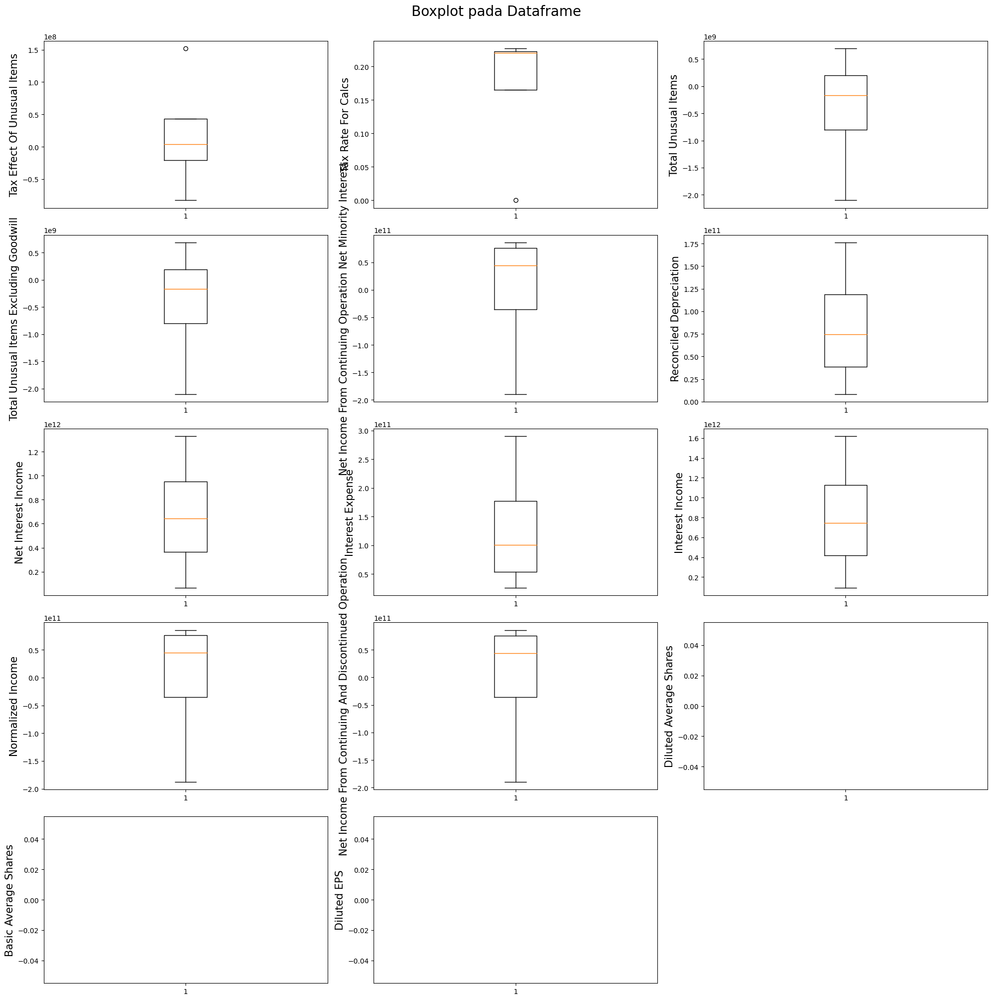

In [ ]:
# Cek Outliers Dengan menggunakan boxplot
plt.figure(figsize=(20,20))

plotnumber=1
for column in arto_income_stat.columns:
    if plotnumber<15 :
        plt.subplot(5,3,plotnumber)  #5 baris dan 3 columns
        plt.boxplot(arto_income_stat[column])
        plt.ylabel(column,fontsize=15)
    plotnumber+=1

plt.suptitle('Boxplot pada Dataframe', fontsize=20, y=1)  # Tambah judul
plt.tight_layout()
plt.show()


Catatan: ada beberapa outlier dalam data, namun tidak akan diubah secara lanjut karena sensitivitas data yang tidak bisa dimodifikasi. Sehingga outlier dalam data akan tetap dibiarkan.

Untuk beberapa features yakni Diluted Average Shares, Basic Average Shares, dan Dilluted EPS menunjukan tidak ada ada nya data. Hal ini dikarenakan features tersebut tidak ada pada laporan Income Stat Bank Jago.

2. Bank Aladin Syariah

In [ ]:
bank_income_stat[common_columns_list].describe()

,Diluted Average Shares,Net Income Continuous Operations,Operating Revenue,Net Income,Net Income From Continuing And Discontinued Operation,Insurance And Claims,Depreciation Income Statement,Other Operating Expenses,Selling General And Administration,Normalized Income,...,Tax Rate For Calcs,Depreciation And Amortization In Income Statement,Diluted NI Availto Com Stockholders,Basic Average Shares,Total Revenue,Basic EPS,Net Income Common Stockholders,Operating Expense,Rent And Landing Fees,Diluted EPS
count,3.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,...,4.0,4.000000e+00,4.000000e+00,3.000000e+00,4.000000e+00,3.000000,4.000000e+00,4.000000e+00,4.000000e+00,3.000000
mean,1.367452e+10,-1.420145e+11,9.338675e+10,-1.420145e+11,-1.420145e+11,9.047500e+08,1.328275e+10,1.322650e+10,9.112600e+10,-1.420145e+11,...,0.0,1.328275e+10,-1.420145e+11,1.367452e+10,9.338675e+10,-8.648721,-1.420145e+11,2.436532e+11,1.001300e+10,-8.648721
std,9.597421e+08,1.386089e+11,1.006693e+11,1.386089e+11,1.386089e+11,1.091556e+09,1.049902e+10,4.796614e+09,9.621676e+10,1.386089e+11,...,0.0,1.049902e+10,1.386089e+11,9.597421e+08,1.006693e+11,11.530932,1.386089e+11,1.830674e+11,3.281677e+09,11.530932
min,1.278595e+10,-2.649130e+11,2.715700e+10,-2.649130e+11,-2.649130e+11,2.000000e+07,2.000000e+06,6.047000e+09,1.221700e+10,-2.649130e+11,...,0.0,2.000000e+06,-2.649130e+11,1.278595e+10,2.715700e+10,-20.000000,-2.649130e+11,4.993600e+10,7.699000e+09,-20.000000
25%,1.316562e+10,-2.362818e+11,3.415750e+10,-2.362818e+11,-2.362818e+11,3.425000e+07,7.767500e+09,1.289525e+10,2.982325e+10,-2.362818e+11,...,0.0,7.767500e+09,-2.362818e+11,1.316562e+10,3.415750e+10,-14.500000,-2.362818e+11,1.297218e+11,7.799500e+09,-14.500000
50%,1.354528e+10,-1.740065e+11,5.213200e+10,-1.740065e+11,-1.740065e+11,6.570000e+08,1.452950e+10,1.549000e+10,6.262650e+10,-1.740065e+11,...,0.0,1.452950e+10,-1.740065e+11,1.354528e+10,5.213200e+10,-9.000000,-1.740065e+11,2.256790e+11,8.816500e+09,-9.000000
75%,1.411881e+10,-7.973925e+10,1.113612e+11,-7.973925e+10,-7.973925e+10,1.527500e+09,2.004475e+10,1.582125e+10,1.239292e+11,-7.973925e+10,...,0.0,2.004475e+10,-7.973925e+10,1.411881e+10,1.113612e+11,-2.973081,-7.973925e+10,3.396105e+11,1.103000e+10,-2.973081
max,1.469233e+10,4.486800e+10,2.421260e+11,4.486800e+10,4.486800e+10,2.285000e+09,2.407000e+10,1.587900e+10,2.270340e+11,4.486800e+10,...,0.0,2.407000e+10,4.486800e+10,1.469233e+10,2.421260e+11,3.053837,4.486800e+10,4.733190e+11,1.472000e+10,3.053837


In [ ]:
# Cek Missing Values
bank_income_stat.isna().sum()

Tax Effect Of Unusual Items                                   0
Tax Rate For Calcs                                            0
Net Income From Continuing Operation Net Minority Interest    0
Reconciled Depreciation                                       0
Net Interest Income                                           0
Interest Income                                               0
Normalized Income                                             0
Net Income From Continuing And Discontinued Operation         0
Diluted Average Shares                                        1
Basic Average Shares                                          1
Diluted EPS                                                   1
Basic EPS                                                     1
Diluted NI Availto Com Stockholders                           0
Net Income Common Stockholders                                0
Net Income                                                    0
Net Income Including Noncontrolling Inte

Catatan: ada beberapa misising value pada data, namun untuk saat ini akan diabaikan (tidak akan didelete atau di impute) karena data tersebut memang tidak ada nilainya, sehingga tidak akan mempengaruhi perhitungan saat proses modelling.

In [ ]:
# cek Duplicated values
bank_income_stat.duplicated()

2020-12-31    False
2021-12-31    False
2022-12-31    False
2023-12-31    False
dtype: bool

Catatan: Hasil pengecekan duplicated value pada range data 4 tahun (2020-2023) adalah nol atau tidak ada. Sehingga tidak akan dilakukan pre-processing lebih jauh.

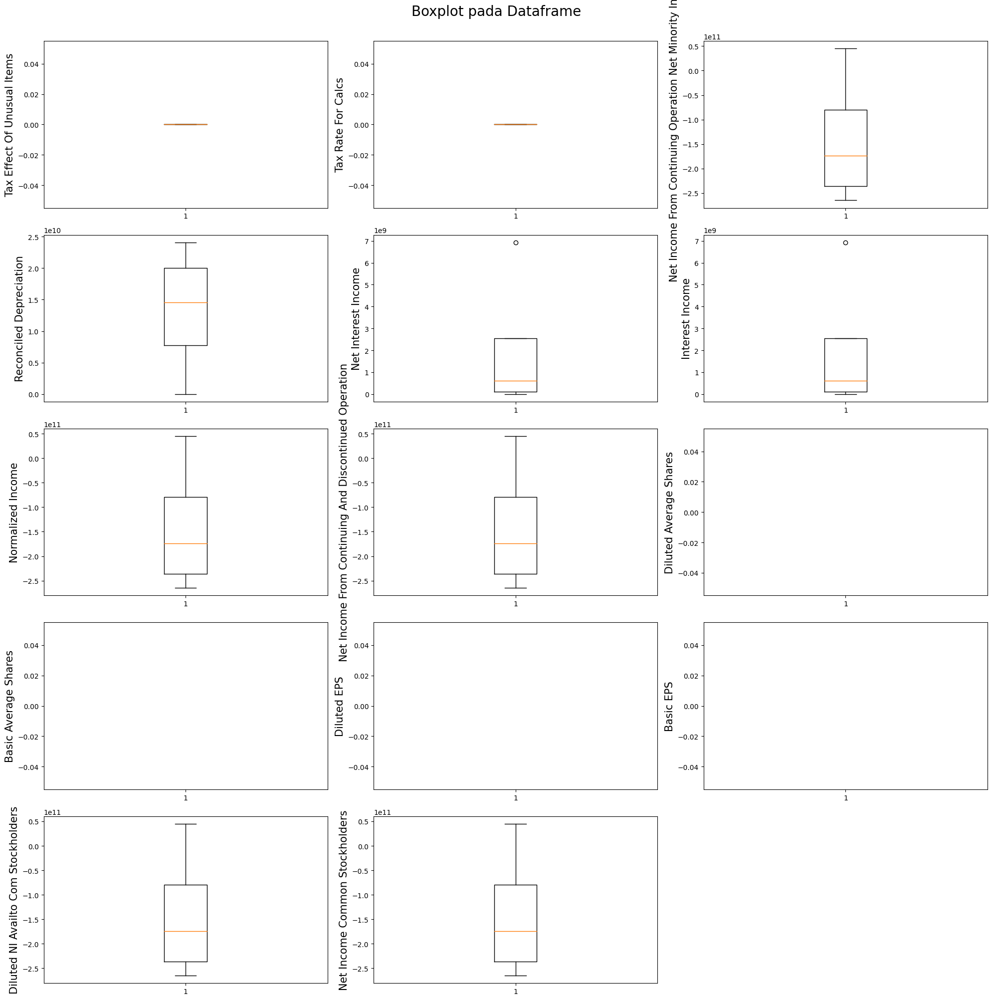

In [ ]:
# Cek Outliers Dengan menggunakan boxplot
plt.figure(figsize=(20,20))

plotnumber=1
for column in bank_income_stat.columns:
    if plotnumber<15 :
        plt.subplot(5,3,plotnumber)  #5 baris dan 3 columns
        plt.boxplot(bank_income_stat[column])
        plt.ylabel(column,fontsize=15)
    plotnumber+=1

plt.suptitle('Boxplot pada Dataframe', fontsize=20, y=1)  # Tambah judul
plt.tight_layout()
plt.show()


Catatan: ada beberapa outlier dalam data, namun tidak akan diubah secara lanjut karena sensitivitas data yang tidak bisa dimodifikasi. Sehingga outlier dalam data akan tetap dibiarkan.

Untuk beberapa features menunjukan tidak ada ada nya data (box plot). Hal ini dikarenakan features tersebut tidak ada pada laporan Income Stat Bank tersebut.

3. Bank BCA

In [ ]:
bbca_income_stat[common_columns_list].describe()

,Diluted Average Shares,Net Income Continuous Operations,Operating Revenue,Net Income,Net Income From Continuing And Discontinued Operation,Insurance And Claims,Depreciation Income Statement,Other Operating Expenses,Selling General And Administration,Normalized Income,...,Tax Rate For Calcs,Depreciation And Amortization In Income Statement,Diluted NI Availto Com Stockholders,Basic Average Shares,Total Revenue,Basic EPS,Net Income Common Stockholders,Operating Expense,Rent And Landing Fees,Diluted EPS
count,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,...,4.000000,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000,4.000000e+00,4.000000e+00,4.000000e+00,4.000000
mean,1.232750e+11,3.700023e+13,8.707115e+13,3.698215e+13,3.698215e+13,1.949828e+12,2.470585e+12,3.784782e+12,1.072395e+13,3.698800e+13,...,0.191431,2.764282e+12,3.698215e+13,1.232750e+11,8.707115e+13,300.000000,3.698215e+13,3.445935e+13,1.064961e+12,300.000000
std,0.000000e+00,9.626470e+12,1.128143e+13,9.625058e+12,9.625058e+12,3.055018e+11,4.480222e+11,2.766960e+11,1.594738e+12,9.600824e+12,...,0.000776,4.346183e+11,9.625058e+12,0.000000e+00,1.128143e+13,78.209121,9.625058e+12,3.750029e+12,5.028775e+10,78.209121
min,1.232750e+11,2.714711e+13,7.670644e+13,2.713111e+13,2.713111e+13,1.599036e+12,2.138107e+12,3.538575e+12,9.118231e+12,2.717490e+13,...,0.190546,2.447189e+12,2.713111e+13,1.232750e+11,7.670644e+13,220.000000,2.713111e+13,3.151325e+13,1.016376e+12,220.000000
25%,1.232750e+11,3.036690e+13,7.928159e+13,3.034977e+13,3.034977e+13,1.753129e+12,2.214888e+12,3.604865e+12,9.602300e+12,3.037439e+13,...,0.191105,2.520556e+12,3.034977e+13,1.232750e+11,7.928159e+13,246.250000,3.034977e+13,3.192138e+13,1.026459e+12,246.250000
50%,1.232750e+11,3.609787e+13,8.483174e+13,3.607919e+13,3.607919e+13,1.961277e+12,2.308951e+12,3.718464e+12,1.056188e+13,3.607043e+13,...,0.191373,2.603600e+12,3.607919e+13,1.232750e+11,8.483174e+13,292.500000,3.607919e+13,3.329931e+13,1.060526e+12,292.500000
75%,1.232750e+11,4.273120e+13,9.262130e+13,4.271157e+13,4.271157e+13,2.157976e+12,2.564648e+12,3.898382e+12,1.168354e+13,4.268404e+13,...,0.191698,2.847328e+12,4.271157e+13,1.232750e+11,9.262130e+13,346.250000,4.271157e+13,3.583728e+13,1.099028e+12,346.250000
max,1.232750e+11,4.865810e+13,1.019147e+14,4.863912e+13,4.863912e+13,2.277722e+12,3.126331e+12,4.163626e+12,1.265381e+13,4.863624e+13,...,0.192432,3.402740e+12,4.863912e+13,1.232750e+11,1.019147e+14,395.000000,4.863912e+13,3.972553e+13,1.122415e+12,395.000000


In [ ]:
# Cek Missing Values
bbca_income_stat.isna().sum()

Tax Effect Of Unusual Items                                   0
Tax Rate For Calcs                                            0
Total Unusual Items                                           0
Total Unusual Items Excluding Goodwill                        0
Net Income From Continuing Operation Net Minority Interest    0
Reconciled Depreciation                                       0
Net Interest Income                                           0
Interest Expense                                              0
Interest Income                                               0
Normalized Income                                             0
Net Income From Continuing And Discontinued Operation         0
Diluted Average Shares                                        0
Basic Average Shares                                          0
Diluted EPS                                                   0
Basic EPS                                                     0
Diluted NI Availto Com Stockholders     

Catatan: data bank tersebut menunjukkan tidak adanya missing value, sehingga bisa melanjutkan untuk proses berikutnya.

In [ ]:
# cek Duplicated values
bbca_income_stat.duplicated()

2020-12-31    False
2021-12-31    False
2022-12-31    False
2023-12-31    False
dtype: bool

Catatan: Hasil pengecekan duplicated value pada range data 4 tahun (2020-2023) adalah nol atau tidak ada. Sehingga tidak akan dilakukan pre-processing lebih jauh.

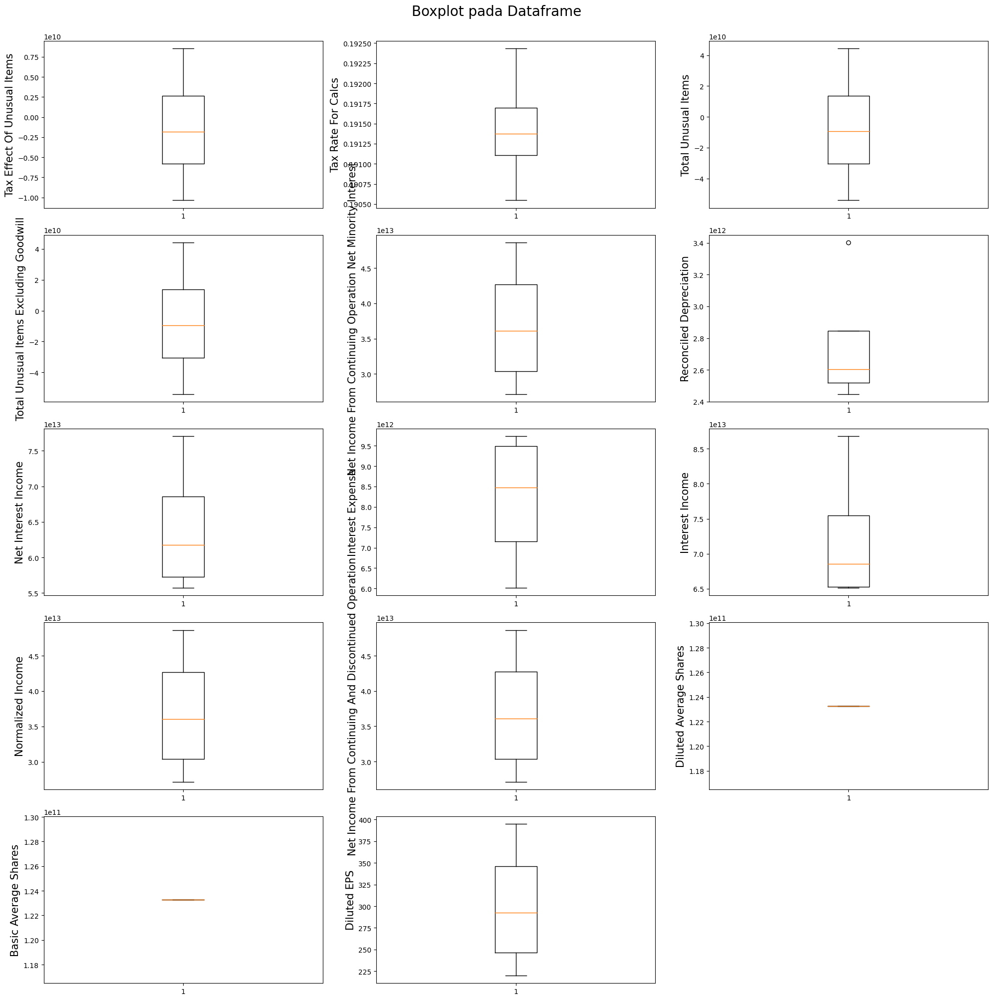

In [ ]:
# Cek Outliers Dengan menggunakan boxplot
plt.figure(figsize=(20,20))

plotnumber=1
for column in bbca_income_stat.columns:
    if plotnumber<15 :
        plt.subplot(5,3,plotnumber)  #5 baris dan 3 columns
        plt.boxplot(bbca_income_stat[column])
        plt.ylabel(column,fontsize=15)
    plotnumber+=1

plt.suptitle('Boxplot pada Dataframe', fontsize=20, y=1)  # Tambah judul
plt.tight_layout()
plt.show()


Catatan: ada beberapa outlier dalam data, namun tidak akan diubah secara lanjut karena sensitivitas data yang tidak bisa dimodifikasi. Sehingga outlier dalam data akan tetap dibiarkan.

4. Bank BNI

In [ ]:
bbni_income_stat[common_columns_list].describe()

,Diluted Average Shares,Net Income Continuous Operations,Operating Revenue,Net Income,Net Income From Continuing And Discontinued Operation,Insurance And Claims,Depreciation Income Statement,Other Operating Expenses,Selling General And Administration,Normalized Income,...,Tax Rate For Calcs,Depreciation And Amortization In Income Statement,Diluted NI Availto Com Stockholders,Basic Average Shares,Total Revenue,Basic EPS,Net Income Common Stockholders,Operating Expense,Rent And Landing Fees,Diluted EPS
count,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,...,4.000000,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000,4.000000e+00,4.000000e+00,4.000000e+00,4.000000
mean,3.260004e+10,1.347163e+13,5.857070e+13,1.335011e+13,1.335011e+13,5.895283e+12,2.284664e+12,3.170913e+12,6.795996e+12,1.072931e+13,...,0.209463,2.284664e+12,1.335011e+13,3.260004e+10,5.857070e+13,481.125000,1.335011e+13,3.051563e+13,8.098152e+11,481.125000
std,9.307782e+09,8.013279e+12,3.487883e+12,7.940911e+12,7.940911e+12,6.747626e+11,2.338090e+11,2.956718e+11,1.723655e+11,6.648444e+12,...,0.097544,2.338090e+11,7.940911e+12,9.307782e+09,3.487883e+12,386.602805,7.940911e+12,2.234209e+12,7.515951e+09,386.602805
min,1.863837e+10,3.321442e+12,5.434648e+13,3.280403e+12,3.280403e+12,5.048031e+12,2.006916e+12,2.730478e+12,6.614399e+12,2.274279e+12,...,0.125403,2.006916e+12,3.280403e+12,1.863837e+10,5.434648e+13,88.000000,3.280403e+12,2.807317e+13,8.016990e+11,88.000000
25%,3.258982e+10,9.063149e+12,5.639202e+13,8.993989e+12,8.993989e+12,5.597870e+12,2.189603e+12,3.135000e+12,6.720901e+12,7.049542e+12,...,0.163963,2.189603e+12,8.993989e+12,3.258982e+10,5.639202e+13,241.375000,8.993989e+12,2.898477e+13,8.047282e+11,241.375000
50%,3.724855e+10,1.472942e+13,5.917638e+13,1.460529e+13,1.460529e+13,5.931542e+12,2.277512e+12,3.300978e+12,6.770134e+12,1.193695e+13,...,0.181082,2.277512e+12,1.460529e+13,3.724855e+10,5.917638e+13,426.750000,1.460529e+13,3.050896e+13,8.095685e+11,426.750000
75%,3.725877e+10,1.913789e+13,6.135505e+13,1.896141e+13,1.896141e+13,6.228955e+12,2.372572e+12,3.336890e+12,6.845229e+12,1.561671e+13,...,0.226582,2.372572e+12,1.896141e+13,3.725877e+10,6.135505e+13,666.500000,1.896141e+13,3.203982e+13,8.146555e+11,666.500000
max,3.726468e+10,2.110623e+13,6.158354e+13,2.090948e+13,2.090948e+13,6.670017e+12,2.576716e+12,3.351217e+12,7.029314e+12,1.676905e+13,...,0.350285,2.576716e+12,2.090948e+13,3.726468e+10,6.158354e+13,983.000000,2.090948e+13,3.297144e+13,8.184250e+11,983.000000


In [ ]:
# Cek Missing Values
bbni_income_stat.isna().sum()

Tax Effect Of Unusual Items                                   0
Tax Rate For Calcs                                            0
Total Unusual Items                                           0
Total Unusual Items Excluding Goodwill                        0
Net Income From Continuing Operation Net Minority Interest    0
Reconciled Depreciation                                       0
Net Interest Income                                           0
Interest Expense                                              0
Interest Income                                               0
Normalized Income                                             0
Net Income From Continuing And Discontinued Operation         0
Diluted Average Shares                                        0
Basic Average Shares                                          0
Diluted EPS                                                   0
Basic EPS                                                     0
Diluted NI Availto Com Stockholders     

Catatan: pengecakan missing value pada data tersebut nol atau tidak ada, sehingga bisa melanjutkan proses berikutnya.

In [ ]:
# cek Duplicated values
bbni_income_stat.duplicated()

2020-12-31    False
2021-12-31    False
2022-12-31    False
2023-12-31    False
dtype: bool

Catatan: Hasil pengecekan duplicated value pada range data 4 tahun (2020-2023) adalah nol atau tidak ada. Sehingga tidak akan dilakukan pre-processing lebih jauh.

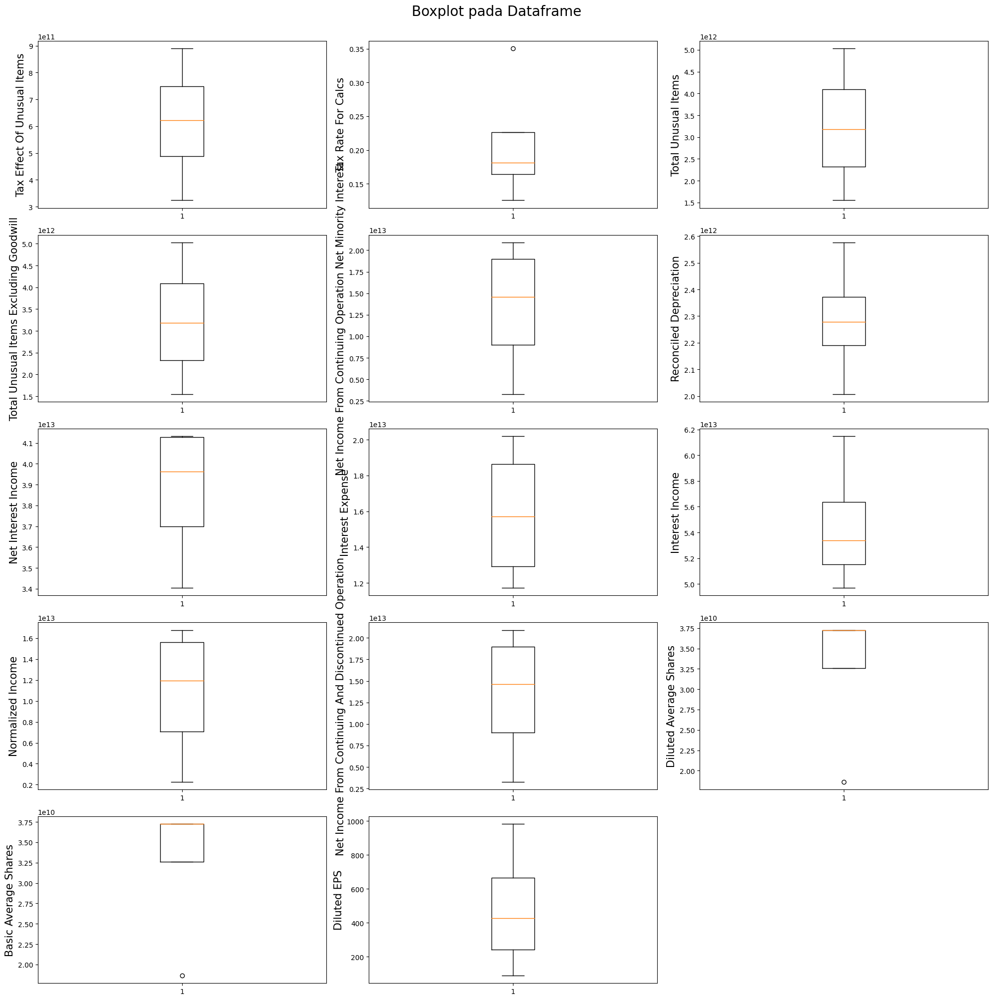

In [ ]:
# Cek Outliers Dengan menggunakan boxplot
plt.figure(figsize=(20,20))

plotnumber=1
for column in bbni_income_stat.columns:
    if plotnumber<15 :
        plt.subplot(5,3,plotnumber)  #5 baris dan 3 columns
        plt.boxplot(bbni_income_stat[column])
        plt.ylabel(column,fontsize=15)
    plotnumber+=1

plt.suptitle('Boxplot pada Dataframe', fontsize=20, y=1)  # Tambah judul
plt.tight_layout()
plt.show()


Catatan: ada beberapa outlier dalam data, namun tidak akan diubah secara lanjut karena sensitivitas data yang tidak bisa dimodifikasi. Sehingga outlier dalam data akan tetap dibiarkan.

5. Bank BRI

In [ ]:
bbri_income_stat[common_columns_list].describe()

,Diluted Average Shares,Net Income Continuous Operations,Operating Revenue,Net Income,Net Income From Continuing And Discontinued Operation,Insurance And Claims,Depreciation Income Statement,Other Operating Expenses,Selling General And Administration,Normalized Income,...,Tax Rate For Calcs,Depreciation And Amortization In Income Statement,Diluted NI Availto Com Stockholders,Basic Average Shares,Total Revenue,Basic EPS,Net Income Common Stockholders,Operating Expense,Rent And Landing Fees,Diluted EPS
count,3.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,3.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,...,4.000000,4.000000e+00,4.000000e+00,3.000000e+00,4.000000e+00,3.000000,4.000000e+00,4.000000e+00,4.000000e+00,3.000000
mean,1.350993e+11,4.031235e+13,1.480523e+14,4.024788e+13,4.024788e+13,6.211148e+12,3.324838e+12,1.211421e+13,1.919873e+13,3.143401e+13,...,0.225796,3.324838e+12,4.024788e+13,1.348346e+11,1.480523e+14,242.666667,4.024788e+13,7.363006e+13,1.894086e+12,242.333333
std,1.458337e+10,1.904183e+13,1.773930e+13,1.883224e+13,1.883224e+13,1.041787e+12,4.400959e+11,2.621335e+12,3.018343e+12,1.543309e+13,...,0.049050,4.400959e+11,1.883224e+13,1.488026e+10,1.773930e+13,93.087772,1.883224e+13,4.210016e+12,2.713295e+11,93.575282
min,1.233153e+11,1.866039e+13,1.241418e+14,1.865475e+13,1.865475e+13,5.327065e+12,2.759154e+12,9.246455e+12,1.547520e+13,1.360720e+13,...,0.191149,2.759154e+12,1.865475e+13,1.225648e+11,1.241418e+14,152.000000,1.865475e+13,6.750385e+13,1.548255e+12,151.000000
25%,1.269444e+11,2.773192e+13,1.418916e+14,2.796363e+13,2.796363e+13,5.636886e+12,3.089115e+12,1.030945e+13,1.781604e+13,2.131075e+13,...,0.200912,3.089115e+12,2.796363e+13,1.265587e+11,1.418916e+14,195.000000,2.796363e+13,7.261297e+13,1.745714e+12,194.500000
50%,1.305735e+11,4.108199e+13,1.507957e+14,4.111845e+13,4.111845e+13,5.946708e+12,3.406954e+12,1.212156e+13,1.929467e+13,3.252146e+13,...,0.206786,3.406954e+12,4.111845e+13,1.305526e+11,1.507957e+14,238.000000,4.111845e+13,7.511706e+13,1.941570e+12,238.000000
75%,1.409912e+11,5.366242e+13,1.569564e+14,5.340270e+13,5.340270e+13,6.653190e+12,3.642676e+12,1.392631e+13,2.067736e+13,4.264473e+13,...,0.231669,3.642676e+12,5.340270e+13,1.409695e+11,1.569564e+14,288.000000,5.340270e+13,7.613415e+13,2.089941e+12,288.000000
max,1.514089e+11,6.042505e+13,1.664760e+14,6.009986e+13,6.009986e+13,7.359672e+12,3.726291e+12,1.496726e+13,2.273040e+13,4.708592e+13,...,0.298465,3.726291e+12,6.009986e+13,1.513864e+11,1.664760e+14,338.000000,6.009986e+13,7.678229e+13,2.144949e+12,338.000000


In [ ]:
# Cek Missing Values
bbri_income_stat.isna().sum()

Tax Effect Of Unusual Items                                   0
Tax Rate For Calcs                                            0
Total Unusual Items                                           0
Total Unusual Items Excluding Goodwill                        0
Net Income From Continuing Operation Net Minority Interest    0
Reconciled Depreciation                                       0
Net Interest Income                                           0
Interest Expense                                              0
Interest Income                                               0
Normalized Income                                             0
Net Income From Continuing And Discontinued Operation         0
Diluted Average Shares                                        1
Basic Average Shares                                          1
Diluted EPS                                                   1
Basic EPS                                                     1
Diluted NI Availto Com Stockholders     

Catatan: ada beberapa misising value pada data, namun untuk saat ini akan diabaikan (tidak akan didelete atau di impute) karena data tersebut memang tidak ada nilainya, sehingga tidak akan mempengaruhi perhitungan saat proses modelling.

In [ ]:
# cek Duplicated values
bbri_income_stat.duplicated()

2020-12-31    False
2021-12-31    False
2022-12-31    False
2023-12-31    False
dtype: bool

Catatan: Hasil pengecekan duplicated value pada range data 4 tahun (2020-2023) adalah nol atau tidak ada. Sehingga tidak akan dilakukan pre-processing lebih jauh.

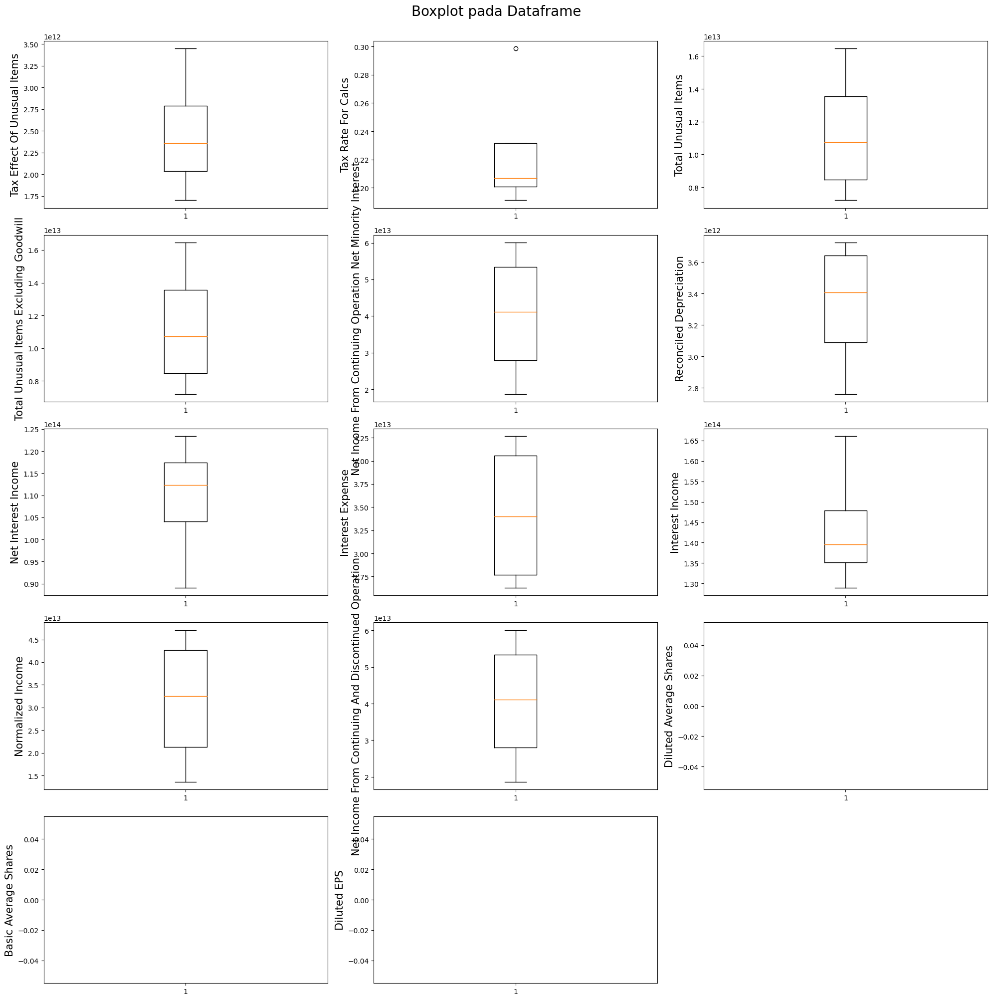

In [ ]:
# Cek Outliers Dengan menggunakan boxplot
plt.figure(figsize=(20,20))

plotnumber=1
for column in bbri_income_stat.columns:
    if plotnumber<15 :
        plt.subplot(5,3,plotnumber)  #5 baris dan 3 columns
        plt.boxplot(bbri_income_stat[column])
        plt.ylabel(column,fontsize=15)
    plotnumber+=1

plt.suptitle('Boxplot pada Dataframe', fontsize=20, y=1)  # Tambah judul
plt.tight_layout()
plt.show()


Catatan: ada beberapa outlier dalam data, namun tidak akan diubah secara lanjut karena sensitivitas data yang tidak bisa dimodifikasi. Sehingga outlier dalam data akan tetap dibiarkan.

Untuk beberapa features menunjukan tidak ada ada nya data (box plot). Hal ini dikarenakan features tersebut tidak ada pada laporan Income Stat Bank tersebut.

6. Bank BTN

In [ ]:
bbtn_income_stat[common_columns_list].describe()

,Diluted Average Shares,Net Income Continuous Operations,Operating Revenue,Net Income,Net Income From Continuing And Discontinued Operation,Insurance And Claims,Depreciation Income Statement,Other Operating Expenses,Selling General And Administration,Normalized Income,...,Tax Rate For Calcs,Depreciation And Amortization In Income Statement,Diluted NI Availto Com Stockholders,Basic Average Shares,Total Revenue,Basic EPS,Net Income Common Stockholders,Operating Expense,Rent And Landing Fees,Diluted EPS
count,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,...,4.000000,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000,4.000000e+00,4.000000e+00,4.000000e+00,4.000000
mean,1.219446e+10,2.631162e+12,1.462540e+13,2.631162e+12,2.631162e+12,5.864480e+11,6.076465e+11,2.933365e+11,2.506792e+12,2.713855e+12,...,0.228895,6.076465e+11,2.631162e+12,1.211313e+10,1.462540e+13,217.537796,2.631162e+12,8.140996e+12,4.135398e+11,216.205192
std,1.413269e+09,8.269117e+11,2.455991e+12,8.269117e+11,8.269117e+11,8.153171e+10,8.414765e+10,1.121304e+11,3.190481e+11,8.089996e+11,...,0.044014,8.414765e+10,8.269117e+11,1.418697e+09,2.455991e+12,66.463194,8.269117e+11,9.834587e+11,4.973694e+10,67.009906
min,1.059000e+10,1.602358e+12,1.106335e+13,1.602358e+12,1.602358e+12,4.693600e+11,5.287670e+11,1.866360e+11,2.144993e+12,1.602358e+12,...,0.200726,5.287670e+11,1.602358e+12,1.059000e+10,1.106335e+13,134.148877,1.602358e+12,6.747464e+12,3.575230e+11,134.148877
25%,1.158770e+10,2.182760e+12,1.396132e+13,2.182760e+12,2.182760e+12,5.673332e+11,5.492172e+11,2.015842e+11,2.287615e+12,2.432289e+12,...,0.204799,5.492172e+11,2.182760e+12,1.158770e+10,1.396132e+13,182.788950,2.182760e+12,7.805541e+12,3.807408e+11,178.791136
50%,1.208292e+10,2.710650e+12,1.557521e+13,2.710650e+12,2.710650e+12,6.098290e+11,5.925470e+11,2.949575e+11,2.535822e+12,2.876047e+12,...,0.210236,5.925470e+11,2.710650e+12,1.192026e+10,1.557521e+13,224.001154,2.710650e+12,8.454558e+12,4.144900e+11,221.335944
75%,1.268967e+10,3.159052e+12,1.623929e+13,3.159052e+12,3.159052e+12,6.289438e+11,6.509762e+11,3.867098e+11,2.754999e+12,3.157614e+12,...,0.234332,6.509762e+11,3.159052e+12,1.244570e+10,1.623929e+13,258.750000,3.159052e+12,8.790014e+12,4.472890e+11,258.750000
max,1.402200e+10,3.500988e+12,1.628782e+13,3.500988e+12,3.500988e+12,6.567740e+11,7.167250e+11,3.967950e+11,2.810531e+12,3.500969e+12,...,0.294382,7.167250e+11,3.500988e+12,1.402200e+10,1.628782e+13,288.000000,3.500988e+12,8.907404e+12,4.676560e+11,288.000000


In [ ]:
# Cek Missing Values
bbtn_income_stat.isna().sum()

Tax Effect Of Unusual Items                                   0
Tax Rate For Calcs                                            0
Total Unusual Items                                           0
Total Unusual Items Excluding Goodwill                        0
Net Income From Continuing Operation Net Minority Interest    0
Reconciled Depreciation                                       0
Net Interest Income                                           0
Interest Expense                                              0
Interest Income                                               0
Normalized Income                                             0
Net Income From Continuing And Discontinued Operation         0
Diluted Average Shares                                        0
Basic Average Shares                                          0
Diluted EPS                                                   0
Basic EPS                                                     0
Diluted NI Availto Com Stockholders     

Catatan: ada beberapa misising value pada data, namun untuk saat ini akan diabaikan (tidak akan didelete atau di impute) karena data tersebut memang tidak ada nilainya, sehingga tidak akan mempengaruhi perhitungan saat proses modelling.

In [ ]:
# cek Duplicated values
bbtn_income_stat.duplicated()

2020-12-31    False
2021-12-31    False
2022-12-31    False
2023-12-31    False
dtype: bool

Catatan: Hasil pengecekan duplicated value pada range data 4 tahun (2020-2023) adalah nol atau tidak ada. Sehingga tidak akan dilakukan pre-processing lebih jauh.

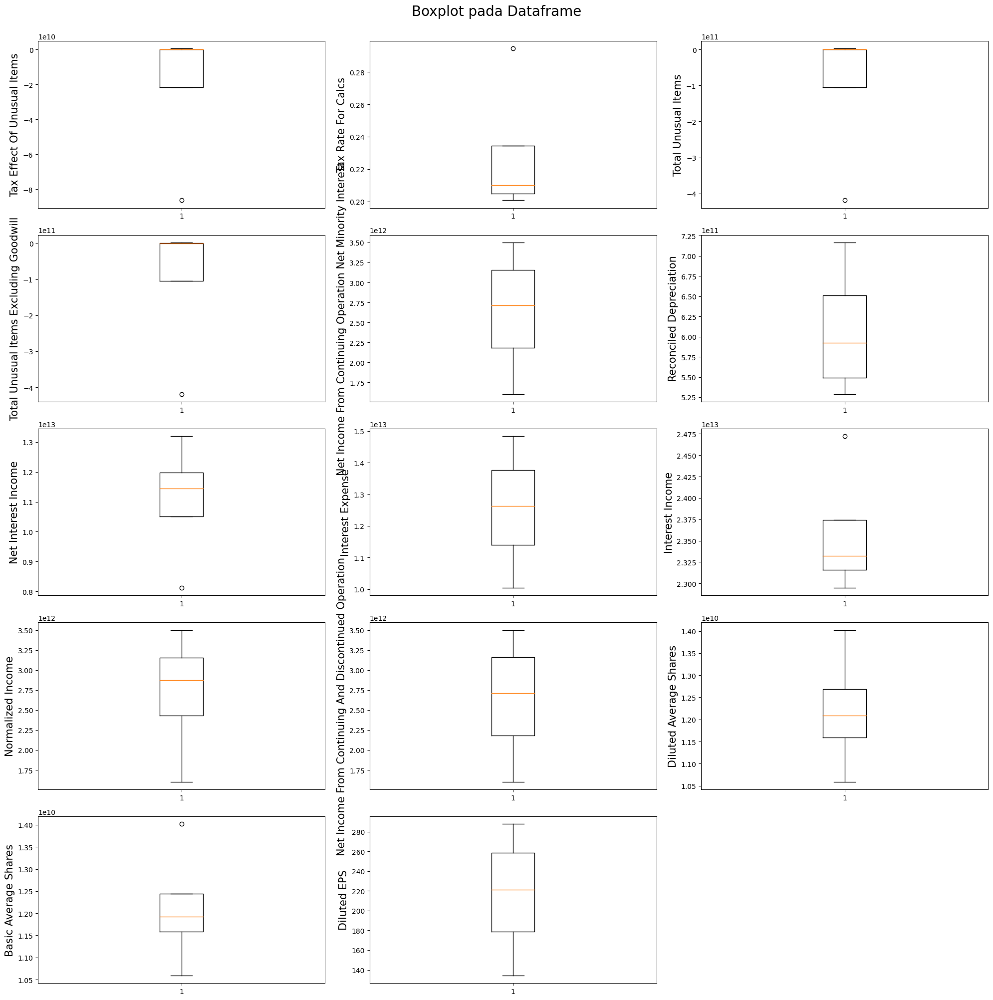

In [ ]:
# Cek Outliers Dengan menggunakan boxplot
plt.figure(figsize=(20,20))

plotnumber=1
for column in bbtn_income_stat.columns:
    if plotnumber<15 :
        plt.subplot(5,3,plotnumber)  #5 baris dan 3 columns
        plt.boxplot(bbtn_income_stat[column])
        plt.ylabel(column,fontsize=15)
    plotnumber+=1

plt.suptitle('Boxplot pada Dataframe', fontsize=20, y=1)  # Tambah judul
plt.tight_layout()
plt.show()


Catatan: ada beberapa outlier dalam data, namun tidak akan diubah secara lanjut karena sensitivitas data yang tidak bisa dimodifikasi. Sehingga outlier dalam data akan tetap dibiarkan.

Untuk beberapa features menunjukan tidak ada ada nya data (box plot). Hal ini dikarenakan features tersebut tidak ada pada laporan Income Stat Bank tersebut.

7. Bank Neo Commerce

In [ ]:
bbyb_income_stat[common_columns_list].describe()

,Diluted Average Shares,Net Income Continuous Operations,Operating Revenue,Net Income,Net Income From Continuing And Discontinued Operation,Insurance And Claims,Depreciation Income Statement,Other Operating Expenses,Selling General And Administration,Normalized Income,...,Tax Rate For Calcs,Depreciation And Amortization In Income Statement,Diluted NI Availto Com Stockholders,Basic Average Shares,Total Revenue,Basic EPS,Net Income Common Stockholders,Operating Expense,Rent And Landing Fees,Diluted EPS
count,3.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,...,4.000000,4.000000e+00,4.000000e+00,3.000000e+00,4.000000e+00,3.000000,4.000000e+00,4.000000e+00,4.000000e+00,3.000000
mean,8.194703e+09,-5.831641e+11,1.414186e+12,-5.831641e+11,-5.831641e+11,1.829937e+10,3.918120e+10,1.364902e+11,6.246672e+11,-5.627625e+11,...,0.118844,4.841474e+10,-5.831641e+11,8.194703e+09,1.414186e+12,-65.126956,-5.831641e+11,1.092139e+12,5.740955e+10,-65.126956
std,1.504594e+09,4.335304e+11,1.380777e+12,4.335304e+11,4.335304e+11,1.248677e+10,1.030601e+10,1.886769e+11,4.621791e+11,4.286748e+11,...,0.134689,1.458187e+10,4.335304e+11,1.504594e+09,1.380777e+12,60.445908,4.335304e+11,6.123089e+11,6.183349e+10,60.445908
min,6.516109e+09,-9.862890e+11,2.413908e+11,-9.862890e+11,-9.862890e+11,7.378497e+09,2.698080e+10,0.000000e+00,6.307177e+10,-9.692404e+11,...,0.001206,3.174894e+10,-9.862890e+11,6.516109e+09,2.413908e+11,-114.070000,-9.862890e+11,2.025129e+11,3.833215e+09,-114.070000
25%,7.581054e+09,-8.383665e+11,3.888605e+11,-8.383665e+11,-8.383665e+11,8.912624e+09,3.282270e+10,0.000000e+00,3.372374e+11,-8.330941e+11,...,0.003430,3.881549e+10,-8.383665e+11,7.581054e+09,3.888605e+11,-98.910000,-8.383665e+11,9.742300e+11,5.071304e+09,-98.910000
50%,8.646000e+09,-6.811195e+11,1.095534e+12,-6.811195e+11,-6.811195e+11,1.577400e+10,3.988550e+10,7.297000e+10,7.158635e+11,-6.478169e+11,...,0.112086,4.911800e+10,-6.811195e+11,8.646000e+09,1.095534e+12,-83.750000,-6.811195e+11,1.285693e+12,5.132100e+10,-83.750000
75%,9.034000e+09,-4.259171e+11,2.120860e+12,-4.259171e+11,-4.259171e+11,2.516075e+10,4.624400e+10,2.094602e+11,1.003293e+12,-3.774853e+11,...,0.227500,5.871725e+10,-4.259171e+11,9.034000e+09,2.120860e+12,-40.655434,-4.259171e+11,1.403602e+12,1.036592e+11,-40.655434
max,9.422000e+09,1.587150e+10,3.224283e+12,1.587150e+10,1.587150e+10,3.427100e+10,4.997300e+10,4.000210e+11,1.003870e+12,1.382410e+10,...,0.250000,6.367400e+10,1.587150e+10,9.422000e+09,3.224283e+12,2.439133,1.587150e+10,1.594658e+12,1.231630e+11,2.439133


In [ ]:
# Cek Missing Values
bbyb_income_stat.isna().sum()

Tax Effect Of Unusual Items                                   0
Tax Rate For Calcs                                            0
Total Unusual Items                                           0
Total Unusual Items Excluding Goodwill                        0
Net Income From Continuing Operation Net Minority Interest    0
Reconciled Depreciation                                       0
Net Interest Income                                           0
Interest Expense                                              0
Interest Income                                               0
Normalized Income                                             0
Net Income From Continuing And Discontinued Operation         0
Diluted Average Shares                                        1
Basic Average Shares                                          1
Diluted EPS                                                   1
Basic EPS                                                     1
Diluted NI Availto Com Stockholders     

Catatan: ada beberapa misising value pada data, namun untuk saat ini akan diabaikan (tidak akan didelete atau di impute) karena data tersebut memang tidak ada nilainya, sehingga tidak akan mempengaruhi perhitungan saat proses modelling.

In [ ]:
# cek Duplicated values
bbyb_income_stat.duplicated()

2020-12-31    False
2021-12-31    False
2022-12-31    False
2023-12-31    False
dtype: bool

Catatan: Hasil pengecekan duplicated value pada range data 4 tahun (2020-2023) adalah nol atau tidak ada. Sehingga tidak akan dilakukan pre-processing lebih jauh.

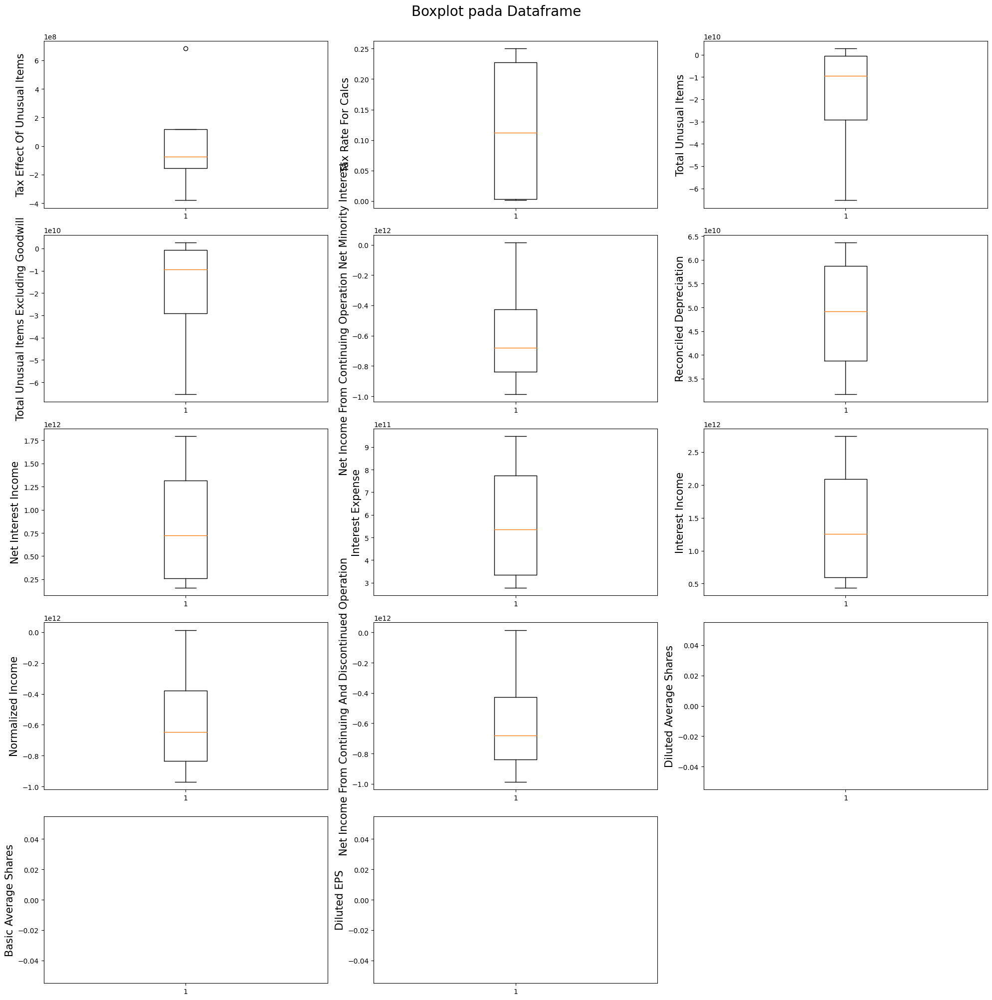

In [ ]:
# Cek Outliers Dengan menggunakan boxplot
plt.figure(figsize=(20,20))

plotnumber=1
for column in bbyb_income_stat.columns:
    if plotnumber<15 :
        plt.subplot(5,3,plotnumber)  #5 baris dan 3 columns
        plt.boxplot(bbyb_income_stat[column])
        plt.ylabel(column,fontsize=15)
    plotnumber+=1

plt.suptitle('Boxplot pada Dataframe', fontsize=20, y=1)  # Tambah judul
plt.tight_layout()
plt.show()


Catatan: ada beberapa outlier dalam data, namun tidak akan diubah secara lanjut karena sensitivitas data yang tidak bisa dimodifikasi. Sehingga outlier dalam data akan tetap dibiarkan.

Untuk beberapa features menunjukan tidak ada ada nya data (box plot). Hal ini dikarenakan features tersebut tidak ada pada laporan Income Stat Bank tersebut.

8. Bank Mandiri

In [ ]:
bmri_income_stat[common_columns_list].describe()

,Diluted Average Shares,Net Income Continuous Operations,Operating Revenue,Net Income,Net Income From Continuing And Discontinued Operation,Insurance And Claims,Depreciation Income Statement,Other Operating Expenses,Selling General And Administration,Normalized Income,...,Tax Rate For Calcs,Depreciation And Amortization In Income Statement,Diluted NI Availto Com Stockholders,Basic Average Shares,Total Revenue,Basic EPS,Net Income Common Stockholders,Operating Expense,Rent And Landing Fees,Diluted EPS
count,3.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,...,4.000000,4.000000e+00,4.000000e+00,3.000000e+00,4.000000e+00,3.000000,4.000000e+00,4.000000e+00,4.000000e+00,3.000000
mean,9.328291e+10,3.848857e+13,1.060048e+14,3.526459e+13,3.526459e+13,2.683622e+12,3.168598e+12,1.734202e+12,1.524793e+13,3.531064e+13,...,0.211958,4.145963e+12,3.526459e+13,9.328291e+10,1.060048e+14,307.293333,3.526459e+13,4.781507e+13,9.108410e+11,307.293333
std,2.009656e+07,1.801253e+13,1.614145e+13,1.653347e+13,1.653347e+13,3.072749e+11,3.128492e+11,7.871358e+11,1.373148e+12,1.652206e+13,...,0.022757,4.794453e+11,1.653347e+13,2.009656e+07,1.614145e+13,130.716293,1.653347e+13,3.657584e+12,7.754106e+10,130.716293
min,9.326253e+10,1.839893e+13,8.709254e+13,1.679952e+13,1.679952e+13,2.345492e+12,2.764395e+12,7.948980e+11,1.371554e+13,1.679203e+13,...,0.195930,3.569621e+12,1.679952e+13,9.326253e+10,8.709254e+13,180.090000,1.679952e+13,4.304613e+13,8.138080e+11,180.090000
25%,9.327300e+10,2.751305e+13,9.596257e+13,2.522100e+13,2.522100e+13,2.499147e+12,3.000032e+12,1.284350e+12,1.430019e+13,2.531429e+13,...,0.200975,3.842674e+12,2.522100e+13,9.327300e+10,9.596257e+13,240.310000,2.522100e+13,4.589773e+13,8.765425e+11,240.310000
50%,9.328347e+10,3.775173e+13,1.068456e+14,3.459940e+13,3.459940e+13,2.664074e+12,3.245904e+12,1.763788e+12,1.531512e+13,3.470154e+13,...,0.203097,4.223664e+12,3.459940e+13,9.328347e+10,1.068456e+14,300.530000,3.459940e+13,4.873645e+13,9.146245e+11,300.530000
75%,9.329309e+10,4.872724e+13,1.168878e+14,4.464299e+13,4.464299e+13,2.848549e+12,3.414470e+12,2.213640e+12,1.626285e+13,4.469788e+13,...,0.214080,4.526953e+12,4.464299e+13,9.329309e+10,1.168878e+14,370.895000,4.464299e+13,5.065379e+13,9.489230e+11,370.895000
max,9.330271e+10,6.005187e+13,1.232355e+14,5.506006e+13,5.506006e+13,3.060846e+12,3.418186e+12,2.614333e+12,1.664594e+13,5.504744e+13,...,0.245711,4.566902e+12,5.506006e+13,9.330271e+10,1.232355e+14,441.260000,5.506006e+13,5.074127e+13,1.000307e+12,441.260000


In [ ]:
# Cek Missing Values
bmri_income_stat.isna().sum()

Tax Effect Of Unusual Items                                   0
Tax Rate For Calcs                                            0
Total Unusual Items                                           0
Total Unusual Items Excluding Goodwill                        0
Net Income From Continuing Operation Net Minority Interest    0
Reconciled Depreciation                                       0
Net Interest Income                                           0
Interest Expense                                              0
Interest Income                                               0
Normalized Income                                             0
Net Income From Continuing And Discontinued Operation         0
Diluted Average Shares                                        1
Basic Average Shares                                          1
Diluted EPS                                                   1
Basic EPS                                                     1
Diluted NI Availto Com Stockholders     

Catatan: ada beberapa misising value pada data, namun untuk saat ini akan diabaikan (tidak akan didelete atau di impute) karena data tersebut memang tidak ada nilainya, sehingga tidak akan mempengaruhi perhitungan saat proses modelling.

In [ ]:
# cek Duplicated values
bmri_income_stat.duplicated()

2020-12-31    False
2021-12-31    False
2022-12-31    False
2023-12-31    False
dtype: bool

Catatan: Hasil pengecekan duplicated value pada range data 4 tahun (2020-2023) adalah nol atau tidak ada. Sehingga tidak akan dilakukan pre-processing lebih jauh.

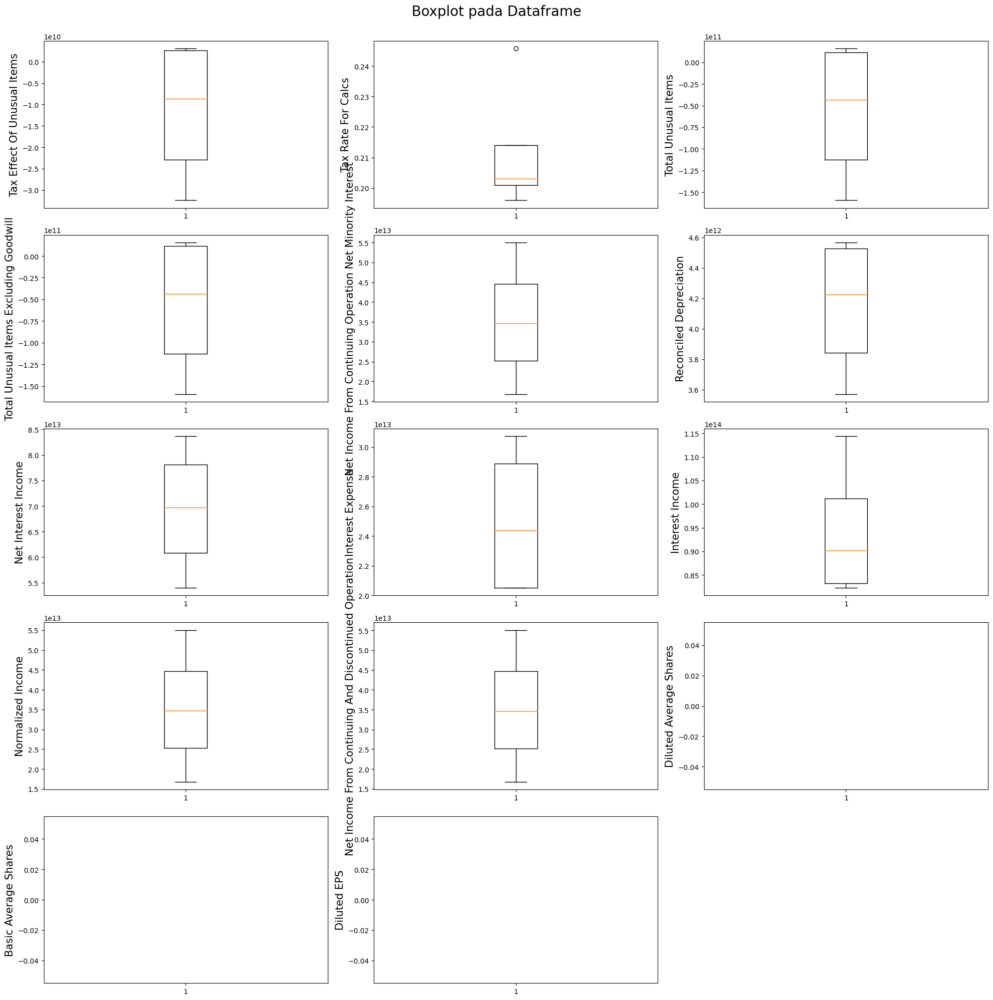

In [ ]:
# Cek Outliers Dengan menggunakan boxplot
plt.figure(figsize=(20,20))

plotnumber=1
for column in bmri_income_stat.columns:
    if plotnumber<15 :
        plt.subplot(5,3,plotnumber)  #5 baris dan 3 columns
        plt.boxplot(bmri_income_stat[column])
        plt.ylabel(column,fontsize=15)
    plotnumber+=1

plt.suptitle('Boxplot pada Dataframe', fontsize=20, y=1)  # Tambah judul
plt.tight_layout()
plt.show()


Catatan: ada beberapa outlier dalam data, namun tidak akan diubah secara lanjut karena sensitivitas data yang tidak bisa dimodifikasi. Sehingga outlier dalam data akan tetap dibiarkan.

Untuk beberapa features menunjukan tidak ada ada nya data (box plot). Hal ini dikarenakan features tersebut tidak ada pada laporan Income Stat Bank tersebut.

9. Bank CIMB Niaga

In [ ]:
bnga_income_stat[common_columns_list].describe()

,Diluted Average Shares,Net Income Continuous Operations,Operating Revenue,Net Income,Net Income From Continuing And Discontinued Operation,Insurance And Claims,Depreciation Income Statement,Other Operating Expenses,Selling General And Administration,Normalized Income,...,Tax Rate For Calcs,Depreciation And Amortization In Income Statement,Diluted NI Availto Com Stockholders,Basic Average Shares,Total Revenue,Basic EPS,Net Income Common Stockholders,Operating Expense,Rent And Landing Fees,Diluted EPS
count,3.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,...,4.000000,4.000000e+00,4.000000e+00,3.000000e+00,4.000000e+00,3.000000,4.000000e+00,4.000000e+00,4.000000e+00,3.000000
mean,2.493045e+10,4.439508e+12,1.789254e+13,4.407179e+12,4.407179e+12,7.809250e+09,1.301422e+11,9.464425e+10,2.692831e+12,4.499263e+12,...,0.242374,1.301422e+11,4.407179e+12,2.493045e+10,1.789254e+13,149.136667,4.407179e+12,8.361800e+12,8.426310e+11,149.136667
std,2.107076e+06,1.906543e+12,1.234258e+12,1.871219e+12,1.871219e+12,8.666642e+08,7.106965e+09,8.046056e+10,1.209606e+11,1.922587e+12,...,0.050539,7.106965e+09,1.871219e+12,2.107076e+06,1.234258e+12,62.181335,1.871219e+12,2.152179e+11,1.213370e+11,62.181335
min,2.492920e+10,2.011254e+12,1.621074e+13,2.012401e+12,2.012401e+12,6.817000e+09,1.246690e+11,2.034600e+10,2.563371e+12,2.041302e+12,...,0.210455,1.246690e+11,2.012401e+12,2.492920e+10,1.621074e+13,80.720000,2.012401e+12,8.100784e+12,6.686830e+11,80.720000
25%,2.492924e+10,3.576766e+12,1.734728e+13,3.578355e+12,3.578355e+12,7.234000e+09,1.248138e+11,4.278000e+10,2.604746e+12,3.610749e+12,...,0.214677,1.248138e+11,3.578355e+12,2.492924e+10,1.734728e+13,122.600000,3.578355e+12,8.234624e+12,8.056105e+11,122.600000
50%,2.492927e+10,4.597688e+12,1.824380e+13,4.571060e+12,4.571060e+12,7.863000e+09,1.280730e+11,7.740300e+10,2.696274e+12,4.681755e+12,...,0.220710,1.280730e+11,4.571060e+12,2.492927e+10,1.824380e+13,164.480000,4.571060e+12,8.381444e+12,8.836720e+11,164.480000
75%,2.493108e+10,5.460428e+12,1.878906e+13,5.399884e+12,5.399884e+12,8.438250e+09,1.334015e+11,1.292672e+11,2.784359e+12,5.570269e+12,...,0.248408,1.334015e+11,5.399884e+12,2.493108e+10,1.878906e+13,183.345000,5.399884e+12,8.508619e+12,9.206925e+11,183.345000
max,2.493289e+10,6.551401e+12,1.887182e+13,6.474195e+12,6.474195e+12,8.694000e+09,1.397540e+11,2.034250e+11,2.815407e+12,6.592239e+12,...,0.317622,1.397540e+11,6.474195e+12,2.493289e+10,1.887182e+13,202.210000,6.474195e+12,8.583527e+12,9.344970e+11,202.210000


In [ ]:
# Cek Missing Values
bnga_income_stat.isna().sum()

Tax Effect Of Unusual Items                                   0
Tax Rate For Calcs                                            0
Total Unusual Items                                           0
Total Unusual Items Excluding Goodwill                        0
Net Income From Continuing Operation Net Minority Interest    0
Reconciled Depreciation                                       0
Net Interest Income                                           0
Interest Expense                                              0
Interest Income                                               0
Normalized Income                                             0
Net Income From Continuing And Discontinued Operation         0
Diluted Average Shares                                        1
Basic Average Shares                                          1
Diluted EPS                                                   1
Basic EPS                                                     1
Diluted NI Availto Com Stockholders     

Catatan: ada beberapa misising value pada data, namun untuk saat ini akan diabaikan (tidak akan didelete atau di impute) karena data tersebut memang tidak ada nilainya, sehingga tidak akan mempengaruhi perhitungan saat proses modelling.

In [ ]:
# cek Duplicated values
bnga_income_stat.duplicated()

2020-12-31    False
2021-12-31    False
2022-12-31    False
2023-12-31    False
dtype: bool

Catatan: Hasil pengecekan duplicated value pada range data 4 tahun (2020-2023) adalah nol atau tidak ada. Sehingga tidak akan dilakukan pre-processing lebih jauh.

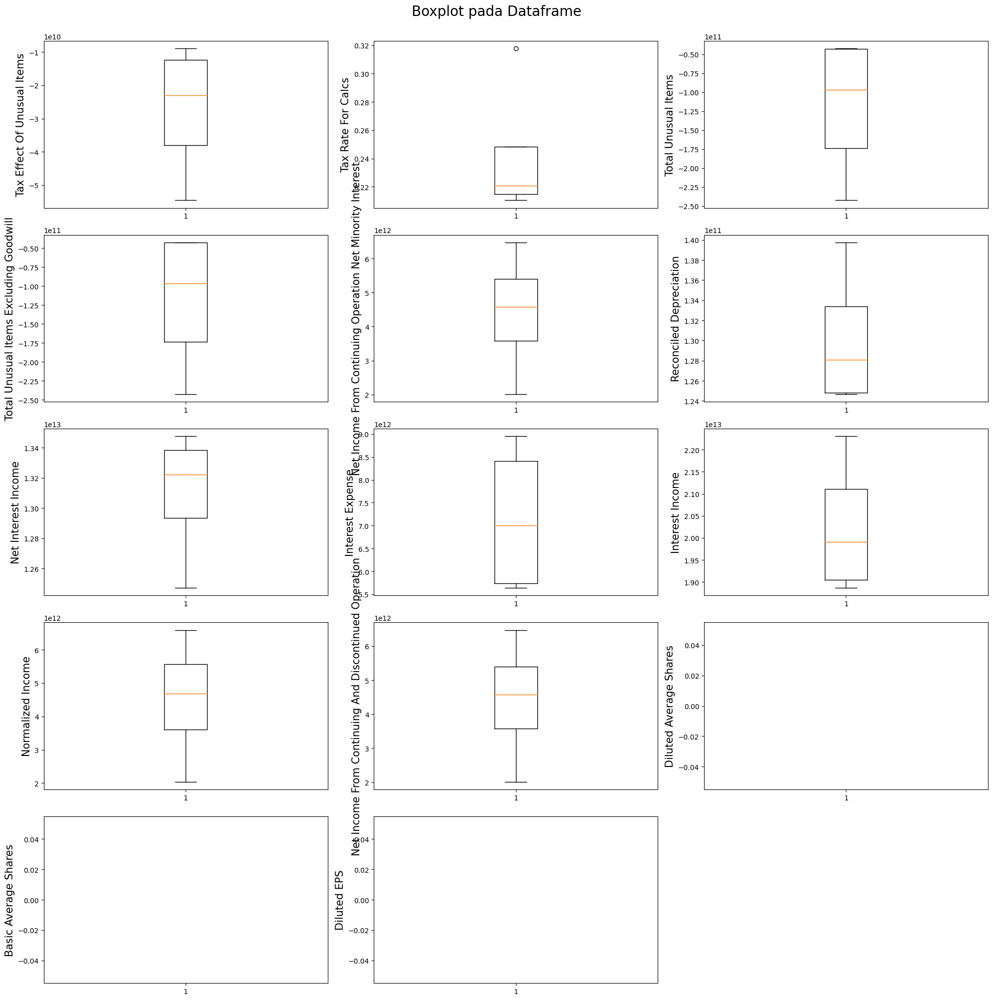

In [ ]:
# Cek Outliers Dengan menggunakan boxplot
plt.figure(figsize=(20,20))

plotnumber=1
for column in bnga_income_stat.columns:
    if plotnumber<15 :
        plt.subplot(5,3,plotnumber)  #5 baris dan 3 columns
        plt.boxplot(bnga_income_stat[column])
        plt.ylabel(column,fontsize=15)
    plotnumber+=1

plt.suptitle('Boxplot pada Dataframe', fontsize=20, y=1)  # Tambah judul
plt.tight_layout()
plt.show()


Catatan: ada beberapa outlier dalam data, namun tidak akan diubah secara lanjut karena sensitivitas data yang tidak bisa dimodifikasi. Sehingga outlier dalam data akan tetap dibiarkan.

Untuk beberapa features menunjukan tidak ada ada nya data (box plot). Hal ini dikarenakan features tersebut tidak ada pada laporan Income Stat Bank tersebut.

10. Bank BSI

In [ ]:
bris_income_stat[common_columns_list].describe()

,Diluted Average Shares,Net Income Continuous Operations,Operating Revenue,Net Income,Net Income From Continuing And Discontinued Operation,Insurance And Claims,Depreciation Income Statement,Other Operating Expenses,Selling General And Administration,Normalized Income,...,Tax Rate For Calcs,Depreciation And Amortization In Income Statement,Diluted NI Availto Com Stockholders,Basic Average Shares,Total Revenue,Basic EPS,Net Income Common Stockholders,Operating Expense,Rent And Landing Fees,Diluted EPS
count,3.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,...,4.000000,4.000000e+00,4.000000e+00,3.000000e+00,4.000000e+00,3.000000,4.000000e+00,4.000000e+00,4.000000e+00,3.000000
mean,4.152457e+10,3.794945e+12,1.671383e+13,3.794945e+12,3.794945e+12,7.565450e+10,1.011804e+12,2.652782e+11,2.753487e+12,3.784351e+12,...,0.259845,1.011804e+12,3.794945e+12,4.151815e+10,1.671383e+13,76.142843,3.794945e+12,9.093814e+12,2.872080e+11,76.129592
std,4.050185e+08,1.530931e+12,1.886638e+12,1.530931e+12,1.530931e+12,3.473650e+10,2.936798e+11,1.058725e+11,6.010275e+11,1.534267e+12,...,0.020104,2.936798e+11,1.530931e+12,4.088877e+08,1.886638e+12,25.260211,1.530931e+12,5.920593e+11,3.156211e+10,25.266294
min,4.110928e+10,2.187649e+12,1.454935e+13,2.187649e+12,2.187649e+12,2.731600e+10,7.017920e+11,1.668920e+11,2.005094e+12,2.197989e+12,...,0.246813,7.017920e+11,2.187649e+12,4.109606e+10,1.454935e+13,52.198529,2.187649e+12,8.363069e+12,2.425720e+11,52.188776
25%,4.132763e+10,2.818066e+12,1.549014e+13,2.818066e+12,2.818066e+12,6.403975e+10,8.037020e+11,1.871038e+11,2.399557e+12,2.769772e+12,...,0.248033,8.037020e+11,2.818066e+12,4.132101e+10,1.549014e+13,62.944265,2.818066e+12,8.766060e+12,2.760685e+11,62.924388
50%,4.154597e+10,3.644194e+12,1.679334e+13,3.644194e+12,3.644194e+12,8.364350e+10,1.002306e+12,2.485000e+11,2.866036e+12,3.628256e+12,...,0.251491,1.002306e+12,3.644194e+12,4.154597e+10,1.679334e+13,73.690000,3.644194e+12,9.146630e+12,2.980025e+11,73.660000
75%,4.173222e+10,4.621072e+12,1.801703e+13,4.621072e+12,4.621072e+12,9.525825e+10,1.210408e+12,3.266745e+11,3.219966e+12,4.642835e+12,...,0.263303,1.210408e+12,4.621072e+12,4.172919e+10,1.801703e+13,88.115000,4.621072e+12,9.474384e+12,3.091420e+11,88.100000
max,4.191847e+10,5.703743e+12,1.871931e+13,5.703743e+12,5.703743e+12,1.080150e+11,1.340813e+12,3.972210e+11,3.276781e+12,5.682902e+12,...,0.289586,1.340813e+12,5.703743e+12,4.191241e+10,1.871931e+13,102.540000,5.703743e+12,9.718928e+12,3.102550e+11,102.540000


In [ ]:
# Cek Missing Values
bris_income_stat.isna().sum()

Tax Effect Of Unusual Items                                   0
Tax Rate For Calcs                                            0
Total Unusual Items                                           0
Total Unusual Items Excluding Goodwill                        0
Net Income From Continuing Operation Net Minority Interest    0
Reconciled Depreciation                                       0
Normalized Income                                             0
Net Income From Continuing And Discontinued Operation         0
Diluted Average Shares                                        1
Basic Average Shares                                          1
Diluted EPS                                                   1
Basic EPS                                                     1
Diluted NI Availto Com Stockholders                           0
Net Income Common Stockholders                                0
Net Income                                                    0
Net Income Including Noncontrolling Inte

Catatan: ada beberapa misising value pada data, namun untuk saat ini akan diabaikan (tidak akan didelete atau di impute) karena data tersebut memang tidak ada nilainya, sehingga tidak akan mempengaruhi perhitungan saat proses modelling.

In [ ]:
# cek Duplicated values
bris_income_stat.duplicated()

2020-12-31    False
2021-12-31    False
2022-12-31    False
2023-12-31    False
dtype: bool

Catatan: Hasil pengecekan duplicated value pada range data 4 tahun (2020-2023) adalah nol atau tidak ada. Sehingga tidak akan dilakukan pre-processing lebih jauh.

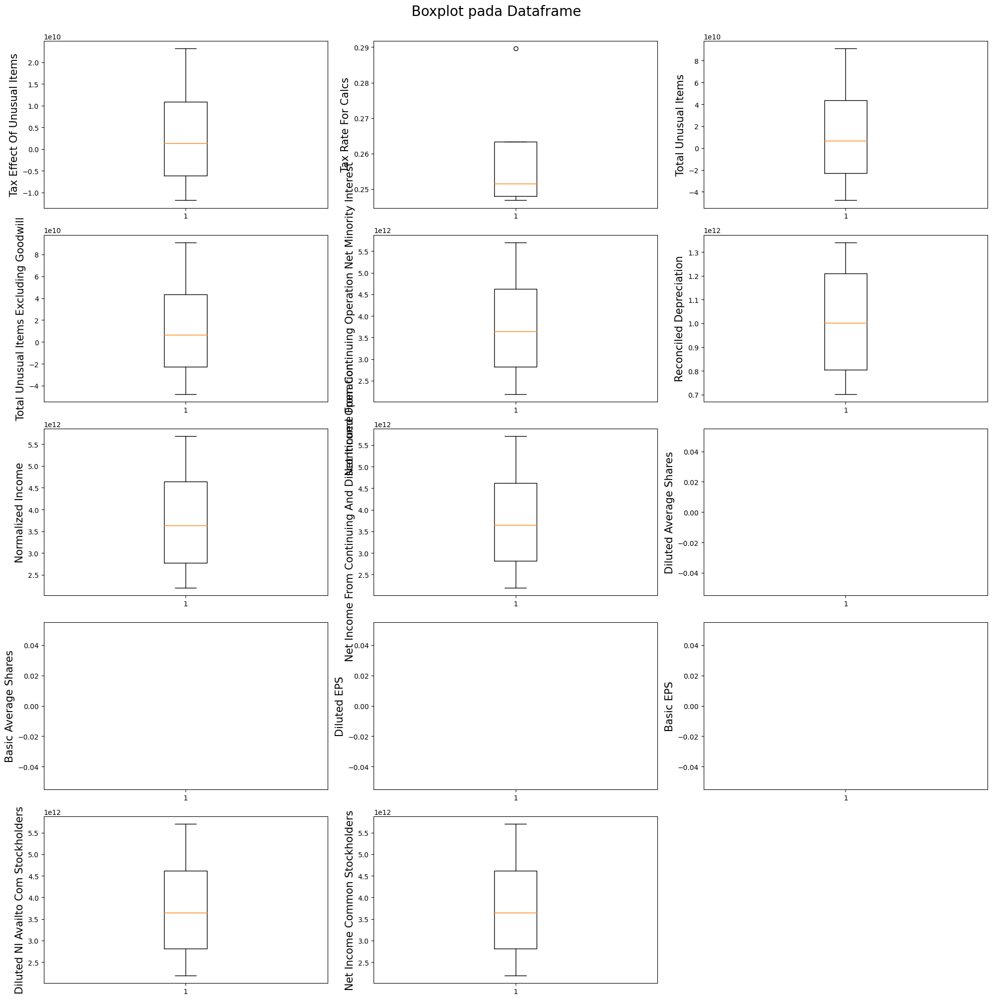

In [ ]:
# Cek Outliers Dengan menggunakan boxplot
plt.figure(figsize=(20,20))

plotnumber=1
for column in bris_income_stat.columns:
    if plotnumber<15 :
        plt.subplot(5,3,plotnumber)  #5 baris dan 3 columns
        plt.boxplot(bris_income_stat[column])
        plt.ylabel(column,fontsize=15)
    plotnumber+=1

plt.suptitle('Boxplot pada Dataframe', fontsize=20, y=1)  # Tambah judul
plt.tight_layout()
plt.show()


Catatan: ada beberapa outlier dalam data, namun tidak akan diubah secara lanjut karena sensitivitas data yang tidak bisa dimodifikasi. Sehingga outlier dalam data akan tetap dibiarkan.

Untuk beberapa features menunjukan tidak ada ada nya data (box plot). Hal ini dikarenakan features tersebut tidak ada pada laporan Income Stat Bank tersebut.

11. Bank Mega

In [ ]:
mega_income_stat[common_columns_list].describe()

,Diluted Average Shares,Net Income Continuous Operations,Operating Revenue,Net Income,Net Income From Continuing And Discontinued Operation,Insurance And Claims,Depreciation Income Statement,Other Operating Expenses,Selling General And Administration,Normalized Income,...,Tax Rate For Calcs,Depreciation And Amortization In Income Statement,Diluted NI Availto Com Stockholders,Basic Average Shares,Total Revenue,Basic EPS,Net Income Common Stockholders,Operating Expense,Rent And Landing Fees,Diluted EPS
count,3.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,...,4.000000,4.000000e+00,4.000000e+00,3.000000e+00,4.000000e+00,3.000000,4.000000e+00,4.000000e+00,4.000000e+00,3.000000
mean,1.187582e+10,3.644928e+12,7.147760e+12,3.644928e+12,3.644928e+12,1.102525e+10,2.899005e+11,8.436525e+10,7.362620e+11,3.645903e+12,...,0.191636,2.899005e+11,3.644928e+12,1.187582e+10,7.147760e+12,311.230124,3.644928e+12,2.503983e+12,2.902525e+10,311.230124
std,2.336464e+08,4.903824e+11,5.970974e+11,4.903824e+11,4.903824e+11,1.494633e+09,2.264294e+10,1.221564e+10,3.506795e+10,4.908370e+11,...,0.001667,2.264294e+10,4.903824e+11,2.336464e+08,5.970974e+11,55.063373,4.903824e+11,1.279898e+11,4.468874e+09,55.063373
min,1.174092e+10,3.008311e+12,6.290488e+12,3.008311e+12,3.008311e+12,8.900000e+09,2.674410e+11,6.720900e+10,6.943300e+11,3.008919e+12,...,0.190237,2.674410e+11,3.008311e+12,1.174092e+10,6.290488e+12,247.690373,3.008311e+12,2.398047e+12,2.417700e+10,247.690373
25%,1.174092e+10,3.385080e+12,6.984294e+12,3.385080e+12,3.385080e+12,1.073450e+10,2.729175e+11,8.113650e+10,7.215512e+11,3.385466e+12,...,0.190599,2.729175e+11,3.385080e+12,1.174092e+10,6.984294e+12,294.345187,3.385080e+12,2.430372e+12,2.689125e+10,294.345187
50%,1.174092e+10,3.759360e+12,7.331026e+12,3.759360e+12,3.759360e+12,1.139850e+10,2.882545e+11,8.715650e+10,7.355390e+11,3.760849e+12,...,0.191159,2.882545e+11,3.759360e+12,1.174092e+10,7.331026e+12,341.000000,3.759360e+12,2.465094e+12,2.849700e+10,341.000000
75%,1.194327e+10,4.019208e+12,7.494492e+12,4.019208e+12,4.019208e+12,1.168925e+10,3.052375e+11,9.038525e+10,7.502498e+11,4.021286e+12,...,0.192196,3.052375e+11,4.019208e+12,1.194327e+10,7.494492e+12,343.000000,4.019208e+12,2.538705e+12,3.063100e+10,343.000000
max,1.214561e+10,4.052678e+12,7.638498e+12,4.052678e+12,4.052678e+12,1.240400e+10,3.156520e+11,9.593900e+10,7.796400e+11,4.052992e+12,...,0.193989,3.156520e+11,4.052678e+12,1.214561e+10,7.638498e+12,345.000000,4.052678e+12,2.687695e+12,3.493000e+10,345.000000


In [ ]:
# Cek Missing Values
mega_income_stat.isna().sum()

Tax Effect Of Unusual Items                                   0
Tax Rate For Calcs                                            0
Total Unusual Items                                           0
Total Unusual Items Excluding Goodwill                        0
Net Income From Continuing Operation Net Minority Interest    0
Reconciled Depreciation                                       0
Net Interest Income                                           0
Interest Expense                                              0
Interest Income                                               0
Normalized Income                                             0
Net Income From Continuing And Discontinued Operation         0
Diluted Average Shares                                        1
Basic Average Shares                                          1
Diluted EPS                                                   1
Basic EPS                                                     1
Diluted NI Availto Com Stockholders     

Catatan: ada beberapa misising value pada data, namun untuk saat ini akan diabaikan (tidak akan didelete atau di impute) karena data tersebut memang tidak ada nilainya, sehingga tidak akan mempengaruhi perhitungan saat proses modelling.

In [ ]:
# cek Duplicated values
mega_income_stat.duplicated()

2020-12-31    False
2021-12-31    False
2022-12-31    False
2023-12-31    False
dtype: bool

Catatan: Hasil pengecekan duplicated value pada range data 4 tahun (2020-2023) adalah nol atau tidak ada. Sehingga tidak akan dilakukan pre-processing lebih jauh.

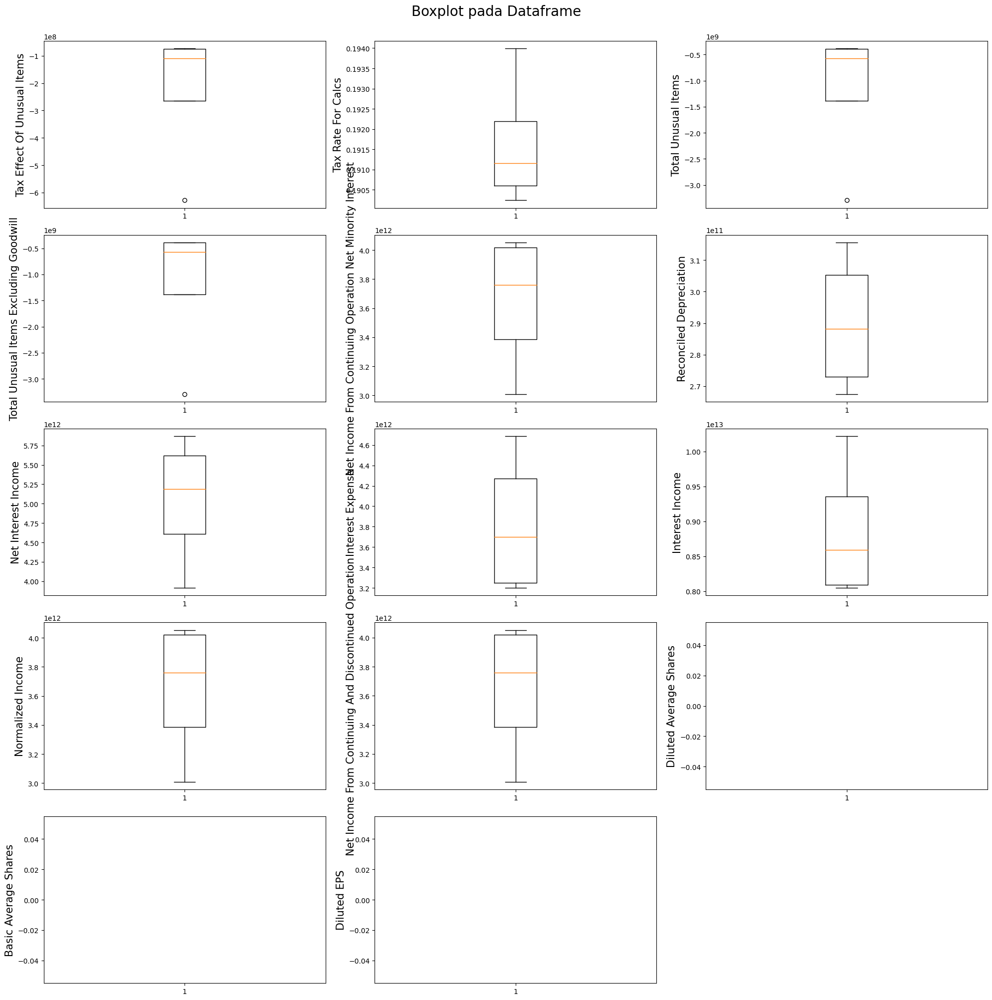

In [ ]:
# Cek Outliers Dengan menggunakan boxplot
plt.figure(figsize=(20,20))

plotnumber=1
for column in mega_income_stat.columns:
    if plotnumber<15 :
        plt.subplot(5,3,plotnumber)  #5 baris dan 3 columns
        plt.boxplot(mega_income_stat[column])
        plt.ylabel(column,fontsize=15)
    plotnumber+=1

plt.suptitle('Boxplot pada Dataframe', fontsize=20, y=1)  # Tambah judul
plt.tight_layout()
plt.show()


Catatan: ada beberapa outlier dalam data, namun tidak akan diubah secara lanjut karena sensitivitas data yang tidak bisa dimodifikasi. Sehingga outlier dalam data akan tetap dibiarkan.

Untuk beberapa features menunjukan tidak ada ada nya data (box plot). Hal ini dikarenakan features tersebut tidak ada pada laporan Income Stat Bank tersebut.

12. Bank OCBC NISP

In [ ]:
nisp_income_stat[common_columns_list].describe()

,Diluted Average Shares,Net Income Continuous Operations,Operating Revenue,Net Income,Net Income From Continuing And Discontinued Operation,Insurance And Claims,Depreciation Income Statement,Other Operating Expenses,Selling General And Administration,Normalized Income,...,Tax Rate For Calcs,Depreciation And Amortization In Income Statement,Diluted NI Availto Com Stockholders,Basic Average Shares,Total Revenue,Basic EPS,Net Income Common Stockholders,Operating Expense,Rent And Landing Fees,Diluted EPS
count,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,...,4.000000,4.000000e+00,4.000000e+00,4.000000e+00,4.000000e+00,4.00000,4.000000e+00,4.000000e+00,4.000000e+00,4.00000
mean,2.294530e+10,3.009816e+12,1.027875e+13,3.009797e+12,3.009797e+12,4.083982e+11,2.563170e+11,2.210738e+11,1.004868e+12,3.158953e+12,...,0.220258,2.563170e+11,3.009797e+12,2.294530e+10,1.027875e+13,131.17250,3.009797e+12,4.504663e+12,1.007312e+11,131.17250
std,0.000000e+00,8.821628e+11,8.446471e+11,8.821638e+11,8.821638e+11,3.207571e+10,4.411270e+10,4.092634e+10,1.167598e+11,9.541498e+11,...,0.016750,4.411270e+10,8.821638e+11,0.000000e+00,8.446471e+11,38.44934,8.821638e+11,4.126701e+11,2.060830e+10,38.44934
min,2.294530e+10,2.101671e+12,9.487366e+12,2.101670e+12,2.101670e+12,3.778510e+11,2.130740e+11,1.882510e+11,9.097280e+11,2.249782e+12,...,0.210903,2.130740e+11,2.101670e+12,2.294530e+10,9.487366e+12,91.59000,2.101670e+12,4.125764e+12,7.392300e+10,91.59000
25%,2.294530e+10,2.415132e+12,9.650311e+12,2.415098e+12,2.415098e+12,3.842245e+11,2.308370e+11,1.898732e+11,9.196062e+11,2.453147e+12,...,0.211169,2.308370e+11,2.415098e+12,2.294530e+10,9.650311e+12,105.25500,2.415098e+12,4.192143e+12,9.105900e+10,105.25500
50%,2.294530e+10,2.923274e+12,1.015557e+13,2.923246e+12,2.923246e+12,4.045640e+11,2.480375e+11,2.104760e+11,9.738025e+11,3.032881e+12,...,0.212404,2.480375e+11,2.923246e+12,2.294530e+10,1.015557e+13,127.40000,2.923246e+12,4.440896e+12,1.035625e+11,127.40000
75%,2.294530e+10,3.517958e+12,1.078401e+13,3.517945e+12,3.517945e+12,4.287378e+11,2.735175e+11,2.416765e+11,1.059064e+12,3.738687e+12,...,0.221494,2.735175e+11,3.517945e+12,2.294530e+10,1.078401e+13,153.31750,3.517945e+12,4.753416e+12,1.132348e+11,153.31750
max,2.294530e+10,4.091043e+12,1.131651e+13,4.091028e+12,4.091028e+12,4.466140e+11,3.161190e+11,2.750920e+11,1.162140e+12,4.320266e+12,...,0.245321,3.161190e+11,4.091028e+12,2.294530e+10,1.131651e+13,178.30000,4.091028e+12,5.011095e+12,1.218770e+11,178.30000


In [ ]:
# Cek Missing Values
nisp_income_stat.isna().sum()

Tax Effect Of Unusual Items                                   0
Tax Rate For Calcs                                            0
Total Unusual Items                                           0
Total Unusual Items Excluding Goodwill                        0
Net Income From Continuing Operation Net Minority Interest    0
Reconciled Depreciation                                       0
Net Interest Income                                           0
Interest Expense                                              0
Interest Income                                               0
Normalized Income                                             0
Net Income From Continuing And Discontinued Operation         0
Diluted Average Shares                                        0
Basic Average Shares                                          0
Diluted EPS                                                   0
Basic EPS                                                     0
Diluted NI Availto Com Stockholders     

Catatan: Karena dtidak ada missing value, maka akan dilanjutkan untuk proses berikutnya.

In [ ]:
# cek Duplicated values
nisp_income_stat.duplicated()

2020-12-31    False
2021-12-31    False
2022-12-31    False
2023-12-31    False
dtype: bool

Catatan: Hasil pengecekan duplicated value pada range data 4 tahun (2020-2023) adalah nol atau tidak ada. Sehingga tidak akan dilakukan pre-processing lebih jauh.

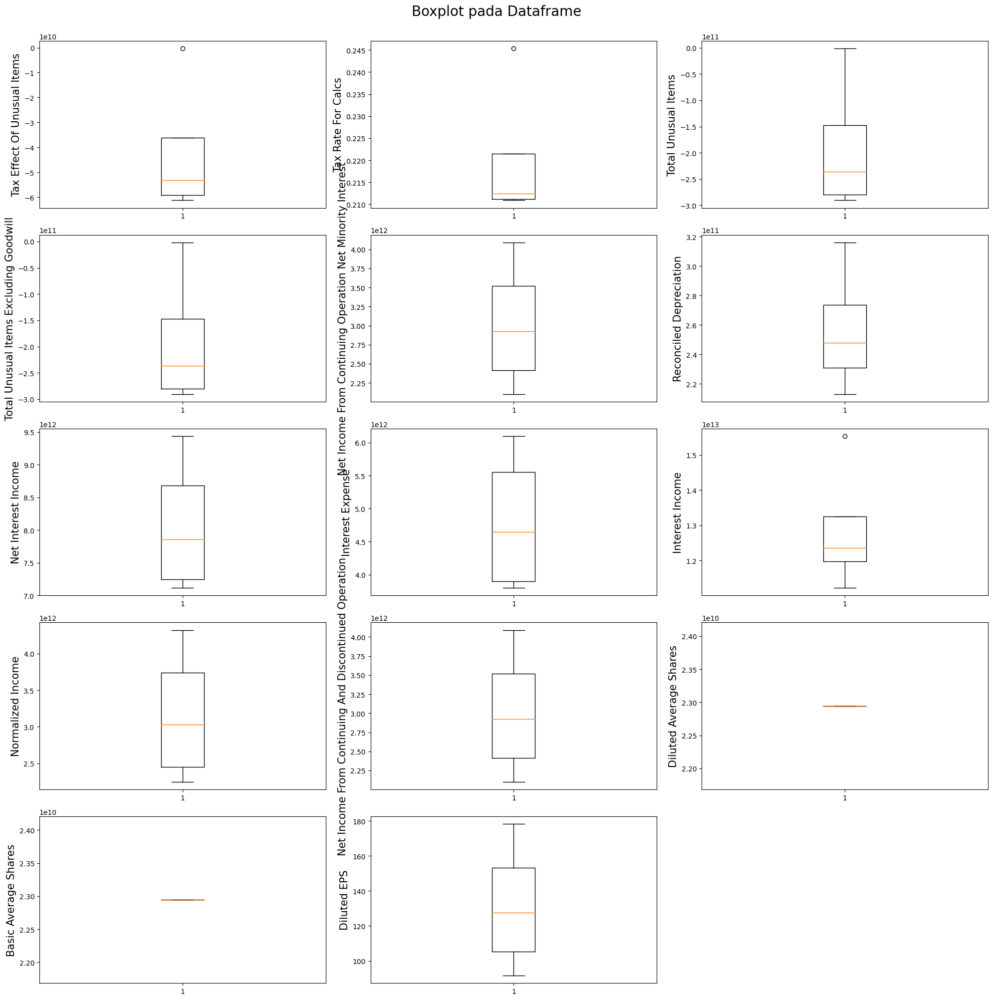

In [ ]:
# Cek Outliers Dengan menggunakan boxplot
plt.figure(figsize=(20,20))

plotnumber=1
for column in nisp_income_stat.columns:
    if plotnumber<15 :
        plt.subplot(5,3,plotnumber)  #5 baris dan 3 columns
        plt.boxplot(nisp_income_stat[column])
        plt.ylabel(column,fontsize=15)
    plotnumber+=1

plt.suptitle('Boxplot pada Dataframe', fontsize=20, y=1)  # Tambah judul
plt.tight_layout()
plt.show()


Catatan: ada beberapa outlier dalam data, namun tidak akan diubah secara lanjut karena sensitivitas data yang tidak bisa dimodifikasi. Sehingga outlier dalam data akan tetap dibiarkan.

Untuk beberapa features menunjukan tidak ada ada nya data (box plot). Hal ini dikarenakan features tersebut tidak ada pada laporan Income Stat Bank tersebut.

## Keystat

1. Bank Arto

In [ ]:
arto_keystat

,Unnamed: 0,address1,address2,city,zip,country,phone,fax,website,industry,...,totalDebt,totalRevenue,revenuePerShare,returnOnAssets,returnOnEquity,operatingCashflow,revenueGrowth,operatingMargins,financialCurrency,trailingPegRatio
0,0,Menara BTPN,Lantai 46 Jl. Dr. Ide Anak Agung Gde Agung Kav...,Jakarta,12950,Indonesia,62 21 509 27460,62 21 509 27479,https://www.jago.com,Banks - Regional,...,149211004928,1360788979712,98.164,0.00378,0.00871,-1893348016128,0.359,0.0649,IDR,NaN


In [ ]:
# Mencari missing value di setiap kolom
arto_keystat.isna().sum()

Unnamed: 0           0
address1             0
address2             0
city                 0
zip                  0
                    ..
operatingCashflow    0
revenueGrowth        0
operatingMargins     0
financialCurrency    0
trailingPegRatio     1
Length: 94, dtype: int64

In [ ]:
missing_columns = arto_keystat.columns[arto_keystat.isnull().any()].tolist()
missing_columns

['trailingPegRatio']

2. Bank Aladin

In [ ]:
bank_keystat

,Unnamed: 0,address1,address2,city,zip,country,phone,fax,website,industry,...,totalCashPerShare,totalDebt,totalRevenue,revenuePerShare,returnOnAssets,returnOnEquity,operatingCashflow,operatingMargins,financialCurrency,trailingPegRatio
0,0,Millennium Centennial Center,7th Floor Jl. General Sudirman Kav. 25,Jakarta Selatan,12920,Indonesia,62 21 8550 0947,62 21 3970 8007,https://aladinbank.id,Banks - Regional,...,126.959,614670991360,234524999680,16.978,-0.03835,-0.07281,-2017734033408,-1.44711,IDR,NaN


In [ ]:
bank_keystat.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1 entries, 0 to 0
Data columns (total 93 columns):
 #   Column                        Non-Null Count  Dtype  
---  ------                        --------------  -----  
 0   Unnamed: 0                    1 non-null      int64  
 1   address1                      1 non-null      object 
 2   address2                      1 non-null      object 
 3   city                          1 non-null      object 
 4   zip                           1 non-null      int64  
 5   country                       1 non-null      object 
 6   phone                         1 non-null      object 
 7   fax                           1 non-null      object 
 8   website                       1 non-null      object 
 9   industry                      1 non-null      object 
 10  industryKey                   1 non-null      object 
 11  industryDisp                  1 non-null      object 
 12  sector                        1 non-null      object 
 13  sectorKey

In [ ]:
# Mencari missing value di setiap kolom
bank_keystat.isna().sum()

Unnamed: 0           0
address1             0
address2             0
city                 0
zip                  0
                    ..
returnOnEquity       0
operatingCashflow    0
operatingMargins     0
financialCurrency    0
trailingPegRatio     1
Length: 93, dtype: int64

3. Bank BCA

In [ ]:
bbca_keystat

,Unnamed: 0,address1,address2,city,zip,country,phone,fax,website,industry,...,totalRevenue,revenuePerShare,returnOnAssets,returnOnEquity,operatingCashflow,earningsGrowth,revenueGrowth,operatingMargins,financialCurrency,trailingPegRatio
0,0,Menara BCA Grand Indonesia,Jl. M.H. Thamrin No. 1,Jakarta,10310,Indonesia,62 21 2358 8000,62 21 2358 8300,https://www.bca.co.id,Banks - Regional,...,97666457403392,792.265,0.03574,0.20986,-5488170237952,0.043,0.074,0.59767,IDR,NaN


In [ ]:
bbca_keystat.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1 entries, 0 to 0
Columns: 109 entries, Unnamed: 0 to trailingPegRatio
dtypes: float64(51), int64(29), object(29)
memory usage: 1000.0+ bytes


In [ ]:
# Mencari missing value di setiap kolom
bbca_keystat.isna().sum()

Unnamed: 0           0
address1             0
address2             0
city                 0
zip                  0
                    ..
earningsGrowth       0
revenueGrowth        0
operatingMargins     0
financialCurrency    0
trailingPegRatio     1
Length: 109, dtype: int64

4. Bank BNI

In [ ]:
bbni_keystat

,Unnamed: 0,address1,address2,city,zip,country,phone,fax,website,industry,...,totalRevenue,revenuePerShare,returnOnAssets,returnOnEquity,operatingCashflow,earningsGrowth,revenueGrowth,operatingMargins,financialCurrency,trailingPegRatio
0,0,Gedung Grha BNI,Jl. Jenderal Sudirman Kav. 1,Jakarta Pusat,10220,Indonesia,62 21 251 1946,62 21 251 1961,https://www.bni.co.id,Banks - Regional,...,48521235398656,1302.346,0.01994,0.14313,-27717921669120,0.12,-0.03,0.36615,IDR,NaN


In [ ]:
bbni_keystat.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1 entries, 0 to 0
Columns: 107 entries, Unnamed: 0 to trailingPegRatio
dtypes: float64(49), int64(29), object(29)
memory usage: 984.0+ bytes


In [ ]:
# Mencari missing value di setiap kolom
bbni_keystat.isna().sum()

Unnamed: 0           0
address1             0
address2             0
city                 0
zip                  0
                    ..
earningsGrowth       0
revenueGrowth        0
operatingMargins     0
financialCurrency    0
trailingPegRatio     1
Length: 107, dtype: int64

5. Bank BRI

In [ ]:
bbri_keystat

,Unnamed: 0,address1,address2,city,zip,country,phone,fax,website,industry,...,totalRevenue,revenuePerShare,returnOnAssets,returnOnEquity,operatingCashflow,earningsGrowth,revenueGrowth,operatingMargins,financialCurrency,trailingPegRatio
0,0,BRI Building,Jl. Jenderal Sudirman Kav.44-46,Jakarta,10210,Indonesia,62 21 251 0244,62 21 250 0077,https://bri.co.id,Banks - Regional,...,137058488156160,908.388,0.03155,0.19496,-58039973445632,0.352,0.041,0.42594,IDR,NaN


In [ ]:
bbri_keystat.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1 entries, 0 to 0
Columns: 109 entries, Unnamed: 0 to trailingPegRatio
dtypes: float64(51), int64(29), object(29)
memory usage: 1000.0+ bytes


In [ ]:
# Mencari missing value di setiap kolom
bbri_keystat.isna().sum()

Unnamed: 0           0
address1             0
address2             0
city                 0
zip                  0
                    ..
earningsGrowth       0
revenueGrowth        0
operatingMargins     0
financialCurrency    0
trailingPegRatio     1
Length: 109, dtype: int64

6. Bank BTN

In [ ]:
bbtn_keystat

,Unnamed: 0,address1,address2,city,zip,country,phone,fax,website,industry,...,totalRevenue,revenuePerShare,returnOnAssets,returnOnEquity,operatingCashflow,earningsGrowth,revenueGrowth,operatingMargins,financialCurrency,trailingPegRatio
0,0,BTN Tower,Jl. Gajah Mada No. 1,Jakarta,10130,Indonesia,62 21 633 6789,62 21 633 6719,https://www.btn.co.id,Banks - Regional,...,13550260060160,966.357,0.00833,0.12417,-18721898758144,0.167,0.464,0.51655,IDR,NaN


In [ ]:
bbtn_keystat.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1 entries, 0 to 0
Columns: 105 entries, Unnamed: 0 to trailingPegRatio
dtypes: float64(49), int64(28), object(28)
memory usage: 968.0+ bytes


In [ ]:
# Mencari missing value di setiap kolom
bbtn_keystat.isna().sum()

Unnamed: 0           0
address1             0
address2             0
city                 0
zip                  0
                    ..
earningsGrowth       0
revenueGrowth        0
operatingMargins     0
financialCurrency    0
trailingPegRatio     1
Length: 105, dtype: int64

7. Bank Neo

In [ ]:
bbyb_keystat

,Unnamed: 0,address1,address2,city,zip,country,phone,website,industry,industryKey,...,totalDebt,totalRevenue,revenuePerShare,returnOnAssets,returnOnEquity,operatingCashflow,revenueGrowth,operatingMargins,financialCurrency,trailingPegRatio
0,0,Treasury Tower,"60th Floor District 8 SCBD Lot 28 Jl, Jenderal...",Jakarta Selatan,12190,Indonesia,62 21 709 4950,https://www.bankneocommerce.co.id,Banks - Regional,banks-regional,...,354609004544,777699000320,64.598,-0.03028,-0.1622,-1633616003072,0.473,-0.02751,IDR,NaN


In [ ]:
bbyb_keystat.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1 entries, 0 to 0
Data columns (total 94 columns):
 #   Column                        Non-Null Count  Dtype  
---  ------                        --------------  -----  
 0   Unnamed: 0                    1 non-null      int64  
 1   address1                      1 non-null      object 
 2   address2                      1 non-null      object 
 3   city                          1 non-null      object 
 4   zip                           1 non-null      int64  
 5   country                       1 non-null      object 
 6   phone                         1 non-null      object 
 7   website                       1 non-null      object 
 8   industry                      1 non-null      object 
 9   industryKey                   1 non-null      object 
 10  industryDisp                  1 non-null      object 
 11  sector                        1 non-null      object 
 12  sectorKey                     1 non-null      object 
 13  sectorDis

In [ ]:
# Mencari missing value di setiap kolom
bbyb_keystat.isna().sum()

Unnamed: 0           0
address1             0
address2             0
city                 0
zip                  0
                    ..
operatingCashflow    0
revenueGrowth        0
operatingMargins     0
financialCurrency    0
trailingPegRatio     1
Length: 94, dtype: int64

8. Bank Mandiri

In [ ]:
bmri_keystat

,Unnamed: 0,address1,address2,city,zip,country,phone,fax,website,industry,...,totalRevenue,revenuePerShare,returnOnAssets,returnOnEquity,operatingCashflow,earningsGrowth,revenueGrowth,operatingMargins,financialCurrency,trailingPegRatio
0,0,Plaza Mandiri,Jl. Jenderal Gatot Subroto Kav. 36-38,Jakarta,12190,Indonesia,62 21 526 5045,62 21 527 4477,https://bankmandiri.co.id,Banks - Regional,...,127454572183552,1365.585,0.02882,0.22252,-155565342851072,0.52,0.187,0.58748,IDR,NaN


In [ ]:
bmri_keystat.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1 entries, 0 to 0
Columns: 109 entries, Unnamed: 0 to trailingPegRatio
dtypes: float64(51), int64(29), object(29)
memory usage: 1000.0+ bytes


In [ ]:
# Mencari missing value di setiap kolom
bmri_keystat.isna().sum()

Unnamed: 0           0
address1             0
address2             0
city                 0
zip                  0
                    ..
earningsGrowth       0
revenueGrowth        0
operatingMargins     0
financialCurrency    0
trailingPegRatio     1
Length: 109, dtype: int64

9. Bank CIMBNIAGA

In [ ]:
bnga_keystat

,Unnamed: 0,address1,city,zip,country,phone,fax,website,industry,industryKey,...,totalRevenue,revenuePerShare,returnOnAssets,returnOnEquity,operatingCashflow,earningsGrowth,revenueGrowth,operatingMargins,financialCurrency,trailingPegRatio
0,0,Jl. Jend. Sudirman Kav. 58,Jakarta,12190,Indonesia,62 21 250 5252,62 21 250 5205,https://www.cimbniaga.co.id,Banks - Regional,banks-regional,...,16783983509504,672.603,0.02044,0.13849,-9171745374208,0.307,0.073,0.49313,IDR,NaN


In [ ]:
bnga_keystat.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1 entries, 0 to 0
Columns: 104 entries, Unnamed: 0 to trailingPegRatio
dtypes: float64(49), int64(28), object(27)
memory usage: 960.0+ bytes


In [ ]:
# Mencari missing value di setiap kolom
bnga_keystat.isna().sum()

Unnamed: 0           0
address1             0
city                 0
zip                  0
country              0
                    ..
earningsGrowth       0
revenueGrowth        0
operatingMargins     0
financialCurrency    0
trailingPegRatio     1
Length: 104, dtype: int64

10. Bank BSI

In [ ]:
bris_keystat

,Unnamed: 0,address1,address2,city,zip,country,phone,fax,website,industry,...,totalRevenue,revenuePerShare,returnOnAssets,returnOnEquity,operatingCashflow,earningsGrowth,revenueGrowth,operatingMargins,financialCurrency,trailingPegRatio
0,0,The Tower Building,Jalan Gatot Subroto No. 27 Karet Semanggi Vill...,Jakarta Selatan,12930,Indonesia,62 21 304 05999,62 21 304 21888,https://www.bankbsi.co.id,Banks - Regional,...,17840562241536,386.752,0.0173,0.1579,636789981184,0.322,0.197,0.40977,IDR,NaN


In [ ]:
bris_keystat.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1 entries, 0 to 0
Columns: 103 entries, Unnamed: 0 to trailingPegRatio
dtypes: float64(47), int64(28), object(28)
memory usage: 952.0+ bytes


In [ ]:
# Mencari missing value di setiap kolom
bris_keystat.isna().sum()

Unnamed: 0           0
address1             0
address2             0
city                 0
zip                  0
                    ..
earningsGrowth       0
revenueGrowth        0
operatingMargins     0
financialCurrency    0
trailingPegRatio     1
Length: 103, dtype: int64

11. Bank Mega

In [ ]:
mega_keystat

,Unnamed: 0,address1,address2,city,zip,country,phone,fax,website,industry,...,totalRevenue,revenuePerShare,returnOnAssets,returnOnEquity,operatingCashflow,earningsGrowth,revenueGrowth,operatingMargins,financialCurrency,trailingPegRatio
0,0,Menara Bank Mega,15th Floor Jl. Kapten P. Tendean No.12-14A,Jakarta,12790,Indonesia,62 21 7917 5000,62 21 7918 7100,https://www.bankmega.com,Banks - Regional,...,7625451241472,649.476,0.02564,0.16564,851307986944,-0.493,-0.327,0.54631,IDR,NaN


In [ ]:
mega_keystat.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1 entries, 0 to 0
Data columns (total 97 columns):
 #   Column                        Non-Null Count  Dtype  
---  ------                        --------------  -----  
 0   Unnamed: 0                    1 non-null      int64  
 1   address1                      1 non-null      object 
 2   address2                      1 non-null      object 
 3   city                          1 non-null      object 
 4   zip                           1 non-null      int64  
 5   country                       1 non-null      object 
 6   phone                         1 non-null      object 
 7   fax                           1 non-null      object 
 8   website                       1 non-null      object 
 9   industry                      1 non-null      object 
 10  industryKey                   1 non-null      object 
 11  industryDisp                  1 non-null      object 
 12  sector                        1 non-null      object 
 13  sectorKey

In [ ]:
# Mencari missing value di setiap kolom
mega_keystat.isna().sum()

Unnamed: 0           0
address1             0
address2             0
city                 0
zip                  0
                    ..
earningsGrowth       0
revenueGrowth        0
operatingMargins     0
financialCurrency    0
trailingPegRatio     1
Length: 97, dtype: int64

12. Bank OCBC

In [ ]:
nisp_keystat

,Unnamed: 0,address1,address2,city,zip,country,phone,fax,website,industry,...,totalRevenue,revenuePerShare,returnOnAssets,returnOnEquity,operatingCashflow,earningsGrowth,revenueGrowth,operatingMargins,financialCurrency,trailingPegRatio
0,0,OCBC NISP Tower,Jl. Prof. Dr. Satrio Kav. 25,Jakarta,12940,Indonesia,62 21 2553 3888,62 21 5794 4000,https://www.ocbc.id,Banks - Regional,...,10473315500032,456.447,0.01676,0.11438,-3533663109120,0.332,0.039,0.52511,IDR,NaN


In [ ]:
nisp_keystat.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1 entries, 0 to 0
Data columns (total 99 columns):
 #   Column                        Non-Null Count  Dtype  
---  ------                        --------------  -----  
 0   Unnamed: 0                    1 non-null      int64  
 1   address1                      1 non-null      object 
 2   address2                      1 non-null      object 
 3   city                          1 non-null      object 
 4   zip                           1 non-null      int64  
 5   country                       1 non-null      object 
 6   phone                         1 non-null      object 
 7   fax                           1 non-null      object 
 8   website                       1 non-null      object 
 9   industry                      1 non-null      object 
 10  industryKey                   1 non-null      object 
 11  industryDisp                  1 non-null      object 
 12  sector                        1 non-null      object 
 13  sectorKey

In [ ]:
# Mencari missing value di setiap kolom
nisp_keystat.isna().sum()

Unnamed: 0           0
address1             0
address2             0
city                 0
zip                  0
                    ..
earningsGrowth       0
revenueGrowth        0
operatingMargins     0
financialCurrency    0
trailingPegRatio     1
Length: 99, dtype: int64

cek kolom yang sama

In [ ]:
columns = set(dataframes[0].columns)
for df in dataframes[1:]:
    columns = columns.intersection(df.columns)
columns_list = list(columns)

print("Jumlah kolom yang sama pada semua dataframe:", len(columns_list))
print("Kolom-kolom yang sama pada semua dataframe:", columns_list)

Jumlah kolom yang sama pada semua dataframe: 81
Kolom-kolom yang sama pada semua dataframe: ['currentPrice', 'timeZoneFullName', 'totalRevenue', 'uuid', 'priceHint', 'enterpriseValue', 'sectorKey', 'totalCash', 'mostRecentQuarter', 'sectorDisp', 'maxAge', 'bookValue', 'exchange', 'enterpriseToRevenue', 'fiftyTwoWeekHigh', 'heldPercentInsiders', 'gmtOffSetMilliseconds', 'totalCashPerShare', 'address1', 'sector', 'open', 'fiftyDayAverage', 'profitMargins', 'recommendationKey', 'lastFiscalYearEnd', 'volume', 'dayLow', 'firstTradeDateEpochUtc', 'averageVolume10days', 'priceToBook', 'averageDailyVolume10Day', 'trailingEps', 'longName', 'trailingPegRatio', 'industry', 'shortName', 'zip', 'timeZoneShortName', 'averageVolume', 'quoteType', 'regularMarketDayLow', 'regularMarketDayHigh', 'Unnamed: 0', 'twoHundredDayAverage', 'longBusinessSummary', 'underlyingSymbol', 'website', 'country', 'nextFiscalYearEnd', 'fiftyTwoWeekLow', 'ask', 'netIncomeToCommon', 'revenuePerShare', 'city', 'industryDisp

cek kolom yang berbeda

In [ ]:
# Mengidentifikasi semua kolom unik
all_columns = set()
for df in dataframes:
    all_columns.update(df.columns)

# Membuat dictionary untuk menyimpan kolom yang hilang di setiap DataFrame
missing_columns = {}
for i, df in enumerate(dataframes):
    missing_columns[f"DataFrame {i+1}"] = all_columns - set(df.columns)

# Mencetak informasi tentang kolom yang hilang di setiap DataFrame
for name, cols in missing_columns.items():
    print(f"{name} (missing {len(cols)} columns): {cols}")

DataFrame 1 (missing 15 columns): {'fiveYearAvgDividendYield', 'exDividendDate', 'trailingAnnualDividendYield', 'lastSplitFactor', 'earningsQuarterlyGrowth', 'earningsGrowth', 'fullTimeEmployees', 'lastDividendDate', 'dividendYield', 'lastSplitDate', 'trailingAnnualDividendRate', 'pegRatio', 'lastDividendValue', 'dividendRate', 'payoutRatio'}
DataFrame 2 (missing 16 columns): {'fiveYearAvgDividendYield', 'exDividendDate', 'trailingAnnualDividendYield', 'lastSplitFactor', 'trailingPE', 'earningsQuarterlyGrowth', 'earningsGrowth', 'revenueGrowth', 'lastDividendDate', 'dividendYield', 'lastSplitDate', 'trailingAnnualDividendRate', 'pegRatio', 'lastDividendValue', 'dividendRate', 'payoutRatio'}
DataFrame 3 (missing 0 columns): set()
DataFrame 4 (missing 2 columns): {'trailingAnnualDividendRate', 'trailingAnnualDividendYield'}
DataFrame 5 (missing 0 columns): set()
DataFrame 6 (missing 4 columns): {'lastSplitDate', 'lastSplitFactor', 'trailingAnnualDividendRate', 'trailingAnnualDividendYiel

## Historical Value

In [ ]:
# Bank Jago
# Mengonversi kolom 'date' menjadi tipe data datetime
arto_hist['Date'] = pd.to_datetime(arto_hist['Date'])
# Mengambil bagian tanggal saja dan mengatur hasilnya sebagai indeks data
arto_hist.index = arto_hist['Date'].dt.date

# Bank Aladin Syariah
# Mengonversi kolom 'date' menjadi tipe data datetime
bank_hist['Date'] = pd.to_datetime(bank_hist['Date'])
# Mengambil bagian tanggal saja dan mengatur hasilnya sebagai indeks data
bank_hist.index = bank_hist['Date'].dt.date

# Bank BCA
# Mengonversi kolom 'date' menjadi tipe data datetime
bbca_hist['Date'] = pd.to_datetime(bbca_hist['Date'])
# Mengambil bagian tanggal saja dan mengatur hasilnya sebagai indeks data
bbca_hist.index = bbca_hist['Date'].dt.date

# Bank BNI
# Mengonversi kolom 'date' menjadi tipe data datetime
bbni_hist['Date'] = pd.to_datetime(bbni_hist['Date'])
# Mengambil bagian tanggal saja dan mengatur hasilnya sebagai indeks data
bbni_hist.index = bbni_hist['Date'].dt.date

# Bank BRI
# Mengonversi kolom 'date' menjadi tipe data datetime
bbri_hist['Date'] = pd.to_datetime(bbri_hist['Date'])
# Mengambil bagian tanggal saja dan mengatur hasilnya sebagai indeks data
bbri_hist.index = bbri_hist['Date'].dt.date

# Bank BTN
# Mengonversi kolom 'date' menjadi tipe data datetime
bbtn_hist['Date'] = pd.to_datetime(bbtn_hist['Date'])
# Mengambil bagian tanggal saja dan mengatur hasilnya sebagai indeks data
bbtn_hist.index = bbtn_hist['Date'].dt.date

# Bank Neo Commerce
# Mengonversi kolom 'date' menjadi tipe data datetime
bbyb_hist['Date'] = pd.to_datetime(bbyb_hist['Date'])
# Mengambil bagian tanggal saja dan mengatur hasilnya sebagai indeks data
bbyb_hist.index = bbyb_hist['Date'].dt.date

# Bank Mandiri
# Mengonversi kolom 'date' menjadi tipe data datetime
bmri_hist['Date'] = pd.to_datetime(bmri_hist['Date'])
# Mengambil bagian tanggal saja dan mengatur hasilnya sebagai indeks data
bmri_hist.index = bmri_hist['Date'].dt.date

# Bank CIMB Niaga
# Mengonversi kolom 'date' menjadi tipe data datetime
bnga_hist['Date'] = pd.to_datetime(bnga_hist['Date'])
# Mengambil bagian tanggal saja dan mengatur hasilnya sebagai indeks data
bnga_hist.index = bnga_hist['Date'].dt.date

# Bank BSI
# Mengonversi kolom 'date' menjadi tipe data datetime
bris_hist['Date'] = pd.to_datetime(bris_hist['Date'])
# Mengambil bagian tanggal saja dan mengatur hasilnya sebagai indeks data
bris_hist.index = bris_hist['Date'].dt.date

# Bank MEGA
# Mengonversi kolom 'date' menjadi tipe data datetime
mega_hist['Date'] = pd.to_datetime(mega_hist['Date'])
# Mengambil bagian tanggal saja dan mengatur hasilnya sebagai indeks data
mega_hist.index = mega_hist['Date'].dt.date

# Bank OCBC NISP
# Mengonversi kolom 'date' menjadi tipe data datetime
nisp_hist['Date'] = pd.to_datetime(nisp_hist['Date'])
# Mengambil bagian tanggal saja dan mengatur hasilnya sebagai indeks data
nisp_hist.index = nisp_hist['Date'].dt.date

# Exploratory Data Analysis (EDA)

## Balancesheet

Balance sheet (neraca) adalah salah satu laporan keuangan utama yang digunakan untuk memberikan gambaran tentang posisi keuangan suatu perusahaan pada satu titik waktu tertentu. Neraca mencerminkan keseimbangan antara aset yang dimiliki oleh perusahaan dengan kewajiban yang harus dibayar dan ekuitas yang dimiliki oleh pemegang saham. Laporan ini penting untuk memahami kesehatan finansial perusahaan, likuiditas, dan solvabilitasnya.

Komponen utama dalam balance sheet :
*   Total Assets
*   Total Liability
*   Total Equity


Total Assets adalah jumlah keseluruhan aset yang dimiliki oleh sebuah perusahaan pada waktu tertentu. Aset mencakup segala sesuatu yang dimiliki oleh perusahaan yang memiliki nilai ekonomi dan dapat digunakan untuk menghasilkan keuntungan di masa depan. Total Assets tercantum dalam neraca (balance sheet) perusahaan dan merupakan salah satu komponen utama dalam analisis kesehatan keuangan perusahaan.

Total Assets = Total Liabilities + Total Equity

Total Liabilities (Total Debt) adalah jumlah keseluruhan kewajiban atau utang yang dimiliki oleh sebuah perusahaan pada waktu tertentu. Ini mencakup semua jenis hutang yang harus dibayar oleh perusahaan, baik jangka pendek maupun jangka panjang. Total Liability tercantum dalam neraca (balance sheet) perusahaan dan merupakan salah satu komponen utama dalam analisis kesehatan keuangan perusahaan.

Total Equity adalah nilai kepemilikan bersih dalam sebuah perusahaan yang dimiliki oleh pemegang saham. Total Equity, atau Ekuitas Total, merupakan salah satu komponen utama dalam laporan keuangan perusahaan, khususnya dalam neraca (balance sheet). Ekuitas ini menunjukkan selisih antara total aset perusahaan dengan total liabilitas (kewajiban) perusahaan. Dengan kata lain, Total Equity mengindikasikan jumlah nilai yang akan tersisa untuk pemegang saham jika semua aset dijual dan semua hutang dilunasi.

Total Equity = Total Assets - Total Liabilities

In [ ]:
# List Bank BUMN dan Bank Swasta
bank_bumn = [bbri_balancesheet, bmri_balancesheet, bbni_balancesheet, bbtn_balancesheet, bris_balancesheet]
bank_swasta = [arto_balancesheet, bank_balancesheet, bbca_balancesheet, bbyb_balancesheet, bnga_balancesheet, mega_balancesheet, nisp_balancesheet]

arto_balancesheet.name = 'Bank Jago'
bank_balancesheet.name = 'Bank Aladin Syariah'
bbca_balancesheet.name = 'Bank BCA'
bbni_balancesheet.name = 'Bank BNI'
bbri_balancesheet.name = 'Bank BRI'
bbtn_balancesheet.name = 'Bank BTN'
bbyb_balancesheet.name = 'Bank Neo Commerce'
bmri_balancesheet.name = 'Bank Mandiri'
bnga_balancesheet.name = 'Bank CIMB Niaga'
bris_balancesheet.name = 'Bank BSI'
mega_balancesheet.name = 'Bank Mega'
nisp_balancesheet.name = 'Bank OCBC NISP'

### Total Assets

**Bank BUMN**

Beberapa bank yang termasuk dalam bank BUMN adalah Bank BRI, Bank Mandiri, Bank BNI, Bank BTN, dan Bank BSI.

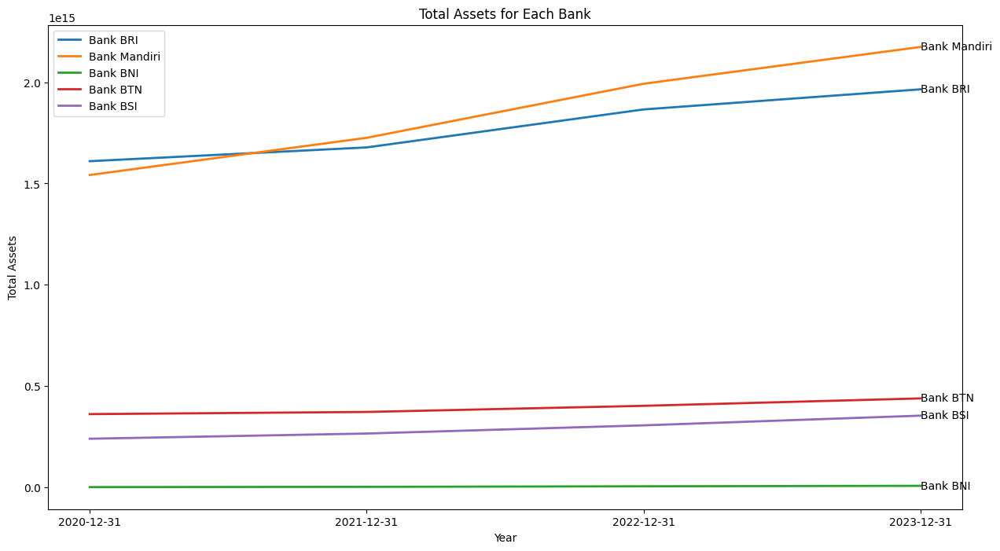

In [ ]:
# Grafik waktu untuk Total Assets untuk setiap bank BUMN
plt.figure(figsize=(15, 8))
for bank in bank_bumn:
    plt.plot(bank.index, bank['Total Assets'], label=bank.name, linewidth= 2)
    # Menambahkan keterangan nama bank di samping garisnya
    plt.text(bank.index[-1], bank['Total Assets'].iloc[-1], bank.name, fontsize=10, verticalalignment='center')
plt.xlabel('Year')
plt.ylabel('Total Assets')
plt.title('Total Assets for Each Bank')
plt.legend()
plt.show()

Dari plot perbandingan Total Assets di atas, dapat diketahui bahwa bank BRI mengalami sedikit kenaikan pada 2 tahun pertama, namun 2 tahun setelahnya mengalami kenaikan. Bank Mandiri selalu mengalami kenaikan yang cukup tinggi pada setiap tahun dan mencapai nilai tertinggi di 2023. Bank BNI stabil setiap tahun namun terbilang rendah jika dibandingkan dengan bank lain. Bank BTN stabil pada 2 tahun pertama, namun setelahnya mengalami sedikit kenaikan. Bank BSI stabil pada 2 tahun pertama, namun setelahnya mengalami sedikit kenaikan.

**Bank Swasta**

Beberapa bank yang termasuk dalam bank Swasta adalah Bank Jago, Bank Aladin Syariah, Bank BCA, Bank Neo Commerce, Bank CMB Niaga, Bank Mega, dan Bank OCBC NISP

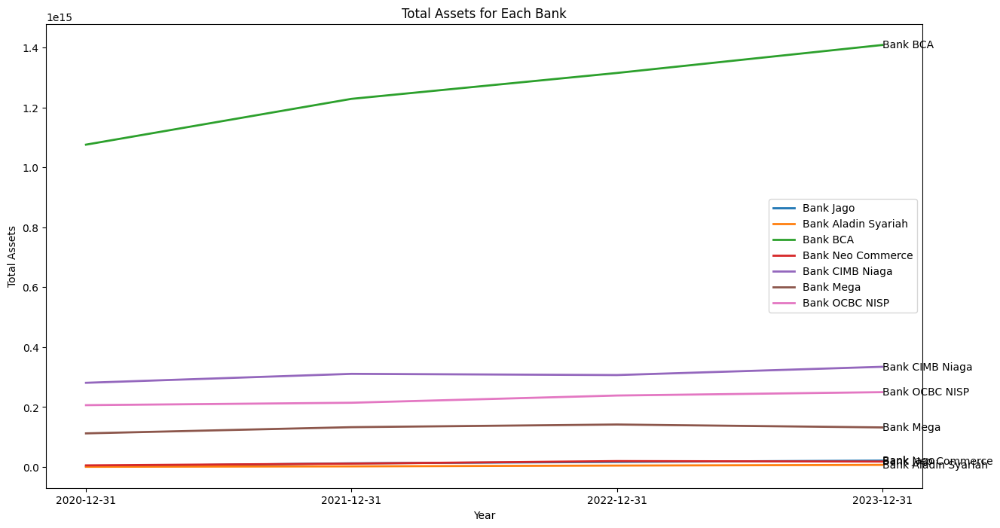

In [ ]:
# Grafik waktu untuk Total Assets untuk setiap bank Swasta
plt.figure(figsize=(15, 8))
for bank in bank_swasta:
    plt.plot(bank.index, bank['Total Assets'], label=bank.name, linewidth= 2)
    # Menambahkan keterangan nama bank di samping garisnya
    plt.text(bank.index[-1], bank['Total Assets'].iloc[-1], bank.name, fontsize=10, verticalalignment='center')
plt.xlabel('Year')
plt.ylabel('Total Assets')
plt.title('Total Assets for Each Bank')
plt.legend()
plt.show()

Dari plot perbandingan Total Assets di atas, dapat diketahui bahwa bank BCA memiliki total assets tertinggi dibandingkan dengan bank lain, yang dimana setiap tahun selalu mengalami kenaikan. Bank CMB Niaga mengalami sedikit sekali kenaikan dari tahun 2020 ke tahun 2021, setelah itu stabil pada tahun berikutnya, namun setelahnya mengalami sedikit kenaikan pada tahun 2023. Bank OCBC NISP terbilang stabil pada 2 tahun pertama, namun setelahnya mengalami sedikit kenaikan pada 2 tahun berikutnya. Bank Mega selalu stabil pada tiap tahunnya. Bank Neo Commerce dan Bank Aladin Syariah selalu stabil setiap tahun dan memiliki total assets terendah dibandingkan dengan bank yang lain.



### Total Liabilities

**Bank BUMN**

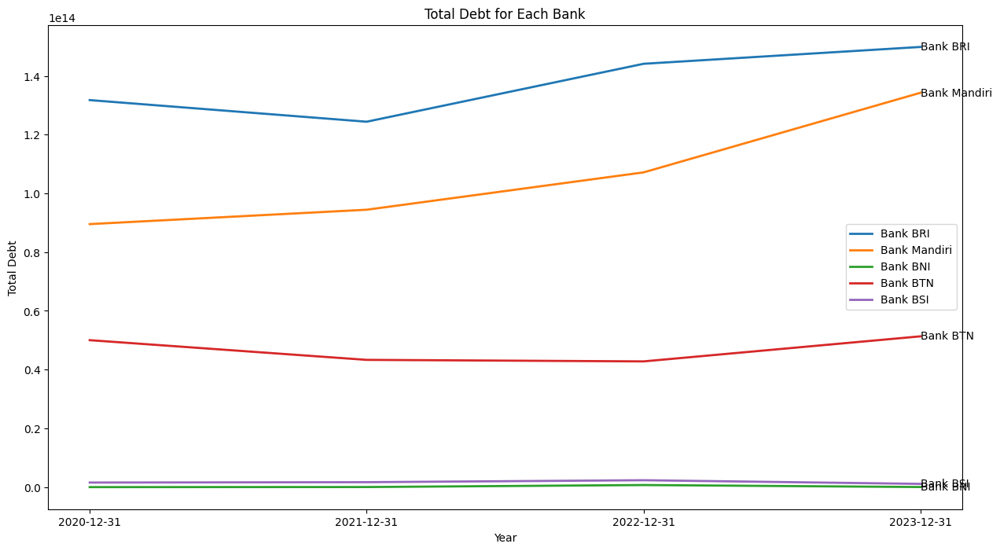

In [ ]:
# Grafik waktu untuk Total Debt untuk setiap bank BUMN
plt.figure(figsize=(15, 8))
for bank in bank_bumn:
    plt.plot(bank.index, bank['Total Debt'], label=bank.name, linewidth= 2)
    # Menambahkan keterangan nama bank di samping garisnya
    plt.text(bank.index[-1], bank['Total Debt'].iloc[-1], bank.name, fontsize=10, verticalalignment='center')
plt.xlabel('Year')
plt.ylabel('Total Debt')
plt.title('Total Debt for Each Bank')
plt.legend()
plt.show()

Dari plot perbandingan Total Liabilities di atas, dapat diketahui bahwa bank BRI mengalami penurunan pada tahun 2021, namun setelah itu selalu meningkat dan mencapai nilai tertinggi di tahun 2023. Bank Mandiri selalu mengalami kenaikan yang cukup tinggi pada setiap tahun dan mengalami kenaikan drastis di tahun 2023. Bank BNI stabil setiap tahun namun terbilang rendah jika dibandingkan dengan bank lain. Bank BTN mengalami penurunan pada 2 tahun pertama, namun setelah itu stabil pada tahun berikutnya dan mengalami kenaikan pada tahun 2023. Bank BSI stabil setiap tahun namun terbilang rendah jika dibandingkan dengan bank lain.

**Bank Swasta**

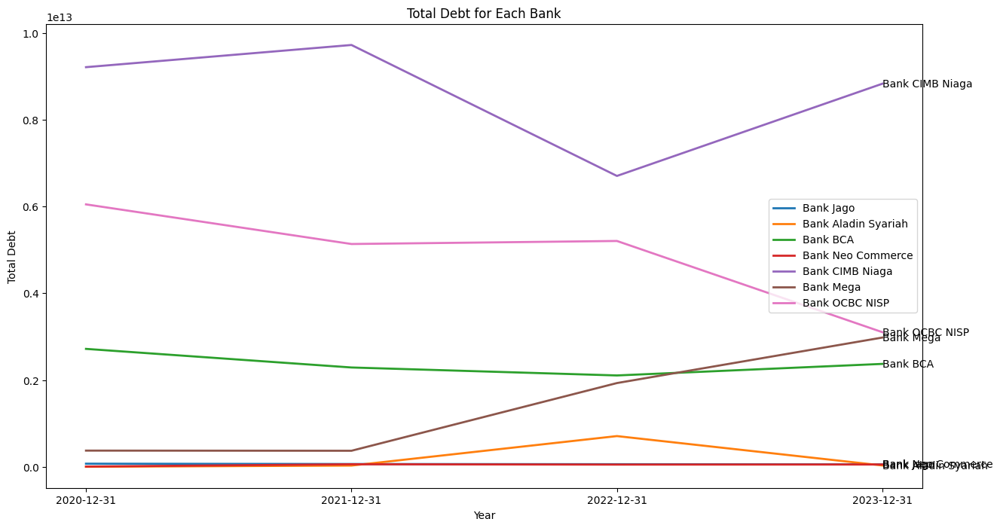

In [ ]:
# Grafik waktu untuk Total Debt untuk setiap bank Swasta
plt.figure(figsize=(15, 8))
for bank in bank_swasta:
    plt.plot(bank.index, bank['Total Debt'], label=bank.name, linewidth= 2)
    # Menambahkan keterangan nama bank di samping garisnya
    plt.text(bank.index[-1], bank['Total Debt'].iloc[-1], bank.name, fontsize=10, verticalalignment='center')
plt.xlabel('Year')
plt.ylabel('Total Debt')
plt.title('Total Debt for Each Bank')
plt.legend()
plt.show()

Dari plot perbandingan Total Liabilities di atas, dapat diketahui bahwa bank CIMB Niaga memiliki total liabilities tertinggi dibandingkan dengan bank lain, mengalami kenaikan pada tahun 2021 ke tahun 2021, namun pada tahun 2022 mengalami penurunan yang drastis, setelahnya mengalami kenaikan pada tahun 2023. Bank OCBC NISP mengalami penurunan dari tahun 2020 ke tahun 2021, pada tahun berikutnya cukup stabil dan pada tahun 2023 mengalami penurunan yang drastis. Bank BCA mengalami penurunan dari tahun 2020 ke tahun 2021, namun setelahnya mengalami kenaikan. Bank Mega stabil pada 2 tahun pertama, namun setelahnya mengalami kenaikan yang drastis pada 2 tahun berikutnya. Bank Aladin Syariah stabil dari tahun 2020 ke tahun 2021, namun setelahnya mengalami kenaikan di tahun 2022 dan mengalami penurunan pada tahun 2023. Bank Neo Commerce memiliki total liabilities terendah dibandingkan dengan bank lain, bisa dibilang stabil walaupun mengalami sedikit kenaikan dari tahun 2022 ke tahun 2024.



### Total Equity

**Bank BUMN**

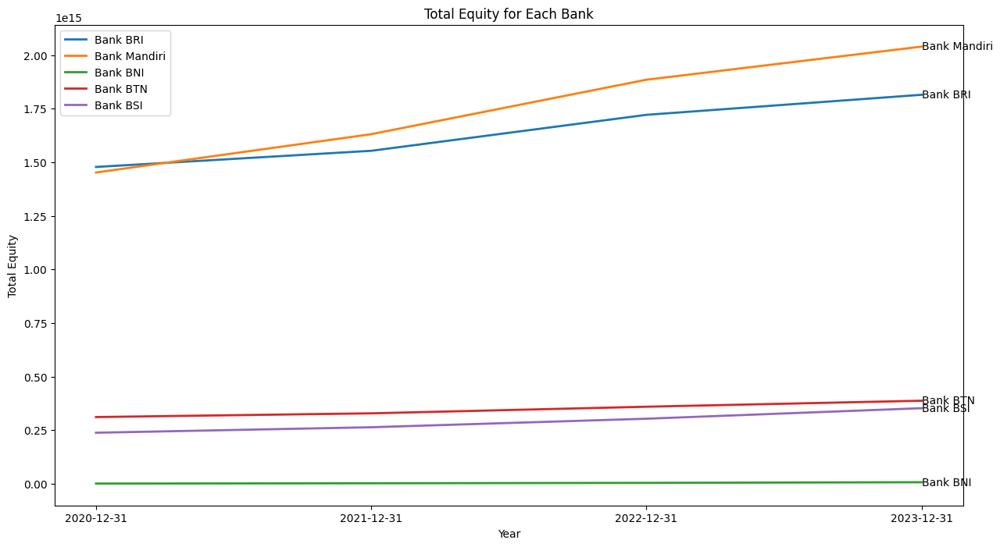

In [ ]:
# Grafik waktu untuk Total Equity untuk setiap bank BUMN
plt.figure(figsize=(15, 8))
for bank in bank_bumn:
    plt.plot(bank.index, bank['Total Equity'], label=bank.name, linewidth= 2)
    # Menambahkan keterangan nama bank di samping garisnya
    plt.text(bank.index[-1], bank['Total Equity'].iloc[-1], bank.name, fontsize=10, verticalalignment='center')
plt.xlabel('Year')
plt.ylabel('Total Equity')
plt.title('Total Equity for Each Bank')
plt.legend()
plt.show()

Dari plot perbandingan Total Equity di atas, dapat diketahui bahwa bank BRI mengalami sedikit kenaikan pada tahun 2021 sampai 2022, namun 2 tahun setelahnya mengalami kenaikan. Bank Mandiri selalu mengalami kenaikan yang cukup tinggi pada setiap tahun dan mencapai nilai tertinggi di 2023. Bank BNI stabil setiap tahun namun terbilang rendah jika dibandingkan dengan bank lain. Bank BTN dan bank BSI mengalami sedikit kenaikan, namun terbilang stabil.

**Bank Swasta**

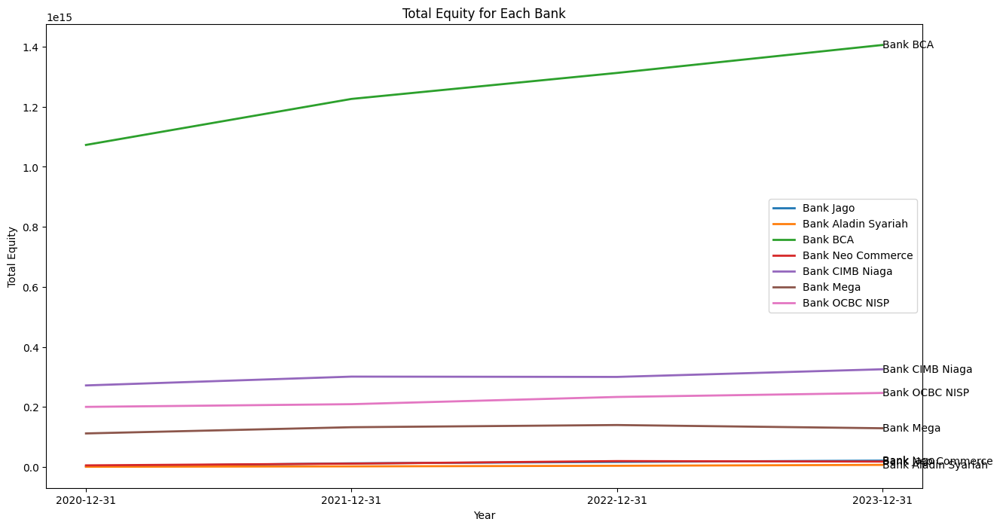

In [ ]:
# Grafik waktu untuk Total Equity untuk setiap bank Swasta
plt.figure(figsize=(15, 8))
for bank in bank_swasta:
    plt.plot(bank.index, bank['Total Equity'], label=bank.name, linewidth= 2)
    # Menambahkan keterangan nama bank di samping garisnya
    plt.text(bank.index[-1], bank['Total Equity'].iloc[-1], bank.name, fontsize=10, verticalalignment='center')
plt.xlabel('Year')
plt.ylabel('Total Equity')
plt.title('Total Equity for Each Bank')
plt.legend()
plt.show()

Dari plot perbandingan Total Equity di atas, dapat diketahui bahwa bank BCA memiliki total equity tertinggi dibandingkan dengan bank lain dan selalu mengalami kenaikan setiap tahun. Bank CMB Niaga dan Bank OCBC NISP terbilang stabil setiap tahun walaupun mengalami sedikit kenaikan pada tahun terakhir. Bank Mega terbilang stabil setiap tahun walaupun mengalami sedikit penurunan pada tahun terakhir. Bank Neo Commerce dan Bank Aladin Syariah selalu stabil setiap tahun dan bank aladin syariah memiliki total equity terendah dibandingkan bank lain.

## Cashflow

Berdasarkan penelitian yang berjudul "Pengaruh Laba Bersih, Komponen Arus Kas, Ukuran Perusahaan terhadap Harga Saham Perusahaan Perbankan pada Masa Pandemi Covid-19" ditemukan bahwa Berdasarkan hasil pengujian hipotesis, terdapat hipotesis yang diterima dan diperoleh bukti empiris bahwa, **Laba Bersih, Arus Kas Operasi, Arus Kas Investasi, Arus Kas Pendanaan, dan Ukuran Perusahaan secara simultan berpengaruh terhadap Harga Saham**. Hal tersebut menunjukkan bahwa, apabila lima variabel tersebut mengalami peningkatan, maka Harga Saham perusahaan juga akan ikut meningkat dan begitu pula sebaliknya

Cash flow atau dikenal juga dengan nama laporan arus kas adalah jenis laporan keuangan yang berisi tentang informasi penerimaan dan pengeluaran kas dalam sebuah perusahaan pada periode waktu tertentu. Fungsi dari laporan ini yaitu untuk memberikan informasi serta revisi dari mana uang kas diperoleh perusahaan dan bagaimana mereka membelanjakannya.

### Mencari variabel yang sama di setiap bank

In [ ]:
# List DataFrame
dataframes = [arto_cashflow, bank_cashflow, bbca_cashflow, bbni_cashflow,
              bbri_cashflow, bbtn_cashflow, bbyb_cashflow, bmri_cashflow,
              bnga_cashflow, bris_cashflow, mega_cashflow, nisp_cashflow]

In [ ]:
# Mendapatkan kolom-kolom yang sama
common_columns = set(dataframes[0].columns)
for df in dataframes[1:]:
    common_columns = common_columns.intersection(df.columns)

# Mengubah set menjadi list
common_columns_list = list(common_columns)

print("Kolom-kolom yang sama di antara semua DataFrame:")
print(common_columns_list)

Kolom-kolom yang sama di antara semua DataFrame:
['Free Cash Flow', 'Classesof Cash Receiptsfrom Operating Activities', 'Cash Flowsfromusedin Operating Activities Direct', 'Changes In Cash', 'Capital Expenditure', 'Other Cash Paymentsfrom Operating Activities', 'Investing Cash Flow', 'Operating Cash Flow', 'Beginning Cash Position', 'End Cash Position', 'Net PPE Purchase And Sale', 'Purchase Of Investment', 'Purchase Of PPE', 'Net Investment Purchase And Sale', 'Classesof Cash Payments', 'Other Cash Receiptsfrom Operating Activities', 'Sale Of Investment', 'Financing Cash Flow']


Diperoleh bahwa terdapat 18 kolom/fitur yang sama dari seluruh dataframe cashflow tiap bank yaitu Free Cash Flow, Classes of Cash Receipts from Operating Activities, Cash Flows from used in Operating Activities Direct, Changes In Cash, Capital Expenditure, Other Cash Payments from Operating Activities, Investing Cash Flow, Operating Cash Flow, Beginning Cash Position, End Cash Position, Net PPE Purchase And Sale, Purchase Of Investment, Purchase Of PPE, Net Investment Purchase And Sale, Classes of Cash Payments, Other Cash Receipts from Operating Activities, Sale Of Investment, dan Financing Cash Flow.

In [ ]:
# Mengelompokkan data menjadi kategori Bank BUMN dan Bank Swasta
bank_bumn = [bbri_cashflow, bmri_cashflow, bbni_cashflow, bbtn_cashflow, bris_cashflow]
bank_swasta = [arto_cashflow, bank_cashflow, bbca_cashflow, bbyb_cashflow, bnga_cashflow, mega_cashflow, nisp_cashflow]

# Memberi nama untuk tiap dataframe
arto_cashflow.name = 'Bank Jago'
bank_cashflow.name = 'Bank Aladin Syariah'
bbca_cashflow.name = 'Bank BCA'
bbni_cashflow.name = 'Bank BNI'
bbri_cashflow.name = 'Bank BRI'
bbtn_cashflow.name = 'Bank BTN'
bbyb_cashflow.name = 'Bank Neo Commerce'
bmri_cashflow.name = 'Bank Mandiri'
bnga_cashflow.name = 'Bank CIMB Niaga'
bris_cashflow.name = 'Bank BSI'
mega_cashflow.name = 'Bank Mega'
nisp_cashflow.name = 'Bank OCBC NISP'

### Arus Kas Operasi

Arus kas dari aktivitas operasional (operating cash flow) mencerminkan arus kas yang dihasilkan atau digunakan oleh perusahaan dari kegiatan operasionalnya selama periode tertentu. **Ini mencakup penerimaan dan pembayaran kas yang terkait dengan operasi inti perusahaan, seperti penjualan produk atau layanan, pembayaran kepada pemasok, pembayaran gaji, pajak, dan biaya operasional lainnya**. Terdapat beberapa variabel/kolom yang termasuk pada arus kas operasi yaitu:

1. **Classesof Cash Receiptsfrom Operating Activities**: Penerimaan kas dari aktivitas operasional utama perusahaan, seperti penjualan produk atau layanan.
2. **Other Cash Paymentsfrom Operating Activities**: Pembayaran kas lainnya yang berasal dari aktivitas operasional perusahaan, seperti pembayaran pajak atau biaya operasional.
3. **Cash Flowsfromusedin Operating Activities Direct**: Detail arus kas dari aktivitas operasional langsung, seperti penerimaan langsung dari penjualan.
4. **Operating Cash Flow**: Jumlah kas yang dihasilkan dari aktivitas operasional perusahaan.

Operating cash flow adalah ukuran penting dari kesehatan keuangan operasional perusahaan karena menunjukkan seberapa baik perusahaan menghasilkan kas dari kegiatan inti bisnisnya. Peningkatan operasi kas yang kuat menunjukkan kemampuan perusahaan untuk membiayai pertumbuhan organik dan memenuhi kewajiban keuangan rutin. Oleh karena itu, dapat disimpulkan bahwa Operating Cash Flow sudah cukup menggambarkan arus kas operasi dari suatu bank. Selanjutnya akan dilihat perbandingan operating cash flow untuk tiap bank dengan dibagi antara Bank BUMN dan Bank Swasta.

**Operating Cash Flow**

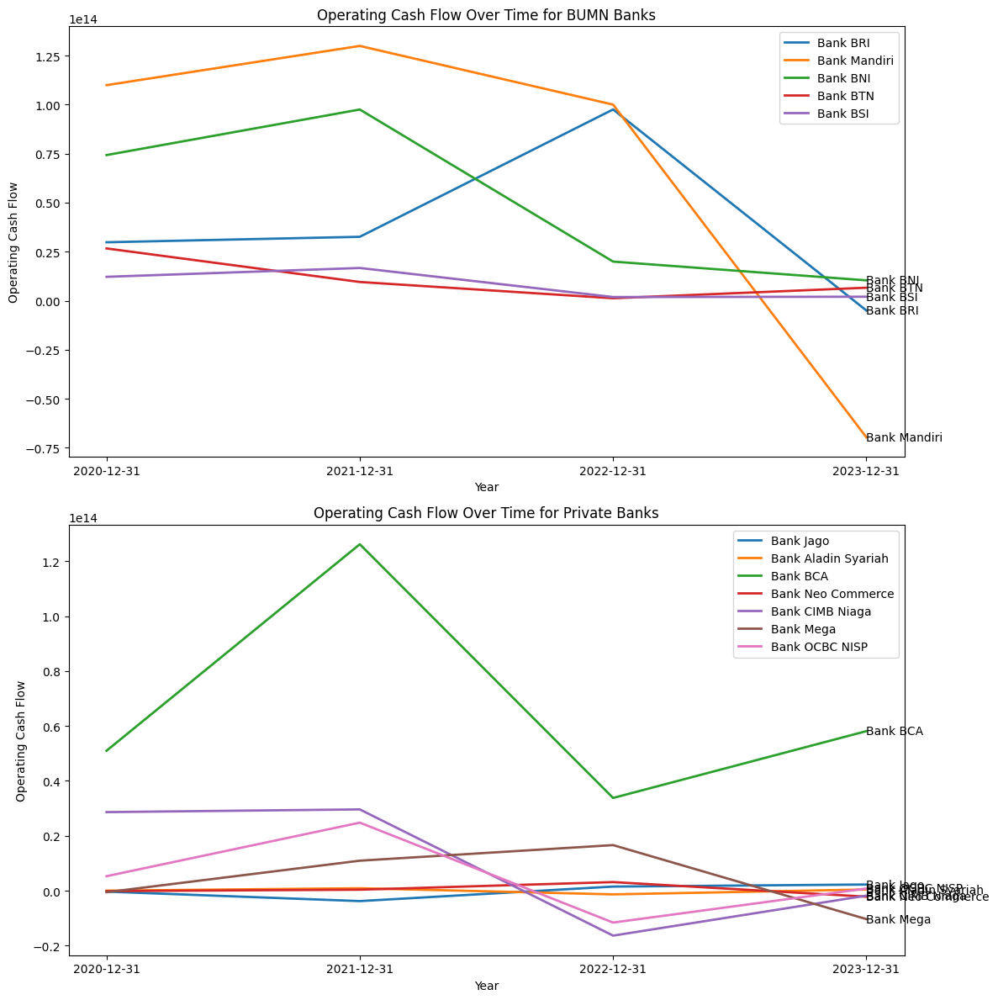

In [ ]:
# Membuat subplots dengan 2 baris dan 1 kolom, serta menentukan ukuran gambar
fig, axs = plt.subplots(2, 1, figsize=(12, 12))

# Plot untuk bank BUMN
axs[0].set_title('Operating Cash Flow Over Time for BUMN Banks')  # Menentukan judul subplot pertama
for bank in bank_bumn:  # Loop melalui setiap bank dalam bank_bumn
    axs[0].plot(bank.index, bank['Operating Cash Flow'], label=bank.name, linewidth=2)  # Plot data bank dengan label dan ketebalan garis yang ditentukan
    axs[0].text(bank.index[-1], bank['Operating Cash Flow'].iloc[-1], bank.name, fontsize=10, verticalalignment='center')  # Menambahkan teks dengan nama bank di posisi akhir garis plot
axs[0].set_xlabel('Year')  # Menentukan label sumbu x
axs[0].set_ylabel('Operating Cash Flow')  # Menentukan label sumbu y
axs[0].legend()  # Menampilkan legenda

# Plot untuk bank swasta
axs[1].set_title('Operating Cash Flow Over Time for Private Banks')  # Menentukan judul subplot kedua
for bank in bank_swasta:  # Loop melalui setiap bank dalam bank_swasta
    axs[1].plot(bank.index, bank['Operating Cash Flow'], label=bank.name, linewidth=2)  # Plot data bank dengan label dan ketebalan garis yang ditentukan
    axs[1].text(bank.index[-1], bank['Operating Cash Flow'].iloc[-1], bank.name, fontsize=10, verticalalignment='center')  # Menambahkan teks dengan nama bank di posisi akhir garis plot
axs[1].set_xlabel('Year')  # Menentukan label sumbu x
axs[1].set_ylabel('Operating Cash Flow')  # Menentukan label sumbu y
axs[1].legend()  # Menampilkan legenda

plt.tight_layout()  # Mengatur layout subplot agar tidak tumpang tindih
plt.show()  # Menampilkan plot



> Bank BUMN

Dari plot perbandingan Operating Cash Flow dapat dilihat bahwa pada tahun 2020-2022 bank Mandiri memiliki nilai Operating Cash Flow terbesar namun turun drastis mencapai minus pada tahun 2023. Bank BNI mengalami peningkatan dari 2020 ke 2021 namun setelahnya mengalami penurunan. Bank BRI cukup stabil pada 2 tahun pertama, meningkat drastis pada 2022 dan turun drastis pada 2023. Sementara bank BTN dan bank BSI hanya mengalami sedikit kenaikan dan penurunan namun nilainya cukup rendah dibanding bank lain.

> Bank Swasta

Dari plot perbandingan Operating Cash Flow dapat dilihat bahwa bank BCA memiliki Operating Cash Flow terbesar dibandingkan bank lain meskipun mengalami kenaikan dan penurunan yang cukup drastis. Bank OCBC NISP dan Bank CIMB Niaga mengalami sedikit peningkatan pada tahun 2020 sampai 2021 namun turun drastis mencapai minus pada tahun 2022 dan kembali meningkat lagi di tahun 2023. Bank Mega mengalami sedikit peningkatan pada tahun 2020 sampai 2022 namun mengalami penurunan pada tahun 2023. Sementara bank Jago, Neo Commerce, dan Aladin Syariah hanya mengalami sedikit kenaikan dan penurunan, terbilang stabil, namun nilainya rendah dibandingkan bank lain.



### Arus Kas Investasi

Arus kas dari aktivitas investasi (investing cash flow) mencerminkan arus kas yang dihasilkan atau digunakan oleh perusahaan dari aktivitas investasi selama periode tertentu. **Ini meliputi pembelian atau penjualan aset tetap seperti tanah, bangunan, peralatan, dan investasi jangka panjang lainnya. Juga termasuk pembelian atau penjualan investasi pasar keuangan seperti saham, obligasi, atau surat berharga lainnya**. Arus kas dari aktivitas investasi memberikan gambaran tentang seberapa aktif perusahaan dalam mengalokasikan modalnya untuk pertumbuhan dan investasi jangka panjang.

1. **Investing Cash Flow**: Arus kas yang terkait dengan aktivitas investasi perusahaan, seperti pembelian dan penjualan aset tetap (PPE), investasi keuangan, dan akuisisi investasi lainnya.
2. **Purchase Of PPE (Pembelian Aset Tetap)**: Pengeluaran untuk membeli aset tetap seperti tanah, bangunan, mesin, dan peralatan.
3. **Capital Expenditure**: Pengeluaran untuk membeli atau memperbaiki aset tetap.
4. **Purchase Of Investment**: Pembelian investasi seperti saham, obligasi, atau aset keuangan lainnya.
5. **Net Investment Purchase And Sale**: Selisih antara jumlah pembelian dan penjualan investasi dalam periode tertentu.
6. **Sale Of Investment**: Pendapatan dari penjualan investasi jangka panjang.

Dapat disimpulkan bahwa Investing Cash Flow sudah cukup menggambarkan arus kas investasi dari suatu bank. Selanjutnya akan dilihat perbandingan investing cash flow untuk tiap bank dengan dibagi antara Bank BUMN dan Bank Swasta.

**Investing Cash Flow**

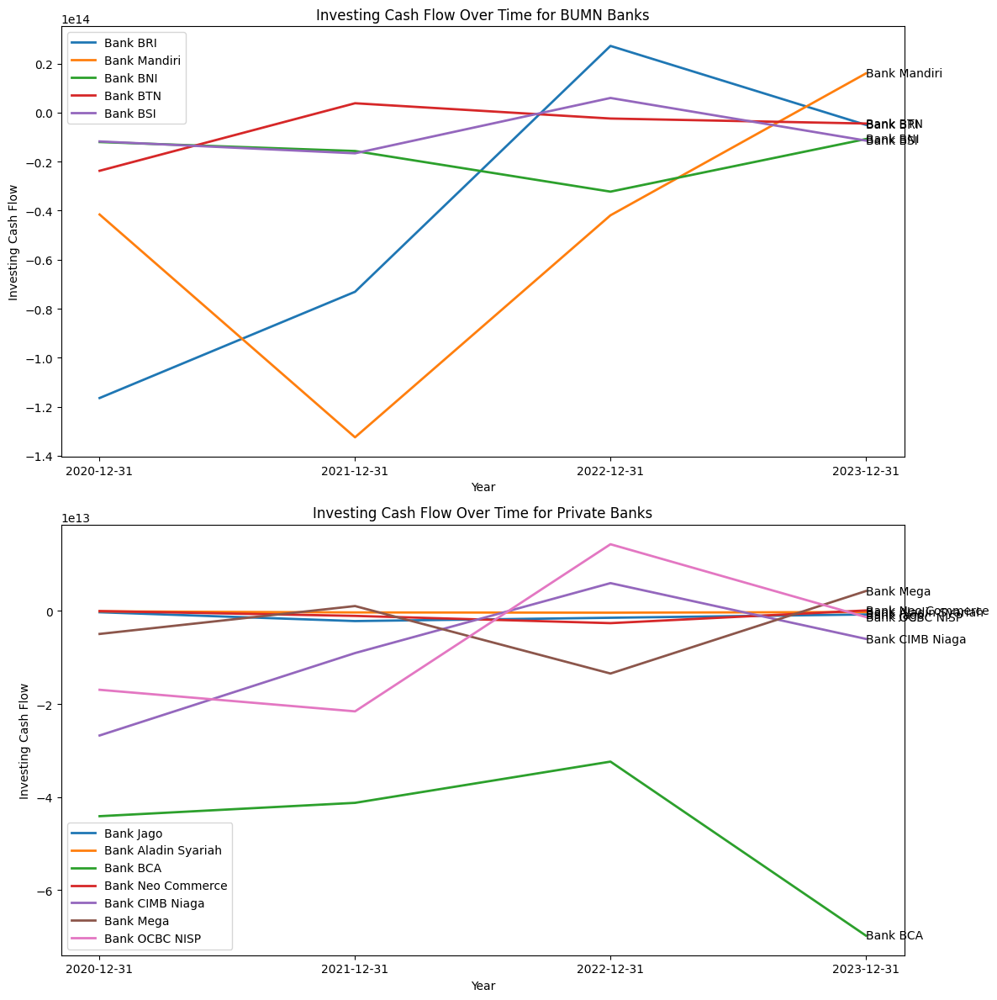

In [ ]:
# Membuat subplots dengan 2 baris dan 1 kolom, serta menentukan ukuran gambar
fig, axs = plt.subplots(2, 1, figsize=(12, 12))

# Plot untuk bank BUMN
axs[0].set_title('Investing Cash Flow Over Time for BUMN Banks')  # Menentukan judul subplot pertama
for bank in bank_bumn:  # Loop melalui setiap bank dalam bank_bumn
    axs[0].plot(bank.index, bank['Investing Cash Flow'], label=bank.name, linewidth=2)  # Plot data bank dengan label dan ketebalan garis yang ditentukan
    axs[0].text(bank.index[-1], bank['Investing Cash Flow'].iloc[-1], bank.name, fontsize=10, verticalalignment='center')  # Menambahkan teks dengan nama bank di posisi akhir garis plot
axs[0].set_xlabel('Year')  # Menentukan label sumbu x
axs[0].set_ylabel('Investing Cash Flow')  # Menentukan label sumbu y
axs[0].legend()  # Menampilkan legenda

# Plot untuk bank swasta
axs[1].set_title('Investing Cash Flow Over Time for Private Banks')  # Menentukan judul subplot kedua
for bank in bank_swasta:  # Loop melalui setiap bank dalam bank_swasta
    axs[1].plot(bank.index, bank['Investing Cash Flow'], label=bank.name, linewidth=2)  # Plot data bank dengan label dan ketebalan garis yang ditentukan
    axs[1].text(bank.index[-1], bank['Investing Cash Flow'].iloc[-1], bank.name, fontsize=10, verticalalignment='center')  # Menambahkan teks dengan nama bank di posisi akhir garis plot
axs[1].set_xlabel('Year')  # Menentukan label sumbu x
axs[1].set_ylabel('Investing Cash Flow')  # Menentukan label sumbu y
axs[1].legend()  # Menampilkan legenda

plt.tight_layout()  # Mengatur layout subplot agar tidak tumpang tindih
plt.show()  # Menampilkan plot



> Bank BUMN

Dari plot perbandingan Investing Cash Flow di atas, dapat diketahui bahwa Bank BRI mengalami peningkatan drastis dari tahun 2020 nilai minus menjadi plus pada tahun 2022, namun kembali mengalami penurunan di tahun 2023. Bank Mandiri mengalami penurunan drastis dari tahun 2020 sampai 2021 namun kembali meningkat hingga di atas 0 pada tahun 2023. Sementara bank BNI, BSI, dan BTN tidak mengalami peningkatan maupun penurunan yang drastis dari tahun 2020 sampai dengan 2023.

> Bank Swasta

Dari plot perbandingan Investing Cash Flow di atas, dapat diketahui bahwa bank BCA mengalami sedikit peningkatan dari tahun 2020 sampai 2022 namun menurun pada tahun 2023. Bank CIMB Niaga mengalami sedikit peningkatan hingga mencapai di atas 0 untuk tahun 2022 meskipun kembali menurun di tahun 2023, begitu juga bank OCBC NISP yang mencapai di atas 0 untuk tahun 2022 meskipun mengalami penurunan pada tahun 2021 dan 2023. Bank Mega mengalami peningkatan pada tahun 2021 dan 2023, namun mengalami penurunan pada tahun 2022. Sementara bank Jago, Aladin Syariah, dan Neo Commerce tidak berubah secara signifikan dan terus berada di sekitaran 0.



### Arus Kas Pendanaan

Arus kas dari aktivitas pendanaan (financing cash flow) mencerminkan arus kas yang dihasilkan atau digunakan oleh perusahaan dari aktivitas pendanaan selama periode tertentu. **Ini termasuk penerimaan atau pembayaran kas terkait dengan sumber pendanaan perusahaan seperti pinjaman bank, penerbitan atau pembelian saham perusahaan (termasuk pembelian kembali saham), pembayaran dividen kepada pemegang saham, dan lain-lain**. Arus kas dari aktivitas pendanaan memberikan informasi tentang bagaimana perusahaan memperoleh dan mengelola modal untuk mendukung operasi dan kegiatan investasi.

1. **Classesof Cash Payments**: Kategori pembayaran kas, termasuk biaya operasional, pembayaran hutang, dan pembayaran lainnya.
2. **Beginning Cash Position**: Jumlah kas yang dimiliki perusahaan pada awal periode.
3. **Changes In Cash**: Perubahan dalam jumlah kas dari awal periode hingga akhir periode.
4. **End Cash Position**: Jumlah kas yang dimiliki perusahaan pada akhir periode.
5. **Free Cash Flow**: Jumlah uang tunai yang tersedia setelah memenuhi kebutuhan modal perusahaan.
6. **Net PPE Purchase And Sale**: Selisih antara jumlah pembelian dan penjualan aset tetap dalam periode tertentu.
7. **Financing Cash Flow**: Arus kas yang terkait dengan pendanaan perusahaan, seperti penerimaan pinjaman atau pembayaran dividen.
8. **Other Cash Receiptsfrom Operating Activities**: Penerimaan kas lainnya yang berasal dari aktivitas operasional.

Dapat disimpulkan bahwa Financing Cash Flow sudah cukup menggambarkan arus kas pendanaan dari suatu bank. Selanjutnya akan dilihat perbandingan financing cash flow untuk tiap bank dengan dibagi antara Bank BUMN dan Bank Swasta.

**Financing Cash Flow**

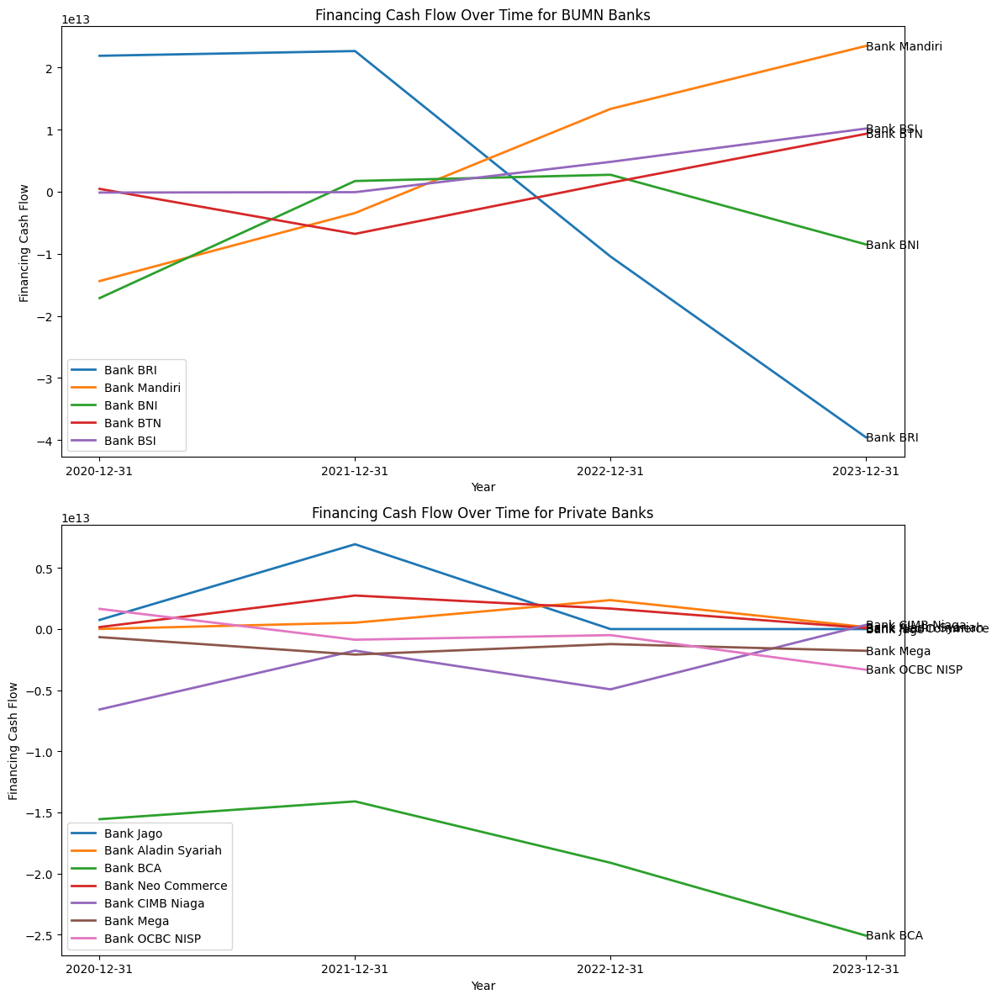

In [ ]:
# Membuat subplots dengan 2 baris dan 1 kolom, serta menentukan ukuran gambar
fig, axs = plt.subplots(2, 1, figsize=(12, 12))

# Plot untuk bank BUMN
axs[0].set_title('Financing Cash Flow Over Time for BUMN Banks')  # Menentukan judul subplot pertama
for bank in bank_bumn:  # Loop melalui setiap bank dalam bank_bumn
    axs[0].plot(bank.index, bank['Financing Cash Flow'], label=bank.name, linewidth=2)  # Plot data bank dengan label dan ketebalan garis yang ditentukan
    axs[0].text(bank.index[-1], bank['Financing Cash Flow'].iloc[-1], bank.name, fontsize=10, verticalalignment='center')  # Menambahkan teks dengan nama bank di posisi akhir garis plot
axs[0].set_xlabel('Year')  # Menentukan label sumbu x
axs[0].set_ylabel('Financing Cash Flow')  # Menentukan label sumbu y
axs[0].legend()  # Menampilkan legenda

# Plot untuk bank swasta
axs[1].set_title('Financing Cash Flow Over Time for Private Banks')  # Menentukan judul subplot kedua
for bank in bank_swasta:  # Loop melalui setiap bank dalam bank_swasta
    axs[1].plot(bank.index, bank['Financing Cash Flow'], label=bank.name, linewidth=2)  # Plot data bank dengan label dan ketebalan garis yang ditentukan
    axs[1].text(bank.index[-1], bank['Financing Cash Flow'].iloc[-1], bank.name, fontsize=10, verticalalignment='center')  # Menambahkan teks dengan nama bank di posisi akhir garis plot
axs[1].set_xlabel('Year')  # Menentukan label sumbu x
axs[1].set_ylabel('Financing Cash Flow')  # Menentukan label sumbu y
axs[1].legend()  # Menampilkan legenda

plt.tight_layout()  # Mengatur layout subplot agar tidak tumpang tindih
plt.show()  # Menampilkan plot



> Bank BUMN

Dari plot perbandingan Financing Cash Flow di atas, dapat diketahui bahwa bank BRI bernilai cukup stabil pada 2 tahun pertama, namun 2 tahun setelahnya mengalami penurunan drastis. Bank BNI mengalami peningkatan dari tahun 2020 ke 2021, cukup stabil sampai 2022, namun mengalami penurunan pada tahun 2023. Bank BTN mengalami penurunan pada tahun 2021, namun setelahnya terus meningkat hingga di atas 0. Bank BSI cukup stabil pada 2 tahun pertamanya, dan meningkat di 2 tahun terakhir. Sementara Bank Mandiri terus mengalami peningkatan hingga tahun 2023 dimana dan mencapai nilai tertinggi di tahun 2023.

> Bank Swasta

Dari plot perbandingan Financing Cash Flow di atas, dapat diketahui bahwa bank BCA sedikit mengalami peningkatan di tahun 2021, namun mengalami penurunan di 2 tahun setelahnya. Bank CIMB Niaga terus mengalami naik turun setiap tahunnya. Bank Jago meningkat di tahun 2021 namun turun pada tahun 2022 dan tidak mengalami perubahan signifikan di tahun 2023. Bank Aladin Syariah sedikit meningkat hingga tahun 2022 namun sedikit menurun di tahun 2023. Bank Neo Commerce sedikit meningkat pada tahun 2021 namun mengalami sedikit penurunan hingga tahun 2023. Sementara Bank Mega dan OCBC NISP mengalami sedikit penurunan dan peningkatan tiap tahunnya.




## Income Stat

Dalam analisis ini, kami menggunakan dataset **Income_Stat** yang berisi berbagai fitur finansial dari bank-bank di Indonesia. **Income_Stat** adalah data yang mencatat pendapatan dan keuntungan bersih dari berbagai bank, memberikan gambaran komprehensif tentang kinerja keuangan mereka. Dataset ini digunakan untuk menganalisis tren pendapatan dan keuntungan dari tahun ke tahun, membantu dalam memahami kinerja finansial dan potensi pertumbuhan setiap bank.

Untuk mempermudah proses Exploratory Data Analysis (EDA), kami mengelompokkan bank-bank tersebut ke dalam dua kategori: Bank BUMN (Badan Usaha Milik Negara) dan Bank Swasta. Kategori Bank BUMN mencakup Bank BRI, Bank Mandiri, Bank BNI, Bank BTN, dan Bank BSI. Sedangkan kategori Bank Swasta terdiri dari Bank BCA, Bank CIMB Niaga, Bank OCBC NISP, Bank Mega, Bank Jago, Bank Aladin Syariah, dan Bank Neo Commerce. Pengelompokan ini memungkinkan kita untuk membandingkan kinerja keuangan antara bank milik pemerintah dan bank swasta.

Dari berbagai fitur yang terdapat dalam dataset **Income_Stat**, kami memilih dua fitur yang dianggap paling penting dan berpengaruh terhadap kenaikan harga saham, yaitu **Total Revenue** dan **Net Income**. **Total Revenue** mencerminkan total pendapatan yang dihasilkan oleh bank dari berbagai sumber selama periode tertentu. **Net Income** adalah laba bersih yang diperoleh setelah dikurangi semua pengeluaran, termasuk biaya operasional dan pajak. Kami memilih fitur ini karena total pendapatan menunjukkan kemampuan bank dalam menghasilkan uang, sementara laba bersih menunjukkan efisiensi bank dalam mengelola pendapatan dan pengeluaran. Kedua fitur ini memberikan indikator yang kuat terhadap kinerja keuangan dan potensi pertumbuhan harga saham bank.

In [ ]:
# Melakukan EDA dengan mengelompokkan Bank kedalam Bank BUMN dan Bank Swasta.
bank_bumn = [bbri_income_stat, bmri_income_stat, bbni_income_stat, bbtn_income_stat, bris_income_stat]
bank_swasta = [arto_income_stat, bank_income_stat, bbca_income_stat, bbyb_income_stat, bnga_income_stat, mega_income_stat, nisp_income_stat]

# Memberi nama bank pada data income_stat
arto_income_stat.name = 'Bank Jago'
bank_income_stat.name = 'Bank Aladin Syariah'
bbca_income_stat.name = 'Bank BCA'
bbni_income_stat.name = 'Bank BNI'
bbri_income_stat.name = 'Bank BRI'
bbtn_income_stat.name = 'Bank BTN'
bbyb_income_stat.name = 'Bank Neo Commerce'
bmri_income_stat.name = 'Bank Mandiri'
bnga_income_stat.name = 'Bank CIMB Niaga'
bris_income_stat.name = 'Bank BSI'
mega_income_stat.name = 'Bank Mega'
nisp_income_stat.name = 'Bank OCBC NISP'

### **Total Revenue**

**Total Revenue** adalah **Pendapatan keseluruhan bank dari berbagai sumber.** Berikut hasil plotting yang membandingkan bank-bank BUMN dan Swasta.

Pertama kita akan melakukan plotting bank-bank BUMN, diantaranya Bank BRI, Mandiri, BNI, BTN dan Bank BSI Syariah.

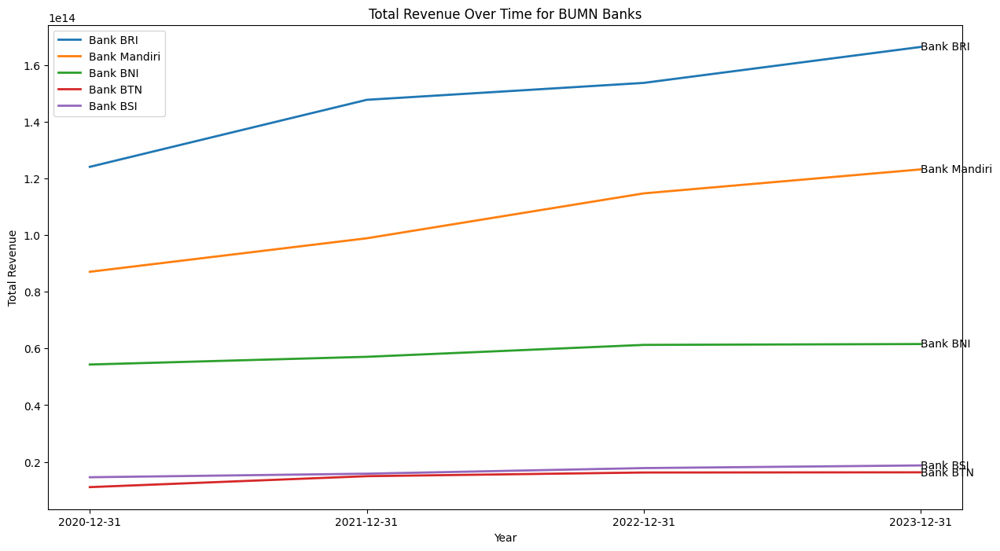

In [ ]:
# Grafik waktu untuk Total Revenue setiap bank BUMN
plt.figure(figsize=(15, 8))
for bank in bank_bumn:
    plt.plot(bank.index, bank['Total Revenue'], label=bank.name, linewidth= 2)
    # Menambahkan keterangan nama bank di samping garisnya
    plt.text(bank.index[-1], bank['Total Revenue'].iloc[-1], bank.name, fontsize=10, verticalalignment='center')
plt.xlabel('Year')
plt.ylabel('Total Revenue')
plt.title('Total Revenue Over Time for BUMN Banks')
plt.legend()
plt.show()

Plot ini menunjukkan tren pendapatan total beberapa bank BUMN (Badan Usaha Milik Negara) di Indonesia dari tahun 2020 hingga 2023. Bank BRI (Biru) secara konsisten memiliki pendapatan total tertinggi, dengan peningkatan yang stabil dari sekitar 1.2x10^14 pada akhir 2020 menjadi hampir 1.7x10^14 pada akhir 2023. Bank Mandiri (Oranye) mengikuti di posisi kedua dengan pertumbuhan pendapatan yang juga stabil dari sekitar 9x10^13 menjadi hampir 1.2x10^14 pada periode yang sama. Bank BNI (Hijau) berada di posisi ketiga dengan pertumbuhan yang lebih lambat, sementara Bank BTN (Merah) dan Bank BSI (Ungu) memiliki pendapatan total yang jauh lebih rendah dibandingkan tiga bank lainnya. Bank BSI menunjukkan sedikit peningkatan, sedangkan Bank BTN tetap relatif stabil. Grafik ini mencerminkan dominasi Bank BRI dan Bank Mandiri dalam hal pendapatan total dibandingkan bank BUMN lainnya.

Selanjutnya mari melakukan plotting total revenue pada semua bank Swasta.

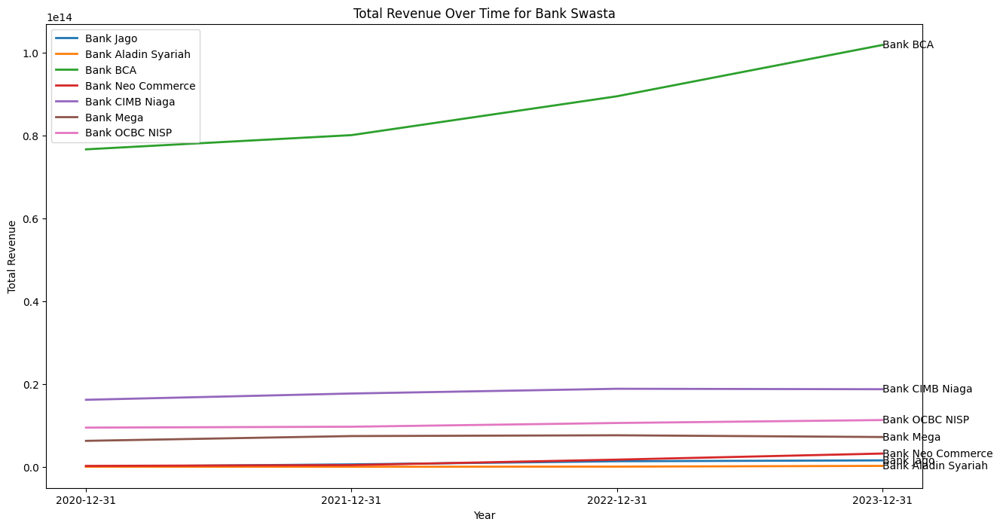

In [ ]:
# Grafik waktu untuk Total Revenue setiap bank Swasta
plt.figure(figsize=(15, 8))
for bank in bank_swasta:
    plt.plot(bank.index, bank['Total Revenue'], label=bank.name, linewidth= 2)
    # Menambahkan keterangan nama bank di samping garisnya
    plt.text(bank.index[-1], bank['Total Revenue'].iloc[-1], bank.name, fontsize=10, verticalalignment='center')
plt.xlabel('Year')
plt.ylabel('Total Revenue')
plt.title('Total Revenue Over Time for Bank Swasta')
plt.legend()
plt.show()

Plot ini menunjukkan tren pendapatan total beberapa bank swasta di Indonesia dari tahun 2020 hingga 2023. Bank BCA (Hijau) secara konsisten memiliki pendapatan total tertinggi, dengan peningkatan yang stabil dari sekitar 8x10^13 pada akhir 2020 menjadi lebih dari 1x10^14 pada akhir 2023. Bank CIMB Niaga (Ungu) dan Bank OCBC NISP (Merah Muda) berada di posisi kedua dan ketiga dengan pendapatan yang jauh lebih rendah, namun menunjukkan peningkatan yang stabil selama periode yang sama. Bank Mega (Coklat), Bank Neo Commerce (Merah), Bank Jago (Biru), dan Bank Aladin Syariah (Oranye) memiliki pendapatan yang relatif rendah dan hampir stabil dengan sedikit peningkatan selama empat tahun. Grafik ini mencerminkan dominasi Bank BCA dalam hal pendapatan total dibandingkan bank swasta lainnya, dengan bank-bank lain memiliki perbedaan pendapatan yang signifikan.

**Kesimpulan:**

Dari analisis kedua grafik, terlihat bahwa empat bank dengan pendapatan total tertinggi selama periode 2020 hingga 2023 adalah Bank BRI, Bank Mandiri, Bank BCA, dan Bank BNI. Bank BRI memimpin dengan pendapatan yang terus meningkat, diikuti oleh Bank Mandiri yang juga menunjukkan pertumbuhan stabil. Bank BCA, meskipun merupakan bank swasta, memiliki pendapatan yang sangat tinggi dan konsisten, mengungguli banyak bank BUMN kecuali Bank BRI. Bank BNI berada di posisi keempat dengan pertumbuhan yang lebih lambat dibandingkan ketiga bank sebelumnya. Kesimpulannya, Bank BRI dan Bank Mandiri dari sektor BUMN, serta Bank BCA dari sektor swasta, adalah tiga bank dengan kinerja pendapatan terbaik di Indonesia selama periode tersebut, dengan Bank BNI juga menunjukkan performa yang solid.

### **Net Income**

**Net Income** adalah **Laba bersih bank setelah semua pengeluaran dikurangkan.** Berikut hasil plotting yang membandingkan bank-bank BUMN dan Swasta.

Pertama kita akan melakukan plotting Net Income bank-bank BUMN, diantaranya Bank BRI, Mandiri, BNI, BTN dan Bank BSI Syariah.

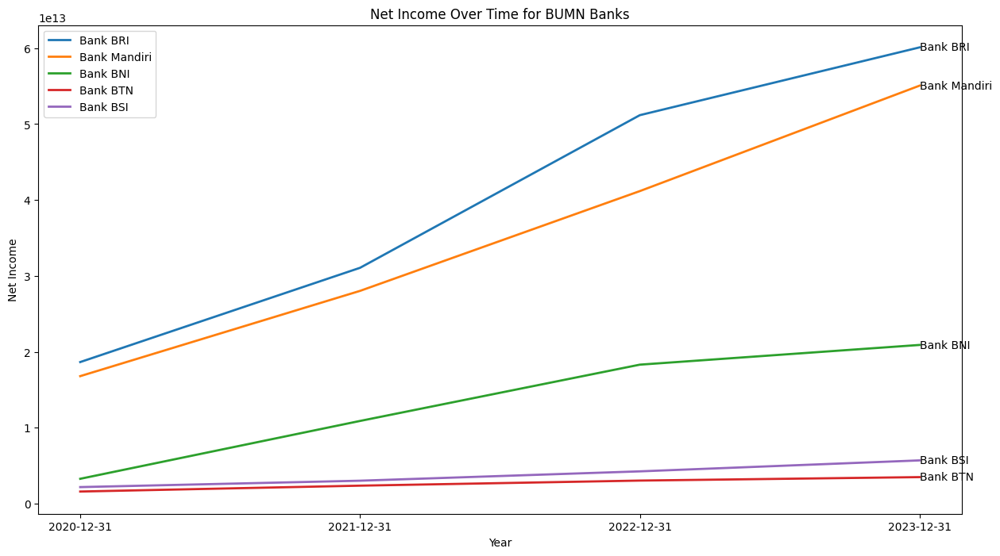

In [ ]:
# Grafik waktu untuk Net Income setiap bank BUMN
plt.figure(figsize=(15, 8))
for bank in bank_bumn:
    plt.plot(bank.index, bank['Net Income'], label=bank.name, linewidth= 2)
    # Menambahkan keterangan nama bank di samping garisnya
    plt.text(bank.index[-1], bank['Net Income'].iloc[-1], bank.name, fontsize=10, verticalalignment='center')
plt.xlabel('Year')
plt.ylabel('Net Income')
plt.title('Net Income Over Time for BUMN Banks')
plt.legend()
plt.show()

Plot ini menunjukkan tren laba bersih beberapa bank BUMN di Indonesia dari tahun 2020 hingga 2023. Bank BRI (Biru) secara konsisten memiliki laba bersih tertinggi, meningkat signifikan dari sekitar 2x10^13 pada akhir 2020 menjadi lebih dari 6x10^13 pada akhir 2023. Bank Mandiri (Oranye) juga menunjukkan peningkatan stabil dari sekitar 2x10^13 menjadi hampir 5x10^13. Bank BNI (Hijau) berada di posisi ketiga dengan pertumbuhan laba bersih yang signifikan dari sekitar 1x10^13 menjadi lebih dari 2x10^13. Sementara itu, Bank BSI (Ungu) dan Bank BTN (Merah) memiliki laba bersih yang jauh lebih rendah dengan sedikit peningkatan selama periode tersebut. Grafik ini mencerminkan dominasi Bank BRI dan Bank Mandiri dalam hal laba bersih dibandingkan bank BUMN lainnya, dengan Bank BNI menunjukkan performa yang cukup baik namun masih berada di belakang dua pemimpin tersebut.

Selanjutnya mari melakukan plotting untuk bank-bank Swasta

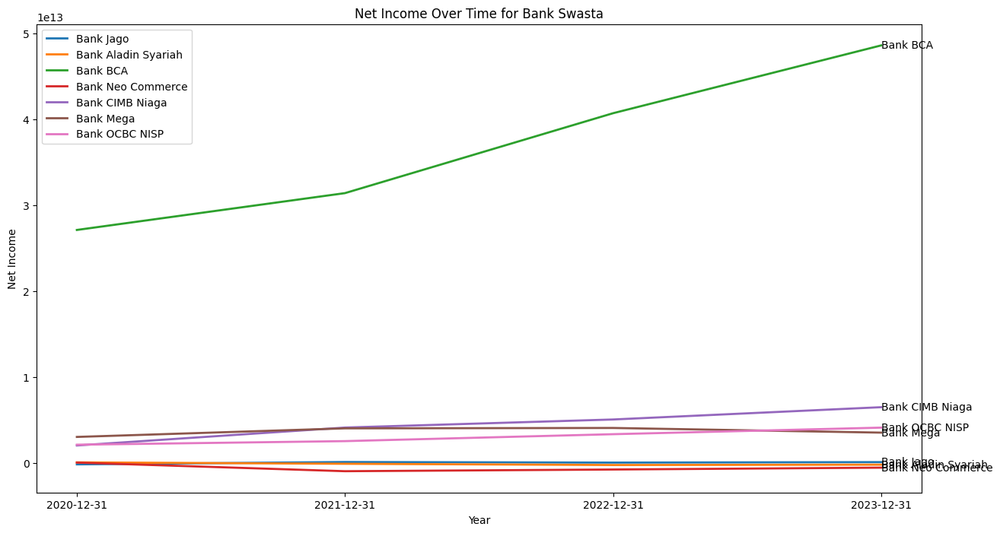

In [ ]:
# Grafik waktu untuk Net Income setiap bank Swasta
plt.figure(figsize=(15, 8))
for bank in bank_swasta:
    plt.plot(bank.index, bank['Net Income'], label=bank.name, linewidth= 2)
    # Menambahkan keterangan nama bank di samping garisnya
    plt.text(bank.index[-1], bank['Net Income'].iloc[-1], bank.name, fontsize=10, verticalalignment='center')
plt.xlabel('Year')
plt.ylabel('Net Income')
plt.title('Net Income Over Time for Bank Swasta')
plt.legend()
plt.show()

Plot ini menunjukkan perubahan laba bersih (net income) dari beberapa bank swasta di Indonesia dari akhir tahun 2020 hingga akhir tahun 2023. Terlihat bahwa Bank BCA mendominasi dengan kenaikan laba bersih yang signifikan setiap tahun, mencapai hampir 50 triliun rupiah pada akhir tahun 2023. Bank CIMB Niaga dan Bank OCBC NISP juga menunjukkan tren peningkatan, meskipun dengan skala yang jauh lebih kecil dibandingkan BCA. Sementara itu, Bank Jago, Bank Aladin Syariah, Bank Neo Commerce, dan Bank Mega memiliki laba bersih yang relatif datar atau sedikit menurun dalam periode yang sama. Hal ini menunjukkan bahwa BCA memiliki kinerja finansial yang jauh lebih baik dibandingkan bank-bank swasta lainnya dalam plot ini.

**Kesimpulan:**

Berdasarkan plot net income dari bank-bank swasta dan BUMN di Indonesia dari akhir tahun 2020 hingga akhir tahun 2023, **empat bank dengan laba bersih terbanyak adalah Bank BRI, Bank Mandiri, Bank BCA, dan Bank BNI.** Bank BRI dan Bank Mandiri, keduanya BUMN, menunjukkan pertumbuhan laba yang signifikan setiap tahun, dengan BRI mencapai hampir 60 triliun rupiah dan Mandiri sekitar 50 triliun rupiah pada akhir 2023. Bank BCA, bank swasta terkemuka, juga mengalami kenaikan laba yang kuat, mencapai hampir 50 triliun rupiah pada periode yang sama. Bank BNI, meskipun berada di posisi keempat, menunjukkan peningkatan yang stabil tetapi dengan skala lebih kecil dibandingkan ketiga bank lainnya. Hal ini mencerminkan dominasi BRI, Mandiri, dan BCA dalam kinerja finansial di sektor perbankan Indonesia.

## Keystat

Dalam konteks dataset saham, "keystat" atau "key statistics" merujuk pada serangkaian indikator dan metrik utama yang memberikan informasi penting tentang kinerja dan kondisi keuangan sebuah perusahaan. Key statistics ini sering digunakan oleh investor dan analis untuk menilai kesehatan dan prospek pertumbuhan perusahaan.

### Total Debt & Total Revenue Latest

Total Debt adalah jumlah total kewajiban finansial yang dimiliki oleh perusahaan, termasuk hutang jangka pendek dan jangka panjang. Total debt memberikan gambaran tentang leverage perusahaan dan seberapa banyak perusahaan bergantung pada pembiayaan hutang untuk operasinya. Rasio ini penting bagi analis dan investor untuk menilai risiko finansial perusahaan.


Total Revenue adalah total pendapatan yang dihasilkan oleh perusahaan dalam periode waktu terbaru yang dilaporkan, biasanya satu tahun fiskal atau kuartal terakhir. Total revenue memberikan pandangan langsung tentang performa perusahaan dalam menghasilkan pendapatan.

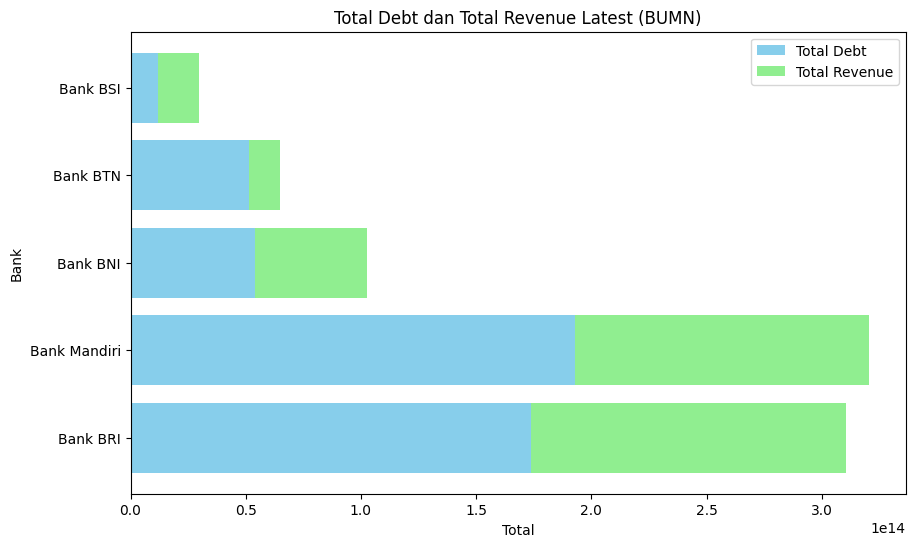

In [ ]:
# utang dan pendapatan
plt.figure(figsize=(10, 6))

for bank in bank_bumn:
    plt.barh(bank.name, bank['totalDebt'], color='skyblue')
    plt.barh(bank.name, bank['totalRevenue'], color='lightgreen', left=bank['totalDebt'])

plt.xlabel('Total')
plt.ylabel('Bank')
plt.title('Total Debt dan Total Revenue Latest (BUMN)')
plt.legend(['Total Debt', 'Total Revenue'])
plt.show()

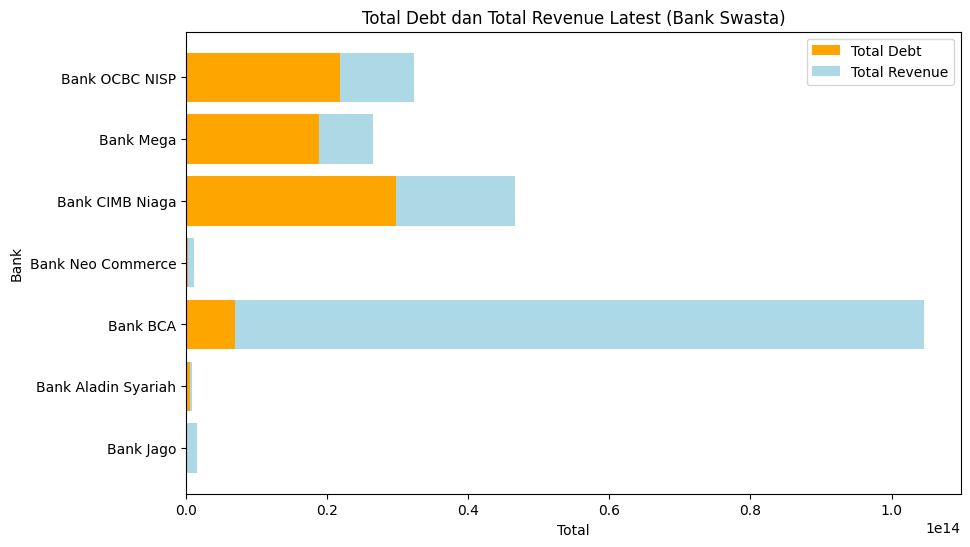

In [ ]:
# Membuat plot
plt.figure(figsize=(10, 6))

for bank in bank_swasta:
    plt.barh(bank.name, bank['totalDebt'], color='orange')  # Mengubah warna totalDebt menjadi oranye
    plt.barh(bank.name, bank['totalRevenue'], color='lightblue', left=bank['totalDebt'])  # Mengubah warna totalRevenue menjadi biru muda

plt.xlabel('Total')
plt.ylabel('Bank')
plt.title('Total Debt dan Total Revenue Latest (Bank Swasta)')

plt.legend(['Total Debt', 'Total Revenue'])
plt.show()

Dari kedua grafik di atas menunjukkan bank mandiri yang memiliki total revenue dan total debt terbanyak dibandingkan bank lainnya. Hal ini menunjukkan bahwa Bank Mandiri memiliki kinerja yang sangat baik dalam menghasilkan pendapatan. Pendapatan tinggi ini bisa berasal dari berbagai sumber, termasuk bunga pinjaman, biaya layanan, dan investasi lainnya.Meski Bank Mandiri memimpin dalam total revenue, bank-bank lain juga menunjukkan performa yang cukup baik.


Bank Mandiri juga memiliki total debt yang paling tinggi. Ini bisa menunjukkan beberapa hal, seperti kapasitas Bank Mandiri yang lebih besar untuk mengambil utang demi ekspansi atau investasi, atau mungkin juga strategi keuangan yang berbeda dibandingkan bank lainnya.

### Dividend

Dividen adalah pembayaran yang dilakukan oleh perusahaan kepada para pemegang sahamnya sebagai distribusi keuntungan. Dividen biasanya dibayarkan dalam bentuk tunai, tetapi juga bisa dibayarkan dalam bentuk saham tambahan atau aset lainnya.

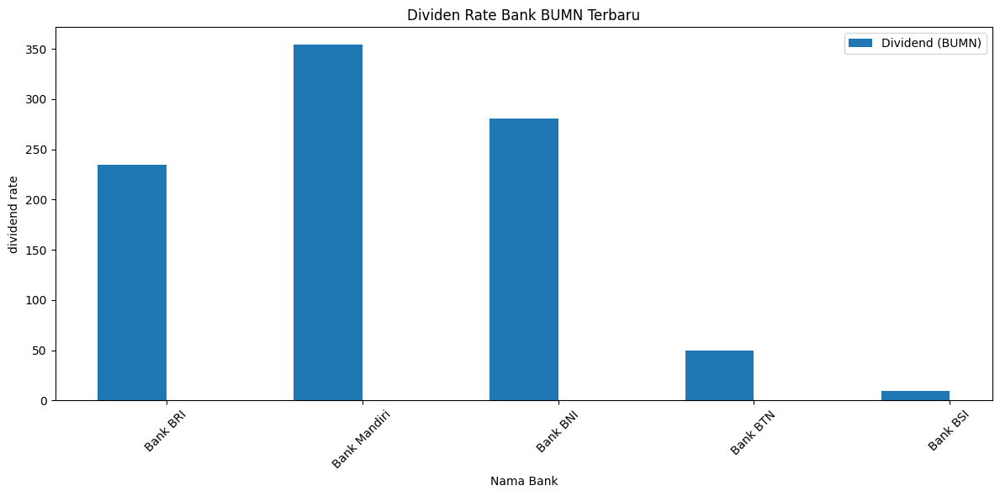

In [ ]:
# Mendapatkan nama bank untuk setiap kelompok
bank_bumn_names = [bank.name for bank in bank_bumn]

# Mendapatkan total harga saham terendah dan tertinggi untuk setiap bank dalam kelompok BUMN
bumn_dividend = [bank['lastDividendValue'].sum() for bank in bank_bumn]

# Membuat posisi bar untuk bank BUMN
bar_width = 0.35
index_bumn = np.arange(len(bank_bumn))

# Membuat plot untuk bank BUMN
fig, ax = plt.subplots(figsize=(12, 6))

# Menampilkan total harga saham terendah dan tertinggi untuk bank BUMN
ax.bar(index_bumn - bar_width/2, bumn_dividend, bar_width, label='Dividend (BUMN)')


# Menambahkan label dan judul untuk bank BUMN
ax.set_xlabel('Nama Bank')
ax.set_ylabel('dividend rate')
ax.set_title('Dividen Rate Bank BUMN Terbaru')
ax.set_xticks(index_bumn)
ax.set_xticklabels(bank_bumn_names, rotation=45)
ax.legend()

plt.tight_layout()
plt.show()

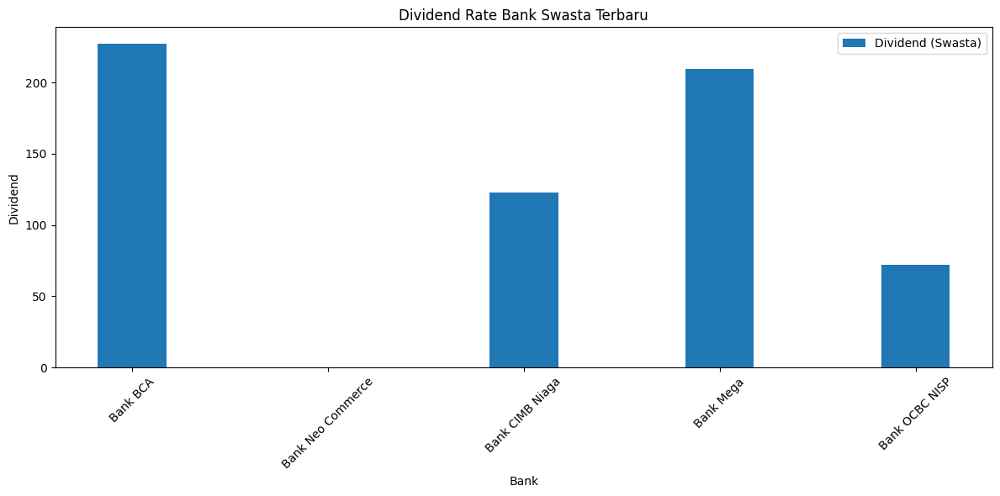

In [ ]:
# Mendapatkan nama bank untuk setiap kelompok
bank_swasta_names = [bank.name for bank in bank_swasta]

# Inisialisasi list untuk nama bank dan dividend rate yang valid
valid_bank_swasta_names = []
valid_swasta_dividend = []

# Memeriksa keberadaan kolom 'lastDividendValue'
for bank in bank_swasta:
    if 'lastDividendValue' in bank.columns:
        valid_bank_swasta_names.append(bank.name)
        valid_swasta_dividend.append(bank['lastDividendValue'].sum())

# Membuat posisi bar untuk bank swasta
index_swasta = np.arange(len(valid_bank_swasta_names))
bar_width = 0.35

# Membuat plot untuk bank swasta
fig, ax = plt.subplots(figsize=(12, 6))

# Menampilkan total harga saham terendah dan tertinggi untuk bank swasta
ax.bar(index_swasta, valid_swasta_dividend, bar_width, label='Dividend (Swasta)')

# Menambahkan label dan judul untuk bank swasta
ax.set_xlabel('Bank')
ax.set_ylabel('Dividend')
ax.set_title('Dividend Rate Bank Swasta Terbaru')
ax.set_xticks(index_swasta)
ax.set_xticklabels(valid_bank_swasta_names, rotation=45)
ax.legend()

plt.tight_layout()
plt.show()

Berdasarkan data yang ditunjukkan oleh grafik, Bank Mandiri memberikan dividen terbesar pada periode terakhir dibandingkan dengan bank-bank lainnya. Beberapa bank lain juga memberikan dividen, namun dalam jumlah yang lebih kecil dibandingkan dengan Bank Mandiri. Namun ada beberapa bank yang tidak memberikan dividen

In [ ]:
bbca_keystat['dividendRate']

0    270.0
Name: dividendRate, dtype: float64

## Historical Value

1. Bank Jago

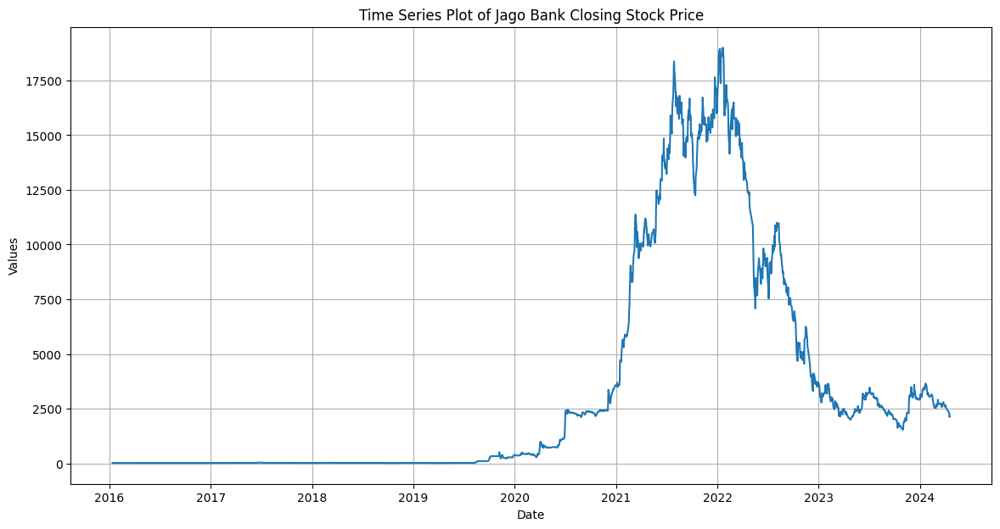

In [ ]:
# Membuat plot time series dari variabel Close Price
plt.figure(figsize=(14, 7))
plt.plot(arto_hist.index, arto_hist['Close'])
plt.title('Time Series Plot of Jago Bank Closing Stock Price')
plt.xlabel('Date')
plt.ylabel('Values')
plt.grid(True)
plt.show()

Plot di atas merupakan plot time series dari harga saham penutupan bank Jago dari tahun 2016 sampai dengan 2024. Dari plot tersebut, dapat dilihat bahwa nilai harga saham penutupan bank Jago bernilai cukup rendah (mendekati 0 rupiah) selama tahun 2016 sampai dengan pertengahan 2019. Kemudian pada pertengahan tahun 2019 sampai dengan 2021 berangsur meningkat. Pada tahun 2021 harga saham penutupan meningkat tinggi mencapai 17500 rupiah. Kemudian pada pertengahan tahun 2022 harga saham menurun drastis mencapai 7500 rupiah. Pada tahun 2023 sampai 2024 harga saham penutupan bank Jago berada pada kisaran 2500 rupiah.

2. Bank Aladin Syariah

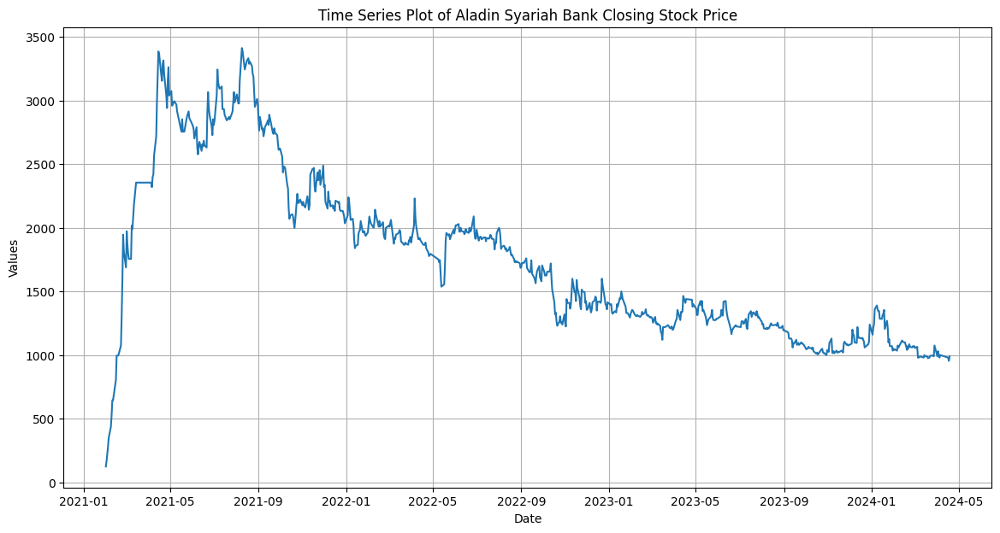

In [ ]:
# Membuat plot time series dari variabel Close Price
plt.figure(figsize=(14, 7))
plt.plot(bank_hist.index, bank_hist['Close'])
plt.title('Time Series Plot of Aladin Syariah Bank Closing Stock Price')
plt.xlabel('Date')
plt.ylabel('Values')
plt.grid(True)
plt.show()

Plot di atas merupakan plot time series dari harga saham penutupan bank Aladin Syariah dari tahun 2021 sampai dengan 2024. Dari plot tersebut, dapat dilihat bahwa nilai harga saham penutupan bank Aladin Syariah meningkat drastis sampai dengan bulan September 2021. Kemudian pada bulan selanjutnya, harga saham penutupan bank Aladin Syariah menunjukkan trend menurun dimana nilai harga saham penutupan pada tahun 2024 berkisar di 1000 sampai 1500 rupiah.

3. Bank BCA

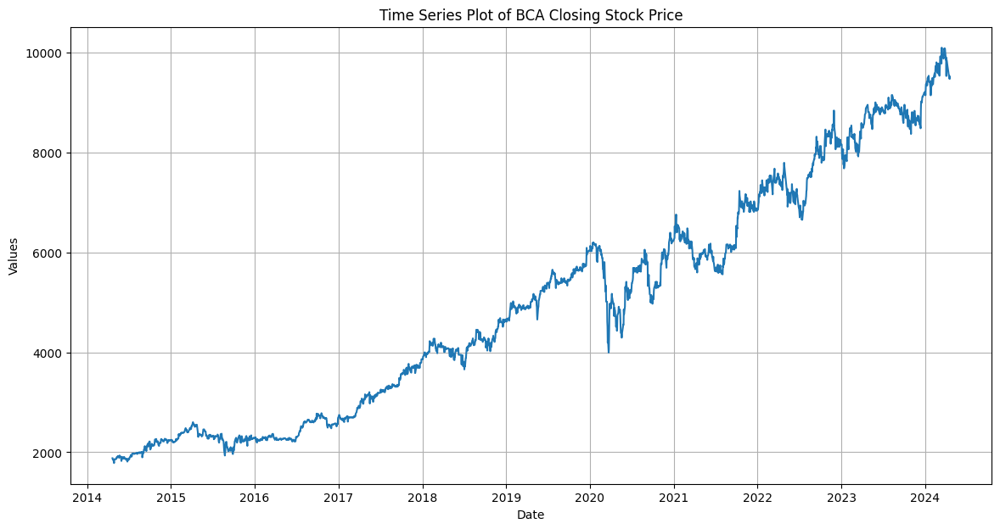

In [ ]:
# Membuat plot time series dari variabel Close Price
plt.figure(figsize=(14, 7))
plt.plot(bbca_hist.index, bbca_hist['Close'])
plt.title('Time Series Plot of BCA Closing Stock Price')
plt.xlabel('Date')
plt.ylabel('Values')
plt.grid(True)
plt.show()

Plot di atas merupakan plot time series dari harga saham penutupan Bank Central Asia (BCA) dari tahun 2014 sampai dengan 2024. Dari plot tersebut, dapat dilihat bahwa nilai harga saham penutupan bank BCA bernilai cukup rendah selama tahun 2014 sampai dengan 2016. Kemudian pada awal tahun 2017 harga saham penutupan bank BCA terus meningkat. Meskipun pada awal tahun 2020 harga saham penutupan bank BCA sempat menurun drastis mencapai 4000 rupiah, dapat diketahui bahwa harga saham bank BCA menunjukkan trend meningkat dari tahun 2014 sampai dengan tahun 2024.

4. Bank BNI

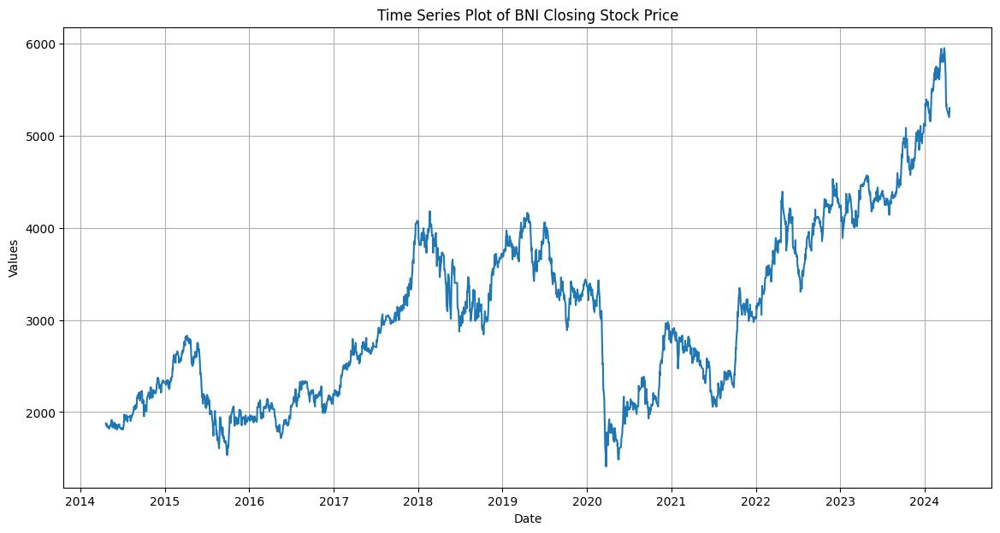

In [ ]:
# Membuat plot time series dari variabel Close Price
plt.figure(figsize=(14, 7))
plt.plot(bbni_hist.index, bbni_hist['Close'])
plt.title('Time Series Plot of BNI Closing Stock Price')
plt.xlabel('Date')
plt.ylabel('Values')
plt.grid(True)
plt.show()

Plot di atas merupakan plot time series dari harga saham penutupan Bank Negara Indonesia (BNI) dari tahun 2014 sampai dengan 2024. Dari plot tersebut, dapat dilihat bahwa nilai harga saham penutupan bank BNI terus meningkat selama tahun 2014 sampai dengan pertengahan 2015. Kemudian pada pertengahan tahun 2015 harga saham bank BNI mengalami penurunan. Namun setelahnya, harga saham penutupan bank BNI terus meningkat sampai dengan pertengahan tahun 2019 meskipun sempat mengalami penurunan pada pertengahan tahun 2018. Pada pertengahan tahun 2019 sampai dengan awal tahun 2020 harga saham penutupan bank BNI berkisar di 3000 rupiah. Kemudian pada awal tahun 2020 harga saham menurun drastis mencapai harga di bawah 2000 rupiah dan kembali mengalami penurunan di pertengahan tahun 2021. Namun setelahnya harga saham bank BNI terus meningkat sehingga pada tahun 2024 harga saham bank BNI berkisar pada harga 5000 sampai 6000 rupiah.

5. Bank BRI

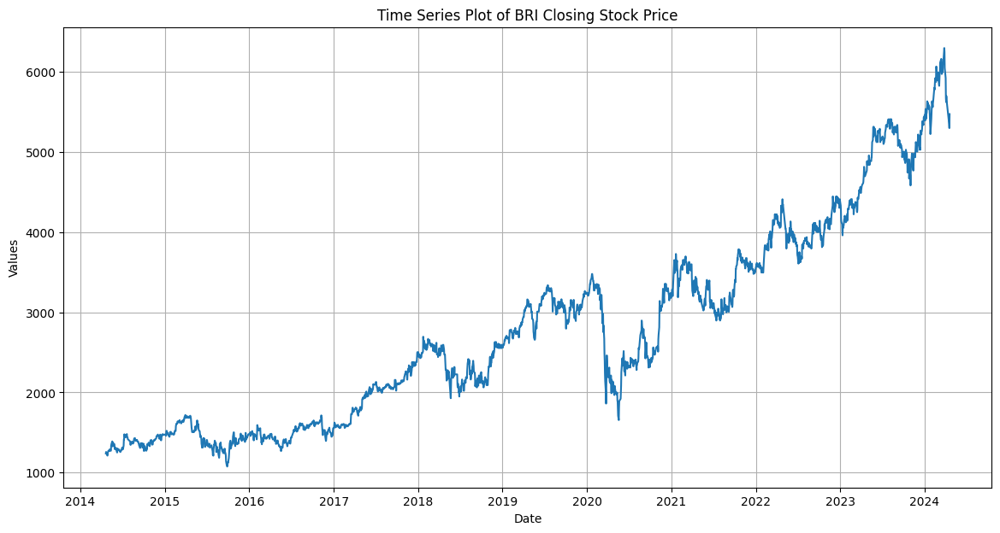

In [ ]:
# Membuat plot time series dari variabel Close Price
plt.figure(figsize=(14, 7))
plt.plot(bbri_hist.index, bbri_hist['Close'])
plt.title('Time Series Plot of BRI Closing Stock Price')
plt.xlabel('Date')
plt.ylabel('Values')
plt.grid(True)
plt.show()

Plot di atas merupakan plot time series dari harga saham penutupan Bank Rakyat Indonesia (BRI) dari tahun 2014 sampai dengan 2024. Dari plot tersebut, dapat dilihat bahwa nilai harga saham penutupan bank BRI bernilai cukup rendah namun stabil di kisaran 1000 sampai 2000 rupiah selama tahun 2014 sampai dengan pertengahan tahun 2017. Kemudian pada awal pertengahan tahun 2017 sampai dengan pertengahan tahun 2018 harga saham penutupan bank BRI terus meningkat. Kemudian mengalami penurunan pada pertengahan tahun 2018 dan kembali meningkat setelahnya. Meskipun pada awal tahun 2020 harga saham penutupan bank BRI sempat menurun drastis mencapai di bawah 2000 rupiah, dapat diketahui bahwa harga saham bank BRI menunjukkan trend meningkat dari tahun 2014 sampai dengan tahun 2024.

6. Bank BTN

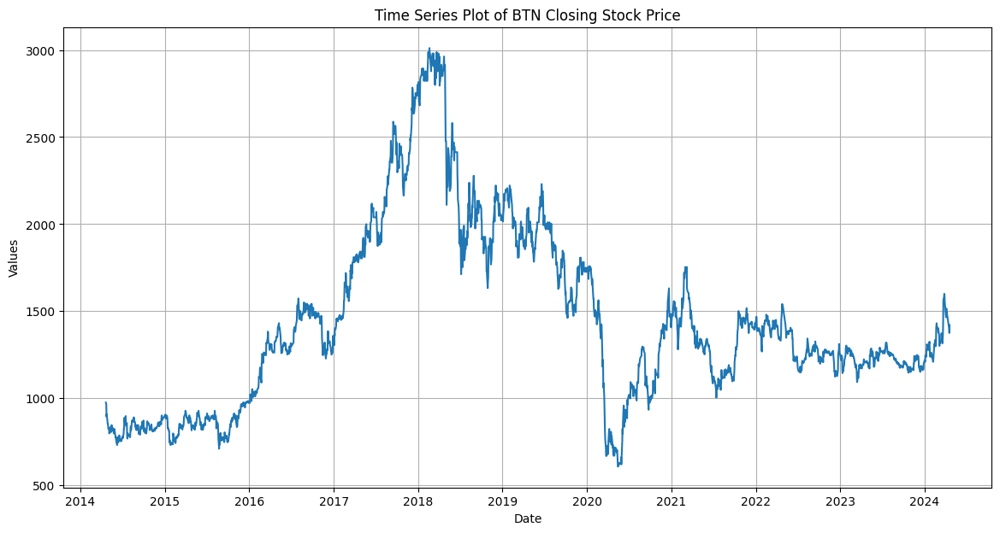

In [ ]:
# Membuat plot time series dari variabel Close Price
plt.figure(figsize=(14, 7))
plt.plot(bbtn_hist.index, bbtn_hist['Close'])
plt.title('Time Series Plot of BTN Closing Stock Price')
plt.xlabel('Date')
plt.ylabel('Values')
plt.grid(True)
plt.show()

Plot di atas merupakan plot time series dari harga saham penutupan Bank Tabungan Negara (BTN) dari tahun 2014 sampai dengan 2024. Dari plot tersebut, dapat dilihat bahwa nilai harga saham penutupan bank BTN bernilai cukup rendah selama tahun 2014 sampai dengan 2015. Kemudian pada awal tahun 2016 harga saham penutupan bank BTN terus meningkat mencapai harga 3000 rupiah pada awal tahun 2018. Selanjutnya harga saham penutupan bank BTN mengalami penurunan mencapai di bawah 1000 rupiah pada awal tahun 2020. Meskipun begitu, harga saham penutupan bank BNI kembali mengalami kenaikan sehingga harga saham pada tahun 2024 berkisar di atas 1000 rupiah.

7. Bank Neo Commerce

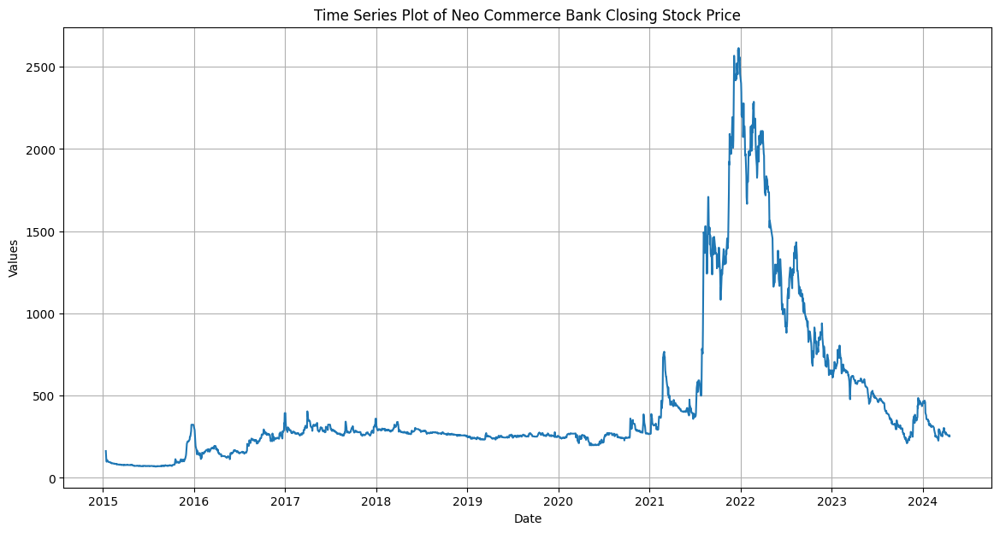

In [ ]:
# Membuat plot time series dari variabel Close Price
plt.figure(figsize=(14, 7))
plt.plot(bbyb_hist.index, bbyb_hist['Close'])
plt.title('Time Series Plot of Neo Commerce Bank Closing Stock Price')
plt.xlabel('Date')
plt.ylabel('Values')
plt.grid(True)
plt.show()

Plot di atas merupakan plot time series dari harga saham penutupan Bank Neo Commerce dari tahun 2015 sampai dengan 2024. Dari plot tersebut, dapat dilihat bahwa nilai harga saham penutupan bank Neo Commerce bernilai cukup rendah dan stabil dengan kisaran harga di bawah 500 rupiah selama tahun 2015 sampai dengan pertengahan tahun 2021 meskipun sempat mengalami peningkatan hingga di atas 500 rupiah di awal tahun 2021. Kemudian pada pertengahan tahun 2021, harga saham penutupan bank Neo Commerce meningkat drastis mencapai lebih dari 2500 rupiah pada akhir tahun 2021. Pada tahun 2022, harga saham bank Neo Commerce kian menurun sehingga pada tahun 2024, harga sahamnya berkisar di bawah 500 rupiah.

8. Bank Mandiri

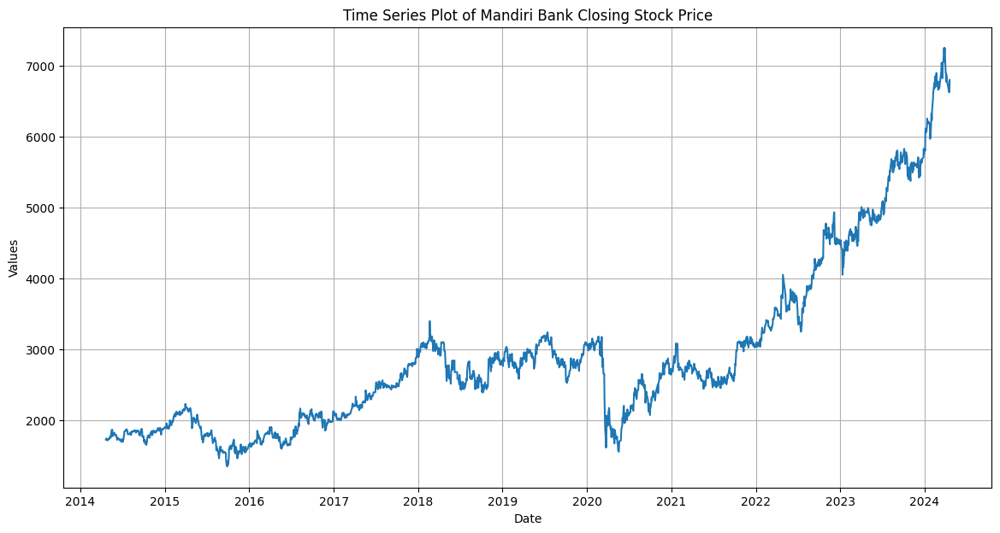

In [ ]:
# Membuat plot time series dari variabel Close Price
plt.figure(figsize=(14, 7))
plt.plot(bmri_hist.index, bmri_hist['Close'])
plt.title('Time Series Plot of Mandiri Bank Closing Stock Price')
plt.xlabel('Date')
plt.ylabel('Values')
plt.grid(True)
plt.show()

Plot di atas merupakan plot time series dari harga saham penutupan Bank Mandiri dari tahun 2014 sampai dengan 2024. Dari plot tersebut, dapat dilihat bahwa nilai harga saham penutupan bank Mandiri mengalami sedikit peningkatan dari tahun 2014 sampai dengan awal tahun 2015. Kemudian pada pertengahan tahun 2015 harga saham penutupan bank Mandiri mengalami peningkatan sampai dengan awal tahun 2018. Selanjutnya pada pertengahan tahun 2018 sampai dengan awal tahun 2020 harga saham penutupan bank Mandiri mengalami fluktuasi. Meskipun pada awal tahun 2020 harga saham penutupan bank Mandiri sempat menurun drastis mencapai harga di bawah 2000 rupiah, setelahnya harga saham Bank Mandiri menunjukkan trend meningkat sehingga pada tahun 2024 harga saham penutupan bank Mandiri mencapai 7000 rupiah.

9. Bank CIMB Niaga

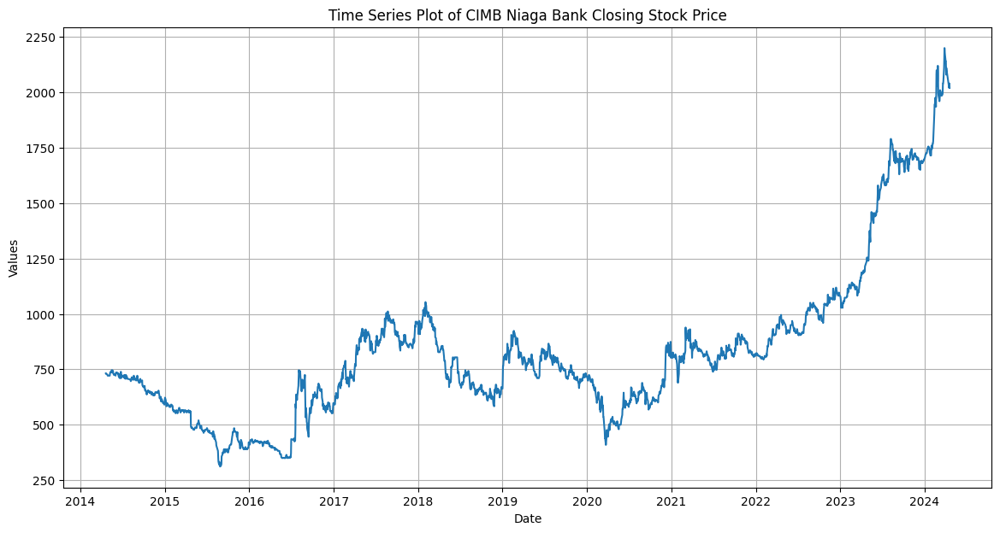

In [ ]:
# Membuat plot time series dari variabel Close Price
plt.figure(figsize=(14, 7))
plt.plot(bnga_hist.index, bnga_hist['Close'])
plt.title('Time Series Plot of CIMB Niaga Bank Closing Stock Price')
plt.xlabel('Date')
plt.ylabel('Values')
plt.grid(True)
plt.show()

Plot di atas merupakan plot time series dari harga saham penutupan Bank CIMB Niaga dari tahun 2014 sampai dengan 2024. Dari plot tersebut, dapat dilihat bahwa harga saham penutupan bank CIMB Niaga menunjukkan trend penurunan dari tahun 2014 sampai dengan pertengahan tahun 2016. Kemudian pada pertengahan tahun 2016 harga saham penutupan bank CIMB Niaga mengalami peningkatan dan kembali mengalami penurunan pada pertengahan tahun 2018 dan awal tahun 2020. Meskipun begitu, setelahnya harga saham penutupan bank CIMB Niaga menunjukkan trend peningkatan sehingga pada tahun 2024 harga saham penutupan bank CIMB Niaga mencapai di atas 2000 rupiah.

10. Bank BSI

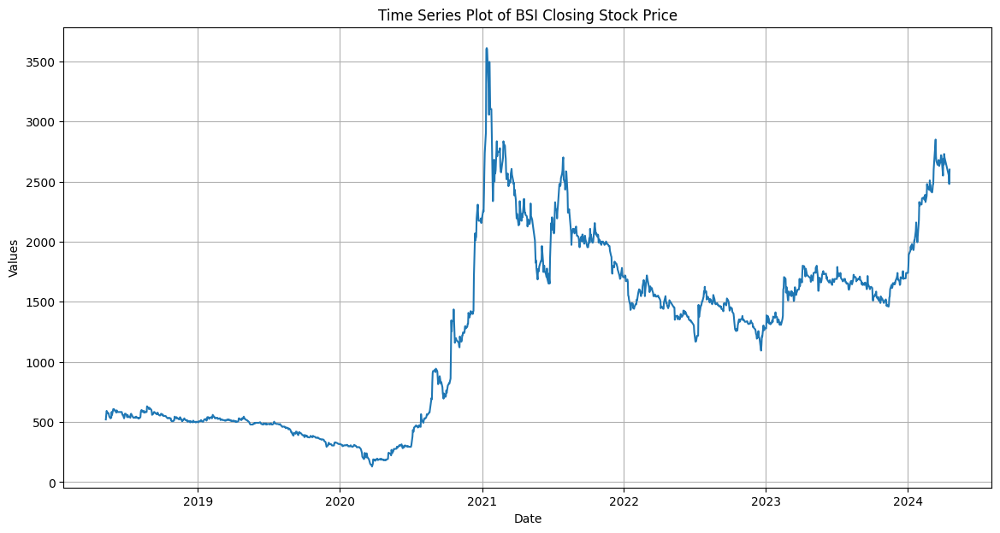

In [ ]:
# Membuat plot time series dari variabel Close Price
plt.figure(figsize=(14, 7))
plt.plot(bris_hist.index, bris_hist['Close'])
plt.title('Time Series Plot of BSI Closing Stock Price')
plt.xlabel('Date')
plt.ylabel('Values')
plt.grid(True)
plt.show()

Plot di atas merupakan plot time series dari harga saham penutupan Bank Syariah Indonesia (BSI) dari tahun 2018 sampai dengan 2024. Dari plot tersebut, dapat dilihat bahwa harga saham penutupan bank BSI menunjukkan sedikit penurunan selama tahun 2018 sampai dengan pertengahan tahun 2020. Kemudian pada pertengahan tahun 2020 harga saham penutupan bank BSI mengalami peningkatan drastis mencapai harga di atas 3500 rupiah pada awal tahun 2021. Meskipun begitu, setelahnya harga saham penutupan bank BSI kembali mengalami penurunan mencapai harga di bawah 1500 rupiah pada akhir tahun 2022. Namun setelahnya harga saham penutupan bank BSI menunjukkan trend meningkat sehingga pada tahun 2024 harga sahamnya berkisar di atas 2000 rupiah.

11. Bank Mega

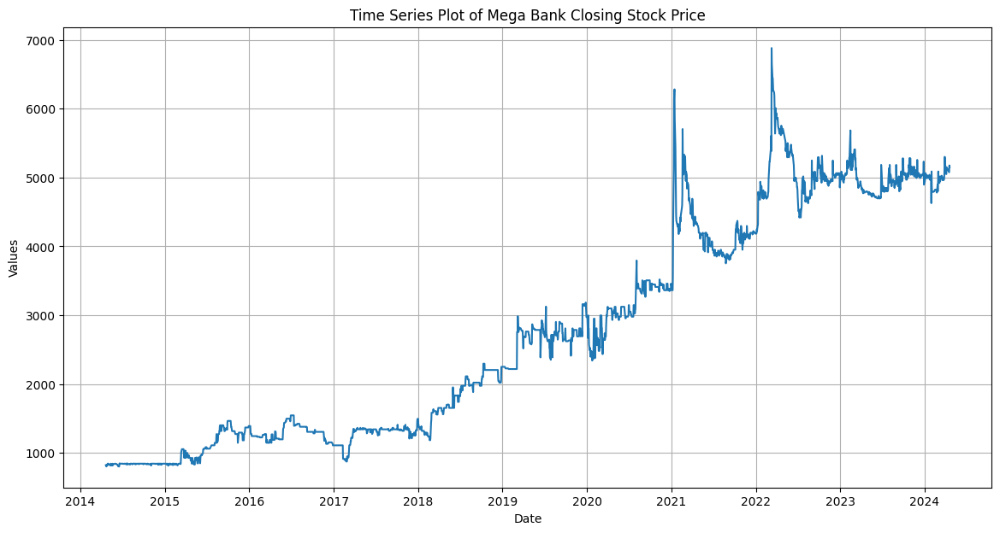

In [ ]:
# Membuat plot time series dari variabel Average Price
plt.figure(figsize=(14, 7))
plt.plot(mega_hist.index, mega_hist['Close'])
plt.title('Time Series Plot of Mega Bank Closing Stock Price')
plt.xlabel('Date')
plt.ylabel('Values')
plt.grid(True)
plt.show()

Plot di atas merupakan plot time series dari harga saham penutupan Bank Mega dari tahun 2014 sampai dengan 2024. Dari plot tersebut, dapat dilihat bahwa harga saham penutupan bank Mega bernilai rendah dan stabil di bawah 1000 rupiah selama tahun 2014 sampai dengan awal tahun 2015. Kemudian pada pertengahan tahun 2015 harga saham penutupan bank Mega mengalami sedikit peningkatan meskipun ada penurunan kembali pada awal tahun 2017. Setelahnya harga saham penutupan bank Mega terus meningkat bahkan meningkat drastis meskipun kembali turun lagi pada awal tahun 2021 dan awal tahun 2022. Pada awal tahun 2024 harga saham penutupan bank Mega sempat turun menjadi di bawah 5000 rupiah namun berangsur meningkat lagi setelahnya.

12. Bank OCBC NISP

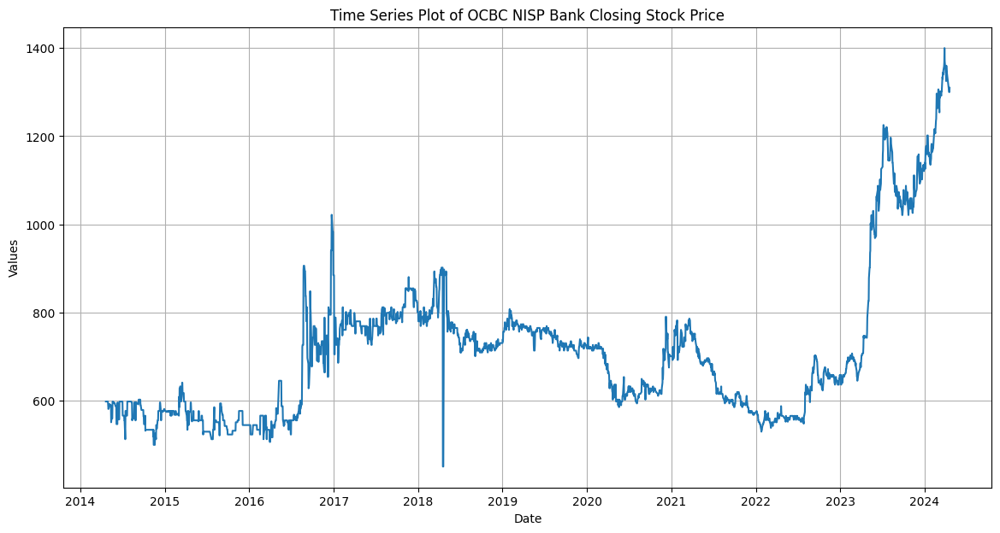

In [ ]:
# Membuat plot time series dari variabel Close Price
plt.figure(figsize=(14, 7))
plt.plot(nisp_hist.index, nisp_hist['Close'])
plt.title('Time Series Plot of OCBC NISP Bank Closing Stock Price')
plt.xlabel('Date')
plt.ylabel('Values')
plt.grid(True)
plt.show()

Plot di atas merupakan plot time series dari harga saham penutupan Bank OCBC NISP dari tahun 2014 sampai dengan 2024. Dari plot tersebut, dapat dilihat bahwa harga saham penutupan bank OCBC NISP bernilai rendah dan cukup fluktuatif di sekitar 600 rupiah selama tahun 2014 sampai dengan pertengahan tahun 2016. Kemudian pada pertengahan tahun 2016 harga saham penutupan bank OCBC NISP peningkatan drastis mencapai di atas 800 rupiah dan 1000 rupiah meskipun kembali turun dan berkisar di harga 800 rupiah pada tahun 2017. Pada awal trimester awal tahun 2018 harga saham penutupan bank OCBC NISP mengalami penurunan drastis di bawah 600 rupiah namun kembali meningkat dan berkisar di 700 rupiah sampai dengan awal tahun 2020. Pada awal tahun 2020, harga saham penutupan bank OCBC NISP mengalami penurunan hingga di bawah 600 begitu juga hingga pertengahan tahun 2022. Setelahnya harga saham penutupan bank OCBC NISP mengalami peningkatan drastis hingga di atas 1200 rupiah pada pertengahan tahun 2023, mengalami sedikit penurunan, dan kembali meningkat drastis hingga mencapai 1400 rupiah pada tahun 2024.

# Fundamental Analysis

Analisis fundamental bank merupakan metode penting bagi investor untuk menilai kesehatan keuangan dan prospek masa depan sebuah bank. Dengan memahami kondisi fundamental bank, investor dapat membuat keputusan investasi yang lebih tepat dan terukur.

**Penting untuk diingat bahwa analisis fundamental tidak dapat memprediksi masa depan dengan pasti.** Namun, dengan melakukan analisis fundamental yang cermat, investor dapat meningkatkan peluang untuk membuat keputusan investasi yang tepat dan menguntungkan.

**ROA (Return on Assets)**, **ROE (Return on Equity)**, dan **NPM (Net Profit Margin)** merupakan tiga variabel penting yang digunakan untuk mengukur profitabilitas bank. Memahami variabel ini dapat membantu investor dan analis dalam menilai kesehatan keuangan dan prospek masa depan bank.

**1. Return on Assets (ROA)**

* **Definisi:** Mengukur kemampuan bank menghasilkan laba dari total asetnya.
* **Rumus:** Laba Bersih / Total Aset
* **Interpretasi:**
    * Nilai ROA yang tinggi menunjukkan bahwa bank mampu menghasilkan laba yang lebih besar dari asetnya, yang berarti bank tersebut efisien dalam menggunakan asetnya.
    * Nilai ROA yang rendah atau negatif menunjukkan bahwa bank tidak menghasilkan laba yang cukup dari asetnya, yang dapat menjadi indikasi masalah keuangan.

**2. Return on Equity (ROE)**

* **Definisi:** Mengukur kemampuan bank menghasilkan laba dari modal yang disetorkan investor.
* **Rumus:** Laba Bersih / Ekuitas Pemegang Saham
* **Interpretasi:**
    * Nilai ROE yang tinggi menunjukkan bahwa bank mampu menghasilkan laba yang lebih besar dari modalnya, yang berarti bank tersebut menarik bagi investor.
    * Nilai ROE yang rendah atau negatif menunjukkan bahwa bank tidak menghasilkan laba yang cukup dari modalnya, yang dapat membuat investor ragu untuk berinvestasi di bank tersebut.

**3. Net Profit Margin (NPM)**

* **Definisi:** Mengukur persentase laba bersih dari total pendapatan.
* **Rumus:** Laba Bersih / Penjualan Bersih
* **Interpretasi:**
    * Nilai NPM yang tinggi menunjukkan bahwa bank mampu menghasilkan laba yang lebih besar dari setiap rupiah penjualan, yang berarti bank tersebut efisien dalam operasinya.
    * Nilai NPM yang rendah menunjukkan bahwa bank tidak menghasilkan laba yang cukup dari setiap rupiah penjualan, yang dapat menjadi indikasi masalah efisiensi.

**Perbandingan ROA, ROE, dan NPM:**

* **ROA** fokus pada kemampuan bank menghasilkan laba dari asetnya, tanpa mempertimbangkan sumber pembiayaan aset tersebut.
* **ROE** fokus pada kemampuan bank menghasilkan laba dari modal yang disetorkan investor.
* **NPM** fokus pada kemampuan bank menghasilkan laba dari setiap rupiah penjualan.

**Kesimpulan:**

ROA, ROE, dan NPM merupakan variabel penting yang saling terkait dan memberikan informasi yang berbeda tentang profitabilitas bank. Investor dan analis harus mempertimbangkan ketiga variabel ini secara bersama-sama, serta faktor lain, untuk mendapatkan gambaran yang lengkap tentang kesehatan keuangan dan prospek masa depan bank.

**Penting untuk diingat bahwa variabel ini hanya memberikan gambaran sekilas tentang profitabilitas bank. Investor dan analis harus melakukan analisis yang lebih mendalam untuk memahami sepenuhnya kondisi keuangan bank.**

**Sumber:**

* [https://rich01.com/what-is-roa/](https://rich01.com/what-is-roa/)
* [https://ejournal.stei.ac.id/index.php/JEMI/article/view/254](https://ejournal.stei.ac.id/index.php/JEMI/article/view/254)
* [https://www.disnat.com/en/learning/trading-basics/ratio-analysis/return-on-equity-roe](https://www.disnat.com/en/learning/trading-basics/ratio-analysis/return-on-equity-roe)


## ROA, ROE, dan NPM

In [ ]:
# Data yang digunakan untuk perhitungan
banks_data = {
    "arto": {"income_stat": arto_income_stat, "balancesheet": arto_balancesheet},
    "bank": {"income_stat": bank_income_stat, "balancesheet": bank_balancesheet},
    "bbca": {"income_stat": bbca_income_stat, "balancesheet": bbca_balancesheet},
    "bbni": {"income_stat": bbni_income_stat, "balancesheet": bbni_balancesheet},
    "bbri": {"income_stat": bbri_income_stat, "balancesheet": bbri_balancesheet},
    "bbtn": {"income_stat": bbtn_income_stat, "balancesheet": bbtn_balancesheet},
    "bbyb": {"income_stat": bbyb_income_stat, "balancesheet": bbyb_balancesheet},
    "bmri": {"income_stat": bmri_income_stat, "balancesheet": bmri_balancesheet},
    "bnga": {"income_stat": bnga_income_stat, "balancesheet": bnga_balancesheet},
    "bris": {"income_stat": bris_income_stat, "balancesheet": bris_balancesheet},
    "mega": {"income_stat": mega_income_stat, "balancesheet": mega_balancesheet},
    "nisp": {"income_stat": nisp_income_stat, "balancesheet": nisp_balancesheet},
}

# Fungsi pelabelan ROA
def label_roa(roa):
    if roa > 0 and roa <= 5:
        return "normal"
    elif roa > 5:
        return "bagus"
    else:
        return "tidak bagus"

# Fungsi pelabelan ROE
def label_roe(roe):
    if roe > 0 and roe <= 5:
        return "normal"
    elif roe > 5:
        return "bagus"
    else:
        return "tidak bagus"

# Fungsi pelabelan NPM
def label_npm(npm):
    if npm > 0 and npm <= 15:
        return "normal"
    elif npm > 15:
        return "bagus"
    else:
        return "tidak bagus"

# List untuk menyimpan hasil perhitungan
results = []

# Looping untuk menghitung ROA, ROE, dan NPM setiap bank
for bank, data in banks_data.items():
    net_income_sum = data["income_stat"]["Net Income"].sum()
    total_assets_sum = data["balancesheet"]["Total Assets"].sum()
    total_revenue_sum = data["income_stat"]["Total Revenue"].sum()
    stockholders_equity_sum = data["balancesheet"]["Stockholders Equity"].sum()

    roa = net_income_sum / total_assets_sum * 100
    roe = net_income_sum / stockholders_equity_sum * 100
    npm = net_income_sum / total_revenue_sum * 100

    # Menyimpan hasil ke list
    results.append({
        'Bank': bank.upper(),
        'ROA': roa,
        'ROE': roe,
        'NPM': npm,
        'Label ROA': label_roa(roa),
        'Label ROE': label_roe(roe),
        'Label NPM': label_npm(npm)
    })

# Membuat DataFrame dari hasil perhitungan
df_results = pd.DataFrame(results)

In [ ]:
# Melihat hasil perhitungan ROA, ROE, dan NPM
df_results

,Bank,ROA,ROE,NPM,Label ROA,Label ROE,Label NPM
0,ARTO,-0.028942,-0.058493,-0.422750,tidak bagus,tidak bagus,tidak bagus
1,BANK,-3.859069,-7.175967,-152.071359,tidak bagus,tidak bagus,tidak bagus
2,BBCA,2.942826,17.389374,42.473488,normal,bagus,bagus
3,BBNI,362.772831,674.578764,22.793161,bagus,bagus,bagus
4,BBRI,2.261495,14.293731,27.184906,normal,bagus,bagus
5,BBTN,0.668667,10.763268,17.990356,normal,bagus,bagus
6,BBYB,-4.270469,-21.056514,-41.236743,tidak bagus,tidak bagus,tidak bagus
7,BMRI,1.897389,15.946066,33.266971,normal,bagus,bagus
8,BNGA,1.429911,9.859434,24.631380,normal,bagus,bagus
9,BRIS,1.303856,12.755923,22.705414,normal,bagus,bagus


Setelah memperoleh nilai ROA, ROE, dan NPM dari tiap bank, selanjutnya akan dilihat perbandingan tiap bank melalui visualisasi data.

In [ ]:
# Membuat label status bank BUMN dan swasta
df_results['Status'] = ['Swasta', 'Swasta', 'Swasta', 'BUMN', 'BUMN', 'BUMN', 'Swasta', 'BUMN', 'Swasta', 'BUMN', 'Swasta', 'Swasta']
df_results

,Bank,ROA,ROE,NPM,Label ROA,Label ROE,Label NPM,Status
0,ARTO,-0.028942,-0.058493,-0.422750,tidak bagus,tidak bagus,tidak bagus,Swasta
1,BANK,-3.859069,-7.175967,-152.071359,tidak bagus,tidak bagus,tidak bagus,Swasta
2,BBCA,2.942826,17.389374,42.473488,normal,bagus,bagus,Swasta
3,BBNI,362.772831,674.578764,22.793161,bagus,bagus,bagus,BUMN
4,BBRI,2.261495,14.293731,27.184906,normal,bagus,bagus,BUMN
5,BBTN,0.668667,10.763268,17.990356,normal,bagus,bagus,BUMN
6,BBYB,-4.270469,-21.056514,-41.236743,tidak bagus,tidak bagus,tidak bagus,Swasta
7,BMRI,1.897389,15.946066,33.266971,normal,bagus,bagus,BUMN
8,BNGA,1.429911,9.859434,24.631380,normal,bagus,bagus,Swasta
9,BRIS,1.303856,12.755923,22.705414,normal,bagus,bagus,BUMN


In [ ]:
# Memisahkan data berdasarkan kategori bank
df_bumn = df_results[df_results['Status'] == 'BUMN'].reset_index()
df_swasta = df_results[df_results['Status'] == 'Swasta'].reset_index()

In [ ]:
# Melihat data bank BUMN
df_bumn

,index,Bank,ROA,ROE,NPM,Label ROA,Label ROE,Label NPM,Status
0,3,BBNI,362.772831,674.578764,22.793161,bagus,bagus,bagus,BUMN
1,4,BBRI,2.261495,14.293731,27.184906,normal,bagus,bagus,BUMN
2,5,BBTN,0.668667,10.763268,17.990356,normal,bagus,bagus,BUMN
3,7,BMRI,1.897389,15.946066,33.266971,normal,bagus,bagus,BUMN
4,9,BRIS,1.303856,12.755923,22.705414,normal,bagus,bagus,BUMN


In [ ]:
# Melihat data bank swasta
df_swasta

,index,Bank,ROA,ROE,NPM,Label ROA,Label ROE,Label NPM,Status
0,0,ARTO,-0.028942,-0.058493,-0.422750,tidak bagus,tidak bagus,tidak bagus,Swasta
1,1,BANK,-3.859069,-7.175967,-152.071359,tidak bagus,tidak bagus,tidak bagus,Swasta
2,2,BBCA,2.942826,17.389374,42.473488,normal,bagus,bagus,Swasta
3,6,BBYB,-4.270469,-21.056514,-41.236743,tidak bagus,tidak bagus,tidak bagus,Swasta
4,8,BNGA,1.429911,9.859434,24.631380,normal,bagus,bagus,Swasta
5,10,MEGA,2.809831,18.283662,50.993986,normal,bagus,bagus,Swasta
6,11,NISP,1.324518,9.005488,29.281731,normal,bagus,bagus,Swasta


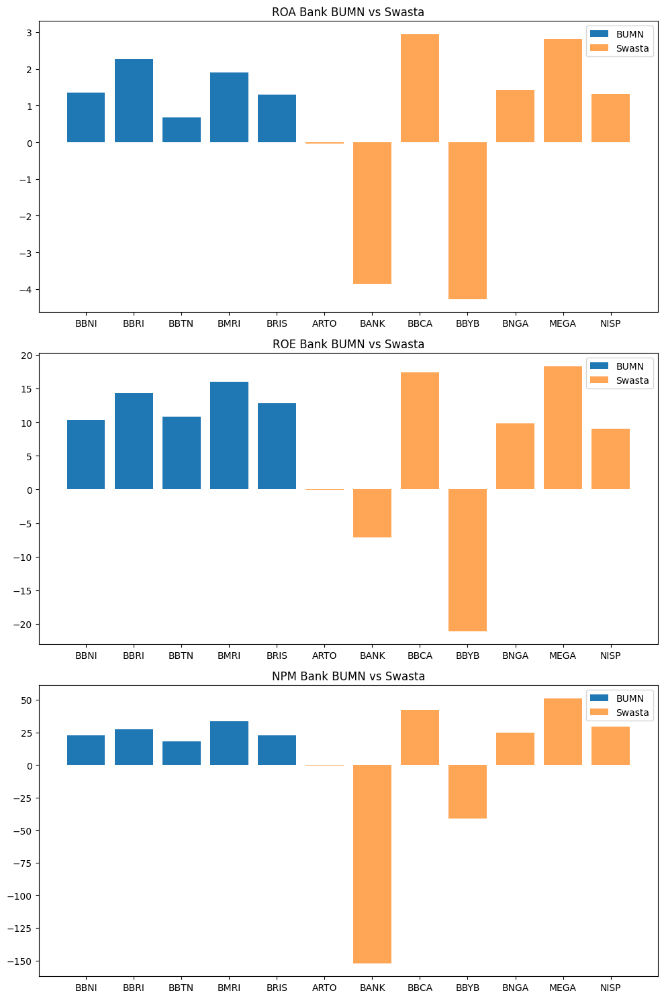

In [ ]:
# Membuat plot
fig, axes = plt.subplots(nrows=3, ncols=1, figsize=(10, 15))

# Plot ROA
axes[0].bar(df_bumn['Bank'], df_bumn['ROA'], label='BUMN')
axes[0].bar(df_swasta['Bank'], df_swasta['ROA'], label='Swasta', alpha=0.7)
axes[0].set_title('ROA Bank BUMN vs Swasta')
axes[0].legend()

# Plot ROE
axes[1].bar(df_bumn['Bank'], df_bumn['ROE'], label='BUMN')
axes[1].bar(df_swasta['Bank'], df_swasta['ROE'], label='Swasta', alpha=0.7)
axes[1].set_title('ROE Bank BUMN vs Swasta')
axes[1].legend()

# Plot NPM
axes[2].bar(df_bumn['Bank'], df_bumn['NPM'], label='BUMN')
axes[2].bar(df_swasta['Bank'], df_swasta['NPM'], label='Swasta', alpha=0.7)
axes[2].set_title('NPM Bank BUMN vs Swasta')
axes[2].legend()

# Menampilkan plot
plt.tight_layout()
plt.show()

Dari plot di atas, dapat dilihat bahwa secara keseluruhan, bank BUMN memiliki nilai ROA, ROE, dan NPM yang lebih baik daripada bank swasta. Namun, jika dilihat secara individual setiap bank, terdapat 2 bank swasta yang tampak paling baik di antara keseluruhan bank yaitu bank BCA (BBCA) dan bank MEGA. Kemudian terdapat 2 bank swasta yang sangat buruk yaitu bank Aladin Syariah (BANK) dan bank Neo Commerce (BBYB). Terdapat juga 1 bank swasta yang cukup buruk yaitu bank Jago (ARTO). Sementara itu pada bank BUMN, terdapat 2 bank yang terlihat lebih baik daripada bank-bank lainnya yaitu bank BRI (BBRI) dan bank Mandiri (BMRI).

## Analysis Journal 1

Features yang akan dianalisis pada data fundamentals sesuai jurnal: 'Net Income', 'Operating Cash Flow', 'Investing Cash Flow','Financing Cash Flow','Total Assets'.

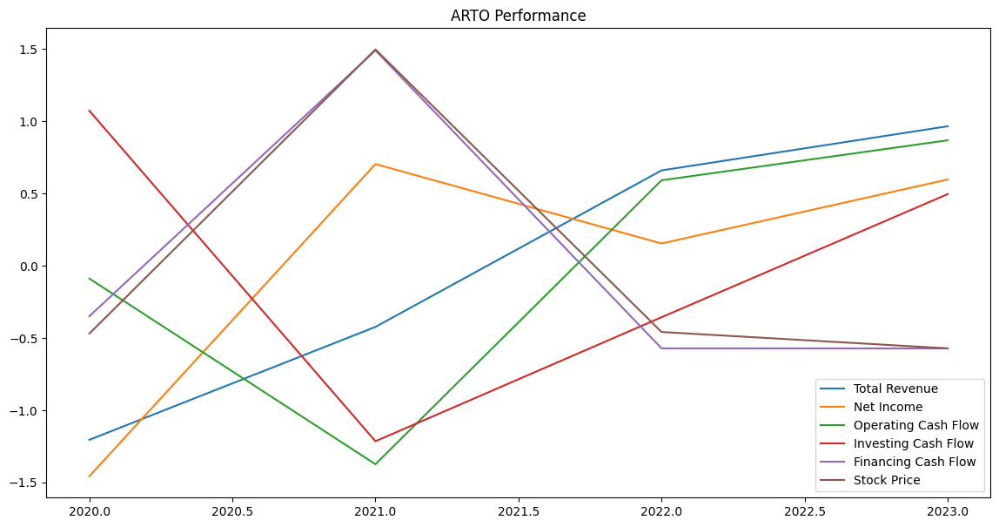

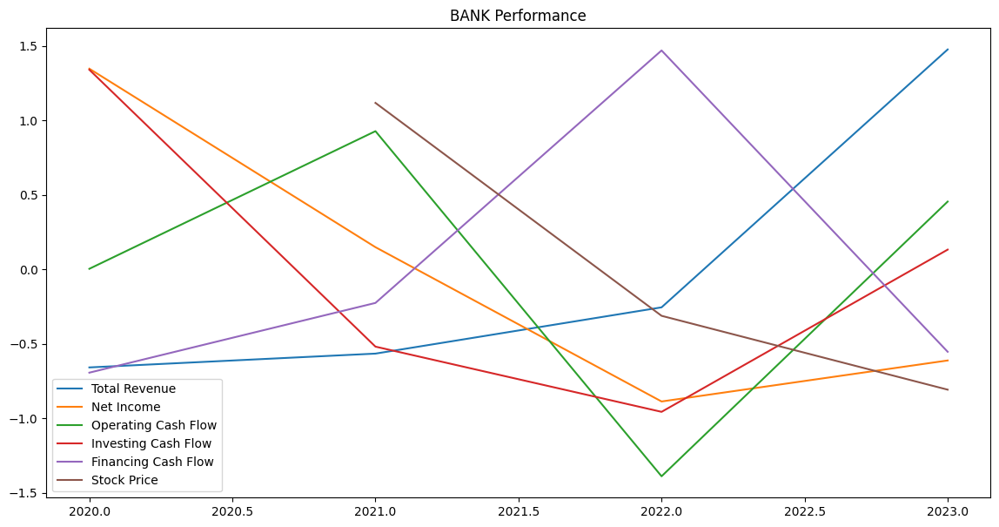

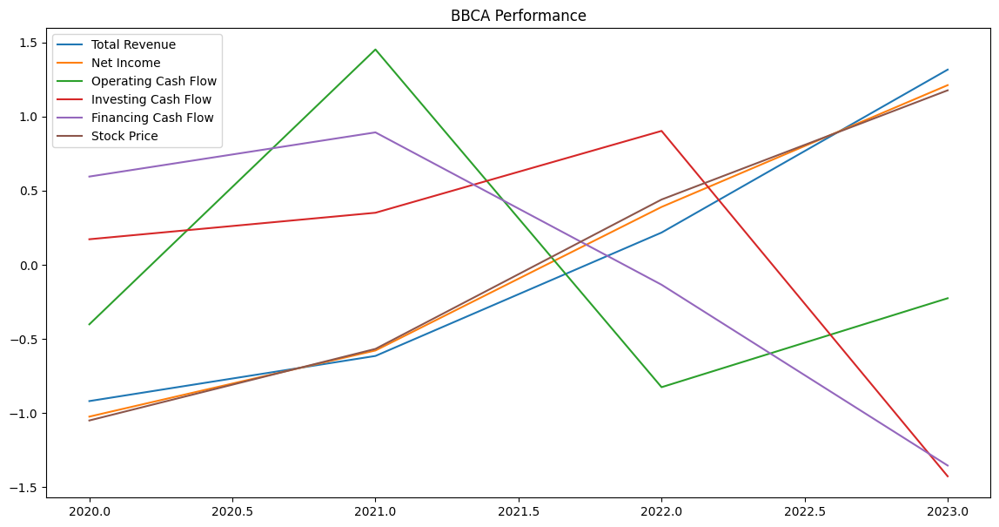

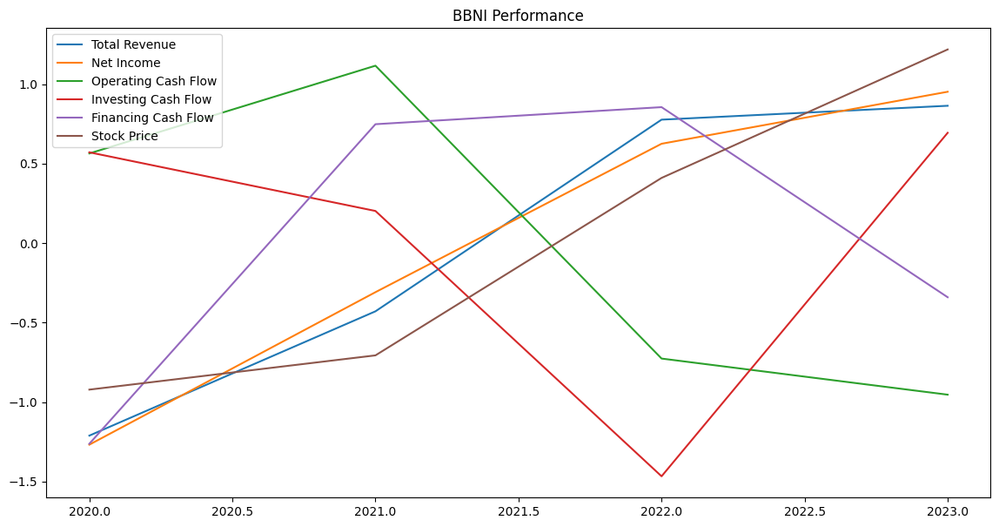

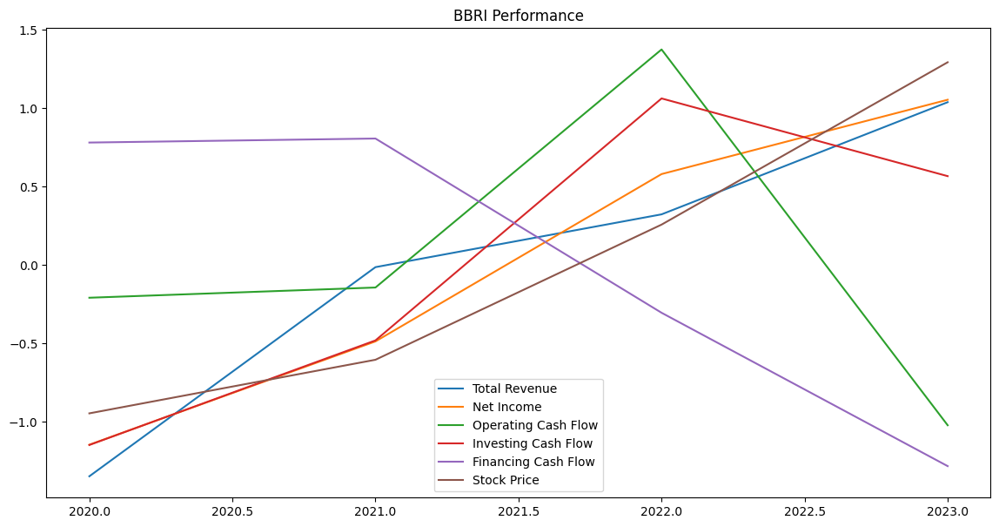

...

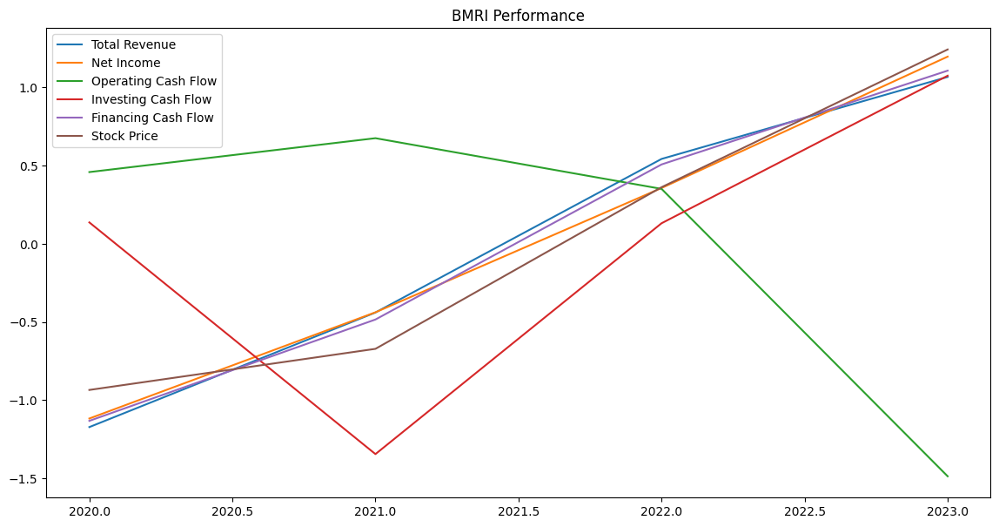

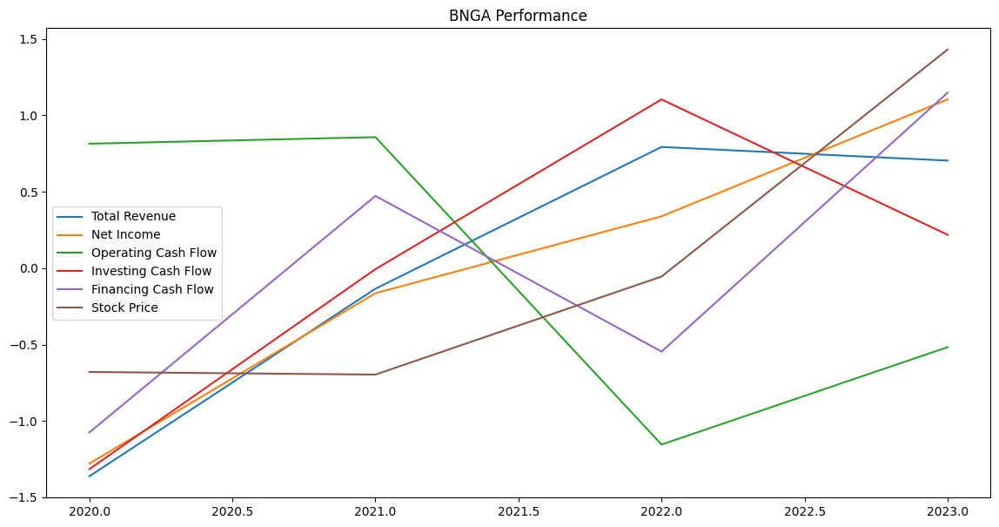

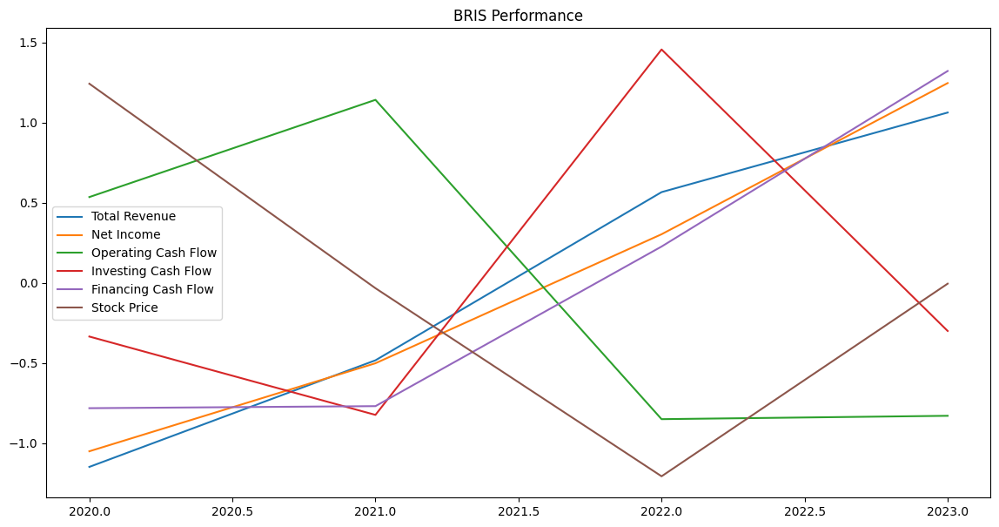

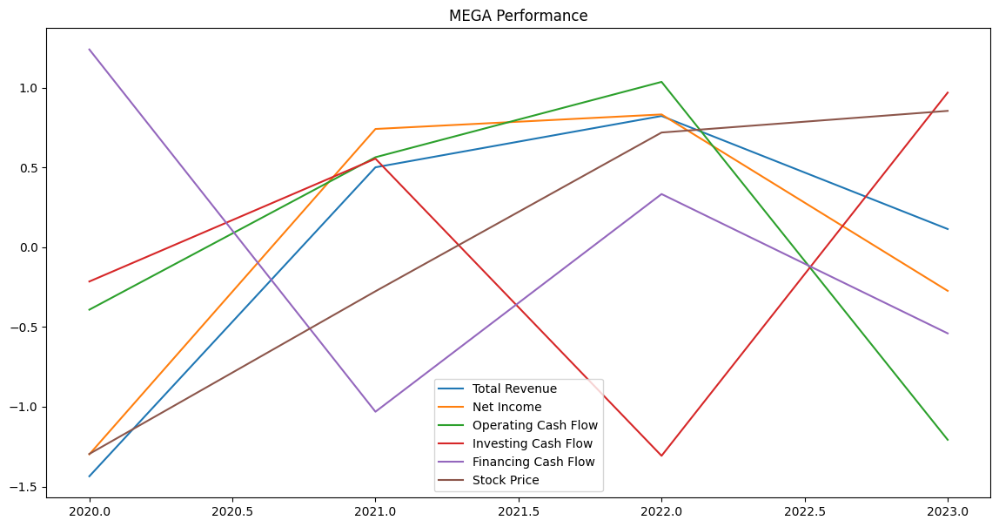

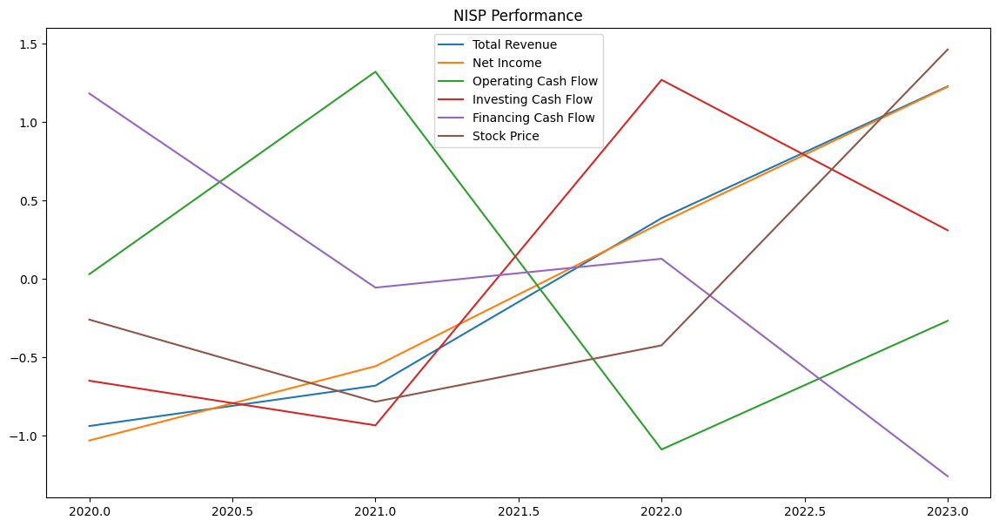

In [ ]:
# Daftar bank dan dataset yang sesuai
banks = [
    "arto", "bank", "bbca", "bbni", "bbri", "bbtn",
    "bbyb", "bmri", "bnga", "bris", "mega", "nisp"
]

for bank in banks:
    income_stat_var = f"{bank}_income_stat"
    cashflow_var = f"{bank}_cashflow"
    hist_var = f"{bank}_hist"

    # Buat dataframe baru untuk menyimpan features
    exec(f"df_{bank} = pd.DataFrame()")
    exec(f"df_{bank}['Total Revenue'] = {income_stat_var}['Total Revenue']")
    exec(f"df_{bank}['Net Income'] = {income_stat_var}['Net Income']")
    exec(f"df_{bank}['Operating Cash Flow'] = {cashflow_var}['Operating Cash Flow']")
    exec(f"df_{bank}['Investing Cash Flow'] = {cashflow_var}['Investing Cash Flow']")
    exec(f"df_{bank}['Financing Cash Flow'] = {cashflow_var}['Financing Cash Flow']")

    # Konversi indeks menjadi tipe datetime jika belum dalam format itu
    exec(f"df_{bank}.index = pd.to_datetime(df_{bank}.index)")
    # Ubah indeks menjadi hanya tahun
    exec(f"df_{bank}.index = df_{bank}.index.year")
    # Buat kolom baru 'Year' untuk menyimpan tahun
    exec(f"{hist_var}['Year'] = {hist_var}['Date'].dt.year")
    # Filter data untuk tahun 2020-2023
    exec(f"filtered_{bank} = {hist_var}[( {hist_var}['Year'] >= 2020) & ({hist_var}['Year'] <= 2023)]")
    # Groupby tahun dan ambil harga saham terakhir setiap tahun
    exec(f"last_prices_{bank} = filtered_{bank}.groupby('Year').last()")
    exec(f"df_{bank}['Stock Price'] = last_prices_{bank}['Average']")
    # Z-score normalization
    exec(f"normalized_df_{bank} = (df_{bank} - df_{bank}.mean()) / df_{bank}.std()")
    # Plot data
    exec(f"normalized_df_{bank}[['Total Revenue', 'Net Income','Operating Cash Flow','Investing Cash Flow','Financing Cash Flow', 'Stock Price']].plot(figsize=(14, 7), title='{bank.upper()} Performance')")
    plt.show()

# Technical Analysis (Time Series Forecasting)

Pada Technical Analysis, tim Metric Mestro memilih 3 metode time series forecasting yaitu `AutoRegressive Integrated Moving Average (ARIMA)`, `Long Short-Term Memory (LSTM)`, dan `Gated Recurrent Unit (GRU)` dengan beberapa alasan yaitu:

1.   **ARIMA** : ARIMA merupakan metode statistik yang biasa digunakan untuk analisis runtun waktu. Model ARIMA banyak digunakan secara luas dalam melakukan peramalan deret berkala dan banyak penelitian menyebutkan bahwa model ARIMA sangat baik dalam melakukan peramalan beberapa periode ke depan (Kamruzzaman,  2003). Kemudian model ARIMA menghasilkan model yang lebih mudah diinterpretasikan secara statistik, memberikan informasi yang jelas tentang bagaimana harga saham diprediksi berdasarkan komponen autogresif, perbedaan integrasi, dan rata-rata bergerak.
2.   **LSTM** : LSTM merupakan model neural network yang dapat dengan unggul mengatasi masalah dalam mempelajari dependensi jangka panjang dalam data time series [Hochreiter, S., & Schmidhuber, J. (1997)]. Terdapat beberapa penelitian terdahulu yang menggunakan metode LSTM dalam memprediksi harga saham dan menghasilkan hasil prediksi dengan nilai kesalahan (error) yang kecil maka disimpulkan bahwa LSTM mampu menanggulangi ketergantungan jangka panjang dan mampu memprediksi harga saham dengan hasil yang akurat.
3. **GRU** : GRU merupakan model neural network yang memiliki beberapa kesamaan dengan LSTM tetapi dengan struktur yang lebih sederhana. Model ini lebih ringan dan cepat dilatih dibandingkan LSTM [Cho, K. et al. (2014)]. Terdapat beberapa penelitian terdahulu yang menggunakan metode GRU dalam memprediksi harga saham dan menghasilkan hasil prediksi dengan nilai kesalahan (error) yang kecil sehingga dapat disimpulkan bahwa GRU merupakan salah satu algoritma yang cocok dalam melakukan prediksi harga saham mendatang.





3 metode tersebut akan dicoba pada 3 saham bank yaitu bank BCA (BBCA), bank BRI (BBRI), dan bank Neo Commerce (BBYB). Alasan dipilih 3 saham bank tersebut adalah bank BCA memiliki trend saham meningkat yang dapat dikatakan cukup stabil (tidak banyak peningkatan/penurunan harga yang terlalu drastis), bank BRI memiliki trend saham yang cukup stabil seperti bank BCA namun lebih drastis perubahan harga sahamnya dibanding saham bank BCA, sementara bank Neo Commerce memiliki peningkatan/penurunan harga saham yang sangat drastis. Oleh karena itu, diharapkan dengan dipilihnya 3 saham bank tersebut dapat mewakili pola harga saham pada keseluruhan bank. Kemudian dari hasil modelling 3 bank tersebut akan dipilih 1 metode terbaik yang akan digunakan untuk memprediksi harga saham untuk keseluruhan bank.

## Pemilihan Model Terbaik

### Bank Central Asia (BBCA)

#### ARIMA

##### Baseline Model

In [ ]:
# Calculate lengths for train
total_length = len(bbca_hist)
train_length = int(0.8 * total_length)

# Split the Data to Train and Test
train_bbca_arima = list(bbca_hist[0:train_length]['Close'])
test_bbca_arima = list(bbca_hist[train_length:]['Close'])

# Auto ARIMA to select optimal ARIMA parameters
model_bbca_arima = auto_arima(train_bbca_arima, seasonal=False, trace=True)
print(model_bbca_arima.summary())

Performing stepwise search to minimize aic
 ARIMA(2,1,2)(0,0,0)[0] intercept   : AIC=22154.861, Time=4.48 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=22165.238, Time=0.09 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=22153.975, Time=0.09 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=22153.429, Time=0.20 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=22166.857, Time=0.04 sec
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=22155.137, Time=1.17 sec
 ARIMA(0,1,2)(0,0,0)[0] intercept   : AIC=22154.923, Time=0.78 sec
 ARIMA(1,1,2)(0,0,0)[0] intercept   : AIC=22154.680, Time=2.06 sec
 ARIMA(0,1,1)(0,0,0)[0]             : AIC=22155.729, Time=0.09 sec

Best model:  ARIMA(0,1,1)(0,0,0)[0] intercept
Total fit time: 9.027 seconds
                               SARIMAX Results                                
Dep. Variable:                      y   No. Observations:                 1980
Model:               SARIMAX(0, 1, 1)   Log Likelihood              -11073.714
Date:                Thu, 23 May 2024   

Dari fungsi auto_arima, diperoleh model terbaik yang meminimalkan AIC adalah ARIMA(0,1,1). Oleh karena itu, akan dilakukan permodelan dan prediksi menggunakan ARIMA(0,1,1)

In [ ]:
# Menghitung jumlah observasi dalam data pengujian dan menyimpannya dalam variabel n_test_obser
n_test_obser_arima = len(test_bbca_arima)

In [ ]:
# Inisialisasi daftar kosong untuk menyimpan prediksi model
model_predictions_bbca_arima = []

# Memulai perulangan untuk setiap observasi pengujian
for i in range(n_test_obser_arima):
    # Membuat model ARIMA dengan data pelatihan dan order (0, 1, 1)
    model_bbca_arima = ARIMA(train_bbca_arima, order=(0, 1, 1))
    # Melakukan fit pada model ARIMA yang telah dibuat
    model_fit_bbca_arima = model_bbca_arima.fit()
    # Melakukan peramalan menggunakan model yang telah difit
    output_arima = model_fit_bbca_arima.forecast()
    # Mengambil nilai prediksi dari hasil peramalan (output adalah array numpy)
    yhat_arima = output_arima[0]
    # Menambahkan nilai prediksi ke dalam daftar prediksi model
    model_predictions_bbca_arima.append(yhat_arima)
    # Memperbarui data pelatihan dengan menambahkan nilai prediksi pada akhir data pelatihan
    train_bbca_arima.append(yhat_arima)

Setelah dilakukan permodelan dan prediksi menggunakan ARIMA(0,1,1), akan dilihat plot perbandingan data asli dengan data hasil prediksinya.

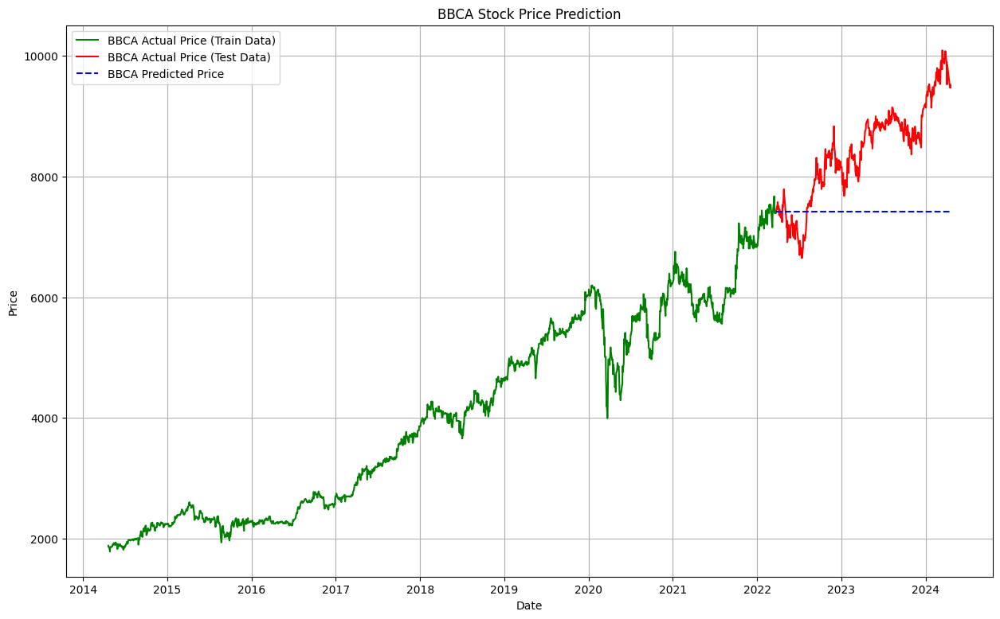

In [ ]:
# Menggabungkan data pelatihan dan pengujian untuk sumbu x (tanggal)
date_range_all = bbca_hist.index
# Membuat figure baru dengan ukuran 15x9
plt.figure(figsize=(15, 9))
# Menambahkan grid ke plot
plt.grid(True)
# Membuat plot garis untuk data pelatihan BBCA dengan warna hijau
plt.plot(date_range_all[:train_length], train_bbca_arima[:train_length], color='green', label='BBCA Actual Price (Train Data)')
# Membuat plot garis untuk data pengujian BBCA dengan warna merah
plt.plot(date_range_all[train_length:], test_bbca_arima, color='red', label='BBCA Actual Price (Test Data)')
# Membuat plot garis untuk prediksi harga BBCA dengan warna biru dan garis putus-putus
plt.plot(date_range_all[train_length:], model_predictions_bbca_arima, color='blue', ls='dashed', label='BBCA Predicted Price')
# Menambahkan judul pada plot
plt.title('BBCA Stock Price Prediction')
# Menambahkan label untuk sumbu x
plt.xlabel('Date')
# Menambahkan label untuk sumbu y
plt.ylabel('Price')
# Menambahkan legenda pada plot
plt.legend()
# Menampilkan plot
plt.show()

Dari hasil plot di atas, diperoleh bahwa model ARIMA(0,1,1) tidak cukup baik dalam memprediksi data test. Kemudian akan dilihat metrik evaluasinya.

In [ ]:
# Metric Evaluation RMSE & MAPE
def mean_absolute_percentage_error(y_true, y_pred):
    y_true, y_pred = np.array(y_true), np.array(y_pred)
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100

# Menghitung RMSE
rmse_bbca_arima1 = np.sqrt(mean_squared_error(test_bbca_arima, model_predictions_bbca_arima))
print('BBCA ARIMA Test RMSE: %.3f' % rmse_bbca_arima1)
# Menghitung MAPE
mape_bbca_arima1 = mean_absolute_percentage_error(test_bbca_arima, model_predictions_bbca_arima)
print('BBCA ARIMA Test MAPE: '+str(mape_bbca_arima1))

BBCA ARIMA Test RMSE: 1249.262
BBCA ARIMA Test MAPE: 12.275219207218138


Diperoleh bahwa RMSE dari model ARIMA(0,1,1) sebesar 1249.262 yang mana cukup besar sehingga dapat disimpulkan model ini tidak cukup baik untuk memprediksi harga saham close BBCA.

##### Hyperparameter Tuning & Optimization

Langkah awal yang akan diambil adalah melakukan uji stasioneritas terhadap data saham BBCA karena model ARIMA memerlukan data yang stasioneritas

In [ ]:
# Melakukan uji Augmented Dickey-Fuller pada data harga penutupan saham BBCA
adf_test_bbca = adfuller(bbca_hist.Close)

# Ho: Data tidak stasioner (memiliki unit root)
# H1: Data stasioner (tidak memiliki unit root)

# Mendefinisikan fungsi untuk melakukan uji Augmented Dickey-Fuller dan menampilkan hasilnya
def adfuller_test(close):
    # Melakukan uji Augmented Dickey-Fuller pada data yang diberikan
    result = adfuller(close)
    # Mendefinisikan label untuk hasil uji
    labels = ['ADF Test Statistic', 'p-value', '#Lags Used', 'Number of Observations Used']
    # Menampilkan hasil uji dengan label yang sesuai
    for value, label in zip(result, labels):
        print(label + ' : ' + str(value))
    # Menilai hasil uji berdasarkan nilai p-value
    if result[1] <= 0.05:
        # Jika p-value kurang dari atau sama dengan 0.05, menolak hipotesis nol (Ho)
        print("strong evidence against the null hypothesis(Ho), reject the null hypothesis. Data has no unit root and is stationary")
    else:
        # Jika p-value lebih besar dari 0.05, tidak dapat menolak hipotesis nol (Ho)
        print("weak evidence against null hypothesis, time series has a unit root, indicating it is non-stationary ")

In [ ]:
# Uji stasioneritas
adfuller_test(bbca_hist.Close)

ADF Test Statistic : 0.26966173814779865
p-value : 0.9759089596920466
#Lags Used : 11
Number of Observations Used : 2463
weak evidence against null hypothesis, time series has a unit root, indicating it is non-stationary 


Dari uji ADF yang telah dilakukan, diperoleh hasil bahwa data harga saham close BBCA tidak stasioner. Oleh karena itu, akan dilakukan differencing terhadap data.

In [ ]:
# Melakukan differencing karena data tidak stasioner
diff_bbca = bbca_hist.Close.diff().dropna()

In [ ]:
# Uji stasioneritas setelah differencing
adfuller_test(diff_bbca)

ADF Test Statistic : -16.5774826867956
p-value : 1.8468235970325791e-29
#Lags Used : 10
Number of Observations Used : 2463
strong evidence against the null hypothesis(Ho), reject the null hypothesis. Data has no unit root and is stationary


Dari hasil uji stasioneritas terhadap data differencing pertama, diperoleh bahwa data sudah stasioner. Untuk lebih memastikan, akan dilihat jumlah differencing yang diperlukan untuk data saham close BBCA.

In [ ]:
# Menghitung jumlah differencing yang diperlukan untuk membuat data harga penutupan BBCA stasioner menggunakan uji ADF (Augmented Dickey-Fuller)
optimal_diffs = ndiffs(bbca_hist.Close, test='adf')
optimal_diffs

1

Diperoleh bahwa differencing optimal yang diperlukan adalah 1. Maka selanjutnya akan dilakukan permodelan ARIMA.

In [ ]:
# Calculate lengths for train
total_length = len(bbca_hist)
train_length = int(0.8 * total_length)

# Split the DataFrame
train_bbca_arima = bbca_hist[:train_length]
test_bbca_arima = bbca_hist[train_length:]

Akan dilakukan beberapa percobaan menggunakan orde p dan q dimana orde p dan q yang diambil mulai dari 0 sampai dengan 4.

In [ ]:
# Mendefinisikan rentang nilai untuk p, d, q dalam model ARIMA
p = range(0, 5)
d = range(1, 2)
q = range(0, 5)

# Menghasilkan semua kombinasi berbeda dari tripel p, d, dan q
pdq = list(itertools.product(p, d, q))

# Mengonversi data pengujian menjadi array numpy
test_data_arima = test_bbca_arima['Close'].to_numpy()

/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/usr/local/lib/p

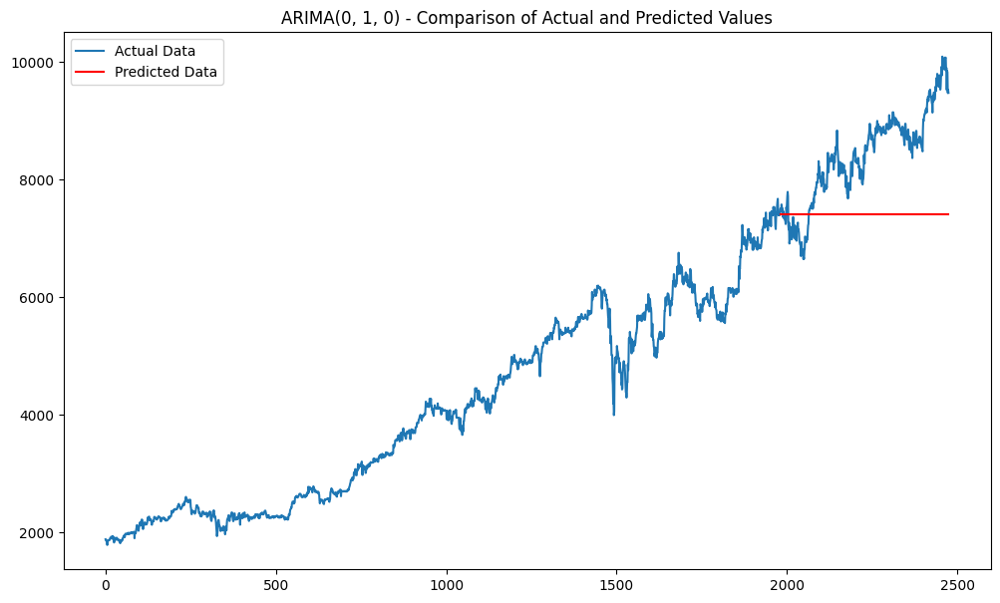

/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/usr/local/lib/p

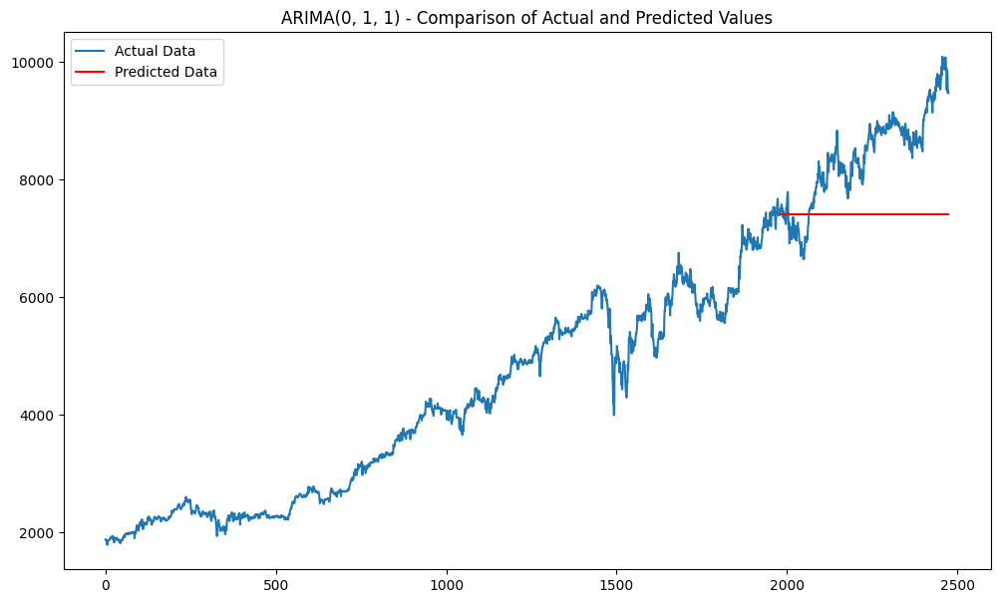

/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/usr/local/lib/p

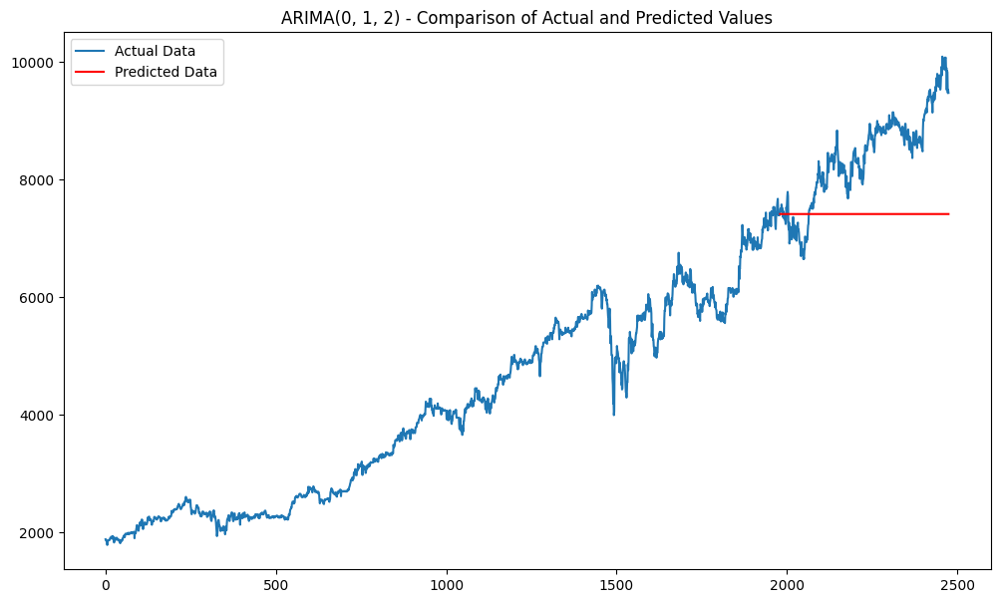

/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/usr/local/lib/p

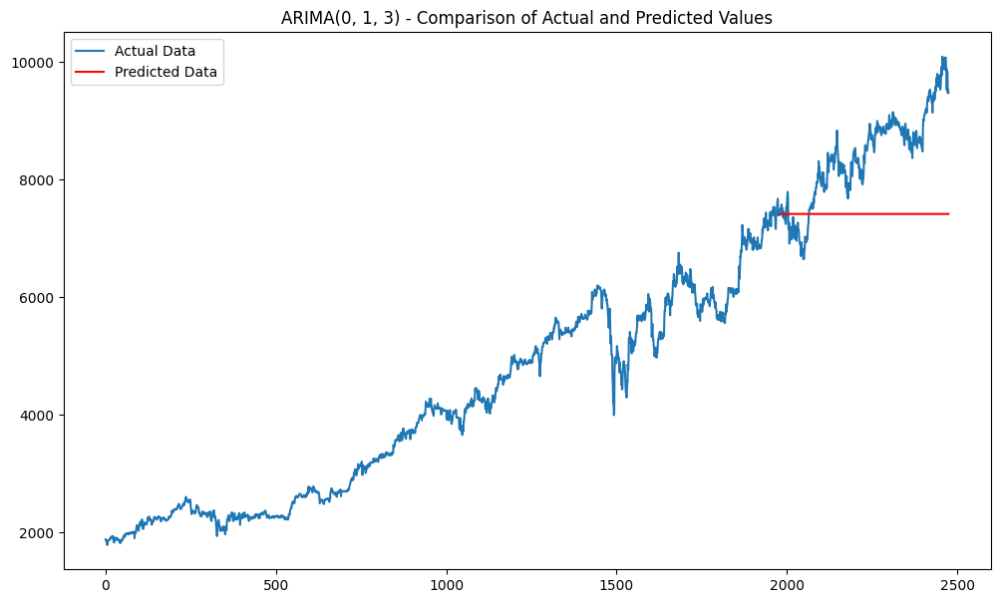

/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/usr/local/lib/p

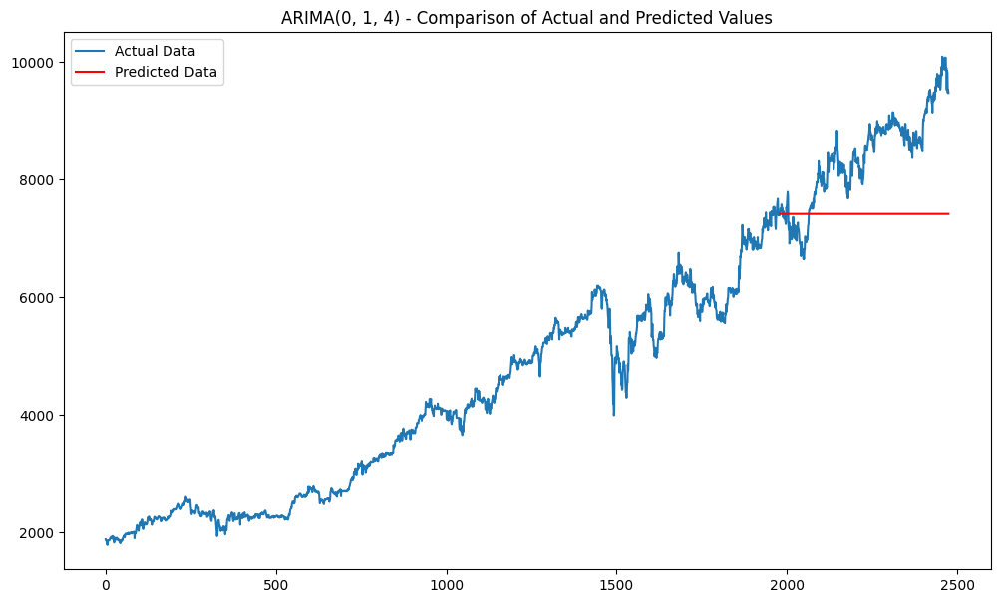

/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/usr/local/lib/p

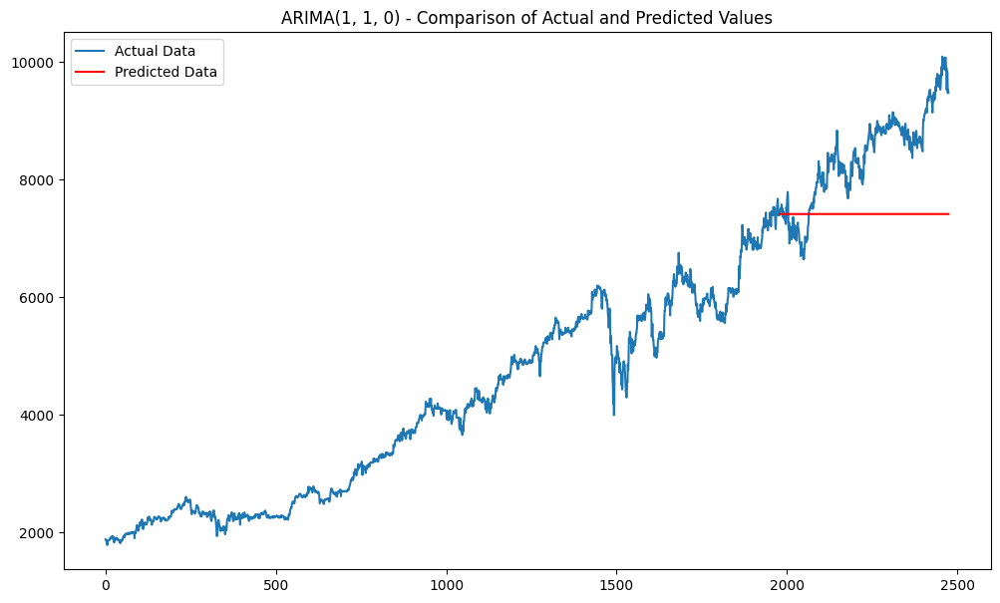

/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/usr/local/lib/p

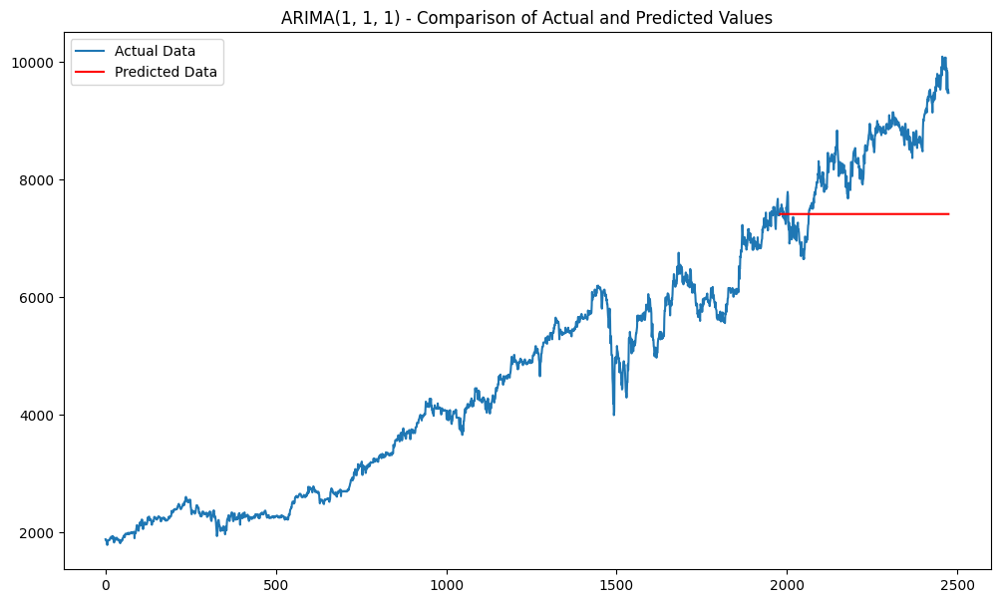

/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/usr/local/lib/p

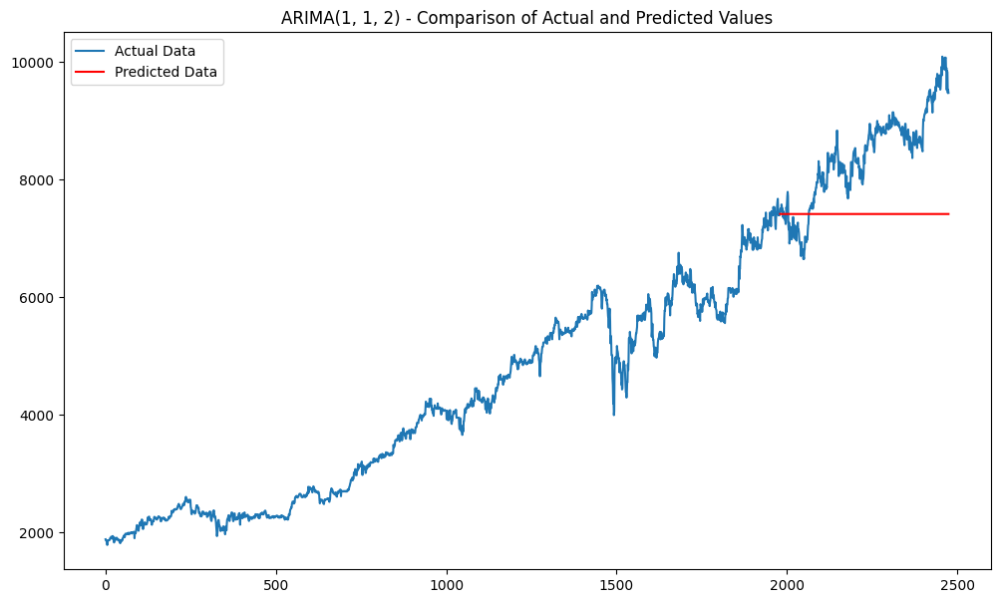

/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/usr/local/lib/p

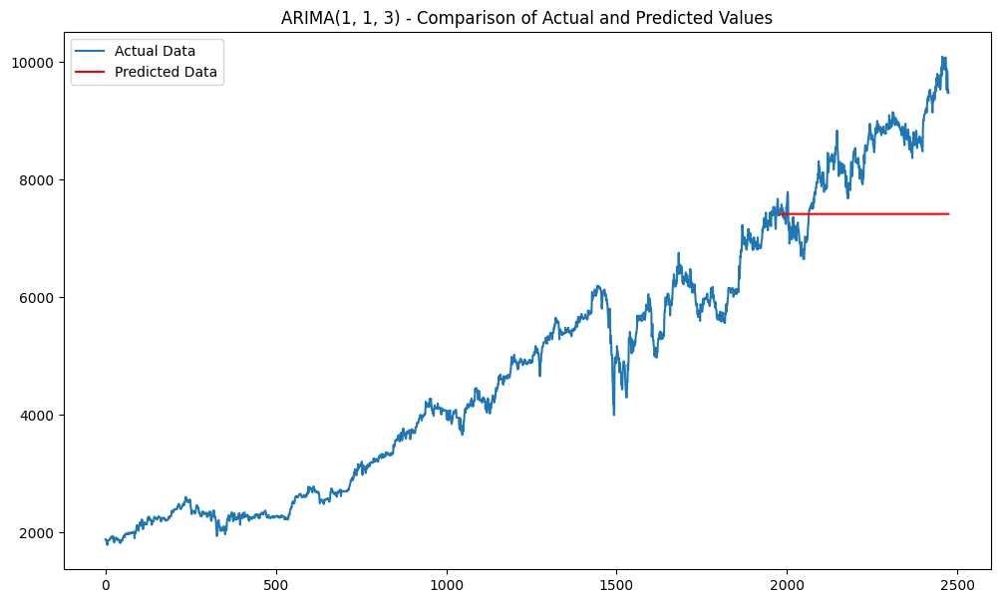

/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/usr/local/lib/p

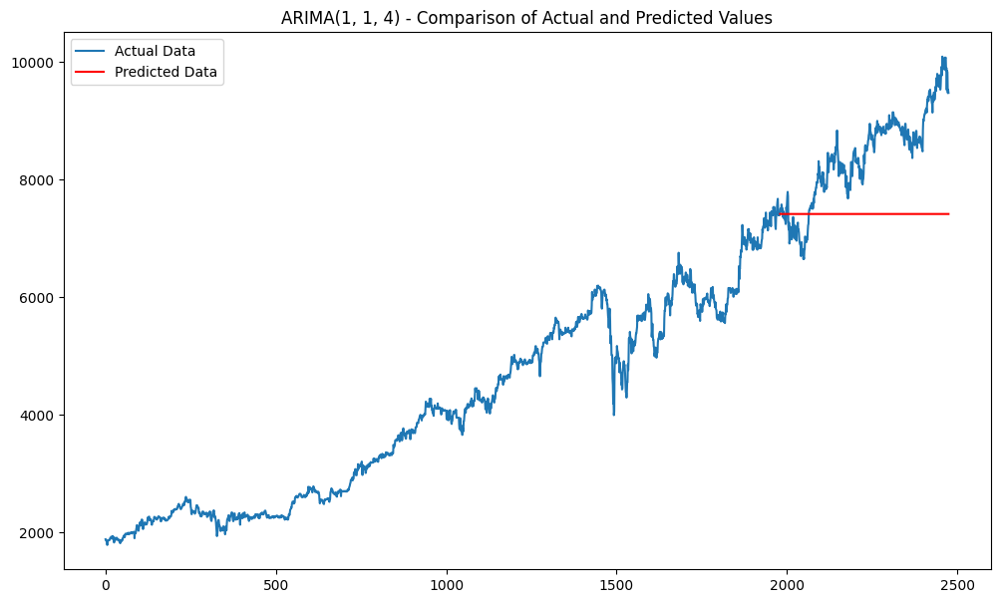

/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/usr/local/lib/p

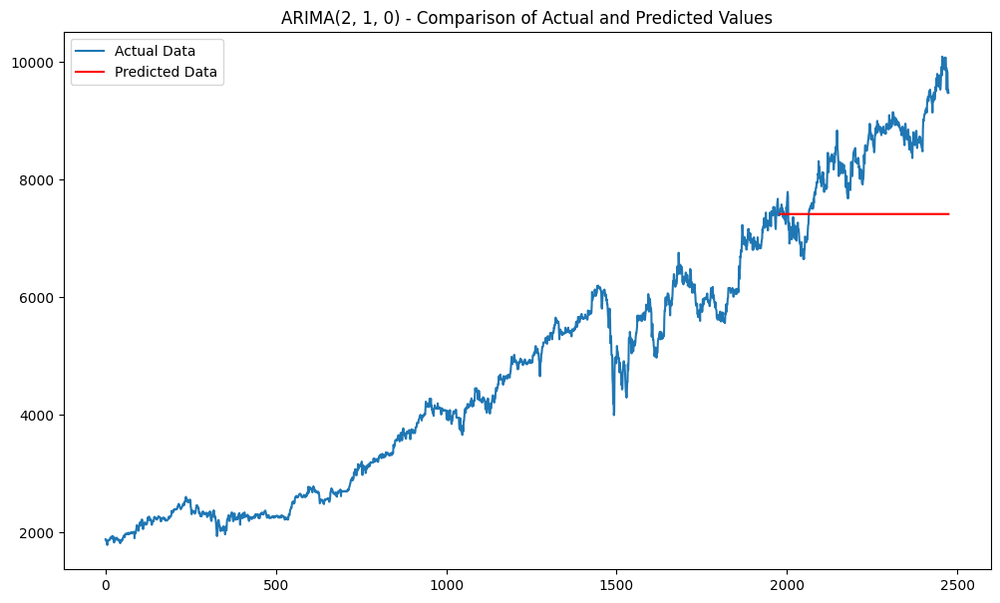

/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/u

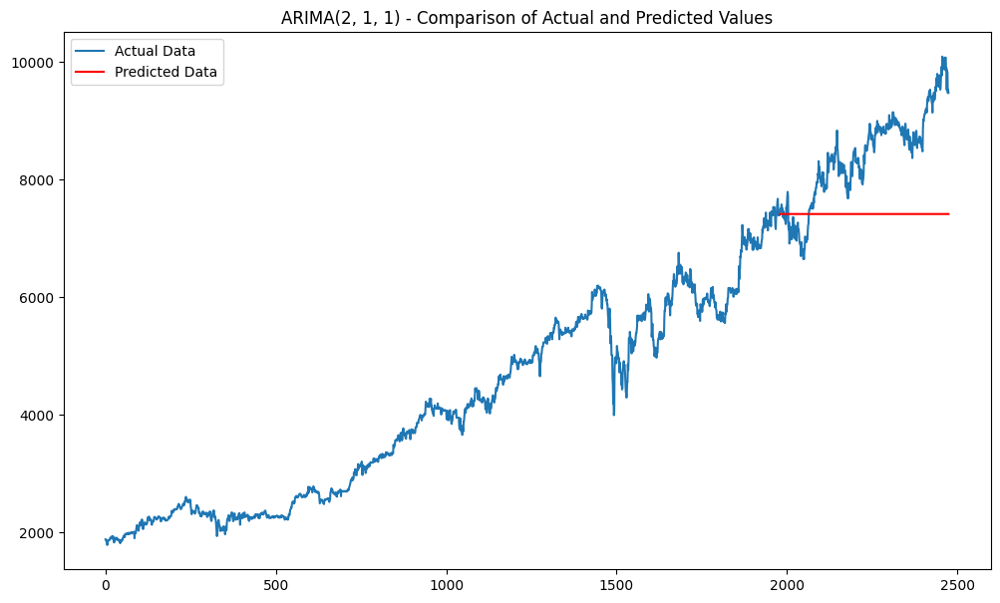

/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/usr/local/lib/p

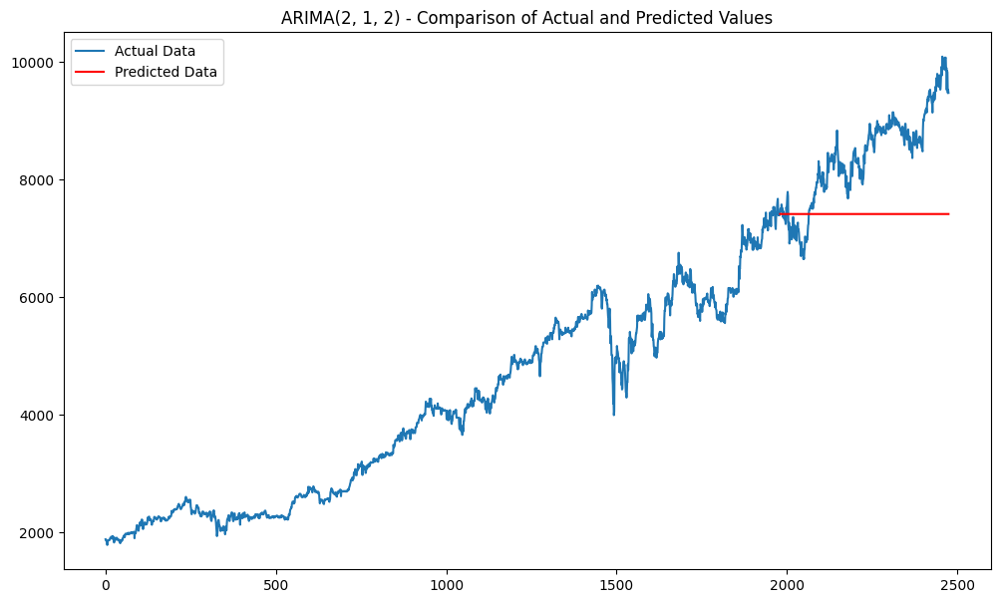

/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.10/di

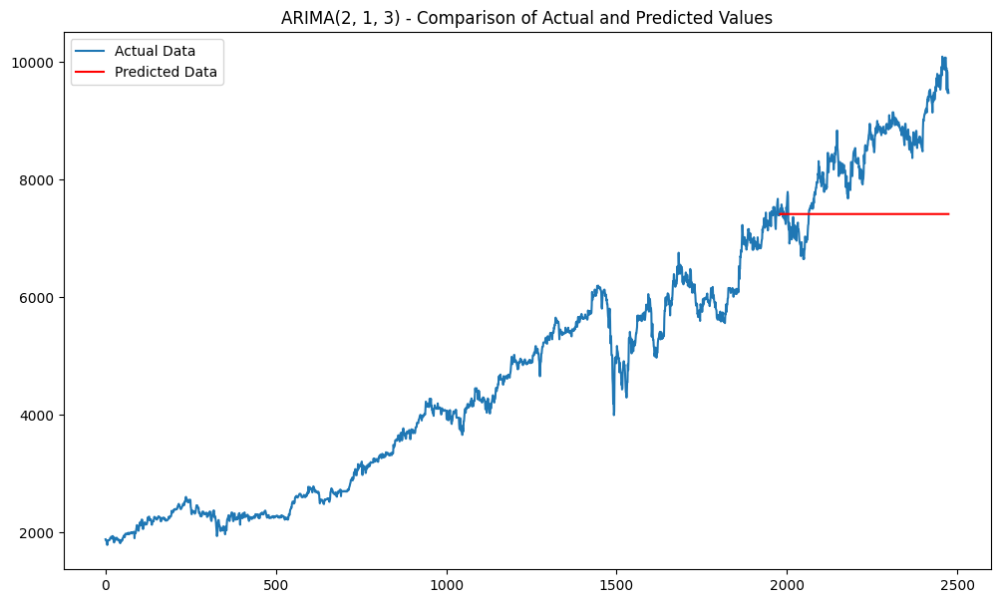

/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/usr/local/lib/p

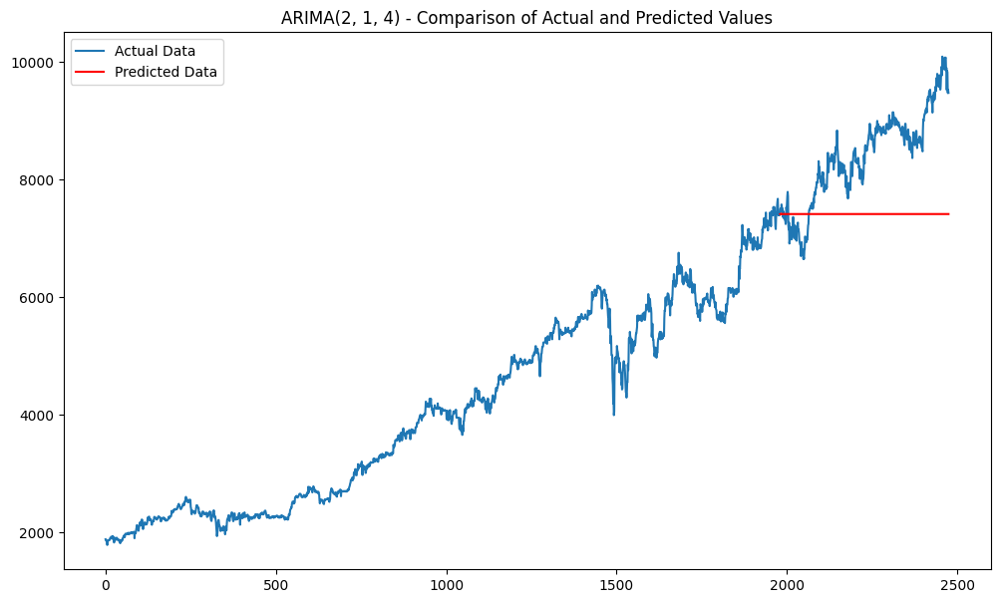

/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/usr/local/lib/p

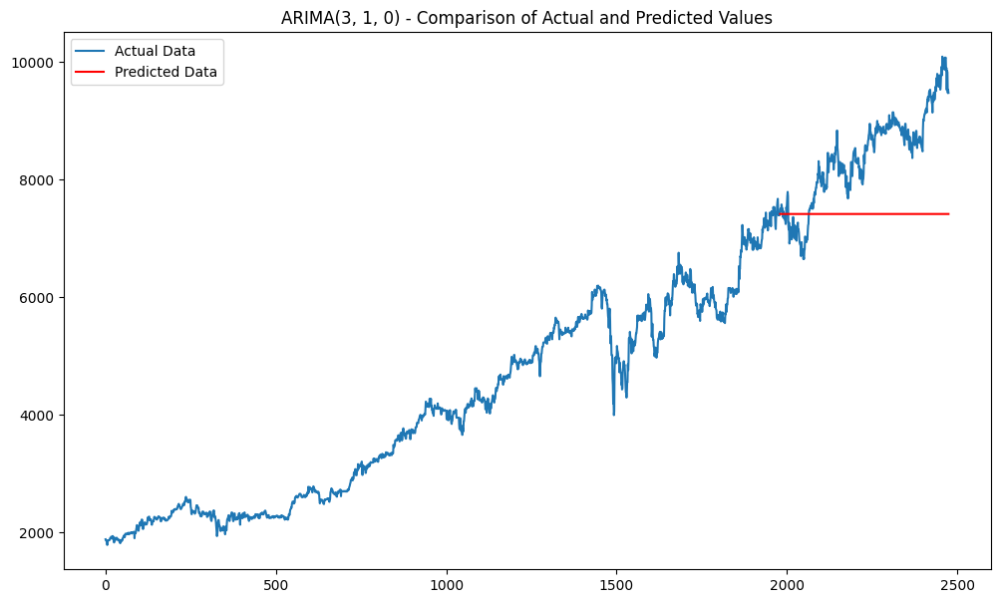

/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/usr/local/lib/p

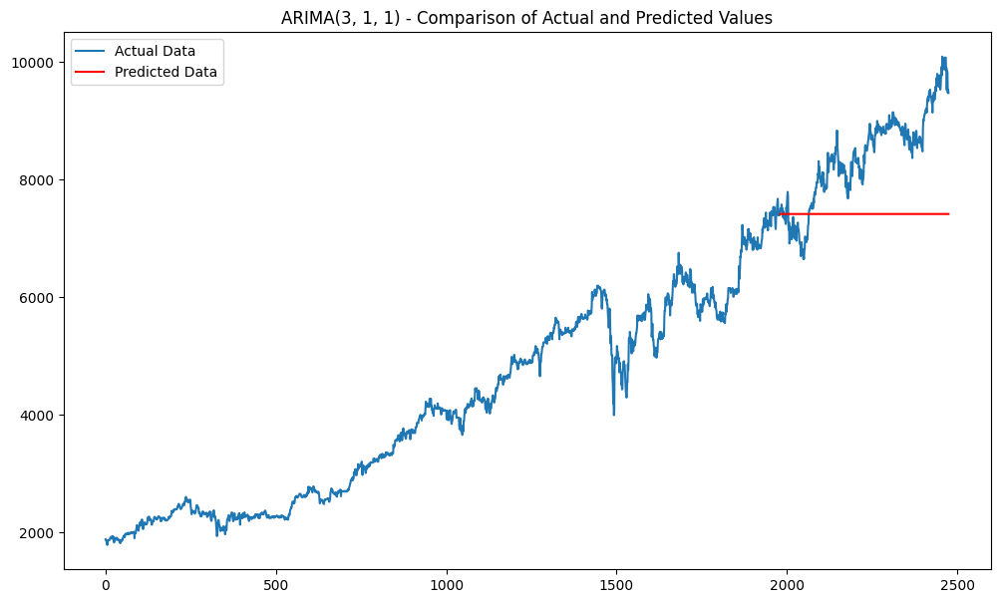

/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/usr/local/lib/p

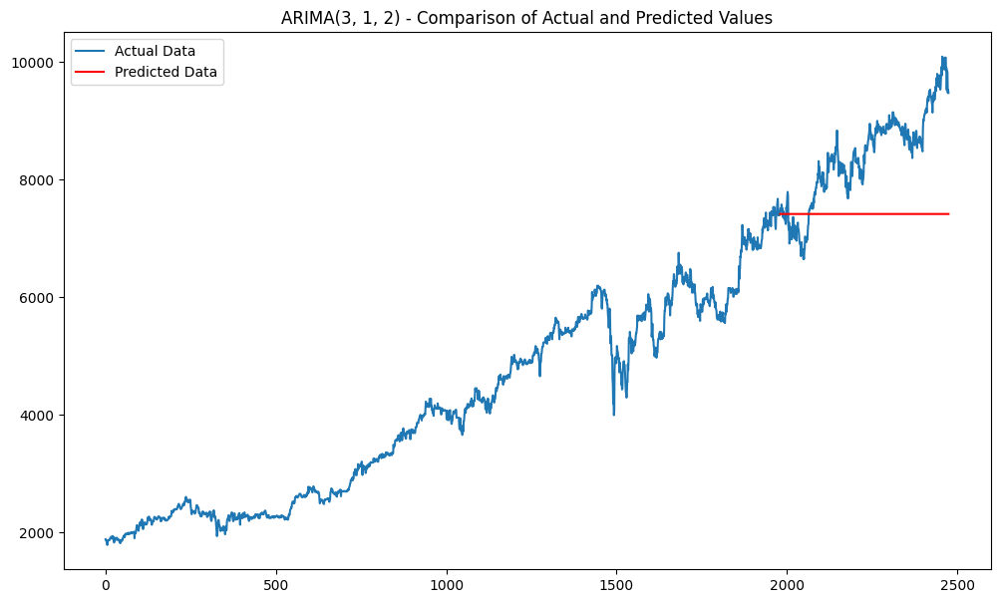

/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.10/di

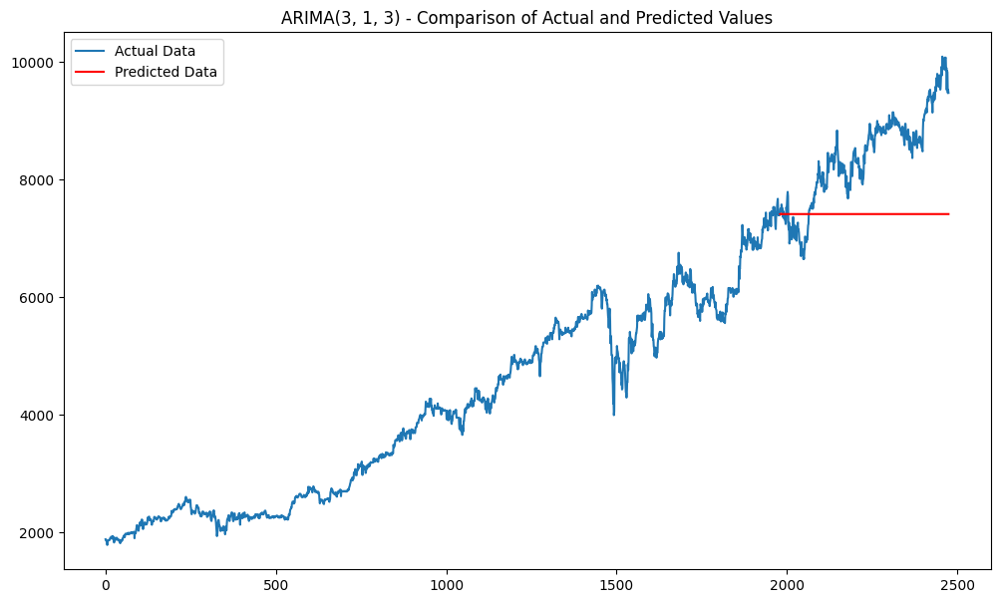

/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.10/di

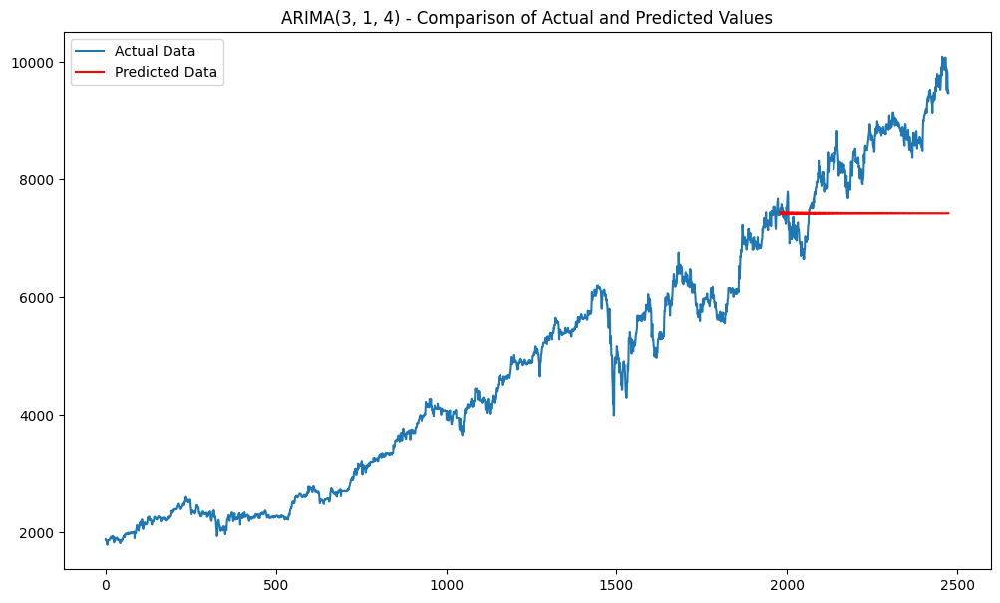

/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/usr/local/lib/p

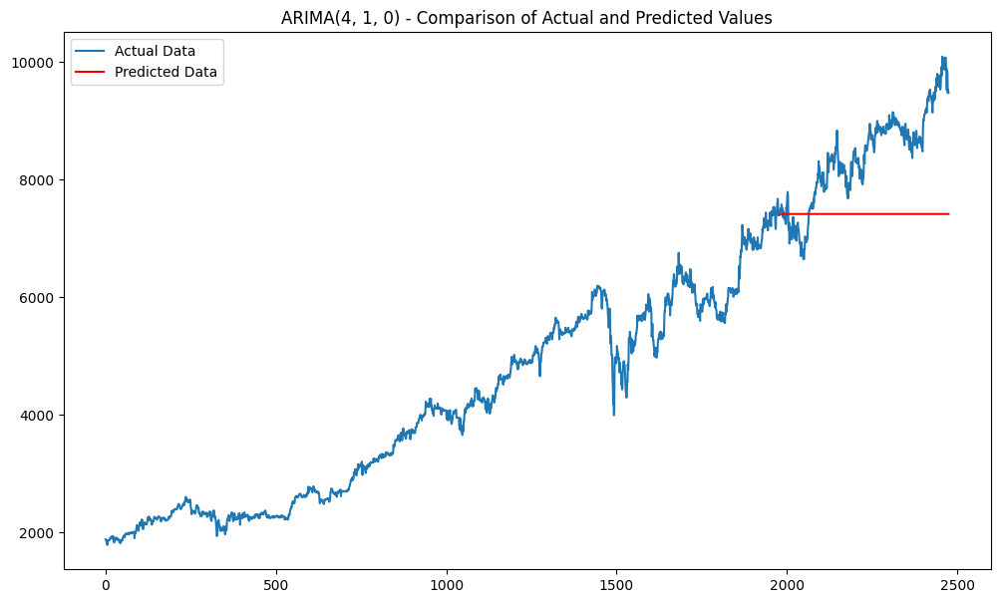

/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/usr/local/lib/p

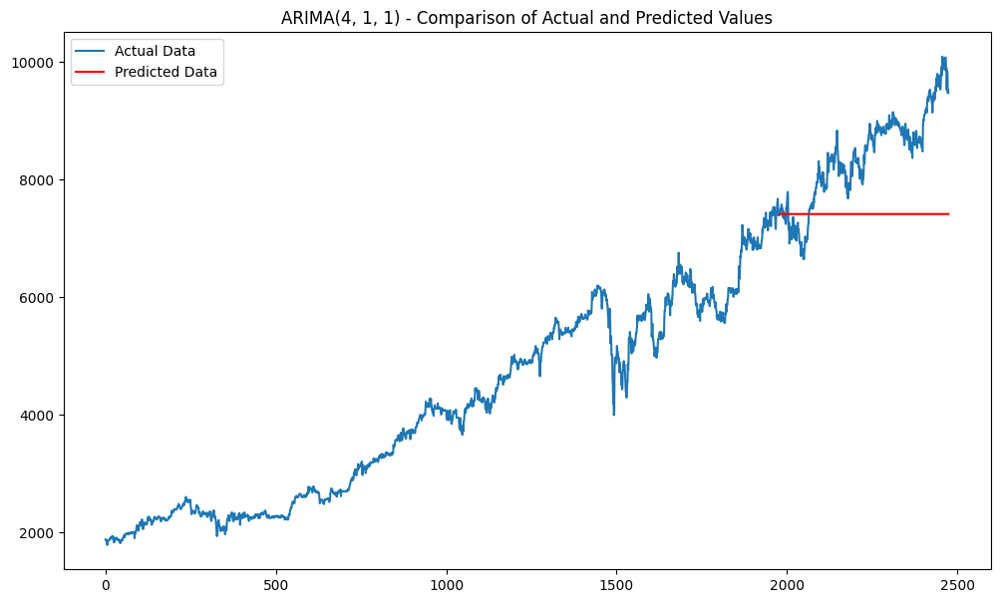

/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/u

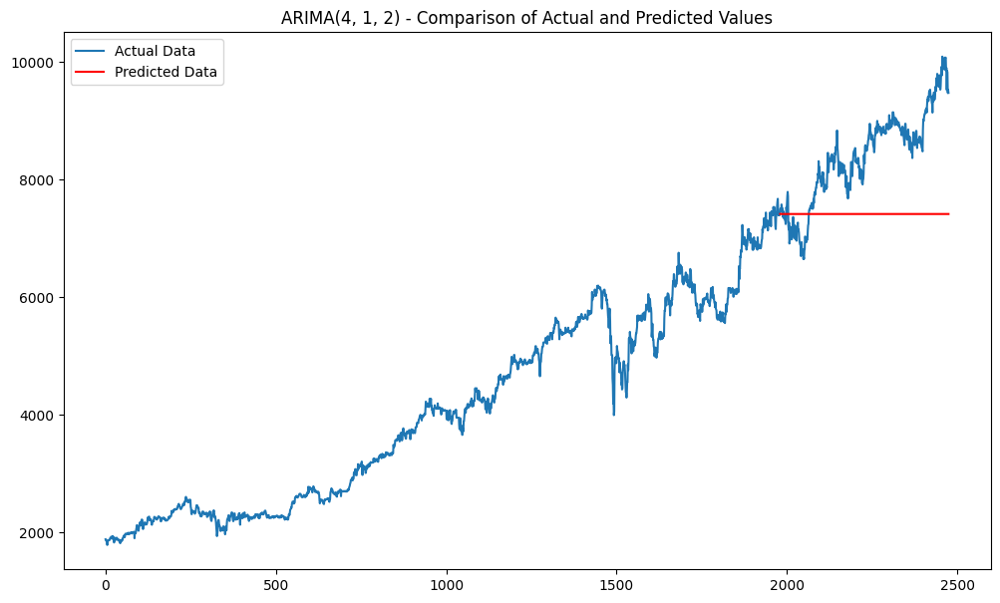

/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.10/di

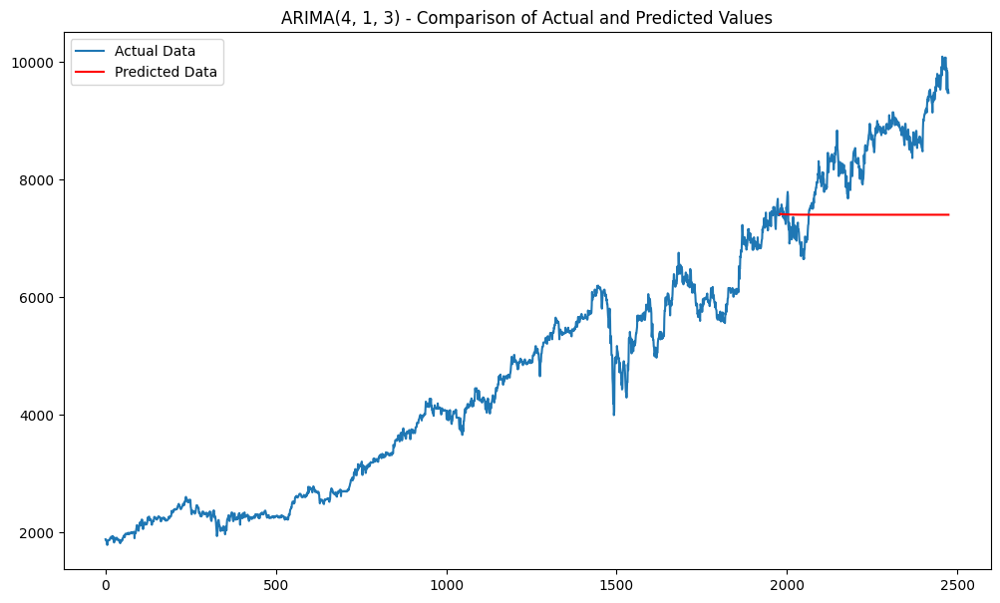

/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.
  self._init_dates(dates, freq)
/usr/local/lib/python3.10/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/usr/local/lib/python3.10/di

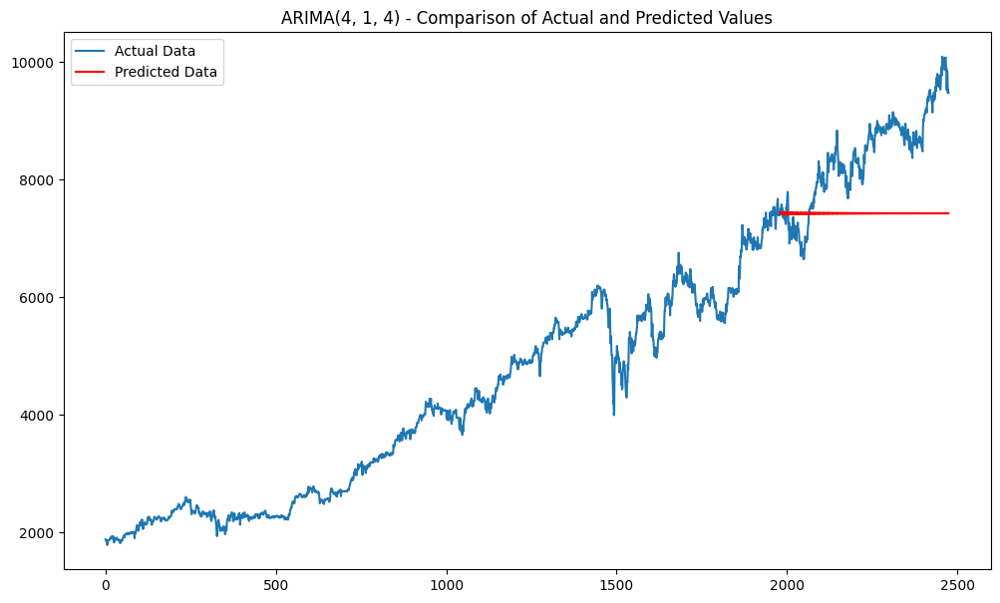

Loop completed.


In [ ]:
# Loop through pdq combinations, fit ARIMA model, forecast and plot results
for param in pdq:
    try:
        # Fit ARIMA model
        model_ARIMA_bbca = ARIMA(train_bbca_arima['Close'], order=param)
        results_ARIMA_bbca = model_ARIMA_bbca.fit()

        # Forecast the test set
        predictions_ARIMA_bbca = results_ARIMA_bbca.forecast(steps=len(test_bbca_arima))

        # Menghitung RMSE
        #rmse = np.sqrt(mean_squared_error(test_bbca_arima, predictions_ARIMA_bbca))
        #print(f"ARIMA{param} - RMSE: {rmse}")

        # Plot the results
        plt.figure(figsize=(12, 7))
        plt.plot(np.arange(total_length), bbca_hist['Close'].to_numpy(), label="Actual Data")
        plt.plot(np.arange(train_length, total_length), predictions_ARIMA_bbca, color='red', label="Predicted Data")
        plt.legend()
        plt.title(f"ARIMA{param} - Comparison of Actual and Predicted Values")
        plt.show()

    except Exception as e:
        print(f"ARIMA{param} - Error: {e}")

print("Loop completed.")

Dari percobaan menggunakan berbagai order p dan q, diperoleh hasil bahwa model ARIMA memprediksi seluruh data test dengan buruk dimana hasil prediksinya lurus dan tidak sesuai data asli. Maka dapat disimpulkan bahwa model ARIMA tidak cocok untuk memprediksi harga saham yang datanya volatile atau tidak stabil.

#### Long Short Term Memory (LSTM)

In [ ]:
# Mengambil kolom close
bbca_hist2 = bbca_hist['Close']

In [ ]:
# Train-Test Split
train_size = int(len(bbca_hist2) * 0.80)
test_size = len(bbca_hist2) - train_size
train_data_bbca_lstm, test_data_bbca_lstm = bbca_hist2[:train_size], bbca_hist2[train_size:]

# Scalling data
scaler = MinMaxScaler()
bbca_hist2 = scaler.fit_transform(np.array(bbca_hist2).reshape(-1,1))
train_data_bbca_lstm = scaler.fit_transform(np.array(train_data_bbca_lstm).reshape(-1, 1))
test_data_bbca_lstm = scaler.transform(np.array(test_data_bbca_lstm).reshape(-1, 1))

In [ ]:
def create_dataset(dataset, time_step = 1):
    dataX,dataY = [],[]
    for i in range(len(dataset)-time_step-1):
                   a = dataset[i:(i+time_step),0]
                   dataX.append(a)
                   dataY.append(dataset[i + time_step,0])
    return np.array(dataX),np.array(dataY)

In [ ]:
# Memanggil fungsi create_dataset untuk membagi data menjadi dataset input dan output dataset dengan times step 100
time_step = 100
X_train_bbca_lstm,Y_train_bbca_lstm =  create_dataset(train_data_bbca_lstm,time_step)
X_test_bbca_lstm,Y_test_bbca_lstm =  create_dataset(test_data_bbca_lstm,time_step)

In [ ]:
Y_train_bbca_lstm

array([0.05961774, 0.06537174, 0.06105634, ..., 0.95233376, 0.95630596,
       0.95233376])

In [ ]:
# Memeriksa value
print(X_train_bbca_lstm.shape)
print(X_train_bbca_lstm)
print(X_test_bbca_lstm.shape)
print(Y_test_bbca_lstm.shape)

(1879, 100)
[[0.01642952 0.01285785 0.01285785 ... 0.04091778 0.04954859 0.05817936]
 [0.01285785 0.01285785 0.01142917 ... 0.04954859 0.05817936 0.05961774]
 [0.01285785 0.01142917 0.01142917 ... 0.05817936 0.05961774 0.06537174]
 ...
 [0.88875222 0.87687552 0.8649989  ... 1.         0.96822245 0.95233376]
 [0.87687552 0.8649989  0.88083453 ... 0.96822245 0.95233376 0.95233376]
 [0.8649989  0.88083453 0.86895783 ... 0.95233376 0.95233376 0.95630596]]
(394, 100)
(394,)


In [ ]:
# Tetapkan seed untuk inisialisasi acak
seed_value = 42
tf.random.set_seed(seed_value)
np.random.seed(seed_value)

# Membangun model LSTM
model_bbca_lstm1 = tf.keras.Sequential([
      # Menambahkan layer LSTM pertama dengan 50 unit dan pengembalian urutan yang digunakan untuk menjaga urutan output
      # Input_shape adalah bentuk input, yaitu jumlah langkah waktu (X_train_bbca.shape[1]) dan fitur (1)
      tf.keras.layers.LSTM(50, return_sequences=True, input_shape=(X_train_bbca_lstm.shape[1], 1)),
      # Menambahkan layer LSTM kedua dengan 50 unit, tidak ada pengembalian urutan karena ini adalah lapisan terakhir LSTM
      tf.keras.layers.LSTM(50),
      # Menambahkan layer Dense dengan 1 unit sebagai output layer
      tf.keras.layers.Dense(1)
])
# Mengompilasi model dengan loss function 'mean_squared_error' dan optimizer 'adam'
model_bbca_lstm1.compile(loss='mean_squared_error', optimizer='adam')

In [ ]:
# Melihat rangkuman model
model_bbca_lstm1.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_3 (LSTM)               (None, 100, 50)           10400     
                                                                 
 lstm_4 (LSTM)               (None, 50)                20200     
                                                                 
 dense_1 (Dense)             (None, 1)                 51        
                                                                 
Total params: 30651 (119.73 KB)
Trainable params: 30651 (119.73 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________


In [ ]:
# Menetapkan seed untuk TensorFlow untuk memastikan hasil yang konsisten dari operasi stokastik (jika ada)
tf.random.set_seed(seed_value)

# Melatih model menggunakan data pelatihan (X_train_bbca dan Y_train_bbca) dengan data validasi (X_test_bbca dan Y_test_bbca)
# Epochs adalah jumlah kali seluruh dataset akan diberikan kepada model selama proses pelatihan
# Batch_size adalah jumlah sampel data yang akan diproses sebelum pembaharuan bobot model
# verbose = 1 menghasilkan output detail pada setiap epoch selama pelatihan
model_bbca_lstm1.fit(X_train_bbca_lstm, Y_train_bbca_lstm, validation_data=(X_test_bbca_lstm, Y_test_bbca_lstm), epochs=50, batch_size=64, verbose=1)

Epoch 1/50
30/30 [==============================] - 9s 192ms/step - loss: 0.0425 - val_loss: 0.0018
Epoch 2/50
30/30 [==============================] - 3s 106ms/step - loss: 0.0018 - val_loss: 0.0019
Epoch 3/50
30/30 [==============================] - 3s 105ms/step - loss: 6.5818e-04 - val_loss: 0.0016
Epoch 4/50
30/30 [==============================] - 3s 106ms/step - loss: 6.1755e-04 - val_loss: 0.0011
Epoch 5/50
30/30 [==============================] - 5s 169ms/step - loss: 6.2177e-04 - val_loss: 0.0022
Epoch 6/50
30/30 [==============================] - 3s 103ms/step - loss: 6.1947e-04 - val_loss: 0.0020
Epoch 7/50
30/30 [==============================] - 3s 104ms/step - loss: 5.9492e-04 - val_loss: 0.0019
Epoch 8/50
30/30 [==============================] - 3s 104ms/step - loss: 5.7504e-04 - val_loss: 0.0027
Epoch 9/50
30/30 [==============================] - 5s 165ms/step - loss: 5.6729e-04 - val_loss: 0.0020
Epoch 10/50
30/30 [==============================] - 3s 103ms/step - los

In [ ]:
# Memprediksi data menggunakan model yang telah dilatih
train_predict_bbca_lstm = model_bbca_lstm1.predict(X_train_bbca_lstm)
test_predict_bbca_lstm = model_bbca_lstm1.predict(X_test_bbca_lstm)

13/13 [==============================] - 1s 40ms/step


In [ ]:
Y_train_bbca_lstm[:5]

array([0.05961774, 0.06537174, 0.06105634, 0.05602168, 0.06752942])

In [ ]:
train_predict_bbca_lstm[:5]

array([[0.04898716],
       [0.05061523],
       [0.05294876],
       [0.05515946],
       [0.0566898 ]], dtype=float32)

In [ ]:
# Transformasi data ke bentuk awal
Y_train_bbca_lstm = scaler.inverse_transform(Y_train_bbca_lstm.reshape(-1, 1))
Y_test_bbca_lstm = scaler.inverse_transform(Y_test_bbca_lstm.reshape(-1, 1))
train_predict_bbca_lstm = scaler.inverse_transform(train_predict_bbca_lstm)
test_predict_bbca_lstm = scaler.inverse_transform(test_predict_bbca_lstm)

In [ ]:
Y_test_bbca_lstm[:5]

array([[7742.99121094],
       [7766.74267578],
       [7790.49511719],
       [7742.99121094],
       [7814.24658203]])

In [ ]:
test_predict_bbca_lstm[:5]

array([[7586.8354],
       [7625.433 ],
       [7674.038 ],
       [7724.717 ],
       [7759.4175]], dtype=float32)

In [ ]:
# Mendefinisikan jumlah langkah waktu sebelumnya yang akan digunakan sebagai input untuk memprediksi langkah waktu saat ini
look_back = 100

# Membuat array kosong dengan ukuran yang sama dengan bbca_hist2
trainPredictPlot_bbca = np.empty_like(bbca_hist2)
# Mengisi array dengan nilai yang sama dengan NaN (untuk plot)
trainPredictPlot_bbca[:,:] = np.nan
# Mengisi bagian dari array dengan hasil prediksi pada data pelatihan
# Menempatkan hasil prediksi pada posisi yang sesuai dalam array untuk plotting
trainPredictPlot_bbca[look_back : len(train_predict_bbca_lstm)+look_back,:] = train_predict_bbca_lstm

# Membuat array kosong dengan ukuran yang sama dengan bbca_hist2
testPredictPlot_bbca_lstm = np.empty_like(bbca_hist2)
# Mengisi array dengan nilai yang sama dengan NaN (untuk plot)
testPredictPlot_bbca_lstm[:,:] = np.nan
# Mengisi bagian dari array dengan hasil prediksi pada data uji
# Menempatkan hasil prediksi pada posisi yang sesuai dalam array untuk plotting
testPredictPlot_bbca_lstm[len(train_predict_bbca_lstm) + (look_back) * 2 + 1 : len(bbca_hist2) - 1, :] = test_predict_bbca_lstm

In [ ]:
# Mengambil data harga saham close dan dijadikan dalam bentuk array numpy
bbca_hist3=bbca_hist['Close'].to_numpy()

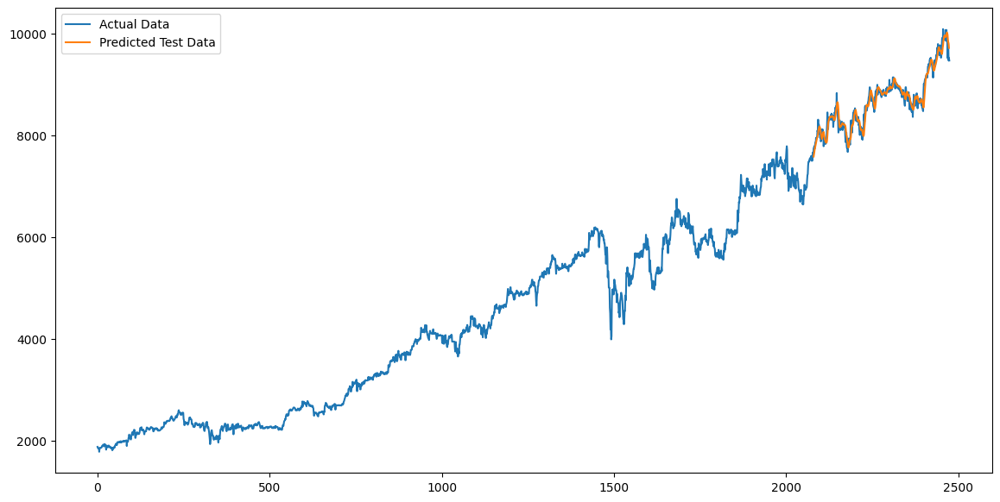

In [ ]:
# Membuat gambar (figure) dengan ukuran 14x7
plt.figure(figsize=(14, 7))
# Membuat plot garis untuk data aktual dengan label 'Actual Data'
plt.plot(bbca_hist3, label='Actual Data')
# Membuat plot garis untuk data prediksi pada dengan label 'Predicted Test Data'
plt.plot(testPredictPlot_bbca_lstm, label='Predicted Test Data')
# Menambahkan legenda ke plot berdasarkan label-label yang telah ditentukan sebelumnya
plt.legend()
# Menampilkan plot
plt.show()

In [ ]:
# Fungsi menghitung MAPE
def mean_absolute_percentage_error(y_true, y_pred):
    y_true, y_pred = np.array(y_true), np.array(y_pred)
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100

In [ ]:
# Melihat Metric Evaluation RMSE dan MAPE
mape_lstm1_bbca = mean_absolute_percentage_error(Y_test_bbca_lstm,test_predict_bbca_lstm)
print("RMSE of LSTM:", np.sqrt(mean_squared_error(Y_test_bbca_lstm,test_predict_bbca_lstm)))
print("MAPE of LSTM:", mape_lstm1_bbca)

RMSE of LSTM: 127.90481256008732
MAPE of LSTM: 1.1387179781982288


#### Gated Recurrent Unit (GRU)

In [ ]:
# Mengambil kolom close
bbca_hist2 = bbca_hist['Close']

In [ ]:
# Train-Test Split
train_size = int(len(bbca_hist2) * 0.80)
test_size = len(bbca_hist2) - train_size
train_data_bbca_gru, test_data_bbca_gru = bbca_hist2[:train_size], bbca_hist2[train_size:]

# Scalling data
scaler = MinMaxScaler()
bbca_hist2 = scaler.fit_transform(np.array(bbca_hist2).reshape(-1,1))
train_data_bbca_gru = scaler.fit_transform(np.array(train_data_bbca_gru).reshape(-1, 1))
test_data_bbca_gru = scaler.transform(np.array(test_data_bbca_gru).reshape(-1, 1))

In [ ]:
def create_dataset(dataset, time_step = 1):
    dataX,dataY = [],[]
    for i in range(len(dataset)-time_step-1):
                   a = dataset[i:(i+time_step),0]
                   dataX.append(a)
                   dataY.append(dataset[i + time_step,0])
    return np.array(dataX),np.array(dataY)

In [ ]:
# Memanggil fungsi create_dataset untuk membagi data menjadi dataset input dan output dataset dengan times step 100
time_step = 100
X_train_bbca_gru,Y_train_bbca_gru =  create_dataset(train_data_bbca_gru,time_step)
X_test_bbca_gru,Y_test_bbca_gru =  create_dataset(test_data_bbca_gru,time_step)

In [ ]:
Y_train_bbca_gru

array([0.05961774, 0.06537174, 0.06105634, ..., 0.95233376, 0.95630596,
       0.95233376])

In [ ]:
# Memeriksa value
print(X_train_bbca_gru.shape)
print(X_train_bbca_gru)
print(X_test_bbca_gru.shape)
print(Y_test_bbca_gru.shape)

(1879, 100)
[[0.01642952 0.01285785 0.01285785 ... 0.04091778 0.04954859 0.05817936]
 [0.01285785 0.01285785 0.01142917 ... 0.04954859 0.05817936 0.05961774]
 [0.01285785 0.01142917 0.01142917 ... 0.05817936 0.05961774 0.06537174]
 ...
 [0.88875222 0.87687552 0.8649989  ... 1.         0.96822245 0.95233376]
 [0.87687552 0.8649989  0.88083453 ... 0.96822245 0.95233376 0.95233376]
 [0.8649989  0.88083453 0.86895783 ... 0.95233376 0.95233376 0.95630596]]
(394, 100)
(394,)


In [ ]:
# Tetapkan seed untuk inisialisasi acak
seed_value = 42
tf.random.set_seed(seed_value)
np.random.seed(seed_value)

# Membangun model GRU
model_bbca_gru1 = tf.keras.Sequential([
      # Menambahkan layer GRU pertama dengan 50 unit dan pengembalian urutan yang digunakan untuk menjaga urutan output
      # Input_shape adalah bentuk input, yaitu jumlah langkah waktu (X_train_bbca.shape[1]) dan fitur (1)
      tf.keras.layers.GRU(50, return_sequences=True, input_shape=(X_train_bbca_gru.shape[1], 1)),
      # Menambahkan layer GRU kedua dengan 50 unit, tidak ada pengembalian urutan karena ini adalah lapisan terakhir LSTM
      tf.keras.layers.GRU(50),
      # Menambahkan layer Dense dengan 1 unit sebagai output layer
      tf.keras.layers.Dense(1)
])
# Mengompilasi model dengan loss function 'mean_squared_error' dan optimizer 'adam'
model_bbca_gru1.compile(loss='mean_squared_error', optimizer='adam')

In [ ]:
# Melihat rangkuman model
model_bbca_gru1.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 gru_2 (GRU)                 (None, 100, 50)           7950      
                                                                 
 gru_3 (GRU)                 (None, 50)                15300     
                                                                 
 dense_1 (Dense)             (None, 1)                 51        
                                                                 
Total params: 23301 (91.02 KB)
Trainable params: 23301 (91.02 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________


In [ ]:
# Menetapkan seed untuk TensorFlow untuk memastikan hasil yang konsisten dari operasi stokastik (jika ada)
tf.random.set_seed(seed_value)

# Melatih model menggunakan data pelatihan (X_train_bbca dan Y_train_bbca) dengan data validasi (X_test_bbca dan Y_test_bbca)
# Epochs adalah jumlah kali seluruh dataset akan diberikan kepada model selama proses pelatihan
# Batch_size adalah jumlah sampel data yang akan diproses sebelum pembaharuan bobot model
# verbose = 1 menghasilkan output detail pada setiap epoch selama pelatihan
model_bbca_gru1.fit(X_train_bbca_gru, Y_train_bbca_gru, validation_data=(X_test_bbca_gru, Y_test_bbca_gru), epochs=50, batch_size=64, verbose=1)

Epoch 1/50
30/30 [==============================] - 5s 146ms/step - loss: 0.0353 - val_loss: 0.0492
Epoch 2/50
30/30 [==============================] - 5s 140ms/step - loss: 0.0015 - val_loss: 5.1073e-04
Epoch 3/50
30/30 [==============================] - 3s 96ms/step - loss: 3.4203e-04 - val_loss: 4.8845e-04
Epoch 4/50
30/30 [==============================] - 3s 93ms/step - loss: 2.6819e-04 - val_loss: 5.0367e-04
Epoch 5/50
30/30 [==============================] - 3s 94ms/step - loss: 2.5272e-04 - val_loss: 7.6507e-04
Epoch 6/50
30/30 [==============================] - 5s 155ms/step - loss: 2.4974e-04 - val_loss: 4.3734e-04
Epoch 7/50
30/30 [==============================] - 3s 95ms/step - loss: 2.4636e-04 - val_loss: 4.7226e-04
Epoch 8/50
30/30 [==============================] - 3s 94ms/step - loss: 2.3018e-04 - val_loss: 5.9046e-04
Epoch 9/50
30/30 [==============================] - 3s 94ms/step - loss: 2.2510e-04 - val_loss: 5.6545e-04
Epoch 10/50
30/30 [===========================

In [ ]:
# Memprediksi data menggunakan model yang telah dilatih
train_predict_bbca_gru = model_bbca_gru1.predict(X_train_bbca_gru)
test_predict_bbca_gru = model_bbca_gru1.predict(X_test_bbca_gru)

13/13 [==============================] - 0s 23ms/step


In [ ]:
Y_train_bbca_gru[:5]

array([0.05961774, 0.06537174, 0.06105634, 0.05602168, 0.06752942])

In [ ]:
train_predict_bbca_gru[:5]

array([[0.052982  ],
       [0.05755579],
       [0.06244846],
       [0.06331816],
       [0.06094544]], dtype=float32)

In [ ]:
# Transformasi data ke bentuk awal
Y_train_bbca_gru = scaler.inverse_transform(Y_train_bbca_gru.reshape(-1, 1))
Y_test_bbca_gru = scaler.inverse_transform(Y_test_bbca_gru.reshape(-1, 1))
train_predict_bbca_gru = scaler.inverse_transform(train_predict_bbca_gru)
test_predict_bbca_gru = scaler.inverse_transform(test_predict_bbca_gru)

In [ ]:
Y_test_bbca_gru[:5]

array([[7742.99121094],
       [7766.74267578],
       [7790.49511719],
       [7742.99121094],
       [7814.24658203]])

In [ ]:
test_predict_bbca_gru[:5]

array([[7621.9194],
       [7708.071 ],
       [7758.214 ],
       [7785.6973],
       [7757.4043]], dtype=float32)

In [ ]:
# Mendefinisikan jumlah langkah waktu sebelumnya yang akan digunakan sebagai input untuk memprediksi langkah waktu saat ini
look_back = 100

# Membuat array kosong dengan ukuran yang sama dengan bbca_hist2
trainPredictPlot_bbca = np.empty_like(bbca_hist2)
# Mengisi array dengan nilai yang sama dengan NaN (untuk plot)
trainPredictPlot_bbca[:,:] = np.nan
# Mengisi bagian dari array dengan hasil prediksi pada data pelatihan
# Menempatkan hasil prediksi pada posisi yang sesuai dalam array untuk plotting
trainPredictPlot_bbca[look_back : len(train_predict_bbca_gru)+look_back,:] = train_predict_bbca_gru

# Membuat array kosong dengan ukuran yang sama dengan bbca_hist2
testPredictPlot_bbca_gru= np.empty_like(bbca_hist2)
# Mengisi array dengan nilai yang sama dengan NaN (untuk plot)
testPredictPlot_bbca_gru[:,:] = np.nan
# Mengisi bagian dari array dengan hasil prediksi pada data uji
# Menempatkan hasil prediksi pada posisi yang sesuai dalam array untuk plotting
testPredictPlot_bbca_gru[len(train_predict_bbca_gru) + (look_back) * 2 + 1 : len(bbca_hist2) - 1, :] = test_predict_bbca_gru

In [ ]:
# Mengambil data harga saham close dan dijadikan dalam bentuk array numpy
bbca_hist3=bbca_hist['Close'].to_numpy()

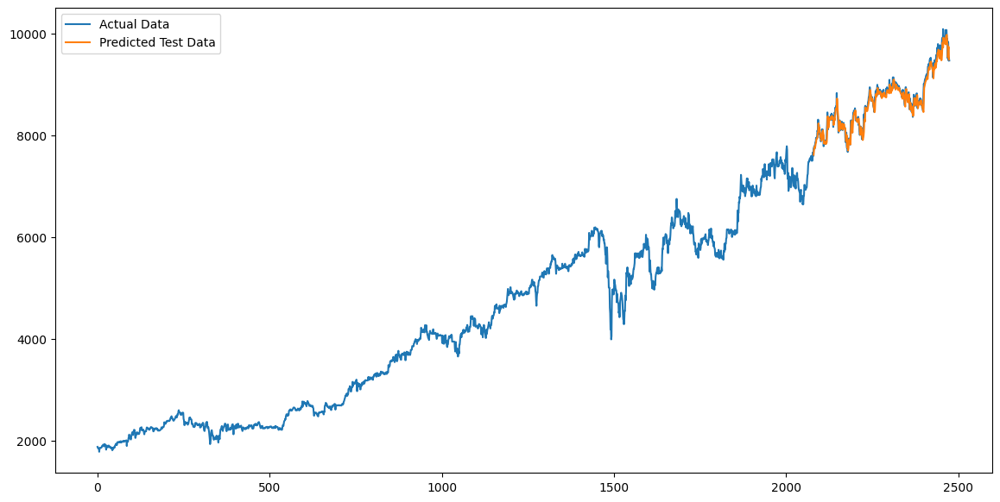

In [ ]:
# Membuat gambar (figure) dengan ukuran 14x7
plt.figure(figsize=(14, 7))
# Membuat plot garis untuk data aktual dengan label 'Actual Data'
plt.plot(bbca_hist3, label='Actual Data')
# Membuat plot garis untuk data prediksi pada dengan label 'Predicted Test Data'
plt.plot(testPredictPlot_bbca_gru, label='Predicted Test Data')
# Menambahkan legenda ke plot berdasarkan label-label yang telah ditentukan sebelumnya
plt.legend()
# Menampilkan plot
plt.show()

In [ ]:
# Fungsi menghitung MAPE
def mean_absolute_percentage_error(y_true, y_pred):
    y_true, y_pred = np.array(y_true), np.array(y_pred)
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100

In [ ]:
# Melihat Metric Evaluation RMSE dan MAPE
mape_gru1_bbca = mean_absolute_percentage_error(Y_test_bbca_gru,test_predict_bbca_gru)
print("RMSE of GRU:", np.sqrt(mean_squared_error(Y_test_bbca_gru,test_predict_bbca_gru)))
print("MAPE of GRU:", mape_gru1_bbca)

RMSE of GRU: 109.53143484889104
MAPE of GRU: 0.9449552383559471


### Bank Rakyat Indonesia (BBRI)

#### ARIMA

##### Baseline Model

In [ ]:
# Calculate lengths for train
total_length = len(bbri_hist)
train_length = int(0.8 * total_length)

# Split the Data to Train and Test
train_bbri_arima = list(bbri_hist[0:train_length]['Close'])
test_bbri_arima = list(bbri_hist[train_length:]['Close'])

# Auto ARIMA to select optimal ARIMA parameters
model_bbri_arima = auto_arima(train_bbri_arima, seasonal=False, trace=True)
print(model_bbri_arima.summary())

Performing stepwise search to minimize aic
 ARIMA(2,1,2)(0,0,0)[0] intercept   : AIC=20847.910, Time=4.24 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=20879.181, Time=0.09 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=20880.262, Time=0.10 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=20880.064, Time=0.29 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=20879.199, Time=0.06 sec
 ARIMA(1,1,2)(0,0,0)[0] intercept   : AIC=20853.406, Time=4.18 sec
 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=20852.343, Time=4.76 sec
 ARIMA(3,1,2)(0,0,0)[0] intercept   : AIC=20849.931, Time=9.47 sec
 ARIMA(2,1,3)(0,0,0)[0] intercept   : AIC=20849.905, Time=12.45 sec
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=20862.384, Time=4.11 sec
 ARIMA(1,1,3)(0,0,0)[0] intercept   : AIC=20854.333, Time=6.66 sec
 ARIMA(3,1,1)(0,0,0)[0] intercept   : AIC=20852.725, Time=6.18 sec
 ARIMA(3,1,3)(0,0,0)[0] intercept   : AIC=20851.412, Time=6.87 sec
 ARIMA(2,1,2)(0,0,0)[0]             : AIC=20847.981, Time=1.22 sec

Best model:  ARIM

Dari fungsi auto_arima, diperoleh model terbaik yang meminimalkan AIC adalah ARIMA(2,1,2). Oleh karena itu, akan dilakukan permodelan dan prediksi menggunakan ARIMA(2,1,2)

In [ ]:
# Menghitung jumlah observasi dalam data pengujian dan menyimpannya dalam variabel n_test_obser
n_test_obser_arima = len(test_bbri_arima)

In [ ]:
# Inisialisasi daftar kosong untuk menyimpan prediksi model
model_predictions_bbri_arima = []

# Memulai perulangan untuk setiap observasi pengujian
for i in range(n_test_obser_arima):
    # Membuat model ARIMA dengan data pelatihan dan order (2, 1, 2)
    model_bbri_arima = ARIMA(train_bbri_arima, order=(2, 1, 2))
    # Melakukan fit pada model ARIMA yang telah dibuat
    model_fit_bbri_arima = model_bbri_arima.fit()
    # Melakukan peramalan menggunakan model yang telah difit
    output_arima = model_fit_bbri_arima.forecast()
    # Mengambil nilai prediksi dari hasil peramalan (output adalah array numpy)
    yhat_arima = output_arima[0]
    # Menambahkan nilai prediksi ke dalam daftar prediksi model
    model_predictions_bbri_arima.append(yhat_arima)
    # Memperbarui data pelatihan dengan menambahkan nilai prediksi pada akhir data pelatihan
    train_bbri_arima.append(yhat_arima)

Setelah dilakukan permodelan dan prediksi menggunakan ARIMA(2,1,2), akan dilihat plot perbandingan data asli dengan data hasil prediksinya.

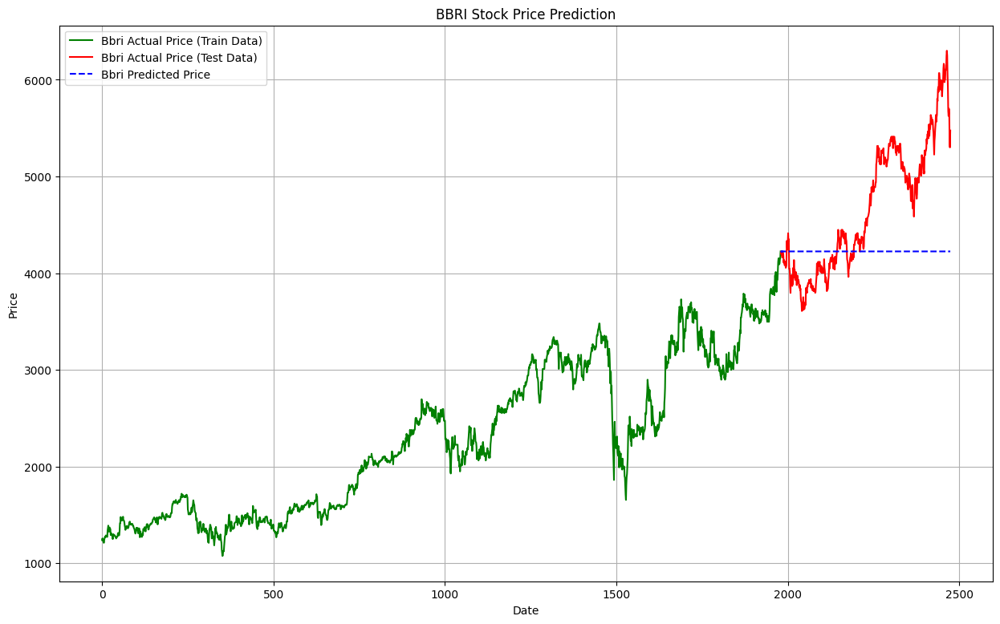

In [ ]:
# Menggabungkan data pelatihan dan pengujian untuk sumbu x (tanggal)
date_range_all = bbri_hist.index
# Membuat figure baru dengan ukuran 15x9
plt.figure(figsize=(15, 9))
# Menambahkan grid ke plot
plt.grid(True)
# Membuat plot garis untuk data pelatihan Bbri dengan warna hijau
plt.plot(date_range_all[:train_length], train_bbri_arima[:train_length], color='green', label='Bbri Actual Price (Train Data)')
# Membuat plot garis untuk data pengujian Bbri dengan warna merah
plt.plot(date_range_all[train_length:], test_bbri_arima, color='red', label='Bbri Actual Price (Test Data)')
# Membuat plot garis untuk prediksi harga Bbri dengan warna biru dan garis putus-putus
plt.plot(date_range_all[train_length:], model_predictions_bbri_arima, color='blue', ls='dashed', label='Bbri Predicted Price')
# Menambahkan judul pada plot
plt.title('BBRI Stock Price Prediction')
# Menambahkan label untuk sumbu x
plt.xlabel('Date')
# Menambahkan label untuk sumbu y
plt.ylabel('Price')
# Menambahkan legenda pada plot
plt.legend()
# Menampilkan plot
plt.show()

Dari hasil plot di atas, diperoleh bahwa model ARIMA(2,1,2) tidak cukup baik dalam memprediksi data test. Kemudian akan dilihat metrik evaluasinya.

In [ ]:
# Metric Evaluation RMSE & MAPE
def mean_absolute_percentage_error(y_true, y_pred):
    y_true, y_pred = np.array(y_true), np.array(y_pred)
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100

# Menghitung RMSE
rmse_bbri_arima1 = np.sqrt(mean_squared_error(test_bbri_arima, model_predictions_bbri_arima))
print('BBRI ARIMA Test RMSE: %.3f' % rmse_bbri_arima1)
# Menghitung MAPE
mape_bbri_arima1 = mean_absolute_percentage_error(test_bbri_arima, model_predictions_bbri_arima)
print('BBRI ARIMA Test MAPE: '+str(mape_bbri_arima1))

BBRI ARIMA Test RMSE: 796.859
BBRI ARIMA Test MAPE: 12.209126725948664


Diperoleh bahwa RMSE dari model ARIMA(2,1,2) sebesar 796.859 yang mana cukup besar sehingga dapat disimpulkan model ini tidak cukup baik untuk memprediksi harga saham close BBRI.

##### Hyperparameter Tuning & Optimization

Langkah awal yang akan diambil adalah melakukan uji stasioneritas terhadap data saham BBRI karena model ARIMA memerlukan data yang stasioneritas

In [ ]:
# Melakukan uji Augmented Dickey-Fuller pada data harga penutupan saham BBRI
adf_test_bbri = adfuller(bbri_hist.Close)

# Ho: Data tidak stasioner (memiliki unit root)
# H1: Data stasioner (tidak memiliki unit root)

# Mendefinisikan fungsi untuk melakukan uji Augmented Dickey-Fuller dan menampilkan hasilnya
def adfuller_test(close):
    # Melakukan uji Augmented Dickey-Fuller pada data yang diberikan
    result = adfuller(close)
    # Mendefinisikan label untuk hasil uji
    labels = ['ADF Test Statistic', 'p-value', '#Lags Used', 'Number of Observations Used']
    # Menampilkan hasil uji dengan label yang sesuai
    for value, label in zip(result, labels):
        print(label + ' : ' + str(value))
    # Menilai hasil uji berdasarkan nilai p-value
    if result[1] <= 0.05:
        # Jika p-value kurang dari atau sama dengan 0.05, menolak hipotesis nol (Ho)
        print("strong evidence against the null hypothesis(Ho), reject the null hypothesis. Data has no unit root and is stationary")
    else:
        # Jika p-value lebih besar dari 0.05, tidak dapat menolak hipotesis nol (Ho)
        print("weak evidence against null hypothesis, time series has a unit root, indicating it is non-stationary ")

In [ ]:
# Uji stasioneritas
adfuller_test(bbri_hist.Close)

ADF Test Statistic : -0.1531273517344739
p-value : 0.9438829461775858
#Lags Used : 4
Number of Observations Used : 2470
weak evidence against null hypothesis, time series has a unit root, indicating it is non-stationary 


Dari uji ADF yang telah dilakukan, diperoleh hasil bahwa data harga saham close BBRI tidak stasioner. Oleh karena itu, akan dilakukan differencing terhadap data.

In [ ]:
# Melakukan differencing karena data tidak stasioner
diff_bbri = bbri_hist.Close.diff().dropna()

In [ ]:
# Uji stasioneritas setelah differencing
adfuller_test(diff_bbri)

ADF Test Statistic : -25.792282412134075
p-value : 0.0
#Lags Used : 3
Number of Observations Used : 2470
strong evidence against the null hypothesis(Ho), reject the null hypothesis. Data has no unit root and is stationary


Dari hasil uji stasioneritas terhadap data differencing pertama, diperoleh bahwa data sudah stasioner. Untuk lebih memastikan, akan dilihat jumlah differencing yang diperlukan untuk data saham close BBRI.

In [ ]:
# Menghitung jumlah differencing yang diperlukan untuk membuat data harga penutupan BBRI stasioner menggunakan uji ADF (Augmented Dickey-Fuller)
optimal_diffs = ndiffs(bbri_hist.Close, test='adf')
optimal_diffs

1

Diperoleh bahwa differencing optimal yang diperlukan adalah 1. Maka selanjutnya akan dilakukan permodelan ARIMA.

In [ ]:
# Calculate lengths for train
total_length = len(bbri_hist)
train_length = int(0.8 * total_length)

# Split the DataFrame
train_bbri_arima = bbri_hist[:train_length]
test_bbri_arima = bbri_hist[train_length:]

Akan dilakukan beberapa percobaan menggunakan orde p dan q dimana orde p dan q yang diambil mulai dari 0 sampai dengan 4.

In [ ]:
# Mendefinisikan rentang nilai untuk p, d, q dalam model ARIMA
p = range(0, 5)
d = range(1, 2)
q = range(0, 5)

# Menghasilkan semua kombinasi berbeda dari tripel p, d, dan q
pdq = list(itertools.product(p, d, q))

# Mengonversi data pengujian menjadi array numpy
test_data_arima = test_bbri_arima['Close'].to_numpy()

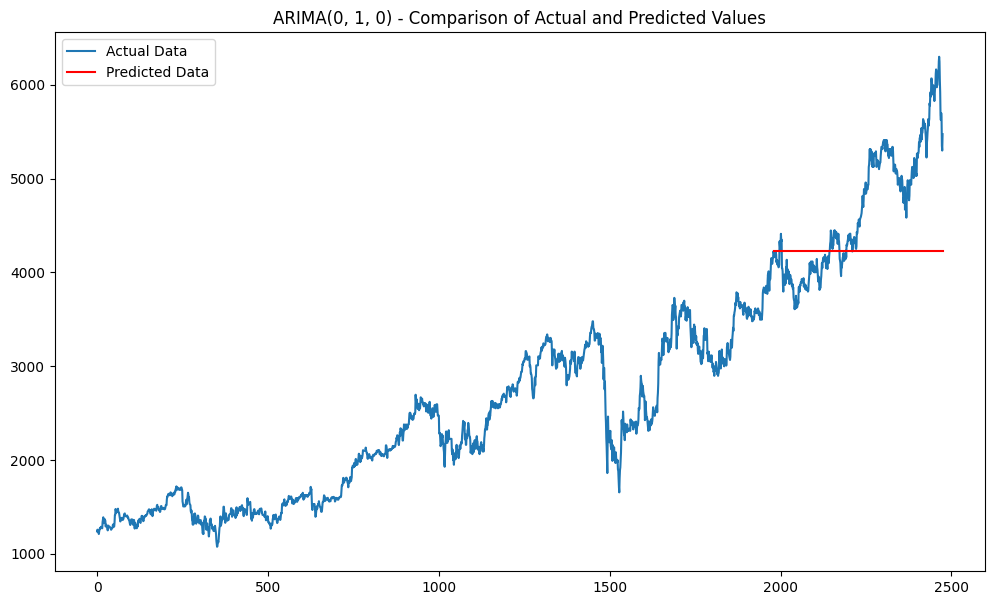

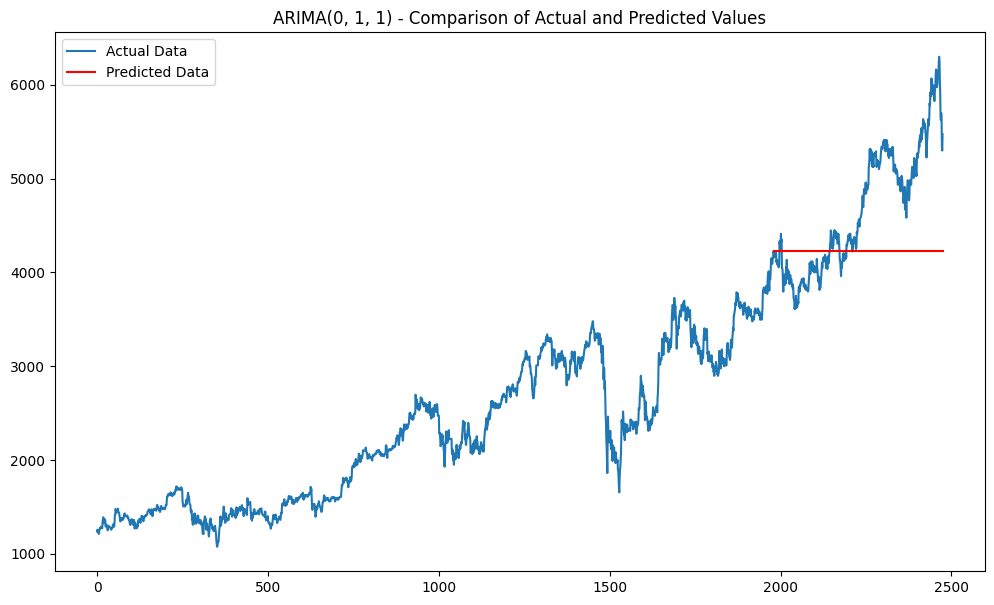

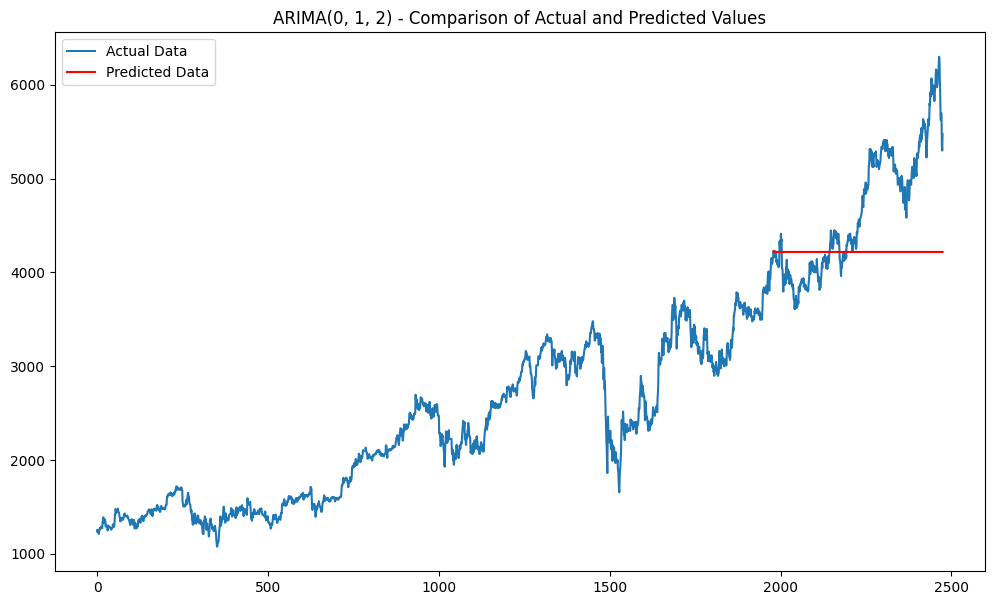

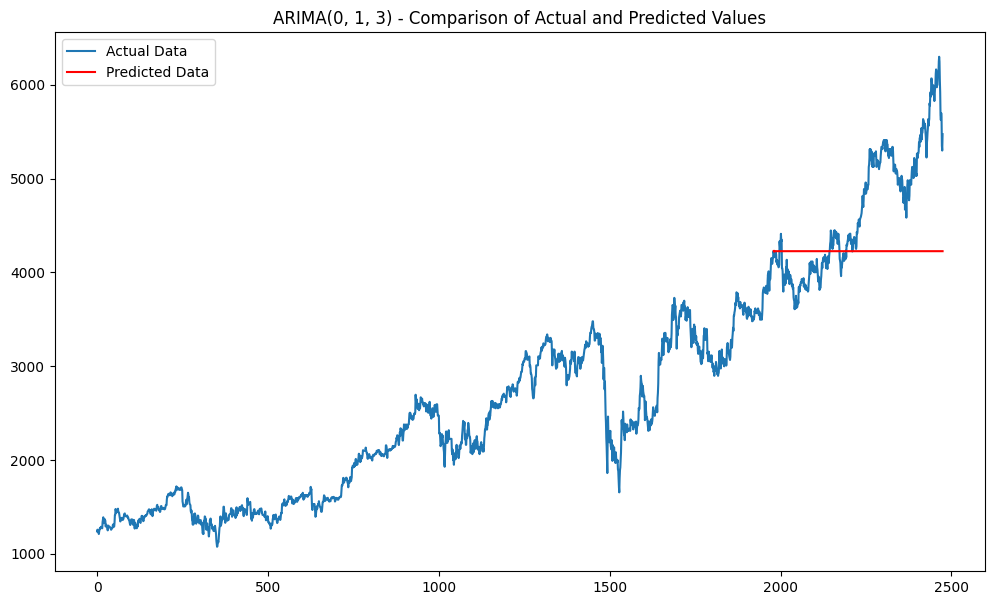

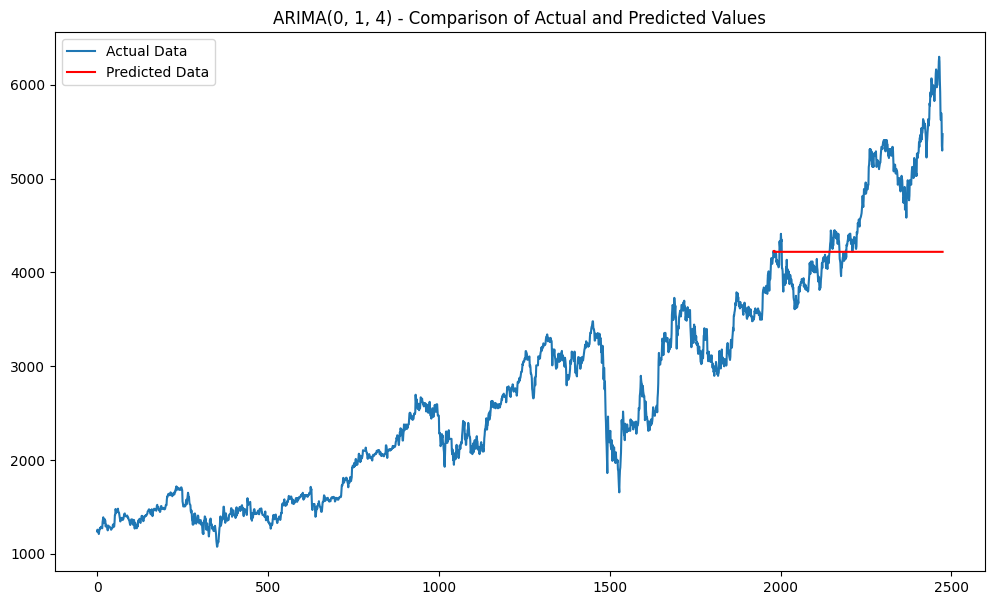

...

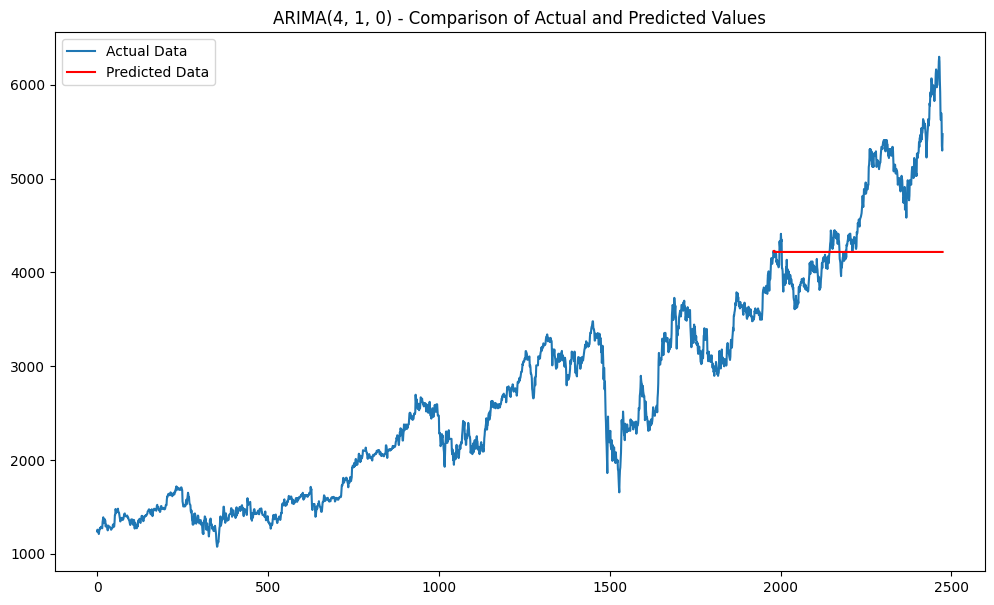

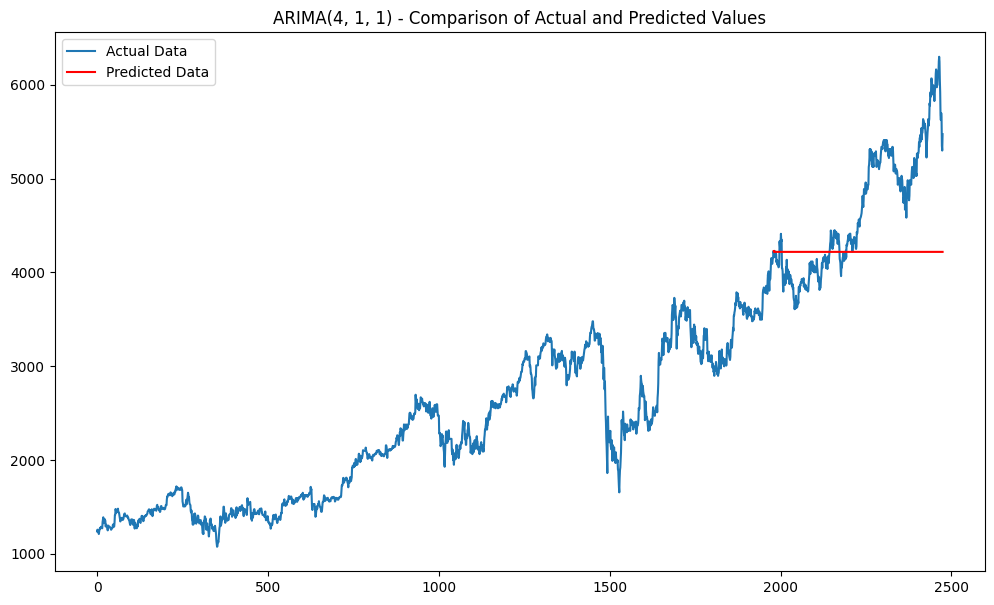

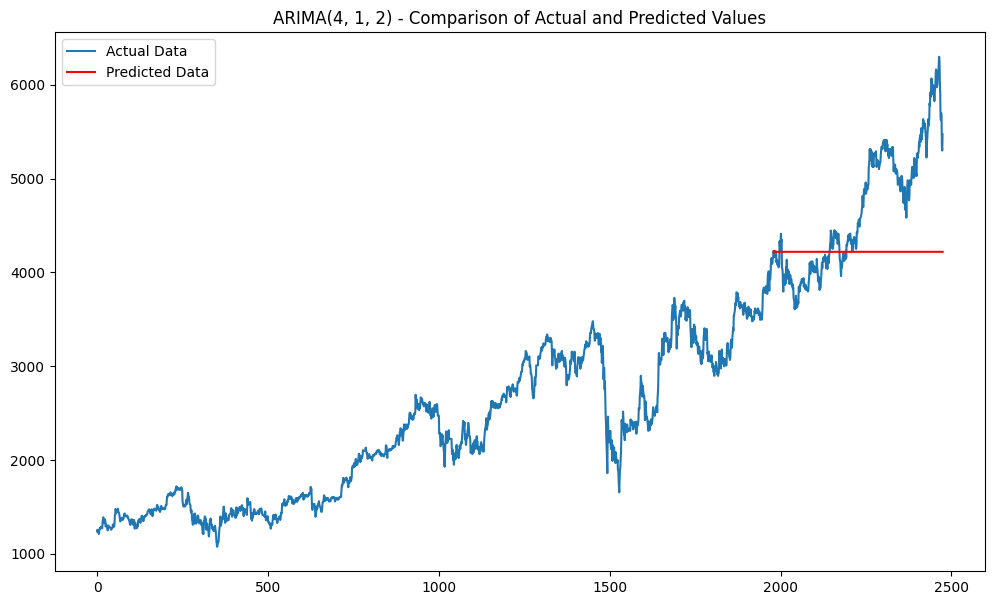

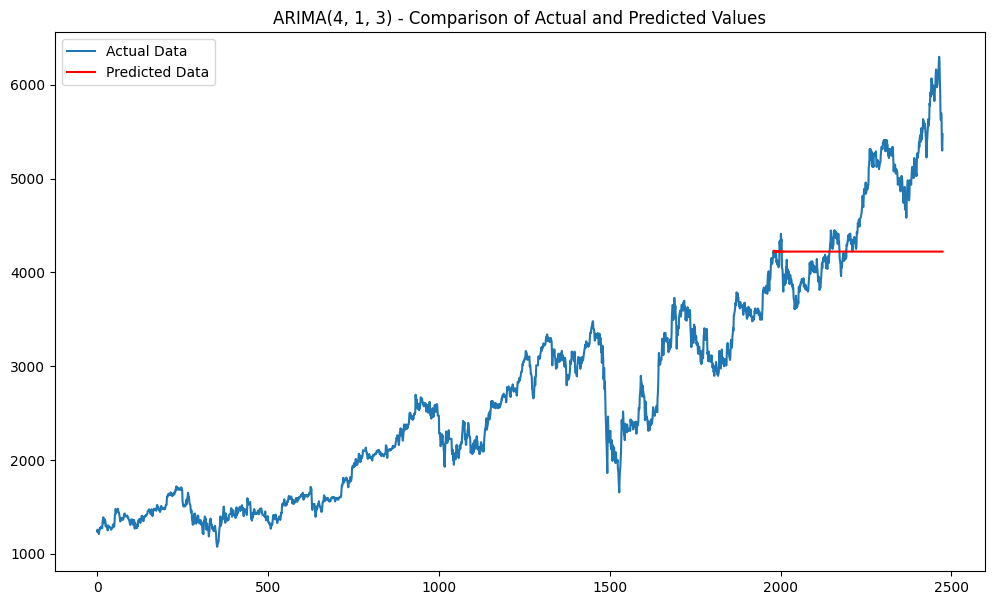

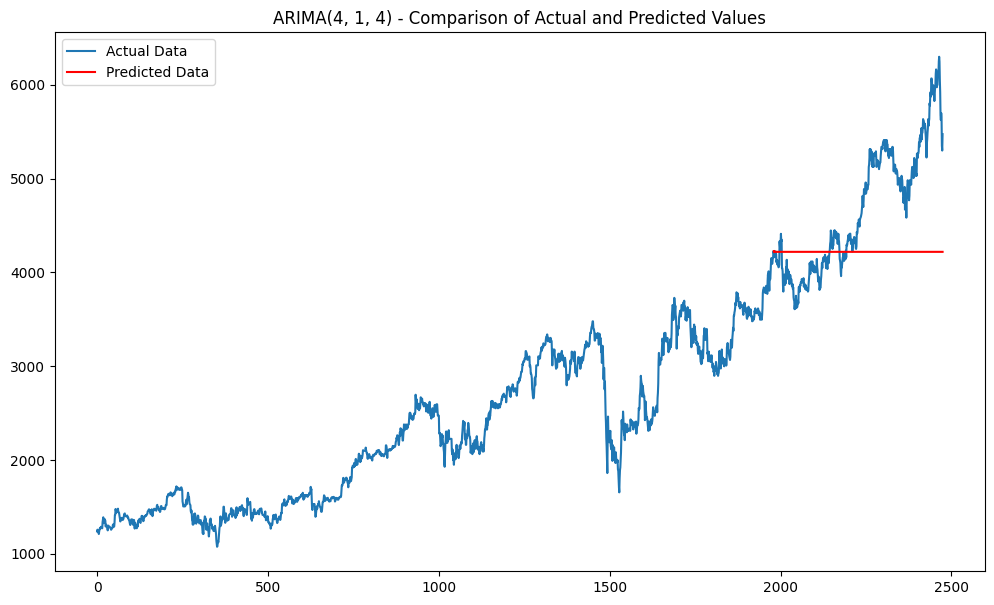

Loop completed.


In [ ]:
# Loop through pdq combinations, fit ARIMA model, forecast and plot results
for param in pdq:
    try:
        # Fit ARIMA model
        model_ARIMA_bbri = ARIMA(train_bbri_arima['Close'], order=param)
        results_ARIMA_bbri = model_ARIMA_bbri.fit()

        # Forecast the test set
        predictions_ARIMA_bbri = results_ARIMA_bbri.forecast(steps=len(test_bbri_arima))

        # Menghitung RMSE
        #rmse = np.sqrt(mean_squared_error(test_bbri_arima, predictions_ARIMA_bbri))
        #print(f"ARIMA{param} - RMSE: {rmse}")

        # Plot the results
        plt.figure(figsize=(12, 7))
        plt.plot(np.arange(total_length), bbri_hist['Close'].to_numpy(), label="Actual Data")
        plt.plot(np.arange(train_length, total_length), predictions_ARIMA_bbri, color='red', label="Predicted Data")
        plt.legend()
        plt.title(f"ARIMA{param} - Comparison of Actual and Predicted Values")
        plt.show()

    except Exception as e:
        print(f"ARIMA{param} - Error: {e}")

print("Loop completed.")

Dari percobaan menggunakan berbagai order p dan q, diperoleh hasil bahwa model ARIMA memprediksi seluruh data test dengan buruk dimana hasil prediksinya lurus dan tidak sesuai data asli. Maka dapat disimpulkan bahwa model ARIMA tidak cocok untuk memprediksi harga saham yang datanya volatile atau tidak stabil.

#### Long Short Term Memory

In [ ]:
# Mengambil kolom close
bbri_hist2 = bbri_hist['Close']

In [ ]:
# Train-Test Split
train_size = int(len(bbri_hist2) * 0.80)
test_size = len(bbri_hist2) - train_size
train_data_bbri_lstm, test_data_bbri_lstm = bbri_hist2[:train_size], bbri_hist2[train_size:]

# Scalling data
scaler = MinMaxScaler()
bbri_hist2 = scaler.fit_transform(np.array(bbri_hist2).reshape(-1,1))
train_data_bbri_lstm = scaler.fit_transform(np.array(train_data_bbri_lstm).reshape(-1, 1))
test_data_bbri_lstm = scaler.transform(np.array(test_data_bbri_lstm).reshape(-1, 1))

In [ ]:
def create_dataset(dataset, time_step = 1):
    dataX,dataY = [],[]
    for i in range(len(dataset)-time_step-1):
                   a = dataset[i:(i+time_step),0]
                   dataX.append(a)
                   dataY.append(dataset[i + time_step,0])
    return np.array(dataX),np.array(dataY)

In [ ]:
# Memanggil fungsi create_dataset untuk membagi data menjadi dataset input dan output dataset dengan times step 100
time_step = 100
X_train_bbri_lstm,Y_train_bbri_lstm =  create_dataset(train_data_bbri_lstm,time_step)
X_test_bbri_lstm,Y_test_bbri_lstm =  create_dataset(test_data_bbri_lstm,time_step)

In [ ]:
Y_train_bbri_lstm

array([0.09276678, 0.09276678, 0.08674113, ..., 0.96030638, 0.97448266,
       0.97731773])

In [ ]:
# Memeriksa value
print(X_train_bbri_lstm.shape)
print(X_train_bbri_lstm)
print(X_test_bbri_lstm.shape)
print(Y_test_bbri_lstm.shape)

(1879, 100)
[[0.05206461 0.05793246 0.05108668 ... 0.07368551 0.07669833 0.08071544]
 [0.05793246 0.05108668 0.05206461 ... 0.07669833 0.08071544 0.09276678]
 [0.05108668 0.05206461 0.05010862 ... 0.08071544 0.09276678 0.09276678]
 ...
 [0.84523331 0.82887035 0.81523442 ... 0.97731773 0.97731773 0.957471  ]
 [0.82887035 0.81523442 0.81796177 ... 0.97731773 0.957471   0.96030638]
 [0.81523442 0.81796177 0.81250747 ... 0.957471   0.96030638 0.97448266]]
(394, 100)
(394,)


In [ ]:
# Tetapkan seed untuk inisialisasi acak
seed_value = 42
tf.random.set_seed(seed_value)
np.random.seed(seed_value)

# Membangun model LSTM
model_bbri_lstm1 = tf.keras.Sequential([
      # Menambahkan layer LSTM pertama dengan 50 unit dan pengembalian urutan yang digunakan untuk menjaga urutan output
      # Input_shape adalah bentuk input, yaitu jumlah langkah waktu (X_train_bbca.shape[1]) dan fitur (1)
      tf.keras.layers.LSTM(50, return_sequences=True, input_shape=(X_train_bbri_lstm.shape[1], 1)),
      # Menambahkan layer LSTM ketiga dengan 50 unit, tidak ada pengembalian urutan karena ini adalah lapisan terakhir LSTM
      tf.keras.layers.LSTM(50),
      # Menambahkan layer Dense dengan 1 unit sebagai output layer
      tf.keras.layers.Dense(1)
])
# Mengompilasi model dengan loss function 'mean_squared_error' dan optimizer 'adam'
model_bbri_lstm1.compile(loss='mean_squared_error', optimizer='adam')

In [ ]:
# Melihat rangkuman model
model_bbri_lstm1.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 50)           10400     
                                                                 
 lstm_1 (LSTM)               (None, 50)                20200     
                                                                 
 dense (Dense)               (None, 1)                 51        
                                                                 
Total params: 30651 (119.73 KB)
Trainable params: 30651 (119.73 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________


In [ ]:
# Menetapkan seed untuk TensorFlow untuk memastikan hasil yang konsisten dari operasi stokastik (jika ada)
tf.random.set_seed(seed_value)

# Melatih model menggunakan data pelatihan (X_train_bbri dan Y_train_bbri) dengan data validasi (X_test_bbri dan Y_test_bbri)
# Epochs adalah jumlah kali seluruh dataset akan diberikan kepada model selama proses pelatihan
# Batch_size adalah jumlah sampel data yang akan diproses sebelum pembaharuan bobot model
# verbose = 1 menghasilkan output detail pada setiap epoch selama pelatihan
model_bbri_lstm1.fit(X_train_bbri_lstm, Y_train_bbri_lstm, validation_data=(X_test_bbri_lstm, Y_test_bbri_lstm), epochs=50, batch_size=64, verbose=1)
model_bbri_lstm1.save("model_bbri_lstm1.h5")

Epoch 1/50
30/30 [==============================] - 10s 191ms/step - loss: 0.0273 - val_loss: 0.0169
Epoch 2/50
30/30 [==============================] - 3s 104ms/step - loss: 0.0022 - val_loss: 0.0158
Epoch 3/50
30/30 [==============================] - 3s 108ms/step - loss: 0.0014 - val_loss: 0.0095
Epoch 4/50
30/30 [==============================] - 4s 141ms/step - loss: 0.0013 - val_loss: 0.0071
Epoch 5/50
30/30 [==============================] - 4s 139ms/step - loss: 0.0013 - val_loss: 0.0091
Epoch 6/50
30/30 [==============================] - 3s 106ms/step - loss: 0.0012 - val_loss: 0.0077
Epoch 7/50
30/30 [==============================] - 3s 109ms/step - loss: 0.0011 - val_loss: 0.0074
Epoch 8/50
30/30 [==============================] - 4s 140ms/step - loss: 0.0011 - val_loss: 0.0052
Epoch 9/50
30/30 [==============================] - 4s 140ms/step - loss: 0.0010 - val_loss: 0.0021
Epoch 10/50
30/30 [==============================] - 3s 108ms/step - loss: 9.9968e-04 - val_loss: 0

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


In [ ]:
# Memprediksi data menggunakan model yang telah dilatih
train_predict_bbri_lstm = model_bbri_lstm1.predict(X_train_bbri_lstm)
test_predict_bbri_lstm = model_bbri_lstm1.predict(X_test_bbri_lstm)

13/13 [==============================] - 0s 25ms/step


In [ ]:
Y_train_bbri_lstm[:5]

array([0.09276678, 0.09276678, 0.08674113, 0.08473252, 0.09176253])

In [ ]:
train_predict_bbri_lstm[:5]

array([[0.08201584],
       [0.08264156],
       [0.08448306],
       [0.08597639],
       [0.08681742]], dtype=float32)

In [ ]:
# Transformasi data ke bentuk awal
Y_train_bbri_lstm = scaler.inverse_transform(Y_train_bbri_lstm.reshape(-1, 1))
Y_test_bbri_lstm = scaler.inverse_transform(Y_test_bbri_lstm.reshape(-1, 1))
train_predict_bbri_lstm = scaler.inverse_transform(train_predict_bbri_lstm)
test_predict_bbri_lstm = scaler.inverse_transform(test_predict_bbri_lstm)

In [ ]:
Y_test_bbri_lstm[:5]

array([[3795.79614258],
       [3804.72753906],
       [3876.17749023],
       [3920.83374023],
       [3974.421875  ]])

In [ ]:
test_predict_bbri_lstm[:5]

array([[3815.1536],
       [3805.1755],
       [3798.1516],
       [3813.9797],
       [3848.1223]], dtype=float32)

In [ ]:
# Mendefinisikan jumlah langkah waktu sebelumnya yang akan digunakan sebagai input untuk memprediksi langkah waktu saat ini
look_back = 100

# Membuat array kosong dengan ukuran yang sama dengan bbri_hist2
trainPredictPlot_bbri = np.empty_like(bbri_hist2)
# Mengisi array dengan nilai yang sama dengan NaN (untuk plot)
trainPredictPlot_bbri[:,:] = np.nan
# Mengisi bagian dari array dengan hasil prediksi pada data pelatihan
# Menempatkan hasil prediksi pada posisi yang sesuai dalam array untuk plotting
trainPredictPlot_bbri[look_back : len(train_predict_bbri_lstm)+look_back,:] = train_predict_bbri_lstm

# Membuat array kosong dengan ukuran yang sama dengan bbri_hist2
testPredictPlot_bbri_lstm = np.empty_like(bbri_hist2)
# Mengisi array dengan nilai yang sama dengan NaN (untuk plot)
testPredictPlot_bbri_lstm[:,:] = np.nan
# Mengisi bagian dari array dengan hasil prediksi pada data uji
# Menempatkan hasil prediksi pada posisi yang sesuai dalam array untuk plotting
testPredictPlot_bbri_lstm[len(train_predict_bbri_lstm) + (look_back) * 2 + 1 : len(bbri_hist2) - 1, :] = test_predict_bbri_lstm

In [ ]:
# Mengambil data harga saham close dan dijadikan dalam bentuk array numpy
bbri_hist3=bbri_hist['Close'].to_numpy()

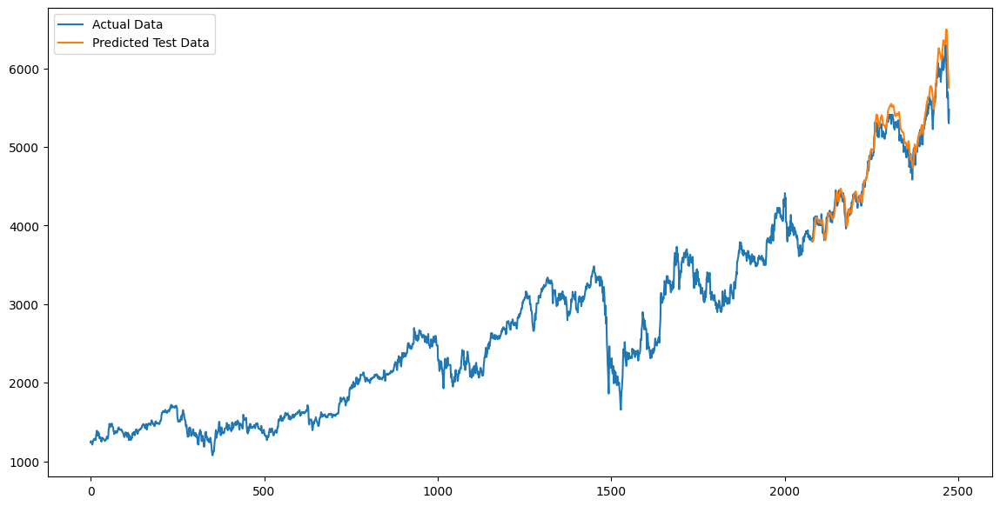

In [ ]:
# Membuat gambar (figure) dengan ukuran 14x7
plt.figure(figsize=(14, 7))
# Membuat plot garis untuk data aktual dengan label 'Actual Data'
plt.plot(bbri_hist3, label='Actual Data')
# Membuat plot garis untuk data prediksi pada dengan label 'Predicted Test Data'
plt.plot(testPredictPlot_bbri_lstm, label='Predicted Test Data')
# Menambahkan legenda ke plot berdasarkan label-label yang telah ditentukan sebelumnya
plt.legend()
# Menampilkan plot
plt.show()

In [ ]:
# Fungsi menghitung MAPE
def mean_absolute_percentage_error(y_true, y_pred):
    y_true, y_pred = np.array(y_true), np.array(y_pred)
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100

In [ ]:
# Melihat Metric Evaluation RMSE dan MAPE
mape_lstm1_bbri = mean_absolute_percentage_error(Y_test_bbri_lstm,test_predict_bbri_lstm)
print("RMSE of LSTM:", np.sqrt(mean_squared_error(Y_test_bbri_lstm,test_predict_bbri_lstm)))
print("MAPE of LSTM:", mape_lstm1_bbri)

RMSE of LSTM: 141.0205303531728
MAPE of LSTM: 2.052550994509955


#### Gated Recurrent Unit (GRU)

In [ ]:
# Mengambil kolom close
bbri_hist2 = bbri_hist['Close']

In [ ]:
# Train-Test Split
train_size = int(len(bbri_hist2) * 0.80)
test_size = len(bbri_hist2) - train_size
train_data_bbri_lstm, test_data_bbri_lstm = bbri_hist2[:train_size], bbri_hist2[train_size:]

# Scalling data
scaler = MinMaxScaler()
bbri_hist2 = scaler.fit_transform(np.array(bbri_hist2).reshape(-1,1))
train_data_bbri_lstm = scaler.fit_transform(np.array(train_data_bbri_lstm).reshape(-1, 1))
test_data_bbri_lstm = scaler.transform(np.array(test_data_bbri_lstm).reshape(-1, 1))

In [ ]:
def create_dataset(dataset, time_step = 1):
    dataX,dataY = [],[]
    for i in range(len(dataset)-time_step-1):
                   a = dataset[i:(i+time_step),0]
                   dataX.append(a)
                   dataY.append(dataset[i + time_step,0])
    return np.array(dataX),np.array(dataY)

In [ ]:
# Memanggil fungsi create_dataset untuk membagi data menjadi dataset input dan output dataset dengan times step 100
time_step = 100
X_train_bbri_lstm,Y_train_bbri_lstm =  create_dataset(train_data_bbri_lstm,time_step)
X_test_bbri_lstm,Y_test_bbri_lstm =  create_dataset(test_data_bbri_lstm,time_step)

In [ ]:
Y_train_bbri_lstm

array([0.09276678, 0.09276678, 0.08674113, ..., 0.96030638, 0.97448266,
       0.97731773])

In [ ]:
# Memeriksa value
print(X_train_bbri_lstm.shape)
print(X_train_bbri_lstm)
print(X_test_bbri_lstm.shape)
print(Y_test_bbri_lstm.shape)

(1879, 100)
[[0.05206461 0.05793246 0.05108668 ... 0.07368551 0.07669833 0.08071544]
 [0.05793246 0.05108668 0.05206461 ... 0.07669833 0.08071544 0.09276678]
 [0.05108668 0.05206461 0.05010862 ... 0.08071544 0.09276678 0.09276678]
 ...
 [0.84523331 0.82887035 0.81523442 ... 0.97731773 0.97731773 0.957471  ]
 [0.82887035 0.81523442 0.81796177 ... 0.97731773 0.957471   0.96030638]
 [0.81523442 0.81796177 0.81250747 ... 0.957471   0.96030638 0.97448266]]
(394, 100)
(394,)


In [ ]:
# Tetapkan seed untuk inisialisasi acak
seed_value = 42
tf.random.set_seed(seed_value)
np.random.seed(seed_value)

# Membangun model LSTM
model_bbri_lstm1 = tf.keras.Sequential([
      # Menambahkan layer GRU pertama dengan 50 unit dan pengembalian urutan yang digunakan untuk menjaga urutan output
      # Input_shape adalah bentuk input, yaitu jumlah langkah waktu (X_train.shape[1]) dan fitur (1)
      tf.keras.layers.GRU(50, return_sequences=True, input_shape=(X_train_bbri_lstm.shape[1], 1)),
      # Menambahkan layer GRU kedua dengan 50 unit, tidak ada pengembalian urutan karena ini adalah lapisan terakhir GRU
      tf.keras.layers.GRU(50),
      # Menambahkan layer Dense dengan 1 unit sebagai output layer
      tf.keras.layers.Dense(1)
])
# Mengompilasi model dengan loss function 'mean_squared_error' dan optimizer 'adam'
model_bbri_lstm1.compile(loss='mean_squared_error', optimizer='adam')

In [ ]:
# Melihat rangkuman model
model_bbri_lstm1.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 gru_2 (GRU)                 (None, 100, 50)           7950      
                                                                 
 gru_3 (GRU)                 (None, 50)                15300     
                                                                 
 dense_1 (Dense)             (None, 1)                 51        
                                                                 
Total params: 23301 (91.02 KB)
Trainable params: 23301 (91.02 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________


In [ ]:
# Menetapkan seed untuk TensorFlow untuk memastikan hasil yang konsisten dari operasi stokastik (jika ada)
tf.random.set_seed(seed_value)

# Melatih model menggunakan data pelatihan (X_train_bbri dan Y_train_bbri) dengan data validasi (X_test_bbri dan Y_test_bbri)
# Epochs adalah jumlah kali seluruh dataset akan diberikan kepada model selama proses pelatihan
# Batch_size adalah jumlah sampel data yang akan diproses sebelum pembaharuan bobot model
# verbose = 1 menghasilkan output detail pada setiap epoch selama pelatihan
model_bbri_lstm1.fit(X_train_bbri_lstm, Y_train_bbri_lstm, validation_data=(X_test_bbri_lstm, Y_test_bbri_lstm), epochs=50, batch_size=64, verbose=1)
model_bbri_lstm1.save("model_bbri_lstm1.h5")

Epoch 1/50
30/30 [==============================] - 10s 145ms/step - loss: 0.0282 - val_loss: 0.0278
Epoch 2/50
30/30 [==============================] - 3s 106ms/step - loss: 0.0012 - val_loss: 0.0010
Epoch 3/50
30/30 [==============================] - 3s 96ms/step - loss: 5.2523e-04 - val_loss: 0.0015
Epoch 4/50
30/30 [==============================] - 5s 157ms/step - loss: 4.7521e-04 - val_loss: 0.0012
Epoch 5/50
30/30 [==============================] - 3s 109ms/step - loss: 4.5524e-04 - val_loss: 0.0016
Epoch 6/50
30/30 [==============================] - 3s 106ms/step - loss: 4.4515e-04 - val_loss: 0.0011
Epoch 7/50
30/30 [==============================] - 3s 98ms/step - loss: 4.3657e-04 - val_loss: 0.0013
Epoch 8/50
30/30 [==============================] - 5s 153ms/step - loss: 4.0945e-04 - val_loss: 0.0014
Epoch 9/50
30/30 [==============================] - 5s 174ms/step - loss: 4.0451e-04 - val_loss: 9.9304e-04
Epoch 10/50
30/30 [==============================] - 3s 106ms/step - 

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


In [ ]:
# Memprediksi data menggunakan model yang telah dilatih
train_predict_bbri_lstm = model_bbri_lstm1.predict(X_train_bbri_lstm)
test_predict_bbri_lstm = model_bbri_lstm1.predict(X_test_bbri_lstm)

13/13 [==============================] - 0s 22ms/step


In [ ]:
Y_train_bbri_lstm[:5]

array([0.09276678, 0.09276678, 0.08674113, 0.08473252, 0.09176253])

In [ ]:
train_predict_bbri_lstm[:5]

array([[0.08122504],
       [0.09025419],
       [0.09340397],
       [0.09032314],
       [0.08786965]], dtype=float32)

In [ ]:
# Transformasi data ke bentuk awal
Y_train_bbri_lstm = scaler.inverse_transform(Y_train_bbri_lstm.reshape(-1, 1))
Y_test_bbri_lstm = scaler.inverse_transform(Y_test_bbri_lstm.reshape(-1, 1))
train_predict_bbri_lstm = scaler.inverse_transform(train_predict_bbri_lstm)
test_predict_bbri_lstm = scaler.inverse_transform(test_predict_bbri_lstm)

In [ ]:
Y_test_bbri_lstm[:5]

array([[3795.79614258],
       [3804.72753906],
       [3876.17749023],
       [3920.83374023],
       [3974.421875  ]])

In [ ]:
test_predict_bbri_lstm[:5]

array([[3811.8523],
       [3794.684 ],
       [3802.654 ],
       [3872.1953],
       [3918.5928]], dtype=float32)

In [ ]:
# Mendefinisikan jumlah langkah waktu sebelumnya yang akan digunakan sebagai input untuk memprediksi langkah waktu saat ini
look_back = 100

# Membuat array kosong dengan ukuran yang sama dengan bbri_hist2
trainPredictPlot_bbri = np.empty_like(bbri_hist2)
# Mengisi array dengan nilai yang sama dengan NaN (untuk plot)
trainPredictPlot_bbri[:,:] = np.nan
# Mengisi bagian dari array dengan hasil prediksi pada data pelatihan
# Menempatkan hasil prediksi pada posisi yang sesuai dalam array untuk plotting
trainPredictPlot_bbri[look_back : len(train_predict_bbri_lstm)+look_back,:] = train_predict_bbri_lstm

# Membuat array kosong dengan ukuran yang sama dengan bbri_hist2
testPredictPlot_bbri_lstm = np.empty_like(bbri_hist2)
# Mengisi array dengan nilai yang sama dengan NaN (untuk plot)
testPredictPlot_bbri_lstm[:,:] = np.nan
# Mengisi bagian dari array dengan hasil prediksi pada data uji
# Menempatkan hasil prediksi pada posisi yang sesuai dalam array untuk plotting
testPredictPlot_bbri_lstm[len(train_predict_bbri_lstm) + (look_back) * 2 + 1 : len(bbri_hist2) - 1, :] = test_predict_bbri_lstm

In [ ]:
# Mengambil data harga saham close dan dijadikan dalam bentuk array numpy
bbri_hist3=bbri_hist['Close'].to_numpy()

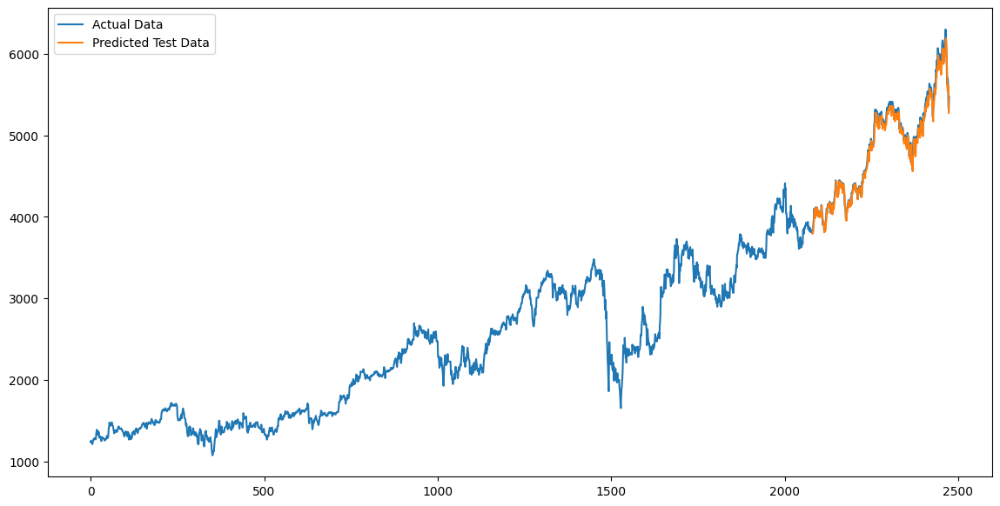

In [ ]:
# Membuat gambar (figure) dengan ukuran 14x7
plt.figure(figsize=(14, 7))
# Membuat plot garis untuk data aktual dengan label 'Actual Data'
plt.plot(bbri_hist3, label='Actual Data')
# Membuat plot garis untuk data prediksi pada dengan label 'Predicted Test Data'
plt.plot(testPredictPlot_bbri_lstm, label='Predicted Test Data')
# Menambahkan legenda ke plot berdasarkan label-label yang telah ditentukan sebelumnya
plt.legend()
# Menampilkan plot
plt.show()

In [ ]:
# Fungsi menghitung MAPE
def mean_absolute_percentage_error(y_true, y_pred):
    y_true, y_pred = np.array(y_true), np.array(y_pred)
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100

In [ ]:
# Melihat Metric Evaluation RMSE dan MAPE
mape_lstm1_bbri = mean_absolute_percentage_error(Y_test_bbri_lstm,test_predict_bbri_lstm)
print("RMSE of GRU:", np.sqrt(mean_squared_error(Y_test_bbri_lstm,test_predict_bbri_lstm)))
print("MAPE of GRU:", mape_lstm1_bbri)

RMSE of LSTM: 79.75696252504939
MAPE of LSTM: 1.255699724540664


### Bank Neo Commerce (BBYB)

#### ARIMA

##### Baseline Model

In [ ]:
# Calculate lengths for train
total_length = len(bbyb_hist)
train_length = int(0.8 * total_length)

# Split the Data to Train and Test
train_bbyb_arima = list(bbyb_hist[0:train_length]['Close'])
test_bbyb_arima = list(bbyb_hist[train_length:]['Close'])

# Auto ARIMA to select optimal ARIMA parameters
model_bbyb_arima = auto_arima(train_bbyb_arima, seasonal=False, trace=True)
print(model_bbyb_arima.summary())

Performing stepwise search to minimize aic
 ARIMA(2,1,2)(0,0,0)[0] intercept   : AIC=17954.023, Time=3.82 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=17983.423, Time=0.08 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=17964.849, Time=0.12 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=17965.410, Time=0.21 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=17982.070, Time=0.06 sec
 ARIMA(1,1,2)(0,0,0)[0] intercept   : AIC=17968.566, Time=1.04 sec
 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=17968.731, Time=0.87 sec
 ARIMA(3,1,2)(0,0,0)[0] intercept   : AIC=inf, Time=6.93 sec
 ARIMA(2,1,3)(0,0,0)[0] intercept   : AIC=17926.714, Time=5.32 sec
 ARIMA(1,1,3)(0,0,0)[0] intercept   : AIC=17970.310, Time=2.85 sec
 ARIMA(3,1,3)(0,0,0)[0] intercept   : AIC=17941.233, Time=8.01 sec
 ARIMA(2,1,4)(0,0,0)[0] intercept   : AIC=17927.153, Time=8.63 sec
 ARIMA(1,1,4)(0,0,0)[0] intercept   : AIC=17955.892, Time=7.75 sec
 ARIMA(3,1,4)(0,0,0)[0] intercept   : AIC=17941.774, Time=16.01 sec
 ARIMA(2,1,3)(0,0,0)[0] 

Dari fungsi auto_arima, diperoleh model terbaik yang meminimalkan AIC adalah ARIMA(2,1,3). Oleh karena itu, akan dilakukan permodelan dan prediksi menggunakan ARIMA(2,1,3)

In [ ]:
# Menghitung jumlah observasi dalam data pengujian dan menyimpannya dalam variabel n_test_obser
n_test_obser_arima = len(test_bbyb_arima)

In [ ]:
# Inisialisasi daftar kosong untuk menyimpan prediksi model
model_predictions_bbyb_arima = []

# Memulai perulangan untuk setiap observasi pengujian
for i in range(n_test_obser_arima):
    # Membuat model ARIMA dengan data pelatihan dan order (0, 1, 1)
    model_bbca_arima = ARIMA(train_bbyb_arima, order=(2, 1, 3))
    # Melakukan fit pada model ARIMA yang telah dibuat
    model_fit_bbyb_arima = model_bbyb_arima.fit()
    # Melakukan peramalan menggunakan model yang telah difit
    output_arima = model_fit_bbyb_arima.forecast()
    # Mengambil nilai prediksi dari hasil peramalan (output adalah array numpy)
    yhat_arima = output_arima[0]
    # Menambahkan nilai prediksi ke dalam daftar prediksi model
    model_predictions_bbyb_arima.append(yhat_arima)
    # Memperbarui data pelatihan dengan menambahkan nilai prediksi pada akhir data pelatihan
    train_bbyb_arima.append(yhat_arima)

Setelah dilakukan permodelan dan prediksi menggunakan ARIMA(2,1,3), akan dilihat plot perbandingan data asli dengan data hasil prediksinya.

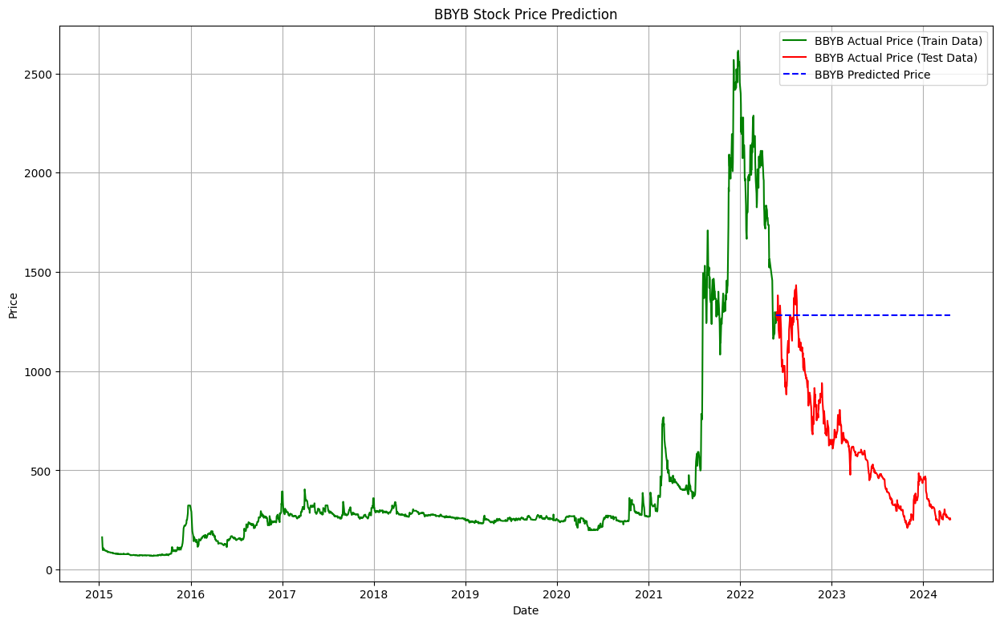

In [ ]:
# Menggabungkan data pelatihan dan pengujian untuk sumbu x (tanggal)
date_range_all = bbyb_hist.index
# Membuat figure baru dengan ukuran 15x9
plt.figure(figsize=(15, 9))
# Menambahkan grid ke plot
plt.grid(True)
# Membuat plot garis untuk data pelatihan BBYB dengan warna hijau
plt.plot(date_range_all[:train_length], train_bbyb_arima[:train_length], color='green', label='BBYB Actual Price (Train Data)')
# Membuat plot garis untuk data pengujian BBYB dengan warna merah
plt.plot(date_range_all[train_length:], test_bbyb_arima, color='red', label='BBYB Actual Price (Test Data)')
# Membuat plot garis untuk prediksi harga BBYB dengan warna biru dan garis putus-putus
plt.plot(date_range_all[train_length:], model_predictions_bbyb_arima, color='blue', ls='dashed', label='BBYB Predicted Price')
# Menambahkan judul pada plot
plt.title('BBYB Stock Price Prediction')
# Menambahkan label untuk sumbu x
plt.xlabel('Date')
# Menambahkan label untuk sumbu y
plt.ylabel('Price')
# Menambahkan legenda pada plot
plt.legend()
# Menampilkan plot
plt.show()

Dari hasil plot di atas, diperoleh bahwa model ARIMA(2,1,3) tidak cukup baik dalam memprediksi data test. Kemudian akan dilihat metrik evaluasinya.

In [ ]:
# Metric Evaluation RMSE & MAPE
def mean_absolute_percentage_error(y_true, y_pred):
    y_true, y_pred = np.array(y_true), np.array(y_pred)
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100

# Menghitung RMSE
rmse_bbyb_arima1 = np.sqrt(mean_squared_error(test_bbyb_arima, model_predictions_bbyb_arima))
print('BBYB ARIMA Test RMSE: %.3f' % rmse_bbyb_arima1)
# Menghitung MAPE
mape_bbyb_arima1 = mean_absolute_percentage_error(test_bbyb_arima, model_predictions_bbyb_arima)
print('BBYB ARIMA Test MAPE: '+str(mape_bbyb_arima1))

BBYB ARIMA Test RMSE: 730.141
BBYB ARIMA Test MAPE: 165.18681097864572


Diperoleh bahwa RMSE dari model ARIMA(2,1,3) sebesar 730.141 yang mana cukup besar sehingga dapat disimpulkan model ini tidak cukup baik untuk memprediksi harga saham close BBYB.

##### Hyperparameter Tuning & Optimization

Langkah awal yang akan diambil adalah melakukan uji stasioneritas terhadap data saham BBYB karena model ARIMA memerlukan data yang stasioneritas

In [ ]:
# Melakukan uji Augmented Dickey-Fuller pada data harga penutupan saham BBCA
adf_test_bbyb = adfuller(bbyb_hist.Close)

# Ho: Data tidak stasioner (memiliki unit root)
# H1: Data stasioner (tidak memiliki unit root)

# Mendefinisikan fungsi untuk melakukan uji Augmented Dickey-Fuller dan menampilkan hasilnya
def adfuller_test(close):
    # Melakukan uji Augmented Dickey-Fuller pada data yang diberikan
    result = adfuller(close)
    # Mendefinisikan label untuk hasil uji
    labels = ['ADF Test Statistic', 'p-value', '#Lags Used', 'Number of Observations Used']
    # Menampilkan hasil uji dengan label yang sesuai
    for value, label in zip(result, labels):
        print(label + ' : ' + str(value))
    # Menilai hasil uji berdasarkan nilai p-value
    if result[1] <= 0.05:
        # Jika p-value kurang dari atau sama dengan 0.05, menolak hipotesis nol (Ho)
        print("strong evidence against the null hypothesis(Ho), reject the null hypothesis. Data has no unit root and is stationary")
    else:
        # Jika p-value lebih besar dari 0.05, tidak dapat menolak hipotesis nol (Ho)
        print("weak evidence against null hypothesis, time series has a unit root, indicating it is non-stationary ")

In [ ]:
# Uji stasioneritas
adfuller_test(bbyb_hist.Close)

ADF Test Statistic : -2.1915732302089164
p-value : 0.20931809205039548
#Lags Used : 27
Number of Observations Used : 2269
weak evidence against null hypothesis, time series has a unit root, indicating it is non-stationary 


Dari uji ADF yang telah dilakukan, diperoleh hasil bahwa data harga saham close BBYB tidak stasioner. Oleh karena itu, akan dilakukan differencing terhadap data.

In [ ]:
# Melakukan differencing karena data tidak stasioner
diff_bbyb = bbyb_hist.Close.diff().dropna()

In [ ]:
# Uji stasioneritas setelah differencing
adfuller_test(diff_bbyb)

ADF Test Statistic : -8.815794436218933
p-value : 1.9359849025687537e-14
#Lags Used : 27
Number of Observations Used : 2268
strong evidence against the null hypothesis(Ho), reject the null hypothesis. Data has no unit root and is stationary


Dari hasil uji stasioneritas terhadap data differencing pertama, diperoleh bahwa data sudah stasioner. Untuk lebih memastikan, akan dilihat jumlah differencing yang diperlukan untuk data saham close BBCA.

In [ ]:
# Menghitung jumlah differencing yang diperlukan untuk membuat data harga penutupan BBCA stasioner menggunakan uji ADF (Augmented Dickey-Fuller)
optimal_diffs = ndiffs(bbyb_hist.Close, test='adf')
optimal_diffs

1

Diperoleh bahwa differencing optimal yang diperlukan adalah 1. Maka selanjutnya akan dilakukan permodelan ARIMA.

In [ ]:
# Calculate lengths for train
total_length = len(bbyb_hist)
train_length = int(0.8 * total_length)

# Split the DataFrame
train_bbyb_arima = bbyb_hist[:train_length]
test_bbyb_arima = bbyb_hist[train_length:]

Akan dilakukan beberapa percobaan menggunakan orde p dan q dimana orde p dan q yang diambil mulai dari 0 sampai dengan 4.

In [ ]:
# Mendefinisikan rentang nilai untuk p, d, q dalam model ARIMA
p = range(0, 5)
d = range(1, 2)
q = range(0, 5)

# Menghasilkan semua kombinasi berbeda dari tripel p, d, dan q
pdq = list(itertools.product(p, d, q))

# Mengonversi data pengujian menjadi array numpy
test_data_arima = test_bbyb_arima['Close'].to_numpy()

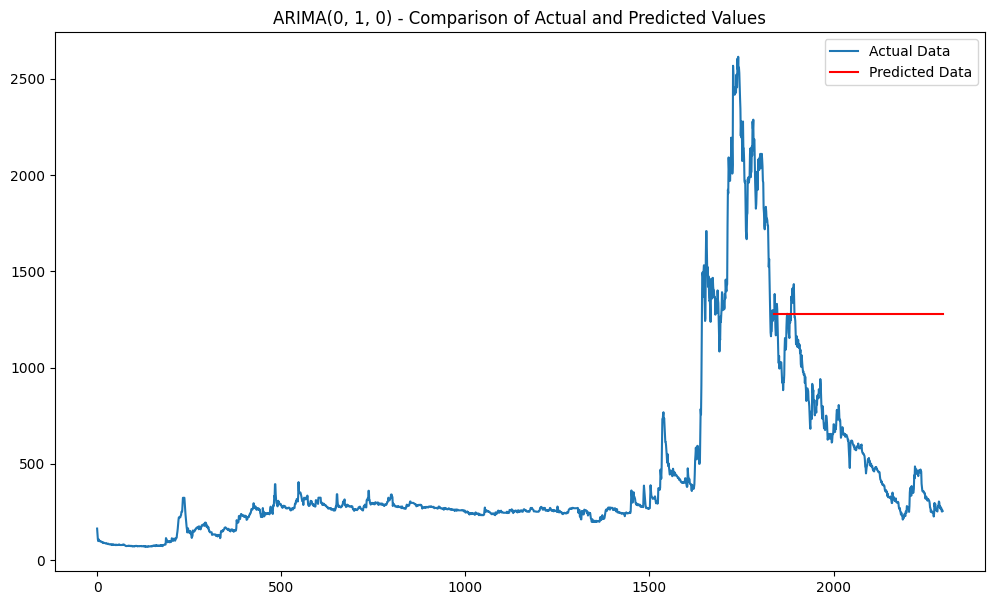

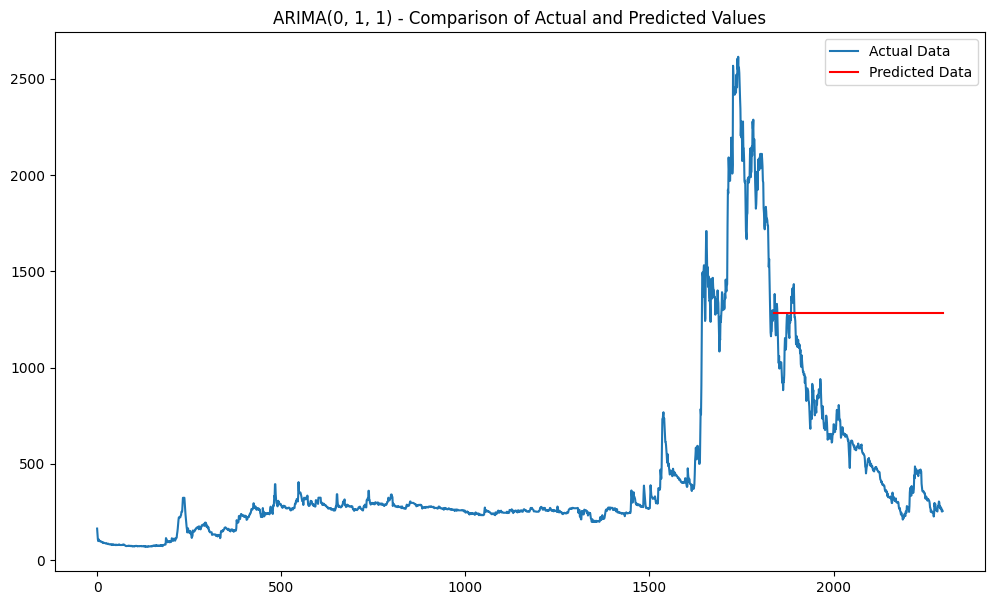

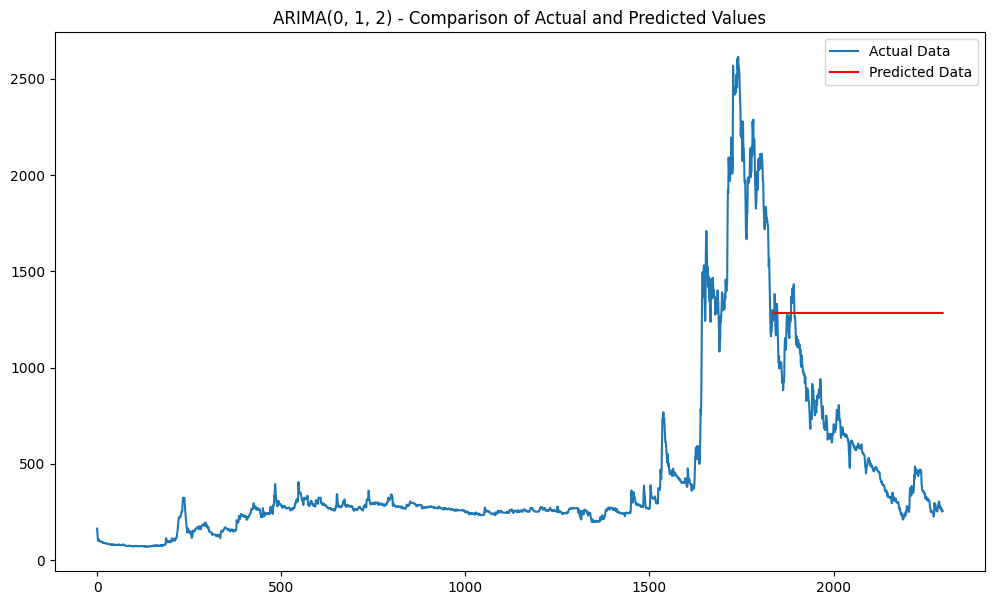

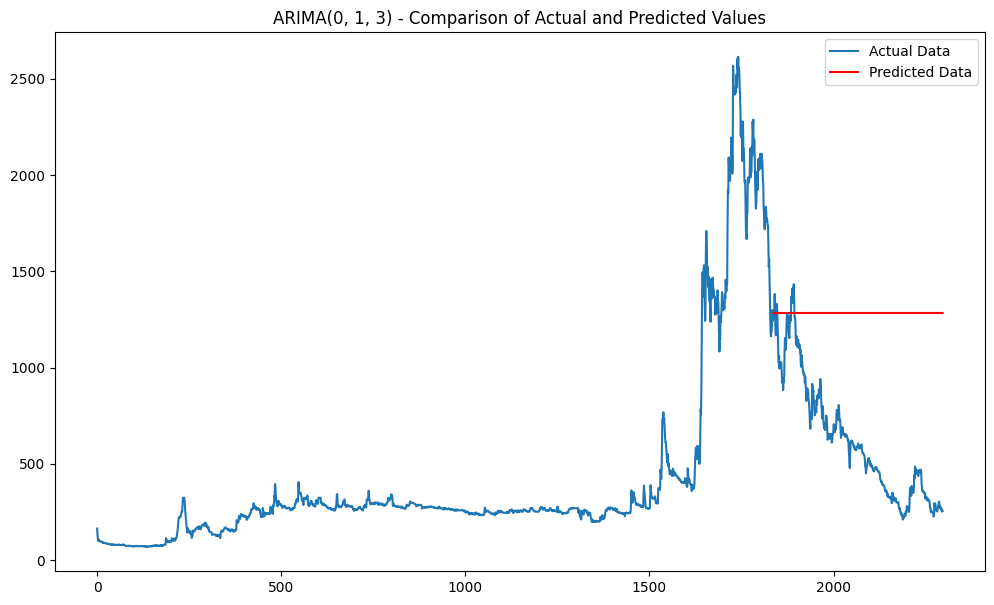

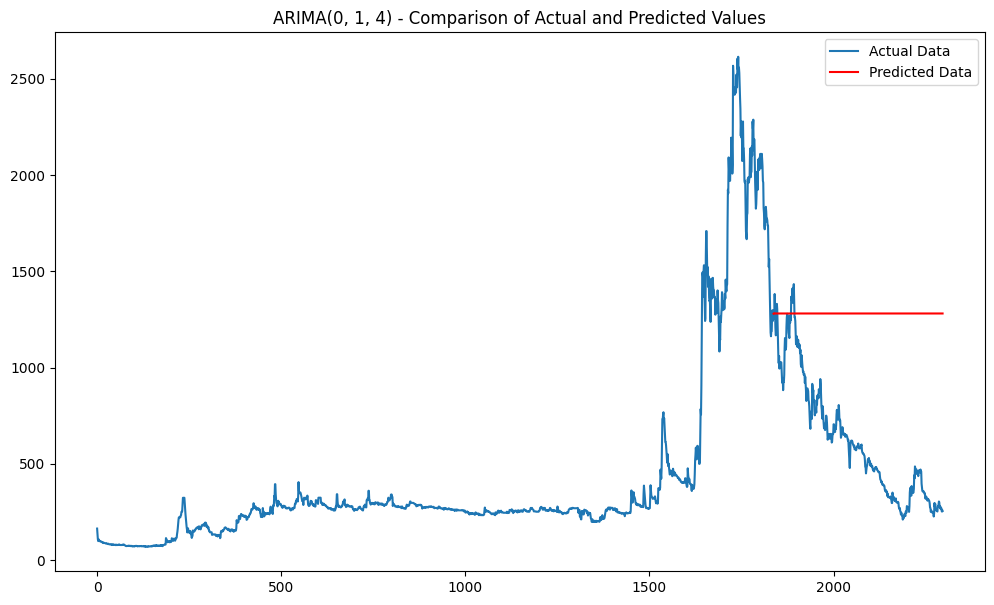

...

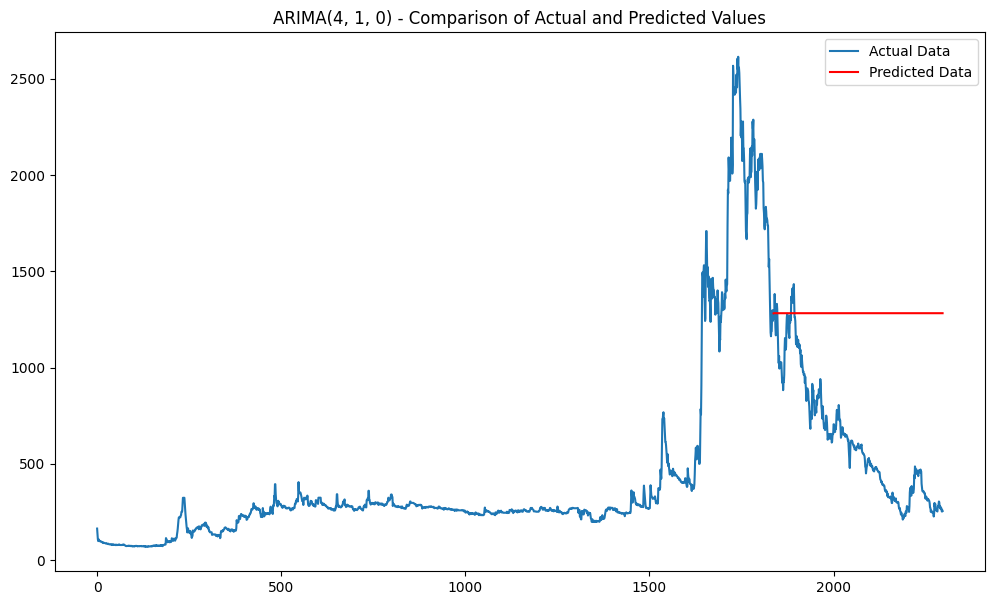

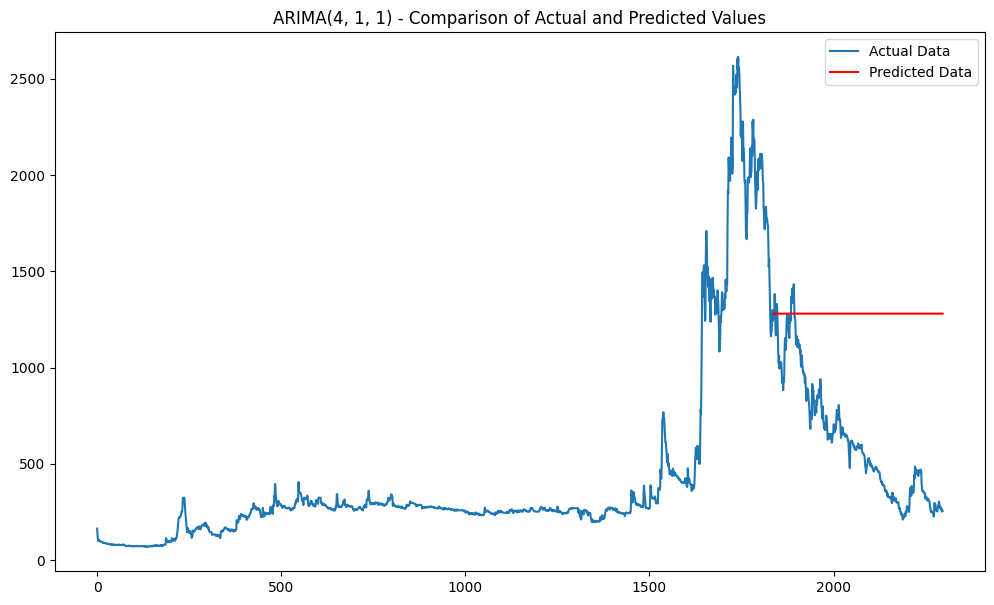

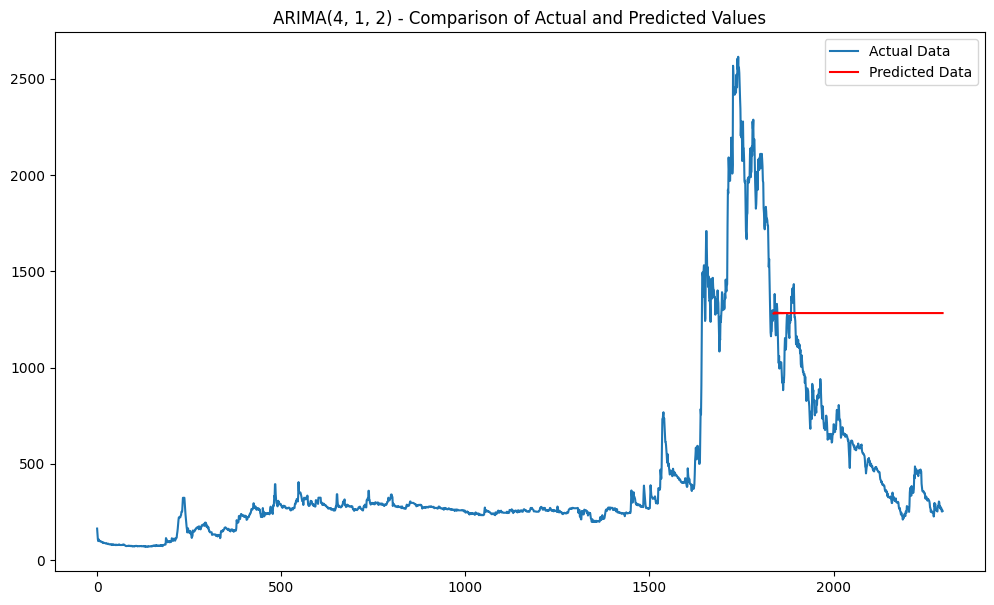

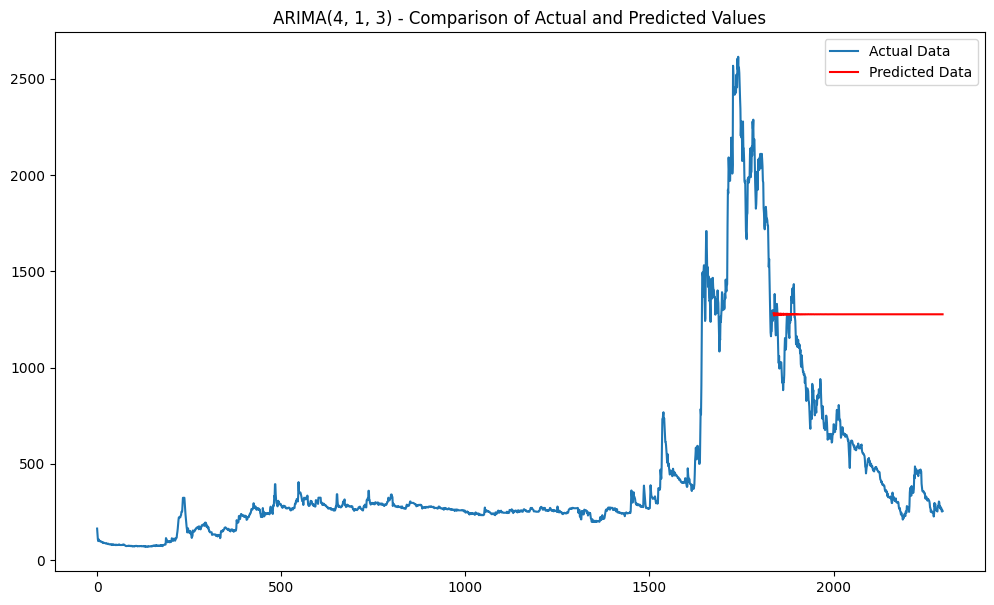

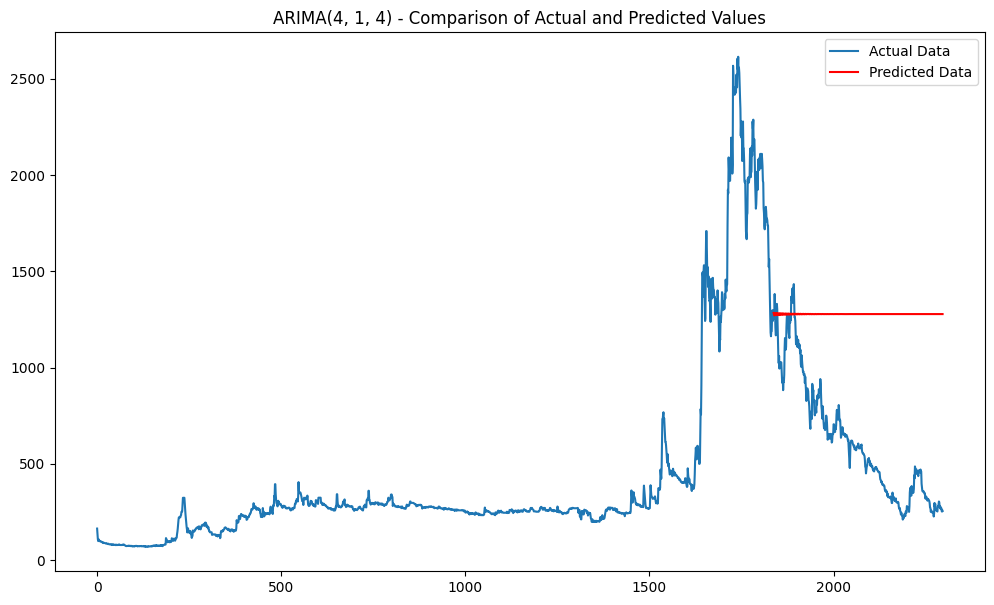

Loop completed.


In [ ]:
# Loop through pdq combinations, fit ARIMA model, forecast and plot results
for param in pdq:
    try:
        # Fit ARIMA model
        model_ARIMA_bbyb = ARIMA(train_bbyb_arima['Close'], order=param)
        results_ARIMA_bbyb = model_ARIMA_bbyb.fit()

        # Forecast the test set
        predictions_ARIMA_bbyb = results_ARIMA_bbyb.forecast(steps=len(test_bbyb_arima))

        # Menghitung RMSE
        #rmse = np.sqrt(mean_squared_error(test_bbca_arima, predictions_ARIMA_bbca))
        #print(f"ARIMA{param} - RMSE: {rmse}")

        # Plot the results
        plt.figure(figsize=(12, 7))
        plt.plot(np.arange(total_length), bbyb_hist['Close'].to_numpy(), label="Actual Data")
        plt.plot(np.arange(train_length, total_length), predictions_ARIMA_bbyb, color='red', label="Predicted Data")
        plt.legend()
        plt.title(f"ARIMA{param} - Comparison of Actual and Predicted Values")
        plt.show()

    except Exception as e:
        print(f"ARIMA{param} - Error: {e}")

print("Loop completed.")

Dari percobaan menggunakan berbagai order p dan q, diperoleh hasil bahwa model ARIMA memprediksi seluruh data test dengan buruk dimana hasil prediksinya lurus dan tidak sesuai data asli. Maka dapat disimpulkan bahwa model ARIMA tidak cocok untuk memprediksi harga saham yang datanya volatile atau tidak stabil.

#### Long Short Term Memory (LSTM)

In [ ]:
# Mengambil kolom close
bbyb_hist2 = bbyb_hist['Close']

In [ ]:
# Train-Test Split
train_size = int(len(bbyb_hist2) * 0.80)
test_size = len(bbyb_hist2) - train_size
train_data_bbyb_lstm, test_data_bbyb_lstm = bbyb_hist2[:train_size], bbyb_hist2[train_size:]

# Scalling data
scaler = MinMaxScaler()
bbyb_hist2 = scaler.fit_transform(np.array(bbyb_hist2).reshape(-1,1))
train_data_bbyb_lstm = scaler.fit_transform(np.array(train_data_bbyb_lstm).reshape(-1, 1))
test_data_bbyb_lstm = scaler.transform(np.array(test_data_bbyb_lstm).reshape(-1, 1))

In [ ]:
def create_dataset(dataset, time_step = 1):
    dataX,dataY = [],[]
    for i in range(len(dataset)-time_step-1):
                   a = dataset[i:(i+time_step),0]
                   dataX.append(a)
                   dataY.append(dataset[i + time_step,0])
    return np.array(dataX),np.array(dataY)

In [ ]:
# Memanggil fungsi create_dataset untuk membagi data menjadi dataset input dan output dataset dengan times step 100
time_step = 100
X_train_bbyb_lstm,Y_train_bbyb_lstm =  create_dataset(train_data_bbyb_lstm,time_step)
X_test_bbyb_lstm,Y_test_bbyb_lstm =  create_dataset(test_data_bbyb_lstm,time_step)

In [ ]:
Y_train_bbyb_lstm

array([0.0013154 , 0.0006577 , 0.0006577 , ..., 0.47001238, 0.48284946,
       0.46084306])

In [ ]:
# Memeriksa value
print(X_train_bbyb_lstm.shape)
print(X_train_bbyb_lstm)
print(X_test_bbyb_lstm.shape)
print(Y_test_bbyb_lstm.shape)

(1736, 100)
[[3.71600181e-02 2.46637359e-02 1.54559415e-02 ... 6.57701742e-04
  9.86551115e-04 1.31540049e-03]
 [2.46637359e-02 1.54559415e-02 1.15097460e-02 ... 9.86551115e-04
  1.31540049e-03 1.31540049e-03]
 [1.54559415e-02 1.15097460e-02 1.54559415e-02 ... 1.31540049e-03
  1.31540049e-03 6.57701742e-04]
 ...
 [9.37648538e-01 9.26645384e-01 9.26645384e-01 ... 4.29667277e-01
  4.40670479e-01 4.40670479e-01]
 [9.26645384e-01 9.26645384e-01 9.63322692e-01 ... 4.40670479e-01
  4.40670479e-01 4.70012383e-01]
 [9.26645384e-01 9.63322692e-01 9.37648538e-01 ... 4.40670479e-01
  4.70012383e-01 4.82849460e-01]]
(359, 100)
(359,)


In [ ]:
# Tetapkan seed untuk inisialisasi acak
seed_value = 42
tf.random.set_seed(seed_value)
np.random.seed(seed_value)

# Membangun model LSTM
model_bbyb_lstm1 = tf.keras.Sequential([
      # Menambahkan layer LSTM pertama dengan 50 unit dan pengembalian urutan yang digunakan untuk menjaga urutan output
      # Input_shape adalah bentuk input, yaitu jumlah langkah waktu (X_train_bbca.shape[1]) dan fitur (1)
      tf.keras.layers.LSTM(50, return_sequences=True, input_shape=(X_train_bbyb_lstm.shape[1], 1)),
      # Menambahkan layer LSTM ketiga dengan 50 unit, tidak ada pengembalian urutan karena ini adalah lapisan terakhir LSTM
      tf.keras.layers.LSTM(50),
      # Menambahkan layer Dense dengan 1 unit sebagai output layer
      tf.keras.layers.Dense(1)
])
# Mengompilasi model dengan loss function 'mean_squared_error' dan optimizer 'adam'
model_bbyb_lstm1.compile(loss='mean_squared_error', optimizer='adam')

In [ ]:
# Melihat rangkuman model
model_bbyb_lstm1.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 50)           10400     
                                                                 
 lstm_1 (LSTM)               (None, 50)                20200     
                                                                 
 dense_1 (Dense)             (None, 1)                 51        
                                                                 
Total params: 30651 (119.73 KB)
Trainable params: 30651 (119.73 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________


In [ ]:
# Menetapkan seed untuk TensorFlow untuk memastikan hasil yang konsisten dari operasi stokastik (jika ada)
tf.random.set_seed(seed_value)

# Melatih model menggunakan data pelatihan (X_train_bbyb dan Y_train_bbyb) dengan data validasi (X_test_bbyb dan Y_test_bbyb)
# Epochs adalah jumlah kali seluruh dataset akan diberikan kepada model selama proses pelatihan
# Batch_size adalah jumlah sampel data yang akan diproses sebelum pembaharuan bobot model
# verbose = 1 menghasilkan output detail pada setiap epoch selama pelatihan
model_bbyb_lstm1.fit(X_train_bbyb_lstm, Y_train_bbyb_lstm, validation_data=(X_test_bbyb_lstm, Y_test_bbyb_lstm), epochs=50, batch_size=64, verbose=1)
model_bbyb_lstm1.save("model_bbyb_lstm1.h5")

Epoch 1/50
28/28 [==============================] - 9s 154ms/step - loss: 0.0078 - val_loss: 5.1467e-04
Epoch 2/50
28/28 [==============================] - 4s 154ms/step - loss: 0.0015 - val_loss: 3.7378e-04
Epoch 3/50
28/28 [==============================] - 5s 163ms/step - loss: 0.0012 - val_loss: 3.2372e-04
Epoch 4/50
28/28 [==============================] - 3s 120ms/step - loss: 9.8024e-04 - val_loss: 3.0162e-04
Epoch 5/50
28/28 [==============================] - 3s 120ms/step - loss: 9.2495e-04 - val_loss: 4.8066e-04
Epoch 6/50
28/28 [==============================] - 4s 154ms/step - loss: 7.6555e-04 - val_loss: 2.8797e-04
Epoch 7/50
28/28 [==============================] - 5s 166ms/step - loss: 7.7530e-04 - val_loss: 3.4710e-04
Epoch 8/50
28/28 [==============================] - 3s 119ms/step - loss: 8.1059e-04 - val_loss: 7.9762e-04
Epoch 9/50
28/28 [==============================] - 3s 119ms/step - loss: 7.2766e-04 - val_loss: 2.8779e-04
Epoch 10/50
28/28 [=====================

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


In [ ]:
# Memprediksi data menggunakan model yang telah dilatih
train_predict_bbyb_lstm = model_bbyb_lstm1.predict(X_train_bbyb_lstm)
test_predict_bbyb_lstm = model_bbyb_lstm1.predict(X_test_bbyb_lstm)

12/12 [==============================] - 0s 35ms/step


In [ ]:
Y_train_bbyb_lstm[:5]

array([0.0013154 , 0.0006577 , 0.0006577 , 0.00164425, 0.00164425])

In [ ]:
train_predict_bbyb_lstm[:5]

array([[-0.0015881 ],
       [-0.00146865],
       [-0.00153955],
       [-0.00166327],
       [-0.00150234]], dtype=float32)

In [ ]:
# Transformasi data ke bentuk awal
Y_train_bbyb_lstm = scaler.inverse_transform(Y_train_bbyb_lstm.reshape(-1, 1))
Y_test_bbyb_lstm = scaler.inverse_transform(Y_test_bbyb_lstm.reshape(-1, 1))
train_predict_bbyb_lstm = scaler.inverse_transform(train_predict_bbyb_lstm)
test_predict_bbyb_lstm = scaler.inverse_transform(test_predict_bbyb_lstm)

In [ ]:
Y_test_bbyb_lstm[:5]

array([[681.62750244],
       [770.3324585 ],
       [746.98907471],
       [732.98303223],
       [732.98303223]])

In [ ]:
test_predict_bbyb_lstm[:5]

array([[727.4896 ],
       [694.4014 ],
       [719.3959 ],
       [740.9928 ],
       [746.73047]], dtype=float32)

In [ ]:
# Mendefinisikan jumlah langkah waktu sebelumnya yang akan digunakan sebagai input untuk memprediksi langkah waktu saat ini
look_back = 100

# Membuat array kosong dengan ukuran yang sama dengan bbyb_hist2
trainPredictPlot_bbyb = np.empty_like(bbyb_hist2)
# Mengisi array dengan nilai yang sama dengan NaN (untuk plot)
trainPredictPlot_bbyb[:,:] = np.nan
# Mengisi bagian dari array dengan hasil prediksi pada data pelatihan
# Menempatkan hasil prediksi pada posisi yang sesuai dalam array untuk plotting
trainPredictPlot_bbyb[look_back : len(train_predict_bbyb_lstm)+look_back,:] = train_predict_bbyb_lstm

# Membuat array kosong dengan ukuran yang sama dengan bbyb_hist2
testPredictPlot_bbyb_lstm = np.empty_like(bbyb_hist2)
# Mengisi array dengan nilai yang sama dengan NaN (untuk plot)
testPredictPlot_bbyb_lstm[:,:] = np.nan
# Mengisi bagian dari array dengan hasil prediksi pada data uji
# Menempatkan hasil prediksi pada posisi yang sesuai dalam array untuk plotting
testPredictPlot_bbyb_lstm[len(train_predict_bbyb_lstm) + (look_back) * 2 + 1 : len(bbyb_hist2) - 1, :] = test_predict_bbyb_lstm

In [ ]:
# Mengambil data harga saham close dan dijadikan dalam bentuk array numpy
bbyb_hist3=bbyb_hist['Close'].to_numpy()

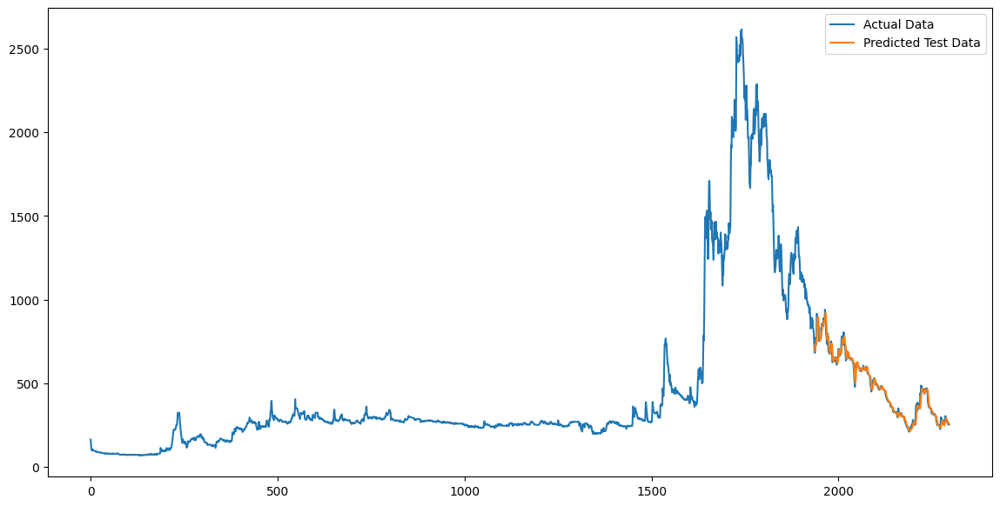

In [ ]:
# Membuat gambar (figure) dengan ukuran 14x7
plt.figure(figsize=(14, 7))
# Membuat plot garis untuk data aktual dengan label 'Actual Data'
plt.plot(bbyb_hist3, label='Actual Data')
# Membuat plot garis untuk data prediksi pada dengan label 'Predicted Test Data'
plt.plot(testPredictPlot_bbyb_lstm, label='Predicted Test Data')
# Menambahkan legenda ke plot berdasarkan label-label yang telah ditentukan sebelumnya
plt.legend()
# Menampilkan plot
plt.show()

In [ ]:
# Fungsi menghitung MAPE
def mean_absolute_percentage_error(y_true, y_pred):
    y_true, y_pred = np.array(y_true), np.array(y_pred)
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100

In [ ]:
# Melihat Metric Evaluation RMSE dan MAPE
mape_lstm1_bbyb = mean_absolute_percentage_error(Y_test_bbyb_lstm,test_predict_bbyb_lstm)
print("RMSE of LSTM:", np.sqrt(mean_squared_error(Y_test_bbyb_lstm,test_predict_bbyb_lstm)))
print("MAPE of LSTM:", mape_lstm1_bbyb)

RMSE of LSTM: 27.699469518554164
MAPE of LSTM: 3.6446933877815266


#### Gated Recurrent Unit (GRU)

In [ ]:
# Mengambil kolom close
bbyb_hist2 = bbyb_hist['Close']

In [ ]:
# Train-Test Split
train_size = int(len(bbyb_hist2) * 0.80)
test_size = len(bbyb_hist2) - train_size
train_data_bbyb_gru, test_data_bbyb_gru = bbyb_hist2[:train_size], bbyb_hist2[train_size:]

# Scalling data
scaler = MinMaxScaler()
bbyb_hist2 = scaler.fit_transform(np.array(bbyb_hist2).reshape(-1,1))
train_data_bbyb_gru = scaler.fit_transform(np.array(train_data_bbyb_gru).reshape(-1, 1))
test_data_bbyb_gru = scaler.transform(np.array(test_data_bbyb_gru).reshape(-1, 1))

In [ ]:
def create_dataset(dataset, time_step = 1):
    dataX,dataY = [],[]
    for i in range(len(dataset)-time_step-1):
                   a = dataset[i:(i+time_step),0]
                   dataX.append(a)
                   dataY.append(dataset[i + time_step,0])
    return np.array(dataX),np.array(dataY)

In [ ]:
# Memanggil fungsi create_dataset untuk membagi data menjadi dataset input dan output dataset dengan times step 100
time_step = 100
X_train_bbyb_gru,Y_train_bbyb_gru=  create_dataset(train_data_bbyb_gru,time_step)
X_test_bbyb_gru,Y_test_bbyb_gru =  create_dataset(test_data_bbyb_gru,time_step)

In [ ]:
Y_train_bbyb_gru

array([0.0013154 , 0.0006577 , 0.0006577 , ..., 0.47001238, 0.48284946,
       0.46084306])

In [ ]:
# Memeriksa value
print(X_train_bbyb_gru.shape)
print(X_train_bbyb_gru)
print(X_test_bbyb_gru.shape)
print(Y_test_bbyb_gru.shape)

(1736, 100)
[[3.71600181e-02 2.46637359e-02 1.54559415e-02 ... 6.57701742e-04
  9.86551115e-04 1.31540049e-03]
 [2.46637359e-02 1.54559415e-02 1.15097460e-02 ... 9.86551115e-04
  1.31540049e-03 1.31540049e-03]
 [1.54559415e-02 1.15097460e-02 1.54559415e-02 ... 1.31540049e-03
  1.31540049e-03 6.57701742e-04]
 ...
 [9.37648538e-01 9.26645384e-01 9.26645384e-01 ... 4.29667277e-01
  4.40670479e-01 4.40670479e-01]
 [9.26645384e-01 9.26645384e-01 9.63322692e-01 ... 4.40670479e-01
  4.40670479e-01 4.70012383e-01]
 [9.26645384e-01 9.63322692e-01 9.37648538e-01 ... 4.40670479e-01
  4.70012383e-01 4.82849460e-01]]
(359, 100)
(359,)


In [ ]:
# Tetapkan seed untuk inisialisasi acak
seed_value = 42
tf.random.set_seed(seed_value)
np.random.seed(seed_value)

# Membangun model GRU
model_bbyb_gru1 = tf.keras.Sequential([
      # Menambahkan layer GRU pertama dengan 50 unit dan pengembalian urutan yang digunakan untuk menjaga urutan output
      # Input_shape adalah bentuk input, yaitu jumlah langkah waktu (X_train.shape[1]) dan fitur (1)
      tf.keras.layers.GRU(50, return_sequences=True, input_shape=(X_train_bbyb_gru.shape[1], 1)),
      # Menambahkan layer GRU kedua dengan 50 unit, tidak ada pengembalian urutan karena ini adalah lapisan terakhir GRU
      tf.keras.layers.GRU(50),
      # Menambahkan layer Dense dengan 1 unit sebagai output layer
      tf.keras.layers.Dense(1)
])
# Mengompilasi model dengan loss function 'mean_squared_error' dan optimizer 'adam'
model_bbyb_gru1.compile(loss='mean_squared_error', optimizer='adam')

In [ ]:
# Melihat rangkuman model
model_bbyb_gru1.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 gru (GRU)                   (None, 100, 50)           7950      
                                                                 
 gru_1 (GRU)                 (None, 50)                15300     
                                                                 
 dense (Dense)               (None, 1)                 51        
                                                                 
Total params: 23301 (91.02 KB)
Trainable params: 23301 (91.02 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________


In [ ]:
# Menetapkan seed untuk TensorFlow untuk memastikan hasil yang konsisten dari operasi stokastik (jika ada)
tf.random.set_seed(seed_value)

# Melatih model menggunakan data pelatihan (X_train_bbyb dan Y_train_bbyb) dengan data validasi (X_test_bbyb dan Y_test_bbyb)
# Epochs adalah jumlah kali seluruh dataset akan diberikan kepada model selama proses pelatihan
# Batch_size adalah jumlah sampel data yang akan diproses sebelum pembaharuan bobot model
# verbose = 1 menghasilkan output detail pada setiap epoch selama pelatihan
model_bbyb_gru1.fit(X_train_bbyb_gru, Y_train_bbyb_gru, validation_data=(X_test_bbyb_gru, Y_test_bbyb_gru), epochs=50, batch_size=64, verbose=1)
model_bbyb_gru1.save("model_bbyb_gru1.h5")

Epoch 1/50
28/28 [==============================] - 10s 151ms/step - loss: 0.0056 - val_loss: 2.1660e-04
Epoch 2/50
28/28 [==============================] - 3s 119ms/step - loss: 6.7304e-04 - val_loss: 1.8974e-04
Epoch 3/50
28/28 [==============================] - 5s 174ms/step - loss: 4.8430e-04 - val_loss: 1.7798e-04
Epoch 4/50
28/28 [==============================] - 4s 139ms/step - loss: 4.2889e-04 - val_loss: 1.5954e-04
Epoch 5/50
28/28 [==============================] - 3s 118ms/step - loss: 4.1403e-04 - val_loss: 1.7985e-04
Epoch 6/50
28/28 [==============================] - 4s 133ms/step - loss: 3.8696e-04 - val_loss: 1.5045e-04
Epoch 7/50
28/28 [==============================] - 5s 188ms/step - loss: 3.6454e-04 - val_loss: 1.4830e-04
Epoch 8/50
28/28 [==============================] - 3s 121ms/step - loss: 3.4856e-04 - val_loss: 3.2515e-04
Epoch 9/50
28/28 [==============================] - 3s 119ms/step - loss: 3.4191e-04 - val_loss: 1.4609e-04
Epoch 10/50
28/28 [============

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


In [ ]:
# Memprediksi data menggunakan model yang telah dilatih
train_predict_bbyb_gru = model_bbyb_gru1.predict(X_train_bbyb_gru)
test_predict_bbyb_gru = model_bbyb_gru1.predict(X_test_bbyb_gru)

12/12 [==============================] - 1s 73ms/step


In [ ]:
Y_train_bbyb_gru[:5]

array([0.0013154 , 0.0006577 , 0.0006577 , 0.00164425, 0.00164425])

In [ ]:
train_predict_bbyb_gru[:5]

array([[0.00465289],
       [0.00475339],
       [0.0042964 ],
       [0.00413588],
       [0.00481711]], dtype=float32)

In [ ]:
# Transformasi data ke bentuk awal
Y_train_bbyb_gru = scaler.inverse_transform(Y_train_bbyb_gru.reshape(-1, 1))
Y_test_bbyb_gru = scaler.inverse_transform(Y_test_bbyb_gru.reshape(-1, 1))
train_predict_bbyb_gru = scaler.inverse_transform(train_predict_bbyb_gru)
test_predict_bbyb_gru = scaler.inverse_transform(test_predict_bbyb_gru)

In [ ]:
Y_test_bbyb_gru[:5]

array([[681.62750244],
       [770.3324585 ],
       [746.98907471],
       [732.98303223],
       [732.98303223]])

In [ ]:
test_predict_bbyb_gru[:5]

array([[732.67053],
       [709.87836],
       [786.1048 ],
       [778.34564],
       [763.0384 ]], dtype=float32)

In [ ]:
# Mendefinisikan jumlah langkah waktu sebelumnya yang akan digunakan sebagai input untuk memprediksi langkah waktu saat ini
look_back = 100

# Membuat array kosong dengan ukuran yang sama dengan bbri_hist2
trainPredictPlot_bbyb = np.empty_like(bbyb_hist2)
# Mengisi array dengan nilai yang sama dengan NaN (untuk plot)
trainPredictPlot_bbyb[:,:] = np.nan
# Mengisi bagian dari array dengan hasil prediksi pada data pelatihan
# Menempatkan hasil prediksi pada posisi yang sesuai dalam array untuk plotting
trainPredictPlot_bbyb[look_back : len(train_predict_bbyb_gru)+look_back,:] = train_predict_bbyb_gru

# Membuat array kosong dengan ukuran yang sama dengan bbri_hist2
testPredictPlot_bbyb_gru = np.empty_like(bbyb_hist2)
# Mengisi array dengan nilai yang sama dengan NaN (untuk plot)
testPredictPlot_bbyb_gru[:,:] = np.nan
# Mengisi bagian dari array dengan hasil prediksi pada data uji
# Menempatkan hasil prediksi pada posisi yang sesuai dalam array untuk plotting
testPredictPlot_bbyb_gru[len(train_predict_bbyb_gru) + (look_back) * 2 + 1 : len(bbyb_hist2) - 1, :] = test_predict_bbyb_gru

In [ ]:
# Mengambil data harga saham close dan dijadikan dalam bentuk array numpy
bbyb_hist3=bbyb_hist['Close'].to_numpy()

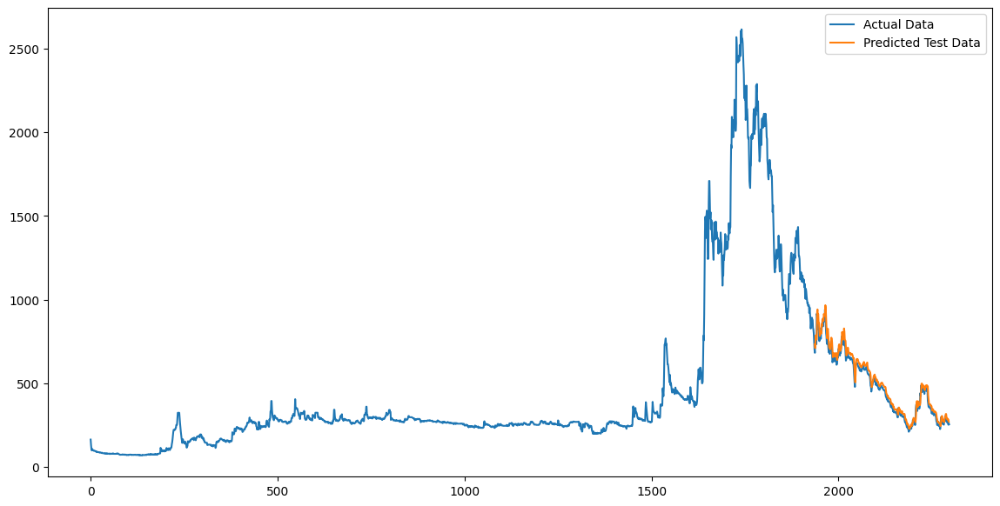

In [ ]:
# Membuat gambar (figure) dengan ukuran 14x7
plt.figure(figsize=(14, 7))
# Membuat plot garis untuk data aktual dengan label 'Actual Data'
plt.plot(bbyb_hist3, label='Actual Data')
# Membuat plot garis untuk data prediksi pada dengan label 'Predicted Test Data'
plt.plot(testPredictPlot_bbyb_gru, label='Predicted Test Data')
# Menambahkan legenda ke plot berdasarkan label-label yang telah ditentukan sebelumnya
plt.legend()
# Menampilkan plot
plt.show()

In [ ]:
# Fungsi menghitung MAPE
def mean_absolute_percentage_error(y_true, y_pred):
    y_true, y_pred = np.array(y_true), np.array(y_pred)
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100

In [ ]:
# Melihat Metric Evaluation RMSE dan MAPE
mape_gru1_bbyb = mean_absolute_percentage_error(Y_test_bbyb_gru,test_predict_bbyb_gru)
print("RMSE of GRU:", np.sqrt(mean_squared_error(Y_test_bbyb_gru,test_predict_bbyb_gru)))
print("MAPE of GRU:", mape_gru1_bbyb)

RMSE of GRU: 33.19616904774348
MAPE of GRU: 5.9879124880344925


### Kesimpulan Pemilihan Metode Terbaik

Berdasarkan performa dari tiap model dari ketiga algoritma (ARIMA, LSTM, dan GRU), masing-masing menghasilkan error sebesar:

**Bank BCA**:
1. Arima:
*   Baseline:
    - RMSE of ARIMA: 1249.262
    - MAPE of ARIMA: 12.275219207218138
2. LSTM:
*   Baseline:
    - RMSE of LSTM: 141.0205303531728
    - MAPE of LSTM: 2.052550994509955
3. GRU:
*   Baseline:
    - RMSE of GRU: 109.53143484889104
    - MAPE of GRU: 0.9449552383559471

**Bank BRI**:
1. Arima:
*   Baseline:
    - RMSE of ARIMA: 796.859
    - MAPE of ARIMA: 12.209126725948664
2. LSTM:
*   Baseline:
    - RMSE of LSTM: 127.90481256008732
    - MAPE of LSTM: 1.1387179781982288
3. GRU:
*   Baseline:
    - RMSE of GRU: 79.75696252504939
    - MAPE of GRU: 1.255699724540664

**Bank BYB**:
1. Arima:
*   Baseline:
    - RMSE of ARIMA: 730.141
    - MAPE of ARIMA: 165.18681097864572
2. LSTM:
*   Baseline:
    - RMSE of LSTM: 27.699469518554164
    - MAPE of LSTM: 3.6446933877815266
3. GRU:
*   Baseline:
    - RMSE of GRU: 33.19616904774348
    - MAPE of GRU: 5.9879124880344925

Dari evaluasi performa tiap model yang dilakukan pada tiga bank (BBCA, BBRI, BBYB) di atas, tim Metric Mestro akan menggunakan algoritma GRU (Gated Recurrent Unit) yang mana algoritma ini menunjukkan kestabilan lebih tinggi dibandingkan kedua algoritma yang lain (ARIMA dan LSTM).

## Modelling

Pada tahap modelling, kami akan membuat baseline model, melakukan Hyperparameter tuning & optimization serta melakukan forecasting harga saham pada semua bank.

### Bank Jago (ARTO)

#### Baseline Model

In [ ]:
# Mengambil kolom close
arto_hist2 = arto_hist['Close']

In [ ]:
# Train-Test Split
train_size = int(len(arto_hist2) * 0.80)
test_size = len(arto_hist2) - train_size
train_data_arto_gru, test_data_arto_gru = arto_hist2[:train_size], arto_hist2[train_size:]

# Scalling data
scaler = MinMaxScaler()
arto_hist2 = scaler.fit_transform(np.array(arto_hist2).reshape(-1,1))
train_data_arto_gru = scaler.fit_transform(np.array(train_data_arto_gru).reshape(-1, 1))
test_data_arto_gru = scaler.transform(np.array(test_data_arto_gru).reshape(-1, 1))

In [ ]:
def create_dataset(dataset, time_step = 1):
    dataX,dataY = [],[]
    for i in range(len(dataset)-time_step-1):
                   a = dataset[i:(i+time_step),0]
                   dataX.append(a)
                   dataY.append(dataset[i + time_step,0])
    return np.array(dataX),np.array(dataY)

In [ ]:
# Memanggil fungsi create_dataset untuk membagi data menjadi dataset input dan output dataset dengan times step 100
time_step = 100
X_train_arto_gru,Y_train_arto_gru =  create_dataset(train_data_arto_gru,time_step)
X_test_arto_gru,Y_test_arto_gru =  create_dataset(test_data_arto_gru,time_step)

In [ ]:
Y_train_arto_gru

array([2.43163435e-04, 2.43163435e-04, 2.43163435e-04, ...,
       5.58903459e-01, 5.78654050e-01, 5.78654050e-01])

In [ ]:
# Memeriksa value
print(X_train_arto_gru.shape)
print(X_train_arto_gru)
print(X_test_arto_gru.shape)
print(Y_test_arto_gru.shape)

(1535, 100)
[[4.40322874e-04 3.61459138e-04 2.56307391e-04 ... 2.49735413e-04
  2.49735413e-04 2.36591357e-04]
 [3.61459138e-04 2.56307391e-04 1.84015533e-04 ... 2.49735413e-04
  2.36591357e-04 2.43163435e-04]
 [2.56307391e-04 1.84015533e-04 1.44583665e-04 ... 2.36591357e-04
  2.43163435e-04 2.43163435e-04]
 ...
 [8.51212212e-01 8.68329391e-01 8.28828208e-01 ... 5.72070520e-01
  5.56270047e-01 5.62853577e-01]
 [8.68329391e-01 8.28828208e-01 8.30144914e-01 ... 5.56270047e-01
  5.62853577e-01 5.58903459e-01]
 [8.28828208e-01 8.30144914e-01 8.30144914e-01 ... 5.62853577e-01
  5.58903459e-01 5.78654050e-01]]
(308, 100)
(308,)


In [ ]:
# Tetapkan seed untuk inisialisasi acak
seed_value = 42
tf.random.set_seed(seed_value)
np.random.seed(seed_value)

# Membangun model GRU
model_arto_gru1 = tf.keras.Sequential([
      # Menambahkan layer GRU pertama dengan 50 unit dan pengembalian urutan yang digunakan untuk menjaga urutan output
      # Input_shape adalah bentuk input, yaitu jumlah langkah waktu (X_train_arto.shape[1]) dan fitur (1)
      tf.keras.layers.GRU(50, return_sequences=True, input_shape=(X_train_arto_gru.shape[1], 1)),
      # Menambahkan layer GRU kedua dengan 50 unit, tidak ada pengembalian urutan karena ini adalah lapisan terakhir LSTM
      tf.keras.layers.GRU(50),
      # Menambahkan layer Dense dengan 1 unit sebagai output layer
      tf.keras.layers.Dense(1)
])
# Mengompilasi model dengan loss function 'mean_squared_error' dan optimizer 'adam'
model_arto_gru1.compile(loss='mean_squared_error', optimizer='adam')

In [ ]:
# Melihat rangkuman model
model_arto_gru1.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 gru (GRU)                   (None, 100, 50)           7950      
                                                                 
 gru_1 (GRU)                 (None, 50)                15300     
                                                                 
 dense (Dense)               (None, 1)                 51        
                                                                 
Total params: 23301 (91.02 KB)
Trainable params: 23301 (91.02 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________


In [ ]:
# Menetapkan seed untuk TensorFlow untuk memastikan hasil yang konsisten dari operasi stokastik (jika ada)
tf.random.set_seed(seed_value)

# Melatih model menggunakan data pelatihan (X_train_arto dan Y_train_arto) dengan data validasi (X_test_arto dan Y_test_arto)
# Epochs adalah jumlah kali seluruh dataset akan diberikan kepada model selama proses pelatihan
# Batch_size adalah jumlah sampel data yang akan diproses sebelum pembaharuan bobot model
# verbose = 1 menghasilkan output detail pada setiap epoch selama pelatihan
model_arto_gru1.fit(X_train_arto_gru, Y_train_arto_gru, validation_data=(X_test_arto_gru, Y_test_arto_gru), epochs=50, batch_size=64, verbose=1)
model_arto_gru1.save("model_arto_gru1.h5")

Epoch 1/50
24/24 [==============================] - 10s 240ms/step - loss: 0.0155 - val_loss: 0.0016
Epoch 2/50
24/24 [==============================] - 3s 130ms/step - loss: 8.3790e-04 - val_loss: 1.2629e-04
Epoch 3/50
24/24 [==============================] - 5s 214ms/step - loss: 3.9851e-04 - val_loss: 1.3380e-04
Epoch 4/50
24/24 [==============================] - 5s 191ms/step - loss: 3.3249e-04 - val_loss: 9.8509e-05
Epoch 5/50
24/24 [==============================] - 4s 157ms/step - loss: 3.2500e-04 - val_loss: 8.1258e-05
Epoch 6/50
24/24 [==============================] - 3s 106ms/step - loss: 3.0974e-04 - val_loss: 1.2488e-04
Epoch 7/50
24/24 [==============================] - 3s 108ms/step - loss: 3.2338e-04 - val_loss: 8.4586e-05
Epoch 8/50
24/24 [==============================] - 3s 107ms/step - loss: 3.1369e-04 - val_loss: 7.6628e-05
Epoch 9/50
24/24 [==============================] - 3s 138ms/step - loss: 2.7283e-04 - val_loss: 8.0562e-05
Epoch 10/50
24/24 [================

In [ ]:
# Memprediksi data menggunakan model yang telah dilatih
train_predict_arto_gru = model_arto_gru1.predict(X_train_arto_gru)
test_predict_arto_gru = model_arto_gru1.predict(X_test_arto_gru)

10/10 [==============================] - 0s 21ms/step


In [ ]:
Y_train_arto_gru[:5]

array([0.00024316, 0.00024316, 0.00024316, 0.00024316, 0.00024316])

In [ ]:
train_predict_arto_gru[:5]

array([[0.00363886],
       [0.00363806],
       [0.0036382 ],
       [0.0036384 ],
       [0.00363853]], dtype=float32)

In [ ]:
# Transformasi data ke bentuk awal
Y_train_arto_gru = scaler.inverse_transform(Y_train_arto_gru.reshape(-1, 1))
Y_test_arto_gru = scaler.inverse_transform(Y_test_arto_gru.reshape(-1, 1))
train_predict_arto_gru = scaler.inverse_transform(train_predict_arto_gru)
test_predict_arto_gru = scaler.inverse_transform(test_predict_arto_gru)

In [ ]:
Y_test_arto_gru[:5]

array([[3580.],
       [3520.],
       [3510.],
       [3720.],
       [3630.]])

In [ ]:
Y_test_arto_gru[:5]

array([[3580.],
       [3520.],
       [3510.],
       [3720.],
       [3630.]])

In [ ]:
# Mendefinisikan jumlah langkah waktu sebelumnya yang akan digunakan sebagai input untuk memprediksi langkah waktu saat ini
look_back = 100

# Membuat array kosong dengan ukuran yang sama dengan arto_hist2
trainPredictPlot_arto = np.empty_like(arto_hist2)
# Mengisi array dengan nilai yang sama dengan NaN (untuk plot)
trainPredictPlot_arto[:,:] = np.nan
# Mengisi bagian dari array dengan hasil prediksi pada data pelatihan
# Menempatkan hasil prediksi pada posisi yang sesuai dalam array untuk plotting
trainPredictPlot_arto[look_back : len(train_predict_arto_gru)+look_back,:] = train_predict_arto_gru

# Membuat array kosong dengan ukuran yang sama dengan arto_hist2
testPredictPlot_arto_gru = np.empty_like(arto_hist2)
# Mengisi array dengan nilai yang sama dengan NaN (untuk plot)
testPredictPlot_arto_gru[:,:] = np.nan
# Mengisi bagian dari array dengan hasil prediksi pada data uji
# Menempatkan hasil prediksi pada posisi yang sesuai dalam array untuk plotting
testPredictPlot_arto_gru[len(train_predict_arto_gru) + (look_back) * 2 + 1 : len(arto_hist2) - 1, :] = test_predict_arto_gru

In [ ]:
# Mengambil data harga saham close dan dijadikan dalam bentuk array numpy
arto_hist3=arto_hist['Close'].to_numpy()

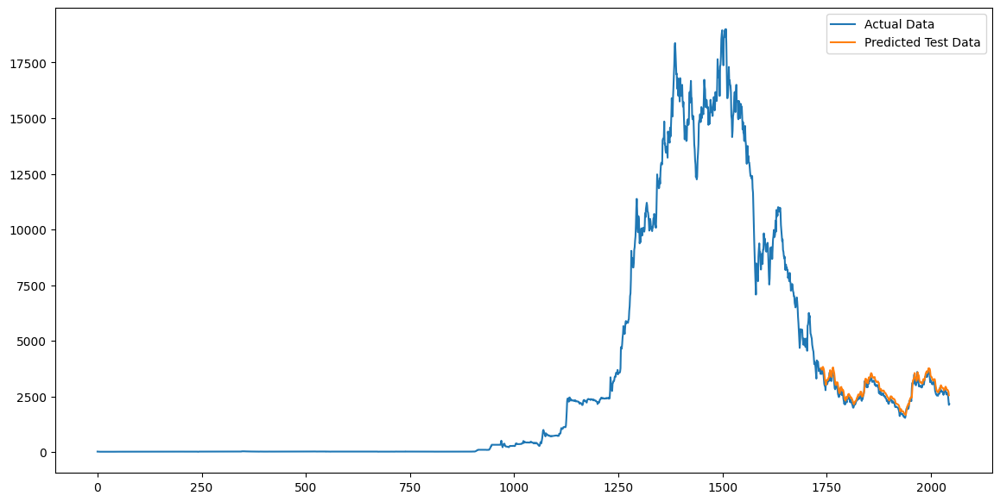

In [ ]:
# Membuat gambar (figure) dengan ukuran 14x7
plt.figure(figsize=(14, 7))
# Membuat plot garis untuk data aktual dengan label 'Actual Data'
plt.plot(arto_hist3, label='Actual Data')
# Membuat plot garis untuk data prediksi pada dengan label 'Predicted Test Data'
plt.plot(testPredictPlot_arto_gru, label='Predicted Test Data')
# Menambahkan legenda ke plot berdasarkan label-label yang telah ditentukan sebelumnya
plt.legend()
# Menampilkan plot
plt.show()

In [ ]:
# Fungsi menghitung MAPE
def mean_absolute_percentage_error(y_true, y_pred):
    y_true, y_pred = np.array(y_true), np.array(y_pred)
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100

In [ ]:
# Melihat Metric Evaluation RMSE dan MAPE
mape_gru1_arto = mean_absolute_percentage_error(Y_test_arto_gru,test_predict_arto_gru)
print("RMSE of GRU:", np.sqrt(mean_squared_error(Y_test_arto_gru,test_predict_arto_gru)))
print("MAPE of GRU:", mape_gru1_arto)

RMSE of GRU: 209.12948577929166
MAPE of GRU: 6.945381660408668


#### Hyperparameter Tuning & Optimization Model using 3 Layers - Best Model

In [ ]:
# Mengambil kolom close
arto_hist2 = arto_hist['Close']

In [ ]:
# Train-Test Split
train_size = int(len(arto_hist2) * 0.80)
test_size = len(arto_hist2) - train_size
train_data_arto_gru, test_data_arto_gru = arto_hist2[:train_size], arto_hist2[train_size:]

# Scalling data
scaler = MinMaxScaler()
arto_hist2 = scaler.fit_transform(np.array(arto_hist2).reshape(-1,1))
train_data_arto_gru = scaler.fit_transform(np.array(train_data_arto_gru).reshape(-1, 1))
test_data_arto_gru = scaler.transform(np.array(test_data_arto_gru).reshape(-1, 1))

In [ ]:
def create_dataset(dataset, time_step = 1):
    dataX,dataY = [],[]
    for i in range(len(dataset)-time_step-1):
                   a = dataset[i:(i+time_step),0]
                   dataX.append(a)
                   dataY.append(dataset[i + time_step,0])
    return np.array(dataX),np.array(dataY)

In [ ]:
# Memanggil fungsi create_dataset untuk membagi data menjadi dataset input dan output dataset dengan times step 100
time_step = 100
X_train_arto_gru,Y_train_arto_gru =  create_dataset(train_data_arto_gru,time_step)
X_test_arto_gru,Y_test_arto_gru =  create_dataset(test_data_arto_gru,time_step)

In [ ]:
Y_train_arto_gru

array([2.43163435e-04, 2.43163435e-04, 2.43163435e-04, ...,
       5.58903459e-01, 5.78654050e-01, 5.78654050e-01])

In [ ]:
# Memeriksa value
print(X_train_arto_gru.shape)
print(X_train_arto_gru)
print(X_test_arto_gru.shape)
print(Y_test_arto_gru.shape)

(1535, 100)
[[4.40322874e-04 3.61459138e-04 2.56307391e-04 ... 2.49735413e-04
  2.49735413e-04 2.36591357e-04]
 [3.61459138e-04 2.56307391e-04 1.84015533e-04 ... 2.49735413e-04
  2.36591357e-04 2.43163435e-04]
 [2.56307391e-04 1.84015533e-04 1.44583665e-04 ... 2.36591357e-04
  2.43163435e-04 2.43163435e-04]
 ...
 [8.51212212e-01 8.68329391e-01 8.28828208e-01 ... 5.72070520e-01
  5.56270047e-01 5.62853577e-01]
 [8.68329391e-01 8.28828208e-01 8.30144914e-01 ... 5.56270047e-01
  5.62853577e-01 5.58903459e-01]
 [8.28828208e-01 8.30144914e-01 8.30144914e-01 ... 5.62853577e-01
  5.58903459e-01 5.78654050e-01]]
(308, 100)
(308,)


In [ ]:
# Tetapkan seed untuk inisialisasi acak
seed_value = 42
tf.random.set_seed(seed_value)
np.random.seed(seed_value)

# Definisikan fungsi untuk membuat model GRU dengan hyperparameter
def build_model_l3(hp):
    model = tf.keras.Sequential()
    model.add(tf.keras.layers.GRU(
        units=hp.Int('units_1', min_value=50, max_value=100, step=10),
        return_sequences=True,
        input_shape=(X_train_arto_gru.shape[1], 1)
    ))
    model.add(tf.keras.layers.GRU(
        units=hp.Int('units_2', min_value=50, max_value=100, step=10)
    ))
    model.add(tf.keras.layers.Dense(1))

    model.compile(
        optimizer=tf.keras.optimizers.Adam(
            hp.Choice('learning_rate', values=[1e-2, 1e-3, 1e-4])
        ),
        loss='mean_squared_error'
    )
    return model


In [ ]:
# Atur pencarian hyperparameter menggunakan RandomSearch
tuner = RandomSearch(
    build_model_l3,
    objective='val_loss',
    max_trials=10,  # Jumlah percobaan untuk menemukan kombinasi hyperparameter terbaik
    executions_per_trial=1,  # Jumlah eksekusi per percobaan untuk akurasi lebih baik
    directory='hyperparameter_tuning_l3',
    project_name='gru_tuning_l3'
)

# Tentukan data pelatihan dan validasi
tuner.search(X_train_arto_gru, Y_train_arto_gru, validation_data=(X_test_arto_gru, Y_test_arto_gru), epochs=30, batch_size=64, verbose=1)

# Mendapatkan hasil terbaik
best_hps_l3 = tuner.get_best_hyperparameters(num_trials=1)[0]

# Membangun model dengan hyperparameter terbaik
model_arto_gru_l3 = build_model_l3(best_hps_l3)

Trial 10 Complete [00h 03m 52s]
val_loss: 5.4838063078932464e-05

Best val_loss So Far: 3.941274917451665e-05
Total elapsed time: 00h 31m 01s


In [ ]:
print(best_hps_l3)

In [ ]:
# Melihat rangkuman model
model_arto_gru_l3.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 gru_2 (GRU)                 (None, 100, 60)           11340     
                                                                 
 gru_3 (GRU)                 (None, 50)                16800     
                                                                 
 dense_1 (Dense)             (None, 1)                 51        
                                                                 
Total params: 28191 (110.12 KB)
Trainable params: 28191 (110.12 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________


In [ ]:
# Menetapkan seed untuk TensorFlow untuk memastikan hasil yang konsisten dari operasi stokastik (jika ada)
tf.random.set_seed(seed_value)

# Melatih model menggunakan data pelatihan (X_train_arto dan Y_train_arto) dengan data validasi (X_test_arto dan Y_test_arto)
# Epochs adalah jumlah kali seluruh dataset akan diberikan kepada model selama proses pelatihan
# Batch_size adalah jumlah sampel data yang akan diproses sebelum pembaharuan bobot model
# verbose = 1 menghasilkan output detail pada setiap epoch selama pelatihan
model_arto_gru_l3.fit(X_train_arto_gru, Y_train_arto_gru, validation_data=(X_test_arto_gru, Y_test_arto_gru), epochs=50, batch_size=64, verbose=1)
model_arto_gru_l3.save("/content/drive/MyDrive/Saved Models/model_arto_gru_l3.h5")

Epoch 1/50
24/24 [==============================] - 19s 477ms/step - loss: 0.0121 - val_loss: 2.1999e-04
Epoch 2/50
24/24 [==============================] - 7s 293ms/step - loss: 3.7206e-04 - val_loss: 7.4112e-05
Epoch 3/50
24/24 [==============================] - 7s 290ms/step - loss: 1.9056e-04 - val_loss: 4.1124e-05
Epoch 4/50
24/24 [==============================] - 6s 257ms/step - loss: 1.7469e-04 - val_loss: 5.2865e-05
Epoch 5/50
24/24 [==============================] - 3s 121ms/step - loss: 1.6454e-04 - val_loss: 4.2055e-05
Epoch 6/50
24/24 [==============================] - 3s 120ms/step - loss: 2.1178e-04 - val_loss: 5.9597e-05
Epoch 7/50
24/24 [==============================] - 5s 206ms/step - loss: 2.6884e-04 - val_loss: 1.0016e-04
Epoch 8/50
24/24 [==============================] - 3s 136ms/step - loss: 1.6964e-04 - val_loss: 4.4860e-05
Epoch 9/50
24/24 [==============================] - 3s 131ms/step - loss: 1.6173e-04 - val_loss: 9.0935e-05
Epoch 10/50
24/24 [============

In [ ]:
# Memprediksi data menggunakan model yang telah dilatih
train_predict_arto_gru = model_arto_gru_l3.predict(X_train_arto_gru)
test_predict_arto_gru = model_arto_gru_l3.predict(X_test_arto_gru)

10/10 [==============================] - 0s 24ms/step


In [ ]:
Y_train_arto_gru[:5]

array([0.00024316, 0.00024316, 0.00024316, 0.00024316, 0.00024316])

In [ ]:
train_predict_arto_gru[:5]

array([[0.0020905 ],
       [0.00209833],
       [0.00209993],
       [0.00209841],
       [0.00209806]], dtype=float32)

In [ ]:
# Transformasi data ke bentuk awal
Y_train_arto_gru = scaler.inverse_transform(Y_train_arto_gru.reshape(-1, 1))
Y_test_arto_gru = scaler.inverse_transform(Y_test_arto_gru.reshape(-1, 1))
train_predict_arto_gru = scaler.inverse_transform(train_predict_arto_gru)
test_predict_arto_gru = scaler.inverse_transform(test_predict_arto_gru)

In [ ]:
Y_test_arto_gru[:5]

array([[3580.],
       [3520.],
       [3510.],
       [3720.],
       [3630.]])

In [ ]:
Y_test_arto_gru[:5]

array([[3580.],
       [3520.],
       [3510.],
       [3720.],
       [3630.]])

In [ ]:
# Mendefinisikan jumlah langkah waktu sebelumnya yang akan digunakan sebagai input untuk memprediksi langkah waktu saat ini
look_back = 100

# Membuat array kosong dengan ukuran yang sama dengan arto_hist2
trainPredictPlot_arto = np.empty_like(arto_hist2)
# Mengisi array dengan nilai yang sama dengan NaN (untuk plot)
trainPredictPlot_arto[:,:] = np.nan
# Mengisi bagian dari array dengan hasil prediksi pada data pelatihan
# Menempatkan hasil prediksi pada posisi yang sesuai dalam array untuk plotting
trainPredictPlot_arto[look_back : len(train_predict_arto_gru)+look_back,:] = train_predict_arto_gru

# Membuat array kosong dengan ukuran yang sama dengan arto_hist2
testPredictPlot_arto_gru = np.empty_like(arto_hist2)
# Mengisi array dengan nilai yang sama dengan NaN (untuk plot)
testPredictPlot_arto_gru[:,:] = np.nan
# Mengisi bagian dari array dengan hasil prediksi pada data uji
# Menempatkan hasil prediksi pada posisi yang sesuai dalam array untuk plotting
testPredictPlot_arto_gru[len(train_predict_arto_gru) + (look_back) * 2 + 1 : len(arto_hist2) - 1, :] = test_predict_arto_gru

In [ ]:
# Mengambil data harga saham close dan dijadikan dalam bentuk array numpy
arto_hist3=arto_hist['Close'].to_numpy()

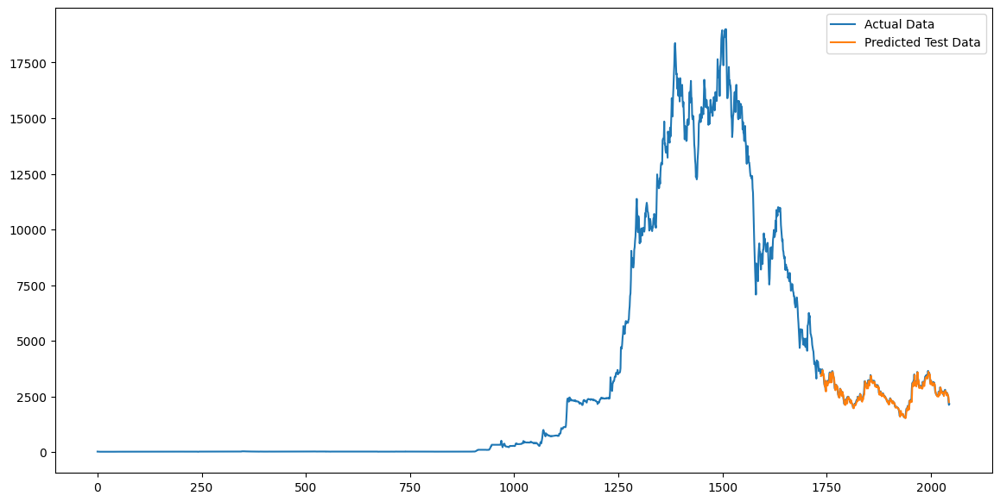

In [ ]:
# Membuat gambar (figure) dengan ukuran 14x7
plt.figure(figsize=(14, 7))
# Membuat plot garis untuk data aktual dengan label 'Actual Data'
plt.plot(arto_hist3, label='Actual Data')
# Membuat plot garis untuk data prediksi pada dengan label 'Predicted Test Data'
plt.plot(testPredictPlot_arto_gru, label='Predicted Test Data')
# Menambahkan legenda ke plot berdasarkan label-label yang telah ditentukan sebelumnya
plt.legend()
# Menampilkan plot
plt.show()

In [ ]:
# Fungsi menghitung MAPE
def mean_absolute_percentage_error(y_true, y_pred):
    y_true, y_pred = np.array(y_true), np.array(y_pred)
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100

In [ ]:
# Melihat Metric Evaluation RMSE dan MAPE
mape_gru_l3_arto = mean_absolute_percentage_error(Y_test_arto_gru,test_predict_arto_gru)
print("RMSE of gru:", np.sqrt(mean_squared_error(Y_test_arto_gru,test_predict_arto_gru)))
print("MAPE of gru:", mape_gru_l3_arto)

RMSE of gru: 125.09832787957707
MAPE of gru: 3.1207640285666147


#### Hyperparameter Tuning & Optimization Model using 6 Layers - Worst Model

In [ ]:
# Mengambil kolom close
arto_hist2 = arto_hist['Close']

In [ ]:
# Train-Test Split
train_size = int(len(arto_hist2) * 0.80)
test_size = len(arto_hist2) - train_size
train_data_arto_gru, test_data_arto_gru = arto_hist2[:train_size], arto_hist2[train_size:]

# Scalling data
scaler = MinMaxScaler()
arto_hist2 = scaler.fit_transform(np.array(arto_hist2).reshape(-1,1))
train_data_arto_gru = scaler.fit_transform(np.array(train_data_arto_gru).reshape(-1, 1))
test_data_arto_gru = scaler.transform(np.array(test_data_arto_gru).reshape(-1, 1))

In [ ]:
def create_dataset(dataset, time_step = 1):
    dataX,dataY = [],[]
    for i in range(len(dataset)-time_step-1):
                   a = dataset[i:(i+time_step),0]
                   dataX.append(a)
                   dataY.append(dataset[i + time_step,0])
    return np.array(dataX),np.array(dataY)

In [ ]:
# Memanggil fungsi create_dataset untuk membagi data menjadi dataset input dan output dataset dengan times step 100
time_step = 100
X_train_arto_gru,Y_train_arto_gru =  create_dataset(train_data_arto_gru,time_step)
X_test_arto_gru,Y_test_arto_gru =  create_dataset(test_data_arto_gru,time_step)

In [ ]:
Y_train_arto_gru

array([2.43163435e-04, 2.43163435e-04, 2.43163435e-04, ...,
       5.58903459e-01, 5.78654050e-01, 5.78654050e-01])

In [ ]:
# Memeriksa value
print(X_train_arto_gru.shape)
print(X_train_arto_gru)
print(X_test_arto_gru.shape)
print(Y_test_arto_gru.shape)

(1535, 100)
[[4.40322874e-04 3.61459138e-04 2.56307391e-04 ... 2.49735413e-04
  2.49735413e-04 2.36591357e-04]
 [3.61459138e-04 2.56307391e-04 1.84015533e-04 ... 2.49735413e-04
  2.36591357e-04 2.43163435e-04]
 [2.56307391e-04 1.84015533e-04 1.44583665e-04 ... 2.36591357e-04
  2.43163435e-04 2.43163435e-04]
 ...
 [8.51212212e-01 8.68329391e-01 8.28828208e-01 ... 5.72070520e-01
  5.56270047e-01 5.62853577e-01]
 [8.68329391e-01 8.28828208e-01 8.30144914e-01 ... 5.56270047e-01
  5.62853577e-01 5.58903459e-01]
 [8.28828208e-01 8.30144914e-01 8.30144914e-01 ... 5.62853577e-01
  5.58903459e-01 5.78654050e-01]]
(308, 100)
(308,)


In [ ]:
# Tetapkan seed untuk inisialisasi acak
seed_value = 42
tf.random.set_seed(seed_value)
np.random.seed(seed_value)

# Definisikan fungsi untuk membuat model GRU dengan hyperparameter
def build_model_l6(hp):
    model = tf.keras.Sequential()
    model.add(tf.keras.layers.GRU(
        units=hp.Int('units_1', min_value=50, max_value=200, step=50),
        return_sequences=True,
        input_shape=(X_train_arto_gru.shape[1], 1)
    ))
    model.add(tf.keras.layers.GRU(
        units=hp.Int('units_2', min_value=50, max_value=200, step=50),
        return_sequences=True
    ))
    model.add(tf.keras.layers.GRU(
        units=hp.Int('units_3', min_value=50, max_value=200, step=50),
        return_sequences=True
    ))
    model.add(tf.keras.layers.GRU(
        units=hp.Int('units_4', min_value=50, max_value=200, step=50),
        return_sequences=True
    ))
    model.add(tf.keras.layers.GRU(
        units=hp.Int('units_5', min_value=50, max_value=200, step=50)
    ))
    model.add(tf.keras.layers.Dense(1))

    model.compile(
        optimizer=tf.keras.optimizers.Adam(
            hp.Choice('learning_rate', values=[1e-2, 1e-3, 1e-4])
        ),
        loss='mean_squared_error'
    )
    return model


In [ ]:
# Atur pencarian hyperparameter menggunakan RandomSearch
tuner = RandomSearch(
    build_model_l6,
    objective='val_loss',
    max_trials=10,  # Jumlah percobaan untuk menemukan kombinasi hyperparameter terbaik
    executions_per_trial=1,  # Jumlah eksekusi per percobaan untuk akurasi lebih baik
    directory='hyperparameter_tuning_l6',
    project_name='gru_tuning_l6'
)

# Tentukan data pelatihan dan validasi
tuner.search(X_train_arto_gru, Y_train_arto_gru, validation_data=(X_test_arto_gru, Y_test_arto_gru), epochs=30, batch_size=66, verbose=1)

# Mendapatkan hasil terbaik
best_hps_l6 = tuner.get_best_hyperparameters(num_trials=1)[0]

# Membangun model dengan hyperparameter terbaik
model_arto_gru_l6 = build_model_l6(best_hps_l6)

Trial 10 Complete [00h 08m 27s]
val_loss: 7.163605914684013e-05

Best val_loss So Far: 4.38870774814859e-05
Total elapsed time: 02h 13m 27s


In [ ]:
print(best_hps_l6)

In [ ]:
# Melihat rangkuman model
model_arto_gru_l6.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 gru_5 (GRU)                 (None, 100, 100)          30900     
                                                                 
 gru_6 (GRU)                 (None, 100, 50)           22800     
                                                                 
 gru_7 (GRU)                 (None, 100, 50)           15300     
                                                                 
 gru_8 (GRU)                 (None, 100, 100)          45600     
                                                                 
 gru_9 (GRU)                 (None, 100)               60600     
                                                                 
 dense_1 (Dense)             (None, 1)                 101       
                                                                 
Total params: 175301 (684.77 KB)
Trainable params: 175

In [ ]:
# Menetapkan seed untuk TensorFlow untuk memastikan hasil yang konsisten dari operasi stokastik (jika ada)
tf.random.set_seed(seed_value)

# Melatih model menggunakan data pelatihan (X_train_arto dan Y_train_arto) dengan data validasi (X_test_arto dan Y_test_arto)
# Epochs adalah jumlah kali seluruh dataset akan diberikan kepada model selama proses pelatihan
# Batch_size adalah jumlah sampel data yang akan diproses sebelum pembaharuan bobot model
# verbose = 1 menghasilkan output detail pada setiap epoch selama pelatihan
model_arto_gru_l6.fit(X_train_arto_gru, Y_train_arto_gru, validation_data=(X_test_arto_gru, Y_test_arto_gru), epochs=50, batch_size=64, verbose=1)
model_arto_gru_l6.save("/content/drive/MyDrive/Saved Models/model_arto_gru_l6.h5")

Epoch 1/50
24/24 [==============================] - 28s 738ms/step - loss: 0.3768 - val_loss: 0.0012
Epoch 2/50
24/24 [==============================] - 16s 659ms/step - loss: 0.0029 - val_loss: 0.0013
Epoch 3/50
24/24 [==============================] - 16s 657ms/step - loss: 5.7187e-04 - val_loss: 1.4833e-04
Epoch 4/50
24/24 [==============================] - 17s 698ms/step - loss: 3.3064e-04 - val_loss: 1.2071e-04
Epoch 5/50
24/24 [==============================] - 18s 779ms/step - loss: 2.3255e-04 - val_loss: 7.0376e-05
Epoch 6/50
24/24 [==============================] - 15s 646ms/step - loss: 2.2087e-04 - val_loss: 6.4769e-05
Epoch 7/50
24/24 [==============================] - 16s 665ms/step - loss: 2.3651e-04 - val_loss: 8.7359e-05
Epoch 8/50
24/24 [==============================] - 16s 659ms/step - loss: 2.2340e-04 - val_loss: 6.1254e-05
Epoch 9/50
24/24 [==============================] - 16s 691ms/step - loss: 1.8950e-04 - val_loss: 7.1934e-05
Epoch 10/50
24/24 [================

In [ ]:
# Memprediksi data menggunakan model yang telah dilatih
train_predict_arto_gru = model_arto_gru_l6.predict(X_train_arto_gru)
test_predict_arto_gru = model_arto_gru_l6.predict(X_test_arto_gru)

10/10 [==============================] - 2s 158ms/step


In [ ]:
Y_train_arto_gru[:5]

array([0.00024316, 0.00024316, 0.00024316, 0.00024316, 0.00024316])

In [ ]:
train_predict_arto_gru[:5]

array([[0.01413965],
       [0.01414077],
       [0.0141431 ],
       [0.01414265],
       [0.01414113]], dtype=float32)

In [ ]:
# Transformasi data ke bentuk awal
Y_train_arto_gru = scaler.inverse_transform(Y_train_arto_gru.reshape(-1, 1))
Y_test_arto_gru = scaler.inverse_transform(Y_test_arto_gru.reshape(-1, 1))
train_predict_arto_gru = scaler.inverse_transform(train_predict_arto_gru)
test_predict_arto_gru = scaler.inverse_transform(test_predict_arto_gru)

In [ ]:
Y_test_arto_gru[:5]

array([[3580.],
       [3520.],
       [3510.],
       [3720.],
       [3630.]])

In [ ]:
test_predict_arto_gru[:5]

array([[3694.6396],
       [3725.126 ],
       [3725.983 ],
       [3703.2698],
       [3856.7139]], dtype=float32)

In [ ]:
# Mendefinisikan jumlah langkah waktu sebelumnya yang akan digunakan sebagai input untuk memprediksi langkah waktu saat ini
look_back = 100

# Membuat array kosong dengan ukuran yang sama dengan arto_hist2
trainPredictPlot_arto = np.empty_like(arto_hist2)
# Mengisi array dengan nilai yang sama dengan NaN (untuk plot)
trainPredictPlot_arto[:,:] = np.nan
# Mengisi bagian dari array dengan hasil prediksi pada data pelatihan
# Menempatkan hasil prediksi pada posisi yang sesuai dalam array untuk plotting
trainPredictPlot_arto[look_back : len(train_predict_arto_gru)+look_back,:] = train_predict_arto_gru

# Membuat array kosong dengan ukuran yang sama dengan arto_hist2
testPredictPlot_arto_gru = np.empty_like(arto_hist2)
# Mengisi array dengan nilai yang sama dengan NaN (untuk plot)
testPredictPlot_arto_gru[:,:] = np.nan
# Mengisi bagian dari array dengan hasil prediksi pada data uji
# Menempatkan hasil prediksi pada posisi yang sesuai dalam array untuk plotting
testPredictPlot_arto_gru[len(train_predict_arto_gru) + (look_back) * 2 + 1 : len(arto_hist2) - 1, :] = test_predict_arto_gru

In [ ]:
# Mengambil data harga saham close dan dijadikan dalam bentuk array numpy
arto_hist3=arto_hist['Close'].to_numpy()

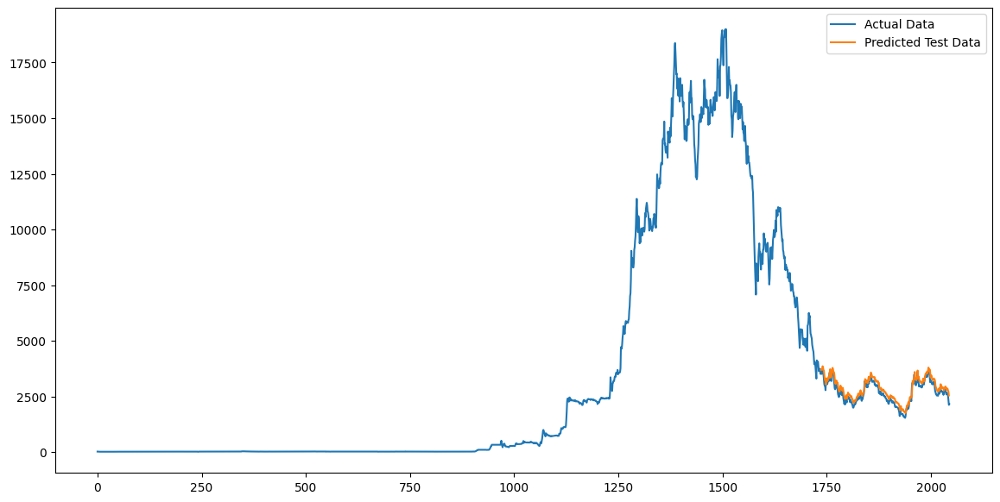

In [ ]:
# Membuat gambar (figure) dengan ukuran 14x7
plt.figure(figsize=(14, 7))
# Membuat plot garis untuk data aktual dengan label 'Actual Data'
plt.plot(arto_hist3, label='Actual Data')
# Membuat plot garis untuk data prediksi pada dengan label 'Predicted Test Data'
plt.plot(testPredictPlot_arto_gru, label='Predicted Test Data')
# Menambahkan legenda ke plot berdasarkan label-label yang telah ditentukan sebelumnya
plt.legend()
# Menampilkan plot
plt.show()

In [ ]:
# Fungsi menghitung MAPE
def mean_absolute_percentage_error(y_true, y_pred):
    y_true, y_pred = np.array(y_true), np.array(y_pred)
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100

In [ ]:
# Melihat Metric Evaluation RMSE dan MAPE
mape_gru_l6_arto = mean_absolute_percentage_error(Y_test_arto_gru,test_predict_arto_gru)
print("RMSE of gru:", np.sqrt(mean_squared_error(Y_test_arto_gru,test_predict_arto_gru)))
print("MAPE of gru:", mape_gru_l6_arto)

RMSE of gru: 220.1364570218213
MAPE of gru: 7.747774089761739


#### Forecasting using Best Model

Setelah diperoleh model terbaik yaitu GRU dengan 3 layer yaitu:
1. Input layer dengan 60 unit neuron
2. Hidden layer dengan 50 unit neuron
3. Output layer Dense dengan 1 unit neuron

akan dilakukan prediksi harga saham ARTO 30 hari ke depan menggunakan model tersebut.

In [ ]:
# Mengambil kolom close
arto_hist2 = arto_hist['Close']

In [ ]:
# Train-Test Split
train_size = int(len(arto_hist2) * 0.80)
test_size = len(arto_hist2) - train_size
train_data_arto_gru, test_data_arto_gru = arto_hist2[:train_size], arto_hist2[train_size:]

In [ ]:
test_data_arto_gru.head()

Date
2022-08-08    10800.0
2022-08-09    10825.0
2022-08-10    10975.0
2022-08-11    10775.0
2022-08-12    10200.0
Name: Close, dtype: float64

In [ ]:
import numpy as np
import pandas as pd
from tensorflow.keras.models import load_model
from sklearn.preprocessing import MinMaxScaler

# Contoh data, ganti dengan data Anda sendiri
df_arto = test_data_arto_gru.copy()

# Menampilkan 5 baris pertama dari DataFrame
print("DataFrame awal:")
print(df_arto.head())

# Menampilkan 5 baris terakhir dari DataFrame
print("\nDataFrame akhir:")
print(df_arto.tail())

# 1. Load model
model_arto = load_model('/content/drive/MyDrive/Saved Models/model_arto_gru_l3.h5')

# 2. Prepare data (gunakan data dari 100 hari terakhir)
last_n_days = 100  # Menggunakan 100 hari terakhir sesuai kebutuhan model
data_to_predict_arto = arto_hist['Close'][-last_n_days:].values

# 3. Scaling data (misalnya menggunakan MinMaxScaler)
scaler = MinMaxScaler(feature_range=(0, 1))
data_to_predict_scaled = scaler.fit_transform(data_to_predict_arto.reshape(-1, 1))

# 4. Reshape data
data_to_predict_arto_scaled = np.reshape(data_to_predict_scaled, (1, last_n_days, 1))

# 5. Predict multiple days into the future
n_days_to_predict = 30
predictions_arto = []

for i in range(n_days_to_predict):
    # Predict
    predicted_scaled_arto = model_arto.predict(data_to_predict_arto_scaled)
    predicted_arto = scaler.inverse_transform(predicted_scaled_arto)

    # Save prediction
    predictions_arto.append(predicted_arto[0][0])

    # Update data_to_predict_scaled for the next prediction
    data_to_predict_arto_scaled = np.append(data_to_predict_arto_scaled[:, 1:, :], np.reshape(predicted_scaled_arto, (1, 1, 1)), axis=1)

# Print the predicted values
print("\nPredicted values for the next days:")
print(predictions_arto)

# Mendapatkan tanggal terakhir dari data asli
last_date = arto_hist.index[-1]

# Membuat rangkaian tanggal hari kerja untuk hasil prediksi
prediction_dates = pd.date_range(start=last_date + pd.Timedelta(days=1), periods=n_days_to_predict, freq='B')

# Membuat DataFrame baru untuk hasil prediksi
prediction_df_arto = pd.DataFrame({'Date': prediction_dates, 'Predicted_Close': predictions_arto})

# Menampilkan DataFrame prediksi
print("\nPrediction DataFrame:")
print(prediction_df_arto)


DataFrame awal:
Date
2022-08-08    10800.0
2022-08-09    10825.0
2022-08-10    10975.0
2022-08-11    10775.0
2022-08-12    10200.0
Name: Close, dtype: float64

DataFrame akhir:
Date
2024-04-04    2580.0
2024-04-05    2530.0
2024-04-16    2300.0
2024-04-17    2120.0
2024-04-18    2160.0
Name: Close, dtype: float64
1/1 [==============================] - 0s 55ms/step

Predicted values for the next days:
[2168.1282, 2187.285, 2188.8462, 2182.1074, 2175.1265, 2170.329, 2166.9365, 2163.8716, 2160.7075, 2157.4714, 2154.2854, 2151.2104, 2148.2488, 2145.3833, 2142.6025, 2139.9023, 2137.2815, 2134.7393, 2132.2734, 2129.882, 2127.5625, 2125.313, 2123.1313, 2121.0154, 2118.9634, 2116.9736, 2115.0442, 2113.173, 2111.3591, 2109.6]

Prediction DataFrame:
         Date  Predicted_Close
0  2024-04-19      2168.128174
1  2024-04-22      2187.284912
2  2024-04-23      2188.846191
3  2024-04-24      2182.107422
4  2024-04-25      2175.126465
5  2024-04-26      2170.329102
6  2024-04-29      2166.936523
7 

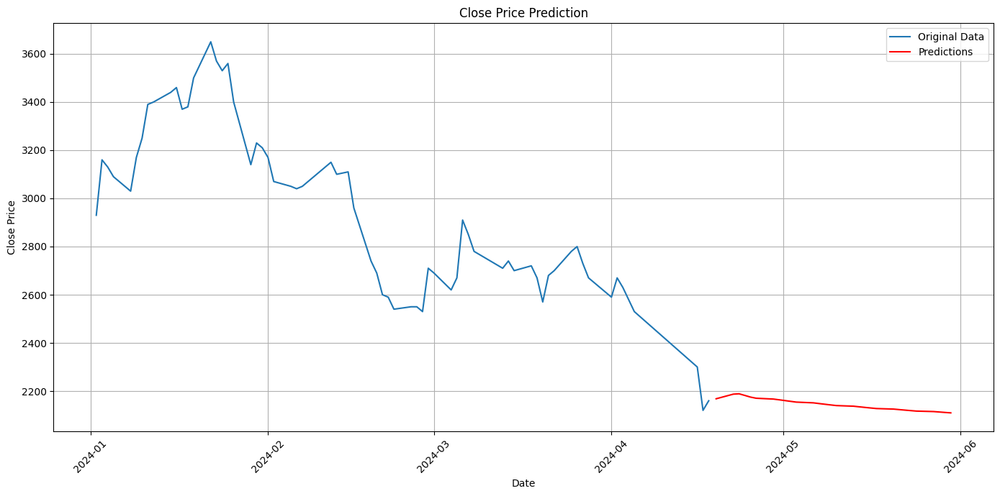

In [ ]:
# Plotting the results
plt.figure(figsize=(14, 7))
# Plot the original data
plt.plot(arto_hist[arto_hist['Date'] > '2024-01-01']['Date'], arto_hist[arto_hist['Date'] > '2024-01-01']['Close'], label='Original Data')
# Plot the predictions
plt.plot(prediction_df_arto['Date'], prediction_df_arto['Predicted_Close'], label='Predictions', color='red')
# Formatting the plot
plt.xlabel('Date')
plt.ylabel('Close Price')
plt.title('Close Price Prediction')
plt.legend()
plt.grid(True)
plt.xticks(rotation=45)
plt.tight_layout()
# Display the plot
plt.show()

Dari hasil prediksi di atas, dapat diketahui bahwa dalam 30 hari ke depan, harga saham bank JAGO akan sedikit menurun.

### Bank Aladin Syariah (BANK)

#### Baseline Model

In [ ]:
# Mengambil kolom close
bank_hist2 = bank_hist['Close']

In [ ]:
# Train-Test Split
train_size = int(len(bank_hist2) * 0.80)
test_size = len(bank_hist2) - train_size
train_data_bank_gru, test_data_bank_gru = bank_hist2[:train_size], bank_hist2[train_size:]

# Scalling data
scaler = MinMaxScaler()
bank_hist2 = scaler.fit_transform(np.array(bank_hist2).reshape(-1,1))
train_data_bank_gru = scaler.fit_transform(np.array(train_data_bank_gru).reshape(-1, 1))
test_data_bank_gru = scaler.transform(np.array(test_data_bank_gru).reshape(-1, 1))

In [ ]:
def create_dataset(dataset, time_step = 1):
    dataX,dataY = [],[]
    for i in range(len(dataset)-time_step-1):
                   a = dataset[i:(i+time_step),0]
                   dataX.append(a)
                   dataY.append(dataset[i + time_step,0])
    return np.array(dataX),np.array(dataY)

In [ ]:
# Memanggil fungsi create_dataset untuk membagi data menjadi dataset input dan output dataset dengan times step 100
time_step = 100
X_train_bank_gru,Y_train_bank_gru =  create_dataset(train_data_bank_gru,time_step)
X_test_bank_gru,Y_test_bank_gru =  create_dataset(test_data_bank_gru,time_step)

In [ ]:
Y_train_bank_gru

array([0.81626586, 0.82707375, 0.88651717, 0.94866254, 0.91894079,
       0.90813297, 0.90272902, 0.90813297, 0.85409349, 0.85409349,
       0.85409349, 0.84058366, 0.82707375, 0.8324777 , 0.83517971,
       0.82977576, 0.84328559, 0.84868954, 0.87300727, 0.89462306,
       0.87030533, 0.88921911, 0.87841122, 0.86760332, 0.86760332,
       0.9216428 , 1.        , 0.99189404, 0.96217237, 0.94866254,
       0.97027833, 0.97568227, 0.96217237, 0.96757631, 0.95676842,
       0.93785464, 0.93245069, 0.89462306, 0.85949744, 0.87841122,
       0.86760332, 0.8324777 , 0.80275602, 0.83517971, 0.80545796,
       0.80815997, 0.78924612, 0.79735208, 0.81086191, 0.8216698 ,
       0.82707375, 0.81626586, 0.84058366, 0.8324777 , 0.80545796,
       0.79735208, 0.79465007, 0.80815997, 0.79735208, 0.79194813,
       0.77303428, 0.75682251, 0.75952444, 0.75952444, 0.74061066,
       0.70278303, 0.71629286, 0.71629286, 0.71359093, 0.67306136,
       0.6649554 , 0.61631994, 0.59200214, 0.6001081 , 0.60281

In [ ]:
# Memeriksa value
print(X_train_bank_gru.shape)
print(X_train_bank_gru)
print(X_test_bank_gru.shape)
print(Y_test_bank_gru.shape)

(521, 100)
[[0.         0.01296946 0.03053229 ... 0.81356392 0.79194813 0.82977576]
 [0.01296946 0.03053229 0.04728451 ... 0.79194813 0.82977576 0.81626586]
 [0.03053229 0.04728451 0.0683599  ... 0.82977576 0.81626586 0.82707375]
 ...
 [0.34236997 0.34388968 0.33933055 ... 0.33021229 0.34236997 0.33781084]
 [0.34388968 0.33933055 0.34085026 ... 0.34236997 0.33781084 0.33781084]
 [0.33933055 0.34085026 0.33629113 ... 0.33781084 0.33781084 0.33781084]]
(55, 100)
(55,)


In [ ]:
# Tetapkan seed untuk inisialisasi acak
seed_value = 42
tf.random.set_seed(seed_value)
np.random.seed(seed_value)


# Membangun model gru
base_model = tf.keras.Sequential([
      # Menambahkan layer GRU pertama dengan 50 unit dan pengembalian urutan yang digunakan untuk menjaga urutan output
      # Input_shape adalah bentuk input, yaitu jumlah langkah waktu (X_train.shape[1]) dan fitur (1)
      tf.keras.layers.GRU(50, return_sequences=True, input_shape=(X_train_bank_gru.shape[1], 1)),
      # Menambahkan layer GRU kedua dengan 50 unit, tidak ada pengembalian urutan karena ini adalah lapisan terakhir GRU
      tf.keras.layers.GRU(50),
      # Menambahkan layer Dense dengan 1 unit sebagai output layer
      tf.keras.layers.Dense(1)
])
# Mengompilasi model dengan loss function 'mean_squared_error' dan optimizer 'adam'
base_model.compile(loss='mean_squared_error', optimizer='adam')

In [ ]:
base_model.summary()

Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 gru_6 (GRU)                 (None, 100, 50)           7950      
                                                                 
 gru_7 (GRU)                 (None, 50)                15300     
                                                                 
 dense_2 (Dense)             (None, 1)                 51        
                                                                 
Total params: 23301 (91.02 KB)
Trainable params: 23301 (91.02 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________


In [ ]:
# Menetapkan seed untuk TensorFlow untuk memastikan hasil yang konsisten dari operasi stokastik (jika ada)
tf.random.set_seed(seed_value)

# Melatih model menggunakan data pelatihan (X_train_bank dan Y_train_bank) dengan data validasi (X_test_bank dan Y_test_bank)
# Epochs adalah jumlah kali seluruh dataset akan diberikan kepada model selama proses pelatihan
# Batch_size adalah jumlah sampel data yang akan diproses sebelum pembaharuan bobot model
# verbose = 1 menghasilkan output detail pada setiap epoch selama pelatihan
base_model.fit(X_train_bank_gru, Y_train_bank_gru, validation_data=(X_test_bank_gru, Y_test_bank_gru), epochs=50, batch_size=64, verbose=1)

Epoch 1/50
9/9 [==============================] - 7s 230ms/step - loss: 0.1168 - val_loss: 0.0218
Epoch 2/50
9/9 [==============================] - 1s 102ms/step - loss: 0.0241 - val_loss: 0.0130
Epoch 3/50
9/9 [==============================] - 1s 102ms/step - loss: 0.0054 - val_loss: 7.3632e-04
Epoch 4/50
9/9 [==============================] - 1s 105ms/step - loss: 0.0057 - val_loss: 0.0067
Epoch 5/50
9/9 [==============================] - 1s 105ms/step - loss: 0.0033 - val_loss: 0.0079
Epoch 6/50
9/9 [==============================] - 1s 110ms/step - loss: 0.0024 - val_loss: 0.0028
Epoch 7/50
9/9 [==============================] - 1s 105ms/step - loss: 0.0021 - val_loss: 0.0032
Epoch 8/50
9/9 [==============================] - 1s 111ms/step - loss: 0.0016 - val_loss: 0.0030
Epoch 9/50
9/9 [==============================] - 1s 106ms/step - loss: 0.0012 - val_loss: 0.0013
Epoch 10/50
9/9 [==============================] - 1s 111ms/step - loss: 0.0010 - val_loss: 0.0015
Epoch 11/50
9/9

In [ ]:
# Memprediksi data menggunakan model yang telah dilatih
train_predict_bank_gru = base_model.predict(X_train_bank_gru)
test_predict_bank_gru = base_model.predict(X_test_bank_gru)

2/2 [==============================] - 0s 57ms/step


In [ ]:
# Transformasi data ke bentuk awal
Y_train_bank_gru = scaler.inverse_transform(Y_train_bank_gru.reshape(-1, 1))
Y_test_bank_gru = scaler.inverse_transform(Y_test_bank_gru.reshape(-1, 1))
train_predict_bank_gru = scaler.inverse_transform(train_predict_bank_gru)
test_predict_bank_gru = scaler.inverse_transform(test_predict_bank_gru)

In [ ]:
# Mendefinisikan jumlah langkah waktu sebelumnya yang akan digunakan sebagai input untuk memprediksi langkah waktu saat ini
look_back = 100

# Membuat array kosong dengan ukuran yang sama dengan bank_hist2
trainPredictPlot_bank = np.empty_like(bank_hist2)
# Mengisi array dengan nilai yang sama dengan NaN (untuk plot)
trainPredictPlot_bank[:,:] = np.nan
# Mengisi bagian dari array dengan hasil prediksi pada data pelatihan
# Menempatkan hasil prediksi pada posisi yang sesuai dalam array untuk plotting
trainPredictPlot_bank[look_back : len(train_predict_bank_gru)+look_back,:] = train_predict_bank_gru

# Membuat array kosong dengan ukuran yang sama dengan bank_hist2
testPredictPlot_bank_gru = np.empty_like(bank_hist2)
# Mengisi array dengan nilai yang sama dengan NaN (untuk plot)
testPredictPlot_bank_gru[:,:] = np.nan
# Mengisi bagian dari array dengan hasil prediksi pada data uji
# Menempatkan hasil prediksi pada posisi yang sesuai dalam array untuk plotting
testPredictPlot_bank_gru[len(train_predict_bank_gru) + (look_back) * 2 + 1 : len(bank_hist2) - 1, :] = test_predict_bank_gru

In [ ]:
# Mengambil data harga saham close dan dijadikan dalam bentuk array numpy
bank_hist3=bank_hist['Close'].to_numpy()

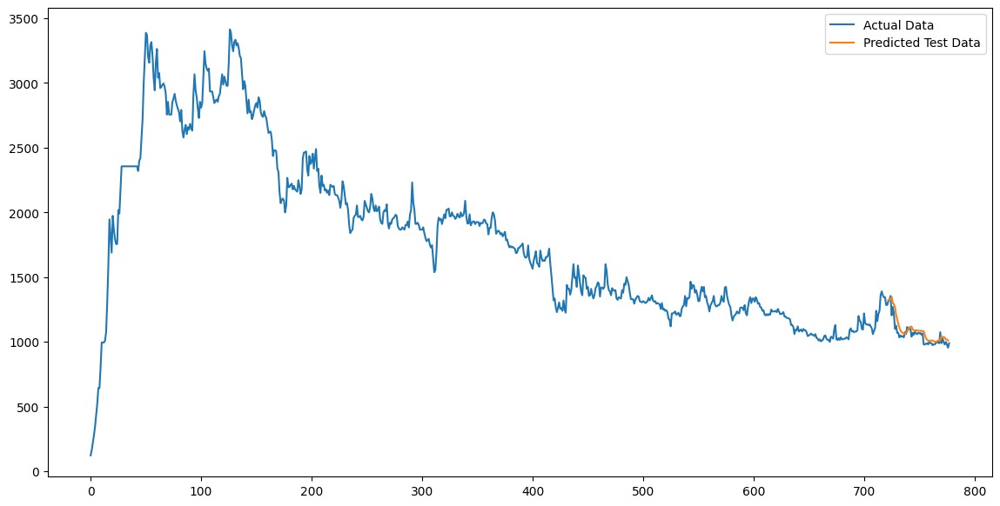

In [ ]:
# Membuat gambar (figure) dengan ukuran 14x7
plt.figure(figsize=(14, 7))
# Membuat plot garis untuk data aktual dengan label 'Actual Data'
plt.plot(bank_hist3, label='Actual Data')
# Membuat plot garis untuk data prediksi pada dengan label 'Predicted Test Data'
plt.plot(testPredictPlot_bank_gru, label='Predicted Test Data')
# Menambahkan legenda ke plot berdasarkan label-label yang telah ditentukan sebelumnya
plt.legend()
# Menampilkan plot
plt.show()

In [ ]:
# Fungsi menghitung MAPE
def mean_absolute_percentage_error(y_true, y_pred):
    y_true, y_pred = np.array(y_true), np.array(y_pred)
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100

In [ ]:
# Melihat Metric Evaluation RMSE dan MAPE
mape_gru_bank = mean_absolute_percentage_error(Y_test_bank_gru,test_predict_bank_gru)
print("RMSE of GRU:", np.sqrt(mean_squared_error(Y_test_bank_gru,test_predict_bank_gru)))
print("MAPE of GRU:", mape_gru_bank)

RMSE of GRU: 50.84143196904376
MAPE of GRU: 3.6013786260092364


#### Hyperparameter Tuning & Optimization using 4 Layers - Best Model

In [ ]:
# Mengambil kolom close
bank_hist2 = bank_hist['Close']

In [ ]:
# Train-Test Split
train_size = int(len(bank_hist2) * 0.80)
test_size = len(bank_hist2) - train_size
train_data_bank_gru, test_data_bank_gru = bank_hist2[:train_size], bank_hist2[train_size:]

# Scalling data
scaler = MinMaxScaler()
bank_hist2 = scaler.fit_transform(np.array(bank_hist2).reshape(-1,1))
train_data_bank_gru = scaler.fit_transform(np.array(train_data_bank_gru).reshape(-1, 1))
test_data_bank_gru = scaler.transform(np.array(test_data_bank_gru).reshape(-1, 1))

In [ ]:
def create_dataset(dataset, time_step = 1):
    dataX,dataY = [],[]
    for i in range(len(dataset)-time_step-1):
                   a = dataset[i:(i+time_step),0]
                   dataX.append(a)
                   dataY.append(dataset[i + time_step,0])
    return np.array(dataX),np.array(dataY)

In [ ]:
# Memanggil fungsi create_dataset untuk membagi data menjadi dataset input dan output dataset dengan times step 100
time_step = 100
X_train_bank_gru,Y_train_bank_gru =  create_dataset(train_data_bank_gru,time_step)
X_test_bank_gru,Y_test_bank_gru =  create_dataset(test_data_bank_gru,time_step)

In [ ]:
Y_train_bank_gru

array([0.81626586, 0.82707375, 0.88651717, 0.94866254, 0.91894079,
       0.90813297, 0.90272902, 0.90813297, 0.85409349, 0.85409349,
       0.85409349, 0.84058366, 0.82707375, 0.8324777 , 0.83517971,
       0.82977576, 0.84328559, 0.84868954, 0.87300727, 0.89462306,
       0.87030533, 0.88921911, 0.87841122, 0.86760332, 0.86760332,
       0.9216428 , 1.        , 0.99189404, 0.96217237, 0.94866254,
       0.97027833, 0.97568227, 0.96217237, 0.96757631, 0.95676842,
       0.93785464, 0.93245069, 0.89462306, 0.85949744, 0.87841122,
       0.86760332, 0.8324777 , 0.80275602, 0.83517971, 0.80545796,
       0.80815997, 0.78924612, 0.79735208, 0.81086191, 0.8216698 ,
       0.82707375, 0.81626586, 0.84058366, 0.8324777 , 0.80545796,
       0.79735208, 0.79465007, 0.80815997, 0.79735208, 0.79194813,
       0.77303428, 0.75682251, 0.75952444, 0.75952444, 0.74061066,
       0.70278303, 0.71629286, 0.71629286, 0.71359093, 0.67306136,
       0.6649554 , 0.61631994, 0.59200214, 0.6001081 , 0.60281

In [ ]:
# Memeriksa value
print(X_train_bank_gru.shape)
print(X_train_bank_gru)
print(X_test_bank_gru.shape)
print(Y_test_bank_gru.shape)

(521, 100)
[[0.         0.01296946 0.03053229 ... 0.81356392 0.79194813 0.82977576]
 [0.01296946 0.03053229 0.04728451 ... 0.79194813 0.82977576 0.81626586]
 [0.03053229 0.04728451 0.0683599  ... 0.82977576 0.81626586 0.82707375]
 ...
 [0.34236997 0.34388968 0.33933055 ... 0.33021229 0.34236997 0.33781084]
 [0.34388968 0.33933055 0.34085026 ... 0.34236997 0.33781084 0.33781084]
 [0.33933055 0.34085026 0.33629113 ... 0.33781084 0.33781084 0.33781084]]
(55, 100)
(55,)


In [ ]:
# Tetapkan seed untuk inisialisasi acak
seed_value = 42
tf.random.set_seed(seed_value)
np.random.seed(seed_value)

# Definisikan fungsi untuk membuat model GRU dengan hyperparameter
def build_model_l4(hp):
    model = tf.keras.Sequential()
    model.add(tf.keras.layers.GRU(
        units=hp.Int('units_1', min_value=50, max_value=100, step=50),
        return_sequences=True,
        input_shape=(X_train_bank_gru.shape[1], 1)
    ))
    model.add(tf.keras.layers.GRU(
        units=hp.Int('units_2', min_value=50, max_value=100, step=50),
        return_sequences=True
    ))
    model.add(tf.keras.layers.GRU(
        units=hp.Int('units_3', min_value=50, max_value=100, step=50)
    ))
    model.add(tf.keras.layers.Dense(1))

    model.compile(
        optimizer=tf.keras.optimizers.Adam(
            hp.Choice('learning_rate', values=[1e-2, 1e-3, 1e-4])
        ),
        loss='mean_squared_error'
    )
    return model

In [ ]:
# Atur pencarian hyperparameter menggunakan RandomSearch
tuner = RandomSearch(
    build_model_l4,
    objective='val_loss',
    max_trials=10,  # Jumlah percobaan untuk menemukan kombinasi hyperparameter terbaik
    executions_per_trial=1,  # Jumlah eksekusi per percobaan untuk akurasi lebih baik
    directory='hyperparameter_tuning_l4',
    project_name='gru_tuning_l4'
)

# Tentukan data pelatihan dan validasi
tuner.search(X_train_bank_gru, Y_train_bank_gru, validation_data=(X_test_bank_gru, Y_test_bank_gru), epochs=30, batch_size=64, verbose=1)

# Mendapatkan hasil terbaik
best_hps_l4 = tuner.get_best_hyperparameters(num_trials=1)[0]

# Membangun model dengan hyperparameter terbaik
model_bank_gru_l4 = build_model_l4(best_hps_l4)

Trial 10 Complete [00h 01m 30s]
val_loss: 0.0002155707188649103

Best val_loss So Far: 0.00012135466386098415
Total elapsed time: 00h 20m 59s


In [ ]:
print(best_hps_l4)

In [ ]:
model_bank_gru_l4.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 gru_3 (GRU)                 (None, 100, 50)           7950      
                                                                 
 gru_4 (GRU)                 (None, 100, 50)           15300     
                                                                 
 gru_5 (GRU)                 (None, 50)                15300     
                                                                 
 dense_1 (Dense)             (None, 1)                 51        
                                                                 
Total params: 38601 (150.79 KB)
Trainable params: 38601 (150.79 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________


In [ ]:
# Menetapkan seed untuk TensorFlow untuk memastikan hasil yang konsisten dari operasi stokastik (jika ada)
tf.random.set_seed(seed_value)

# Melatih model menggunakan data pelatihan (X_train_bank dan Y_train_bank) dengan data validasi (X_test_bank dan Y_test_bank)
# Epochs adalah jumlah kali seluruh dataset akan diberikan kepada model selama proses pelatihan
# Batch_size adalah jumlah sampel data yang akan diproses sebelum pembaharuan bobot model
# verbose = 1 menghasilkan output detail pada setiap epoch selama pelatihan
model_bank_gru_l4.fit(X_train_bank_gru, Y_train_bank_gru, validation_data=(X_test_bank_gru, Y_test_bank_gru), epochs=50, batch_size=64, verbose=1)
model_bank_gru_l4.save("model_bank_gru_l4.h5")

Epoch 1/50
9/9 [==============================] - 9s 322ms/step - loss: 0.0684 - val_loss: 0.0134
Epoch 2/50
9/9 [==============================] - 2s 276ms/step - loss: 0.0084 - val_loss: 0.0104
Epoch 3/50
9/9 [==============================] - 3s 291ms/step - loss: 0.0034 - val_loss: 0.0012
Epoch 4/50
9/9 [==============================] - 2s 169ms/step - loss: 0.0015 - val_loss: 1.6683e-04
Epoch 5/50
9/9 [==============================] - 1s 160ms/step - loss: 6.5929e-04 - val_loss: 1.8915e-04
Epoch 6/50
9/9 [==============================] - 2s 167ms/step - loss: 4.5940e-04 - val_loss: 1.6502e-04
Epoch 7/50
9/9 [==============================] - 2s 165ms/step - loss: 4.2133e-04 - val_loss: 3.4791e-04
Epoch 8/50
9/9 [==============================] - 1s 163ms/step - loss: 4.7962e-04 - val_loss: 1.4925e-04
Epoch 9/50
9/9 [==============================] - 1s 165ms/step - loss: 5.6549e-04 - val_loss: 2.2547e-04
Epoch 10/50
9/9 [==============================] - 2s 217ms/step - loss: 4

In [ ]:
# Memprediksi data menggunakan model yang telah dilatih
train_predict_bank_gru = model_bank_gru_l4.predict(X_train_bank_gru)
test_predict_bank_gru = model_bank_gru_l4.predict(X_test_bank_gru)

2/2 [==============================] - 0s 29ms/step


In [ ]:
Y_train_bank_gru[:5]

array([0.81626586, 0.82707375, 0.88651717, 0.94866254, 0.91894079])

In [ ]:
train_predict_bank_gru[:5]

array([[0.82866037],
       [0.7998741 ],
       [0.8201696 ],
       [0.883458  ],
       [0.9386535 ]], dtype=float32)

In [ ]:
# Transformasi data ke bentuk awal
Y_train_bank_gru = scaler.inverse_transform(Y_train_bank_gru.reshape(-1, 1))
Y_test_bank_gru = scaler.inverse_transform(Y_test_bank_gru.reshape(-1, 1))
train_predict_bank_gru = scaler.inverse_transform(train_predict_bank_gru)
test_predict_bank_gru = scaler.inverse_transform(test_predict_bank_gru)

In [ ]:
Y_test_bank_gru[:5]

array([[1315.],
       [1325.],
       [1355.],
       [1205.],
       [1270.]])

In [ ]:
test_predict_bank_gru[:5]

array([[1289.554 ],
       [1311.7268],
       [1318.1395],
       [1344.0359],
       [1220.9758]], dtype=float32)

In [ ]:
# Mendefinisikan jumlah langkah waktu sebelumnya yang akan digunakan sebagai input untuk memprediksi langkah waktu saat ini
look_back = 100

# Membuat array kosong dengan ukuran yang sama dengan bank_hist2
trainPredictPlot_bank = np.empty_like(bank_hist2)
# Mengisi array dengan nilai yang sama dengan NaN (untuk plot)
trainPredictPlot_bank[:,:] = np.nan
# Mengisi bagian dari array dengan hasil prediksi pada data pelatihan
# Menempatkan hasil prediksi pada posisi yang sesuai dalam array untuk plotting
trainPredictPlot_bank[look_back : len(train_predict_bank_gru)+look_back,:] = train_predict_bank_gru

# Membuat array kosong dengan ukuran yang sama dengan bank_hist2
testPredictPlot_bank_gru = np.empty_like(bank_hist2)
# Mengisi array dengan nilai yang sama dengan NaN (untuk plot)
testPredictPlot_bank_gru[:,:] = np.nan
# Mengisi bagian dari array dengan hasil prediksi pada data uji
# Menempatkan hasil prediksi pada posisi yang sesuai dalam array untuk plotting
testPredictPlot_bank_gru[len(train_predict_bank_gru) + (look_back) * 2 + 1 : len(bank_hist2) - 1, :] = test_predict_bank_gru

In [ ]:
# Mengambil data harga saham close dan dijadikan dalam bentuk array numpy
bank_hist3=bank_hist['Close'].to_numpy()

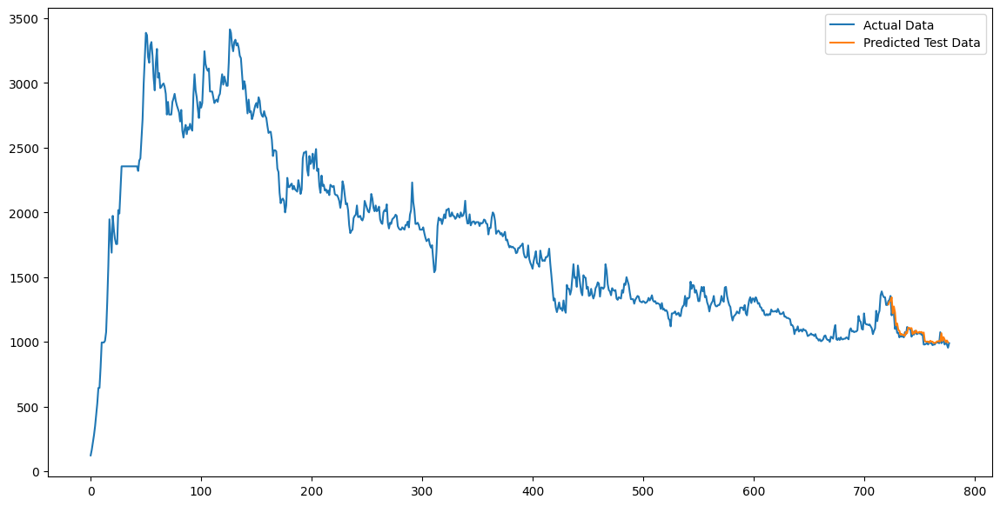

In [ ]:
# Membuat gambar (figure) dengan ukuran 14x7
plt.figure(figsize=(14, 7))
# Membuat plot garis untuk data aktual dengan label 'Actual Data'
plt.plot(bank_hist3, label='Actual Data')
# Membuat plot garis untuk data prediksi pada dengan label 'Predicted Test Data'
plt.plot(testPredictPlot_bank_gru, label='Predicted Test Data')
# Menambahkan legenda ke plot berdasarkan label-label yang telah ditentukan sebelumnya
plt.legend()
# Menampilkan plot
plt.show()

In [ ]:
# Fungsi menghitung MAPE
def mean_absolute_percentage_error(y_true, y_pred):
    y_true, y_pred = np.array(y_true), np.array(y_pred)
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100

In [ ]:
# Melihat Metric Evaluation RMSE dan MAPE
mape_gru_l4_bank = mean_absolute_percentage_error(Y_test_bank_gru,test_predict_bank_gru)
print("RMSE of gru:", np.sqrt(mean_squared_error(Y_test_bank_gru,test_predict_bank_gru)))
print("MAPE of gru:", mape_gru_l4_bank)

RMSE of gru: 40.973955382861554
MAPE of gru: 2.669262087235768


#### Hyperparameter Tuning & Optimization using 5 Layers - Worst Model

In [ ]:
# Mengambil kolom close
bank_hist2 = bank_hist['Close']

In [ ]:
# Train-Test Split
train_size = int(len(bank_hist2) * 0.80)
test_size = len(bank_hist2) - train_size
train_data_bank_gru, test_data_bank_gru = bank_hist2[:train_size], bank_hist2[train_size:]

In [ ]:
# Scalling data
scaler = MinMaxScaler()
bank_hist2 = scaler.fit_transform(np.array(bank_hist2).reshape(-1,1))
train_data_bank_gru = scaler.fit_transform(np.array(train_data_bank_gru).reshape(-1, 1))
test_data_bank_gru = scaler.transform(np.array(test_data_bank_gru).reshape(-1, 1))

In [ ]:
def create_dataset(dataset, time_step = 1):
    dataX,dataY = [],[]
    for i in range(len(dataset)-time_step-1):
                   a = dataset[i:(i+time_step),0]
                   dataX.append(a)
                   dataY.append(dataset[i + time_step,0])
    return np.array(dataX),np.array(dataY)

In [ ]:
# Memanggil fungsi create_dataset untuk membagi data menjadi dataset input dan output dataset dengan times step 100
time_step = 100
X_train_bank_gru,Y_train_bank_gru =  create_dataset(train_data_bank_gru,time_step)
X_test_bank_gru,Y_test_bank_gru =  create_dataset(test_data_bank_gru,time_step)

In [ ]:
Y_train_bank_gru

array([0.81626586, 0.82707375, 0.88651717, 0.94866254, 0.91894079,
       0.90813297, 0.90272902, 0.90813297, 0.85409349, 0.85409349,
       0.85409349, 0.84058366, 0.82707375, 0.8324777 , 0.83517971,
       0.82977576, 0.84328559, 0.84868954, 0.87300727, 0.89462306,
       0.87030533, 0.88921911, 0.87841122, 0.86760332, 0.86760332,
       0.9216428 , 1.        , 0.99189404, 0.96217237, 0.94866254,
       0.97027833, 0.97568227, 0.96217237, 0.96757631, 0.95676842,
       0.93785464, 0.93245069, 0.89462306, 0.85949744, 0.87841122,
       0.86760332, 0.8324777 , 0.80275602, 0.83517971, 0.80545796,
       0.80815997, 0.78924612, 0.79735208, 0.81086191, 0.8216698 ,
       0.82707375, 0.81626586, 0.84058366, 0.8324777 , 0.80545796,
       0.79735208, 0.79465007, 0.80815997, 0.79735208, 0.79194813,
       0.77303428, 0.75682251, 0.75952444, 0.75952444, 0.74061066,
       0.70278303, 0.71629286, 0.71629286, 0.71359093, 0.67306136,
       0.6649554 , 0.61631994, 0.59200214, 0.6001081 , 0.60281

In [ ]:
# Memeriksa value
print(X_train_bank_gru.shape)
print(X_train_bank_gru)
print(X_test_bank_gru.shape)
print(Y_test_bank_gru.shape)

(521, 100)
[[0.         0.01296946 0.03053229 ... 0.81356392 0.79194813 0.82977576]
 [0.01296946 0.03053229 0.04728451 ... 0.79194813 0.82977576 0.81626586]
 [0.03053229 0.04728451 0.0683599  ... 0.82977576 0.81626586 0.82707375]
 ...
 [0.34236997 0.34388968 0.33933055 ... 0.33021229 0.34236997 0.33781084]
 [0.34388968 0.33933055 0.34085026 ... 0.34236997 0.33781084 0.33781084]
 [0.33933055 0.34085026 0.33629113 ... 0.33781084 0.33781084 0.33781084]]
(55, 100)
(55,)


In [ ]:
# Tetapkan seed untuk inisialisasi acak
seed_value = 42
tf.random.set_seed(seed_value)
np.random.seed(seed_value)

In [ ]:
# Definisikan fungsi untuk membuat model GRU dengan hyperparameter
def build_model_l5(hp):
    model = tf.keras.Sequential()
    model.add(tf.keras.layers.GRU(
        units=hp.Int('units_1', min_value=50, max_value=100, step=50),
        return_sequences=True,
        input_shape=(X_train_bank_gru.shape[1], 1)
    ))
    model.add(tf.keras.layers.GRU(
        units=hp.Int('units_2', min_value=50, max_value=100, step=50),
        return_sequences=True
    ))
    model.add(tf.keras.layers.GRU(
        units=hp.Int('units_3', min_value=50, max_value=100, step=50),
        return_sequences=True
    ))
    model.add(tf.keras.layers.GRU(
        units=hp.Int('units_4', min_value=50, max_value=100, step=50)
    ))
    model.add(tf.keras.layers.Dense(1))

    model.compile(
        optimizer=tf.keras.optimizers.Adam(
            hp.Choice('learning_rate', values=[1e-2, 1e-3, 1e-4])
        ),
        loss='mean_squared_error'
    )
    return model

In [ ]:
# Atur pencarian hyperparameter menggunakan RandomSearch
tuner = RandomSearch(
    build_model_l5,
    objective='val_loss',
    max_trials=10,  # Jumlah percobaan untuk menemukan kombinasi hyperparameter terbaik
    executions_per_trial=1,  # Jumlah eksekusi per percobaan untuk akurasi lebih baik
    directory='hyperparameter_tuning_l5',
    project_name='gru_tuning_l5'
)

# Tentukan data pelatihan dan validasi
tuner.search(X_train_bank_gru, Y_train_bank_gru, validation_data=(X_test_bank_gru, Y_test_bank_gru), epochs=30, batch_size=64, verbose=1)

# Mendapatkan hasil terbaik
best_hps_l5 = tuner.get_best_hyperparameters(num_trials=1)[0]

# Membangun model dengan hyperparameter terbaik
model_bank_gru_l5 = build_model_l5(best_hps_l5)

Trial 10 Complete [00h 02m 37s]
val_loss: 0.0001461343781556934

Best val_loss So Far: 0.00012472490197978914
Total elapsed time: 00h 23m 24s


In [ ]:
print(best_hps_l5)

In [ ]:
model_bank_gru_l5.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 gru_4 (GRU)                 (None, 100, 50)           7950      
                                                                 
 gru_5 (GRU)                 (None, 100, 50)           15300     
                                                                 
 gru_6 (GRU)                 (None, 100, 50)           15300     
                                                                 
 gru_7 (GRU)                 (None, 50)                15300     
                                                                 
 dense_1 (Dense)             (None, 1)                 51        
                                                                 
Total params: 53901 (210.55 KB)
Trainable params: 53901 (210.55 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________


In [ ]:
# Menetapkan seed untuk TensorFlow untuk memastikan hasil yang konsisten dari operasi stokastik (jika ada)
tf.random.set_seed(seed_value)

# Melatih model menggunakan data pelatihan (X_train_bank dan Y_train_bank) dengan data validasi (X_test_bank dan Y_test_bank)
# Epochs adalah jumlah kali seluruh dataset akan diberikan kepada model selama proses pelatihan
# Batch_size adalah jumlah sampel data yang akan diproses sebelum pembaharuan bobot model
# verbose = 1 menghasilkan output detail pada setiap epoch selama pelatihan
model_bank_gru_l5.fit(X_train_bank_gru, Y_train_bank_gru, validation_data=(X_test_bank_gru, Y_test_bank_gru), epochs=50, batch_size=64, verbose=1)
model_bank_gru_l5.save("model_bank_gru_l5.h5")

Epoch 1/50
9/9 [==============================] - 11s 413ms/step - loss: 0.3021 - val_loss: 0.0650
Epoch 2/50
9/9 [==============================] - 3s 330ms/step - loss: 0.0302 - val_loss: 0.0742
Epoch 3/50
9/9 [==============================] - 3s 377ms/step - loss: 0.0156 - val_loss: 0.0207
Epoch 4/50
9/9 [==============================] - 2s 211ms/step - loss: 0.0072 - val_loss: 0.0022
Epoch 5/50
9/9 [==============================] - 2s 215ms/step - loss: 0.0013 - val_loss: 0.0022
Epoch 6/50
9/9 [==============================] - 2s 211ms/step - loss: 0.0012 - val_loss: 5.0141e-04
Epoch 7/50
9/9 [==============================] - 2s 221ms/step - loss: 7.6289e-04 - val_loss: 0.0013
Epoch 8/50
9/9 [==============================] - 2s 209ms/step - loss: 6.9715e-04 - val_loss: 7.0920e-04
Epoch 9/50
9/9 [==============================] - 3s 341ms/step - loss: 8.5698e-04 - val_loss: 1.8728e-04
Epoch 10/50
9/9 [==============================] - 3s 359ms/step - loss: 6.4196e-04 - val_los

In [ ]:
# Memprediksi data menggunakan model yang telah dilatih
train_predict_bank_gru = model_bank_gru_l5.predict(X_train_bank_gru)
test_predict_bank_gru = model_bank_gru_l5.predict(X_test_bank_gru)

2/2 [==============================] - 0s 37ms/step


In [ ]:
Y_train_bank_gru[:5]

array([0.81626586, 0.82707375, 0.88651717, 0.94866254, 0.91894079])

In [ ]:
train_predict_bank_gru[:5]

array([[0.83678937],
       [0.8066944 ],
       [0.82881325],
       [0.89177126],
       [0.9463905 ]], dtype=float32)

In [ ]:
# Transformasi data ke bentuk awal
Y_train_bank_gru = scaler.inverse_transform(Y_train_bank_gru.reshape(-1, 1))
Y_test_bank_gru = scaler.inverse_transform(Y_test_bank_gru.reshape(-1, 1))
train_predict_bank_gru = scaler.inverse_transform(train_predict_bank_gru)
test_predict_bank_gru = scaler.inverse_transform(test_predict_bank_gru)

In [ ]:
Y_test_bank_gru[:5]

array([[1315.],
       [1325.],
       [1355.],
       [1205.],
       [1270.]])

In [ ]:
test_predict_bank_gru[:5]

array([[1297.992 ],
       [1322.8535],
       [1329.441 ],
       [1353.2299],
       [1233.4321]], dtype=float32)

In [ ]:
# Mendefinisikan jumlah langkah waktu sebelumnya yang akan digunakan sebagai input untuk memprediksi langkah waktu saat ini
look_back = 100

# Membuat array kosong dengan ukuran yang sama dengan bank_hist2
trainPredictPlot_bank = np.empty_like(bank_hist2)
# Mengisi array dengan nilai yang sama dengan NaN (untuk plot)
trainPredictPlot_bank[:,:] = np.nan
# Mengisi bagian dari array dengan hasil prediksi pada data pelatihan
# Menempatkan hasil prediksi pada posisi yang sesuai dalam array untuk plotting
trainPredictPlot_bank[look_back : len(train_predict_bank_gru)+look_back,:] = train_predict_bank_gru

# Membuat array kosong dengan ukuran yang sama dengan bank_hist2
testPredictPlot_bank_gru = np.empty_like(bank_hist2)
# Mengisi array dengan nilai yang sama dengan NaN (untuk plot)
testPredictPlot_bank_gru[:,:] = np.nan
# Mengisi bagian dari array dengan hasil prediksi pada data uji
# Menempatkan hasil prediksi pada posisi yang sesuai dalam array untuk plotting
testPredictPlot_bank_gru[len(train_predict_bank_gru) + (look_back) * 2 + 1 : len(bank_hist2) - 1, :] = test_predict_bank_gru

In [ ]:
# Mengambil data harga saham close dan dijadikan dalam bentuk array numpy
bank_hist3=bank_hist['Close'].to_numpy()

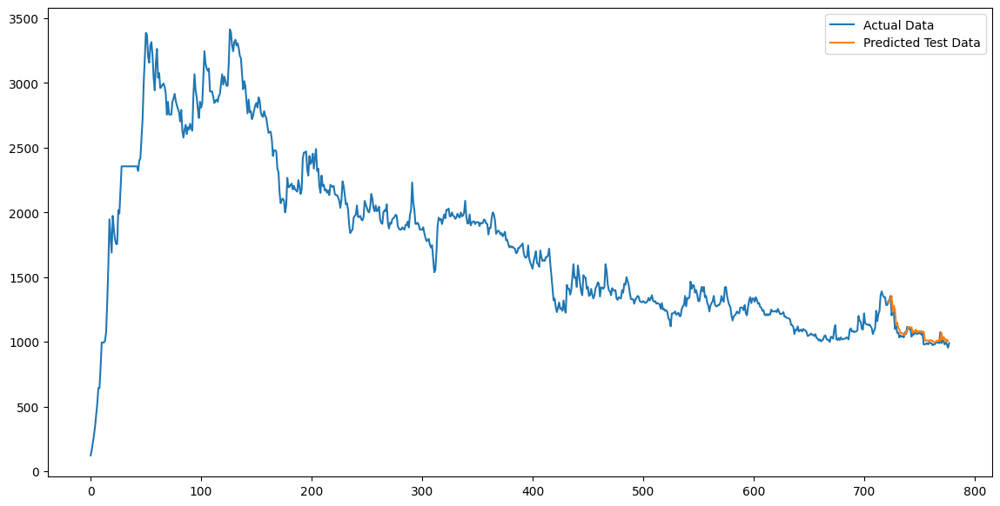

In [ ]:
# Membuat gambar (figure) dengan ukuran 14x7
plt.figure(figsize=(14, 7))
# Membuat plot garis untuk data aktual dengan label 'Actual Data'
plt.plot(bank_hist3, label='Actual Data')
# Membuat plot garis untuk data prediksi pada dengan label 'Predicted Test Data'
plt.plot(testPredictPlot_bank_gru, label='Predicted Test Data')
# Menambahkan legenda ke plot berdasarkan label-label yang telah ditentukan sebelumnya
plt.legend()
# Menampilkan plot
plt.show()

In [ ]:
# Fungsi menghitung MAPE
def mean_absolute_percentage_error(y_true, y_pred):
    y_true, y_pred = np.array(y_true), np.array(y_pred)
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100

In [ ]:
# Melihat Metric Evaluation RMSE dan MAPE
build_model_l5 = mean_absolute_percentage_error(Y_test_bank_gru,test_predict_bank_gru)
print("RMSE of GRU:", np.sqrt(mean_squared_error(Y_test_bank_gru,test_predict_bank_gru)))
print("MAPE of GRU:", mape_gru_bank)

RMSE of GRU: 44.76522608277197
MAPE of GRU: 3.6013786260092364


In [ ]:
# Mengambil kolom close
bank_hist2 = bank_hist

In [ ]:
# Train-Test Split
train_size = int(len(bank_hist2) * 0.80)
test_size = len(bank_hist2) - train_size
train_data_bank_gru, test_data_bank_gru = bank_hist2[:train_size], bank_hist2[train_size:]

In [ ]:
test_data_bank_gru.head()

,Date,Open,High,Low,Close,Volume,Dividends,Stock Splits
Date,,,,,,,,
2023-08-23,2023-08-23 00:00:00+07:00,1230.0,1260.0,1230.0,1255.0,8265500,0.0,0.0
2023-08-24,2023-08-24 00:00:00+07:00,1255.0,1260.0,1230.0,1235.0,7868800,0.0,0.0
2023-08-25,2023-08-25 00:00:00+07:00,1240.0,1240.0,1205.0,1215.0,22824500,0.0,0.0
2023-08-28,2023-08-28 00:00:00+07:00,1220.0,1230.0,1210.0,1215.0,6008400,0.0,0.0
2023-08-29,2023-08-29 00:00:00+07:00,1230.0,1235.0,1215.0,1220.0,7784900,0.0,0.0


DataFrame awal:
                                Date    Open    High     Low   Close  \
Date                                                                   
2023-08-23 2023-08-23 00:00:00+07:00  1230.0  1260.0  1230.0  1255.0   
2023-08-24 2023-08-24 00:00:00+07:00  1255.0  1260.0  1230.0  1235.0   
2023-08-25 2023-08-25 00:00:00+07:00  1240.0  1240.0  1205.0  1215.0   
2023-08-28 2023-08-28 00:00:00+07:00  1220.0  1230.0  1210.0  1215.0   
2023-08-29 2023-08-29 00:00:00+07:00  1230.0  1235.0  1215.0  1220.0   

              Volume  Dividends  Stock Splits  
Date                                           
2023-08-23   8265500        0.0           0.0  
2023-08-24   7868800        0.0           0.0  
2023-08-25  22824500        0.0           0.0  
2023-08-28   6008400        0.0           0.0  
2023-08-29   7784900        0.0           0.0  

DataFrame akhir:
                                Date    Open    High    Low   Close   Volume  \
Date                                         

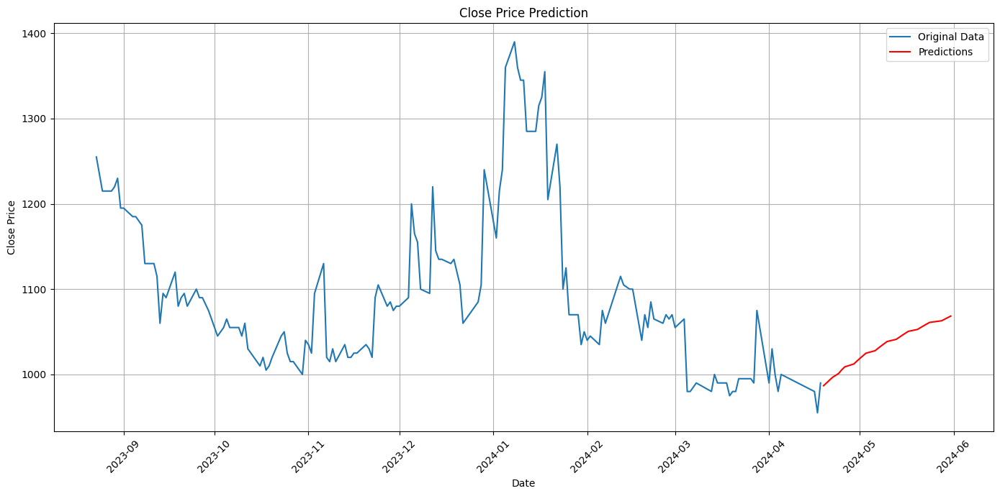

In [ ]:
# Data yang digunakan untuk forecast
df = test_data_bank_gru.copy()

# Menampilkan 5 baris pertama dari DataFrame
print("DataFrame awal:")
print(df.head())

# Menampilkan 5 baris terakhir dari DataFrame
print("\nDataFrame akhir:")
print(df.tail())

# 1. Load model
model = load_model('/content/drive/MyDrive/Saved Models/model_bank_gru_l4.h5')

# 2. Prepare data (gunakan data dari 100 hari terakhir)
last_n_days = 100  # Menggunakan 100 hari terakhir sesuai kebutuhan model
data_to_predict = df['Close'][-last_n_days:].values

# 3. Scaling data (misalnya menggunakan MinMaxScaler)
scaler = MinMaxScaler(feature_range=(0, 1))
data_to_predict_scaled = scaler.fit_transform(data_to_predict.reshape(-1, 1))

# 4. Reshape data
data_to_predict_scaled = np.reshape(data_to_predict_scaled, (1, last_n_days, 1))

# 5. Predict multiple business days into the future, skipping weekends and holidays
n_days_to_predict = 30
predictions = []

# Get Jakarta (WIB) timezone
wib_timezone = timezone('Asia/Jakarta')

# Get NYSE calendar
nyse = mcal.get_calendar('NYSE')

# Get next business day from the last available date in the dataframe
last_date = df['Date'].iloc[-1].astimezone(wib_timezone)  # Konversi ke zona waktu Jakarta
current_date = last_date

# List to hold predicted dates
predicted_dates = []

for _ in range(n_days_to_predict):
    # Get next business day
    current_date = nyse.valid_days(start_date=current_date + pd.Timedelta(days=1), end_date=current_date + pd.Timedelta(days=30), tz='Asia/Jakarta')[0]

    # Predict only if it's a business day
    if current_date.weekday() < 5:  # Monday=0, Sunday=6
        # Predict
        predicted_scaled = model.predict(data_to_predict_scaled)
        predicted = scaler.inverse_transform(predicted_scaled)

        # Save prediction
        predictions.append(predicted[0][0])

        # Update data_to_predict_scaled for the next prediction
        data_to_predict_scaled = np.append(data_to_predict_scaled[:, 1:, :], np.reshape(predicted_scaled, (1, 1, 1)), axis=1)

        # Save predicted date
        predicted_dates.append(current_date)

# Print the predicted values
print("\nPredicted values for the next business days:")
print(predictions)

# Mendapatkan tanggal terakhir dari data asli
last_date = df['Date'].iloc[-1].astimezone(wib_timezone)  # Konversi ke zona waktu Jakarta

# Membuat DataFrame baru untuk hasil prediksi
prediction_df = pd.DataFrame({'Date': predicted_dates, 'Predicted_Close': predictions})

# Menampilkan DataFrame prediksi
print("\nPrediction DataFrame:")
print(prediction_df)

# Plotting the results
plt.figure(figsize=(14, 7))

# Plot the original data
plt.plot(df['Date'], df['Close'], label='Original Data')

# Plot the predictions
plt.plot(prediction_df['Date'], prediction_df['Predicted_Close'], label='Predictions', color='red')

# Formatting the plot
plt.xlabel('Date')
plt.ylabel('Close Price')
plt.title('Close Price Prediction')
plt.legend()
plt.grid(True)
plt.xticks(rotation=45)
plt.tight_layout()

# Display the plot
plt.show()

#### Forecasting using Best Model

In [ ]:
# Mengambil kolom close
bank_hist2 = bank_hist

In [ ]:
# Train-Test Split
train_size = int(len(bank_hist2) * 0.80)
test_size = len(bank_hist2) - train_size
train_data_bank_gru, test_data_bank_gru = bank_hist2[:train_size], bank_hist2[train_size:]

In [ ]:
test_data_bank_gru.head()

,Date,Open,High,Low,Close,Volume,Dividends,Stock Splits
Date,,,,,,,,
2023-08-23,2023-08-23 00:00:00+07:00,1230.0,1260.0,1230.0,1255.0,8265500,0.0,0.0
2023-08-24,2023-08-24 00:00:00+07:00,1255.0,1260.0,1230.0,1235.0,7868800,0.0,0.0
2023-08-25,2023-08-25 00:00:00+07:00,1240.0,1240.0,1205.0,1215.0,22824500,0.0,0.0
2023-08-28,2023-08-28 00:00:00+07:00,1220.0,1230.0,1210.0,1215.0,6008400,0.0,0.0
2023-08-29,2023-08-29 00:00:00+07:00,1230.0,1235.0,1215.0,1220.0,7784900,0.0,0.0


DataFrame awal:
                                Date    Open    High     Low   Close  \
Date                                                                   
2023-08-23 2023-08-23 00:00:00+07:00  1230.0  1260.0  1230.0  1255.0   
2023-08-24 2023-08-24 00:00:00+07:00  1255.0  1260.0  1230.0  1235.0   
2023-08-25 2023-08-25 00:00:00+07:00  1240.0  1240.0  1205.0  1215.0   
2023-08-28 2023-08-28 00:00:00+07:00  1220.0  1230.0  1210.0  1215.0   
2023-08-29 2023-08-29 00:00:00+07:00  1230.0  1235.0  1215.0  1220.0   

              Volume  Dividends  Stock Splits  
Date                                           
2023-08-23   8265500        0.0           0.0  
2023-08-24   7868800        0.0           0.0  
2023-08-25  22824500        0.0           0.0  
2023-08-28   6008400        0.0           0.0  
2023-08-29   7784900        0.0           0.0  

DataFrame akhir:
                                Date    Open    High    Low   Close   Volume  \
Date                                         

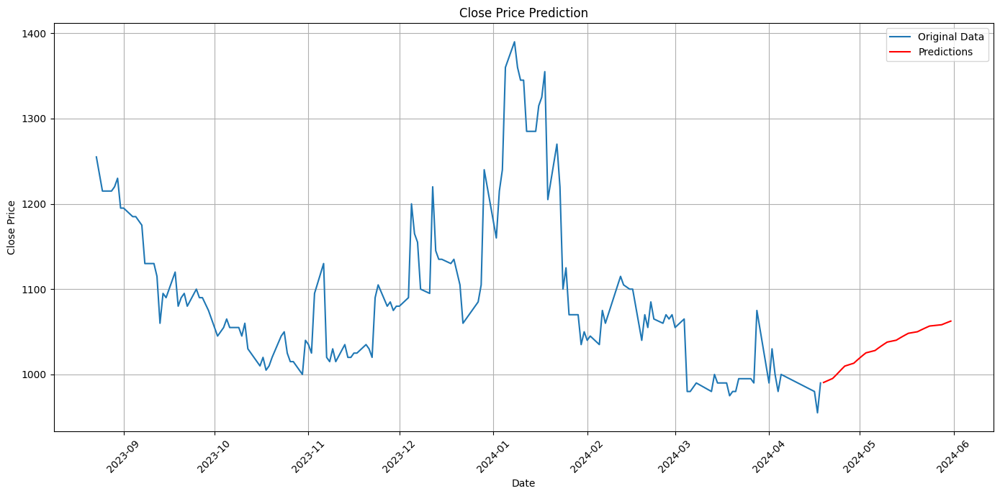

In [ ]:
# Data yang digunakan untuk forecast
df = test_data_bank_gru.copy()

# Menampilkan 5 baris pertama dari DataFrame
print("DataFrame awal:")
print(df.head())

# Menampilkan 5 baris terakhir dari DataFrame
print("\nDataFrame akhir:")
print(df.tail())

# 1. Load model
model = load_model('/content/drive/MyDrive/Saved Models/model_bank_gru_l4.h5')

# 2. Prepare data (gunakan data dari 100 hari terakhir)
last_n_days = 100  # Menggunakan 100 hari terakhir sesuai kebutuhan model
data_to_predict = df['Close'][-last_n_days:].values

# 3. Scaling data (misalnya menggunakan MinMaxScaler)
scaler = MinMaxScaler(feature_range=(0, 1))
data_to_predict_scaled = scaler.fit_transform(data_to_predict.reshape(-1, 1))

# 4. Reshape data
data_to_predict_scaled = np.reshape(data_to_predict_scaled, (1, last_n_days, 1))

# 5. Predict multiple business days into the future, skipping weekends and holidays
n_days_to_predict = 30
predictions = []

# Get Jakarta (WIB) timezone
wib_timezone = timezone('Asia/Jakarta')

# Get NYSE calendar
nyse = mcal.get_calendar('NYSE')

# Get next business day from the last available date in the dataframe
last_date = df['Date'].iloc[-1].astimezone(wib_timezone)  # Konversi ke zona waktu Jakarta
current_date = last_date

# List to hold predicted dates
predicted_dates = []

for _ in range(n_days_to_predict):
    # Get next business day
    current_date = nyse.valid_days(start_date=current_date + pd.Timedelta(days=1), end_date=current_date + pd.Timedelta(days=30), tz='Asia/Jakarta')[0]

    # Predict only if it's a business day
    if current_date.weekday() < 5:  # Monday=0, Sunday=6
        # Predict
        predicted_scaled = model.predict(data_to_predict_scaled)
        predicted = scaler.inverse_transform(predicted_scaled)

        # Save prediction
        predictions.append(predicted[0][0])

        # Update data_to_predict_scaled for the next prediction
        data_to_predict_scaled = np.append(data_to_predict_scaled[:, 1:, :], np.reshape(predicted_scaled, (1, 1, 1)), axis=1)

        # Save predicted date
        predicted_dates.append(current_date)

# Print the predicted values
print("\nPredicted values for the next business days:")
print(predictions)

# Mendapatkan tanggal terakhir dari data asli
last_date = df['Date'].iloc[-1].astimezone(wib_timezone)  # Konversi ke zona waktu Jakarta

# Membuat DataFrame baru untuk hasil prediksi
prediction_df = pd.DataFrame({'Date': predicted_dates, 'Predicted_Close': predictions})

# Menampilkan DataFrame prediksi
print("\nPrediction DataFrame:")
print(prediction_df)

# Plotting the results
plt.figure(figsize=(14, 7))

# Plot the original data
plt.plot(df['Date'], df['Close'], label='Original Data')

# Plot the predictions
plt.plot(prediction_df['Date'], prediction_df['Predicted_Close'], label='Predictions', color='red')

# Formatting the plot
plt.xlabel('Date')
plt.ylabel('Close Price')
plt.title('Close Price Prediction')
plt.legend()
plt.grid(True)
plt.xticks(rotation=45)
plt.tight_layout()

# Display the plot
plt.show()

### Bank Central Asia (BBCA)

#### Baseline Model

In [ ]:
# Mengambil kolom close
bbca_hist2 = bbca_hist['Close']

In [ ]:
# Train-Test Split
train_size = int(len(bbca_hist2) * 0.80)
test_size = len(bbca_hist2) - train_size
train_data_bbca_gru, test_data_bbca_gru = bbca_hist2[:train_size], bbca_hist2[train_size:]

# Scalling data
scaler = MinMaxScaler()
bbca_hist2 = scaler.fit_transform(np.array(bbca_hist2).reshape(-1,1))
train_data_bbca_gru = scaler.fit_transform(np.array(train_data_bbca_gru).reshape(-1, 1))
test_data_bbca_gru = scaler.transform(np.array(test_data_bbca_gru).reshape(-1, 1))

In [ ]:
def create_dataset(dataset, time_step = 1):
    dataX,dataY = [],[]
    for i in range(len(dataset)-time_step-1):
                   a = dataset[i:(i+time_step),0]
                   dataX.append(a)
                   dataY.append(dataset[i + time_step,0])
    return np.array(dataX),np.array(dataY)

In [ ]:
# Memanggil fungsi create_dataset untuk membagi data menjadi dataset input dan output dataset dengan times step 100
time_step = 100
X_train_bbca_gru,Y_train_bbca_gru =  create_dataset(train_data_bbca_gru,time_step)
X_test_bbca_gru,Y_test_bbca_gru =  create_dataset(test_data_bbca_gru,time_step)

In [ ]:
Y_train_bbca_gru

array([0.05961774, 0.06537174, 0.06105634, ..., 0.95233376, 0.95630596,
       0.95233376])

In [ ]:
# Memeriksa value
print(X_train_bbca_gru.shape)
print(X_train_bbca_gru)
print(X_test_bbca_gru.shape)
print(Y_test_bbca_gru.shape)

(1879, 100)
[[0.01642952 0.01285785 0.01285785 ... 0.04091778 0.04954859 0.05817936]
 [0.01285785 0.01285785 0.01142917 ... 0.04954859 0.05817936 0.05961774]
 [0.01285785 0.01142917 0.01142917 ... 0.05817936 0.05961774 0.06537174]
 ...
 [0.88875222 0.87687552 0.8649989  ... 1.         0.96822245 0.95233376]
 [0.87687552 0.8649989  0.88083453 ... 0.96822245 0.95233376 0.95233376]
 [0.8649989  0.88083453 0.86895783 ... 0.95233376 0.95233376 0.95630596]]
(394, 100)
(394,)


In [ ]:
# Tetapkan seed untuk inisialisasi acak
seed_value = 42
tf.random.set_seed(seed_value)
np.random.seed(seed_value)

# Membangun model GRU
model_bbca_gru1 = tf.keras.Sequential([
      # Menambahkan layer GRU pertama dengan 50 unit dan pengembalian urutan yang digunakan untuk menjaga urutan output
      # Input_shape adalah bentuk input, yaitu jumlah langkah waktu (X_train_bbca.shape[1]) dan fitur (1)
      tf.keras.layers.GRU(50, return_sequences=True, input_shape=(X_train_bbca_gru.shape[1], 1)),
      # Menambahkan layer GRU kedua dengan 50 unit, tidak ada pengembalian urutan karena ini adalah lapisan terakhir LSTM
      tf.keras.layers.GRU(50),
      # Menambahkan layer Dense dengan 1 unit sebagai output layer
      tf.keras.layers.Dense(1)
])
# Mengompilasi model dengan loss function 'mean_squared_error' dan optimizer 'adam'
model_bbca_gru1.compile(loss='mean_squared_error', optimizer='adam')

In [ ]:
# Melihat rangkuman model
model_bbca_gru1.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 gru_2 (GRU)                 (None, 100, 50)           7950      
                                                                 
 gru_3 (GRU)                 (None, 50)                15300     
                                                                 
 dense_1 (Dense)             (None, 1)                 51        
                                                                 
Total params: 23301 (91.02 KB)
Trainable params: 23301 (91.02 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________


In [ ]:
# Menetapkan seed untuk TensorFlow untuk memastikan hasil yang konsisten dari operasi stokastik (jika ada)
tf.random.set_seed(seed_value)

# Melatih model menggunakan data pelatihan (X_train_bbca dan Y_train_bbca) dengan data validasi (X_test_bbca dan Y_test_bbca)
# Epochs adalah jumlah kali seluruh dataset akan diberikan kepada model selama proses pelatihan
# Batch_size adalah jumlah sampel data yang akan diproses sebelum pembaharuan bobot model
# verbose = 1 menghasilkan output detail pada setiap epoch selama pelatihan
model_bbca_gru1.fit(X_train_bbca_gru, Y_train_bbca_gru, validation_data=(X_test_bbca_gru, Y_test_bbca_gru), epochs=50, batch_size=64, verbose=1)

Epoch 1/50
30/30 [==============================] - 5s 146ms/step - loss: 0.0353 - val_loss: 0.0492
Epoch 2/50
30/30 [==============================] - 5s 140ms/step - loss: 0.0015 - val_loss: 5.1073e-04
Epoch 3/50
30/30 [==============================] - 3s 96ms/step - loss: 3.4203e-04 - val_loss: 4.8845e-04
Epoch 4/50
30/30 [==============================] - 3s 93ms/step - loss: 2.6819e-04 - val_loss: 5.0367e-04
Epoch 5/50
30/30 [==============================] - 3s 94ms/step - loss: 2.5272e-04 - val_loss: 7.6507e-04
Epoch 6/50
30/30 [==============================] - 5s 155ms/step - loss: 2.4974e-04 - val_loss: 4.3734e-04
Epoch 7/50
30/30 [==============================] - 3s 95ms/step - loss: 2.4636e-04 - val_loss: 4.7226e-04
Epoch 8/50
30/30 [==============================] - 3s 94ms/step - loss: 2.3018e-04 - val_loss: 5.9046e-04
Epoch 9/50
30/30 [==============================] - 3s 94ms/step - loss: 2.2510e-04 - val_loss: 5.6545e-04
Epoch 10/50
30/30 [===========================

In [ ]:
# Memprediksi data menggunakan model yang telah dilatih
train_predict_bbca_gru = model_bbca_gru1.predict(X_train_bbca_gru)
test_predict_bbca_gru = model_bbca_gru1.predict(X_test_bbca_gru)

13/13 [==============================] - 0s 23ms/step


In [ ]:
Y_train_bbca_gru[:5]

array([0.05961774, 0.06537174, 0.06105634, 0.05602168, 0.06752942])

In [ ]:
train_predict_bbca_gru[:5]

array([[0.052982  ],
       [0.05755579],
       [0.06244846],
       [0.06331816],
       [0.06094544]], dtype=float32)

In [ ]:
# Transformasi data ke bentuk awal
Y_train_bbca_gru = scaler.inverse_transform(Y_train_bbca_gru.reshape(-1, 1))
Y_test_bbca_gru = scaler.inverse_transform(Y_test_bbca_gru.reshape(-1, 1))
train_predict_bbca_gru = scaler.inverse_transform(train_predict_bbca_gru)
test_predict_bbca_gru = scaler.inverse_transform(test_predict_bbca_gru)

In [ ]:
Y_test_bbca_gru[:5]

array([[7742.99121094],
       [7766.74267578],
       [7790.49511719],
       [7742.99121094],
       [7814.24658203]])

In [ ]:
test_predict_bbca_gru[:5]

array([[7621.9194],
       [7708.071 ],
       [7758.214 ],
       [7785.6973],
       [7757.4043]], dtype=float32)

In [ ]:
# Mendefinisikan jumlah langkah waktu sebelumnya yang akan digunakan sebagai input untuk memprediksi langkah waktu saat ini
look_back = 100

# Membuat array kosong dengan ukuran yang sama dengan bbca_hist2
trainPredictPlot_bbca = np.empty_like(bbca_hist2)
# Mengisi array dengan nilai yang sama dengan NaN (untuk plot)
trainPredictPlot_bbca[:,:] = np.nan
# Mengisi bagian dari array dengan hasil prediksi pada data pelatihan
# Menempatkan hasil prediksi pada posisi yang sesuai dalam array untuk plotting
trainPredictPlot_bbca[look_back : len(train_predict_bbca_gru)+look_back,:] = train_predict_bbca_gru

# Membuat array kosong dengan ukuran yang sama dengan bbca_hist2
testPredictPlot_bbca_gru= np.empty_like(bbca_hist2)
# Mengisi array dengan nilai yang sama dengan NaN (untuk plot)
testPredictPlot_bbca_gru[:,:] = np.nan
# Mengisi bagian dari array dengan hasil prediksi pada data uji
# Menempatkan hasil prediksi pada posisi yang sesuai dalam array untuk plotting
testPredictPlot_bbca_gru[len(train_predict_bbca_gru) + (look_back) * 2 + 1 : len(bbca_hist2) - 1, :] = test_predict_bbca_gru

In [ ]:
# Mengambil data harga saham close dan dijadikan dalam bentuk array numpy
bbca_hist3=bbca_hist['Close'].to_numpy()

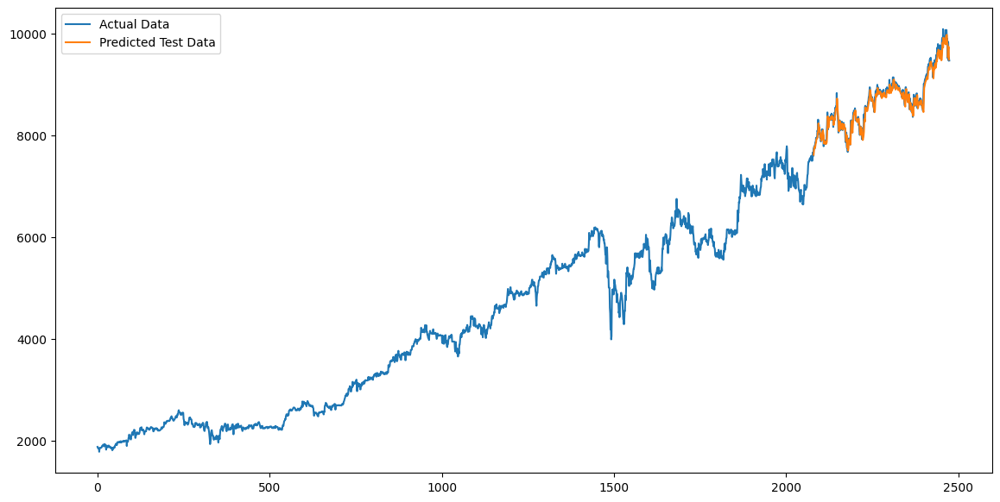

In [ ]:
# Membuat gambar (figure) dengan ukuran 14x7
plt.figure(figsize=(14, 7))
# Membuat plot garis untuk data aktual dengan label 'Actual Data'
plt.plot(bbca_hist3, label='Actual Data')
# Membuat plot garis untuk data prediksi pada dengan label 'Predicted Test Data'
plt.plot(testPredictPlot_bbca_gru, label='Predicted Test Data')
# Menambahkan legenda ke plot berdasarkan label-label yang telah ditentukan sebelumnya
plt.legend()
# Menampilkan plot
plt.show()

In [ ]:
# Fungsi menghitung MAPE
def mean_absolute_percentage_error(y_true, y_pred):
    y_true, y_pred = np.array(y_true), np.array(y_pred)
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100

In [ ]:
# Melihat Metric Evaluation RMSE dan MAPE
mape_gru1_bbca = mean_absolute_percentage_error(Y_test_bbca_gru,test_predict_bbca_gru)
print("RMSE of GRU:", np.sqrt(mean_squared_error(Y_test_bbca_gru,test_predict_bbca_gru)))
print("MAPE of GRU:", mape_gru1_bbca)

RMSE of GRU: 109.53143484889104
MAPE of GRU: 0.9449552383559471


Diperoleh bahwa baseline model sudah dapat memprediksi data saham dengan sangat baik, terbukti dari error yang kecil. Namun, selanjutnya akan tetap dilakukan hyperparameter tuning & optimization untuk mencari model yang lebih baik daripada baseline model.

#### Hyperparameter Tuning & Optimization Model using 3 Layers - Best Model

In [ ]:
# Mengambil kolom close
bbca_hist2 = bbca_hist['Close']

In [ ]:
# Train-Test Split
train_size = int(len(bbca_hist2) * 0.80)
test_size = len(bbca_hist2) - train_size
train_data_bbca_gru, test_data_bbca_gru = bbca_hist2[:train_size], bbca_hist2[train_size:]

# Scalling data
scaler = MinMaxScaler()
bbca_hist2 = scaler.fit_transform(np.array(bbca_hist2).reshape(-1,1))
train_data_bbca_gru = scaler.fit_transform(np.array(train_data_bbca_gru).reshape(-1, 1))
test_data_bbca_gru = scaler.transform(np.array(test_data_bbca_gru).reshape(-1, 1))

In [ ]:
def create_dataset(dataset, time_step = 1):
    dataX,dataY = [],[]
    for i in range(len(dataset)-time_step-1):
                   a = dataset[i:(i+time_step),0]
                   dataX.append(a)
                   dataY.append(dataset[i + time_step,0])
    return np.array(dataX),np.array(dataY)

In [ ]:
# Memanggil fungsi create_dataset untuk membagi data menjadi dataset input dan output dataset dengan times step 100
time_step = 100
X_train_bbca_gru,Y_train_bbca_gru =  create_dataset(train_data_bbca_gru,time_step)
X_test_bbca_gru,Y_test_bbca_gru =  create_dataset(test_data_bbca_gru,time_step)

In [ ]:
Y_train_bbca_gru

array([0.05961774, 0.06537174, 0.06105634, ..., 0.95233376, 0.95630596,
       0.95233376])

In [ ]:
# Memeriksa value
print(X_train_bbca_gru.shape)
print(X_train_bbca_gru)
print(X_test_bbca_gru.shape)
print(Y_test_bbca_gru.shape)

(1879, 100)
[[0.01642952 0.01285785 0.01285785 ... 0.04091778 0.04954859 0.05817936]
 [0.01285785 0.01285785 0.01142917 ... 0.04954859 0.05817936 0.05961774]
 [0.01285785 0.01142917 0.01142917 ... 0.05817936 0.05961774 0.06537174]
 ...
 [0.88875222 0.87687552 0.8649989  ... 1.         0.96822245 0.95233376]
 [0.87687552 0.8649989  0.88083453 ... 0.96822245 0.95233376 0.95233376]
 [0.8649989  0.88083453 0.86895783 ... 0.95233376 0.95233376 0.95630596]]
(394, 100)
(394,)


In [ ]:
# Tetapkan seed untuk inisialisasi acak
seed_value = 42
tf.random.set_seed(seed_value)
np.random.seed(seed_value)

# Definisikan fungsi untuk membuat model GRU dengan hyperparameter
def build_model_l3(hp):
    model = tf.keras.Sequential()
    model.add(tf.keras.layers.GRU(
        units=hp.Int('units_1', min_value=50, max_value=100, step=10),
        return_sequences=True,
        input_shape=(X_train_bbca_gru.shape[1], 1)
    ))
    model.add(tf.keras.layers.GRU(
        units=hp.Int('units_2', min_value=50, max_value=100, step=10)
    ))
    model.add(tf.keras.layers.Dense(1))

    model.compile(
        optimizer=tf.keras.optimizers.Adam(
            hp.Choice('learning_rate', values=[1e-2, 1e-3, 1e-4])
        ),
        loss='mean_squared_error'
    )
    return model


<ipython-input-15-4802df67755d>:2: DeprecationWarning: `import kerastuner` is deprecated, please use `import keras_tuner`.
  from kerastuner import HyperModel, RandomSearch


In [ ]:
# Atur pencarian hyperparameter menggunakan RandomSearch
tuner = RandomSearch(
    build_model_l3,
    objective='val_loss',
    max_trials=10,  # Jumlah percobaan untuk menemukan kombinasi hyperparameter terbaik
    executions_per_trial=1,  # Jumlah eksekusi per percobaan untuk akurasi lebih baik
    directory='hyperparameter_tuning_l3',
    project_name='gru_tuning_l3'
)

# Tentukan data pelatihan dan validasi
tuner.search(X_train_bbca_gru, Y_train_bbca_gru, validation_data=(X_test_bbca_gru, Y_test_bbca_gru), epochs=30, batch_size=64, verbose=1)

# Mendapatkan hasil terbaik
best_hps_l3_bbca = tuner.get_best_hyperparameters(num_trials=1)[0]

# Membangun model dengan hyperparameter terbaik
model_bbca_gru_l3 = build_model_l3(best_hps_l3_bbca)

Trial 10 Complete [00h 03m 25s]
val_loss: 0.00030032522045075893

Best val_loss So Far: 0.00030032522045075893
Total elapsed time: 00h 26m 37s


In [ ]:
print(best_hps_l3_bbca)

In [ ]:
# Melihat rangkuman model
model_bbca_gru_l3.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 gru_2 (GRU)                 (None, 100, 100)          30900     
                                                                 
 gru_3 (GRU)                 (None, 80)                43680     
                                                                 
 dense_1 (Dense)             (None, 1)                 81        
                                                                 
Total params: 74661 (291.64 KB)
Trainable params: 74661 (291.64 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________


In [ ]:
# Menetapkan seed untuk TensorFlow untuk memastikan hasil yang konsisten dari operasi stokastik (jika ada)
tf.random.set_seed(seed_value)

# Melatih model menggunakan data pelatihan (X_train_bbca dan Y_train_bbca) dengan data validasi (X_test_bbca dan Y_test_bbca)
# Epochs adalah jumlah kali seluruh dataset akan diberikan kepada model selama proses pelatihan
# Batch_size adalah jumlah sampel data yang akan diproses sebelum pembaharuan bobot model
# verbose = 1 menghasilkan output detail pada setiap epoch selama pelatihan
model_bbca_gru_l3.fit(X_train_bbca_gru, Y_train_bbca_gru, validation_data=(X_test_bbca_gru, Y_test_bbca_gru), epochs=50, batch_size=64, verbose=1)
model_bbca_gru_l3.save("model_bbca_gru_l3.h5")

Epoch 1/50
30/30 [==============================] - 23s 597ms/step - loss: 0.0332 - val_loss: 5.4428e-04
Epoch 2/50
30/30 [==============================] - 14s 486ms/step - loss: 4.5962e-04 - val_loss: 6.2076e-04
Epoch 3/50
30/30 [==============================] - 11s 352ms/step - loss: 1.5011e-04 - val_loss: 3.5495e-04
Epoch 4/50
30/30 [==============================] - 8s 256ms/step - loss: 1.3825e-04 - val_loss: 3.2678e-04
Epoch 5/50
30/30 [==============================] - 6s 191ms/step - loss: 1.3720e-04 - val_loss: 3.0806e-04
Epoch 6/50
30/30 [==============================] - 8s 273ms/step - loss: 1.3757e-04 - val_loss: 3.2696e-04
Epoch 7/50
30/30 [==============================] - 6s 191ms/step - loss: 1.4164e-04 - val_loss: 3.7385e-04
Epoch 8/50
30/30 [==============================] - 8s 274ms/step - loss: 1.5203e-04 - val_loss: 3.0776e-04
Epoch 9/50
30/30 [==============================] - 6s 194ms/step - loss: 1.3420e-04 - val_loss: 5.2443e-04
Epoch 10/50
30/30 [==========

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


In [ ]:
# Memprediksi data menggunakan model yang telah dilatih
train_predict_bbca_gru = model_bbca_gru_l3.predict(X_train_bbca_gru)
test_predict_bbca_gru = model_bbca_gru_l3.predict(X_test_bbca_gru)

13/13 [==============================] - 0s 30ms/step


In [ ]:
Y_train_bbca_gru[:5]

array([0.05961774, 0.06537174, 0.06105634, 0.05602168, 0.06752942])

In [ ]:
train_predict_bbca_gru[:5]

array([[0.0546408 ],
       [0.05547618],
       [0.06218474],
       [0.05638399],
       [0.0523296 ]], dtype=float32)

In [ ]:
# Transformasi data ke bentuk awal
Y_train_bbca_gru = scaler.inverse_transform(Y_train_bbca_gru.reshape(-1, 1))
Y_test_bbca_gru = scaler.inverse_transform(Y_test_bbca_gru.reshape(-1, 1))
train_predict_bbca_gru = scaler.inverse_transform(train_predict_bbca_gru)
test_predict_bbca_gru = scaler.inverse_transform(test_predict_bbca_gru)

In [ ]:
Y_test_bbca_gru[:5]

array([[7742.99121094],
       [7766.74267578],
       [7790.49511719],
       [7742.99121094],
       [7814.24658203]])

In [ ]:
test_predict_bbca_gru[:5]

array([[7621.694 ],
       [7727.9863],
       [7766.2905],
       [7796.806 ],
       [7765.942 ]], dtype=float32)

In [ ]:
# Mendefinisikan jumlah langkah waktu sebelumnya yang akan digunakan sebagai input untuk memprediksi langkah waktu saat ini
look_back = 100

# Membuat array kosong dengan ukuran yang sama dengan bbca_hist2
trainPredictPlot_bbca = np.empty_like(bbca_hist2)
# Mengisi array dengan nilai yang sama dengan NaN (untuk plot)
trainPredictPlot_bbca[:,:] = np.nan
# Mengisi bagian dari array dengan hasil prediksi pada data pelatihan
# Menempatkan hasil prediksi pada posisi yang sesuai dalam array untuk plotting
trainPredictPlot_bbca[look_back : len(train_predict_bbca_gru)+look_back,:] = train_predict_bbca_gru

# Membuat array kosong dengan ukuran yang sama dengan bbca_hist2
testPredictPlot_bbca_gru = np.empty_like(bbca_hist2)
# Mengisi array dengan nilai yang sama dengan NaN (untuk plot)
testPredictPlot_bbca_gru[:,:] = np.nan
# Mengisi bagian dari array dengan hasil prediksi pada data uji
# Menempatkan hasil prediksi pada posisi yang sesuai dalam array untuk plotting
testPredictPlot_bbca_gru[len(train_predict_bbca_gru) + (look_back) * 2 + 1 : len(bbca_hist2) - 1, :] = test_predict_bbca_gru

In [ ]:
# Mengambil data harga saham close dan dijadikan dalam bentuk array numpy
bbca_hist3=bbca_hist['Close'].to_numpy()

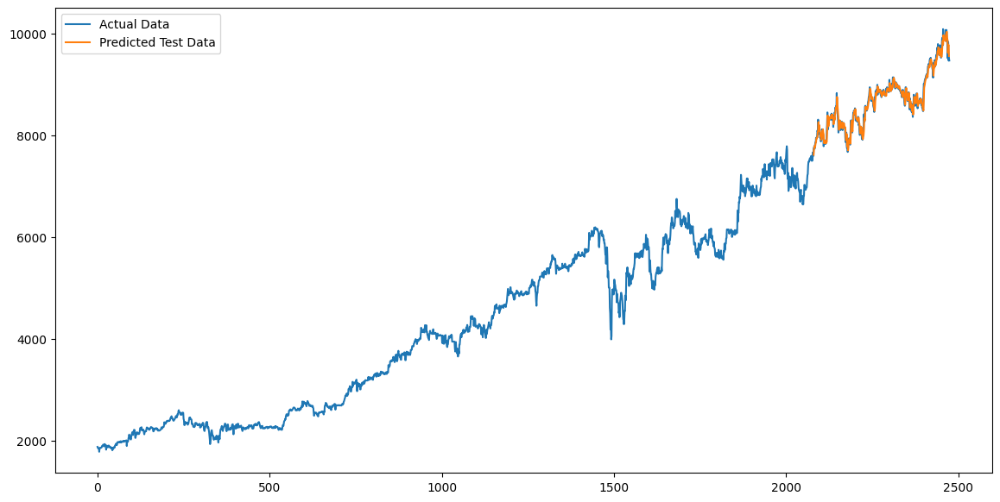

In [ ]:
# Membuat gambar (figure) dengan ukuran 14x7
plt.figure(figsize=(14, 7))
# Membuat plot garis untuk data aktual dengan label 'Actual Data'
plt.plot(bbca_hist3, label='Actual Data')
# Membuat plot garis untuk data prediksi pada dengan label 'Predicted Test Data'
plt.plot(testPredictPlot_bbca_gru, label='Predicted Test Data')
# Menambahkan legenda ke plot berdasarkan label-label yang telah ditentukan sebelumnya
plt.legend()
# Menampilkan plot
plt.show()

In [ ]:
# Fungsi menghitung MAPE
def mean_absolute_percentage_error(y_true, y_pred):
    y_true, y_pred = np.array(y_true), np.array(y_pred)
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100

In [ ]:
# Melihat Metric Evaluation RMSE dan MAPE
mape_gru_l3_bbca = mean_absolute_percentage_error(Y_test_bbca_gru,test_predict_bbca_gru)
print("RMSE of GRU:", np.sqrt(mean_squared_error(Y_test_bbca_gru,test_predict_bbca_gru)))
print("MAPE of GRU:", mape_gru_l3_bbca)

RMSE of GRU: 102.15549359192005
MAPE of GRU: 0.8871233526273846


Diperoleh bahwa hasil model dari hyperparameter tuning & optimization ini sudah dapat memprediksi harga saham lebih baik daripada baseline model, terbukti dari error yang lebih kecil. Namun, selanjutnya akan kembali dilakukan hyperparameter tuning & optimization untuk mencari apakah terdapat model yang lebih baik daripada model yang telah diperoleh ini.

#### Hyperparameter Tuning & Optimization Model using 6 Layers - Worst Model

In [ ]:
# Mengambil kolom close
bbca_hist2 = bbca_hist['Close']

In [ ]:
# Train-Test Split
train_size = int(len(bbca_hist2) * 0.80)
test_size = len(bbca_hist2) - train_size
train_data_bbca_gru, test_data_bbca_gru = bbca_hist2[:train_size], bbca_hist2[train_size:]

# Scalling data
scaler = MinMaxScaler()
bbca_hist2 = scaler.fit_transform(np.array(bbca_hist2).reshape(-1,1))
train_data_bbca_gru = scaler.fit_transform(np.array(train_data_bbca_gru).reshape(-1, 1))
test_data_bbca_gru = scaler.transform(np.array(test_data_bbca_gru).reshape(-1, 1))

In [ ]:
def create_dataset(dataset, time_step = 1):
    dataX,dataY = [],[]
    for i in range(len(dataset)-time_step-1):
                   a = dataset[i:(i+time_step),0]
                   dataX.append(a)
                   dataY.append(dataset[i + time_step,0])
    return np.array(dataX),np.array(dataY)

In [ ]:
# Memanggil fungsi create_dataset untuk membagi data menjadi dataset input dan output dataset dengan times step 100
time_step = 100
X_train_bbca_gru,Y_train_bbca_gru =  create_dataset(train_data_bbca_gru,time_step)
X_test_bbca_gru,Y_test_bbca_gru =  create_dataset(test_data_bbca_gru,time_step)

In [ ]:
Y_train_bbca_gru

array([0.05961774, 0.06537174, 0.06105634, ..., 0.95233376, 0.95630596,
       0.95233376])

In [ ]:
# Memeriksa value
print(X_train_bbca_gru.shape)
print(X_train_bbca_gru)
print(X_test_bbca_gru.shape)
print(Y_test_bbca_gru.shape)

(1879, 100)
[[0.01642952 0.01285785 0.01285785 ... 0.04091778 0.04954859 0.05817936]
 [0.01285785 0.01285785 0.01142917 ... 0.04954859 0.05817936 0.05961774]
 [0.01285785 0.01142917 0.01142917 ... 0.05817936 0.05961774 0.06537174]
 ...
 [0.88875222 0.87687552 0.8649989  ... 1.         0.96822245 0.95233376]
 [0.87687552 0.8649989  0.88083453 ... 0.96822245 0.95233376 0.95233376]
 [0.8649989  0.88083453 0.86895783 ... 0.95233376 0.95233376 0.95630596]]
(394, 100)
(394,)


In [ ]:
# Tetapkan seed untuk inisialisasi acak
seed_value = 42
tf.random.set_seed(seed_value)
np.random.seed(seed_value)

# Definisikan fungsi untuk membuat model GRU dengan hyperparameter
def build_model_l6(hp):
    model = tf.keras.Sequential()
    model.add(tf.keras.layers.GRU(
        units=hp.Int('units_1', min_value=50, max_value=100, step=10),
        return_sequences=True,
        input_shape=(X_train_bbca_gru.shape[1], 1)
    ))
    model.add(tf.keras.layers.GRU(
        units=hp.Int('units_2', min_value=50, max_value=100, step=10),
        return_sequences=True
    ))
    model.add(tf.keras.layers.GRU(
        units=hp.Int('units_3', min_value=50, max_value=100, step=10),
        return_sequences=True
    ))
    model.add(tf.keras.layers.GRU(
        units=hp.Int('units_4', min_value=50, max_value=100, step=10),
        return_sequences=True
    ))
    model.add(tf.keras.layers.GRU(
        units=hp.Int('units_5', min_value=50, max_value=100, step=10)
    ))
    model.add(tf.keras.layers.Dense(1))

    model.compile(
        optimizer=tf.keras.optimizers.Adam(
            hp.Choice('learning_rate', values=[1e-2, 1e-3, 1e-4])
        ),
        loss='mean_squared_error'
    )
    return model


In [ ]:
# Atur pencarian hyperparameter menggunakan RandomSearch
tuner = RandomSearch(
    build_model_l6,
    objective='val_loss',
    max_trials=10,  # Jumlah percobaan untuk menemukan kombinasi hyperparameter terbaik
    executions_per_trial=1,  # Jumlah eksekusi per percobaan untuk akurasi lebih baik
    directory='hyperparameter_tuning_l6',
    project_name='gru_tuning_l6'
)

# Tentukan data pelatihan dan validasi
tuner.search(X_train_bbca_gru, Y_train_bbca_gru, validation_data=(X_test_bbca_gru, Y_test_bbca_gru), epochs=30, batch_size=66, verbose=1)

# Mendapatkan hasil terbaik
best_hps_l6_bbca = tuner.get_best_hyperparameters(num_trials=1)[0]

# Membangun model dengan hyperparameter terbaik
model_bbca_gru_l6 = build_model_l6(best_hps_l6_bbca)

Trial 10 Complete [00h 08m 34s]
val_loss: 0.0003052641695830971

Best val_loss So Far: 0.0003052641695830971
Total elapsed time: 01h 20m 06s


In [ ]:
print(best_hps_l6_bbca)

In [ ]:
# Melihat rangkuman model
model_bbca_gru_l6.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 gru_5 (GRU)                 (None, 100, 70)           15330     
                                                                 
 gru_6 (GRU)                 (None, 100, 100)          51600     
                                                                 
 gru_7 (GRU)                 (None, 100, 100)          60600     
                                                                 
 gru_8 (GRU)                 (None, 100, 70)           36120     
                                                                 
 gru_9 (GRU)                 (None, 60)                23760     
                                                                 
 dense_1 (Dense)             (None, 1)                 61        
                                                                 
Total params: 187471 (732.31 KB)
Trainable params: 187

In [ ]:
# Menetapkan seed untuk TensorFlow untuk memastikan hasil yang konsisten dari operasi stokastik (jika ada)
tf.random.set_seed(seed_value)

# Melatih model menggunakan data pelatihan (X_train_bbca dan Y_train_bbca) dengan data validasi (X_test_bbca dan Y_test_bbca)
# Epochs adalah jumlah kali seluruh dataset akan diberikan kepada model selama proses pelatihan
# Batch_size adalah jumlah sampel data yang akan diproses sebelum pembaharuan bobot model
# verbose = 1 menghasilkan output detail pada setiap epoch selama pelatihan
model_bbca_gru_l6.fit(X_train_bbca_gru, Y_train_bbca_gru, validation_data=(X_test_bbca_gru, Y_test_bbca_gru), epochs=50, batch_size=64, verbose=1)
model_bbca_gru_l6.save("model_bbri_gru_l6.h5")

Epoch 1/50
30/30 [==============================] - 47s 1s/step - loss: 0.1235 - val_loss: 0.0083
Epoch 2/50
30/30 [==============================] - 16s 528ms/step - loss: 0.0010 - val_loss: 0.0031
Epoch 3/50
30/30 [==============================] - 16s 532ms/step - loss: 2.2796e-04 - val_loss: 8.1875e-04
Epoch 4/50
30/30 [==============================] - 16s 521ms/step - loss: 1.9466e-04 - val_loss: 0.0010
Epoch 5/50
30/30 [==============================] - 16s 530ms/step - loss: 1.9360e-04 - val_loss: 0.0033
Epoch 6/50
30/30 [==============================] - 16s 528ms/step - loss: 2.0678e-04 - val_loss: 5.5819e-04
Epoch 7/50
30/30 [==============================] - 16s 554ms/step - loss: 1.6910e-04 - val_loss: 0.0010
Epoch 8/50
30/30 [==============================] - 16s 532ms/step - loss: 1.8697e-04 - val_loss: 0.0023
Epoch 9/50
30/30 [==============================] - 17s 545ms/step - loss: 2.2138e-04 - val_loss: 0.0014
Epoch 10/50
30/30 [==============================] - 17s 5

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


In [ ]:
# Memprediksi data menggunakan model yang telah dilatih
train_predict_bbca_gru = model_bbca_gru_l6.predict(X_train_bbca_gru)
test_predict_bbca_gru = model_bbca_gru_l6.predict(X_test_bbca_gru)

In [ ]:
Y_train_bbca_gru[:5]

In [ ]:
train_predict_bbca_gru[:5]

In [ ]:
# Transformasi data ke bentuk awal
Y_train_bbca_gru = scaler.inverse_transform(Y_train_bbca_gru.reshape(-1, 1))
Y_test_bbca_gru = scaler.inverse_transform(Y_test_bbca_gru.reshape(-1, 1))
train_predict_bbca_gru = scaler.inverse_transform(train_predict_bbca_gru)
test_predict_bbca_gru = scaler.inverse_transform(test_predict_bbca_gru)

In [ ]:
Y_test_bbca_gru[:5]

array([[7742.99121094],
       [7766.74267578],
       [7790.49511719],
       [7742.99121094],
       [7814.24658203]])

In [ ]:
test_predict_bbca_gru[:5]

array([[7555.9155],
       [7649.8315],
       [7684.9053],
       [7703.454 ],
       [7678.447 ]], dtype=float32)

In [ ]:
# Mendefinisikan jumlah langkah waktu sebelumnya yang akan digunakan sebagai input untuk memprediksi langkah waktu saat ini
look_back = 100

# Membuat array kosong dengan ukuran yang sama dengan bbca_hist2
trainPredictPlot_bbca = np.empty_like(bbca_hist2)
# Mengisi array dengan nilai yang sama dengan NaN (untuk plot)
trainPredictPlot_bbca[:,:] = np.nan
# Mengisi bagian dari array dengan hasil prediksi pada data pelatihan
# Menempatkan hasil prediksi pada posisi yang sesuai dalam array untuk plotting
trainPredictPlot_bbca[look_back : len(train_predict_bbca_gru)+look_back,:] = train_predict_bbca_gru

# Membuat array kosong dengan ukuran yang sama dengan bbri_hist2
testPredictPlot_bbca_gru = np.empty_like(bbca_hist2)
# Mengisi array dengan nilai yang sama dengan NaN (untuk plot)
testPredictPlot_bbca_gru[:,:] = np.nan
# Mengisi bagian dari array dengan hasil prediksi pada data uji
# Menempatkan hasil prediksi pada posisi yang sesuai dalam array untuk plotting
testPredictPlot_bbca_gru[len(train_predict_bbca_gru) + (look_back) * 2 + 1 : len(bbca_hist2) - 1, :] = test_predict_bbca_gru

In [ ]:
# Mengambil data harga saham close dan dijadikan dalam bentuk array numpy
bbca_hist3=bbca_hist['Close'].to_numpy()

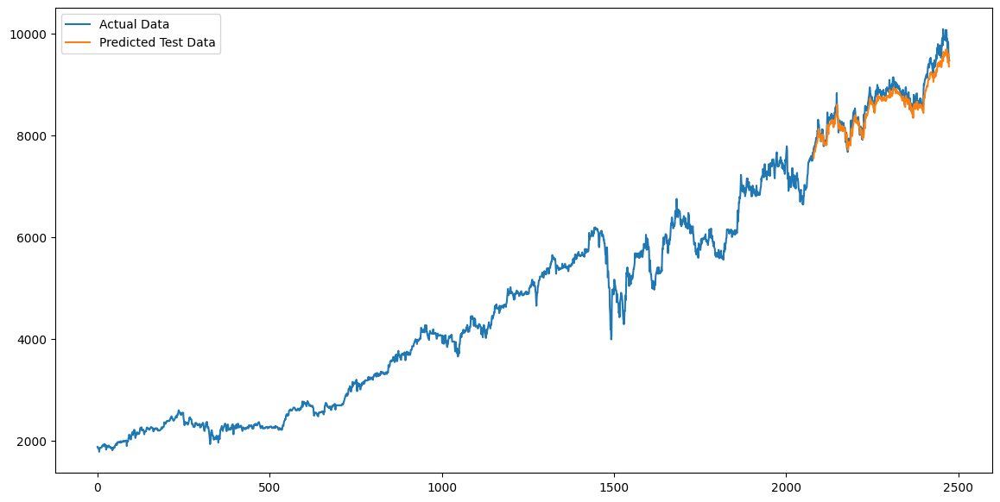

In [ ]:
# Membuat gambar (figure) dengan ukuran 14x7
plt.figure(figsize=(14, 7))
# Membuat plot garis untuk data aktual dengan label 'Actual Data'
plt.plot(bbca_hist3, label='Actual Data')
# Membuat plot garis untuk data prediksi pada dengan label 'Predicted Test Data'
plt.plot(testPredictPlot_bbca_gru, label='Predicted Test Data')
# Menambahkan legenda ke plot berdasarkan label-label yang telah ditentukan sebelumnya
plt.legend()
# Menampilkan plot
plt.show()

In [ ]:
# Fungsi menghitung MAPE
def mean_absolute_percentage_error(y_true, y_pred):
    y_true, y_pred = np.array(y_true), np.array(y_pred)
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100

In [ ]:
# Melihat Metric Evaluation RMSE dan MAPE
mape_gru_l6_bbca = mean_absolute_percentage_error(Y_test_bbca_gru,test_predict_bbca_gru)
print("RMSE of GRU:", np.sqrt(mean_squared_error(Y_test_bbca_gru,test_predict_bbca_gru)))
print("MAPE of GRU:", mape_gru_l6_bbca)

RMSE of GRU: 178.30041866279632
MAPE of GRU: 1.6164933367890786


Diperoleh bahwa model hasil hyperparameter tuning & optimization ini tidak lebih baik daripada model yang telah diperoleh sebelumnya, terbukti dari error yang lebih besar. Oleh karena itu, untuk memprediksi harga saham ke depannya, akan digunakan model terbaik yang telah diperoleh sebelumnya.

#### Forecasting using Best Model

Setelah diperoleh model terbaik yaitu GRU dengan 3 layer yaitu:
1. Input layer dengan 100 unit neuron
2. Hidden layer dengan 80 unit neuron
3. Output layer Dense dengan 1 unit neuron

akan dilakukan prediksi harga saham BBCA 30 hari ke depan menggunakan model tersebut.

In [ ]:
# Mengambil kolom close
bbca_hist2 = bbca_hist['Close']

In [ ]:
# Train-Test Split
train_size = int(len(bbca_hist2) * 0.80)
test_size = len(bbca_hist2) - train_size
train_data_bbca_gru, test_data_bbca_gru = bbca_hist2[:train_size], bbca_hist2[train_size:]

In [ ]:
test_data_bbca_gru.head()

Date
2022-03-25    7438.972656
2022-03-28    7505.476562
2022-03-29    7457.973633
2022-03-30    7481.724609
2022-03-31    7576.730957
Name: Close, dtype: float64

In [ ]:
# Data yang digunakan untuk prediksi adalah data test (data terbaru)
df_bbca = test_data_bbca_gru.copy()

# Menampilkan 5 baris pertama dari Dataframe
print("DataFrame awal:")
print(df_bbca.head())

# Menampilkan 5 baris terakhir dari Dataframe
print("\nDataFrame akhir:")
print(df_bbca.tail())

# 1. Load model
model_bbca = load_model('/content/drive/MyDrive/Saved Models/model_bbca_gru_l3.h5')

# 2. Prepare data (gunakan data dari 100 hari terakhir)
last_n_days = 100  # Menggunakan 100 hari terakhir sesuai kebutuhan model
data_to_predict_bbca = bbca_hist['Close'][-last_n_days:].values

# 3. Scaling data (misalnya menggunakan MinMaxScaler)
scaler = MinMaxScaler(feature_range=(0, 1))
data_to_predict_bbca_scaled = scaler.fit_transform(data_to_predict_bbca.reshape(-1, 1))

# 4. Reshape data
data_to_predict_bbca_scaled = np.reshape(data_to_predict_bbca_scaled, (1, last_n_days, 1))

# 5. Predict multiple days into the future
n_days_to_predict = 30
predictions_bbca = []

for i in range(n_days_to_predict):
    # Predict
    predicted_scaled_bbca = model_bbca.predict(data_to_predict_bbca_scaled)
    predicted_bbca = scaler.inverse_transform(predicted_scaled_bbca)

    # Save prediction
    predictions_bbca.append(predicted_bbca[0][0])

    # Update data_to_predict_scaled for the next prediction
    data_to_predict_bbca_scaled = np.append(data_to_predict_bbca_scaled[:, 1:, :], np.reshape(predicted_scaled_bbca, (1, 1, 1)), axis=1)

# Print the predicted values
print("\nPredicted values for the next days:")
print(predictions_bbca)

# Mendapatkan tanggal terakhir dari data asli
last_date = bbca_hist.index[-1]

# Membuat rangkaian tanggal hari kerja untuk hasil prediksi
prediction_dates = pd.date_range(start=last_date + pd.Timedelta(days=1), periods=n_days_to_predict, freq='B')

# Membuat DataFrame baru untuk hasil prediksi
prediction_df_bbca = pd.DataFrame({'Date': prediction_dates, 'Predicted_Close': predictions_bbca})

# Menampilkan DataFrame prediksi
print("\nPrediction DataFrame:")
print(prediction_df_bbca)


DataFrame awal:
Date
2022-03-25    7438.972656
2022-03-28    7505.476562
2022-03-29    7457.973633
2022-03-30    7481.724609
2022-03-31    7576.730957
Name: Close, dtype: float64

DataFrame akhir:
Date
2024-04-04    9850.0
2024-04-05    9825.0
2024-04-16    9475.0
2024-04-17    9525.0
2024-04-18    9475.0
Name: Close, dtype: float64
1/1 [==============================] - 0s 31ms/step

Predicted values for the next days:
[9472.734, 9472.35, 9470.345, 9470.074, 9470.298, 9470.92, 9471.775, 9472.767, 9473.836, 9474.953, 9476.101, 9477.266, 9478.442, 9479.63, 9480.823, 9482.024, 9483.231, 9484.445, 9485.667, 9486.895, 9488.131, 9489.374, 9490.626, 9491.887, 9493.155, 9494.433, 9495.72, 9497.015, 9498.32, 9499.634]

Prediction DataFrame:
         Date  Predicted_Close
0  2024-04-19      9472.734375
1  2024-04-22      9472.349609
2  2024-04-23      9470.344727
3  2024-04-24      9470.074219
4  2024-04-25      9470.297852
5  2024-04-26      9470.919922
6  2024-04-29      9471.775391
7  2024-0

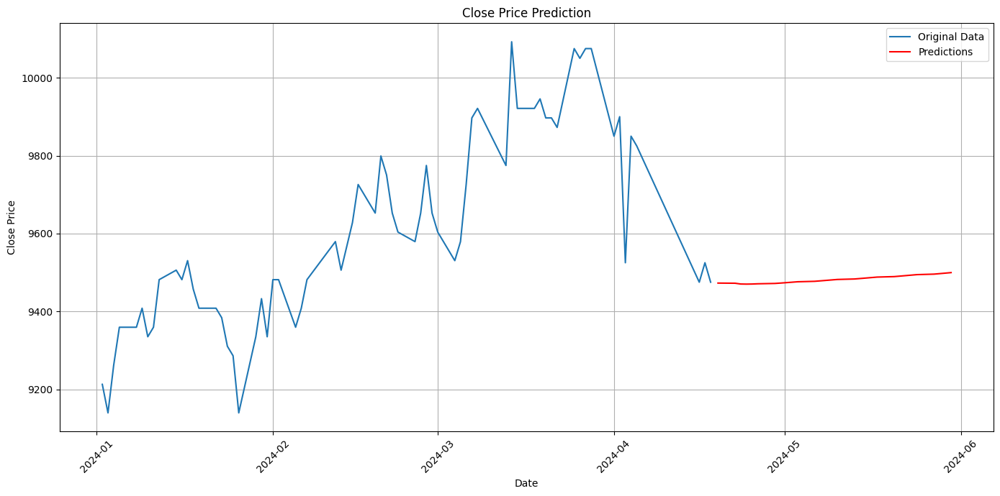

In [ ]:
# Plotting the results
plt.figure(figsize=(14, 7))
# Plot the original data
plt.plot(bbca_hist[bbni_hist['Date'] > '2024-01-01']['Date'], bbca_hist[bbni_hist['Date'] > '2024-01-01']['Close'], label='Original Data')
# Plot the predictions
plt.plot(prediction_df_bbca['Date'], prediction_df_bbca['Predicted_Close'], label='Predictions', color='red')
# Formatting the plot
plt.xlabel('Date')
plt.ylabel('Close Price')
plt.title('Close Price Prediction')
plt.legend()
plt.grid(True)
plt.xticks(rotation=45)
plt.tight_layout()
# Display the plot
plt.show()

Dari hasil prediksi di atas, dapat diketahui bahwa dalam 30 hari ke depan, harga saham bank BCA akan sedikit meningkat.

### Bank Negara Indonesia (BBNI)

#### Baseline Model

In [ ]:
# Mengambil kolom close
bbni_hist2 = bbni_hist['Close']

In [ ]:
# Train-Test Split
train_size = int(len(bbni_hist2) * 0.80)
test_size = len(bbni_hist2) - train_size
train_data_bbni_gru, test_data_bbni_gru = bbni_hist2[:train_size], bbni_hist2[train_size:]

# Scalling data
scaler = MinMaxScaler()
bbni_hist2 = scaler.fit_transform(np.array(bbni_hist2).reshape(-1,1))
train_data_bbni_gru = scaler.fit_transform(np.array(train_data_bbni_gru).reshape(-1, 1))
test_data_bbni_gru = scaler.transform(np.array(test_data_bbni_gru).reshape(-1, 1))

In [ ]:
def create_dataset(dataset, time_step = 1):
    dataX,dataY = [],[]
    for i in range(len(dataset)-time_step-1):
                   a = dataset[i:(i+time_step),0]
                   dataX.append(a)
                   dataY.append(dataset[i + time_step,0])
    return np.array(dataX),np.array(dataY)

In [ ]:
# Memanggil fungsi create_dataset untuk membagi data menjadi dataset input dan output dataset dengan times step 100
time_step = 100
X_train_bbni_gru,Y_train_bbni_gru =  create_dataset(train_data_bbni_gru,time_step)
X_test_bbni_gru,Y_test_bbni_gru =  create_dataset(test_data_bbni_gru,time_step)

In [ ]:
Y_train_bbni_gru

array([0.29283186, 0.28595536, 0.28939361, ..., 0.80052569, 0.79242167,
       0.80052569])

In [ ]:
# Memeriksa value
print(X_train_bbni_gru.shape)
print(X_train_bbni_gru)
print(X_test_bbni_gru.shape)
print(Y_test_bbni_gru.shape)

(1879, 100)
[[0.16922348 0.16922348 0.16922348 ... 0.25844987 0.26532611 0.29283186]
 [0.16922348 0.16922348 0.1592112  ... 0.26532611 0.29283186 0.29283186]
 [0.16922348 0.1592112  0.16588601 ... 0.29283186 0.29283186 0.28595536]
 ...
 [0.67086193 0.63844604 0.63439403 ... 0.84509752 0.82483765 0.83699359]
 [0.63844604 0.63439403 0.6262901  ... 0.82483765 0.83699359 0.80052569]
 [0.63439403 0.6262901  0.60197813 ... 0.83699359 0.80052569 0.79242167]]
(394, 100)
(394,)


In [ ]:
# Tetapkan seed untuk inisialisasi acak
seed_value = 42
tf.random.set_seed(seed_value)
np.random.seed(seed_value)

# Membangun model GRU
model_bbni_gru1 = tf.keras.Sequential([
      # Menambahkan layer GRU pertama dengan 50 unit dan pengembalian urutan yang digunakan untuk menjaga urutan output
      # Input_shape adalah bentuk input, yaitu jumlah langkah waktu (X_train_bbni.shape[1]) dan fitur (1)
      tf.keras.layers.GRU(50, return_sequences=True, input_shape=(X_train_bbni_gru.shape[1], 1)),
      # Menambahkan layer GRU kedua dengan 50 unit, tidak ada pengembalian urutan karena ini adalah lapisan terakhir GRU
      tf.keras.layers.GRU(50),
      # Menambahkan layer Dense dengan 1 unit sebagai output layer
      tf.keras.layers.Dense(1)
])
# Mengompilasi model dengan loss function 'mean_squared_error' dan optimizer 'adam'
model_bbni_gru1.compile(loss='mean_squared_error', optimizer='adam')

In [ ]:
# Melihat rangkuman model
model_bbni_gru1.summary()

Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 gru_4 (GRU)                 (None, 100, 50)           7950      
                                                                 
 gru_5 (GRU)                 (None, 50)                15300     
                                                                 
 dense_2 (Dense)             (None, 1)                 51        
                                                                 
Total params: 23301 (91.02 KB)
Trainable params: 23301 (91.02 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________


In [ ]:
# Menetapkan seed untuk TensorFlow untuk memastikan hasil yang konsisten dari operasi stokastik (jika ada)
tf.random.set_seed(seed_value)

# Melatih model menggunakan data pelatihan (X_train_bbni dan Y_train_bbni) dengan data validasi (X_test_bbni dan Y_test_bbni)
# Epochs adalah jumlah kali seluruh dataset akan diberikan kepada model selama proses pelatihan
# Batch_size adalah jumlah sampel data yang akan diproses sebelum pembaharuan bobot model
# verbose = 1 menghasilkan output detail pada setiap epoch selama pelatihan
model_bbni_gru1.fit(X_train_bbni_gru, Y_train_bbni_gru, validation_data=(X_test_bbni_gru, Y_test_bbni_gru), epochs=50, batch_size=64, verbose=1)

Epoch 1/50
30/30 [==============================] - 9s 123ms/step - loss: 0.0318 - val_loss: 0.0144
Epoch 2/50
30/30 [==============================] - 3s 95ms/step - loss: 0.0025 - val_loss: 0.0018
Epoch 3/50
30/30 [==============================] - 3s 108ms/step - loss: 0.0010 - val_loss: 0.0015
Epoch 4/50
30/30 [==============================] - 4s 147ms/step - loss: 9.5669e-04 - val_loss: 0.0011
Epoch 5/50
30/30 [==============================] - 3s 97ms/step - loss: 8.9389e-04 - val_loss: 0.0014
Epoch 6/50
30/30 [==============================] - 3s 97ms/step - loss: 8.5147e-04 - val_loss: 9.3443e-04
Epoch 7/50
30/30 [==============================] - 3s 96ms/step - loss: 8.1012e-04 - val_loss: 0.0012
Epoch 8/50
30/30 [==============================] - 4s 152ms/step - loss: 7.6464e-04 - val_loss: 0.0012
Epoch 9/50
30/30 [==============================] - 3s 94ms/step - loss: 7.3357e-04 - val_loss: 8.8065e-04
Epoch 10/50
30/30 [==============================] - 3s 96ms/step - loss:

In [ ]:
# Memprediksi data menggunakan model yang telah dilatih
train_predict_bbni_gru = model_bbni_gru1.predict(X_train_bbni_gru)
test_predict_bbni_gru = model_bbni_gru1.predict(X_test_bbni_gru)

13/13 [==============================] - 0s 30ms/step


In [ ]:
Y_train_bbni_gru[:5]

array([0.29283186, 0.28595536, 0.28939361, 0.29627003, 0.28595536])

In [ ]:
train_predict_bbni_gru[:5]

array([[0.2877834 ],
       [0.29377317],
       [0.2889945 ],
       [0.29026926],
       [0.29615685]], dtype=float32)

In [ ]:
# Transformasi data ke bentuk awal
Y_train_bbni_gru = scaler.inverse_transform(Y_train_bbni_gru.reshape(-1, 1))
Y_test_bbni_gru = scaler.inverse_transform(Y_test_bbni_gru.reshape(-1, 1))
train_predict_bbni_gru = scaler.inverse_transform(train_predict_bbni_gru)
test_predict_bbni_gru = scaler.inverse_transform(test_predict_bbni_gru)

In [ ]:
Y_test_bbni_gru[:5]

array([[3751.21899414],
       [3854.14868164],
       [3899.89526367],
       [3899.89526367],
       [3979.95166016]])

In [ ]:
test_predict_bbni_gru[:5]

array([[3793.886 ],
       [3749.276 ],
       [3849.5225],
       [3902.9565],
       [3903.297 ]], dtype=float32)

In [ ]:
# Mendefinisikan jumlah langkah waktu sebelumnya yang akan digunakan sebagai input untuk memprediksi langkah waktu saat ini
look_back = 100

# Membuat array kosong dengan ukuran yang sama dengan bbni_hist2
trainPredictPlot_bbni = np.empty_like(bbni_hist2)
# Mengisi array dengan nilai yang sama dengan NaN (untuk plot)
trainPredictPlot_bbni[:,:] = np.nan
# Mengisi bagian dari array dengan hasil prediksi pada data pelatihan
# Menempatkan hasil prediksi pada posisi yang sesuai dalam array untuk plotting
trainPredictPlot_bbni[look_back : len(train_predict_bbni_gru)+look_back,:] = train_predict_bbni_gru

# Membuat array kosong dengan ukuran yang sama dengan bbni_hist2
testPredictPlot_bbni_gru= np.empty_like(bbni_hist2)
# Mengisi array dengan nilai yang sama dengan NaN (untuk plot)
testPredictPlot_bbni_gru[:,:] = np.nan
# Mengisi bagian dari array dengan hasil prediksi pada data uji
# Menempatkan hasil prediksi pada posisi yang sesuai dalam array untuk plotting
testPredictPlot_bbni_gru[len(train_predict_bbni_gru) + (look_back) * 2 + 1 : len(bbni_hist2) - 1, :] = test_predict_bbni_gru

In [ ]:
# Mengambil data harga saham close dan dijadikan dalam bentuk array numpy
bbni_hist3=bbni_hist['Close'].to_numpy()

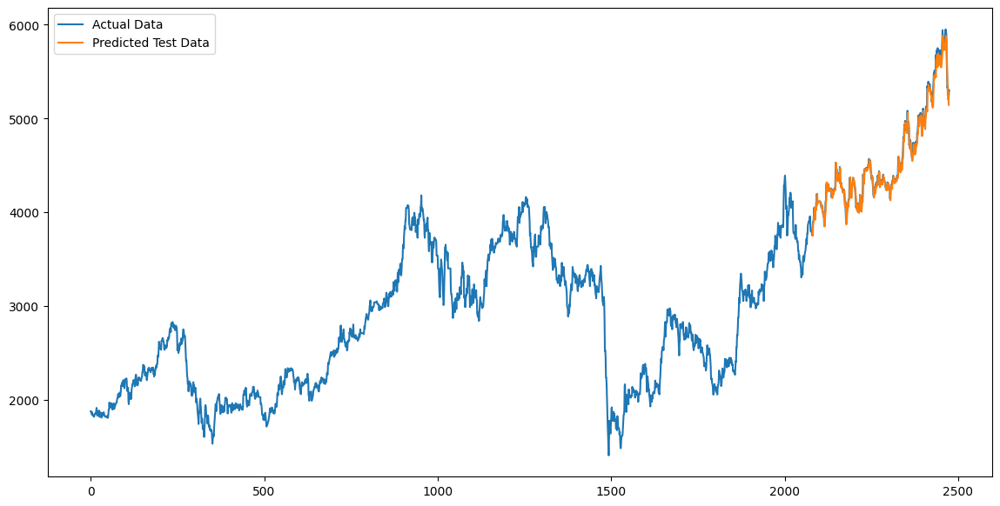

In [ ]:
# Membuat gambar (figure) dengan ukuran 14x7
plt.figure(figsize=(14, 7))
# Membuat plot garis untuk data aktual dengan label 'Actual Data'
plt.plot(bbni_hist3, label='Actual Data')
# Membuat plot garis untuk data prediksi pada dengan label 'Predicted Test Data'
plt.plot(testPredictPlot_bbni_gru, label='Predicted Test Data')
# Menambahkan legenda ke plot berdasarkan label-label yang telah ditentukan sebelumnya
plt.legend()
# Menampilkan plot
plt.show()

In [ ]:
# Fungsi menghitung MAPE
def mean_absolute_percentage_error(y_true, y_pred):
    y_true, y_pred = np.array(y_true), np.array(y_pred)
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100

In [ ]:
# Melihat Metric Evaluation RMSE dan MAPE
mape_gru1_bbni = mean_absolute_percentage_error(Y_test_bbni_gru,test_predict_bbni_gru)
print("RMSE of GRU:", np.sqrt(mean_squared_error(Y_test_bbni_gru,test_predict_bbni_gru)))
print("MAPE of GRU:", mape_gru1_bbni)

RMSE of GRU: 67.46468265324047
MAPE of GRU: 1.0610621335530666


Diperoleh bahwa baseline model sudah dapat memprediksi data saham dengan sangat baik, terbukti dari error yang kecil. Namun, selanjutnya akan tetap dilakukan hyperparameter tuning & optimization untuk mencari model yang lebih baik daripada baseline model.

#### Hyperparameter Tuning & Optimization Model using 3 Layers - Best Model

In [ ]:
# Mengambil kolom close
bbni_hist2 = bbni_hist['Close']

In [ ]:
# Train-Test Split
train_size = int(len(bbni_hist2) * 0.80)
test_size = len(bbni_hist2) - train_size
train_data_bbni_gru, test_data_bbni_gru = bbni_hist2[:train_size], bbni_hist2[train_size:]

# Scalling data
scaler = MinMaxScaler()
bbni_hist2 = scaler.fit_transform(np.array(bbni_hist2).reshape(-1,1))
train_data_bbni_gru = scaler.fit_transform(np.array(train_data_bbni_gru).reshape(-1, 1))
test_data_bbni_gru = scaler.transform(np.array(test_data_bbni_gru).reshape(-1, 1))

In [ ]:
def create_dataset(dataset, time_step = 1):
    dataX,dataY = [],[]
    for i in range(len(dataset)-time_step-1):
                   a = dataset[i:(i+time_step),0]
                   dataX.append(a)
                   dataY.append(dataset[i + time_step,0])
    return np.array(dataX),np.array(dataY)

In [ ]:
# Memanggil fungsi create_dataset untuk membagi data menjadi dataset input dan output dataset dengan times step 100
time_step = 100
X_train_bbni_gru,Y_train_bbni_gru =  create_dataset(train_data_bbni_gru,time_step)
X_test_bbni_gru,Y_test_bbni_gru =  create_dataset(test_data_bbni_gru,time_step)

In [ ]:
Y_train_bbni_gru

array([0.29283186, 0.28595536, 0.28939361, ..., 0.80052569, 0.79242167,
       0.80052569])

In [ ]:
# Memeriksa value
print(X_train_bbni_gru.shape)
print(X_train_bbni_gru)
print(X_test_bbni_gru.shape)
print(Y_test_bbni_gru.shape)

(1879, 100)
[[0.16922348 0.16922348 0.16922348 ... 0.25844987 0.26532611 0.29283186]
 [0.16922348 0.16922348 0.1592112  ... 0.26532611 0.29283186 0.29283186]
 [0.16922348 0.1592112  0.16588601 ... 0.29283186 0.29283186 0.28595536]
 ...
 [0.67086193 0.63844604 0.63439403 ... 0.84509752 0.82483765 0.83699359]
 [0.63844604 0.63439403 0.6262901  ... 0.82483765 0.83699359 0.80052569]
 [0.63439403 0.6262901  0.60197813 ... 0.83699359 0.80052569 0.79242167]]
(394, 100)
(394,)


In [ ]:
# Tetapkan seed untuk inisialisasi acak
seed_value = 42
tf.random.set_seed(seed_value)
np.random.seed(seed_value)

# Definisikan fungsi untuk membuat model GRU dengan hyperparameter
def build_model_l3(hp):
    model = tf.keras.Sequential()
    model.add(tf.keras.layers.GRU(
        units=hp.Int('units_1', min_value=50, max_value=200, step=50),
        return_sequences=True,
        input_shape=(X_train_bbni_gru.shape[1], 1)
    ))
    model.add(tf.keras.layers.GRU(
        units=hp.Int('units_2', min_value=50, max_value=200, step=50)
    ))
    model.add(tf.keras.layers.Dense(1))

    model.compile(
        optimizer=tf.keras.optimizers.Adam(
            hp.Choice('learning_rate', values=[1e-2, 1e-3, 1e-4])
        ),
        loss='mean_squared_error'
    )
    return model


In [ ]:
# Atur pencarian hyperparameter menggunakan RandomSearch
tuner = RandomSearch(
    build_model_l3,
    objective='val_loss',
    max_trials=10,  # Jumlah percobaan untuk menemukan kombinasi hyperparameter terbaik
    executions_per_trial=1,  # Jumlah eksekusi per percobaan untuk akurasi lebih baik
    directory='hyperparameter_tuning_l3_bbni',
    project_name='gru_tuning_l3_bbni'
)

# Tentukan data pelatihan dan validasi
tuner.search(X_train_bbni_gru, Y_train_bbni_gru, validation_data=(X_test_bbni_gru, Y_test_bbni_gru), epochs=30, batch_size=64, verbose=1)

# Mendapatkan hasil terbaik
best_hps_l3_bbni = tuner.get_best_hyperparameters(num_trials=1)[0]

# Membangun model dengan hyperparameter terbaik
model_bbni_gru_l3 = build_model_l3(best_hps_l3_bbni)

Trial 10 Complete [00h 05m 30s]
val_loss: 0.000520433415658772

Best val_loss So Far: 0.0005094793741591275
Total elapsed time: 01h 12m 36s


In [ ]:
print(best_hps_l3_bbni)

In [ ]:
# Melihat rangkuman model
model_bbni_gru_l3.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 gru_2 (GRU)                 (None, 100, 100)          30900     
                                                                 
 gru_3 (GRU)                 (None, 150)               113400    
                                                                 
 dense_1 (Dense)             (None, 1)                 151       
                                                                 
Total params: 144451 (564.26 KB)
Trainable params: 144451 (564.26 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________


In [ ]:
# Menetapkan seed untuk TensorFlow untuk memastikan hasil yang konsisten dari operasi stokastik (jika ada)
tf.random.set_seed(seed_value)

# Melatih model menggunakan data pelatihan (X_train_bbni dan Y_train_bbni) dengan data validasi (X_test_bbni dan Y_test_bbni)
# Epochs adalah jumlah kali seluruh dataset akan diberikan kepada model selama proses pelatihan
# Batch_size adalah jumlah sampel data yang akan diproses sebelum pembaharuan bobot model
# verbose = 1 menghasilkan output detail pada setiap epoch selama pelatihan
model_bbni_gru_l3.fit(X_train_bbni_gru, Y_train_bbni_gru, validation_data=(X_test_bbni_gru, Y_test_bbni_gru), epochs=50, batch_size=64, verbose=1)
model_bbni_gru_l3.save("model_bbni_gru_l3.h5")

Epoch 1/50
30/30 [==============================] - 18s 458ms/step - loss: 0.0337 - val_loss: 0.0021
Epoch 2/50
30/30 [==============================] - 14s 461ms/step - loss: 0.0017 - val_loss: 0.0014
Epoch 3/50
30/30 [==============================] - 13s 447ms/step - loss: 9.1032e-04 - val_loss: 0.0015
Epoch 4/50
30/30 [==============================] - 11s 380ms/step - loss: 8.2582e-04 - val_loss: 8.4703e-04
Epoch 5/50
30/30 [==============================] - 12s 399ms/step - loss: 7.7472e-04 - val_loss: 9.0565e-04
Epoch 6/50
30/30 [==============================] - 13s 430ms/step - loss: 7.6132e-04 - val_loss: 7.8355e-04
Epoch 7/50
30/30 [==============================] - 13s 435ms/step - loss: 7.0891e-04 - val_loss: 0.0010
Epoch 8/50
30/30 [==============================] - 13s 448ms/step - loss: 6.8217e-04 - val_loss: 7.1767e-04
Epoch 9/50
30/30 [==============================] - 13s 450ms/step - loss: 6.4165e-04 - val_loss: 6.2900e-04
Epoch 10/50
30/30 [========================

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


In [ ]:
# Memprediksi data menggunakan model yang telah dilatih
train_predict_bbni_gru = model_bbni_gru_l3.predict(X_train_bbni_gru)
test_predict_bbni_gru = model_bbni_gru_l3.predict(X_test_bbni_gru)

13/13 [==============================] - 1s 66ms/step


In [ ]:
Y_train_bbni_gru[:5]

array([0.29283186, 0.28595536, 0.28939361, 0.29627003, 0.28595536])

In [ ]:
train_predict_bbni_gru[:5]

array([[0.28995088],
       [0.29382163],
       [0.288048  ],
       [0.29002592],
       [0.29633057]], dtype=float32)

In [ ]:
# Transformasi data ke bentuk awal
Y_train_bbni_gru = scaler.inverse_transform(Y_train_bbni_gru.reshape(-1, 1))
Y_test_bbni_gru = scaler.inverse_transform(Y_test_bbni_gru.reshape(-1, 1))
train_predict_bbni_gru = scaler.inverse_transform(train_predict_bbni_gru)
test_predict_bbni_gru = scaler.inverse_transform(test_predict_bbni_gru)

In [ ]:
Y_test_bbni_gru[:5]

array([[3751.21899414],
       [3854.14868164],
       [3899.89526367],
       [3899.89526367],
       [3979.95166016]])

In [ ]:
test_predict_bbni_gru[:5]

array([[3800.497 ],
       [3749.549 ],
       [3866.466 ],
       [3910.6646],
       [3905.869 ]], dtype=float32)

In [ ]:
# Mendefinisikan jumlah langkah waktu sebelumnya yang akan digunakan sebagai input untuk memprediksi langkah waktu saat ini
look_back = 100

# Membuat array kosong dengan ukuran yang sama dengan bbni_hist2
trainPredictPlot_bbni = np.empty_like(bbni_hist2)
# Mengisi array dengan nilai yang sama dengan NaN (untuk plot)
trainPredictPlot_bbni[:,:] = np.nan
# Mengisi bagian dari array dengan hasil prediksi pada data pelatihan
# Menempatkan hasil prediksi pada posisi yang sesuai dalam array untuk plotting
trainPredictPlot_bbni[look_back : len(train_predict_bbni_gru)+look_back,:] = train_predict_bbni_gru

# Membuat array kosong dengan ukuran yang sama dengan bbca_hist2
testPredictPlot_bbni_gru = np.empty_like(bbni_hist2)
# Mengisi array dengan nilai yang sama dengan NaN (untuk plot)
testPredictPlot_bbni_gru[:,:] = np.nan
# Mengisi bagian dari array dengan hasil prediksi pada data uji
# Menempatkan hasil prediksi pada posisi yang sesuai dalam array untuk plotting
testPredictPlot_bbni_gru[len(train_predict_bbni_gru) + (look_back) * 2 + 1 : len(bbni_hist2) - 1, :] = test_predict_bbni_gru

In [ ]:
# Mengambil data harga saham close dan dijadikan dalam bentuk array numpy
bbni_hist3=bbni_hist['Close'].to_numpy()

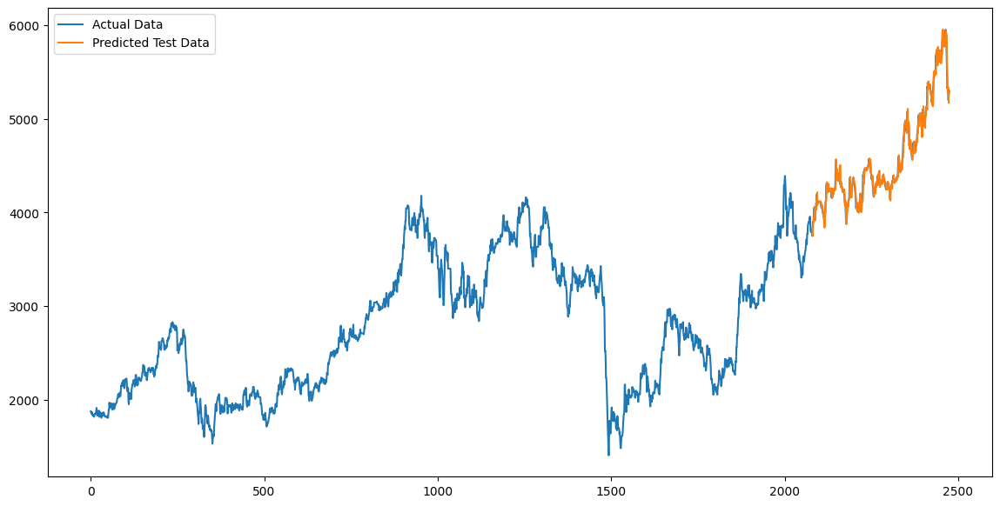

In [ ]:
# Membuat gambar (figure) dengan ukuran 14x7
plt.figure(figsize=(14, 7))
# Membuat plot garis untuk data aktual dengan label 'Actual Data'
plt.plot(bbni_hist3, label='Actual Data')
# Membuat plot garis untuk data prediksi pada dengan label 'Predicted Test Data'
plt.plot(testPredictPlot_bbni_gru, label='Predicted Test Data')
# Menambahkan legenda ke plot berdasarkan label-label yang telah ditentukan sebelumnya
plt.legend()
# Menampilkan plot
plt.show()

In [ ]:
# Fungsi menghitung MAPE
def mean_absolute_percentage_error(y_true, y_pred):
    y_true, y_pred = np.array(y_true), np.array(y_pred)
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100

In [ ]:
# Melihat Metric Evaluation RMSE dan MAPE
mape_gru_l3_bbni = mean_absolute_percentage_error(Y_test_bbni_gru,test_predict_bbni_gru)
print("RMSE of GRU:", np.sqrt(mean_squared_error(Y_test_bbni_gru,test_predict_bbni_gru)))
print("MAPE of GRU:", mape_gru_l3_bbni)

RMSE of GRU: 64.40996848630262
MAPE of GRU: 1.0318176725502963


Diperoleh bahwa hasil model dari hyperparameter tuning & optimization ini sudah dapat memprediksi harga saham lebih baik daripada baseline model, terbukti dari error yang lebih kecil. Namun, selanjutnya akan kembali dilakukan hyperparameter tuning & optimization untuk mencari apakah terdapat model yang lebih baik daripada model yang telah diperoleh ini.

#### Hyperparameter Tuning & Optimization Model using 6 Layers - Worst Model

In [ ]:
# Mengambil kolom close
bbni_hist2 = bbni_hist['Close']

In [ ]:
# Train-Test Split
train_size = int(len(bbni_hist2) * 0.80)
test_size = len(bbni_hist2) - train_size
train_data_bbni_gru, test_data_bbni_gru = bbni_hist2[:train_size], bbni_hist2[train_size:]

# Scalling data
scaler = MinMaxScaler()
bbni_hist2 = scaler.fit_transform(np.array(bbni_hist2).reshape(-1,1))
train_data_bbni_gru = scaler.fit_transform(np.array(train_data_bbni_gru).reshape(-1, 1))
test_data_bbni_gru = scaler.transform(np.array(test_data_bbni_gru).reshape(-1, 1))

In [ ]:
def create_dataset(dataset, time_step = 1):
    dataX,dataY = [],[]
    for i in range(len(dataset)-time_step-1):
                   a = dataset[i:(i+time_step),0]
                   dataX.append(a)
                   dataY.append(dataset[i + time_step,0])
    return np.array(dataX),np.array(dataY)

In [ ]:
# Memanggil fungsi create_dataset untuk membagi data menjadi dataset input dan output dataset dengan times step 100
time_step = 100
X_train_bbni_gru,Y_train_bbni_gru =  create_dataset(train_data_bbni_gru,time_step)
X_test_bbni_gru,Y_test_bbni_gru =  create_dataset(test_data_bbni_gru,time_step)

In [ ]:
Y_train_bbni_gru

array([0.29283186, 0.28595536, 0.28939361, ..., 0.80052569, 0.79242167,
       0.80052569])

In [ ]:
# Memeriksa value
print(X_train_bbni_gru.shape)
print(X_train_bbni_gru)
print(X_test_bbni_gru.shape)
print(Y_test_bbni_gru.shape)

(1879, 100)
[[0.16922348 0.16922348 0.16922348 ... 0.25844987 0.26532611 0.29283186]
 [0.16922348 0.16922348 0.1592112  ... 0.26532611 0.29283186 0.29283186]
 [0.16922348 0.1592112  0.16588601 ... 0.29283186 0.29283186 0.28595536]
 ...
 [0.67086193 0.63844604 0.63439403 ... 0.84509752 0.82483765 0.83699359]
 [0.63844604 0.63439403 0.6262901  ... 0.82483765 0.83699359 0.80052569]
 [0.63439403 0.6262901  0.60197813 ... 0.83699359 0.80052569 0.79242167]]
(394, 100)
(394,)


In [ ]:
# Tetapkan seed untuk inisialisasi acak
seed_value = 42
tf.random.set_seed(seed_value)
np.random.seed(seed_value)

# Definisikan fungsi untuk membuat model GRU dengan hyperparameter
def build_model_l6(hp):
    model = tf.keras.Sequential()
    model.add(tf.keras.layers.GRU(
        units=hp.Int('units_1', min_value=50, max_value=200, step=50),
        return_sequences=True,
        input_shape=(X_train_bbni_gru.shape[1], 1)
    ))
    model.add(tf.keras.layers.GRU(
        units=hp.Int('units_2', min_value=50, max_value=200, step=50),
        return_sequences=True
    ))
    model.add(tf.keras.layers.GRU(
        units=hp.Int('units_3', min_value=50, max_value=200, step=50),
        return_sequences=True
    ))
    model.add(tf.keras.layers.GRU(
        units=hp.Int('units_4', min_value=50, max_value=200, step=50),
        return_sequences=True
    ))
    model.add(tf.keras.layers.GRU(
        units=hp.Int('units_5', min_value=50, max_value=200, step=50)
    ))
    model.add(tf.keras.layers.Dense(1))

    model.compile(
        optimizer=tf.keras.optimizers.Adam(
            hp.Choice('learning_rate', values=[1e-2, 1e-3, 1e-4])
        ),
        loss='mean_squared_error'
    )
    return model


<ipython-input-14-4fe22461efb0>:2: DeprecationWarning: `import kerastuner` is deprecated, please use `import keras_tuner`.
  from kerastuner import HyperModel, RandomSearch


In [ ]:
# Atur pencarian hyperparameter menggunakan RandomSearch
tuner = RandomSearch(
    build_model_l6,
    objective='val_loss',
    max_trials=10,  # Jumlah percobaan untuk menemukan kombinasi hyperparameter terbaik
    executions_per_trial=1,  # Jumlah eksekusi per percobaan untuk akurasi lebih baik
    directory='hyperparameter_tuning_l6_bbni',
    project_name='gru_tuning_l6_bbni'
)

# Tentukan data pelatihan dan validasi
tuner.search(X_train_bbni_gru, Y_train_bbni_gru, validation_data=(X_test_bbni_gru, Y_test_bbni_gru), epochs=30, batch_size=66, verbose=1)

# Mendapatkan hasil terbaik
best_hps_l6_bbni = tuner.get_best_hyperparameters(num_trials=1)[0]

# Membangun model dengan hyperparameter terbaik
model_bbni_gru_l6 = build_model_l6(best_hps_l6_bbni)

Trial 10 Complete [00h 17m 33s]
val_loss: 0.0006008821655996144

Best val_loss So Far: 0.000557954830583185
Total elapsed time: 02h 49m 21s


In [ ]:
print(best_hps_l6_bbni)

In [ ]:
# Melihat rangkuman model
model_bbni_gru_l6.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 gru_5 (GRU)                 (None, 100, 200)          121800    
                                                                 
 gru_6 (GRU)                 (None, 100, 50)           37800     
                                                                 
 gru_7 (GRU)                 (None, 100, 150)          90900     
                                                                 
 gru_8 (GRU)                 (None, 100, 150)          135900    
                                                                 
 gru_9 (GRU)                 (None, 200)               211200    
                                                                 
 dense_1 (Dense)             (None, 1)                 201       
                                                                 
Total params: 597801 (2.28 MB)
Trainable params: 59780

In [ ]:
# Menetapkan seed untuk TensorFlow untuk memastikan hasil yang konsisten dari operasi stokastik (jika ada)
tf.random.set_seed(seed_value)

# Melatih model menggunakan data pelatihan (X_train_bbni dan Y_train_bbni) dengan data validasi (X_test_bbni dan Y_test_bbni)
# Epochs adalah jumlah kali seluruh dataset akan diberikan kepada model selama proses pelatihan
# Batch_size adalah jumlah sampel data yang akan diproses sebelum pembaharuan bobot model
# verbose = 1 menghasilkan output detail pada setiap epoch selama pelatihan
model_bbni_gru_l6.fit(X_train_bbni_gru, Y_train_bbni_gru, validation_data=(X_test_bbni_gru, Y_test_bbni_gru), epochs=50, batch_size=64, verbose=1)
model_bbni_gru_l6.save("model_bbni_gru_l6.h5")

Epoch 1/50
30/30 [==============================] - 80s 2s/step - loss: 7.0975 - val_loss: 0.0485
Epoch 2/50
30/30 [==============================] - 42s 1s/step - loss: 0.0065 - val_loss: 0.0016
Epoch 3/50
30/30 [==============================] - 42s 1s/step - loss: 8.0917e-04 - val_loss: 6.7217e-04
Epoch 4/50
30/30 [==============================] - 38s 1s/step - loss: 5.3121e-04 - val_loss: 8.4454e-04
Epoch 5/50
30/30 [==============================] - 41s 1s/step - loss: 5.4734e-04 - val_loss: 0.0023
Epoch 6/50
30/30 [==============================] - 39s 1s/step - loss: 6.0572e-04 - val_loss: 8.2316e-04
Epoch 7/50
30/30 [==============================] - 41s 1s/step - loss: 4.7400e-04 - val_loss: 6.6330e-04
Epoch 8/50
30/30 [==============================] - 41s 1s/step - loss: 4.9479e-04 - val_loss: 6.5050e-04
Epoch 9/50
30/30 [==============================] - 39s 1s/step - loss: 5.1673e-04 - val_loss: 0.0025
Epoch 10/50
30/30 [==============================] - 41s 1s/step - los

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


In [ ]:
# Memprediksi data menggunakan model yang telah dilatih
train_predict_bbni_gru = model_bbni_gru_l6.predict(X_train_bbni_gru)
test_predict_bbni_gru = model_bbni_gru_l6.predict(X_test_bbni_gru)

13/13 [==============================] - 4s 276ms/step


In [ ]:
Y_train_bbni_gru[:5]

array([0.29283186, 0.28595536, 0.28939361, 0.29627003, 0.28595536])

In [ ]:
train_predict_bbni_gru[:5]

array([[0.2982733 ],
       [0.294204  ],
       [0.28907073],
       [0.2937392 ],
       [0.30025774]], dtype=float32)

In [ ]:
# Transformasi data ke bentuk awal
Y_train_bbni_gru = scaler.inverse_transform(Y_train_bbni_gru.reshape(-1, 1))
Y_test_bbni_gru = scaler.inverse_transform(Y_test_bbni_gru.reshape(-1, 1))
train_predict_bbni_gru = scaler.inverse_transform(train_predict_bbni_gru)
test_predict_bbni_gru = scaler.inverse_transform(test_predict_bbni_gru)

In [ ]:
Y_test_bbni_gru[:5]

array([[3751.21899414],
       [3854.14868164],
       [3899.89526367],
       [3899.89526367],
       [3979.95166016]])

In [ ]:
test_predict_bbni_gru[:5]

array([[3817.076 ],
       [3773.1167],
       [3868.2217],
       [3901.969 ],
       [3913.984 ]], dtype=float32)

In [ ]:
# Mendefinisikan jumlah langkah waktu sebelumnya yang akan digunakan sebagai input untuk memprediksi langkah waktu saat ini
look_back = 100

# Membuat array kosong dengan ukuran yang sama dengan bbni_hist2
trainPredictPlot_bbni = np.empty_like(bbni_hist2)
# Mengisi array dengan nilai yang sama dengan NaN (untuk plot)
trainPredictPlot_bbni[:,:] = np.nan
# Mengisi bagian dari array dengan hasil prediksi pada data pelatihan
# Menempatkan hasil prediksi pada posisi yang sesuai dalam array untuk plotting
trainPredictPlot_bbni[look_back : len(train_predict_bbni_gru)+look_back,:] = train_predict_bbni_gru

# Membuat array kosong dengan ukuran yang sama dengan bbni_hist2
testPredictPlot_bbni_gru = np.empty_like(bbni_hist2)
# Mengisi array dengan nilai yang sama dengan NaN (untuk plot)
testPredictPlot_bbni_gru[:,:] = np.nan
# Mengisi bagian dari array dengan hasil prediksi pada data uji
# Menempatkan hasil prediksi pada posisi yang sesuai dalam array untuk plotting
testPredictPlot_bbni_gru[len(train_predict_bbni_gru) + (look_back) * 2 + 1 : len(bbni_hist2) - 1, :] = test_predict_bbni_gru

In [ ]:
# Mengambil data harga saham close dan dijadikan dalam bentuk array numpy
bbni_hist3=bbni_hist['Close'].to_numpy()

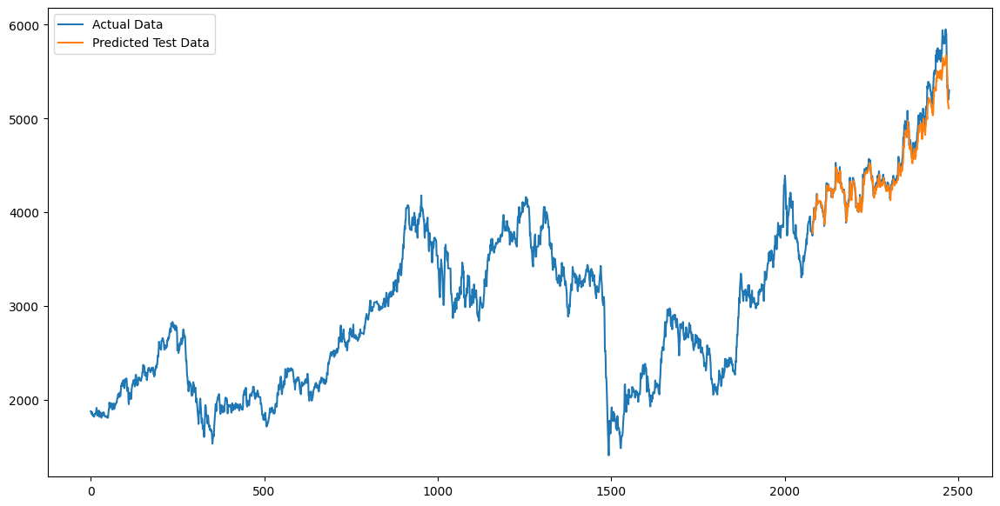

In [ ]:
# Membuat gambar (figure) dengan ukuran 14x7
plt.figure(figsize=(14, 7))
# Membuat plot garis untuk data aktual dengan label 'Actual Data'
plt.plot(bbni_hist3, label='Actual Data')
# Membuat plot garis untuk data prediksi pada dengan label 'Predicted Test Data'
plt.plot(testPredictPlot_bbni_gru, label='Predicted Test Data')
# Menambahkan legenda ke plot berdasarkan label-label yang telah ditentukan sebelumnya
plt.legend()
# Menampilkan plot
plt.show()

In [ ]:
# Fungsi menghitung MAPE
def mean_absolute_percentage_error(y_true, y_pred):
    y_true, y_pred = np.array(y_true), np.array(y_pred)
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100

In [ ]:
# Melihat Metric Evaluation RMSE dan MAPE
mape_gru_l6_bbni = mean_absolute_percentage_error(Y_test_bbni_gru,test_predict_bbni_gru)
print("RMSE of GRU:", np.sqrt(mean_squared_error(Y_test_bbni_gru,test_predict_bbni_gru)))
print("MAPE of GRU:", mape_gru_l6_bbni)

RMSE of GRU: 109.05429216182618
MAPE of GRU: 1.6005195700973232


Diperoleh bahwa model hasil hyperparameter tuning & optimization ini tidak lebih baik daripada model yang telah diperoleh sebelumnya, terbukti dari error yang lebih besar. Oleh karena itu, untuk memprediksi harga saham ke depannya, akan digunakan model terbaik yang telah diperoleh sebelumnya.

#### Forecasting using Best Model

Setelah diperoleh model terbaik yaitu GRU dengan 3 layer yaitu:
1. Input layer dengan 100 unit neuron
2. Hidden layer dengan 150 unit neuron
3. Output layer Dense dengan 1 unit neuron

akan dilakukan prediksi harga saham BBNI 30 hari ke depan menggunakan model tersebut.

In [ ]:
# Mengambil kolom close
bbni_hist2 = bbni_hist['Close']

In [ ]:
# Train-Test Split
train_size = int(len(bbni_hist2) * 0.80)
test_size = len(bbni_hist2) - train_size
train_data_bbni_gru, test_data_bbni_gru = bbni_hist2[:train_size], bbni_hist2[train_size:]

In [ ]:
test_data_bbni_gru.head()

Date
2022-03-25    3762.655518
2022-03-28    3888.458496
2022-03-29    3831.275146
2022-03-30    3842.712158
2022-03-31    3774.092041
Name: Close, dtype: float64

In [ ]:
# Data yang akan digunakan untuk prediksi adalah data test (data terbaru)
df_bbni = test_data_bbni_gru.copy()

# Menampilkan 5 baris pertama dari Dataframe
print("DataFrame awal:")
print(df_bbni.head())

# Menampilkan 5 baris terakhir dari Dataframe
print("\nDataFrame akhir:")
print(df_bbni.tail())

# 1. Load model
model_bbni = load_model('/content/drive/MyDrive/Saved Models/model_bbni_gru_l3.h5')

# 2. Prepare data (gunakan data dari 100 hari terakhir)
last_n_days = 100  # Menggunakan 100 hari terakhir sesuai kebutuhan model
data_to_predict_bbni = bbni_hist['Close'][-last_n_days:].values

# 3. Scaling data (misalnya menggunakan MinMaxScaler)
scaler = MinMaxScaler(feature_range=(0, 1))
data_to_predict_bbni_scaled = scaler.fit_transform(data_to_predict_bbni.reshape(-1, 1))

# 4. Reshape data
data_to_predict_bbni_scaled = np.reshape(data_to_predict_bbni_scaled, (1, last_n_days, 1))

# 5. Predict multiple days into the future
n_days_to_predict = 30
predictions_bbni = []

for i in range(n_days_to_predict):
    # Predict
    predicted_scaled_bbni = model_bbni.predict(data_to_predict_bbni_scaled)
    predicted_bbni = scaler.inverse_transform(predicted_scaled_bbni)

    # Save prediction
    predictions_bbni.append(predicted_bbni[0][0])

    # Update data_to_predict_scaled for the next prediction
    data_to_predict_bbni_scaled = np.append(data_to_predict_bbni_scaled[:, 1:, :], np.reshape(predicted_scaled_bbni, (1, 1, 1)), axis=1)

# Print the predicted values
print("\nPredicted values for the next days:")
print(predictions_bbni)

# Mendapatkan tanggal terakhir dari data asli
last_date = bbni_hist.index[-1]

# Membuat rangkaian tanggal hari kerja untuk hasil prediksi
prediction_dates = pd.date_range(start=last_date + pd.Timedelta(days=1), periods=n_days_to_predict, freq='B')

# Membuat DataFrame baru untuk hasil prediksi
prediction_df_bbni = pd.DataFrame({'Date': prediction_dates, 'Predicted_Close': predictions_bbni})

# Menampilkan DataFrame prediksi
print("\nPrediction DataFrame:")
print(prediction_df_bbni)


DataFrame awal:
Date
2022-03-25    3762.655518
2022-03-28    3888.458496
2022-03-29    3831.275146
2022-03-30    3842.712158
2022-03-31    3774.092041
Name: Close, dtype: float64

DataFrame akhir:
Date
2024-04-04    5350.0
2024-04-05    5300.0
2024-04-16    5200.0
2024-04-17    5250.0
2024-04-18    5300.0
Name: Close, dtype: float64
1/1 [==============================] - 0s 29ms/step

Predicted values for the next days:
[5298.1914, 5300.4893, 5302.4976, 5304.1694, 5305.669, 5307.0806, 5308.4507, 5309.801, 5311.1426, 5312.4795, 5313.8154, 5315.151, 5316.487, 5317.824, 5319.162, 5320.501, 5321.843, 5323.186, 5324.5312, 5325.8784, 5327.2285, 5328.579, 5329.9326, 5331.288, 5332.646, 5334.006, 5335.3677, 5336.732, 5338.0986, 5339.4673]

Prediction DataFrame:
         Date  Predicted_Close
0  2024-04-19      5298.191406
1  2024-04-22      5300.489258
2  2024-04-23      5302.497559
3  2024-04-24      5304.169434
4  2024-04-25      5305.668945
5  2024-04-26      5307.080566
6  2024-04-29      

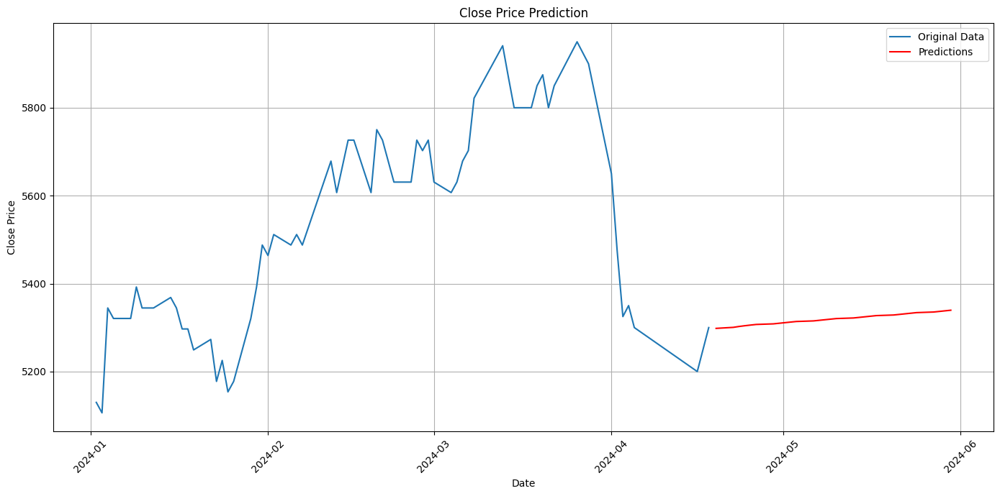

In [ ]:
# Plotting the results
plt.figure(figsize=(14, 7))
# Plot the original data
plt.plot(bbni_hist[bbni_hist['Date'] > '2024-01-01']['Date'], bbni_hist[bbni_hist['Date'] > '2024-01-01']['Close'], label='Original Data')
# Plot the predictions
plt.plot(prediction_df_bbni['Date'], prediction_df_bbni['Predicted_Close'], label='Predictions', color='red')
# Formatting the plot
plt.xlabel('Date')
plt.ylabel('Close Price')
plt.title('Close Price Prediction')
plt.legend()
plt.grid(True)
plt.xticks(rotation=45)
plt.tight_layout()
# Display the plot
plt.show()

Dari hasil prediksi di atas, dapat diketahui bahwa dalam 30 hari ke depan, harga saham bank BCA akan sedikit meningkat.

### Bank Rakyat Indonesia (BBRI)

#### Baseline Model

In [ ]:
# Mengambil kolom close
bbri_hist2 = bbri_hist['Close']

In [ ]:
# Train-Test Split
train_size = int(len(bbri_hist2) * 0.80)
test_size = len(bbri_hist2) - train_size
train_data_bbri_gru, test_data_bbri_gru = bbri_hist2[:train_size], bbri_hist2[train_size:]

# Scalling data
scaler = MinMaxScaler()
bbri_hist2 = scaler.fit_transform(np.array(bbri_hist2).reshape(-1,1))
train_data_bbri_gru = scaler.fit_transform(np.array(train_data_bbri_gru).reshape(-1, 1))
test_data_bbri_gru = scaler.transform(np.array(test_data_bbri_gru).reshape(-1, 1))

In [ ]:
def create_dataset(dataset, time_step = 1):
    dataX,dataY = [],[]
    for i in range(len(dataset)-time_step-1):
                   a = dataset[i:(i+time_step),0]
                   dataX.append(a)
                   dataY.append(dataset[i + time_step,0])
    return np.array(dataX),np.array(dataY)

In [ ]:
# Memanggil fungsi create_dataset untuk membagi data menjadi dataset input dan output dataset dengan times step 100
time_step = 100
X_train_bbri_gru,Y_train_bbri_gru =  create_dataset(train_data_bbri_gru,time_step)
X_test_bbri_gru,Y_test_bbri_gru =  create_dataset(test_data_bbri_gru,time_step)

In [ ]:
Y_train_bbri_gru

array([0.09276678, 0.09276678, 0.08674113, ..., 0.96030638, 0.97448266,
       0.97731773])

In [ ]:
# Memeriksa value
print(X_train_bbri_gru.shape)
print(X_train_bbri_gru)
print(X_test_bbri_gru.shape)
print(Y_test_bbri_gru.shape)

(1879, 100)
[[0.05206461 0.05793246 0.05108668 ... 0.07368551 0.07669833 0.08071544]
 [0.05793246 0.05108668 0.05206461 ... 0.07669833 0.08071544 0.09276678]
 [0.05108668 0.05206461 0.05010862 ... 0.08071544 0.09276678 0.09276678]
 ...
 [0.84523331 0.82887035 0.81523442 ... 0.97731773 0.97731773 0.957471  ]
 [0.82887035 0.81523442 0.81796177 ... 0.97731773 0.957471   0.96030638]
 [0.81523442 0.81796177 0.81250747 ... 0.957471   0.96030638 0.97448266]]
(394, 100)
(394,)


In [ ]:
# Tetapkan seed untuk inisialisasi acak
seed_value = 42
tf.random.set_seed(seed_value)
np.random.seed(seed_value)

# Membangun model gru
model_bbri_gru1 = tf.keras.Sequential([
      # Menambahkan layer GRU pertama dengan 50 unit dan pengembalian urutan yang digunakan untuk menjaga urutan output
      # Input_shape adalah bentuk input, yaitu jumlah langkah waktu (X_train.shape[1]) dan fitur (1)
      tf.keras.layers.GRU(50, return_sequences=True, input_shape=(X_train_bbri_gru.shape[1], 1)),
      # Menambahkan layer GRU kedua dengan 50 unit, tidak ada pengembalian urutan karena ini adalah lapisan terakhir GRU
      tf.keras.layers.GRU(50),
      # Menambahkan layer Dense dengan 1 unit sebagai output layer
      tf.keras.layers.Dense(1)
])
# Mengompilasi model dengan loss function 'mean_squared_error' dan optimizer 'adam'
model_bbri_gru1.compile(loss='mean_squared_error', optimizer='adam')

In [ ]:
# Melihat rangkuman model
model_bbri_gru1.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 gru_2 (GRU)                 (None, 100, 50)           7950      
                                                                 
 gru_3 (GRU)                 (None, 50)                15300     
                                                                 
 dense_1 (Dense)             (None, 1)                 51        
                                                                 
Total params: 23301 (91.02 KB)
Trainable params: 23301 (91.02 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________


In [ ]:
# Menetapkan seed untuk TensorFlow untuk memastikan hasil yang konsisten dari operasi stokastik (jika ada)
tf.random.set_seed(seed_value)

# Melatih model menggunakan data pelatihan (X_train_bbri dan Y_train_bbri) dengan data validasi (X_test_bbri dan Y_test_bbri)
# Epochs adalah jumlah kali seluruh dataset akan diberikan kepada model selama proses pelatihan
# Batch_size adalah jumlah sampel data yang akan diproses sebelum pembaharuan bobot model
# verbose = 1 menghasilkan output detail pada setiap epoch selama pelatihan
model_bbri_gru1.fit(X_train_bbri_gru, Y_train_bbri_gru, validation_data=(X_test_bbri_gru, Y_test_bbri_gru), epochs=50, batch_size=64, verbose=1)
model_bbri_gru1.save("model_bbri_gru1.h5")

Epoch 1/50
30/30 [==============================] - 10s 145ms/step - loss: 0.0282 - val_loss: 0.0278
Epoch 2/50
30/30 [==============================] - 3s 106ms/step - loss: 0.0012 - val_loss: 0.0010
Epoch 3/50
30/30 [==============================] - 3s 96ms/step - loss: 5.2523e-04 - val_loss: 0.0015
Epoch 4/50
30/30 [==============================] - 5s 157ms/step - loss: 4.7521e-04 - val_loss: 0.0012
Epoch 5/50
30/30 [==============================] - 3s 109ms/step - loss: 4.5524e-04 - val_loss: 0.0016
Epoch 6/50
30/30 [==============================] - 3s 106ms/step - loss: 4.4515e-04 - val_loss: 0.0011
Epoch 7/50
30/30 [==============================] - 3s 98ms/step - loss: 4.3657e-04 - val_loss: 0.0013
Epoch 8/50
30/30 [==============================] - 5s 153ms/step - loss: 4.0945e-04 - val_loss: 0.0014
Epoch 9/50
30/30 [==============================] - 5s 174ms/step - loss: 4.0451e-04 - val_loss: 9.9304e-04
Epoch 10/50
30/30 [==============================] - 3s 106ms/step - 

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


In [ ]:
# Memprediksi data menggunakan model yang telah dilatih
train_predict_bbri_gru = model_bbri_gru1.predict(X_train_bbri_gru)
test_predict_bbri_gru = model_bbri_gru1.predict(X_test_bbri_gru)

13/13 [==============================] - 0s 22ms/step


In [ ]:
Y_train_bbri_gru[:5]

array([0.09276678, 0.09276678, 0.08674113, 0.08473252, 0.09176253])

In [ ]:
train_predict_bbri_gru[:5]

array([[0.08122504],
       [0.09025419],
       [0.09340397],
       [0.09032314],
       [0.08786965]], dtype=float32)

In [ ]:
# Transformasi data ke bentuk awal
Y_train_bbri_gru = scaler.inverse_transform(Y_train_bbri_gru.reshape(-1, 1))
Y_test_bbri_gru = scaler.inverse_transform(Y_test_bbri_gru.reshape(-1, 1))
train_predict_bbri_gru = scaler.inverse_transform(train_predict_bbri_gru)
test_predict_bbri_gru = scaler.inverse_transform(test_predict_bbri_gru)

In [ ]:
Y_test_bbri_gru[:5]

array([[3795.79614258],
       [3804.72753906],
       [3876.17749023],
       [3920.83374023],
       [3974.421875  ]])

In [ ]:
test_predict_bbri_gru[:5]

array([[3811.8523],
       [3794.684 ],
       [3802.654 ],
       [3872.1953],
       [3918.5928]], dtype=float32)

In [ ]:
# Mendefinisikan jumlah langkah waktu sebelumnya yang akan digunakan sebagai input untuk memprediksi langkah waktu saat ini
look_back = 100

# Membuat array kosong dengan ukuran yang sama dengan bbri_hist2
trainPredictPlot_bbri = np.empty_like(bbri_hist2)
# Mengisi array dengan nilai yang sama dengan NaN (untuk plot)
trainPredictPlot_bbri[:,:] = np.nan
# Mengisi bagian dari array dengan hasil prediksi pada data pelatihan
# Menempatkan hasil prediksi pada posisi yang sesuai dalam array untuk plotting
trainPredictPlot_bbri[look_back : len(train_predict_bbri_gru)+look_back,:] = train_predict_bbri_gru

# Membuat array kosong dengan ukuran yang sama dengan bbri_hist2
testPredictPlot_bbri_gru = np.empty_like(bbri_hist2)
# Mengisi array dengan nilai yang sama dengan NaN (untuk plot)
testPredictPlot_bbri_gru[:,:] = np.nan
# Mengisi bagian dari array dengan hasil prediksi pada data uji
# Menempatkan hasil prediksi pada posisi yang sesuai dalam array untuk plotting
testPredictPlot_bbri_gru[len(train_predict_bbri_gru) + (look_back) * 2 + 1 : len(bbri_hist2) - 1, :] = test_predict_bbri_gru

In [ ]:
# Mengambil data harga saham close dan dijadikan dalam bentuk array numpy
bbri_hist3=bbri_hist['Close'].to_numpy()

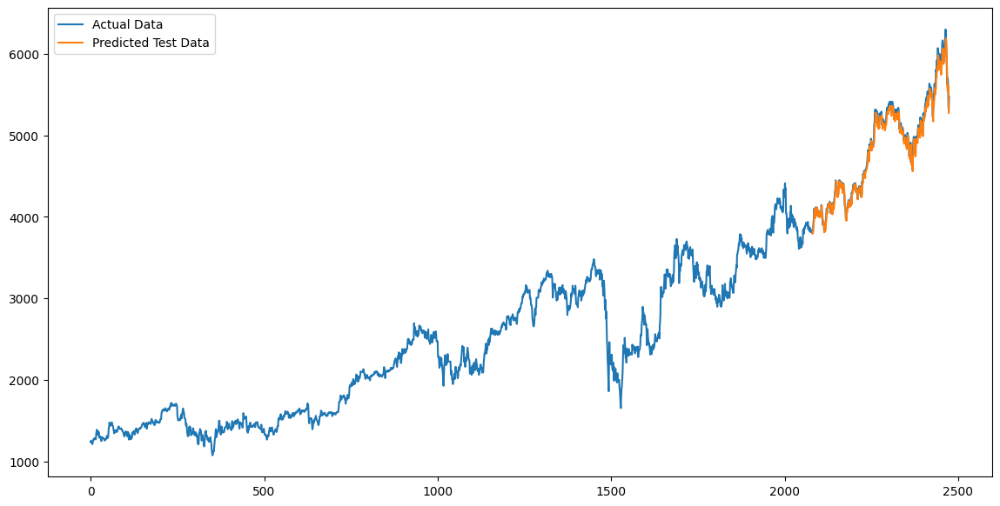

In [ ]:
# Membuat gambar (figure) dengan ukuran 14x7
plt.figure(figsize=(14, 7))
# Membuat plot garis untuk data aktual dengan label 'Actual Data'
plt.plot(bbri_hist3, label='Actual Data')
# Membuat plot garis untuk data prediksi pada dengan label 'Predicted Test Data'
plt.plot(testPredictPlot_bbri_gru, label='Predicted Test Data')
# Menambahkan legenda ke plot berdasarkan label-label yang telah ditentukan sebelumnya
plt.legend()
# Menampilkan plot
plt.show()

In [ ]:
# Fungsi menghitung MAPE
def mean_absolute_percentage_error(y_true, y_pred):
    y_true, y_pred = np.array(y_true), np.array(y_pred)
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100

In [ ]:
# Melihat Metric Evaluation RMSE dan MAPE
mape_gru1_bbri = mean_absolute_percentage_error(Y_test_bbri_gru,test_predict_bbri_gru)
print("RMSE of GRU:", np.sqrt(mean_squared_error(Y_test_bbri_gru,test_predict_bbri_gru)))
print("MAPE of GRU:", mape_gru1_bbri)

RMSE of LSTM: 79.75696252504939
MAPE of LSTM: 1.255699724540664


#### Hyperparameter Tuning & Optimization Model Using 3 Layers - Best Model

Dengan Min_Unit = 50 dan Max_Unit = 100 dan step = 10

In [ ]:
# Mengambil kolom close
bbri_hist2 = bbri_hist['Close']

In [ ]:
# Train-Test Split
train_size = int(len(bbri_hist2) * 0.80)
test_size = len(bbri_hist2) - train_size
train_data_bbri_gru, test_data_bbri_gru = bbri_hist2[:train_size], bbri_hist2[train_size:]

# Scalling data
scaler = MinMaxScaler()
bbri_hist2 = scaler.fit_transform(np.array(bbri_hist2).reshape(-1,1))
train_data_bbri_gru = scaler.fit_transform(np.array(train_data_bbri_gru).reshape(-1, 1))
test_data_bbri_gru = scaler.transform(np.array(test_data_bbri_gru).reshape(-1, 1))

In [ ]:
def create_dataset(dataset, time_step = 1):
    dataX,dataY = [],[]
    for i in range(len(dataset)-time_step-1):
                   a = dataset[i:(i+time_step),0]
                   dataX.append(a)
                   dataY.append(dataset[i + time_step,0])
    return np.array(dataX),np.array(dataY)

In [ ]:
# Memanggil fungsi create_dataset untuk membagi data menjadi dataset input dan output dataset dengan times step 100
time_step = 100
X_train_bbri_gru,Y_train_bbri_gru =  create_dataset(train_data_bbri_gru,time_step)
X_test_bbri_gru,Y_test_bbri_gru =  create_dataset(test_data_bbri_gru,time_step)

In [ ]:
Y_train_bbri_gru

array([0.09276678, 0.09276678, 0.08674113, ..., 0.96030638, 0.97448266,
       0.97731773])

In [ ]:
# Memeriksa value
print(X_train_bbri_gru.shape)
print(X_train_bbri_gru)
print(X_test_bbri_gru.shape)
print(Y_test_bbri_gru.shape)

(1879, 100)
[[0.05206461 0.05793246 0.05108668 ... 0.07368551 0.07669833 0.08071544]
 [0.05793246 0.05108668 0.05206461 ... 0.07669833 0.08071544 0.09276678]
 [0.05108668 0.05206461 0.05010862 ... 0.08071544 0.09276678 0.09276678]
 ...
 [0.84523331 0.82887035 0.81523442 ... 0.97731773 0.97731773 0.957471  ]
 [0.82887035 0.81523442 0.81796177 ... 0.97731773 0.957471   0.96030638]
 [0.81523442 0.81796177 0.81250747 ... 0.957471   0.96030638 0.97448266]]
(394, 100)
(394,)


In [ ]:
# Tetapkan seed untuk inisialisasi acak
seed_value = 42
tf.random.set_seed(seed_value)
np.random.seed(seed_value)

# Definisikan fungsi untuk membuat model GRU dengan hyperparameter
def build_model_l3_test(hp):
    model = tf.keras.Sequential()
    model.add(tf.keras.layers.GRU(
        units=hp.Int('units_1', min_value=50, max_value=100, step=10),
        return_sequences=True,
        input_shape=(X_train_bbri_gru.shape[1], 1)
    ))
    model.add(tf.keras.layers.GRU(
        units=hp.Int('units_2', min_value=50, max_value=100, step=10)
    ))
    model.add(tf.keras.layers.Dense(1))

    model.compile(
        optimizer=tf.keras.optimizers.Adam(
            hp.Choice('learning_rate', values=[1e-2, 1e-3])
        ),
        loss='mean_squared_error'
    )
    return model


In [ ]:
# Atur pencarian hyperparameter menggunakan RandomSearch
tuner = RandomSearch(
    build_model_l3_test,
    objective='val_loss',
    max_trials=5,  # Jumlah percobaan untuk menemukan kombinasi hyperparameter terbaik
    executions_per_trial=1,  # Jumlah eksekusi per percobaan untuk akurasi lebih baik
    directory='hyperparameter_tuning_l3_test4',
    project_name='gru_tuning_l3_test4'
)

# Tentukan data pelatihan dan validasi
tuner.search(X_train_bbri_gru, Y_train_bbri_gru, validation_data=(X_test_bbri_gru, Y_test_bbri_gru), epochs=30, batch_size=64, verbose=1)

# Mendapatkan hasil terbaik
best_hps_l3_test = tuner.get_best_hyperparameters(num_trials=1)[0]

# Membangun model dengan hyperparameter terbaik
model_bbri_gru_l3_test = build_model_l3_test(best_hps_l3_test)

Trial 5 Complete [00h 03m 28s]
val_loss: 0.0004822685441467911

Best val_loss So Far: 0.00047461799113079906
Total elapsed time: 00h 16m 06s


In [ ]:
print(best_hps_l3_test)

In [ ]:
# Melihat rangkuman model
model_bbri_gru_l3_test.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 gru_2 (GRU)                 (None, 100, 60)           11340     
                                                                 
 gru_3 (GRU)                 (None, 90)                41040     
                                                                 
 dense_1 (Dense)             (None, 1)                 91        
                                                                 
Total params: 52471 (204.96 KB)
Trainable params: 52471 (204.96 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________


In [ ]:
# Menetapkan seed untuk TensorFlow untuk memastikan hasil yang konsisten dari operasi stokastik (jika ada)
tf.random.set_seed(seed_value)

# Melatih model menggunakan data pelatihan (X_train_bbri dan Y_train_bbri) dengan data validasi (X_test_bbri dan Y_test_bbri)
# Epochs adalah jumlah kali seluruh dataset akan diberikan kepada model selama proses pelatihan
# Batch_size adalah jumlah sampel data yang akan diproses sebelum pembaharuan bobot model
# verbose = 1 menghasilkan output detail pada setiap epoch selama pelatihan
model_bbri_gru_l3_test.fit(X_train_bbri_gru, Y_train_bbri_gru, validation_data=(X_test_bbri_gru, Y_test_bbri_gru), epochs=50, batch_size=64, verbose=1)
model_bbri_gru_l3_test.save("model_bbri_gru_l3_test.h5")

Epoch 1/50
30/30 [==============================] - 9s 198ms/step - loss: 0.0263 - val_loss: 0.0022
Epoch 2/50
30/30 [==============================] - 6s 203ms/step - loss: 0.0012 - val_loss: 9.9711e-04
Epoch 3/50
30/30 [==============================] - 5s 153ms/step - loss: 5.1182e-04 - val_loss: 0.0014
Epoch 4/50
30/30 [==============================] - 6s 209ms/step - loss: 4.7135e-04 - val_loss: 0.0012
Epoch 5/50
30/30 [==============================] - 5s 170ms/step - loss: 4.4999e-04 - val_loss: 0.0016
Epoch 6/50
30/30 [==============================] - 5s 152ms/step - loss: 4.4187e-04 - val_loss: 0.0011
Epoch 7/50
30/30 [==============================] - 7s 232ms/step - loss: 4.3420e-04 - val_loss: 0.0014
Epoch 8/50
30/30 [==============================] - 5s 154ms/step - loss: 4.0833e-04 - val_loss: 0.0014
Epoch 9/50
30/30 [==============================] - 5s 153ms/step - loss: 4.0236e-04 - val_loss: 9.1644e-04
Epoch 10/50
30/30 [==============================] - 7s 228ms/st

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


In [ ]:
# Memprediksi data menggunakan model yang telah dilatih
train_predict_bbri_gru = model_bbri_gru_l3_test.predict(X_train_bbri_gru)
test_predict_bbri_gru = model_bbri_gru_l3_test.predict(X_test_bbri_gru)

13/13 [==============================] - 0s 26ms/step


In [ ]:
Y_train_bbri_gru[:5]

array([0.09276678, 0.09276678, 0.08674113, 0.08473252, 0.09176253])

In [ ]:
train_predict_bbri_gru[:5]

array([[0.08105182],
       [0.09033175],
       [0.09339845],
       [0.0901331 ],
       [0.08762036]], dtype=float32)

In [ ]:
# Transformasi data ke bentuk awal
Y_train_bbri_gru = scaler.inverse_transform(Y_train_bbri_gru.reshape(-1, 1))
Y_test_bbri_gru = scaler.inverse_transform(Y_test_bbri_gru.reshape(-1, 1))
train_predict_bbri_gru = scaler.inverse_transform(train_predict_bbri_gru)
test_predict_bbri_gru = scaler.inverse_transform(test_predict_bbri_gru)

In [ ]:
Y_test_bbri_gru[:5]

array([[3795.79614258],
       [3804.72753906],
       [3876.17749023],
       [3920.83374023],
       [3974.421875  ]])

In [ ]:
test_predict_bbri_gru[:5]

array([[3811.4104],
       [3793.6062],
       [3802.4888],
       [3873.7898],
       [3919.1016]], dtype=float32)

In [ ]:
# Mendefinisikan jumlah langkah waktu sebelumnya yang akan digunakan sebagai input untuk memprediksi langkah waktu saat ini
look_back = 100

# Membuat array kosong dengan ukuran yang sama dengan bbri_hist2
trainPredictPlot_bbri = np.empty_like(bbri_hist2)
# Mengisi array dengan nilai yang sama dengan NaN (untuk plot)
trainPredictPlot_bbri[:,:] = np.nan
# Mengisi bagian dari array dengan hasil prediksi pada data pelatihan
# Menempatkan hasil prediksi pada posisi yang sesuai dalam array untuk plotting
trainPredictPlot_bbri[look_back : len(train_predict_bbri_gru)+look_back,:] = train_predict_bbri_gru

# Membuat array kosong dengan ukuran yang sama dengan bbri_hist2
testPredictPlot_bbri_gru = np.empty_like(bbri_hist2)
# Mengisi array dengan nilai yang sama dengan NaN (untuk plot)
testPredictPlot_bbri_gru[:,:] = np.nan
# Mengisi bagian dari array dengan hasil prediksi pada data uji
# Menempatkan hasil prediksi pada posisi yang sesuai dalam array untuk plotting
testPredictPlot_bbri_gru[len(train_predict_bbri_gru) + (look_back) * 2 + 1 : len(bbri_hist2) - 1, :] = test_predict_bbri_gru

In [ ]:
# Mengambil data harga saham close dan dijadikan dalam bentuk array numpy
bbri_hist3=bbri_hist['Close'].to_numpy()

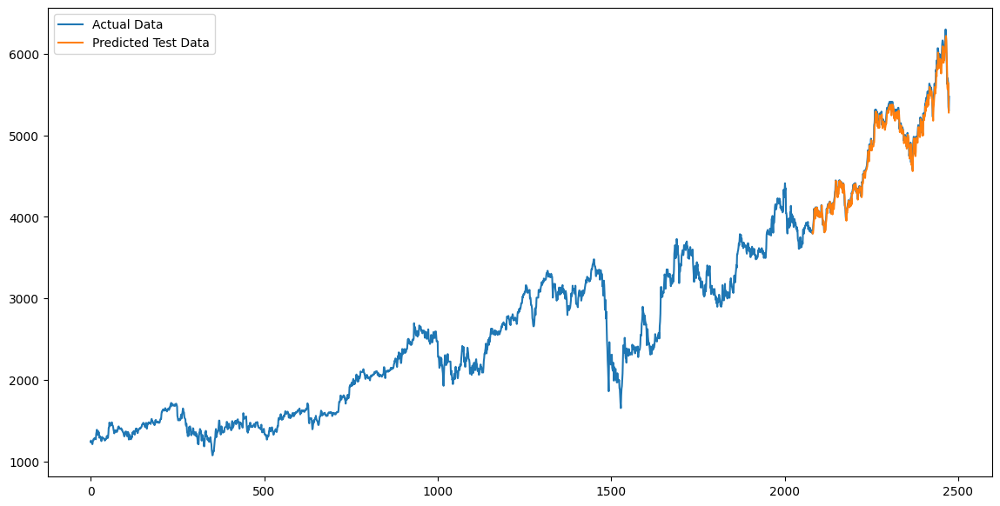

In [ ]:
# Membuat gambar (figure) dengan ukuran 14x7
plt.figure(figsize=(14, 7))
# Membuat plot garis untuk data aktual dengan label 'Actual Data'
plt.plot(bbri_hist3, label='Actual Data')
# Membuat plot garis untuk data prediksi pada dengan label 'Predicted Test Data'
plt.plot(testPredictPlot_bbri_gru, label='Predicted Test Data')
# Menambahkan legenda ke plot berdasarkan label-label yang telah ditentukan sebelumnya
plt.legend()
# Menampilkan plot
plt.show()

In [ ]:
# Fungsi menghitung MAPE
def mean_absolute_percentage_error(y_true, y_pred):
    y_true, y_pred = np.array(y_true), np.array(y_pred)
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100

In [ ]:
# Melihat Metric Evaluation RMSE dan MAPE
mape_gru_l3_bbri_test = mean_absolute_percentage_error(Y_test_bbri_gru,test_predict_bbri_gru)
print("RMSE of gru:", np.sqrt(mean_squared_error(Y_test_bbri_gru,test_predict_bbri_gru)))
print("MAPE of gru:", mape_gru_l3_bbri_test)

RMSE of gru: 75.40549319309066
MAPE of gru: 1.1954905663470743


#### Hyperparameter Tuning & Optimization Model 3 Layers - Worst Model

Dengan Min_Unit = 50 dan Max_Unit = 200 dan step = 50

In [ ]:
# Mengambil kolom close
bbri_hist2 = bbri_hist['Close']

In [ ]:
# Train-Test Split
train_size = int(len(bbri_hist2) * 0.80)
test_size = len(bbri_hist2) - train_size
train_data_bbri_gru, test_data_bbri_gru = bbri_hist2[:train_size], bbri_hist2[train_size:]

# Scalling data
scaler = MinMaxScaler()
bbri_hist2 = scaler.fit_transform(np.array(bbri_hist2).reshape(-1,1))
train_data_bbri_gru = scaler.fit_transform(np.array(train_data_bbri_gru).reshape(-1, 1))
test_data_bbri_gru = scaler.transform(np.array(test_data_bbri_gru).reshape(-1, 1))

In [ ]:
def create_dataset(dataset, time_step = 1):
    dataX,dataY = [],[]
    for i in range(len(dataset)-time_step-1):
                   a = dataset[i:(i+time_step),0]
                   dataX.append(a)
                   dataY.append(dataset[i + time_step,0])
    return np.array(dataX),np.array(dataY)

In [ ]:
# Memanggil fungsi create_dataset untuk membagi data menjadi dataset input dan output dataset dengan times step 100
time_step = 100
X_train_bbri_gru,Y_train_bbri_gru =  create_dataset(train_data_bbri_gru,time_step)
X_test_bbri_gru,Y_test_bbri_gru =  create_dataset(test_data_bbri_gru,time_step)

In [ ]:
Y_train_bbri_gru

array([0.09276678, 0.09276678, 0.08674113, ..., 0.96030638, 0.97448266,
       0.97731773])

In [ ]:
# Memeriksa value
print(X_train_bbri_gru.shape)
print(X_train_bbri_gru)
print(X_test_bbri_gru.shape)
print(Y_test_bbri_gru.shape)

(1879, 100)
[[0.05206461 0.05793246 0.05108668 ... 0.07368551 0.07669833 0.08071544]
 [0.05793246 0.05108668 0.05206461 ... 0.07669833 0.08071544 0.09276678]
 [0.05108668 0.05206461 0.05010862 ... 0.08071544 0.09276678 0.09276678]
 ...
 [0.84523331 0.82887035 0.81523442 ... 0.97731773 0.97731773 0.957471  ]
 [0.82887035 0.81523442 0.81796177 ... 0.97731773 0.957471   0.96030638]
 [0.81523442 0.81796177 0.81250747 ... 0.957471   0.96030638 0.97448266]]
(394, 100)
(394,)


In [ ]:
# Tetapkan seed untuk inisialisasi acak
seed_value = 42
tf.random.set_seed(seed_value)
np.random.seed(seed_value)

# Definisikan fungsi untuk membuat model GRU dengan hyperparameter
def build_model_l3(hp):
    model = tf.keras.Sequential()
    model.add(tf.keras.layers.GRU(
        units=hp.Int('units_1', min_value=50, max_value=200, step=50),
        return_sequences=True,
        input_shape=(X_train_bbri_gru.shape[1], 1)
    ))
    model.add(tf.keras.layers.GRU(
        units=hp.Int('units_2', min_value=50, max_value=200, step=50)
    ))
    model.add(tf.keras.layers.Dense(1))

    model.compile(
        optimizer=tf.keras.optimizers.Adam(
            hp.Choice('learning_rate', values=[1e-2, 1e-3, 1e-4])
        ),
        loss='mean_squared_error'
    )
    return model


In [ ]:
# Atur pencarian hyperparameter menggunakan RandomSearch
tuner = RandomSearch(
    build_model_l3,
    objective='val_loss',
    max_trials=10,  # Jumlah percobaan untuk menemukan kombinasi hyperparameter terbaik
    executions_per_trial=1,  # Jumlah eksekusi per percobaan untuk akurasi lebih baik
    directory='hyperparameter_tuning_l3',
    project_name='gru_tuning_l3'
)

# Tentukan data pelatihan dan validasi
tuner.search(X_train_bbri_gru, Y_train_bbri_gru, validation_data=(X_test_bbri_gru, Y_test_bbri_gru), epochs=30, batch_size=64, verbose=1)

# Mendapatkan hasil terbaik
best_hps_l3 = tuner.get_best_hyperparameters(num_trials=1)[0]

# Membangun model dengan hyperparameter terbaik
model_bbri_gru_l3 = build_model_l3(best_hps_l3)

Trial 10 Complete [00h 07m 29s]
val_loss: 0.0008930031326599419

Best val_loss So Far: 0.00047031056601554155
Total elapsed time: 01h 05m 33s


In [ ]:
print(best_hps_l3)

In [ ]:
# Melihat rangkuman model
model_bbri_gru_l3.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 gru_2 (GRU)                 (None, 100, 100)          30900     
                                                                 
 gru_3 (GRU)                 (None, 200)               181200    
                                                                 
 dense_1 (Dense)             (None, 1)                 201       
                                                                 
Total params: 212301 (829.30 KB)
Trainable params: 212301 (829.30 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________


In [ ]:
# Menetapkan seed untuk TensorFlow untuk memastikan hasil yang konsisten dari operasi stokastik (jika ada)
tf.random.set_seed(seed_value)

# Melatih model menggunakan data pelatihan (X_train_bbri dan Y_train_bbri) dengan data validasi (X_test_bbri dan Y_test_bbri)
# Epochs adalah jumlah kali seluruh dataset akan diberikan kepada model selama proses pelatihan
# Batch_size adalah jumlah sampel data yang akan diproses sebelum pembaharuan bobot model
# verbose = 1 menghasilkan output detail pada setiap epoch selama pelatihan
model_bbri_gru_l3.fit(X_train_bbri_gru, Y_train_bbri_gru, validation_data=(X_test_bbri_gru, Y_test_bbri_gru), epochs=50, batch_size=64, verbose=1)
model_bbri_gru_l3.save("model_bbri_gru_l3.h5")

Epoch 1/50
30/30 [==============================] - 19s 482ms/step - loss: 0.0219 - val_loss: 0.0069
Epoch 2/50
30/30 [==============================] - 14s 454ms/step - loss: 8.6026e-04 - val_loss: 0.0015
Epoch 3/50
30/30 [==============================] - 14s 461ms/step - loss: 4.6812e-04 - val_loss: 0.0010
Epoch 4/50
30/30 [==============================] - 14s 462ms/step - loss: 4.2950e-04 - val_loss: 7.4948e-04
Epoch 5/50
30/30 [==============================] - 14s 462ms/step - loss: 4.1484e-04 - val_loss: 9.7237e-04
Epoch 6/50
30/30 [==============================] - 14s 454ms/step - loss: 4.0975e-04 - val_loss: 8.1957e-04
Epoch 7/50
30/30 [==============================] - 14s 461ms/step - loss: 3.9457e-04 - val_loss: 0.0011
Epoch 8/50
30/30 [==============================] - 14s 457ms/step - loss: 3.8579e-04 - val_loss: 6.3418e-04
Epoch 9/50
30/30 [==============================] - 13s 437ms/step - loss: 3.6451e-04 - val_loss: 6.2317e-04
Epoch 10/50
30/30 [====================

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


In [ ]:
# Memprediksi data menggunakan model yang telah dilatih
train_predict_bbri_gru = model_bbri_gru_l3.predict(X_train_bbri_gru)
test_predict_bbri_gru = model_bbri_gru_l3.predict(X_test_bbri_gru)

13/13 [==============================] - 2s 144ms/step


In [ ]:
Y_train_bbri_gru[:5]

array([0.09276678, 0.09276678, 0.08674113, 0.08473252, 0.09176253])

In [ ]:
train_predict_bbri_gru[:5]

array([[0.07874513],
       [0.08873589],
       [0.09063105],
       [0.08643715],
       [0.08420566]], dtype=float32)

In [ ]:
# Transformasi data ke bentuk awal
Y_train_bbri_gru = scaler.inverse_transform(Y_train_bbri_gru.reshape(-1, 1))
Y_test_bbri_gru = scaler.inverse_transform(Y_test_bbri_gru.reshape(-1, 1))
train_predict_bbri_gru = scaler.inverse_transform(train_predict_bbri_gru)
test_predict_bbri_gru = scaler.inverse_transform(test_predict_bbri_gru)

In [ ]:
Y_test_bbri_gru[:5]

array([[3795.79614258],
       [3804.72753906],
       [3876.17749023],
       [3920.83374023],
       [3974.421875  ]])

In [ ]:
test_predict_bbri_gru[:5]

array([[3786.2292],
       [3766.479 ],
       [3778.3284],
       [3854.1052],
       [3894.011 ]], dtype=float32)

In [ ]:
# Mendefinisikan jumlah langkah waktu sebelumnya yang akan digunakan sebagai input untuk memprediksi langkah waktu saat ini
look_back = 100

# Membuat array kosong dengan ukuran yang sama dengan bbri_hist2
trainPredictPlot_bbri = np.empty_like(bbri_hist2)
# Mengisi array dengan nilai yang sama dengan NaN (untuk plot)
trainPredictPlot_bbri[:,:] = np.nan
# Mengisi bagian dari array dengan hasil prediksi pada data pelatihan
# Menempatkan hasil prediksi pada posisi yang sesuai dalam array untuk plotting
trainPredictPlot_bbri[look_back : len(train_predict_bbri_gru)+look_back,:] = train_predict_bbri_gru

# Membuat array kosong dengan ukuran yang sama dengan bbri_hist2
testPredictPlot_bbri_gru = np.empty_like(bbri_hist2)
# Mengisi array dengan nilai yang sama dengan NaN (untuk plot)
testPredictPlot_bbri_gru[:,:] = np.nan
# Mengisi bagian dari array dengan hasil prediksi pada data uji
# Menempatkan hasil prediksi pada posisi yang sesuai dalam array untuk plotting
testPredictPlot_bbri_gru[len(train_predict_bbri_gru) + (look_back) * 2 + 1 : len(bbri_hist2) - 1, :] = test_predict_bbri_gru

In [ ]:
# Mengambil data harga saham close dan dijadikan dalam bentuk array numpy
bbri_hist3=bbri_hist['Close'].to_numpy()

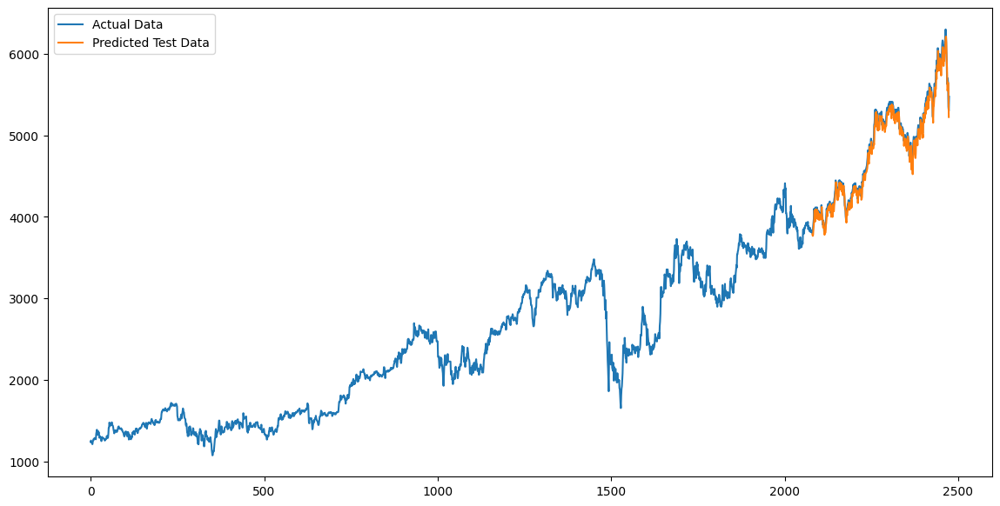

In [ ]:
# Membuat gambar (figure) dengan ukuran 14x7
plt.figure(figsize=(14, 7))
# Membuat plot garis untuk data aktual dengan label 'Actual Data'
plt.plot(bbri_hist3, label='Actual Data')
# Membuat plot garis untuk data prediksi pada dengan label 'Predicted Test Data'
plt.plot(testPredictPlot_bbri_gru, label='Predicted Test Data')
# Menambahkan legenda ke plot berdasarkan label-label yang telah ditentukan sebelumnya
plt.legend()
# Menampilkan plot
plt.show()

In [ ]:
# Fungsi menghitung MAPE
def mean_absolute_percentage_error(y_true, y_pred):
    y_true, y_pred = np.array(y_true), np.array(y_pred)
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100

In [ ]:
# Melihat Metric Evaluation RMSE dan MAPE
mape_gru_l3_bbri = mean_absolute_percentage_error(Y_test_bbri_gru,test_predict_bbri_gru)
print("RMSE of gru:", np.sqrt(mean_squared_error(Y_test_bbri_gru,test_predict_bbri_gru)))
print("MAPE of gru:", mape_gru_l3_bbri)

RMSE of gru: 87.79228265710745
MAPE of gru: 1.4182421977063109


#### Forecasting using Best Model

Setelah diperoleh model terbaik yaitu GRU dengan 3 layer yaitu:

1. Input layer dengan 60 unit neuron
2. Hidden layer dengan 90 unit neuron
3. Output layer Dense dengan 1 unit neuron

akan dilakukan prediksi harga saham BBRI 30 hari ke depan menggunakan model tersebut.

In [ ]:
# Mengambil kolom close
bbri_hist2 = bbri_hist.copy()

In [ ]:
# Train-Test Split
train_size = int(len(bbri_hist2) * 0.80)
test_size = len(bbri_hist2) - train_size
train_data_bbri_gru, test_data_bbri_gru = bbri_hist2[:train_size], bbri_hist2[train_size:]

In [ ]:
test_data_bbri_gru.head()

,Date,Open,High,Low,Close,Volume,Dividends,Stock Splits
Date,,,,,,,,
2022-03-25,2022-03-25 00:00:00+07:00,4251.291679,4251.291679,4153.047544,4206.635254,137104800,0.0,0.0
2022-03-28,2022-03-28 00:00:00+07:00,4224.497559,4233.428843,4170.909852,4224.497559,106801800,0.0,0.0
2022-03-29,2022-03-29 00:00:00+07:00,4242.360168,4242.360168,4170.909892,4188.772461,93155100,0.0,0.0
2022-03-30,2022-03-30 00:00:00+07:00,4233.429109,4233.429109,4188.772684,4206.635254,83364400,0.0,0.0
2022-03-31,2022-03-31 00:00:00+07:00,4197.703653,4242.360075,4161.978516,4161.978516,158650000,0.0,0.0


In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from tensorflow.keras.models import load_model
from sklearn.preprocessing import MinMaxScaler
import pandas_market_calendars as mcal
from pytz import timezone

df = test_data_bbri_gru.copy()

# Menampilkan 5 baris pertama dari DataFrame
print("DataFrame awal:")
print(df.head())

# Menampilkan 5 baris terakhir dari DataFrame
print("\nDataFrame akhir:")
print(df.tail())

# 1. Load model
model = load_model('/content/best_model_bbri_gru_l3.h5')

# 2. Prepare data (gunakan data dari 100 hari terakhir)
last_n_days = 100  # Menggunakan 100 hari terakhir sesuai kebutuhan model
data_to_predict = df['Close'][-last_n_days:].values

# 3. Scaling data (misalnya menggunakan MinMaxScaler)
scaler = MinMaxScaler(feature_range=(0, 1))
data_to_predict_scaled = scaler.fit_transform(data_to_predict.reshape(-1, 1))

# 4. Reshape data
data_to_predict_scaled = np.reshape(data_to_predict_scaled, (1, last_n_days, 1))

# 5. Predict multiple business days into the future, skipping weekends and holidays
n_days_to_predict = 30
predictions = []

# Get Jakarta (WIB) timezone
wib_timezone = timezone('Asia/Jakarta')

# Get NYSE calendar
nyse = mcal.get_calendar('NYSE')

# Get next business day from the last available date in the dataframe
last_date = df['Date'].iloc[-1].astimezone(wib_timezone)  # Konversi ke zona waktu Jakarta
current_date = last_date

# List to hold predicted dates
predicted_dates = []

for _ in range(n_days_to_predict):
    # Get next business day
    current_date = nyse.valid_days(start_date=current_date + pd.Timedelta(days=1), end_date=current_date + pd.Timedelta(days=30), tz='Asia/Jakarta')[0]

    # Predict only if it's a business day
    if current_date.weekday() < 5:  # Monday=0, Sunday=6
        # Predict
        predicted_scaled = model.predict(data_to_predict_scaled)
        predicted = scaler.inverse_transform(predicted_scaled)

        # Save prediction
        predictions.append(predicted[0][0])

        # Update data_to_predict_scaled for the next prediction
        data_to_predict_scaled = np.append(data_to_predict_scaled[:, 1:, :], np.reshape(predicted_scaled, (1, 1, 1)), axis=1)

        # Save predicted date
        predicted_dates.append(current_date)

# Print the predicted values
print("\nPredicted values for the next business days:")
print(predictions)

# Mendapatkan tanggal terakhir dari data asli
last_date = df['Date'].iloc[-1].astimezone(wib_timezone)  # Konversi ke zona waktu Jakarta

# Membuat DataFrame baru untuk hasil prediksi
prediction_df = pd.DataFrame({'Date': predicted_dates, 'Predicted_Close': predictions})

# Menampilkan DataFrame prediksi
print("\nPrediction DataFrame:")
print(prediction_df)


prediction_df.to_csv('bbri_predict.csv', index=False)


DataFrame awal:
                                Date         Open         High          Low  \
Date                                                                          
2022-03-25 2022-03-25 00:00:00+07:00  4251.291679  4251.291679  4153.047544   
2022-03-28 2022-03-28 00:00:00+07:00  4224.497559  4233.428843  4170.909852   
2022-03-29 2022-03-29 00:00:00+07:00  4242.360168  4242.360168  4170.909892   
2022-03-30 2022-03-30 00:00:00+07:00  4233.429109  4233.429109  4188.772684   
2022-03-31 2022-03-31 00:00:00+07:00  4197.703653  4242.360075  4161.978516   

                  Close     Volume  Dividends  Stock Splits  
Date                                                         
2022-03-25  4206.635254  137104800        0.0           0.0  
2022-03-28  4224.497559  106801800        0.0           0.0  
2022-03-29  4188.772461   93155100        0.0           0.0  
2022-03-30  4206.635254   83364400        0.0           0.0  
2022-03-31  4161.978516  158650000        0.0           0.

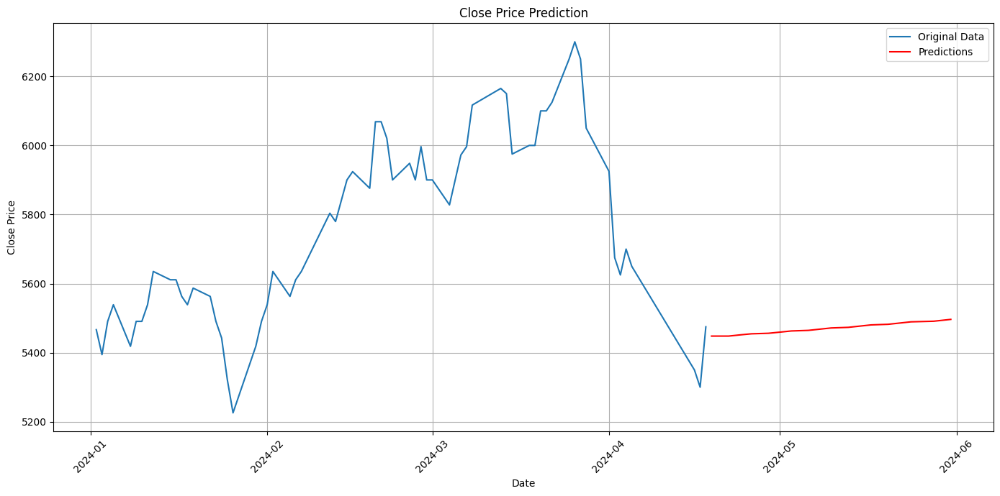

In [ ]:
# Plotting the results
plt.figure(figsize=(14, 7))

# Plot the original data
plt.plot(df[df['Date'] > '2024-01-01']['Date'], df[df['Date'] > '2024-01-01']['Close'], label='Original Data')

# Plot the predictions
plt.plot(prediction_df['Date'], prediction_df['Predicted_Close'], label='Predictions', color='red')

# Formatting the plot
plt.xlabel('Date')
plt.ylabel('Close Price')
plt.title('Close Price Prediction')
plt.legend()
plt.grid(True)
plt.xticks(rotation=45)
plt.tight_layout()

# Display the plot
plt.show()

### Bank Tabungan Negara (BBTN)

#### Baseline Model

In [ ]:
# Mengambil kolom close
bbtn_hist2 = bbtn_hist['Close']

In [ ]:
# Train-Test Split
train_size = int(len(bbtn_hist2) * 0.80)
test_size = len(bbtn_hist2) - train_size
train_data_bbtn_gru, test_data_bbtn_gru = bbtn_hist2[:train_size], bbtn_hist2[train_size:]

# Scalling data
scaler = MinMaxScaler()
bbtn_hist2 = scaler.fit_transform(np.array(bbtn_hist2).reshape(-1,1))
train_data_bbtn_gru = scaler.fit_transform(np.array(train_data_bbtn_gru).reshape(-1, 1))
test_data_bbtn_gru = scaler.transform(np.array(test_data_bbtn_gru).reshape(-1, 1))

In [ ]:
def create_dataset(dataset, time_step = 1):
    dataX,dataY = [],[]
    for i in range(len(dataset)-time_step-1):
                   a = dataset[i:(i+time_step),0]
                   dataX.append(a)
                   dataY.append(dataset[i + time_step,0])
    return np.array(dataX),np.array(dataY)

In [ ]:
# Memanggil fungsi create_dataset untuk membagi data menjadi dataset input dan output dataset dengan times step 100
time_step = 100
X_train_bbtn_gru,Y_train_bbtn_gru =  create_dataset(train_data_bbtn_gru,time_step)
X_test_bbtn_gru,Y_test_bbtn_gru =  create_dataset(test_data_bbtn_gru,time_step)

In [ ]:
Y_train_bbtn_gru

array([0.09608287, 0.09300894, 0.08993499, ..., 0.33169535, 0.3334145 ,
       0.32825709])

In [ ]:
# Memeriksa value
print(X_train_bbtn_gru.shape)
print(X_train_bbtn_gru)
print(X_test_bbtn_gru.shape)
print(Y_test_bbtn_gru.shape)

(1879, 100)
[[0.15295062 0.15141374 0.14833976 ... 0.07610231 0.07917619 0.09147198]
 [0.15141374 0.14833976 0.11913736 ... 0.07917619 0.09147198 0.09608287]
 [0.14833976 0.11913736 0.12528524 ... 0.09147198 0.09608287 0.09300894]
 ...
 [0.35121748 0.33764378 0.33934053 ... 0.34888668 0.34544842 0.34372927]
 [0.33764378 0.33934053 0.35121748 ... 0.34544842 0.34372927 0.33169535]
 [0.33934053 0.35121748 0.35461084 ... 0.34372927 0.33169535 0.3334145 ]]
(394, 100)
(394,)


In [ ]:
# Tetapkan seed untuk inisialisasi acak
seed_value = 42
tf.random.set_seed(seed_value)
np.random.seed(seed_value)

# Membangun model gru
model_bbtn_gru1 = tf.keras.Sequential([
      # Menambahkan layer GRU pertama dengan 50 unit dan pengembalian urutan yang digunakan untuk menjaga urutan output
      # Input_shape adalah bentuk input, yaitu jumlah langkah waktu (X_train.shape[1]) dan fitur (1)
      tf.keras.layers.GRU(50, return_sequences=True, input_shape=(X_train_bbtn_gru.shape[1], 1)),
      # Menambahkan layer GRU kedua dengan 50 unit, tidak ada pengembalian urutan karena ini adalah lapisan terakhir GRU
      tf.keras.layers.GRU(50),
      # Menambahkan layer Dense dengan 1 unit sebagai output layer
      tf.keras.layers.Dense(1)
])
# Mengompilasi model dengan loss function 'mean_squared_error' dan optimizer 'adam'
model_bbtn_gru1.compile(loss='mean_squared_error', optimizer='adam')

In [ ]:
# Melihat rangkuman model
model_bbtn_gru1.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 gru_2 (GRU)                 (None, 100, 50)           7950      
                                                                 
 gru_3 (GRU)                 (None, 50)                15300     
                                                                 
 dense_1 (Dense)             (None, 1)                 51        
                                                                 
Total params: 23301 (91.02 KB)
Trainable params: 23301 (91.02 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________


In [ ]:
# Menetapkan seed untuk TensorFlow untuk memastikan hasil yang konsisten dari operasi stokastik (jika ada)
tf.random.set_seed(seed_value)

# Melatih model menggunakan data pelatihan (X_train_bbtn dan Y_train_bbtn) dengan data validasi (X_test_bbtn dan Y_test_bbtn)
# Epochs adalah jumlah kali seluruh dataset akan diberikan kepada model selama proses pelatihan
# Batch_size adalah jumlah sampel data yang akan diproses sebelum pembaharuan bobot model
# verbose = 1 menghasilkan output detail pada setiap epoch selama pelatihan
model_bbtn_gru1.fit(X_train_bbtn_gru, Y_train_bbtn_gru, validation_data=(X_test_bbtn_gru, Y_test_bbtn_gru), epochs=50, batch_size=64, verbose=1)
model_bbtn_gru1.save("model_bbtn_gru1.h5")

Epoch 1/50
30/30 [==============================] - 8s 158ms/step - loss: 0.0347 - val_loss: 3.5301e-04
Epoch 2/50
30/30 [==============================] - 3s 112ms/step - loss: 0.0016 - val_loss: 2.2965e-04
Epoch 3/50
30/30 [==============================] - 3s 92ms/step - loss: 6.2932e-04 - val_loss: 2.0471e-04
Epoch 4/50
30/30 [==============================] - 3s 90ms/step - loss: 5.6322e-04 - val_loss: 1.9799e-04
Epoch 5/50
30/30 [==============================] - 3s 90ms/step - loss: 5.2817e-04 - val_loss: 1.9420e-04
Epoch 6/50
30/30 [==============================] - 5s 180ms/step - loss: 5.0738e-04 - val_loss: 1.8313e-04
Epoch 7/50
30/30 [==============================] - 4s 133ms/step - loss: 4.7973e-04 - val_loss: 1.7880e-04
Epoch 8/50
30/30 [==============================] - 3s 91ms/step - loss: 4.6352e-04 - val_loss: 1.7893e-04
Epoch 9/50
30/30 [==============================] - 3s 90ms/step - loss: 4.5554e-04 - val_loss: 1.7100e-04
Epoch 10/50
30/30 [======================

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


In [ ]:
# Memprediksi data menggunakan model yang telah dilatih
train_predict_bbtn_gru = model_bbtn_gru1.predict(X_train_bbtn_gru)
test_predict_bbtn_gru = model_bbtn_gru1.predict(X_test_bbtn_gru)

13/13 [==============================] - 0s 18ms/step


In [ ]:
Y_train_bbtn_gru[:5]

array([0.09608287, 0.09300894, 0.08993499, 0.09147198, 0.10684162])

In [ ]:
train_predict_bbtn_gru[:5]

array([[0.08718839],
       [0.0943599 ],
       [0.09493192],
       [0.09233824],
       [0.0918906 ]], dtype=float32)

In [ ]:
# Transformasi data ke bentuk awal
Y_train_bbtn_gru = scaler.inverse_transform(Y_train_bbtn_gru.reshape(-1, 1))
Y_test_bbtn_gru = scaler.inverse_transform(Y_test_bbtn_gru.reshape(-1, 1))
train_predict_bbtn_gru = scaler.inverse_transform(train_predict_bbtn_gru)
test_predict_bbtn_gru = scaler.inverse_transform(test_predict_bbtn_gru)

In [ ]:
Y_test_bbtn_gru[:5]

array([[1247.94470215],
       [1247.94470215],
       [1243.8125    ],
       [1276.8704834 ],
       [1276.8704834 ]])

In [ ]:
test_predict_bbtn_gru[:5]

array([[1259.8726],
       [1254.1853],
       [1251.6763],
       [1248.2021],
       [1271.35  ]], dtype=float32)

In [ ]:
# Mendefinisikan jumlah langkah waktu sebelumnya yang akan digunakan sebagai input untuk memprediksi langkah waktu saat ini
look_back = 100

# Membuat array kosong dengan ukuran yang sama dengan bbtn_hist2
trainPredictPlot_bbtn = np.empty_like(bbtn_hist2)
# Mengisi array dengan nilai yang sama dengan NaN (untuk plot)
trainPredictPlot_bbtn[:,:] = np.nan
# Mengisi bagian dari array dengan hasil prediksi pada data pelatihan
# Menempatkan hasil prediksi pada posisi yang sesuai dalam array untuk plotting
trainPredictPlot_bbtn[look_back : len(train_predict_bbtn_gru)+look_back,:] = train_predict_bbtn_gru

# Membuat array kosong dengan ukuran yang sama dengan bbtn_hist2
testPredictPlot_bbtn_gru = np.empty_like(bbtn_hist2)
# Mengisi array dengan nilai yang sama dengan NaN (untuk plot)
testPredictPlot_bbtn_gru[:,:] = np.nan
# Mengisi bagian dari array dengan hasil prediksi pada data uji
# Menempatkan hasil prediksi pada posisi yang sesuai dalam array untuk plotting
testPredictPlot_bbtn_gru[len(train_predict_bbtn_gru) + (look_back) * 2 + 1 : len(bbtn_hist2) - 1, :] = test_predict_bbtn_gru

In [ ]:
# Mengambil data harga saham close dan dijadikan dalam bentuk array numpy
bbtn_hist3=bbtn_hist['Close'].to_numpy()

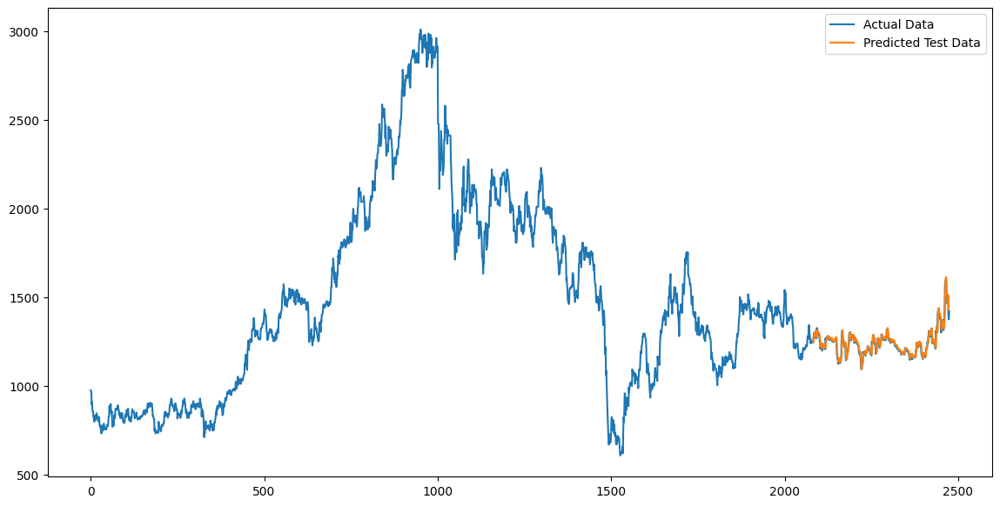

In [ ]:
# Membuat gambar (figure) dengan ukuran 14x7
plt.figure(figsize=(14, 7))
# Membuat plot garis untuk data aktual dengan label 'Actual Data'
plt.plot(bbtn_hist3, label='Actual Data')
# Membuat plot garis untuk data prediksi pada dengan label 'Predicted Test Data'
plt.plot(testPredictPlot_bbtn_gru, label='Predicted Test Data')
# Menambahkan legenda ke plot berdasarkan label-label yang telah ditentukan sebelumnya
plt.legend()
# Menampilkan plot
plt.show()

In [ ]:
# Fungsi menghitung MAPE
def mean_absolute_percentage_error(y_true, y_pred):
    y_true, y_pred = np.array(y_true), np.array(y_pred)
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100

In [ ]:
# Melihat Metric Evaluation RMSE dan MAPE
mape_gru1_bbtn = mean_absolute_percentage_error(Y_test_bbtn_gru,test_predict_bbtn_gru)
print("RMSE of GRU:", np.sqrt(mean_squared_error(Y_test_bbtn_gru,test_predict_bbtn_gru)))
print("MAPE of GRU:", mape_gru1_bbtn)

RMSE of GRU: 24.208980126360956
MAPE of GRU: 1.311098706330184


#### Hyperparameter Tuning & Optimization Using 5 Layers - Best Model

In [ ]:
# Mengambil kolom close
bbtn_hist2 = bbtn_hist['Close']

In [ ]:
# Train-Test Split
train_size = int(len(bbtn_hist2) * 0.80)
test_size = len(bbtn_hist2) - train_size
train_data_bbtn_gru, test_data_bbtn_gru = bbtn_hist2[:train_size], bbtn_hist2[train_size:]

# Scalling data
scaler = MinMaxScaler()
bbtn_hist2 = scaler.fit_transform(np.array(bbtn_hist2).reshape(-1,1))
train_data_bbtn_gru = scaler.fit_transform(np.array(train_data_bbtn_gru).reshape(-1, 1))
test_data_bbtn_gru = scaler.transform(np.array(test_data_bbtn_gru).reshape(-1, 1))

In [ ]:
def create_dataset(dataset, time_step = 1):
    dataX,dataY = [],[]
    for i in range(len(dataset)-time_step-1):
                   a = dataset[i:(i+time_step),0]
                   dataX.append(a)
                   dataY.append(dataset[i + time_step,0])
    return np.array(dataX),np.array(dataY)

In [ ]:
# Memanggil fungsi create_dataset untuk membagi data menjadi dataset input dan output dataset dengan times step 100
time_step = 100
X_train_bbtn_gru,Y_train_bbtn_gru =  create_dataset(train_data_bbtn_gru,time_step)
X_test_bbtn_gru,Y_test_bbtn_gru =  create_dataset(test_data_bbtn_gru,time_step)

In [ ]:
Y_train_bbtn_gru

array([0.09608287, 0.09300894, 0.08993499, ..., 0.33169535, 0.3334145 ,
       0.32825709])

In [ ]:
# Memeriksa value
print(X_train_bbtn_gru.shape)
print(X_train_bbtn_gru)
print(X_test_bbtn_gru.shape)
print(Y_test_bbtn_gru.shape)

(1879, 100)
[[0.15295062 0.15141374 0.14833976 ... 0.07610231 0.07917619 0.09147198]
 [0.15141374 0.14833976 0.11913736 ... 0.07917619 0.09147198 0.09608287]
 [0.14833976 0.11913736 0.12528524 ... 0.09147198 0.09608287 0.09300894]
 ...
 [0.35121748 0.33764378 0.33934053 ... 0.34888668 0.34544842 0.34372927]
 [0.33764378 0.33934053 0.35121748 ... 0.34544842 0.34372927 0.33169535]
 [0.33934053 0.35121748 0.35461084 ... 0.34372927 0.33169535 0.3334145 ]]
(394, 100)
(394,)


In [ ]:
# Tetapkan seed untuk inisialisasi acak
seed_value = 42
tf.random.set_seed(seed_value)
np.random.seed(seed_value)

# Definisikan fungsi untuk membuat model GRU dengan hyperparameter
def build_model_l5(hp):
    model = tf.keras.Sequential()
    model.add(tf.keras.layers.GRU(
        units=hp.Int('units_1', min_value=50, max_value=200, step=50),
        return_sequences=True,
        input_shape=(X_train_bbtn_gru.shape[1], 1)
    ))
    model.add(tf.keras.layers.GRU(
        units=hp.Int('units_2', min_value=50, max_value=200, step=50),
        return_sequences=True
    ))
    model.add(tf.keras.layers.GRU(
        units=hp.Int('units_3', min_value=50, max_value=200, step=50),
        return_sequences=True
    ))
    model.add(tf.keras.layers.GRU(
        units=hp.Int('units_4', min_value=50, max_value=200, step=50)
    ))
    model.add(tf.keras.layers.Dense(1))

    model.compile(
        optimizer=tf.keras.optimizers.Adam(
            hp.Choice('learning_rate', values=[1e-2, 1e-3, 1e-4])
        ),
        loss='mean_squared_error'
    )
    return model


In [ ]:
# Atur pencarian hyperparameter menggunakan RandomSearch
tuner = RandomSearch(
    build_model_l5,
    objective='val_loss',
    max_trials=10,  # Jumlah percobaan untuk menemukan kombinasi hyperparameter terbaik
    executions_per_trial=1,  # Jumlah eksekusi per percobaan untuk akurasi lebih baik
    directory='hyperparameter_tuning_l5_btn',
    project_name='gru_tuning_l5_btn'
)

# Tentukan data pelatihan dan validasi
tuner.search(X_train_bbtn_gru, Y_train_bbtn_gru, validation_data=(X_test_bbtn_gru, Y_test_bbtn_gru), epochs=30, batch_size=64, verbose=1)

# Mendapatkan hasil terbaik
best_hps_l5 = tuner.get_best_hyperparameters(num_trials=1)[0]

# Membangun model dengan hyperparameter terbaik
model_bbtn_gru_l5 = build_model_l5(best_hps_l5)

Reloading Tuner from hyperparameter_tuning_l5_btn/gru_tuning_l5_btn/tuner0.json


In [ ]:
print(best_hps_l5)

In [ ]:
# Melihat rangkuman model
model_bbtn_gru_l5.summary()

Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 gru_10 (GRU)                (None, 100, 150)          68850     
                                                                 
 gru_11 (GRU)                (None, 100, 100)          75600     
                                                                 
 gru_12 (GRU)                (None, 100, 50)           22800     
                                                                 
 gru_13 (GRU)                (None, 150)               90900     
                                                                 
 dense_2 (Dense)             (None, 1)                 151       
                                                                 
Total params: 258301 (1008.99 KB)
Trainable params: 258301 (1008.99 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________


In [ ]:
# Menetapkan seed untuk TensorFlow untuk memastikan hasil yang konsisten dari operasi stokastik (jika ada)
tf.random.set_seed(seed_value)

# Melatih model menggunakan data pelatihan (X_train_bbtn dan Y_train_bbtn) dengan data validasi (X_test_bbtn dan Y_test_bbtn)
# Epochs adalah jumlah kali seluruh dataset akan diberikan kepada model selama proses pelatihan
# Batch_size adalah jumlah sampel data yang akan diproses sebelum pembaharuan bobot model
# verbose = 1 menghasilkan output detail pada setiap epoch selama pelatihan
model_bbtn_gru_l5.fit(X_train_bbtn_gru, Y_train_bbtn_gru, validation_data=(X_test_bbtn_gru, Y_test_bbtn_gru), epochs=50, batch_size=64, verbose=1)
model_bbtn_gru_l5.save("model_bbtn_gru_l5.h5")

Epoch 1/50
30/30 [==============================] - 32s 798ms/step - loss: 0.1474 - val_loss: 2.3747e-04
Epoch 2/50
30/30 [==============================] - 20s 668ms/step - loss: 0.0019 - val_loss: 2.1601e-04
Epoch 3/50
30/30 [==============================] - 23s 772ms/step - loss: 5.2544e-04 - val_loss: 1.6211e-04
Epoch 4/50
30/30 [==============================] - 20s 661ms/step - loss: 4.3415e-04 - val_loss: 1.2416e-04
Epoch 5/50
30/30 [==============================] - 21s 720ms/step - loss: 3.7918e-04 - val_loss: 3.9044e-04
Epoch 6/50
30/30 [==============================] - 20s 657ms/step - loss: 3.7036e-04 - val_loss: 1.0180e-04
Epoch 7/50
30/30 [==============================] - 20s 659ms/step - loss: 3.1401e-04 - val_loss: 1.0603e-04
Epoch 8/50
30/30 [==============================] - 22s 720ms/step - loss: 2.8631e-04 - val_loss: 1.1814e-04
Epoch 9/50
30/30 [==============================] - 20s 660ms/step - loss: 3.2798e-04 - val_loss: 1.6727e-04
Epoch 10/50
30/30 [========

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


In [ ]:
# Memprediksi data menggunakan model yang telah dilatih
train_predict_bbtn_gru = model_bbtn_gru_l5.predict(X_train_bbtn_gru)
test_predict_bbtn_gru = model_bbtn_gru_l5.predict(X_test_bbtn_gru)

13/13 [==============================] - 2s 116ms/step


In [ ]:
Y_train_bbtn_gru[:5]

array([0.09608287, 0.09300894, 0.08993499, 0.09147198, 0.10684162])

In [ ]:
train_predict_bbtn_gru[:5]

array([[0.09577338],
       [0.09988084],
       [0.09810217],
       [0.09644087],
       [0.09828831]], dtype=float32)

In [ ]:
# Transformasi data ke bentuk awal
Y_train_bbtn_gru = scaler.inverse_transform(Y_train_bbtn_gru.reshape(-1, 1))
Y_test_bbtn_gru = scaler.inverse_transform(Y_test_bbtn_gru.reshape(-1, 1))
train_predict_bbtn_gru = scaler.inverse_transform(train_predict_bbtn_gru)
test_predict_bbtn_gru = scaler.inverse_transform(test_predict_bbtn_gru)

In [ ]:
Y_test_bbtn_gru[:5]

array([[1247.94470215],
       [1247.94470215],
       [1243.8125    ],
       [1276.8704834 ],
       [1276.8704834 ]])

In [ ]:
test_predict_bbtn_gru[:5]

array([[1257.0919],
       [1252.2604],
       [1249.3784],
       [1247.8983],
       [1279.699 ]], dtype=float32)

In [ ]:
# Mendefinisikan jumlah langkah waktu sebelumnya yang akan digunakan sebagai input untuk memprediksi langkah waktu saat ini
look_back = 100

# Membuat array kosong dengan ukuran yang sama dengan bbtn_hist2
trainPredictPlot_bbtn = np.empty_like(bbtn_hist2)
# Mengisi array dengan nilai yang sama dengan NaN (untuk plot)
trainPredictPlot_bbtn[:,:] = np.nan
# Mengisi bagian dari array dengan hasil prediksi pada data pelatihan
# Menempatkan hasil prediksi pada posisi yang sesuai dalam array untuk plotting
trainPredictPlot_bbtn[look_back : len(train_predict_bbtn_gru)+look_back,:] = train_predict_bbtn_gru

# Membuat array kosong dengan ukuran yang sama dengan bbtn_hist2
testPredictPlot_bbtn_gru = np.empty_like(bbtn_hist2)
# Mengisi array dengan nilai yang sama dengan NaN (untuk plot)
testPredictPlot_bbtn_gru[:,:] = np.nan
# Mengisi bagian dari array dengan hasil prediksi pada data uji
# Menempatkan hasil prediksi pada posisi yang sesuai dalam array untuk plotting
testPredictPlot_bbtn_gru[len(train_predict_bbtn_gru) + (look_back) * 2 + 1 : len(bbtn_hist2) - 1, :] = test_predict_bbtn_gru

In [ ]:
# Mengambil data harga saham close dan dijadikan dalam bentuk array numpy
bbtn_hist3=bbtn_hist['Close'].to_numpy()

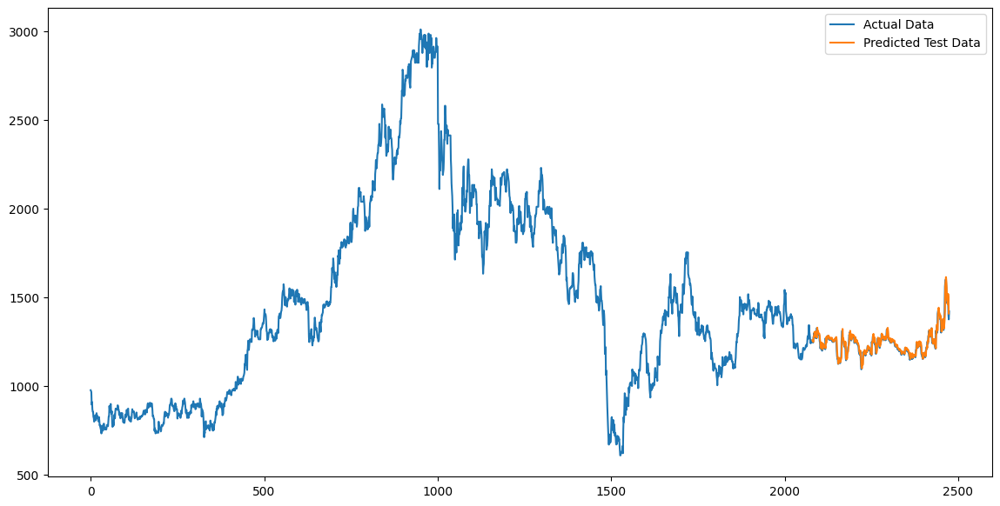

In [ ]:
# Membuat gambar (figure) dengan ukuran 14x7
plt.figure(figsize=(14, 7))
# Membuat plot garis untuk data aktual dengan label 'Actual Data'
plt.plot(bbtn_hist3, label='Actual Data')
# Membuat plot garis untuk data prediksi pada dengan label 'Predicted Test Data'
plt.plot(testPredictPlot_bbtn_gru, label='Predicted Test Data')
# Menambahkan legenda ke plot berdasarkan label-label yang telah ditentukan sebelumnya
plt.legend()
# Menampilkan plot
plt.show()

In [ ]:
# Fungsi menghitung MAPE
def mean_absolute_percentage_error(y_true, y_pred):
    y_true, y_pred = np.array(y_true), np.array(y_pred)
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100

In [ ]:
# Melihat Metric Evaluation RMSE dan MAPE
mape_gru_l5_bbtn = mean_absolute_percentage_error(Y_test_bbtn_gru,test_predict_bbtn_gru)
print("RMSE of gru:", np.sqrt(mean_squared_error(Y_test_bbtn_gru,test_predict_bbtn_gru)))
print("MAPE of gru:", mape_gru_l5_bbtn)

RMSE of gru: 22.95529564917089
MAPE of gru: 1.2772993758368423


#### Hyperparameter Tuning & Optimatization Model 6 Layers - Worst Model

In [ ]:
# Mengambil kolom close
bbtn_hist2 = bbtn_hist['Close']

In [ ]:
# Train-Test Split
train_size = int(len(bbtn_hist2) * 0.80)
test_size = len(bbtn_hist2) - train_size
train_data_bbtn_gru, test_data_bbtn_gru = bbtn_hist2[:train_size], bbtn_hist2[train_size:]

# Scalling data
scaler = MinMaxScaler()
bbtn_hist2 = scaler.fit_transform(np.array(bbtn_hist2).reshape(-1,1))
train_data_bbtn_gru = scaler.fit_transform(np.array(train_data_bbtn_gru).reshape(-1, 1))
test_data_bbtn_gru = scaler.transform(np.array(test_data_bbtn_gru).reshape(-1, 1))

In [ ]:
def create_dataset(dataset, time_step = 1):
    dataX,dataY = [],[]
    for i in range(len(dataset)-time_step-1):
                   a = dataset[i:(i+time_step),0]
                   dataX.append(a)
                   dataY.append(dataset[i + time_step,0])
    return np.array(dataX),np.array(dataY)

In [ ]:
# Memanggil fungsi create_dataset untuk membagi data menjadi dataset input dan output dataset dengan times step 100
time_step = 100
X_train_bbtn_gru,Y_train_bbtn_gru =  create_dataset(train_data_bbtn_gru,time_step)
X_test_bbtn_gru,Y_test_bbtn_gru =  create_dataset(test_data_bbtn_gru,time_step)

In [ ]:
Y_train_bbtn_gru

array([0.09608287, 0.09300894, 0.08993499, ..., 0.33169535, 0.3334145 ,
       0.32825709])

In [ ]:
# Memeriksa value
print(X_train_bbtn_gru.shape)
print(X_train_bbtn_gru)
print(X_test_bbtn_gru.shape)
print(Y_test_bbtn_gru.shape)

(1879, 100)
[[0.15295062 0.15141374 0.14833976 ... 0.07610231 0.07917619 0.09147198]
 [0.15141374 0.14833976 0.11913736 ... 0.07917619 0.09147198 0.09608287]
 [0.14833976 0.11913736 0.12528524 ... 0.09147198 0.09608287 0.09300894]
 ...
 [0.35121748 0.33764378 0.33934053 ... 0.34888668 0.34544842 0.34372927]
 [0.33764378 0.33934053 0.35121748 ... 0.34544842 0.34372927 0.33169535]
 [0.33934053 0.35121748 0.35461084 ... 0.34372927 0.33169535 0.3334145 ]]
(394, 100)
(394, 1)


In [ ]:
# Tetapkan seed untuk inisialisasi acak
seed_value = 42
tf.random.set_seed(seed_value)
np.random.seed(seed_value)

# Definisikan fungsi untuk membuat model GRU dengan hyperparameter
def build_model_l6(hp):
    model = tf.keras.Sequential()
    model.add(tf.keras.layers.GRU(
        units=hp.Int('units_1', min_value=50, max_value=200, step=50),
        return_sequences=True,
        input_shape=(X_train_bbtn_gru.shape[1], 1)
    ))
    model.add(tf.keras.layers.GRU(
        units=hp.Int('units_2', min_value=50, max_value=200, step=50),
        return_sequences=True
    ))
    model.add(tf.keras.layers.GRU(
        units=hp.Int('units_3', min_value=50, max_value=200, step=50),
        return_sequences=True
    ))
    model.add(tf.keras.layers.GRU(
        units=hp.Int('units_4', min_value=50, max_value=200, step=50),
        return_sequences=True
    ))
    model.add(tf.keras.layers.GRU(
        units=hp.Int('units_5', min_value=50, max_value=200, step=50)
    ))
    model.add(tf.keras.layers.Dense(1))

    model.compile(
        optimizer=tf.keras.optimizers.Adam(
            hp.Choice('learning_rate', values=[1e-2, 1e-3, 1e-4])
        ),
        loss='mean_squared_error'
    )
    return model

In [ ]:
# Atur pencarian hyperparameter menggunakan RandomSearch
tuner = RandomSearch(
    build_model_l6,
    objective='val_loss',
    max_trials=10,  # Jumlah percobaan untuk menemukan kombinasi hyperparameter terbaik
    executions_per_trial=1,  # Jumlah eksekusi per percobaan untuk akurasi lebih baik
    directory='hyperparameter_tuning_l6_btn',
    project_name='gru_tuning_l6_btn'
)

# Tentukan data pelatihan dan validasi
tuner.search(X_train_bbtn_gru, Y_train_bbtn_gru, validation_data=(X_test_bbtn_gru, Y_test_bbtn_gru), epochs=30, batch_size=64, verbose=1)

# Mendapatkan hasil terbaik
best_hps_l6 = tuner.get_best_hyperparameters(num_trials=1)[0]

# Membangun model dengan hyperparameter terbaik
model_bbtn_gru_l6 = build_model_l6(best_hps_l6)

Trial 10 Complete [00h 16m 18s]
val_loss: 0.0012825364246964455

Best val_loss So Far: 9.095741552300751e-05
Total elapsed time: 02h 18m 25s


In [ ]:
print(best_hps_l6)

In [ ]:
# Melihat rangkuman model
model_bbtn_gru_l6.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 gru_5 (GRU)                 (None, 100, 50)           7950      
                                                                 
 gru_6 (GRU)                 (None, 100, 100)          45600     
                                                                 
 gru_7 (GRU)                 (None, 100, 100)          60600     
                                                                 
 gru_8 (GRU)                 (None, 100, 100)          60600     
                                                                 
 gru_9 (GRU)                 (None, 50)                22800     
                                                                 
 dense_1 (Dense)             (None, 1)                 51        
                                                                 
Total params: 197601 (771.88 KB)
Trainable params: 197

In [ ]:
# Menetapkan seed untuk TensorFlow untuk memastikan hasil yang konsisten dari operasi stokastik (jika ada)
tf.random.set_seed(seed_value)

# Melatih model menggunakan data pelatihan (X_train_bbtn dan Y_train_bbtn) dengan data validasi (X_test_bbtn dan Y_test_bbtn)
# Epochs adalah jumlah kali seluruh dataset akan diberikan kepada model selama proses pelatihan
# Batch_size adalah jumlah sampel data yang akan diproses sebelum pembaharuan bobot model
# verbose = 1 menghasilkan output detail pada setiap epoch selama pelatihan
model_bbtn_gru_l6.fit(X_train_bbtn_gru, Y_train_bbtn_gru, validation_data=(X_test_bbtn_gru, Y_test_bbtn_gru), epochs=50, batch_size=64, verbose=1)
model_bbtn_gru_l6.save("model_bbtn_gru_l6.h5")

Epoch 1/50
30/30 [==============================] - 51s 1s/step - loss: 0.1233 - val_loss: 0.0107
Epoch 2/50
30/30 [==============================] - 20s 657ms/step - loss: 0.0021 - val_loss: 3.9783e-04
Epoch 3/50
30/30 [==============================] - 19s 618ms/step - loss: 6.3909e-04 - val_loss: 2.6212e-04
Epoch 4/50
30/30 [==============================] - 18s 599ms/step - loss: 4.9295e-04 - val_loss: 3.5411e-04
Epoch 5/50
30/30 [==============================] - 18s 616ms/step - loss: 4.7706e-04 - val_loss: 2.1892e-04
Epoch 6/50
30/30 [==============================] - 21s 694ms/step - loss: 4.0313e-04 - val_loss: 1.5514e-04
Epoch 7/50
30/30 [==============================] - 19s 640ms/step - loss: 3.9747e-04 - val_loss: 4.1227e-04
Epoch 8/50
30/30 [==============================] - 19s 620ms/step - loss: 3.5761e-04 - val_loss: 1.3936e-04
Epoch 9/50
30/30 [==============================] - 19s 630ms/step - loss: 3.7672e-04 - val_loss: 2.1488e-04
Epoch 10/50
30/30 [===============

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


In [ ]:
# Memprediksi data menggunakan model yang telah dilatih
train_predict_bbtn_gru = model_bbtn_gru_l6.predict(X_train_bbtn_gru)
test_predict_bbtn_gru = model_bbtn_gru_l6.predict(X_test_bbtn_gru)

13/13 [==============================] - 1s 72ms/step


In [ ]:
Y_train_bbtn_gru[:5]

array([0.09608287, 0.09300894, 0.08993499, 0.09147198, 0.10684162])

In [ ]:
train_predict_bbtn_gru[:5]

array([[0.08345842],
       [0.08734843],
       [0.08496802],
       [0.083386  ],
       [0.08570579]], dtype=float32)

In [ ]:
# Transformasi data ke bentuk awal
Y_train_bbtn_gru = scaler.inverse_transform(Y_train_bbtn_gru.reshape(-1, 1))
Y_test_bbtn_gru = scaler.inverse_transform(Y_test_bbtn_gru.reshape(-1, 1))
train_predict_bbtn_gru = scaler.inverse_transform(train_predict_bbtn_gru)
test_predict_bbtn_gru = scaler.inverse_transform(test_predict_bbtn_gru)

In [ ]:
Y_test_bbtn_gru[:5]

array([[1247.94470215],
       [1247.94470215],
       [1243.8125    ],
       [1276.8704834 ],
       [1276.8704834 ]])

In [ ]:
test_predict_bbtn_gru[:5]

array([[1235.8036],
       [1229.7003],
       [1229.4628],
       [1225.2666],
       [1258.4877]], dtype=float32)

In [ ]:
# Mendefinisikan jumlah langkah waktu sebelumnya yang akan digunakan sebagai input untuk memprediksi langkah waktu saat ini
look_back = 100

# Membuat array kosong dengan ukuran yang sama dengan bbtn_hist2
trainPredictPlot_bbtn = np.empty_like(bbtn_hist2)
# Mengisi array dengan nilai yang sama dengan NaN (untuk plot)
trainPredictPlot_bbtn[:,:] = np.nan
# Mengisi bagian dari array dengan hasil prediksi pada data pelatihan
# Menempatkan hasil prediksi pada posisi yang sesuai dalam array untuk plotting
trainPredictPlot_bbtn[look_back : len(train_predict_bbtn_gru)+look_back,:] = train_predict_bbtn_gru

# Membuat array kosong dengan ukuran yang sama dengan bbtn_hist2
testPredictPlot_bbtn_gru = np.empty_like(bbtn_hist2)
# Mengisi array dengan nilai yang sama dengan NaN (untuk plot)
testPredictPlot_bbtn_gru[:,:] = np.nan
# Mengisi bagian dari array dengan hasil prediksi pada data uji
# Menempatkan hasil prediksi pada posisi yang sesuai dalam array untuk plotting
testPredictPlot_bbtn_gru[len(train_predict_bbtn_gru) + (look_back) * 2 + 1 : len(bbtn_hist2) - 1, :] = test_predict_bbtn_gru

In [ ]:
# Mengambil data harga saham close dan dijadikan dalam bentuk array numpy
bbtn_hist3=bbtn_hist['Close'].to_numpy()

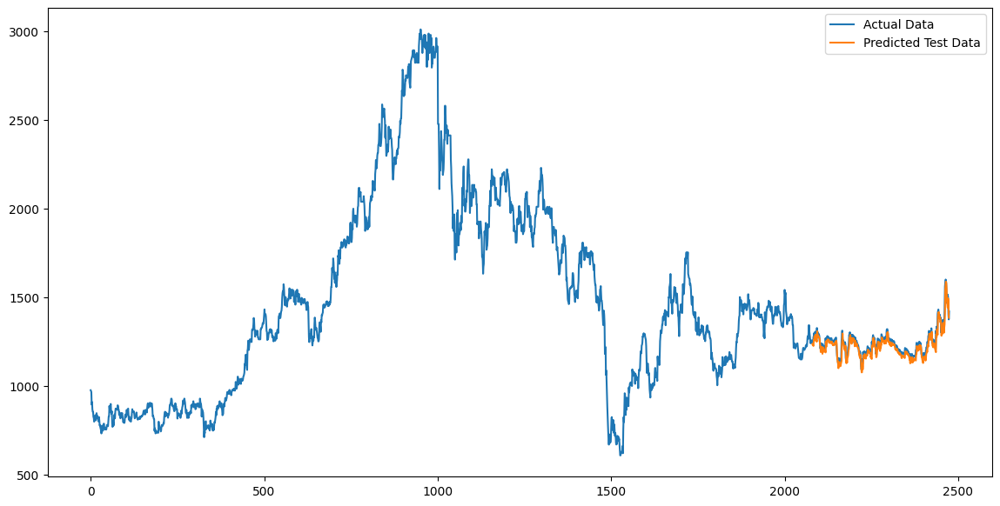

In [ ]:
# Membuat gambar (figure) dengan ukuran 14x7
plt.figure(figsize=(14, 7))
# Membuat plot garis untuk data aktual dengan label 'Actual Data'
plt.plot(bbtn_hist3, label='Actual Data')
# Membuat plot garis untuk data prediksi pada dengan label 'Predicted Test Data'
plt.plot(testPredictPlot_bbtn_gru, label='Predicted Test Data')
# Menambahkan legenda ke plot berdasarkan label-label yang telah ditentukan sebelumnya
plt.legend()
# Menampilkan plot
plt.show()

In [ ]:
# Fungsi menghitung MAPE
def mean_absolute_percentage_error(y_true, y_pred):
    y_true, y_pred = np.array(y_true), np.array(y_pred)
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100

In [ ]:
# Melihat Metric Evaluation RMSE dan MAPE
mape_gru_l6_bbtn = mean_absolute_percentage_error(Y_test_bbtn_gru,test_predict_bbtn_gru)
print("RMSE of gru:", np.sqrt(mean_squared_error(Y_test_bbtn_gru,test_predict_bbtn_gru)))
print("MAPE of gru:", mape_gru_l6_bbtn)

RMSE of gru: 29.63487165109726
MAPE of gru: 1.792448431344826


In [ ]:
model_path = '/content/model_bbri_gru_l3.h5'

# Load the model
model = tf.keras.models.load_model(model_path)

In [ ]:
model.predict()

#### Forecasting using Best Model

Setelah diperoleh model terbaik yaitu GRU dengan 5 layer yaitu:

1. Input layer dengan 150 unit neuron
2. Hidden layer dengan 100 unit neuron
2. Hidden layer dengan 50 unit neuron
2. Hidden layer dengan 150 unit neuron
3. Output layer Dense dengan 1 unit neuron

akan dilakukan prediksi harga saham BBTN 30 hari ke depan menggunakan model tersebut.

In [ ]:
# Mengambil kolom close
bbtn_hist2 = bbtn_hist.copy()

In [ ]:
# Train-Test Split
train_size = int(len(bbtn_hist2) * 0.80)
test_size = len(bbtn_hist2) - train_size
train_data_bbtn_gru, test_data_bbtn_gru = bbtn_hist2[:train_size], bbtn_hist2[train_size:]

In [ ]:
test_data_bbtn_gru.head()

,Date,Open,High,Low,Close,Volume,Dividends,Stock Splits
Date,,,,,,,,
2022-03-25,2022-03-25 00:00:00+07:00,1454.558068,1454.558068,1413.235389,1433.896729,14325027,0.0,0.0
2022-03-28,2022-03-28 00:00:00+07:00,1446.293579,1466.954919,1429.764507,1446.293579,15658881,0.0,0.0
2022-03-29,2022-03-29 00:00:00+07:00,1458.690440,1479.351781,1442.161367,1450.425903,25615284,0.0,0.0
2022-03-30,2022-03-30 00:00:00+07:00,1446.293542,1458.690345,1421.499934,1425.632202,12918121,0.0,0.0
2022-03-31,2022-03-31 00:00:00+07:00,1425.632212,1438.029015,1417.367676,1417.367676,5908353,0.0,0.0


In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from tensorflow.keras.models import load_model
from sklearn.preprocessing import MinMaxScaler
import pandas_market_calendars as mcal
from pytz import timezone

df = test_data_bbtn_gru.copy()

# Menampilkan 5 baris pertama dari DataFrame
print("DataFrame awal:")
print(df.head())

# Menampilkan 5 baris terakhir dari DataFrame
print("\nDataFrame akhir:")
print(df.tail())

# 1. Load model
model = load_model('/content/best_model_bbtn_gru_l5.h5')

# 2. Prepare data (gunakan data dari 100 hari terakhir)
last_n_days = 100  # Menggunakan 100 hari terakhir sesuai kebutuhan model
data_to_predict = df['Close'][-last_n_days:].values

# 3. Scaling data (misalnya menggunakan MinMaxScaler)
scaler = MinMaxScaler(feature_range=(0, 1))
data_to_predict_scaled = scaler.fit_transform(data_to_predict.reshape(-1, 1))

# 4. Reshape data
data_to_predict_scaled = np.reshape(data_to_predict_scaled, (1, last_n_days, 1))

# 5. Predict multiple business days into the future, skipping weekends and holidays
n_days_to_predict = 30
predictions = []

# Get Jakarta (WIB) timezone
wib_timezone = timezone('Asia/Jakarta')

# Get NYSE calendar
nyse = mcal.get_calendar('NYSE')

# Get next business day from the last available date in the dataframe
last_date = df['Date'].iloc[-1].astimezone(wib_timezone)  # Konversi ke zona waktu Jakarta
current_date = last_date

# List to hold predicted dates
predicted_dates = []

for _ in range(n_days_to_predict):
    # Get next business day
    current_date = nyse.valid_days(start_date=current_date + pd.Timedelta(days=1), end_date=current_date + pd.Timedelta(days=30), tz='Asia/Jakarta')[0]

    # Predict only if it's a business day
    if current_date.weekday() < 5:  # Monday=0, Sunday=6
        # Predict
        predicted_scaled = model.predict(data_to_predict_scaled)
        predicted = scaler.inverse_transform(predicted_scaled)

        # Save prediction
        predictions.append(predicted[0][0])

        # Update data_to_predict_scaled for the next prediction
        data_to_predict_scaled = np.append(data_to_predict_scaled[:, 1:, :], np.reshape(predicted_scaled, (1, 1, 1)), axis=1)

        # Save predicted date
        predicted_dates.append(current_date)

# Print the predicted values
print("\nPredicted values for the next business days:")
print(predictions)

# Mendapatkan tanggal terakhir dari data asli
last_date = df['Date'].iloc[-1].astimezone(wib_timezone)  # Konversi ke zona waktu Jakarta

# Membuat DataFrame baru untuk hasil prediksi
prediction_df = pd.DataFrame({'Date': predicted_dates, 'Predicted_Close': predictions})

# Menampilkan DataFrame prediksi
print("\nPrediction DataFrame:")
print(prediction_df)
prediction_df.to_csv('bbtn_predict.csv', index=False)

DataFrame awal:
                                Date         Open         High          Low  \
Date                                                                          
2022-03-25 2022-03-25 00:00:00+07:00  1454.558068  1454.558068  1413.235389   
2022-03-28 2022-03-28 00:00:00+07:00  1446.293579  1466.954919  1429.764507   
2022-03-29 2022-03-29 00:00:00+07:00  1458.690440  1479.351781  1442.161367   
2022-03-30 2022-03-30 00:00:00+07:00  1446.293542  1458.690345  1421.499934   
2022-03-31 2022-03-31 00:00:00+07:00  1425.632212  1438.029015  1417.367676   

                  Close    Volume  Dividends  Stock Splits  
Date                                                        
2022-03-25  1433.896729  14325027        0.0           0.0  
2022-03-28  1446.293579  15658881        0.0           0.0  
2022-03-29  1450.425903  25615284        0.0           0.0  
2022-03-30  1425.632202  12918121        0.0           0.0  
2022-03-31  1417.367676   5908353        0.0           0.0  

Da

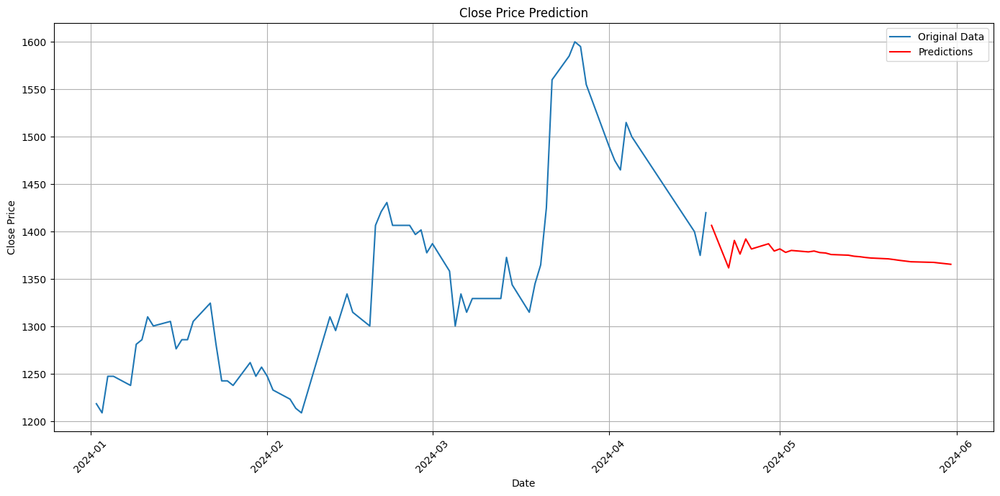

In [ ]:
# Plotting the results
plt.figure(figsize=(14, 7))

# Plot the original data
plt.plot(df[df['Date'] > '2024-01-01']['Date'], df[df['Date'] > '2024-01-01']['Close'], label='Original Data')

# Plot the predictions
plt.plot(prediction_df['Date'], prediction_df['Predicted_Close'], label='Predictions', color='red')

# Formatting the plot
plt.xlabel('Date')
plt.ylabel('Close Price')
plt.title('Close Price Prediction')
plt.legend()
plt.grid(True)
plt.xticks(rotation=45)
plt.tight_layout()

# Display the plot
plt.show()

### Bank Neo Commerce (BBYB)

#### Baseline Model

In [ ]:
# Mengambil kolom close
bbyb_hist2 = bbyb_hist['Close']

In [ ]:
# Train-Test Split
train_size = int(len(bbyb_hist2) * 0.80)
test_size = len(bbyb_hist2) - train_size
train_data_bbyb_lstm, test_data_bbyb_lstm = bbyb_hist2[:train_size], bbyb_hist2[train_size:]

# Scalling data
scaler = MinMaxScaler()
bbyb_hist2 = scaler.fit_transform(np.array(bbyb_hist2).reshape(-1,1))
train_data_bbyb_lstm = scaler.fit_transform(np.array(train_data_bbyb_lstm).reshape(-1, 1))
test_data_bbyb_lstm = scaler.transform(np.array(test_data_bbyb_lstm).reshape(-1, 1))

In [ ]:
def create_dataset(dataset, time_step = 1):
    dataX,dataY = [],[]
    for i in range(len(dataset)-time_step-1):
                   a = dataset[i:(i+time_step),0]
                   dataX.append(a)
                   dataY.append(dataset[i + time_step,0])
    return np.array(dataX),np.array(dataY)

In [ ]:
# Memanggil fungsi create_dataset untuk membagi data menjadi dataset input dan output dataset dengan times step 100
time_step = 100
X_train_bbyb_lstm,Y_train_bbyb_lstm =  create_dataset(train_data_bbyb_lstm,time_step)
X_test_bbyb_lstm,Y_test_bbyb_lstm =  create_dataset(test_data_bbyb_lstm,time_step)

In [ ]:
Y_train_bbyb_lstm

array([0.0013154 , 0.0006577 , 0.0006577 , ..., 0.47001238, 0.48284946,
       0.46084306])

In [ ]:
# Memeriksa value
print(X_train_bbyb_lstm.shape)
print(X_train_bbyb_lstm)
print(X_test_bbyb_lstm.shape)
print(Y_test_bbyb_lstm.shape)

(1736, 100)
[[3.71600181e-02 2.46637359e-02 1.54559415e-02 ... 6.57701742e-04
  9.86551115e-04 1.31540049e-03]
 [2.46637359e-02 1.54559415e-02 1.15097460e-02 ... 9.86551115e-04
  1.31540049e-03 1.31540049e-03]
 [1.54559415e-02 1.15097460e-02 1.54559415e-02 ... 1.31540049e-03
  1.31540049e-03 6.57701742e-04]
 ...
 [9.37648538e-01 9.26645384e-01 9.26645384e-01 ... 4.29667277e-01
  4.40670479e-01 4.40670479e-01]
 [9.26645384e-01 9.26645384e-01 9.63322692e-01 ... 4.40670479e-01
  4.40670479e-01 4.70012383e-01]
 [9.26645384e-01 9.63322692e-01 9.37648538e-01 ... 4.40670479e-01
  4.70012383e-01 4.82849460e-01]]
(359, 100)
(359,)


In [ ]:
# Tetapkan seed untuk inisialisasi acak
seed_value = 42
tf.random.set_seed(seed_value)
np.random.seed(seed_value)

# Membangun model LSTM
model_bbyb_lstm1 = tf.keras.Sequential([
      # Menambahkan layer GRU pertama dengan 50 unit dan pengembalian urutan yang digunakan untuk menjaga urutan output
      # Input_shape adalah bentuk input, yaitu jumlah langkah waktu (X_train.shape[1]) dan fitur (1)
      tf.keras.layers.GRU(50, return_sequences=True, input_shape=(X_train_bbyb_lstm.shape[1], 1)),
      # Menambahkan layer GRU kedua dengan 50 unit, tidak ada pengembalian urutan karena ini adalah lapisan terakhir GRU
      tf.keras.layers.GRU(50),
      # Menambahkan layer Dense dengan 1 unit sebagai output layer
      tf.keras.layers.Dense(1)
])
# Mengompilasi model dengan loss function 'mean_squared_error' dan optimizer 'adam'
model_bbyb_lstm1.compile(loss='mean_squared_error', optimizer='adam')

In [ ]:
# Melihat rangkuman model
model_bbyb_lstm1.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 gru (GRU)                   (None, 100, 50)           7950      
                                                                 
 gru_1 (GRU)                 (None, 50)                15300     
                                                                 
 dense (Dense)               (None, 1)                 51        
                                                                 
Total params: 23301 (91.02 KB)
Trainable params: 23301 (91.02 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________


In [ ]:
# Menetapkan seed untuk TensorFlow untuk memastikan hasil yang konsisten dari operasi stokastik (jika ada)
tf.random.set_seed(seed_value)

# Melatih model menggunakan data pelatihan (X_train_bbyb dan Y_train_bbyb) dengan data validasi (X_test_bbyb dan Y_test_bbyb)
# Epochs adalah jumlah kali seluruh dataset akan diberikan kepada model selama proses pelatihan
# Batch_size adalah jumlah sampel data yang akan diproses sebelum pembaharuan bobot model
# verbose = 1 menghasilkan output detail pada setiap epoch selama pelatihan
model_bbyb_lstm1.fit(X_train_bbyb_lstm, Y_train_bbyb_lstm, validation_data=(X_test_bbyb_lstm, Y_test_bbyb_lstm), epochs=50, batch_size=64, verbose=1)
model_bbyb_lstm1.save("model_bbyb_gru1.h5")

Epoch 1/50
28/28 [==============================] - 8s 136ms/step - loss: 0.0087 - val_loss: 2.5944e-04
Epoch 2/50
28/28 [==============================] - 5s 175ms/step - loss: 6.3343e-04 - val_loss: 2.1681e-04
Epoch 3/50
28/28 [==============================] - 4s 142ms/step - loss: 4.5466e-04 - val_loss: 1.6258e-04
Epoch 4/50
28/28 [==============================] - 3s 105ms/step - loss: 3.8478e-04 - val_loss: 1.4723e-04
Epoch 5/50
28/28 [==============================] - 3s 105ms/step - loss: 3.6876e-04 - val_loss: 1.5244e-04
Epoch 6/50
28/28 [==============================] - 3s 109ms/step - loss: 3.5413e-04 - val_loss: 1.4225e-04
Epoch 7/50
28/28 [==============================] - 5s 182ms/step - loss: 3.2718e-04 - val_loss: 1.4197e-04
Epoch 8/50
28/28 [==============================] - 3s 106ms/step - loss: 3.1552e-04 - val_loss: 3.1826e-04
Epoch 9/50
28/28 [==============================] - 3s 105ms/step - loss: 3.0294e-04 - val_loss: 1.2779e-04
Epoch 10/50
28/28 [=============

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


In [ ]:
# Memprediksi data menggunakan model yang telah dilatih
train_predict_bbyb_lstm = model_bbyb_lstm1.predict(X_train_bbyb_lstm)
test_predict_bbyb_lstm = model_bbyb_lstm1.predict(X_test_bbyb_lstm)

12/12 [==============================] - 0s 20ms/step


In [ ]:
Y_train_bbyb_lstm[:5]

array([0.0013154 , 0.0006577 , 0.0006577 , 0.00164425, 0.00164425])

In [ ]:
train_predict_bbyb_lstm[:5]

array([[0.00266434],
       [0.00275134],
       [0.00227065],
       [0.00212121],
       [0.00283473]], dtype=float32)

In [ ]:
# Transformasi data ke bentuk awal
Y_train_bbyb_lstm = scaler.inverse_transform(Y_train_bbyb_lstm.reshape(-1, 1))
Y_test_bbyb_lstm = scaler.inverse_transform(Y_test_bbyb_lstm.reshape(-1, 1))
train_predict_bbyb_lstm = scaler.inverse_transform(train_predict_bbyb_lstm)
test_predict_bbyb_lstm = scaler.inverse_transform(test_predict_bbyb_lstm)

In [ ]:
Y_test_bbyb_lstm[:5]

array([[681.62750244],
       [770.3324585 ],
       [746.98907471],
       [732.98303223],
       [732.98303223]])

In [ ]:
test_predict_bbyb_lstm[:5]

array([[729.4014 ],
       [707.1085 ],
       [784.7851 ],
       [775.29254],
       [759.37427]], dtype=float32)

In [ ]:
# Mendefinisikan jumlah langkah waktu sebelumnya yang akan digunakan sebagai input untuk memprediksi langkah waktu saat ini
look_back = 100

# Membuat array kosong dengan ukuran yang sama dengan bbyb_hist2
trainPredictPlot_bbyb = np.empty_like(bbyb_hist2)
# Mengisi array dengan nilai yang sama dengan NaN (untuk plot)
trainPredictPlot_bbyb[:,:] = np.nan
# Mengisi bagian dari array dengan hasil prediksi pada data pelatihan
# Menempatkan hasil prediksi pada posisi yang sesuai dalam array untuk plotting
trainPredictPlot_bbyb[look_back : len(train_predict_bbyb_lstm)+look_back,:] = train_predict_bbyb_lstm

# Membuat array kosong dengan ukuran yang sama dengan bbyb_hist2
testPredictPlot_bbyb_lstm = np.empty_like(bbyb_hist2)
# Mengisi array dengan nilai yang sama dengan NaN (untuk plot)
testPredictPlot_bbyb_lstm[:,:] = np.nan
# Mengisi bagian dari array dengan hasil prediksi pada data uji
# Menempatkan hasil prediksi pada posisi yang sesuai dalam array untuk plotting
testPredictPlot_bbyb_lstm[len(train_predict_bbyb_lstm) + (look_back) * 2 + 1 : len(bbyb_hist2) - 1, :] = test_predict_bbyb_lstm

In [ ]:
# Mengambil data harga saham close dan dijadikan dalam bentuk array numpy
bbyb_hist3=bbyb_hist['Close'].to_numpy()

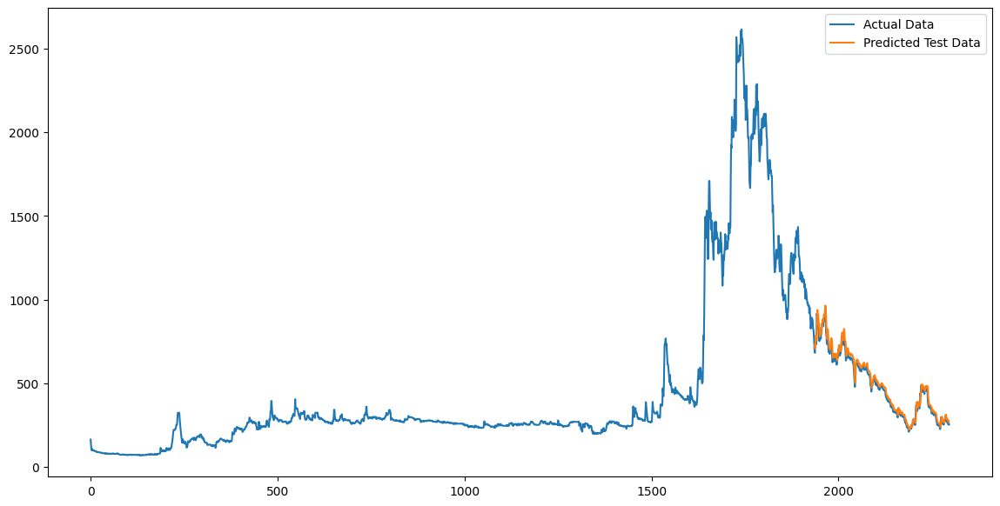

In [ ]:
# Membuat gambar (figure) dengan ukuran 14x7
plt.figure(figsize=(14, 7))
# Membuat plot garis untuk data aktual dengan label 'Actual Data'
plt.plot(bbyb_hist3, label='Actual Data')
# Membuat plot garis untuk data prediksi pada dengan label 'Predicted Test Data'
plt.plot(testPredictPlot_bbyb_lstm, label='Predicted Test Data')
# Menambahkan legenda ke plot berdasarkan label-label yang telah ditentukan sebelumnya
plt.legend()
# Menampilkan plot
plt.show()

In [ ]:
# Fungsi menghitung MAPE
def mean_absolute_percentage_error(y_true, y_pred):
    y_true, y_pred = np.array(y_true), np.array(y_pred)
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100

In [ ]:
# Melihat Metric Evaluation RMSE dan MAPE
mape_lstm1_bbyb = mean_absolute_percentage_error(Y_test_bbyb_lstm,test_predict_bbyb_lstm)
print("RMSE of GRU:", np.sqrt(mean_squared_error(Y_test_bbyb_lstm,test_predict_bbyb_lstm)))
print("MAPE of GRU:", mape_lstm1_bbyb)

RMSE of GRU: 30.869786316776437
MAPE of GRU: 5.2553292885744245


#### Hyperparameter Tuning & Optimization Model Using 3 Layers - Best Model

In [ ]:
# Mengambil kolom close
bbyb_hist2 = bbyb_hist['Close']

In [ ]:
# Train-Test Split
train_size = int(len(bbyb_hist2) * 0.80)
test_size = len(bbyb_hist2) - train_size
train_data_bbyb_gru, test_data_bbyb_gru = bbyb_hist2[:train_size], bbyb_hist2[train_size:]

# Scalling data
scaler = MinMaxScaler()
bbyb_hist2 = scaler.fit_transform(np.array(bbyb_hist2).reshape(-1,1))
train_data_bbyb_gru = scaler.fit_transform(np.array(train_data_bbyb_gru).reshape(-1, 1))
test_data_bbyb_gru = scaler.transform(np.array(test_data_bbyb_gru).reshape(-1, 1))

In [ ]:
def create_dataset(dataset, time_step = 1):
    dataX,dataY = [],[]
    for i in range(len(dataset)-time_step-1):
                   a = dataset[i:(i+time_step),0]
                   dataX.append(a)
                   dataY.append(dataset[i + time_step,0])
    return np.array(dataX),np.array(dataY)

In [ ]:
# Memanggil fungsi create_dataset untuk membagi data menjadi dataset input dan output dataset dengan times step 100
time_step = 100
X_train_bbyb_gru,Y_train_bbyb_gru =  create_dataset(train_data_bbyb_gru,time_step)
X_test_bbyb_gru,Y_test_bbyb_gru =  create_dataset(test_data_bbyb_gru,time_step)

In [ ]:
Y_train_bbyb_gru

array([0.0013154 , 0.0006577 , 0.0006577 , ..., 0.47001238, 0.48284946,
       0.46084306])

In [ ]:
# Memeriksa value
print(X_train_bbyb_gru.shape)
print(X_train_bbyb_gru)
print(X_test_bbyb_gru.shape)
print(Y_test_bbyb_gru.shape)

(1736, 100)
[[3.71600181e-02 2.46637359e-02 1.54559415e-02 ... 6.57701742e-04
  9.86551115e-04 1.31540049e-03]
 [2.46637359e-02 1.54559415e-02 1.15097460e-02 ... 9.86551115e-04
  1.31540049e-03 1.31540049e-03]
 [1.54559415e-02 1.15097460e-02 1.54559415e-02 ... 1.31540049e-03
  1.31540049e-03 6.57701742e-04]
 ...
 [9.37648538e-01 9.26645384e-01 9.26645384e-01 ... 4.29667277e-01
  4.40670479e-01 4.40670479e-01]
 [9.26645384e-01 9.26645384e-01 9.63322692e-01 ... 4.40670479e-01
  4.40670479e-01 4.70012383e-01]
 [9.26645384e-01 9.63322692e-01 9.37648538e-01 ... 4.40670479e-01
  4.70012383e-01 4.82849460e-01]]
(359, 100)
(359,)


In [ ]:
# Tetapkan seed untuk inisialisasi acak
seed_value = 42
tf.random.set_seed(seed_value)
np.random.seed(seed_value)

# Definisikan fungsi untuk membuat model GRU dengan hyperparameter
def build_model_l3_200(hp):
    model = tf.keras.Sequential()
    model.add(tf.keras.layers.GRU(
        units=hp.Int('units_1', min_value=50, max_value=200, step=10),
        return_sequences=True,
        input_shape=(X_train_bbyb_gru.shape[1], 1)
    ))
    model.add(tf.keras.layers.GRU(
        units=hp.Int('units_2', min_value=50, max_value=200, step=10)
    ))
    model.add(tf.keras.layers.Dense(1))

    model.compile(
        optimizer=tf.keras.optimizers.Adam(
            hp.Choice('learning_rate', values=[1e-2, 1e-3, 1e-4])
        ),
        loss='mean_squared_error'
    )
    return model


In [ ]:
# Atur pencarian hyperparameter menggunakan RandomSearch
tuner = RandomSearch(
    build_model_l3_200,
    objective='val_loss',
    max_trials=10,  # Jumlah percobaan untuk menemukan kombinasi hyperparameter terbaik
    executions_per_trial=1,  # Jumlah eksekusi per percobaan untuk akurasi lebih baik
    directory='hyperparameter_tuning_l3_200',
    project_name='gru_tuning_l3_200'
)

# Tentukan data pelatihan dan validasi
tuner.search(X_train_bbyb_gru, Y_train_bbyb_gru, validation_data=(X_test_bbyb_gru, Y_test_bbyb_gru), epochs=30, batch_size=64, verbose=1)

# Mendapatkan hasil terbaik
best_hps_l3_bbyb = tuner.get_best_hyperparameters(num_trials=1)[0]

# Membangun model dengan hyperparameter terbaik
model_bbyb_gru_l3 = build_model_l3(best_hps_l3_bbyb)

Trial 10 Complete [00h 09m 28s]
val_loss: 0.00016002893971744925

Best val_loss So Far: 8.373475429834798e-05
Total elapsed time: 01h 06m 16s


In [ ]:
print(best_hps_l3_bbyb)

In [ ]:
# Melihat rangkuman model
model_bbyb_gru_l3.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 gru_2 (GRU)                 (None, 100, 60)           11340     
                                                                 
 gru_3 (GRU)                 (None, 130)               74880     
                                                                 
 dense_1 (Dense)             (None, 1)                 131       
                                                                 
Total params: 86351 (337.31 KB)
Trainable params: 86351 (337.31 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________


In [ ]:
# Menetapkan seed untuk TensorFlow untuk memastikan hasil yang konsisten dari operasi stokastik (jika ada)
tf.random.set_seed(seed_value)

# Melatih model menggunakan data pelatihan (X_train_bbyb dan Y_train_bbyb) dengan data validasi (X_test_bbyb dan Y_test_bbyb)
# Epochs adalah jumlah kali seluruh dataset akan diberikan kepada model selama proses pelatihan
# Batch_size adalah jumlah sampel data yang akan diproses sebelum pembaharuan bobot model
# verbose = 1 menghasilkan output detail pada setiap epoch selama pelatihan
model_bbyb_gru_l3.fit(X_train_bbyb_gru, Y_train_bbyb_gru, validation_data=(X_test_bbyb_gru, Y_test_bbyb_gru), epochs=50, batch_size=64, verbose=1)
model_bbyb_gru_l3.save("/content/drive/MyDrive/Saved Models/model_bbyb_gru_l3_200.h5")

Epoch 1/50
28/28 [==============================] - 13s 337ms/step - loss: 0.0131 - val_loss: 0.0013
Epoch 2/50
28/28 [==============================] - 6s 212ms/step - loss: 6.0847e-04 - val_loss: 1.8431e-04
Epoch 3/50
28/28 [==============================] - 9s 313ms/step - loss: 2.7886e-04 - val_loss: 2.9071e-04
Epoch 4/50
28/28 [==============================] - 6s 212ms/step - loss: 2.3499e-04 - val_loss: 1.0400e-04
Epoch 5/50
28/28 [==============================] - 8s 304ms/step - loss: 2.1567e-04 - val_loss: 8.8892e-05
Epoch 6/50
28/28 [==============================] - 6s 214ms/step - loss: 2.7676e-04 - val_loss: 8.5137e-05
Epoch 7/50
28/28 [==============================] - 9s 309ms/step - loss: 2.2522e-04 - val_loss: 1.2777e-04
Epoch 8/50
28/28 [==============================] - 6s 218ms/step - loss: 2.0854e-04 - val_loss: 2.4299e-04
Epoch 9/50
28/28 [==============================] - 8s 304ms/step - loss: 2.2258e-04 - val_loss: 9.6407e-05
Epoch 10/50
28/28 [================

In [ ]:
# Memprediksi data menggunakan model yang telah dilatih
train_predict_bbyb_gru = model_bbyb_gru_l3.predict(X_train_bbyb_gru)
test_predict_bbyb_gru = model_bbyb_gru_l3.predict(X_test_bbyb_gru)

12/12 [==============================] - 1s 47ms/step


In [ ]:
Y_train_bbyb_gru[:5]

array([0.0013154 , 0.0006577 , 0.0006577 , 0.00164425, 0.00164425])

In [ ]:
train_predict_bbyb_gru[:5]

array([[-0.0036218 ],
       [-0.00394196],
       [-0.0048121 ],
       [-0.00426266],
       [-0.00283059]], dtype=float32)

In [ ]:
# Transformasi data ke bentuk awal
Y_train_bbyb_gru = scaler.inverse_transform(Y_train_bbyb_gru.reshape(-1, 1))
Y_test_bbyb_gru = scaler.inverse_transform(Y_test_bbyb_gru.reshape(-1, 1))
train_predict_bbyb_gru = scaler.inverse_transform(train_predict_bbyb_gru)
test_predict_bbyb_gru = scaler.inverse_transform(test_predict_bbyb_gru)

In [ ]:
Y_test_bbyb_gru[:5]

array([[681.62750244],
       [770.3324585 ],
       [746.98907471],
       [732.98303223],
       [732.98303223]])

In [ ]:
test_predict_bbyb_gru[:5]

array([[702.5063 ],
       [696.94696],
       [829.2895 ],
       [759.3902 ],
       [735.3841 ]], dtype=float32)

In [ ]:
# Mendefinisikan jumlah langkah waktu sebelumnya yang akan digunakan sebagai input untuk memprediksi langkah waktu saat ini
look_back = 100

# Membuat array kosong dengan ukuran yang sama dengan bbyb_hist2
trainPredictPlot_bbyb = np.empty_like(bbyb_hist2)
# Mengisi array dengan nilai yang sama dengan NaN (untuk plot)
trainPredictPlot_bbyb[:,:] = np.nan
# Mengisi bagian dari array dengan hasil prediksi pada data pelatihan
# Menempatkan hasil prediksi pada posisi yang sesuai dalam array untuk plotting
trainPredictPlot_bbyb[look_back : len(train_predict_bbyb_gru)+look_back,:] = train_predict_bbyb_gru

# Membuat array kosong dengan ukuran yang sama dengan bbyb_hist2
testPredictPlot_bbyb_gru = np.empty_like(bbyb_hist2)
# Mengisi array dengan nilai yang sama dengan NaN (untuk plot)
testPredictPlot_bbyb_gru[:,:] = np.nan
# Mengisi bagian dari array dengan hasil prediksi pada data uji
# Menempatkan hasil prediksi pada posisi yang sesuai dalam array untuk plotting
testPredictPlot_bbyb_gru[len(train_predict_bbyb_gru) + (look_back) * 2 + 1 : len(bbyb_hist2) - 1, :] = test_predict_bbyb_gru

In [ ]:
# Mengambil data harga saham close dan dijadikan dalam bentuk array numpy
bbyb_hist3=bbyb_hist['Close'].to_numpy()

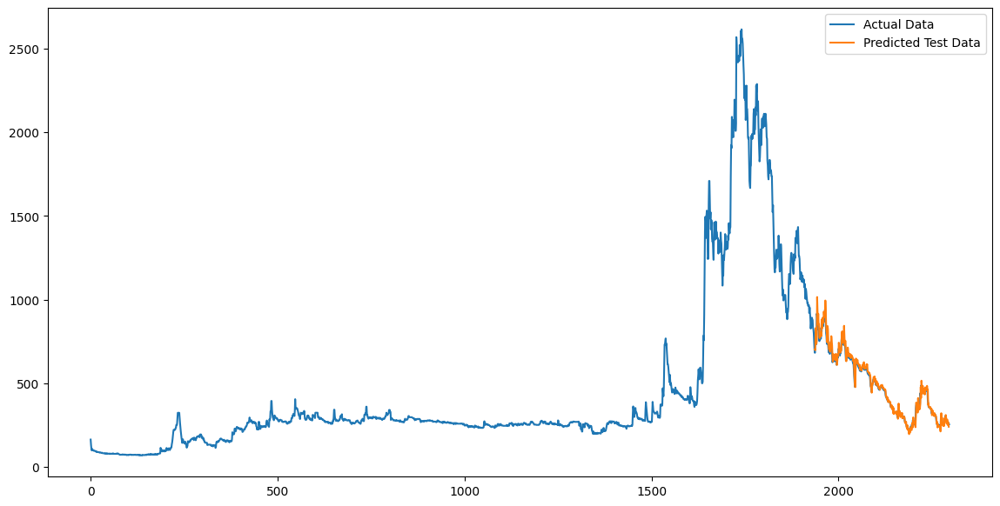

In [ ]:
# Membuat gambar (figure) dengan ukuran 14x7
plt.figure(figsize=(14, 7))
# Membuat plot garis untuk data aktual dengan label 'Actual Data'
plt.plot(bbyb_hist3, label='Actual Data')
# Membuat plot garis untuk data prediksi pada dengan label 'Predicted Test Data'
plt.plot(testPredictPlot_bbyb_gru, label='Predicted Test Data')
# Menambahkan legenda ke plot berdasarkan label-label yang telah ditentukan sebelumnya
plt.legend()
# Menampilkan plot
plt.show()

In [ ]:
# Fungsi menghitung MAPE
def mean_absolute_percentage_error(y_true, y_pred):
    y_true, y_pred = np.array(y_true), np.array(y_pred)
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100

In [ ]:
# Melihat Metric Evaluation RMSE dan MAPE
mape_gru_l3_bbyb = mean_absolute_percentage_error(Y_test_bbyb_gru,test_predict_bbyb_gru)
print("RMSE of GRU:", np.sqrt(mean_squared_error(Y_test_bbyb_gru,test_predict_bbyb_gru)))
print("MAPE of GRU:", mape_gru_l3_bbyb)

RMSE of GRU: 28.411036957858418
MAPE of GRU: 4.01910757334151


#### Hyperparameter Tuning & Optimatization Using 6 Layers - Worst Model

In [ ]:
# Mengambil kolom close
bbyb_hist2 = bbyb_hist['Close']

In [ ]:
# Train-Test Split
train_size = int(len(bbyb_hist2) * 0.80)
test_size = len(bbyb_hist2) - train_size
train_data_bbyb_gru, test_data_bbyb_gru = bbyb_hist2[:train_size], bbyb_hist2[train_size:]

# Scalling data
scaler = MinMaxScaler()
bbyb_hist2 = scaler.fit_transform(np.array(bbyb_hist2).reshape(-1,1))
train_data_bbyb_gru = scaler.fit_transform(np.array(train_data_bbyb_gru).reshape(-1, 1))
test_data_bbyb_gru = scaler.transform(np.array(test_data_bbyb_gru).reshape(-1, 1))

In [ ]:
def create_dataset(dataset, time_step = 1):
    dataX,dataY = [],[]
    for i in range(len(dataset)-time_step-1):
                   a = dataset[i:(i+time_step),0]
                   dataX.append(a)
                   dataY.append(dataset[i + time_step,0])
    return np.array(dataX),np.array(dataY)

In [ ]:
# Memanggil fungsi create_dataset untuk membagi data menjadi dataset input dan output dataset dengan times step 100
time_step = 100
X_train_bbyb_gru,Y_train_bbyb_gru =  create_dataset(train_data_bbyb_gru,time_step)
X_test_bbyb_gru,Y_test_bbyb_gru =  create_dataset(test_data_bbyb_gru,time_step)

In [ ]:
Y_train_bbyb_gru

array([0.0013154 , 0.0006577 , 0.0006577 , ..., 0.47001238, 0.48284946,
       0.46084306])

In [ ]:
# Memeriksa value
print(X_train_bbyb_gru.shape)
print(X_train_bbyb_gru)
print(X_test_bbyb_gru.shape)
print(Y_test_bbyb_gru.shape)

(1736, 100)
[[3.71600181e-02 2.46637359e-02 1.54559415e-02 ... 6.57701742e-04
  9.86551115e-04 1.31540049e-03]
 [2.46637359e-02 1.54559415e-02 1.15097460e-02 ... 9.86551115e-04
  1.31540049e-03 1.31540049e-03]
 [1.54559415e-02 1.15097460e-02 1.54559415e-02 ... 1.31540049e-03
  1.31540049e-03 6.57701742e-04]
 ...
 [9.37648538e-01 9.26645384e-01 9.26645384e-01 ... 4.29667277e-01
  4.40670479e-01 4.40670479e-01]
 [9.26645384e-01 9.26645384e-01 9.63322692e-01 ... 4.40670479e-01
  4.40670479e-01 4.70012383e-01]
 [9.26645384e-01 9.63322692e-01 9.37648538e-01 ... 4.40670479e-01
  4.70012383e-01 4.82849460e-01]]
(359, 100)
(359,)


In [ ]:
# Tetapkan seed untuk inisialisasi acak
seed_value = 42
tf.random.set_seed(seed_value)
np.random.seed(seed_value)

# Definisikan fungsi untuk membuat model GRU dengan hyperparameter
def build_model_l6(hp):
    model = tf.keras.Sequential()
    model.add(tf.keras.layers.GRU(
        units=hp.Int('units_1', min_value=50, max_value=200, step=50),
        return_sequences=True,
        input_shape=(X_train_bbyb_gru.shape[1], 1)
    ))
    model.add(tf.keras.layers.GRU(
        units=hp.Int('units_2', min_value=50, max_value=200, step=50),
        return_sequences=True
    ))
    model.add(tf.keras.layers.GRU(
        units=hp.Int('units_3', min_value=50, max_value=200, step=50),
        return_sequences=True
    ))
    model.add(tf.keras.layers.GRU(
        units=hp.Int('units_4', min_value=50, max_value=200, step=50),
        return_sequences=True
    ))
    model.add(tf.keras.layers.GRU(
        units=hp.Int('units_5', min_value=50, max_value=200, step=50)
    ))
    model.add(tf.keras.layers.Dense(1))

    model.compile(
        optimizer=tf.keras.optimizers.Adam(
            hp.Choice('learning_rate', values=[1e-2, 1e-3, 1e-4])
        ),
        loss='mean_squared_error'
    )
    return model


<ipython-input-20-af2a059b8b4a>:2: DeprecationWarning: `import kerastuner` is deprecated, please use `import keras_tuner`.
  from kerastuner import HyperModel, RandomSearch


In [ ]:
# Atur pencarian hyperparameter menggunakan RandomSearch
tuner = RandomSearch(
    build_model_l6,
    objective='val_loss',
    max_trials=10,  # Jumlah percobaan untuk menemukan kombinasi hyperparameter terbaik
    executions_per_trial=1,  # Jumlah eksekusi per percobaan untuk akurasi lebih baik
    directory='hyperparameter_tuning_l6',
    project_name='gru_tuning_l6'
)

# Tentukan data pelatihan dan validasi
tuner.search(X_train_bbyb_gru, Y_train_bbyb_gru, validation_data=(X_test_bbyb_gru, Y_test_bbyb_gru), epochs=30, batch_size=66, verbose=1)

# Mendapatkan hasil terbaik
best_hps_l6 = tuner.get_best_hyperparameters(num_trials=1)[0]

# Membangun model dengan hyperparameter terbaik
model_bbyb_gru_l6 = build_model_l6(best_hps_l6)

Trial 10 Complete [00h 16m 33s]
val_loss: 0.00024015178496483713

Best val_loss So Far: 9.195580059895292e-05
Total elapsed time: 02h 17m 39s


In [ ]:
print(best_hps_l6)

In [ ]:
# Melihat rangkuman model
model_bbyb_gru_l6.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 gru_5 (GRU)                 (None, 100, 50)           7950      
                                                                 
 gru_6 (GRU)                 (None, 100, 100)          45600     
                                                                 
 gru_7 (GRU)                 (None, 100, 100)          60600     
                                                                 
 gru_8 (GRU)                 (None, 100, 200)          181200    
                                                                 
 gru_9 (GRU)                 (None, 150)               158400    
                                                                 
 dense_1 (Dense)             (None, 1)                 151       
                                                                 
Total params: 453901 (1.73 MB)
Trainable params: 45390

In [ ]:
# Menetapkan seed untuk TensorFlow untuk memastikan hasil yang konsisten dari operasi stokastik (jika ada)
tf.random.set_seed(seed_value)

# Melatih model menggunakan data pelatihan (X_train_bbyb dan Y_train_bbyb) dengan data validasi (X_test_bbyb dan Y_test_bbyb)
# Epochs adalah jumlah kali seluruh dataset akan diberikan kepada model selama proses pelatihan
# Batch_size adalah jumlah sampel data yang akan diproses sebelum pembaharuan bobot model
# verbose = 1 menghasilkan output detail pada setiap epoch selama pelatihan
model_bbyb_gru_l6.fit(X_train_bbyb_gru, Y_train_bbyb_gru, validation_data=(X_test_bbyb_gru, Y_test_bbyb_gru), epochs=50, batch_size=64, verbose=1)
model_bbyb_gru_l6.save("/content/drive/MyDrive/Saved Models/model_bbyb_gru_l6.h5")

Epoch 1/50
28/28 [==============================] - 38s 1s/step - loss: 0.0049 - val_loss: 3.5440e-04
Epoch 2/50
28/28 [==============================] - 23s 840ms/step - loss: 0.0014 - val_loss: 3.4732e-04
Epoch 3/50
28/28 [==============================] - 25s 864ms/step - loss: 0.0013 - val_loss: 5.5718e-04
Epoch 4/50
28/28 [==============================] - 25s 906ms/step - loss: 0.0010 - val_loss: 3.5025e-04
Epoch 5/50
28/28 [==============================] - 23s 825ms/step - loss: 8.4095e-04 - val_loss: 2.2233e-04
Epoch 6/50
28/28 [==============================] - 27s 969ms/step - loss: 9.1882e-04 - val_loss: 3.1755e-04
Epoch 7/50
28/28 [==============================] - 25s 915ms/step - loss: 5.3659e-04 - val_loss: 6.3458e-04
Epoch 8/50
28/28 [==============================] - 24s 877ms/step - loss: 5.3440e-04 - val_loss: 4.1587e-04
Epoch 9/50
28/28 [==============================] - 26s 907ms/step - loss: 4.0949e-04 - val_loss: 2.4380e-04
Epoch 10/50
28/28 [===================

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


In [ ]:
# Memprediksi data menggunakan model yang telah dilatih
train_predict_bbyb_gru = model_bbyb_gru_l6.predict(X_train_bbyb_gru)
test_predict_bbyb_gru = model_bbyb_gru_l6.predict(X_test_bbyb_gru)

12/12 [==============================] - 2s 139ms/step


In [ ]:
Y_train_bbyb_gru[:5]

array([0.0013154 , 0.0006577 , 0.0006577 , 0.00164425, 0.00164425])

In [ ]:
train_predict_bbyb_gru[:5]

array([[0.00174561],
       [0.00178859],
       [0.00122018],
       [0.00109119],
       [0.00191262]], dtype=float32)

In [ ]:
# Transformasi data ke bentuk awal
Y_train_bbyb_gru = scaler.inverse_transform(Y_train_bbyb_gru.reshape(-1, 1))
Y_test_bbyb_gru = scaler.inverse_transform(Y_test_bbyb_gru.reshape(-1, 1))
train_predict_bbyb_gru = scaler.inverse_transform(train_predict_bbyb_gru)
test_predict_bbyb_gru = scaler.inverse_transform(test_predict_bbyb_gru)

In [ ]:
Y_test_bbyb_gru[:5]

array([[681.62750244],
       [770.3324585 ],
       [746.98907471],
       [732.98303223],
       [732.98303223]])

In [ ]:
test_predict_bbyb_gru[:5]

array([[749.6145 ],
       [729.30066],
       [812.893  ],
       [798.1989 ],
       [778.50946]], dtype=float32)

In [ ]:
# Mendefinisikan jumlah langkah waktu sebelumnya yang akan digunakan sebagai input untuk memprediksi langkah waktu saat ini
look_back = 100

# Membuat array kosong dengan ukuran yang sama dengan bbyb_hist2
trainPredictPlot_bbyb = np.empty_like(bbyb_hist2)
# Mengisi array dengan nilai yang sama dengan NaN (untuk plot)
trainPredictPlot_bbyb[:,:] = np.nan
# Mengisi bagian dari array dengan hasil prediksi pada data pelatihan
# Menempatkan hasil prediksi pada posisi yang sesuai dalam array untuk plotting
trainPredictPlot_bbyb[look_back : len(train_predict_bbyb_gru)+look_back,:] = train_predict_bbyb_gru

# Membuat array kosong dengan ukuran yang sama dengan bbyb_hist2
testPredictPlot_bbyb_gru = np.empty_like(bbyb_hist2)
# Mengisi array dengan nilai yang sama dengan NaN (untuk plot)
testPredictPlot_bbyb_gru[:,:] = np.nan
# Mengisi bagian dari array dengan hasil prediksi pada data uji
# Menempatkan hasil prediksi pada posisi yang sesuai dalam array untuk plotting
testPredictPlot_bbyb_gru[len(train_predict_bbyb_gru) + (look_back) * 2 + 1 : len(bbyb_hist2) - 1, :] = test_predict_bbyb_gru

In [ ]:
# Mengambil data harga saham close dan dijadikan dalam bentuk array numpy
bbyb_hist3=bbyb_hist['Close'].to_numpy()

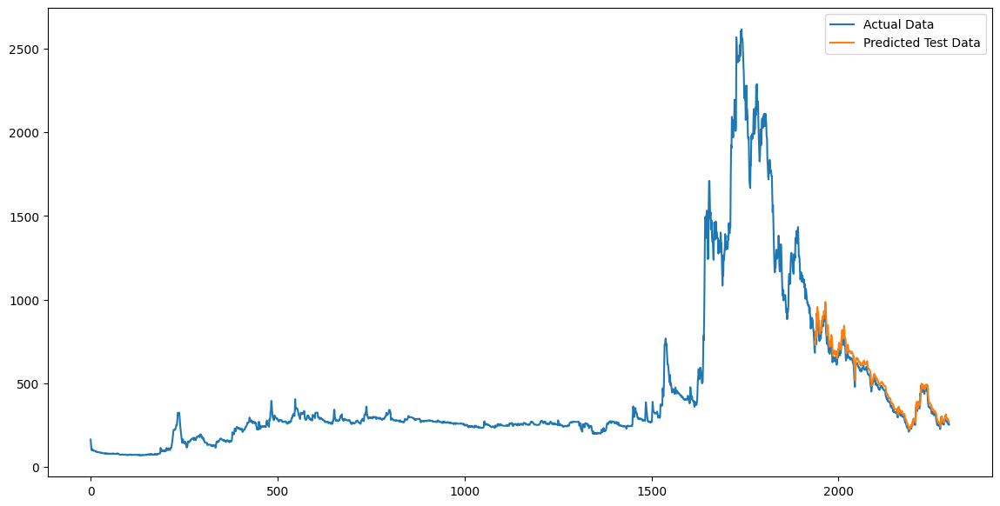

In [ ]:
# Membuat gambar (figure) dengan ukuran 14x7
plt.figure(figsize=(14, 7))
# Membuat plot garis untuk data aktual dengan label 'Actual Data'
plt.plot(bbyb_hist3, label='Actual Data')
# Membuat plot garis untuk data prediksi pada dengan label 'Predicted Test Data'
plt.plot(testPredictPlot_bbyb_gru, label='Predicted Test Data')
# Menambahkan legenda ke plot berdasarkan label-label yang telah ditentukan sebelumnya
plt.legend()
# Menampilkan plot
plt.show()

In [ ]:
# Fungsi menghitung MAPE
def mean_absolute_percentage_error(y_true, y_pred):
    y_true, y_pred = np.array(y_true), np.array(y_pred)
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100

In [ ]:
# Melihat Metric Evaluation RMSE dan MAPE
mape_gru_l6_bbyb = mean_absolute_percentage_error(Y_test_bbyb_gru,test_predict_bbyb_gru)
print("RMSE of gru:", np.sqrt(mean_squared_error(Y_test_bbyb_gru,test_predict_bbyb_gru)))
print("MAPE of gru:", mape_gru_l6_bbyb)

RMSE of gru: 38.591662050338456
MAPE of gru: 6.74726683014409


#### Forecasting using Best Model

In [ ]:
# Mengambil kolom close
bbyb_hist2 = bbyb_hist.copy()

In [ ]:
# Train-Test Split
train_size = int(len(bbyb_hist2) * 0.80)
test_size = len(bbyb_hist2) - train_size
train_data_bbyb_gru, test_data_bbyb_gru = bbyb_hist2[:train_size], bbyb_hist2[train_size:]

# Scalling data
# scaler = MinMaxScaler()
# bmri_hist2 = scaler.fit_transform(np.array(bmri_hist2).reshape(-1,1))
# train_data_bmri_gru = scaler.fit_transform(np.array(train_data_bmri_gru).reshape(-1, 1))
# test_data_bmri_gru = scaler.transform(np.array(test_data_bmri_gru).reshape(-1, 1))

In [ ]:
test_data_bbyb_gru.head()

,Date,Open,High,Low,Close,Volume,Dividends,Stock Splits
Date,,,,,,,,
2022-05-25,2022-05-25 00:00:00+07:00,1279.218750,1321.236938,1251.206665,1274.550049,22398399,0.0,0.0
2022-05-27,2022-05-27 00:00:00+07:00,1283.887451,1349.249023,1283.887451,1297.893555,43460662,0.0,0.0
2022-05-30,2022-05-30 00:00:00+07:00,1311.899536,1330.574341,1251.206665,1255.875366,29060880,0.0,0.0
2022-05-31,2022-05-31 00:00:00+07:00,1255.875366,1381.929810,1246.537964,1381.929810,134504993,0.0,0.0
2022-06-02,2022-06-02 00:00:00+07:00,1381.929810,1381.929810,1288.556152,1288.556152,43693276,0.0,0.0


DataFrame awal:
                                Date         Open         High          Low  \
Date                                                                          
2022-05-25 2022-05-25 00:00:00+07:00  1279.218750  1321.236938  1251.206665   
2022-05-27 2022-05-27 00:00:00+07:00  1283.887451  1349.249023  1283.887451   
2022-05-30 2022-05-30 00:00:00+07:00  1311.899536  1330.574341  1251.206665   
2022-05-31 2022-05-31 00:00:00+07:00  1255.875366  1381.929810  1246.537964   
2022-06-02 2022-06-02 00:00:00+07:00  1381.929810  1381.929810  1288.556152   

                  Close     Volume  Dividends  Stock Splits  
Date                                                         
2022-05-25  1274.550049   22398399        0.0           0.0  
2022-05-27  1297.893555   43460662        0.0           0.0  
2022-05-30  1255.875366   29060880        0.0           0.0  
2022-05-31  1381.929810  134504993        0.0           0.0  
2022-06-02  1288.556152   43693276        0.0           0.

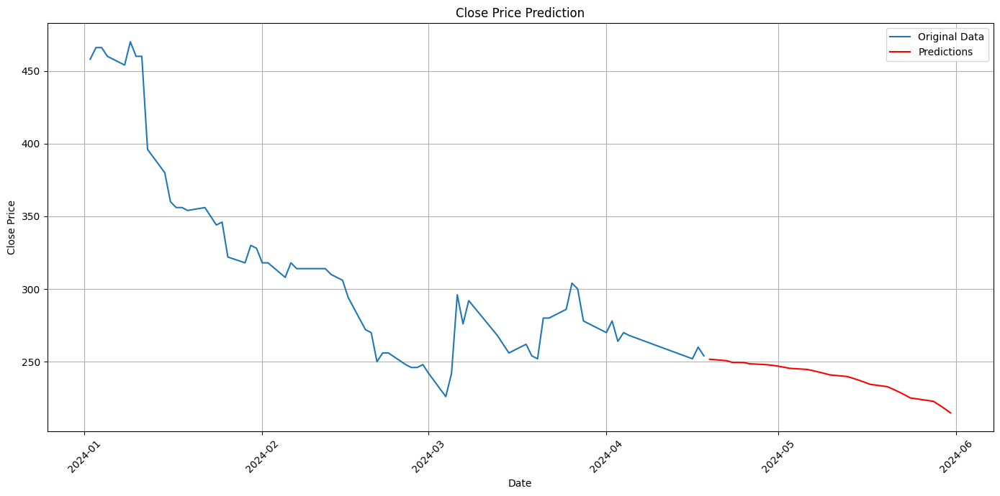

In [ ]:
df = test_data_bbyb_gru.copy()

# Menampilkan 5 baris pertama dari DataFrame
print("DataFrame awal:")
print(df.head())

# Menampilkan 5 baris terakhir dari DataFrame
print("\nDataFrame akhir:")
print(df.tail())

# 1. Load model
model = load_model('/content/drive/MyDrive/Saved Models/model_bbyb_gru_l3_200.h5')

# 2. Prepare data (gunakan data dari 100 hari terakhir)
last_n_days = 100  # Menggunakan 100 hari terakhir sesuai kebutuhan model
data_to_predict = df['Close'][-last_n_days:].values

# 3. Scaling data (misalnya menggunakan MinMaxScaler)
scaler = MinMaxScaler(feature_range=(0, 1))
data_to_predict_scaled = scaler.fit_transform(data_to_predict.reshape(-1, 1))

# 4. Reshape data
data_to_predict_scaled = np.reshape(data_to_predict_scaled, (1, last_n_days, 1))

# 5. Predict multiple business days into the future, skipping weekends and holidays
n_days_to_predict = 30
predictions = []

# Get Jakarta (WIB) timezone
wib_timezone = timezone('Asia/Jakarta')

# Get NYSE calendar
nyse = mcal.get_calendar('NYSE')

# Get next business day from the last available date in the dataframe
last_date = df['Date'].iloc[-1].astimezone(wib_timezone)  # Konversi ke zona waktu Jakarta
current_date = last_date

# List to hold predicted dates
predicted_dates = []

for _ in range(n_days_to_predict):
    # Get next business day
    current_date = nyse.valid_days(start_date=current_date + pd.Timedelta(days=1), end_date=current_date + pd.Timedelta(days=30), tz='Asia/Jakarta')[0]

    # Predict only if it's a business day
    if current_date.weekday() < 5:  # Monday=0, Sunday=6
        # Predict
        predicted_scaled = model.predict(data_to_predict_scaled)
        predicted = scaler.inverse_transform(predicted_scaled)

        # Save prediction
        predictions.append(predicted[0][0])

        # Update data_to_predict_scaled for the next prediction
        data_to_predict_scaled = np.append(data_to_predict_scaled[:, 1:, :], np.reshape(predicted_scaled, (1, 1, 1)), axis=1)

        # Save predicted date
        predicted_dates.append(current_date)

# Print the predicted values
print("\nPredicted values for the next business days:")
print(predictions)

# Mendapatkan tanggal terakhir dari data asli
last_date = df['Date'].iloc[-1].astimezone(wib_timezone)  # Konversi ke zona waktu Jakarta

# Membuat DataFrame baru untuk hasil prediksi
prediction_df = pd.DataFrame({'Date': predicted_dates, 'Predicted_Close': predictions})

# Menampilkan DataFrame prediksi
print("\nPrediction DataFrame:")
print(prediction_df)

# Plotting the results
plt.figure(figsize=(14, 7))

# Plot the original data
plt.plot(df[df['Date'] > '2024-01-01']['Date'], df[df['Date'] > '2024-01-01']['Close'], label='Original Data')

# Plot the predictions
plt.plot(prediction_df['Date'], prediction_df['Predicted_Close'], label='Predictions', color='red')

# Formatting the plot
plt.xlabel('Date')
plt.ylabel('Close Price')
plt.title('Close Price Prediction')
plt.legend()
plt.grid(True)
plt.xticks(rotation=45)
plt.tight_layout()

# Display the plot
plt.show()


In [ ]:
prediction_df

,Date,Predicted_Close
0,2024-04-19 00:00:00+07:00,251.700302
1,2024-04-22 00:00:00+07:00,250.664810
2,2024-04-23 00:00:00+07:00,249.441757
3,2024-04-24 00:00:00+07:00,249.540161
4,2024-04-25 00:00:00+07:00,249.348129
5,2024-04-26 00:00:00+07:00,248.576981
6,2024-04-29 00:00:00+07:00,247.924362
7,2024-04-30 00:00:00+07:00,247.483734
8,2024-05-01 00:00:00+07:00,246.898758
9,2024-05-02 00:00:00+07:00,246.153595


### Bank Mandiri (BMRI)

#### Baseline Model

In [ ]:
# Mengambil kolom close
bmri_hist2 = bmri_hist['Close']

In [ ]:
# Train-Test Split
train_size = int(len(bmri_hist2) * 0.80)
test_size = len(bmri_hist2) - train_size
train_data_bmri_gru, test_data_bmri_gru = bmri_hist2[:train_size], bmri_hist2[train_size:]

# Scalling data
scaler = MinMaxScaler()
bmri_hist2 = scaler.fit_transform(np.array(bmri_hist2).reshape(-1,1))
train_data_bmri_gru = scaler.fit_transform(np.array(train_data_bmri_gru).reshape(-1, 1))
test_data_bmri_gru = scaler.transform(np.array(test_data_bmri_gru).reshape(-1, 1))

In [ ]:
def create_dataset(dataset, time_step = 1):
    dataX,dataY = [],[]
    for i in range(len(dataset)-time_step-1):
                   a = dataset[i:(i+time_step),0]
                   dataX.append(a)
                   dataY.append(dataset[i + time_step,0])
    return np.array(dataX),np.array(dataY)

In [ ]:
# Memanggil fungsi create_dataset untuk membagi data menjadi dataset input dan output dataset dengan times step 100
time_step = 100
X_train_bmri_gru,Y_train_bmri_gru =  create_dataset(train_data_bmri_gru,time_step)
X_test_bmri_gru,Y_test_bmri_gru =  create_dataset(test_data_bmri_gru,time_step)

In [ ]:
Y_train_bmri_gru

array([0.22453666, 0.23432961, 0.23824688, ..., 0.94447861, 0.94952596,
       0.96971557])

In [ ]:
# Memeriksa value
print(X_train_bmri_gru.shape)
print(X_train_bmri_gru)
print(X_test_bmri_gru.shape)
print(Y_test_bmri_gru.shape)

(1879, 100)
[[0.16969646 0.17165499 0.17557226 ... 0.19515806 0.20495096 0.21670239]
 [0.17165499 0.17557226 0.17361362 ... 0.20495096 0.21670239 0.22453666]
 [0.17557226 0.17361362 0.17557226 ... 0.21670239 0.22453666 0.23432961]
 ...
 [0.78265769 0.77783993 0.75375145 ... 0.93200677 0.93200677 0.92718901]
 [0.77783993 0.75375145 0.78265769 ... 0.93200677 0.92718901 0.94447861]
 [0.75375145 0.78265769 0.78265769 ... 0.92718901 0.94447861 0.94952596]]
(394, 100)
(394,)


In [ ]:
# Tetapkan seed untuk inisialisasi acak
seed_value = 42
tf.random.set_seed(seed_value)
np.random.seed(seed_value)

# Membangun model gru
model_bmri_gru1 = tf.keras.Sequential([
      # Menambahkan layer GRU pertama dengan 50 unit dan pengembalian urutan yang digunakan untuk menjaga urutan output
      # Input_shape adalah bentuk input, yaitu jumlah langkah waktu (X_train.shape[1]) dan fitur (1)
      tf.keras.layers.GRU(50, return_sequences=True, input_shape=(X_train_bmri_gru.shape[1], 1)),
      # Menambahkan layer GRU kedua dengan 50 unit, tidak ada pengembalian urutan karena ini adalah lapisan terakhir GRU
      tf.keras.layers.GRU(50),
      # Menambahkan layer Dense dengan 1 unit sebagai output layer
      tf.keras.layers.Dense(1)
])
# Mengompilasi model dengan loss function 'mean_squared_error' dan optimizer 'adam'
model_bmri_gru1.compile(loss='mean_squared_error', optimizer='adam')

In [ ]:
# Melihat rangkuman model
model_bmri_gru1.summary()

Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 gru_6 (GRU)                 (None, 100, 50)           7950      
                                                                 
 gru_7 (GRU)                 (None, 50)                15300     
                                                                 
 dense_2 (Dense)             (None, 1)                 51        
                                                                 
Total params: 23301 (91.02 KB)
Trainable params: 23301 (91.02 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________


In [ ]:
# Menetapkan seed untuk TensorFlow untuk memastikan hasil yang konsisten dari operasi stokastik (jika ada)
tf.random.set_seed(seed_value)

# Melatih model menggunakan data pelatihan (X_train_bmri dan Y_train_bmri) dengan data validasi (X_test_bmri dan Y_test_bmri)
# Epochs adalah jumlah kali seluruh dataset akan diberikan kepada model selama proses pelatihan
# Batch_size adalah jumlah sampel data yang akan diproses sebelum pembaharuan bobot model
# verbose = 1 menghasilkan output detail pada setiap epoch selama pelatihan
model_bmri_gru1.fit(X_train_bmri_gru, Y_train_bmri_gru, validation_data=(X_test_bmri_gru, Y_test_bmri_gru), epochs=50, batch_size=64, verbose=1)
model_bmri_gru1.save("model_bmri_gru1.h5")

Epoch 1/50
30/30 [==============================] - 9s 138ms/step - loss: 0.0294 - val_loss: 0.1232
Epoch 2/50
30/30 [==============================] - 3s 110ms/step - loss: 0.0021 - val_loss: 0.0280
Epoch 3/50
30/30 [==============================] - 4s 128ms/step - loss: 9.0960e-04 - val_loss: 0.0181
Epoch 4/50
30/30 [==============================] - 5s 156ms/step - loss: 8.3565e-04 - val_loss: 0.0154
Epoch 5/50
30/30 [==============================] - 3s 110ms/step - loss: 7.7930e-04 - val_loss: 0.0190
Epoch 6/50
30/30 [==============================] - 3s 110ms/step - loss: 7.5652e-04 - val_loss: 0.0139
Epoch 7/50
30/30 [==============================] - 4s 136ms/step - loss: 7.3325e-04 - val_loss: 0.0147
Epoch 8/50
30/30 [==============================] - 5s 158ms/step - loss: 6.9326e-04 - val_loss: 0.0160
Epoch 9/50
30/30 [==============================] - 3s 110ms/step - loss: 6.6794e-04 - val_loss: 0.0135
Epoch 10/50
30/30 [==============================] - 3s 109ms/step - los

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


In [ ]:
# Memprediksi data menggunakan model yang telah dilatih
train_predict_bmri_gru = model_bmri_gru1.predict(X_train_bmri_gru)
test_predict_bmri_gru = model_bmri_gru1.predict(X_test_bmri_gru)

13/13 [==============================] - 0s 35ms/step


In [ ]:
Y_train_bmri_gru[:5]

array([0.22453666, 0.23432961, 0.23824688, 0.22649524, 0.22453666])

In [ ]:
train_predict_bmri_gru[:5]

array([[0.21712938],
       [0.22550409],
       [0.2351066 ],
       [0.24027453],
       [0.23211232]], dtype=float32)

In [ ]:
# Transformasi data ke bentuk awal
Y_train_bmri_gru = scaler.inverse_transform(Y_train_bmri_gru.reshape(-1, 1))
Y_test_bmri_gru = scaler.inverse_transform(Y_test_bmri_gru.reshape(-1, 1))
train_predict_bmri_gru = scaler.inverse_transform(train_predict_bmri_gru)
test_predict_bmri_gru = scaler.inverse_transform(test_predict_bmri_gru)

In [ ]:
Y_test_bmri_gru[:5]

array([[3869.49829102],
       [3914.75561523],
       [4005.27050781],
       [4039.21313477],
       [4005.27050781]])

In [ ]:
test_predict_bmri_gru[:5]

array([[3836.4644],
       [3863.5435],
       [3908.0886],
       [3999.7776],
       [4026.5288]], dtype=float32)

In [ ]:
# Mendefinisikan jumlah langkah waktu sebelumnya yang akan digunakan sebagai input untuk memprediksi langkah waktu saat ini
look_back = 100

# Membuat array kosong dengan ukuran yang sama dengan bmri_hist2
trainPredictPlot_bmri = np.empty_like(bmri_hist2)
# Mengisi array dengan nilai yang sama dengan NaN (untuk plot)
trainPredictPlot_bmri[:,:] = np.nan
# Mengisi bagian dari array dengan hasil prediksi pada data pelatihan
# Menempatkan hasil prediksi pada posisi yang sesuai dalam array untuk plotting
trainPredictPlot_bmri[look_back : len(train_predict_bmri_gru)+look_back,:] = train_predict_bmri_gru

# Membuat array kosong dengan ukuran yang sama dengan bmri_hist2
testPredictPlot_bmri_gru = np.empty_like(bmri_hist2)
# Mengisi array dengan nilai yang sama dengan NaN (untuk plot)
testPredictPlot_bmri_gru[:,:] = np.nan
# Mengisi bagian dari array dengan hasil prediksi pada data uji
# Menempatkan hasil prediksi pada posisi yang sesuai dalam array untuk plotting
testPredictPlot_bmri_gru[len(train_predict_bmri_gru) + (look_back) * 2 + 1 : len(bmri_hist2) - 1, :] = test_predict_bmri_gru

In [ ]:
# Mengambil data harga saham close dan dijadikan dalam bentuk array numpy
bmri_hist3=bmri_hist['Close'].to_numpy()

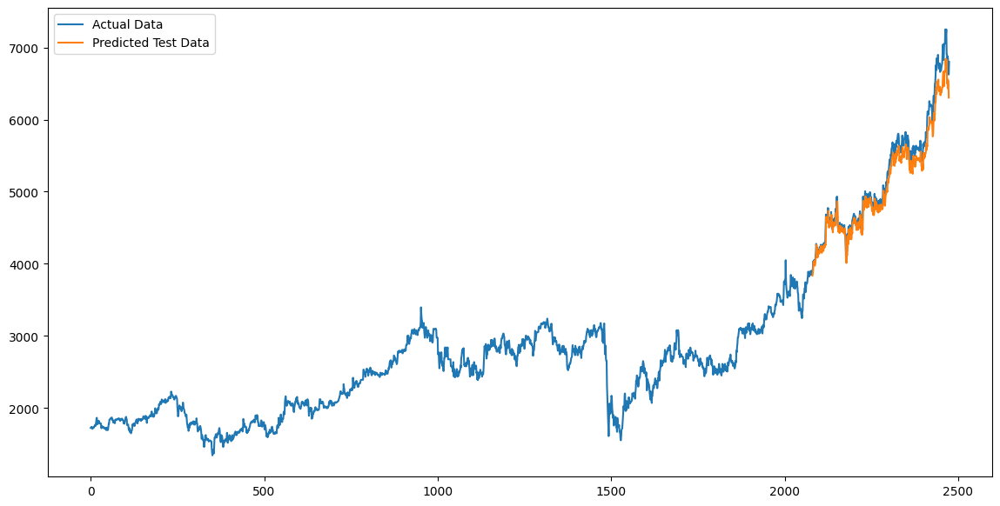

In [ ]:
# Membuat gambar (figure) dengan ukuran 14x7
plt.figure(figsize=(14, 7))
# Membuat plot garis untuk data aktual dengan label 'Actual Data'
plt.plot(bmri_hist3, label='Actual Data')
# Membuat plot garis untuk data prediksi pada dengan label 'Predicted Test Data'
plt.plot(testPredictPlot_bmri_gru, label='Predicted Test Data')
# Menambahkan legenda ke plot berdasarkan label-label yang telah ditentukan sebelumnya
plt.legend()
# Menampilkan plot
plt.show()

In [ ]:
# Fungsi menghitung MAPE
def mean_absolute_percentage_error(y_true, y_pred):
    y_true, y_pred = np.array(y_true), np.array(y_pred)
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100

In [ ]:
# Melihat Metric Evaluation RMSE dan MAPE
mape_gru1_bmri = mean_absolute_percentage_error(Y_test_bmri_gru,test_predict_bmri_gru)
print("RMSE of GRU:", np.sqrt(mean_squared_error(Y_test_bmri_gru,test_predict_bmri_gru)))
print("MAPE of GRU:", mape_gru1_bmri)

RMSE of GRU: 173.07004962995302
MAPE of GRU: 2.403611479267404


#### Hyperparameter Tuning & Optimization Using 4 Layer - Best Model

In [ ]:
# Mengambil kolom close
bmri_hist2 = bmri_hist['Close']

In [ ]:
# Train-Test Split
train_size = int(len(bmri_hist2) * 0.80)
test_size = len(bmri_hist2) - train_size
train_data_bmri_gru, test_data_bmri_gru = bmri_hist2[:train_size], bmri_hist2[train_size:]

# Scalling data
scaler = MinMaxScaler()
bmri_hist2 = scaler.fit_transform(np.array(bmri_hist2).reshape(-1,1))
train_data_bmri_gru = scaler.fit_transform(np.array(train_data_bmri_gru).reshape(-1, 1))
test_data_bmri_gru = scaler.transform(np.array(test_data_bmri_gru).reshape(-1, 1))

In [ ]:
def create_dataset(dataset, time_step = 1):
    dataX,dataY = [],[]
    for i in range(len(dataset)-time_step-1):
                   a = dataset[i:(i+time_step),0]
                   dataX.append(a)
                   dataY.append(dataset[i + time_step,0])
    return np.array(dataX),np.array(dataY)

In [ ]:
# Memanggil fungsi create_dataset untuk membagi data menjadi dataset input dan output dataset dengan times step 100
time_step = 100
X_train_bmri_gru,Y_train_bmri_gru =  create_dataset(train_data_bmri_gru,time_step)
X_test_bmri_gru,Y_test_bmri_gru =  create_dataset(test_data_bmri_gru,time_step)

In [ ]:
Y_train_bmri_gru

array([0.22453666, 0.23432961, 0.23824688, ..., 0.94447861, 0.94952596,
       0.96971557])

In [ ]:
# Memeriksa value
print(X_train_bmri_gru.shape)
print(X_train_bmri_gru)
print(X_test_bmri_gru.shape)
print(Y_test_bmri_gru.shape)

(1879, 100)
[[0.16969646 0.17165499 0.17557226 ... 0.19515806 0.20495096 0.21670239]
 [0.17165499 0.17557226 0.17361362 ... 0.20495096 0.21670239 0.22453666]
 [0.17557226 0.17361362 0.17557226 ... 0.21670239 0.22453666 0.23432961]
 ...
 [0.78265769 0.77783993 0.75375145 ... 0.93200677 0.93200677 0.92718901]
 [0.77783993 0.75375145 0.78265769 ... 0.93200677 0.92718901 0.94447861]
 [0.75375145 0.78265769 0.78265769 ... 0.92718901 0.94447861 0.94952596]]
(394, 100)
(394,)


In [ ]:
# Tetapkan seed untuk inisialisasi acak
seed_value = 42
tf.random.set_seed(seed_value)
np.random.seed(seed_value)

# Definisikan fungsi untuk membuat model GRU dengan hyperparameter
def build_model_l4(hp):
    model = tf.keras.Sequential()
    model.add(tf.keras.layers.GRU(
        units=hp.Int('units_1', min_value=50, max_value=200, step=50),
        return_sequences=True,
        input_shape=(X_train_bmri_gru.shape[1], 1)
    ))
    model.add(tf.keras.layers.GRU(
        units=hp.Int('units_2', min_value=50, max_value=200, step=50),
        return_sequences=True
    ))
    model.add(tf.keras.layers.GRU(
        units=hp.Int('units_3', min_value=50, max_value=200, step=50)
    ))
    model.add(tf.keras.layers.Dense(1))

    model.compile(
        optimizer=tf.keras.optimizers.Adam(
            hp.Choice('learning_rate', values=[1e-2, 1e-3, 1e-4])
        ),
        loss='mean_squared_error'
    )
    return model


<ipython-input-78-fc39abbdd5fa>:2: DeprecationWarning: `import kerastuner` is deprecated, please use `import keras_tuner`.
  from kerastuner import HyperModel, RandomSearch


In [ ]:
from kerastuner.tuners import RandomSearch

# Atur pencarian hyperparameter menggunakan RandomSearch
tuner = RandomSearch(
    build_model_l4,
    objective='val_loss',
    max_trials=10,  # Jumlah percobaan untuk menemukan kombinasi hyperparameter terbaik
    executions_per_trial=1,  # Jumlah eksekusi per percobaan untuk akurasi lebih baik
    directory='hyperparameter_tuning_l4',
    project_name='gru_tuning_l4'
)

# Tentukan data pelatihan dan validasi
tuner.search(X_train_bmri_gru, Y_train_bmri_gru, validation_data=(X_test_bmri_gru, Y_test_bmri_gru), epochs=30, batch_size=64, verbose=1)

# Mendapatkan hasil terbaik
best_hps_l4 = tuner.get_best_hyperparameters(num_trials=1)[0]

# Membangun model dengan hyperparameter terbaik
model_bmri_gru_l4 = build_model_l4(best_hps_l4)

Trial 10 Complete [00h 14m 29s]
val_loss: 0.0032036281190812588

Best val_loss So Far: 0.0027162947226315737
Total elapsed time: 01h 38m 18s


In [ ]:
print(best_hps_l4)

In [ ]:
# Melihat rangkuman model
model_bmri_gru_l4.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 gru_3 (GRU)                 (None, 100, 50)           7950      
                                                                 
 gru_4 (GRU)                 (None, 100, 150)          90900     
                                                                 
 gru_5 (GRU)                 (None, 150)               135900    
                                                                 
 dense_1 (Dense)             (None, 1)                 151       
                                                                 
Total params: 234901 (917.58 KB)
Trainable params: 234901 (917.58 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________


In [ ]:
# Menetapkan seed untuk TensorFlow untuk memastikan hasil yang konsisten dari operasi stokastik (jika ada)
tf.random.set_seed(seed_value)

# Melatih model menggunakan data pelatihan (X_train_bmri dan Y_train_bmri) dengan data validasi (X_test_bmri dan Y_test_bmri)
# Epochs adalah jumlah kali seluruh dataset akan diberikan kepada model selama proses pelatihan
# Batch_size adalah jumlah sampel data yang akan diproses sebelum pembaharuan bobot model
# verbose = 1 menghasilkan output detail pada setiap epoch selama pelatihan
model_bmri_gru_l4.fit(X_train_bmri_gru, Y_train_bmri_gru, validation_data=(X_test_bmri_gru, Y_test_bmri_gru), epochs=50, batch_size=64, verbose=1)
model_bmri_gru_l4.save("/content/drive/MyDrive/Saved Models/model_bmri_gru_l4.h5")

Epoch 1/50
30/30 [==============================] - 56s 2s/step - loss: 0.0268 - val_loss: 0.0917
Epoch 2/50
30/30 [==============================] - 22s 719ms/step - loss: 0.0019 - val_loss: 0.0111
Epoch 3/50
30/30 [==============================] - 17s 576ms/step - loss: 0.0011 - val_loss: 0.0185
Epoch 4/50
30/30 [==============================] - 17s 575ms/step - loss: 0.0011 - val_loss: 0.0092
Epoch 5/50
30/30 [==============================] - 17s 578ms/step - loss: 9.9193e-04 - val_loss: 0.0130
Epoch 6/50
30/30 [==============================] - 17s 567ms/step - loss: 9.6527e-04 - val_loss: 0.0056
Epoch 7/50
30/30 [==============================] - 17s 571ms/step - loss: 9.6795e-04 - val_loss: 0.0078
Epoch 8/50
30/30 [==============================] - 20s 660ms/step - loss: 8.3709e-04 - val_loss: 0.0070
Epoch 9/50
30/30 [==============================] - 20s 663ms/step - loss: 7.9553e-04 - val_loss: 0.0070
Epoch 10/50
30/30 [==============================] - 17s 575ms/step - loss

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


In [ ]:
# Memprediksi data menggunakan model yang telah dilatih
train_predict_bmri_gru = model_bmri_gru_l4.predict(X_train_bmri_gru)
test_predict_bmri_gru = model_bmri_gru_l4.predict(X_test_bmri_gru)

13/13 [==============================] - 1s 102ms/step


In [ ]:
Y_train_bmri_gru[:5]

array([0.22453666, 0.23432961, 0.23824688, 0.22649524, 0.22453666])

In [ ]:
train_predict_bmri_gru[:5]

array([[0.21320917],
       [0.22107588],
       [0.23054668],
       [0.23564231],
       [0.2279255 ]], dtype=float32)

In [ ]:
# Transformasi data ke bentuk awal
Y_train_bmri_gru = scaler.inverse_transform(Y_train_bmri_gru.reshape(-1, 1))
Y_test_bmri_gru = scaler.inverse_transform(Y_test_bmri_gru.reshape(-1, 1))
train_predict_bmri_gru = scaler.inverse_transform(train_predict_bmri_gru)
test_predict_bmri_gru = scaler.inverse_transform(test_predict_bmri_gru)

In [ ]:
Y_test_bmri_gru[:5]

array([[3869.49829102],
       [3914.75561523],
       [4005.27050781],
       [4039.21313477],
       [4005.27050781]])

In [ ]:
test_predict_bmri_gru[:5]

array([[3818.8604],
       [3857.543 ],
       [3900.948 ],
       [4000.8506],
       [4012.29  ]], dtype=float32)

In [ ]:
# Mendefinisikan jumlah langkah waktu sebelumnya yang akan digunakan sebagai input untuk memprediksi langkah waktu saat ini
look_back = 100

# Membuat array kosong dengan ukuran yang sama dengan bmri_hist2
trainPredictPlot_bmri = np.empty_like(bmri_hist2)
# Mengisi array dengan nilai yang sama dengan NaN (untuk plot)
trainPredictPlot_bmri[:,:] = np.nan
# Mengisi bagian dari array dengan hasil prediksi pada data pelatihan
# Menempatkan hasil prediksi pada posisi yang sesuai dalam array untuk plotting
trainPredictPlot_bmri[look_back : len(train_predict_bmri_gru)+look_back,:] = train_predict_bmri_gru

# Membuat array kosong dengan ukuran yang sama dengan bmri_hist2
testPredictPlot_bmri_gru = np.empty_like(bmri_hist2)
# Mengisi array dengan nilai yang sama dengan NaN (untuk plot)
testPredictPlot_bmri_gru[:,:] = np.nan
# Mengisi bagian dari array dengan hasil prediksi pada data uji
# Menempatkan hasil prediksi pada posisi yang sesuai dalam array untuk plotting
testPredictPlot_bmri_gru[len(train_predict_bmri_gru) + (look_back) * 2 + 1 : len(bmri_hist2) - 1, :] = test_predict_bmri_gru

In [ ]:
# Mengambil data harga saham close dan dijadikan dalam bentuk array numpy
bmri_hist3=bmri_hist['Close'].to_numpy()

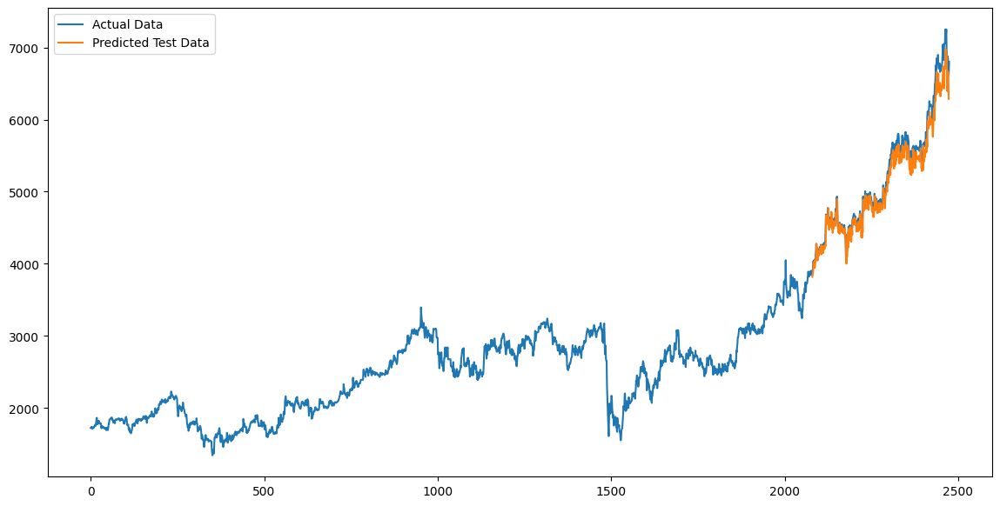

In [ ]:
# Membuat gambar (figure) dengan ukuran 14x7
plt.figure(figsize=(14, 7))
# Membuat plot garis untuk data aktual dengan label 'Actual Data'
plt.plot(bmri_hist3, label='Actual Data')
# Membuat plot garis untuk data prediksi pada dengan label 'Predicted Test Data'
plt.plot(testPredictPlot_bmri_gru, label='Predicted Test Data')
# Menambahkan legenda ke plot berdasarkan label-label yang telah ditentukan sebelumnya
plt.legend()
# Menampilkan plot
plt.show()

In [ ]:
# Fungsi menghitung MAPE
def mean_absolute_percentage_error(y_true, y_pred):
    y_true, y_pred = np.array(y_true), np.array(y_pred)
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100

In [ ]:
# Melihat Metric Evaluation RMSE dan MAPE
mape_gru_l4_bmri = mean_absolute_percentage_error(Y_test_bmri_gru,test_predict_bmri_gru)
print("RMSE of gru:", np.sqrt(mean_squared_error(Y_test_bmri_gru,test_predict_bmri_gru)))
print("MAPE of gru:", mape_gru_l4_bmri)

RMSE of gru: 161.63399083147084
MAPE of gru: 2.2939338276165797


#### Hyperparameter Tuning & Optimatization Model 5 Layers - Worst Model

In [ ]:
# Mengambil kolom close
bmri_hist2 = bmri_hist['Close']

In [ ]:
# Train-Test Split
train_size = int(len(bmri_hist2) * 0.80)
test_size = len(bmri_hist2) - train_size
train_data_bmri_gru, test_data_bmri_gru = bmri_hist2[:train_size], bmri_hist2[train_size:]

# Scalling data
scaler = MinMaxScaler()
bmri_hist2 = scaler.fit_transform(np.array(bmri_hist2).reshape(-1,1))
train_data_bmri_gru = scaler.fit_transform(np.array(train_data_bmri_gru).reshape(-1, 1))
test_data_bmri_gru = scaler.transform(np.array(test_data_bmri_gru).reshape(-1, 1))

In [ ]:
def create_dataset(dataset, time_step = 1):
    dataX,dataY = [],[]
    for i in range(len(dataset)-time_step-1):
                   a = dataset[i:(i+time_step),0]
                   dataX.append(a)
                   dataY.append(dataset[i + time_step,0])
    return np.array(dataX),np.array(dataY)

In [ ]:
# Memanggil fungsi create_dataset untuk membagi data menjadi dataset input dan output dataset dengan times step 100
time_step = 100
X_train_bmri_gru,Y_train_bmri_gru =  create_dataset(train_data_bmri_gru,time_step)
X_test_bmri_gru,Y_test_bmri_gru =  create_dataset(test_data_bmri_gru,time_step)

In [ ]:
Y_train_bmri_gru

array([0.22453666, 0.23432961, 0.23824688, ..., 0.94447861, 0.94952596,
       0.96971557])

In [ ]:
# Memeriksa value
print(X_train_bmri_gru.shape)
print(X_train_bmri_gru)
print(X_test_bmri_gru.shape)
print(Y_test_bmri_gru.shape)

(1879, 100)
[[0.16969646 0.17165499 0.17557226 ... 0.19515806 0.20495096 0.21670239]
 [0.17165499 0.17557226 0.17361362 ... 0.20495096 0.21670239 0.22453666]
 [0.17557226 0.17361362 0.17557226 ... 0.21670239 0.22453666 0.23432961]
 ...
 [0.78265769 0.77783993 0.75375145 ... 0.93200677 0.93200677 0.92718901]
 [0.77783993 0.75375145 0.78265769 ... 0.93200677 0.92718901 0.94447861]
 [0.75375145 0.78265769 0.78265769 ... 0.92718901 0.94447861 0.94952596]]
(394, 100)
(394,)


In [ ]:
pip install keras-tuner

In [ ]:
import tensorflow as tf
from kerastuner import HyperModel, RandomSearch
from kerastuner.engine.hyperparameters import HyperParameters

# Tetapkan seed untuk inisialisasi acak
seed_value = 42
tf.random.set_seed(seed_value)
np.random.seed(seed_value)

# Definisikan fungsi untuk membuat model GRU dengan hyperparameter
def build_model_l5(hp):
    model = tf.keras.Sequential()
    model.add(tf.keras.layers.GRU(
        units=hp.Int('units_1', min_value=50, max_value=200, step=50),
        return_sequences=True,
        input_shape=(X_train_bmri_gru.shape[1], 1)
    ))
    model.add(tf.keras.layers.GRU(
        units=hp.Int('units_2', min_value=50, max_value=200, step=50),
        return_sequences=True
    ))
    model.add(tf.keras.layers.GRU(
        units=hp.Int('units_3', min_value=50, max_value=200, step=50),
        return_sequences=True
    ))
    model.add(tf.keras.layers.GRU(
        units=hp.Int('units_4', min_value=50, max_value=200, step=50)
    ))
    model.add(tf.keras.layers.Dense(1))

    model.compile(
        optimizer=tf.keras.optimizers.Adam(
            hp.Choice('learning_rate', values=[1e-2, 1e-3, 1e-4])
        ),
        loss='mean_squared_error'
    )
    return model


In [ ]:
from kerastuner.tuners import RandomSearch

# Atur pencarian hyperparameter menggunakan RandomSearch
tuner = RandomSearch(
    build_model_l5,
    objective='val_loss',
    max_trials=10,  # Jumlah percobaan untuk menemukan kombinasi hyperparameter terbaik
    executions_per_trial=1,  # Jumlah eksekusi per percobaan untuk akurasi lebih baik
    directory='hyperparameter_tuning_l5',
    project_name='gru_tuning_l5'
)

# Tentukan data pelatihan dan validasi
tuner.search(X_train_bmri_gru, Y_train_bmri_gru, validation_data=(X_test_bmri_gru, Y_test_bmri_gru), epochs=30, batch_size=64, verbose=1)

# Mendapatkan hasil terbaik
best_hps_l5 = tuner.get_best_hyperparameters(num_trials=1)[0]

# Membangun model dengan hyperparameter terbaik
model_bmri_gru_l5 = build_model_l5(best_hps_l5)

Trial 10 Complete [00h 16m 31s]
val_loss: 0.025573642924427986

Best val_loss So Far: 0.002903190441429615
Total elapsed time: 02h 14m 20s


In [ ]:
print(best_hps_l5)

In [ ]:
# Melihat rangkuman model
model_bmri_gru_l5.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 gru_4 (GRU)                 (None, 100, 50)           7950      
                                                                 
 gru_5 (GRU)                 (None, 100, 100)          45600     
                                                                 
 gru_6 (GRU)                 (None, 100, 150)          113400    
                                                                 
 gru_7 (GRU)                 (None, 200)               211200    
                                                                 
 dense_1 (Dense)             (None, 1)                 201       
                                                                 
Total params: 378351 (1.44 MB)
Trainable params: 378351 (1.44 MB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________


In [ ]:
# Menetapkan seed untuk TensorFlow untuk memastikan hasil yang konsisten dari operasi stokastik (jika ada)
tf.random.set_seed(seed_value)

# Melatih model menggunakan data pelatihan (X_train_bmri dan Y_train_bmri) dengan data validasi (X_test_bmri dan Y_test_bmri)
# Epochs adalah jumlah kali seluruh dataset akan diberikan kepada model selama proses pelatihan
# Batch_size adalah jumlah sampel data yang akan diproses sebelum pembaharuan bobot model
# verbose = 1 menghasilkan output detail pada setiap epoch selama pelatihan
model_bmri_gru_l5.fit(X_train_bmri_gru, Y_train_bmri_gru, validation_data=(X_test_bmri_gru, Y_test_bmri_gru), epochs=50, batch_size=64, verbose=1)
model_bmri_gru_l5.save("model_bmri_gru_l5.h5")

Epoch 1/50
30/30 [==============================] - 37s 975ms/step - loss: 0.0264 - val_loss: 0.0343
Epoch 2/50
30/30 [==============================] - 26s 859ms/step - loss: 0.0019 - val_loss: 0.0159
Epoch 3/50
30/30 [==============================] - 24s 791ms/step - loss: 0.0015 - val_loss: 0.0238
Epoch 4/50
30/30 [==============================] - 27s 897ms/step - loss: 0.0013 - val_loss: 0.0212
Epoch 5/50
30/30 [==============================] - 25s 844ms/step - loss: 0.0012 - val_loss: 0.0257
Epoch 6/50
30/30 [==============================] - 25s 819ms/step - loss: 0.0012 - val_loss: 0.0139
Epoch 7/50
30/30 [==============================] - 26s 888ms/step - loss: 0.0011 - val_loss: 0.0131
Epoch 8/50
30/30 [==============================] - 24s 812ms/step - loss: 9.7036e-04 - val_loss: 0.0145
Epoch 9/50
30/30 [==============================] - 26s 849ms/step - loss: 9.1421e-04 - val_loss: 0.0147
Epoch 10/50
30/30 [==============================] - 26s 889ms/step - loss: 8.2881e

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


In [ ]:
# Memprediksi data menggunakan model yang telah dilatih
train_predict_bmri_gru = model_bmri_gru_l5.predict(X_train_bmri_gru)
test_predict_bmri_gru = model_bmri_gru_l5.predict(X_test_bmri_gru)

13/13 [==============================] - 3s 244ms/step


In [ ]:
Y_train_bmri_gru[:5]

array([0.22453666, 0.23432961, 0.23824688, 0.22649524, 0.22453666])

In [ ]:
train_predict_bmri_gru[:5]

array([[0.21608733],
       [0.22405413],
       [0.2333248 ],
       [0.238688  ],
       [0.2318288 ]], dtype=float32)

In [ ]:
# Transformasi data ke bentuk awal
Y_train_bmri_gru = scaler.inverse_transform(Y_train_bmri_gru.reshape(-1, 1))
Y_test_bmri_gru = scaler.inverse_transform(Y_test_bmri_gru.reshape(-1, 1))
train_predict_bmri_gru = scaler.inverse_transform(train_predict_bmri_gru)
test_predict_bmri_gru = scaler.inverse_transform(test_predict_bmri_gru)

In [ ]:
Y_test_bmri_gru[:5]

array([[3869.49829102],
       [3914.75561523],
       [4005.27050781],
       [4039.21313477],
       [4005.27050781]])

In [ ]:
test_predict_bmri_gru[:5]

array([[3846.3733],
       [3893.1475],
       [3937.108 ],
       [4043.8896],
       [4044.9324]], dtype=float32)

In [ ]:
# Mendefinisikan jumlah langkah waktu sebelumnya yang akan digunakan sebagai input untuk memprediksi langkah waktu saat ini
look_back = 100

# Membuat array kosong dengan ukuran yang sama dengan bmri_hist2
trainPredictPlot_bmri = np.empty_like(bmri_hist2)
# Mengisi array dengan nilai yang sama dengan NaN (untuk plot)
trainPredictPlot_bmri[:,:] = np.nan
# Mengisi bagian dari array dengan hasil prediksi pada data pelatihan
# Menempatkan hasil prediksi pada posisi yang sesuai dalam array untuk plotting
trainPredictPlot_bmri[look_back : len(train_predict_bmri_gru)+look_back,:] = train_predict_bmri_gru

# Membuat array kosong dengan ukuran yang sama dengan bmri_hist2
testPredictPlot_bmri_gru = np.empty_like(bmri_hist2)
# Mengisi array dengan nilai yang sama dengan NaN (untuk plot)
testPredictPlot_bmri_gru[:,:] = np.nan
# Mengisi bagian dari array dengan hasil prediksi pada data uji
# Menempatkan hasil prediksi pada posisi yang sesuai dalam array untuk plotting
testPredictPlot_bmri_gru[len(train_predict_bmri_gru) + (look_back) * 2 + 1 : len(bmri_hist2) - 1, :] = test_predict_bmri_gru

In [ ]:
# Mengambil data harga saham close dan dijadikan dalam bentuk array numpy
bmri_hist3=bmri_hist['Close'].to_numpy()

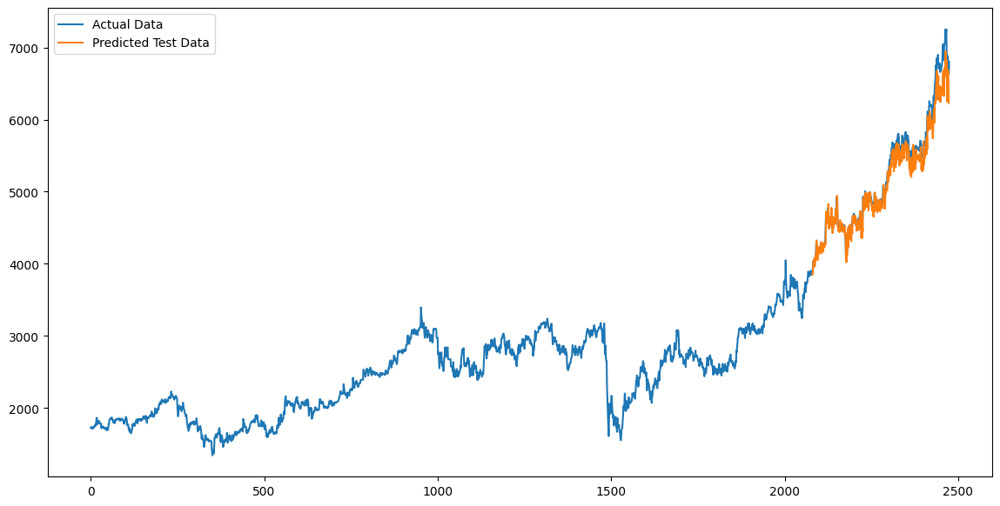

In [ ]:
# Membuat gambar (figure) dengan ukuran 14x7
plt.figure(figsize=(14, 7))
# Membuat plot garis untuk data aktual dengan label 'Actual Data'
plt.plot(bmri_hist3, label='Actual Data')
# Membuat plot garis untuk data prediksi pada dengan label 'Predicted Test Data'
plt.plot(testPredictPlot_bmri_gru, label='Predicted Test Data')
# Menambahkan legenda ke plot berdasarkan label-label yang telah ditentukan sebelumnya
plt.legend()
# Menampilkan plot
plt.show()

In [ ]:
# Fungsi menghitung MAPE
def mean_absolute_percentage_error(y_true, y_pred):
    y_true, y_pred = np.array(y_true), np.array(y_pred)
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100

In [ ]:
# Melihat Metric Evaluation RMSE dan MAPE
mape_gru_l5_bmri = mean_absolute_percentage_error(Y_test_bmri_gru,test_predict_bmri_gru)
print("RMSE of gru:", np.sqrt(mean_squared_error(Y_test_bmri_gru,test_predict_bmri_gru)))
print("MAPE of gru:", mape_gru_l5_bmri)

RMSE of gru: 173.71405137302446
MAPE of gru: 2.2959032604424867


#### Forecasting using Best Model

In [ ]:
# Bank bmri
# Mengonversi kolom 'date' menjadi tipe data datetime
bmri_hist['Date'] = pd.to_datetime(bmri_hist['Date'])
# Mengambil bagian tanggal saja dan mengatur hasilnya sebagai indeks data
bmri_hist.index = bmri_hist['Date'].dt.date

In [ ]:
# Mengambil kolom close
bmri_hist2 = bmri_hist.copy()

In [ ]:
# Train-Test Split
train_size = int(len(bmri_hist2) * 0.80)
test_size = len(bmri_hist2) - train_size
train_data_bmri_gru, test_data_bmri_gru = bmri_hist2[:train_size], bmri_hist2[train_size:]

# Scalling data
# scaler = MinMaxScaler()
# bmri_hist2 = scaler.fit_transform(np.array(bmri_hist2).reshape(-1,1))
# train_data_bmri_gru = scaler.fit_transform(np.array(train_data_bmri_gru).reshape(-1, 1))
# test_data_bmri_gru = scaler.transform(np.array(test_data_bmri_gru).reshape(-1, 1))

In [ ]:
test_data_bmri_gru.head()

,Date,Open,High,Low,Close,Volume,Dividends,Stock Splits
Date,,,,,,,,
2022-03-25,2022-03-25 00:00:00+07:00,3597.954556,3609.268878,3518.754298,3552.697266,136083000,0.0,0.0
2022-03-28,2022-03-28 00:00:00+07:00,3564.011719,3575.326042,3530.068750,3564.011719,95354400,0.0,0.0
2022-03-29,2022-03-29 00:00:00+07:00,3609.269027,3631.897673,3564.011735,3586.640381,160112200,0.0,0.0
2022-03-30,2022-03-30 00:00:00+07:00,3597.954688,3609.269010,3552.697396,3564.011719,82476000,0.0,0.0
2022-03-31,2022-03-31 00:00:00+07:00,3586.640250,3609.268895,3552.697283,3575.325928,69174000,0.0,0.0


DataFrame awal:
                                Date         Open         High          Low  \
Date                                                                          
2022-03-25 2022-03-25 00:00:00+07:00  3597.954556  3609.268878  3518.754298   
2022-03-28 2022-03-28 00:00:00+07:00  3564.011719  3575.326042  3530.068750   
2022-03-29 2022-03-29 00:00:00+07:00  3609.269027  3631.897673  3564.011735   
2022-03-30 2022-03-30 00:00:00+07:00  3597.954688  3609.269010  3552.697396   
2022-03-31 2022-03-31 00:00:00+07:00  3586.640250  3609.268895  3552.697283   

                  Close     Volume  Dividends  Stock Splits  
Date                                                         
2022-03-25  3552.697266  136083000        0.0           0.0  
2022-03-28  3564.011719   95354400        0.0           0.0  
2022-03-29  3586.640381  160112200        0.0           0.0  
2022-03-30  3564.011719   82476000        0.0           0.0  
2022-03-31  3575.325928   69174000        0.0           0.

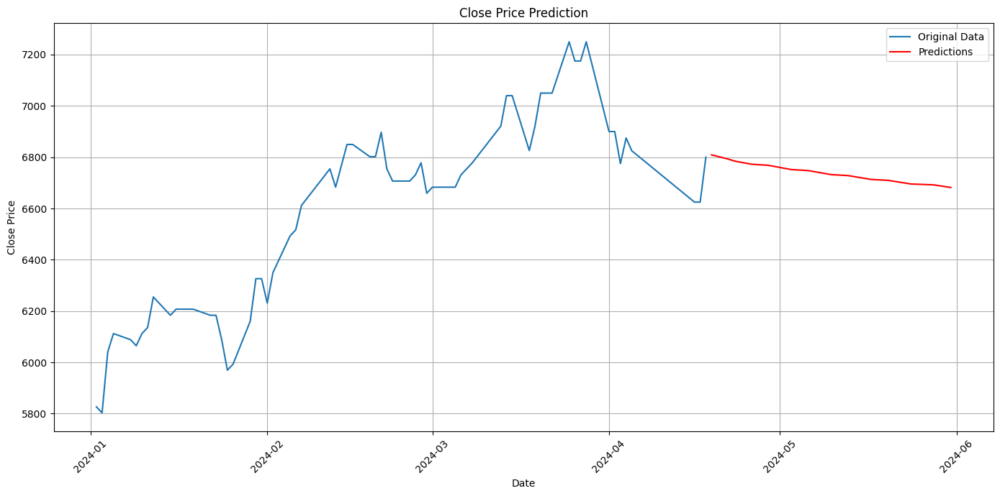

In [ ]:
df = test_data_bmri_gru.copy()

# Menampilkan 5 baris pertama dari DataFrame
print("DataFrame awal:")
print(df.head())

# Menampilkan 5 baris terakhir dari DataFrame
print("\nDataFrame akhir:")
print(df.tail())

# 1. Load model
model = load_model('/content/model_bmri_gru_l4.h5')

# 2. Prepare data (gunakan data dari 100 hari terakhir)
last_n_days = 100  # Menggunakan 100 hari terakhir sesuai kebutuhan model
data_to_predict = df['Close'][-last_n_days:].values

# 3. Scaling data (misalnya menggunakan MinMaxScaler)
scaler = MinMaxScaler(feature_range=(0, 1))
data_to_predict_scaled = scaler.fit_transform(data_to_predict.reshape(-1, 1))

# 4. Reshape data
data_to_predict_scaled = np.reshape(data_to_predict_scaled, (1, last_n_days, 1))

# 5. Predict multiple business days into the future, skipping weekends and holidays
n_days_to_predict = 30
predictions = []

# Get Jakarta (WIB) timezone
wib_timezone = timezone('Asia/Jakarta')

# Get NYSE calendar
nyse = mcal.get_calendar('NYSE')

# Get next business day from the last available date in the dataframe
last_date = df['Date'].iloc[-1].astimezone(wib_timezone)  # Konversi ke zona waktu Jakarta
current_date = last_date

# List to hold predicted dates
predicted_dates = []

for _ in range(n_days_to_predict):
    # Get next business day
    current_date = nyse.valid_days(start_date=current_date + pd.Timedelta(days=1), end_date=current_date + pd.Timedelta(days=30), tz='Asia/Jakarta')[0]

    # Predict only if it's a business day
    if current_date.weekday() < 5:  # Monday=0, Sunday=6
        # Predict
        predicted_scaled = model.predict(data_to_predict_scaled)
        predicted = scaler.inverse_transform(predicted_scaled)

        # Save prediction
        predictions.append(predicted[0][0])

        # Update data_to_predict_scaled for the next prediction
        data_to_predict_scaled = np.append(data_to_predict_scaled[:, 1:, :], np.reshape(predicted_scaled, (1, 1, 1)), axis=1)

        # Save predicted date
        predicted_dates.append(current_date)

# Print the predicted values
print("\nPredicted values for the next business days:")
print(predictions)

# Mendapatkan tanggal terakhir dari data asli
last_date = df['Date'].iloc[-1].astimezone(wib_timezone)  # Konversi ke zona waktu Jakarta

# Membuat DataFrame baru untuk hasil prediksi
prediction_df = pd.DataFrame({'Date': predicted_dates, 'Predicted_Close': predictions})

# Menampilkan DataFrame prediksi
print("\nPrediction DataFrame:")
print(prediction_df)

# Plotting the results
plt.figure(figsize=(14, 7))

# Plot the original data
plt.plot(df[df['Date'] > '2024-01-01']['Date'], df[df['Date'] > '2024-01-01']['Close'], label='Original Data')

# Plot the predictions
plt.plot(prediction_df['Date'], prediction_df['Predicted_Close'], label='Predictions', color='red')

# Formatting the plot
plt.xlabel('Date')
plt.ylabel('Close Price')
plt.title('Close Price Prediction')
plt.legend()
plt.grid(True)
plt.xticks(rotation=45)
plt.tight_layout()

# Display the plot
plt.show()


In [ ]:
prediction_df

,Date,Predicted_Close
0,2024-04-19 00:00:00+07:00,6809.104980
1,2024-04-22 00:00:00+07:00,6792.300781
2,2024-04-23 00:00:00+07:00,6785.185059
3,2024-04-24 00:00:00+07:00,6780.844238
4,2024-04-25 00:00:00+07:00,6776.811035
5,2024-04-26 00:00:00+07:00,6772.648438
6,2024-04-29 00:00:00+07:00,6768.427734
7,2024-04-30 00:00:00+07:00,6764.220703
8,2024-05-01 00:00:00+07:00,6760.054688
9,2024-05-02 00:00:00+07:00,6755.932617


### Bank CIMB Niaga (BNGA)

#### Baseline Model - Best Model

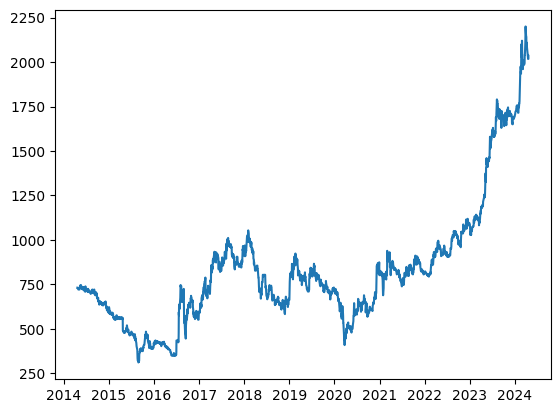

In [ ]:
# Mengambil kolom close
bnga_hist2 = bnga_hist['Close']
plt.plot(bnga_hist2)

In [ ]:
# Train-Test Split
train_size = int(len(bnga_hist2) * 0.80)
test_size = len(bnga_hist2) - train_size
train_data_bnga_gru, test_data_bnga_gru = bnga_hist2[:train_size], bnga_hist2[train_size:]

# Scalling data
scaler = MinMaxScaler()
bnga_hist2 = scaler.fit_transform(np.array(bnga_hist2).reshape(-1,1))
train_data_bnga_gru = scaler.fit_transform(np.array(train_data_bnga_gru).reshape(-1, 1))
test_data_bnga_gru = scaler.transform(np.array(test_data_bnga_gru).reshape(-1, 1))

In [ ]:
def create_dataset(dataset, time_step = 1):
    dataX,dataY = [],[]
    for i in range(len(dataset)-time_step-1):
                   a = dataset[i:(i+time_step),0]
                   dataX.append(a)
                   dataY.append(dataset[i + time_step,0])
    return np.array(dataX),np.array(dataY)

In [ ]:
# Memanggil fungsi create_dataset untuk membagi data menjadi dataset input dan output dataset dengan times step 100
time_step = 100
X_train_bnga_gru,Y_train_bnga_gru =  create_dataset(train_data_bnga_gru,time_step)
X_test_bnga_gru,Y_test_bnga_gru =  create_dataset(test_data_bnga_gru,time_step)

In [ ]:
Y_train_bnga_gru

array([0.51904761, 0.51904761, 0.51904761, ..., 0.80269724, 0.79704107,
       0.79704107])

In [ ]:
# Memeriksa value
print(X_train_bnga_gru.shape)
print(Y_train_bnga_gru.shape)
print(X_test_bnga_gru.shape)
print(Y_test_bnga_gru.shape)

(1878, 100)
(1878,)
(394, 100)
(394,)


In [ ]:
# Tetapkan seed untuk inisialisasi acak
seed_value = 42
tf.random.set_seed(seed_value)
np.random.seed(seed_value)

# Membangun model gru
model_bnga_gru1 = tf.keras.Sequential([
      # Menambahkan layer GRU pertama dengan 50 unit dan pengembalian urutan yang digunakan untuk menjaga urutan output
      # Input_shape adalah bentuk input, yaitu jumlah langkah waktu (X_train.shape[1]) dan fitur (1)
      tf.keras.layers.GRU(50, return_sequences=True, input_shape=(X_train_bnga_gru.shape[1], 1)),
      # Menambahkan layer GRU kedua dengan 50 unit, tidak ada pengembalian urutan karena ini adalah lapisan terakhir GRU
      tf.keras.layers.GRU(50),
      # Menambahkan layer Dense dengan 1 unit sebagai output layer
      tf.keras.layers.Dense(1)
])
# Mengompilasi model dengan loss function 'mean_squared_error' dan optimizer 'adam'
model_bnga_gru1.compile(loss='mean_squared_error', optimizer='adam')

In [ ]:
# Melihat rangkuman model
model_bnga_gru1.summary()

Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 gru_6 (GRU)                 (None, 100, 50)           7950      
                                                                 
 gru_7 (GRU)                 (None, 50)                15300     
                                                                 
 dense_3 (Dense)             (None, 1)                 51        
                                                                 
Total params: 23301 (91.02 KB)
Trainable params: 23301 (91.02 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________


In [ ]:
# Menetapkan seed untuk TensorFlow untuk memastikan hasil yang konsisten dari operasi stokastik (jika ada)
tf.random.set_seed(seed_value)

# Melatih model menggunakan data pelatihan (X_train_bnga dan Y_train_bnga) dengan data validasi (X_test_bnga dan Y_test_bnga)
# Epochs adalah jumlah kali seluruh dataset akan diberikan kepada model selama proses pelatihan
# Batch_size adalah jumlah sampel data yang akan diproses sebelum pembaharuan bobot model
# verbose = 1 menghasilkan output detail pada setiap epoch selama pelatihan
model_bnga_gru1.fit(X_train_bnga_gru, Y_train_bnga_gru, validation_data=(X_test_bnga_gru, Y_test_bnga_gru), epochs=50, batch_size=64, verbose=1)
model_bnga_gru1.save("model_bnga_gru1.h5")

Epoch 1/50
30/30 [==============================] - 12s 136ms/step - loss: 0.0414 - val_loss: 0.1764
Epoch 2/50
30/30 [==============================] - 3s 109ms/step - loss: 0.0034 - val_loss: 0.0328
Epoch 3/50
30/30 [==============================] - 4s 144ms/step - loss: 0.0011 - val_loss: 0.0115
Epoch 4/50
30/30 [==============================] - 5s 173ms/step - loss: 8.8917e-04 - val_loss: 0.0091
Epoch 5/50
30/30 [==============================] - 3s 109ms/step - loss: 8.4630e-04 - val_loss: 0.0069
Epoch 6/50
30/30 [==============================] - 3s 107ms/step - loss: 8.0412e-04 - val_loss: 0.0086
Epoch 7/50
30/30 [==============================] - 4s 150ms/step - loss: 7.6958e-04 - val_loss: 0.0078
Epoch 8/50
30/30 [==============================] - 4s 148ms/step - loss: 7.4107e-04 - val_loss: 0.0083
Epoch 9/50
30/30 [==============================] - 3s 108ms/step - loss: 7.0018e-04 - val_loss: 0.0098
Epoch 10/50
30/30 [==============================] - 3s 109ms/step - loss: 

In [ ]:
# Memprediksi data menggunakan model yang telah dilatih
train_predict_bnga_gru = model_bnga_gru1.predict(X_train_bnga_gru)
test_predict_bnga_gru = model_bnga_gru1.predict(X_test_bnga_gru)

13/13 [==============================] - 1s 56ms/step


In [ ]:
Y_train_bnga_gru[:5]

array([0.51904761, 0.51904761, 0.51904761, 0.51428577, 0.52380961])

In [ ]:
train_predict_bnga_gru[:5]

array([[0.529119  ],
       [0.51995945],
       [0.5188863 ],
       [0.51890785],
       [0.51467407]], dtype=float32)

In [ ]:
# Transformasi data ke bentuk awal
Y_train_bnga_gru = scaler.inverse_transform(Y_train_bnga_gru.reshape(-1, 1))
Y_test_bnga_gru = scaler.inverse_transform(Y_test_bnga_gru.reshape(-1, 1))
train_predict_bnga_gru = scaler.inverse_transform(train_predict_bnga_gru)
test_predict_bnga_gru = scaler.inverse_transform(test_predict_bnga_gru)

In [ ]:
Y_test_bnga_gru[:5]

array([[1041.29138184],
       [1036.72436523],
       [1036.72436523],
       [1027.59020996],
       [1027.59020996]])

In [ ]:
test_predict_bnga_gru[:5]

array([[1035.5817 ],
       [1035.5442 ],
       [1031.0787 ],
       [1030.9913 ],
       [1022.01776]], dtype=float32)

In [ ]:
# Mendefinisikan jumlah langkah waktu sebelumnya yang akan digunakan sebagai input untuk memprediksi langkah waktu saat ini
look_back = 100

# Membuat array kosong dengan ukuran yang sama dengan bnga_hist2
trainPredictPlot_bnga = np.empty_like(bnga_hist2)
# Mengisi array dengan nilai yang sama dengan NaN (untuk plot)
trainPredictPlot_bnga[:,:] = np.nan
# Mengisi bagian dari array dengan hasil prediksi pada data pelatihan
# Menempatkan hasil prediksi pada posisi yang sesuai dalam array untuk plotting
trainPredictPlot_bnga[look_back : len(train_predict_bnga_gru)+look_back,:] = train_predict_bnga_gru

# Membuat array kosong dengan ukuran yang sama dengan bnga_hist2
testPredictPlot_bnga_gru = np.empty_like(bnga_hist2)
# Mengisi array dengan nilai yang sama dengan NaN (untuk plot)
testPredictPlot_bnga_gru[:,:] = np.nan
# Mengisi bagian dari array dengan hasil prediksi pada data uji
# Menempatkan hasil prediksi pada posisi yang sesuai dalam array untuk plotting
testPredictPlot_bnga_gru[len(train_predict_bnga_gru) + (look_back) * 2 + 1 : len(bnga_hist2) - 1, :] = test_predict_bnga_gru

In [ ]:
# Mengambil data harga saham close dan dijadikan dalam bentuk array numpy
bnga_hist3=bnga_hist['Close'].to_numpy()

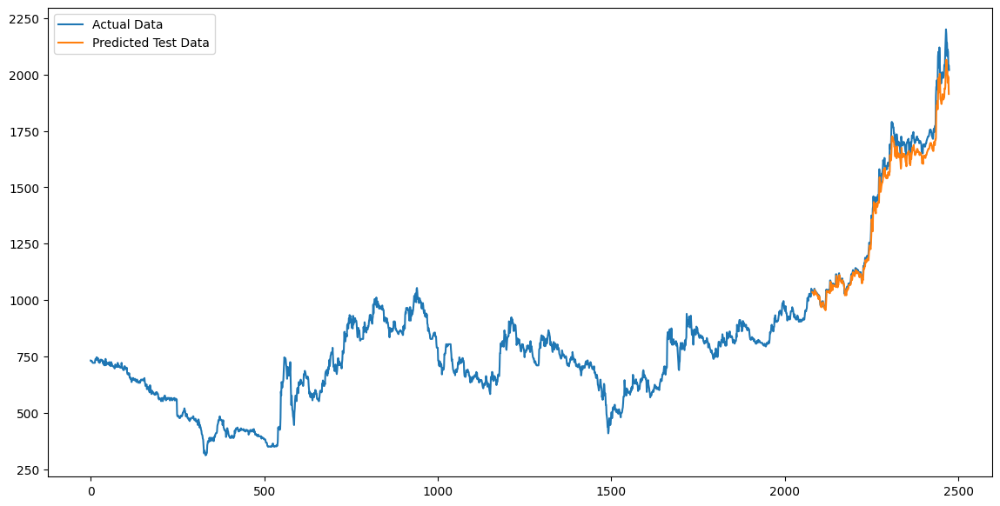

In [ ]:
# Membuat gambar (figure) dengan ukuran 14x7
plt.figure(figsize=(14, 7))
# Membuat plot garis untuk data aktual dengan label 'Actual Data'
plt.plot(bnga_hist3, label='Actual Data')
# Membuat plot garis untuk data prediksi pada dengan label 'Predicted Test Data'
plt.plot(testPredictPlot_bnga_gru, label='Predicted Test Data')
# Menambahkan legenda ke plot berdasarkan label-label yang telah ditentukan sebelumnya
plt.legend()
# Menampilkan plot
plt.show()

In [ ]:
# Fungsi menghitung MAPE
def mean_absolute_percentage_error(y_true, y_pred):
    y_true, y_pred = np.array(y_true), np.array(y_pred)
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100

In [ ]:
# Melihat Metric Evaluation RMSE dan MAPE
mape_gru1_bnga = mean_absolute_percentage_error(Y_test_bnga_gru,test_predict_bnga_gru)
print("RMSE of gru:", np.sqrt(mean_squared_error(Y_test_bnga_gru,test_predict_bnga_gru)))
print("MAPE of gru:", mape_gru1_bnga)

RMSE of gru: 53.456580014414186
MAPE of gru: 2.419101213357724


Error dari baseline cukup kecil, sehingga bisa dikatakan baseline yang telah dibuat cocok dengan dataset. Namun kita akan melakukan tuning untuk mengoptimasi lagi apakah ada model yang memiliki error yang lebih sedikit dibandingkan baseline, sehingga bisa memberikan hasil forecast yang lebih akurat.

#### Hyperparameter Tuning & Optimization Using 5 Layers

Error yang terdapat di Baseline model sudah kecil, namun kita akan mencoba melakukan beberapa tuning dengan layer berbeda untuk mencari model yang lebih baik. Percobaan Tuning ini akan menggunakan model 5 layer.

In [ ]:
# Mengambil kolom close
bnga_hist2 = bnga_hist['Close']

In [ ]:
# Train-Test Split
train_size = int(len(bnga_hist2) * 0.80)
test_size = len(bnga_hist2) - train_size
train_data_bnga_gru, test_data_bnga_gru = bnga_hist2[:train_size], bnga_hist2[train_size:]

# Scalling data
scaler = MinMaxScaler()
bnga_hist2 = scaler.fit_transform(np.array(bnga_hist2).reshape(-1,1))
train_data_bnga_gru = scaler.fit_transform(np.array(train_data_bnga_gru).reshape(-1, 1))
test_data_bnga_gru = scaler.transform(np.array(test_data_bnga_gru).reshape(-1, 1))

In [ ]:
bnga_hist2

array([[0.22276112],
       [0.22276112],
       [0.22088924],
       ...,
       [0.90470383],
       [0.9152923 ],
       [0.90470383]])

In [ ]:
def create_dataset(dataset, time_step = 1):
    dataX,dataY = [],[]
    for i in range(len(dataset)-time_step-1):
                   a = dataset[i:(i+time_step),0]
                   dataX.append(a)
                   dataY.append(dataset[i + time_step,0])
    return np.array(dataX),np.array(dataY)

In [ ]:
# Memanggil fungsi create_dataset untuk membagi data menjadi dataset input dan output dataset dengan times step 100
time_step = 100
X_train_bnga_gru,Y_train_bnga_gru =  create_dataset(train_data_bnga_gru,time_step)
X_test_bnga_gru,Y_test_bnga_gru =  create_dataset(test_data_bnga_gru,time_step)

In [ ]:
Y_train_bnga_gru

array([0.51904761, 0.51904761, 0.51904761, ..., 0.80269724, 0.79704107,
       0.79704107])

In [ ]:
# Memeriksa value
print(X_train_bnga_gru.shape)
print(Y_train_bnga_gru.shape)
print(X_test_bnga_gru.shape)
print(Y_test_bnga_gru.shape)

(1878, 100)
(1878,)
(394, 100)
(394,)


In [ ]:
# Tetapkan seed untuk inisialisasi acak
seed_value = 42
tf.random.set_seed(seed_value)
np.random.seed(seed_value)

# Definisikan fungsi untuk membuat model GRU dengan hyperparameter
def build_model_l5_bnga(hp):
    model = tf.keras.Sequential()
    model.add(tf.keras.layers.GRU(
        units=hp.Int('units_1', min_value=50, max_value=200, step=50),
        return_sequences=True,
        input_shape=(X_train_bnga_gru.shape[1], 1)
    ))
    model.add(tf.keras.layers.GRU(
        units=hp.Int('units_2', min_value=50, max_value=200, step=50),
        return_sequences=True
    ))
    model.add(tf.keras.layers.GRU(
        units=hp.Int('units_3', min_value=50, max_value=200, step=50),
        return_sequences=True
    ))
    model.add(tf.keras.layers.GRU(
        units=hp.Int('units_4', min_value=50, max_value=200, step=50)
    ))
    model.add(tf.keras.layers.Dense(1))

    model.compile(
        optimizer=tf.keras.optimizers.Adam(
            hp.Choice('learning_rate', values=[1e-2, 1e-3, 1e-4])
        ),
        loss='mean_squared_error'
    )
    return model

In [ ]:
# Atur pencarian hyperparameter menggunakan RandomSearch
tuner = RandomSearch(
    build_model_l5_bnga,
    objective='val_loss',
    max_trials=10,  # Jumlah percobaan untuk menemukan kombinasi hyperparameter terbaik
    executions_per_trial=1,  # Jumlah eksekusi per percobaan untuk akurasi lebih baik
    directory='hyperparameter_tuning_l5_bnga',
    project_name='gru_tuning_l5_bnga'
)

# Tentukan data pelatihan dan validasi
tuner.search(X_train_bnga_gru, Y_train_bnga_gru, validation_data=(X_test_bnga_gru, Y_test_bnga_gru), epochs=30, batch_size=64, verbose=1)

# Mendapatkan hasil terbaik
best_hps_l5_bnga = tuner.get_best_hyperparameters(num_trials=1)[0]

# Membangun model dengan hyperparameter terbaik
model_bnga_gru_l5 = build_model_l5_bnga(best_hps_l5_bnga)

Trial 10 Complete [00h 10m 32s]
val_loss: 0.021146168932318687

Best val_loss So Far: 0.0024337952490895987
Total elapsed time: 02h 03m 58s


In [ ]:
print(best_hps_l5_bnga)

In [ ]:
# Melihat rangkuman model
model_bnga_gru_l5.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 gru_4 (GRU)                 (None, 100, 50)           7950      
                                                                 
 gru_5 (GRU)                 (None, 100, 200)          151200    
                                                                 
 gru_6 (GRU)                 (None, 100, 200)          241200    
                                                                 
 gru_7 (GRU)                 (None, 150)               158400    
                                                                 
 dense_1 (Dense)             (None, 1)                 151       
                                                                 
Total params: 558901 (2.13 MB)
Trainable params: 558901 (2.13 MB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________


In [ ]:
# Menetapkan seed untuk TensorFlow untuk memastikan hasil yang konsisten dari operasi stokastik (jika ada)
tf.random.set_seed(seed_value)

# Melatih model menggunakan data pelatihan (X_train_bnga dan Y_train_bnga) dengan data validasi (X_test_bnga dan Y_test_bnga)
# Epochs adalah jumlah kali seluruh dataset akan diberikan kepada model selama proses pelatihan
# Batch_size adalah jumlah sampel data yang akan diproses sebelum pembaharuan bobot model
# verbose = 1 menghasilkan output detail pada setiap epoch selama pelatihan
model_bnga_gru_l5.fit(X_train_bnga_gru, Y_train_bnga_gru, validation_data=(X_test_bnga_gru, Y_test_bnga_gru), epochs=50, batch_size=64, verbose=1)
model_bnga_gru_l5.save("model_bnga_gru_l5.h5")

Epoch 1/50
30/30 [==============================] - 41s 1s/step - loss: 0.0255 - val_loss: 0.0920
Epoch 2/50
30/30 [==============================] - 31s 1s/step - loss: 0.0021 - val_loss: 0.0145
Epoch 3/50
30/30 [==============================] - 31s 1s/step - loss: 0.0013 - val_loss: 0.0152
Epoch 4/50
30/30 [==============================] - 31s 1s/step - loss: 0.0012 - val_loss: 0.0127
Epoch 5/50
30/30 [==============================] - 31s 1s/step - loss: 0.0011 - val_loss: 0.0107
Epoch 6/50
30/30 [==============================] - 31s 1s/step - loss: 0.0011 - val_loss: 0.0055
Epoch 7/50
30/30 [==============================] - 31s 1s/step - loss: 9.7261e-04 - val_loss: 0.0044
Epoch 8/50
30/30 [==============================] - 31s 1s/step - loss: 8.6252e-04 - val_loss: 0.0069
Epoch 9/50
30/30 [==============================] - 31s 1s/step - loss: 7.8052e-04 - val_loss: 0.0070
Epoch 10/50
30/30 [==============================] - 31s 1s/step - loss: 7.2186e-04 - val_loss: 0.0067
Epo

In [ ]:
# Memprediksi data menggunakan model yang telah dilatih
train_predict_bnga_gru = model_bnga_gru_l5.predict(X_train_bnga_gru)
test_predict_bnga_gru = model_bnga_gru_l5.predict(X_test_bnga_gru)

13/13 [==============================] - 3s 274ms/step


In [ ]:
Y_train_bnga_gru[:5]

array([0.51904761, 0.51904761, 0.51904761, 0.51428577, 0.52380961])

In [ ]:
train_predict_bnga_gru[:5]

array([[0.5202212 ],
       [0.51122606],
       [0.511076  ],
       [0.5111985 ],
       [0.5067228 ]], dtype=float32)

In [ ]:
# Transformasi data ke bentuk awal
Y_train_bnga_gru = scaler.inverse_transform(Y_train_bnga_gru.reshape(-1, 1))
Y_test_bnga_gru = scaler.inverse_transform(Y_test_bnga_gru.reshape(-1, 1))
train_predict_bnga_gru = scaler.inverse_transform(train_predict_bnga_gru)
test_predict_bnga_gru = scaler.inverse_transform(test_predict_bnga_gru)

In [ ]:
Y_test_bnga_gru[:5]

array([[1041.29138184],
       [1036.72436523],
       [1036.72436523],
       [1027.59020996],
       [1027.59020996]])

In [ ]:
test_predict_bnga_gru[:5]

array([[1021.7207 ],
       [1021.73975],
       [1016.3314 ],
       [1017.5776 ],
       [1006.6081 ]], dtype=float32)

In [ ]:
# Mendefinisikan jumlah langkah waktu sebelumnya yang akan digunakan sebagai input untuk memprediksi langkah waktu saat ini
look_back = 100

# Membuat array kosong dengan ukuran yang sama dengan bnga_hist2
trainPredictPlot_bnga = np.empty_like(bnga_hist2)
# Mengisi array dengan nilai yang sama dengan NaN (untuk plot)
trainPredictPlot_bnga[:,:] = np.nan
# Mengisi bagian dari array dengan hasil prediksi pada data pelatihan
# Menempatkan hasil prediksi pada posisi yang sesuai dalam array untuk plotting
trainPredictPlot_bnga[look_back : len(train_predict_bnga_gru)+look_back,:] = train_predict_bnga_gru

# Membuat array kosong dengan ukuran yang sama dengan bnga_hist2
testPredictPlot_bnga_gru = np.empty_like(bnga_hist2)
# Mengisi array dengan nilai yang sama dengan NaN (untuk plot)
testPredictPlot_bnga_gru[:,:] = np.nan
# Mengisi bagian dari array dengan hasil prediksi pada data uji
# Menempatkan hasil prediksi pada posisi yang sesuai dalam array untuk plotting
testPredictPlot_bnga_gru[len(train_predict_bnga_gru) + (look_back) * 2 + 1 : len(bnga_hist2) - 1, :] = test_predict_bnga_gru

In [ ]:
# Mengambil data harga saham close dan dijadikan dalam bentuk array numpy
bnga_hist3=bnga_hist['Close'].to_numpy()

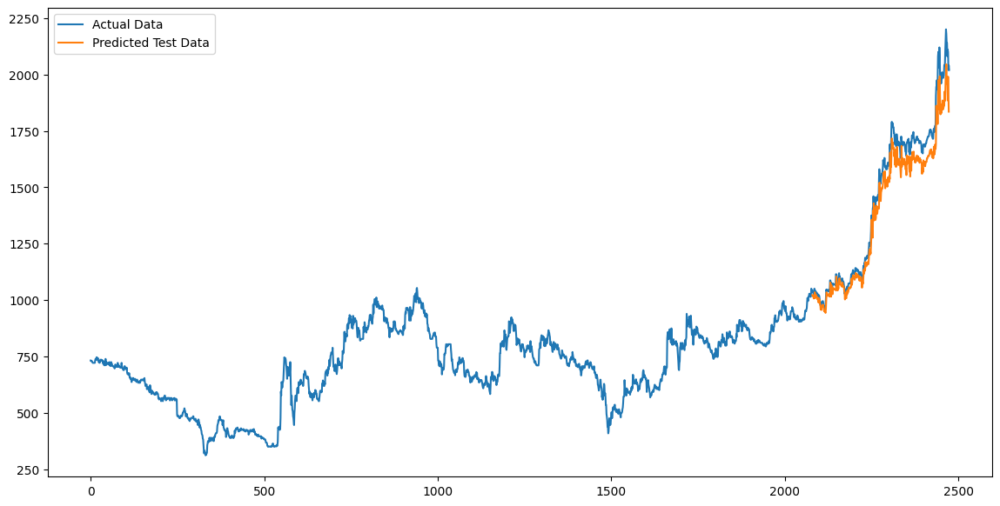

In [ ]:
# Membuat gambar (figure) dengan ukuran 14x7
plt.figure(figsize=(14, 7))
# Membuat plot garis untuk data aktual dengan label 'Actual Data'
plt.plot(bnga_hist3, label='Actual Data')
# Membuat plot garis untuk data prediksi pada dengan label 'Predicted Test Data'
plt.plot(testPredictPlot_bnga_gru, label='Predicted Test Data')
# Menambahkan legenda ke plot berdasarkan label-label yang telah ditentukan sebelumnya
plt.legend()
# Menampilkan plot
plt.show()

In [ ]:
# Fungsi menghitung MAPE
def mean_absolute_percentage_error(y_true, y_pred):
    y_true, y_pred = np.array(y_true), np.array(y_pred)
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100

In [ ]:
# Melihat Metric Evaluation RMSE dan MAPE
mape_gru_l5_bnga = mean_absolute_percentage_error(Y_test_bnga_gru,test_predict_bnga_gru)
print("RMSE of gru:", np.sqrt(mean_squared_error(Y_test_bnga_gru,test_predict_bnga_gru)))
print("MAPE of gru:", mape_gru_l5_bnga)

RMSE of gru: 75.93115006487743
MAPE of gru: 3.8440671986287542


Walaupun Hasil Tuning terbaik adalah layer 5, namun yang memiliki error terkecil saat modelling adalah baseline model. Oleh sebab itu forecast akan dilakukan menggunakan model baseline dengan RMSE sebesar 53.456580014414186 dan
MAPE sebesar 2.419101213357724.

#### Hyperparameter Tuning & Optimization Using 6 Layers - Worst Model

Percobaan Tuning Terburuk dari Bank CIMB Niaga adalah di Hasil Tuning 6 layer.

In [ ]:
# Mengambil kolom close
bnga_hist2 = bnga_hist['Close']

In [ ]:
# Train-Test Split
train_size = int(len(bnga_hist2) * 0.80)
test_size = len(bnga_hist2) - train_size
train_data_bnga_gru, test_data_bnga_gru = bnga_hist2[:train_size], bnga_hist2[train_size:]

# Scalling data
scaler = MinMaxScaler()
bnga_hist2 = scaler.fit_transform(np.array(bnga_hist2).reshape(-1,1))
train_data_bnga_gru = scaler.fit_transform(np.array(train_data_bnga_gru).reshape(-1, 1))
test_data_bnga_gru = scaler.transform(np.array(test_data_bnga_gru).reshape(-1, 1))

In [ ]:
def create_dataset(dataset, time_step = 1):
    dataX,dataY = [],[]
    for i in range(len(dataset)-time_step-1):
                   a = dataset[i:(i+time_step),0]
                   dataX.append(a)
                   dataY.append(dataset[i + time_step,0])
    return np.array(dataX),np.array(dataY)

In [ ]:
# Memanggil fungsi create_dataset untuk membagi data menjadi dataset input dan output dataset dengan times step 100
time_step = 100
X_train_bnga_gru,Y_train_bnga_gru =  create_dataset(train_data_bnga_gru,time_step)
X_test_bnga_gru,Y_test_bnga_gru =  create_dataset(test_data_bnga_gru,time_step)

In [ ]:
Y_train_bnga_gru

array([0.51904761, 0.51904761, 0.51904761, ..., 0.80269724, 0.79704107,
       0.79704107])

In [ ]:
# Memeriksa value
print(X_train_bnga_gru.shape)
print(Y_train_bnga_gru.shape)
print(X_test_bnga_gru.shape)
print(Y_test_bnga_gru.shape)

(1878, 100)
(1878,)
(394, 100)
(394,)


In [ ]:
import tensorflow as tf
from kerastuner import HyperModel, RandomSearch
from kerastuner.engine.hyperparameters import HyperParameters

# Tetapkan seed untuk inisialisasi acak
seed_value = 42
tf.random.set_seed(seed_value)
np.random.seed(seed_value)

# Definisikan fungsi untuk membuat model GRU dengan hyperparameter
def build_model_l6_bnga(hp):
    model = tf.keras.Sequential()
    model.add(tf.keras.layers.GRU(
        units=hp.Int('units_1', min_value=50, max_value=100, step=10),
        return_sequences=True,
        input_shape=(X_train_bnga_gru.shape[1], 1)
    ))
    model.add(tf.keras.layers.GRU(
        units=hp.Int('units_2', min_value=50, max_value=100, step=10),
        return_sequences=True
    ))
    model.add(tf.keras.layers.GRU(
        units=hp.Int('units_3', min_value=50, max_value=100, step=10),
        return_sequences=True
    ))
    model.add(tf.keras.layers.GRU(
        units=hp.Int('units_4', min_value=50, max_value=100, step=10),
        return_sequences=True
    ))
    model.add(tf.keras.layers.GRU(
        units=hp.Int('units_5', min_value=50, max_value=100, step=10)
    ))
    model.add(tf.keras.layers.Dense(1))

    model.compile(
        optimizer=tf.keras.optimizers.Adam(
            hp.Choice('learning_rate', values=[1e-2, 1e-3, 1e-4])
        ),
        loss='mean_squared_error'
    )
    return model

In [ ]:
from kerastuner.tuners import RandomSearch

# Atur pencarian hyperparameter menggunakan RandomSearch
tuner = RandomSearch(
    build_model_l6_bnga,
    objective='val_loss',
    max_trials=10,  # Jumlah percobaan untuk menemukan kombinasi hyperparameter terbaik
    executions_per_trial=1,  # Jumlah eksekusi per percobaan untuk akurasi lebih baik
    directory='hyperparameter_tuning_l6',
    project_name='gru_tuning_l6'
)

# Tentukan data pelatihan dan validasi
tuner.search(X_train_bnga_gru, Y_train_bnga_gru, validation_data=(X_test_bnga_gru, Y_test_bnga_gru), epochs=30, batch_size=66, verbose=1)

# Mendapatkan hasil terbaik
best_hps_l6_bnga = tuner.get_best_hyperparameters(num_trials=1)[0]

# Membangun model dengan hyperparameter terbaik
model_bnga_gru_l6 = build_model_l6_bnga(best_hps_l6_bnga)

Trial 10 Complete [00h 09m 33s]
val_loss: 0.014590579085052013

Best val_loss So Far: 0.009541628882288933
Total elapsed time: 01h 27m 32s


In [ ]:
print(best_hps_l6_bnga)

In [ ]:
# Melihat rangkuman model
model_bnga_gru_l6.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 gru_5 (GRU)                 (None, 100, 80)           19920     
                                                                 
 gru_6 (GRU)                 (None, 100, 70)           31920     
                                                                 
 gru_7 (GRU)                 (None, 100, 90)           43740     
                                                                 
 gru_8 (GRU)                 (None, 100, 80)           41280     
                                                                 
 gru_9 (GRU)                 (None, 50)                19800     
                                                                 
 dense_1 (Dense)             (None, 1)                 51        
                                                                 
Total params: 156711 (612.15 KB)
Trainable params: 156

In [ ]:
# Menetapkan seed untuk TensorFlow untuk memastikan hasil yang konsisten dari operasi stokastik (jika ada)
tf.random.set_seed(seed_value)

# Melatih model menggunakan data pelatihan (X_train_bnga dan Y_train_bnga) dengan data validasi (X_test_bnga dan Y_test_bnga)
# Epochs adalah jumlah kali seluruh dataset akan diberikan kepada model selama proses pelatihan
# Batch_size adalah jumlah sampel data yang akan diproses sebelum pembaharuan bobot model
# verbose = 1 menghasilkan output detail pada setiap epoch selama pelatihan
model_bnga_gru_l6.fit(X_train_bnga_gru, Y_train_bnga_gru, validation_data=(X_test_bnga_gru, Y_test_bnga_gru), epochs=50, batch_size=64, verbose=1)
model_bnga_gru_l6.save("model_bnga_gru_l6.h5")

Epoch 1/50
30/30 [==============================] - 30s 766ms/step - loss: 0.0050 - val_loss: 0.0573
Epoch 2/50
30/30 [==============================] - 15s 512ms/step - loss: 0.0021 - val_loss: 0.0547
Epoch 3/50
30/30 [==============================] - 15s 508ms/step - loss: 0.0017 - val_loss: 0.0479
Epoch 4/50
30/30 [==============================] - 15s 513ms/step - loss: 0.0015 - val_loss: 0.0441
Epoch 5/50
30/30 [==============================] - 15s 512ms/step - loss: 0.0014 - val_loss: 0.0341
Epoch 6/50
30/30 [==============================] - 16s 533ms/step - loss: 0.0014 - val_loss: 0.0296
Epoch 7/50
30/30 [==============================] - 16s 524ms/step - loss: 0.0012 - val_loss: 0.0279
Epoch 8/50
30/30 [==============================] - 16s 545ms/step - loss: 0.0011 - val_loss: 0.0313
Epoch 9/50
30/30 [==============================] - 16s 543ms/step - loss: 9.3308e-04 - val_loss: 0.0274
Epoch 10/50
30/30 [==============================] - 15s 519ms/step - loss: 8.4675e-04 

In [ ]:
# Memprediksi data menggunakan model yang telah dilatih
train_predict_bnga_gru = model_bnga_gru_l6.predict(X_train_bnga_gru)
test_predict_bnga_gru = model_bnga_gru_l6.predict(X_test_bnga_gru)

13/13 [==============================] - 1s 75ms/step


In [ ]:
Y_train_bnga_gru[:5]

array([0.51904761, 0.51904761, 0.51904761, 0.51428577, 0.52380961])

In [ ]:
train_predict_bnga_gru[:5]

array([[0.5207069],
       [0.511733 ],
       [0.5115053],
       [0.511628 ],
       [0.5071903]], dtype=float32)

In [ ]:
# Transformasi data ke bentuk awal
Y_train_bnga_gru = scaler.inverse_transform(Y_train_bnga_gru.reshape(-1, 1))
Y_test_bnga_gru = scaler.inverse_transform(Y_test_bnga_gru.reshape(-1, 1))
train_predict_bnga_gru = scaler.inverse_transform(train_predict_bnga_gru)
test_predict_bnga_gru = scaler.inverse_transform(test_predict_bnga_gru)

In [ ]:
Y_test_bnga_gru[:5]

array([[1041.29138184],
       [1036.72436523],
       [1036.72436523],
       [1027.59020996],
       [1027.59020996]])

In [ ]:
test_predict_bnga_gru[:5]

array([[1019.5288 ],
       [1019.44006],
       [1014.14923],
       [1015.3598 ],
       [1004.4324 ]], dtype=float32)

In [ ]:
# Mendefinisikan jumlah langkah waktu sebelumnya yang akan digunakan sebagai input untuk memprediksi langkah waktu saat ini
look_back = 100

# Membuat array kosong dengan ukuran yang sama dengan bnga_hist2
trainPredictPlot_bnga = np.empty_like(bnga_hist2)
# Mengisi array dengan nilai yang sama dengan NaN (untuk plot)
trainPredictPlot_bnga[:,:] = np.nan
# Mengisi bagian dari array dengan hasil prediksi pada data pelatihan
# Menempatkan hasil prediksi pada posisi yang sesuai dalam array untuk plotting
trainPredictPlot_bnga[look_back : len(train_predict_bnga_gru)+look_back,:] = train_predict_bnga_gru

# Membuat array kosong dengan ukuran yang sama dengan bbri_hist2
testPredictPlot_bnga_gru = np.empty_like(bnga_hist2)
# Mengisi array dengan nilai yang sama dengan NaN (untuk plot)
testPredictPlot_bnga_gru[:,:] = np.nan
# Mengisi bagian dari array dengan hasil prediksi pada data uji
# Menempatkan hasil prediksi pada posisi yang sesuai dalam array untuk plotting
testPredictPlot_bnga_gru[len(train_predict_bnga_gru) + (look_back) * 2 + 1 : len(bnga_hist2) - 1, :] = test_predict_bnga_gru

In [ ]:
# Mengambil data harga saham close dan dijadikan dalam bentuk array numpy
bnga_hist3=bnga_hist['Close'].to_numpy()

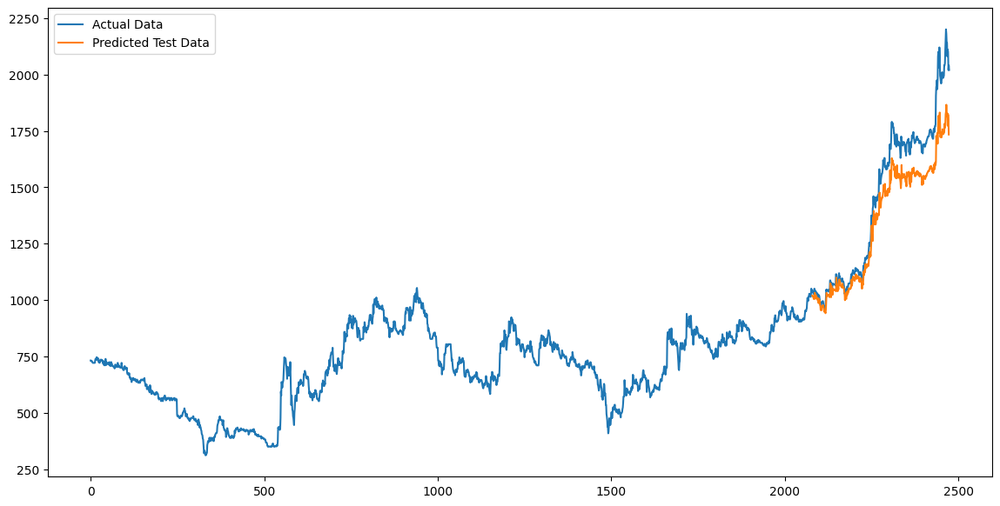

In [ ]:
# Membuat gambar (figure) dengan ukuran 14x7
plt.figure(figsize=(14, 7))
# Membuat plot garis untuk data aktual dengan label 'Actual Data'
plt.plot(bnga_hist3, label='Actual Data')
# Membuat plot garis untuk data prediksi pada dengan label 'Predicted Test Data'
plt.plot(testPredictPlot_bnga_gru, label='Predicted Test Data')
# Menambahkan legenda ke plot berdasarkan label-label yang telah ditentukan sebelumnya
plt.legend()
# Menampilkan plot
plt.show()

In [ ]:
# Fungsi menghitung MAPE
def mean_absolute_percentage_error(y_true, y_pred):
    y_true, y_pred = np.array(y_true), np.array(y_pred)
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100

In [ ]:
# Melihat Metric Evaluation RMSE dan MAPE
mape_gru_l6_bnga = mean_absolute_percentage_error(Y_test_bnga_gru,test_predict_bnga_gru)
print("RMSE of GRU:", np.sqrt(mean_squared_error(Y_test_bnga_gru,test_predict_bnga_gru)))
print("MAPE of GRU:", mape_gru_l6_bnga)

RMSE of GRU: 129.75856350356253
MAPE of GRU: 6.188850475394663


Dapat dilihat bahwa hasil tuning 6 layer memberikan nilai error yang lebih besar, sehingga model ini tidak akan digunakan.

#### Forecasting using Best Model

Setelah melakukan beberapa tuning dan optimasi, **tidak diperoleh model yang lebih baik dari baseline model.** Oleh karena itu baseline model akan digunakan untuk memprediksi harga saham 30 hari ke depan di Bank CIMB Niaga.

In [ ]:
# Mengambil kolom close
bnga_hist2 = bnga_hist

In [ ]:
# Train-Test Split
train_size = int(len(bnga_hist2) * 0.80)
test_size = len(bnga_hist2) - train_size
train_data_bnga_gru, test_data_bnga_gru = bnga_hist2[:train_size], bnga_hist2[train_size:]

In [ ]:
test_data_bnga_gru.head()

,Date,Open,High,Low,Close,Volume,Dividends,Stock Splits,Average
Date,,,,,,,,,
2022-03-25,2022-03-25 00:00:00+07:00,907.171387,915.571122,902.971519,907.171387,6579700,0.0,0.0,908.571343
2022-03-28,2022-03-28 00:00:00+07:00,907.171387,915.571122,902.971519,907.171387,8019800,0.0,0.0,908.571343
2022-03-29,2022-03-29 00:00:00+07:00,907.171371,923.970841,907.171371,915.571106,9002500,0.0,0.0,915.571106
2022-03-30,2022-03-30 00:00:00+07:00,923.970848,928.170715,911.371245,928.170715,9948500,0.0,0.0,922.570892
2022-03-31,2022-03-31 00:00:00+07:00,923.970832,944.970169,919.770965,936.570435,12768200,0.0,0.0,933.770523


In [ ]:
# Data yang digunakan untuk prediksi adalah data test (data terbaru)
df_bnga = test_data_bnga_gru.copy()

# Menampilkan 5 baris pertama dari Dataframe
print("DataFrame awal:")
print(df_bnga.head())

# Menampilkan 5 baris terakhir dari Dataframe
print("\nDataFrame akhir:")
print(df_bnga.tail())

# 1. Load model
model_bnga = load_model('/content/drive/MyDrive/Dataset_Bank/model_bnga_gru1.h5')

# 2. Prepare data (gunakan data dari 100 hari terakhir)
last_n_days = 100  # Menggunakan 100 hari terakhir sesuai kebutuhan model
data_to_predict_bnga = bnga_hist['Close'][-last_n_days:].values

# 3. Scaling data (misalnya menggunakan MinMaxScaler)
scaler = MinMaxScaler(feature_range=(0, 1))
data_to_predict_scaled = scaler.fit_transform(data_to_predict_bnga.reshape(-1, 1))

# 4. Reshape data
data_to_predict_bnga_scaled = np.reshape(data_to_predict_scaled, (1, last_n_days, 1))

# 5. Predict multiple days into the future
n_days_to_predict = 30
predictions_bnga = []

for i in range(n_days_to_predict):
    # Predict
    predicted_scaled_bnga = model_bnga.predict(data_to_predict_bnga_scaled)
    predicted_bnga = scaler.inverse_transform(predicted_scaled_bnga)

    # Save prediction
    predictions_bnga.append(predicted_bnga[0][0])

    # Update data_to_predict_scaled for the next prediction
    data_to_predict_bnga_scaled = np.append(data_to_predict_bnga_scaled[:, 1:, :], np.reshape(predicted_scaled_bnga, (1, 1, 1)), axis=1)

# Print the predicted values
print("\nPredicted values for the next days:")
print(predictions_bnga)

# Mendapatkan tanggal terakhir dari data asli
last_date = bnga_hist.index[-1]

# Membuat rangkaian tanggal hari kerja untuk hasil prediksi
prediction_dates = pd.date_range(start=last_date + pd.Timedelta(days=1), periods=n_days_to_predict, freq='B')

# Membuat DataFrame baru untuk hasil prediksi
prediction_df_bnga = pd.DataFrame({'Date': prediction_dates, 'Predicted_Close': predictions_bnga})

# Menampilkan DataFrame prediksi
print("\nPrediction DataFrame:")
print(prediction_df_bnga)

DataFrame awal:
                                Date        Open        High         Low  \
Date                                                                       
2022-03-25 2022-03-25 00:00:00+07:00  907.171387  915.571122  902.971519   
2022-03-28 2022-03-28 00:00:00+07:00  907.171387  915.571122  902.971519   
2022-03-29 2022-03-29 00:00:00+07:00  907.171371  923.970841  907.171371   
2022-03-30 2022-03-30 00:00:00+07:00  923.970848  928.170715  911.371245   
2022-03-31 2022-03-31 00:00:00+07:00  923.970832  944.970169  919.770965   

                 Close    Volume  Dividends  Stock Splits  
Date                                                       
2022-03-25  907.171387   6579700        0.0           0.0  
2022-03-28  907.171387   8019800        0.0           0.0  
2022-03-29  915.571106   9002500        0.0           0.0  
2022-03-30  928.170715   9948500        0.0           0.0  
2022-03-31  936.570435  12768200        0.0           0.0  

DataFrame akhir:
             

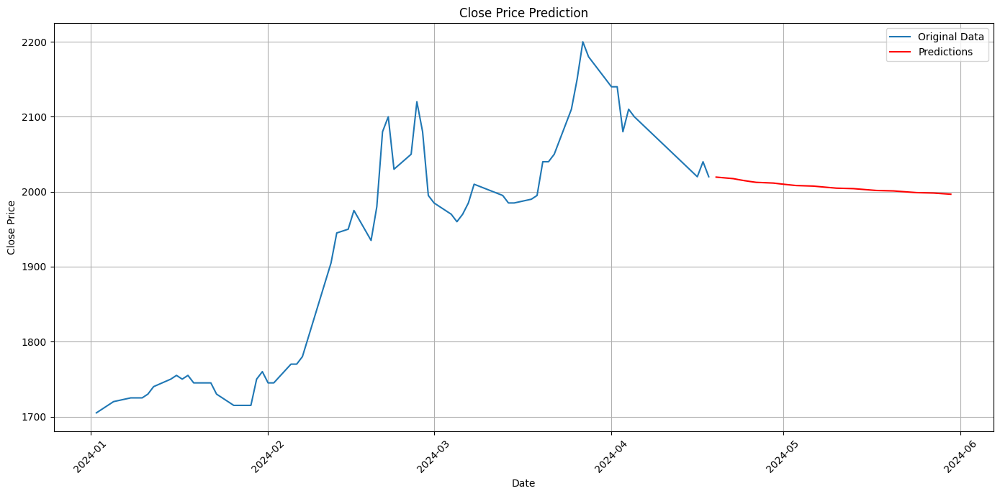

In [ ]:
# Plotting the results
plt.figure(figsize=(14, 7))
# Plot the original data
plt.plot(bnga_hist[bnga_hist['Date'] > '2024-01-01']['Date'], bnga_hist[bnga_hist['Date'] > '2024-01-01']['Close'], label='Original Data')
# Plot the predictions
plt.plot(prediction_df_bnga['Date'], prediction_df_bnga['Predicted_Close'], label='Predictions', color='red')
# Formatting the plot
plt.xlabel('Date')
plt.ylabel('Close Price')
plt.title('Close Price Prediction')
plt.legend()
plt.grid(True)
plt.xticks(rotation=45)
plt.tight_layout()
# Display the plot
plt.show()

Dapat diamati bahwa berdasarkan Hasil prediksi **harga saham Bank CIMB Niaga selama 30 hari kedepan akan mengalami penurunan harga saham.** Prediksi dilakukan dengan model terbaik yakni menggunakan Baseline Model. Dimana Baseline Model memiliki RMSE dan MAPE terkecil yakni 53.4566 untuk RMSE dan untuk MAPE sebesar 2.4191.

### Bank Syariah Indonesia (BRIS)

#### Baseline Model

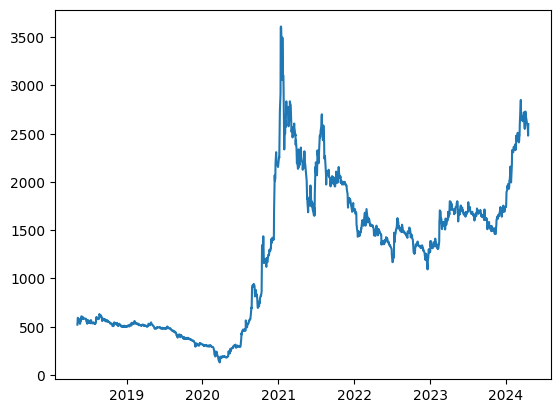

In [ ]:
# Mengambil kolom close
bris_hist2 = bris_hist['Close']
plt.plot(bris_hist2)

In [ ]:
# Train-Test Split
train_size = int(len(bris_hist2) * 0.80)
test_size = len(bris_hist2) - train_size
train_data_bris_gru, test_data_bris_gru = bris_hist2[:train_size], bris_hist2[train_size:]

# Scalling data
scaler = MinMaxScaler()
bris_hist2 = scaler.fit_transform(np.array(bris_hist2).reshape(-1,1))
train_data_bris_gru = scaler.fit_transform(np.array(train_data_bris_gru).reshape(-1, 1))
test_data_bris_gru = scaler.transform(np.array(test_data_bris_gru).reshape(-1, 1))

In [ ]:
def create_dataset(dataset, time_step = 1):
    dataX,dataY = [],[]
    for i in range(len(dataset)-time_step-1):
                   a = dataset[i:(i+time_step),0]
                   dataX.append(a)
                   dataY.append(dataset[i + time_step,0])
    return np.array(dataX),np.array(dataY)

In [ ]:
# Memanggil fungsi create_dataset untuk membagi data menjadi dataset input dan output dataset dengan times step 100
time_step = 100
X_train_bris_gru,Y_train_bris_gru =  create_dataset(train_data_bris_gru,time_step)
X_test_bris_gru,Y_test_bris_gru =  create_dataset(test_data_bris_gru,time_step)

In [ ]:
Y_train_bris_gru

array([0.12346639, 0.12621179, 0.12483908, ..., 0.34422955, 0.34280119,
       0.3399445 ])

In [ ]:
# Memeriksa value
print(X_train_bris_gru.shape)
print(Y_train_bris_gru.shape)
print(X_test_bris_gru.shape)
print(Y_test_bris_gru.shape)

(1071, 100)
(1071,)
(193, 100)
(193,)


In [ ]:
# Tetapkan seed untuk inisialisasi acak
seed_value = 42
tf.random.set_seed(seed_value)
np.random.seed(seed_value)


# Membangun model gru
model_bris_gru1 = tf.keras.Sequential([
      # Menambahkan layer GRU pertama dengan 50 unit dan pengembalian urutan yang digunakan untuk menjaga urutan output
      # Input_shape adalah bentuk input, yaitu jumlah langkah waktu (X_train.shape[1]) dan fitur (1)
      tf.keras.layers.GRU(50, return_sequences=True, input_shape=(X_train_bris_gru.shape[1], 1)),
      # Menambahkan layer GRU kedua dengan 50 unit, tidak ada pengembalian urutan karena ini adalah lapisan terakhir GRU
      tf.keras.layers.GRU(50),
      # Menambahkan layer Dense dengan 1 unit sebagai output layer
      tf.keras.layers.Dense(1)
])
# Mengompilasi model dengan loss function 'mean_squared_error' dan optimizer 'adam'
model_bris_gru1.compile(loss='mean_squared_error', optimizer='adam')

In [ ]:
# Melihat rangkuman model
model_bris_gru1.summary()

Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 gru_4 (GRU)                 (None, 100, 50)           7950      
                                                                 
 gru_5 (GRU)                 (None, 50)                15300     
                                                                 
 dense_2 (Dense)             (None, 1)                 51        
                                                                 
Total params: 23301 (91.02 KB)
Trainable params: 23301 (91.02 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________


In [ ]:
# Menetapkan seed untuk TensorFlow untuk memastikan hasil yang konsisten dari operasi stokastik (jika ada)
tf.random.set_seed(seed_value)

# Melatih model menggunakan data pelatihan (X_train_bris dan Y_train_bris) dengan data validasi (X_test_bris dan Y_test_bris)
# Epochs adalah jumlah kali seluruh dataset akan diberikan kepada model selama proses pelatihan
# Batch_size adalah jumlah sampel data yang akan diproses sebelum pembaharuan bobot model
# verbose = 1 menghasilkan output detail pada setiap epoch selama pelatihan
model_bris_gru1.fit(X_train_bris_gru, Y_train_bris_gru, validation_data=(X_test_bris_gru, Y_test_bris_gru), epochs=50, batch_size=64, verbose=1)
model_bris_gru1.save("model_bris_gru1.h5")

Epoch 1/50
17/17 [==============================] - 10s 232ms/step - loss: 0.0321 - val_loss: 0.0026
Epoch 2/50
17/17 [==============================] - 2s 108ms/step - loss: 0.0042 - val_loss: 9.2384e-04
Epoch 3/50
17/17 [==============================] - 2s 109ms/step - loss: 0.0011 - val_loss: 3.6150e-04
Epoch 4/50
17/17 [==============================] - 2s 108ms/step - loss: 8.2151e-04 - val_loss: 3.1745e-04
Epoch 5/50
17/17 [==============================] - 2s 108ms/step - loss: 7.1385e-04 - val_loss: 3.3320e-04
Epoch 6/50
17/17 [==============================] - 2s 116ms/step - loss: 6.6370e-04 - val_loss: 3.0862e-04
Epoch 7/50
17/17 [==============================] - 3s 181ms/step - loss: 6.4219e-04 - val_loss: 3.5968e-04
Epoch 8/50
17/17 [==============================] - 3s 172ms/step - loss: 6.1460e-04 - val_loss: 2.7652e-04
Epoch 9/50
17/17 [==============================] - 2s 108ms/step - loss: 6.0495e-04 - val_loss: 2.7403e-04
Epoch 10/50
17/17 [========================

In [ ]:
# Memprediksi data menggunakan model yang telah dilatih
train_predict_bris_gru = model_bris_gru1.predict(X_train_bris_gru)
test_predict_bris_gru = model_bris_gru1.predict(X_test_bris_gru)

7/7 [==============================] - 0s 21ms/step


In [ ]:
Y_train_bris_gru[:5]

array([0.12346639, 0.12621179, 0.12483908, 0.1220937 , 0.12346639])

In [ ]:
train_predict_bris_gru[:5]

array([[0.11634769],
       [0.11696962],
       [0.11889251],
       [0.11940738],
       [0.11799643]], dtype=float32)

In [ ]:
# Transformasi data ke bentuk awal
Y_train_bris_gru = scaler.inverse_transform(Y_train_bris_gru.reshape(-1, 1))
Y_test_bris_gru = scaler.inverse_transform(Y_test_bris_gru.reshape(-1, 1))
train_predict_bris_gru = scaler.inverse_transform(train_predict_bris_gru)
test_predict_bris_gru = scaler.inverse_transform(test_predict_bris_gru)

In [ ]:
Y_test_bris_gru[:5]

array([[1680.],
       [1665.],
       [1690.],
       [1690.],
       [1790.]])

In [ ]:
test_predict_bris_gru[:5]

array([[1630.8412],
       [1641.472 ],
       [1631.3999],
       [1641.2358],
       [1647.747 ]], dtype=float32)

In [ ]:
# Mendefinisikan jumlah langkah waktu sebelumnya yang akan digunakan sebagai input untuk memprediksi langkah waktu saat ini
look_back = 100

# Membuat array kosong dengan ukuran yang sama dengan bris_hist2
trainPredictPlot_bris = np.empty_like(bris_hist2)
# Mengisi array dengan nilai yang sama dengan NaN (untuk plot)
trainPredictPlot_bris[:,:] = np.nan
# Mengisi bagian dari array dengan hasil prediksi pada data pelatihan
# Menempatkan hasil prediksi pada posisi yang sesuai dalam array untuk plotting
trainPredictPlot_bris[look_back : len(train_predict_bris_gru)+look_back,:] = train_predict_bris_gru

# Membuat array kosong dengan ukuran yang sama dengan bris_hist2
testPredictPlot_bris_gru = np.empty_like(bris_hist2)
# Mengisi array dengan nilai yang sama dengan NaN (untuk plot)
testPredictPlot_bris_gru[:,:] = np.nan
# Mengisi bagian dari array dengan hasil prediksi pada data uji
# Menempatkan hasil prediksi pada posisi yang sesuai dalam array untuk plotting
testPredictPlot_bris_gru[len(train_predict_bris_gru) + (look_back) * 2 + 1 : len(bris_hist2) - 1, :] = test_predict_bris_gru

In [ ]:
# Mengambil data harga saham close dan dijadikan dalam bentuk array numpy
bris_hist3=bris_hist['Close'].to_numpy()

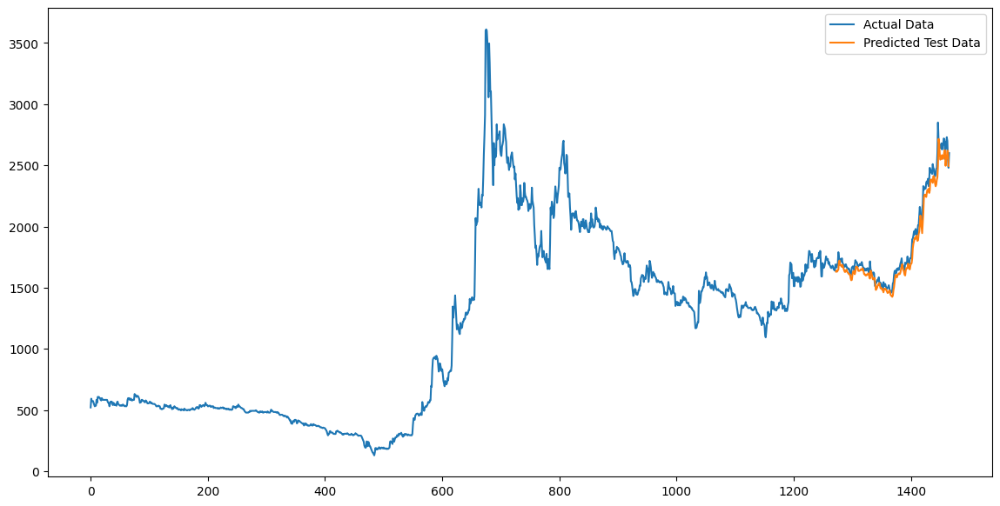

In [ ]:
# Membuat gambar (figure) dengan ukuran 14x7
plt.figure(figsize=(14, 7))
# Membuat plot garis untuk data aktual dengan label 'Actual Data'
plt.plot(bris_hist3, label='Actual Data')
# Membuat plot garis untuk data prediksi pada dengan label 'Predicted Test Data'
plt.plot(testPredictPlot_bris_gru, label='Predicted Test Data')
# Menambahkan legenda ke plot berdasarkan label-label yang telah ditentukan sebelumnya
plt.legend()
# Menampilkan plot
plt.show()

In [ ]:
# Fungsi menghitung MAPE
def mean_absolute_percentage_error(y_true, y_pred):
    y_true, y_pred = np.array(y_true), np.array(y_pred)
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100

In [ ]:
# Melihat Metric Evaluation RMSE dan MAPE
mape_gru1_bris = mean_absolute_percentage_error(Y_test_bris_gru,test_predict_bris_gru)
print("RMSE of gru:", np.sqrt(mean_squared_error(Y_test_bris_gru,test_predict_bris_gru)))
print("MAPE of gru:", mape_gru1_bris)

RMSE of gru: 75.16064078516426
MAPE of gru: 3.0013934278721606


Error dari baseline cukup kecil, sehingga bisa dikatakan baseline yang telah dibuat cocok dengan dataset. Namun kita akan melakukan tuning untuk mengoptimasi lagi apakah ada model yang memiliki error yang lebih sedikit dibandingkan baseline, sehingga bisa memberikan hasil forecast yang lebih akurat.

#### Hyperparameter Tuning & Optimization Using 4 Layers - Best Model


Percobaan Tuning Terbaik dari Bank BSI Syariah adalah di Hasil Tuning 4 layer.

In [ ]:
# Mengambil kolom close
bris_hist2 = bris_hist['Close']

In [ ]:
# Train-Test Split
train_size = int(len(bris_hist2) * 0.80)
test_size = len(bris_hist2) - train_size
train_data_bris_gru, test_data_bris_gru = bris_hist2[:train_size], bris_hist2[train_size:]

# Scalling data
scaler = MinMaxScaler()
bris_hist2 = scaler.fit_transform(np.array(bris_hist2).reshape(-1,1))
train_data_bris_gru = scaler.fit_transform(np.array(train_data_bris_gru).reshape(-1, 1))
test_data_bris_gru = scaler.transform(np.array(test_data_bris_gru).reshape(-1, 1))

In [ ]:
def create_dataset(dataset, time_step = 1):
    dataX,dataY = [],[]
    for i in range(len(dataset)-time_step-1):
                   a = dataset[i:(i+time_step),0]
                   dataX.append(a)
                   dataY.append(dataset[i + time_step,0])
    return np.array(dataX),np.array(dataY)

In [ ]:
# Memanggil fungsi create_dataset untuk membagi data menjadi dataset input dan output dataset dengan times step 100
time_step = 100
X_train_bris_gru,Y_train_bris_gru =  create_dataset(train_data_bris_gru,time_step)
X_test_bris_gru,Y_test_bris_gru =  create_dataset(test_data_bris_gru,time_step)

In [ ]:
Y_train_bris_gru

array([0.12346639, 0.12621179, 0.12483908, ..., 0.34422955, 0.34280119,
       0.3399445 ])

In [ ]:
# Memeriksa value
print(X_train_bris_gru.shape)
print(Y_train_bris_gru.shape)
print(X_test_bris_gru.shape)
print(Y_test_bris_gru.shape)

(1071, 100)
(1071,)
(193, 100)
(193,)


In [ ]:
# Tetapkan seed untuk inisialisasi acak
seed_value = 42
tf.random.set_seed(seed_value)
np.random.seed(seed_value)

# Definisikan fungsi untuk membuat model GRU dengan hyperparameter
def build_model_l4_bris(hp):
    model = tf.keras.Sequential()
    model.add(tf.keras.layers.GRU(
        units=hp.Int('units_1', min_value=50, max_value=200, step=50),
        return_sequences=True,
        input_shape=(X_train_bris_gru.shape[1], 1)
    ))
    model.add(tf.keras.layers.GRU(
        units=hp.Int('units_2', min_value=50, max_value=200, step=50),
        return_sequences=True
    ))
    model.add(tf.keras.layers.GRU(
        units=hp.Int('units_3', min_value=50, max_value=200, step=50)
    ))
    model.add(tf.keras.layers.Dense(1))

    model.compile(
        optimizer=tf.keras.optimizers.Adam(
            hp.Choice('learning_rate', values=[1e-2, 1e-3, 1e-4])
        ),
        loss='mean_squared_error'
    )
    return model


In [ ]:
# Atur pencarian hyperparameter menggunakan RandomSearch
tuner = RandomSearch(
    build_model_l4_bris,
    objective='val_loss',
    max_trials=10,  # Jumlah percobaan untuk menemukan kombinasi hyperparameter terbaik
    executions_per_trial=1,  # Jumlah eksekusi per percobaan untuk akurasi lebih baik
    directory='hyperparameter_tuning_l4_bris',
    project_name='gru_tuning_l4_bris'
)

# Tentukan data pelatihan dan validasi
tuner.search(X_train_bris_gru, Y_train_bris_gru, validation_data=(X_test_bris_gru, Y_test_bris_gru), epochs=30, batch_size=64, verbose=1)

# Mendapatkan hasil terbaik
best_hps_l4_bris = tuner.get_best_hyperparameters(num_trials=1)[0]

# Membangun model dengan hyperparameter terbaik
model_bris_gru_l4 = build_model_l4_bris(best_hps_l4_bris)

Trial 10 Complete [00h 06m 19s]
val_loss: 0.00027671532006934285

Best val_loss So Far: 0.00017703953199088573
Total elapsed time: 01h 02m 37s


In [ ]:
print(best_hps_l4_bris)

In [ ]:
# Melihat rangkuman model
model_bris_gru_l4.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 gru_3 (GRU)                 (None, 100, 200)          121800    
                                                                 
 gru_4 (GRU)                 (None, 100, 100)          90600     
                                                                 
 gru_5 (GRU)                 (None, 150)               113400    
                                                                 
 dense_1 (Dense)             (None, 1)                 151       
                                                                 
Total params: 325951 (1.24 MB)
Trainable params: 325951 (1.24 MB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________


In [ ]:
# Menetapkan seed untuk TensorFlow untuk memastikan hasil yang konsisten dari operasi stokastik (jika ada)
tf.random.set_seed(seed_value)

model_bris_gru_l4 = load_model('/content/model_bris_gru_l4.h5')

# Melatih model menggunakan data pelatihan (X_train_bris dan Y_train_bris) dengan data validasi (X_test_bris dan Y_test_bris)
# Epochs adalah jumlah kali seluruh dataset akan diberikan kepada model selama proses pelatihan
# Batch_size adalah jumlah sampel data yang akan diproses sebelum pembaharuan bobot model
# verbose = 1 menghasilkan output detail pada setiap epoch selama pelatihan
model_bris_gru_l4.fit(X_train_bris_gru, Y_train_bris_gru, validation_data=(X_test_bris_gru, Y_test_bris_gru), epochs=50, batch_size=64, verbose=1)
# model_bris_gru_l4.save("model_bris_gru_l4.h5")

Epoch 1/50
17/17 [==============================] - 17s 805ms/step - loss: 4.5179e-04 - val_loss: 3.4944e-04
Epoch 2/50
17/17 [==============================] - 12s 711ms/step - loss: 4.4509e-04 - val_loss: 2.3151e-04
Epoch 3/50
17/17 [==============================] - 12s 717ms/step - loss: 3.8396e-04 - val_loss: 6.7366e-04
Epoch 4/50
17/17 [==============================] - 9s 555ms/step - loss: 7.3891e-04 - val_loss: 6.5717e-04
Epoch 5/50
17/17 [==============================] - 12s 699ms/step - loss: 5.8860e-04 - val_loss: 2.7515e-04
Epoch 6/50
17/17 [==============================] - 13s 756ms/step - loss: 4.1325e-04 - val_loss: 2.5655e-04
Epoch 7/50
17/17 [==============================] - 12s 716ms/step - loss: 4.0149e-04 - val_loss: 2.1162e-04
Epoch 8/50
17/17 [==============================] - 9s 554ms/step - loss: 2.9531e-04 - val_loss: 2.6003e-04
Epoch 9/50
17/17 [==============================] - 12s 720ms/step - loss: 3.4419e-04 - val_loss: 7.3136e-04
Epoch 10/50
17/17 [==

In [ ]:
# Memprediksi data menggunakan model yang telah dilatih
train_predict_bris_gru = model_bris_gru_l4.predict(X_train_bris_gru)
test_predict_bris_gru = model_bris_gru_l4.predict(X_test_bris_gru)

7/7 [==============================] - 1s 113ms/step


In [ ]:
Y_train_bris_gru[:5]

array([0.12346639, 0.12621179, 0.12483908, 0.1220937 , 0.12346639])

In [ ]:
train_predict_bris_gru[:5]

array([[0.12923908],
       [0.1294332 ],
       [0.13089521],
       [0.13165864],
       [0.13158497]], dtype=float32)

In [ ]:
# Transformasi data ke bentuk awal
Y_train_bris_gru = scaler.inverse_transform(Y_train_bris_gru.reshape(-1, 1))
Y_test_bris_gru = scaler.inverse_transform(Y_test_bris_gru.reshape(-1, 1))
train_predict_bris_gru = scaler.inverse_transform(train_predict_bris_gru)
test_predict_bris_gru = scaler.inverse_transform(test_predict_bris_gru)

In [ ]:
Y_test_bris_gru[:5]

array([[1680.],
       [1665.],
       [1690.],
       [1690.],
       [1790.]])

In [ ]:
test_predict_bris_gru[:5]

array([[1721.2787],
       [1732.899 ],
       [1733.805 ],
       [1744.318 ],
       [1738.4053]], dtype=float32)

In [ ]:
# Mendefinisikan jumlah langkah waktu sebelumnya yang akan digunakan sebagai input untuk memprediksi langkah waktu saat ini
look_back = 100

# Membuat array kosong dengan ukuran yang sama dengan bris_hist2
trainPredictPlot_bris = np.empty_like(bris_hist2)
# Mengisi array dengan nilai yang sama dengan NaN (untuk plot)
trainPredictPlot_bris[:,:] = np.nan
# Mengisi bagian dari array dengan hasil prediksi pada data pelatihan
# Menempatkan hasil prediksi pada posisi yang sesuai dalam array untuk plotting
trainPredictPlot_bris[look_back : len(train_predict_bris_gru)+look_back,:] = train_predict_bris_gru

# Membuat array kosong dengan ukuran yang sama dengan bris_hist2
testPredictPlot_bris_gru = np.empty_like(bris_hist2)
# Mengisi array dengan nilai yang sama dengan NaN (untuk plot)
testPredictPlot_bris_gru[:,:] = np.nan
# Mengisi bagian dari array dengan hasil prediksi pada data uji
# Menempatkan hasil prediksi pada posisi yang sesuai dalam array untuk plotting
testPredictPlot_bris_gru[len(train_predict_bris_gru) + (look_back) * 2 + 1 : len(bris_hist2) - 1, :] = test_predict_bris_gru

In [ ]:
# Mengambil data harga saham close dan dijadikan dalam bentuk array numpy
bris_hist3=bris_hist['Close'].to_numpy()

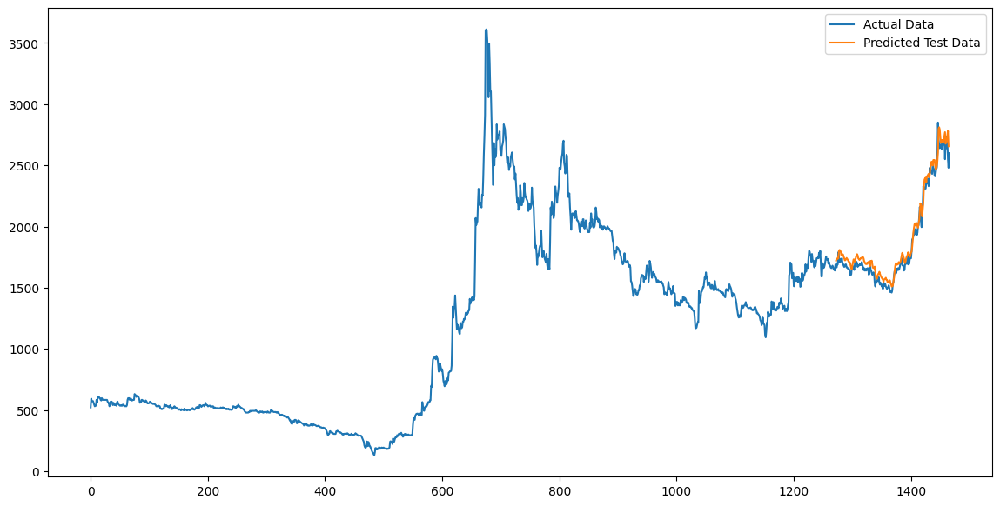

In [ ]:
# Membuat gambar (figure) dengan ukuran 14x7
plt.figure(figsize=(14, 7))
# Membuat plot garis untuk data aktual dengan label 'Actual Data'
plt.plot(bris_hist3, label='Actual Data')
# Membuat plot garis untuk data prediksi pada dengan label 'Predicted Test Data'
plt.plot(testPredictPlot_bris_gru, label='Predicted Test Data')
# Menambahkan legenda ke plot berdasarkan label-label yang telah ditentukan sebelumnya
plt.legend()
# Menampilkan plot
plt.show()

In [ ]:
# Fungsi menghitung MAPE
def mean_absolute_percentage_error(y_true, y_pred):
    y_true, y_pred = np.array(y_true), np.array(y_pred)
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100

In [ ]:
# Melihat Metric Evaluation RMSE dan MAPE
mape_gru_l4_bris = mean_absolute_percentage_error(Y_test_bris_gru,test_predict_bris_gru)
print("RMSE of gru:", np.sqrt(mean_squared_error(Y_test_bris_gru,test_predict_bris_gru)))
print("MAPE of gru:", mape_gru_l4_bris)

RMSE of gru: 70.31893879870066
MAPE of gru: 3.198899955260883


Walaupun memiliki perbedaan error yang kecil, namun hasil tuningan ini lebih baik dari baseline model. Sehingga model 4 layer ini akan digunakan untuk memprediksi harga saham di bank ini.

#### Hyperparameter Tuning & Optimization Using 6 Layers- Worst Model

Percobaan Tuning terburuk dari Bank BSI Syariah adalah di Hasil Tuning 6 layer.

In [ ]:
# Mengambil kolom close
bris_hist2 = bris_hist['Close']

In [ ]:
# Train-Test Split
train_size = int(len(bris_hist2) * 0.80)
test_size = len(bris_hist2) - train_size
train_data_bris_gru, test_data_bris_gru = bris_hist2[:train_size], bris_hist2[train_size:]

# Scalling data
scaler = MinMaxScaler()
bris_hist2 = scaler.fit_transform(np.array(bris_hist2).reshape(-1,1))
train_data_bris_gru = scaler.fit_transform(np.array(train_data_bris_gru).reshape(-1, 1))
test_data_bris_gru = scaler.transform(np.array(test_data_bris_gru).reshape(-1, 1))

In [ ]:
def create_dataset(dataset, time_step = 1):
    dataX,dataY = [],[]
    for i in range(len(dataset)-time_step-1):
                   a = dataset[i:(i+time_step),0]
                   dataX.append(a)
                   dataY.append(dataset[i + time_step,0])
    return np.array(dataX),np.array(dataY)

In [ ]:
# Memanggil fungsi create_dataset untuk membagi data menjadi dataset input dan output dataset dengan times step 100
time_step = 100
X_train_bris_gru,Y_train_bris_gru =  create_dataset(train_data_bris_gru,time_step)
X_test_bris_gru,Y_test_bris_gru =  create_dataset(test_data_bris_gru,time_step)

In [ ]:
Y_train_bris_gru

array([0.12346639, 0.12621179, 0.12483908, ..., 0.34422955, 0.34280119,
       0.3399445 ])

In [ ]:
# Memeriksa value
print(X_train_bris_gru.shape)
print(Y_train_bris_gru.shape)
print(X_test_bris_gru.shape)
print(Y_test_bris_gru.shape)

(1071, 100)
(1071,)
(193, 100)
(193,)


In [ ]:
import tensorflow as tf
from kerastuner import HyperModel, RandomSearch
from kerastuner.engine.hyperparameters import HyperParameters

# Tetapkan seed untuk inisialisasi acak
seed_value = 42
tf.random.set_seed(seed_value)
np.random.seed(seed_value)

# Definisikan fungsi untuk membuat model GRU dengan hyperparameter
def build_model_l6_bris(hp):
    model = tf.keras.Sequential()
    model.add(tf.keras.layers.GRU(
        units=hp.Int('units_1', min_value=50, max_value=200, step=50),
        return_sequences=True,
        input_shape=(X_train_bris_gru.shape[1], 1)
    ))
    model.add(tf.keras.layers.GRU(
        units=hp.Int('units_2', min_value=50, max_value=200, step=50),
        return_sequences=True
    ))
    model.add(tf.keras.layers.GRU(
        units=hp.Int('units_3', min_value=50, max_value=200, step=50),
        return_sequences=True
    ))
    model.add(tf.keras.layers.GRU(
        units=hp.Int('units_4', min_value=50, max_value=200, step=50),
        return_sequences=True
    ))
    model.add(tf.keras.layers.GRU(
        units=hp.Int('units_5', min_value=50, max_value=200, step=50)
    ))
    model.add(tf.keras.layers.Dense(1))

    model.compile(
        optimizer=tf.keras.optimizers.Adam(
            hp.Choice('learning_rate', values=[1e-2, 1e-3, 1e-4])
        ),
        loss='mean_squared_error'
    )
    return model

In [ ]:
from kerastuner.tuners import RandomSearch

# Atur pencarian hyperparameter menggunakan RandomSearch
tuner = RandomSearch(
    build_model_l6_bris,
    objective='val_loss',
    max_trials=10,  # Jumlah percobaan untuk menemukan kombinasi hyperparameter terbaik
    executions_per_trial=1,  # Jumlah eksekusi per percobaan untuk akurasi lebih baik
    directory='hyperparameter_tuning_l6_bris',
    project_name='gru_tuning_l6_bris'
)

# Tentukan data pelatihan dan validasi
tuner.search(X_train_bris_gru, Y_train_bris_gru, validation_data=(X_test_bris_gru, Y_test_bris_gru), epochs=30, batch_size=64, verbose=1)

# Mendapatkan hasil terbaik
best_hps_l6_bris = tuner.get_best_hyperparameters(num_trials=1)[0]

# Membangun model dengan hyperparameter terbaik
model_bris_gru_l6 = build_model_l6_bris(best_hps_l6_bris)

Trial 10 Complete [00h 09m 33s]
val_loss: 0.0007667127647437155

Best val_loss So Far: 0.00018142648332286626
Total elapsed time: 01h 43m 02s


In [ ]:
print(best_hps_l6_bris)

In [ ]:
# Melihat rangkuman model
model_bris_gru_l6.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 gru_5 (GRU)                 (None, 100, 150)          68850     
                                                                 
 gru_6 (GRU)                 (None, 100, 150)          135900    
                                                                 
 gru_7 (GRU)                 (None, 100, 200)          211200    
                                                                 
 gru_8 (GRU)                 (None, 100, 150)          158400    
                                                                 
 gru_9 (GRU)                 (None, 100)               75600     
                                                                 
 dense_1 (Dense)             (None, 1)                 101       
                                                                 
Total params: 650051 (2.48 MB)
Trainable params: 65005

In [ ]:
# Menetapkan seed untuk TensorFlow untuk memastikan hasil yang konsisten dari operasi stokastik (jika ada)
tf.random.set_seed(seed_value)

# Melatih model menggunakan data pelatihan (X_train_bris dan Y_train_bris) dengan data validasi (X_test_bris dan Y_test_bris)
# Epochs adalah jumlah kali seluruh dataset akan diberikan kepada model selama proses pelatihan
# Batch_size adalah jumlah sampel data yang akan diproses sebelum pembaharuan bobot model
# verbose = 1 menghasilkan output detail pada setiap epoch selama pelatihan
model_bris_gru_l6.fit(X_train_bris_gru, Y_train_bris_gru, validation_data=(X_test_bris_gru, Y_test_bris_gru), epochs=50, batch_size=64, verbose=1)
model_bris_gru_l6.save("model_bris_gru_l6.h5")

Epoch 1/50
17/17 [==============================] - 36s 2s/step - loss: 2.8134 - val_loss: 0.0233
Epoch 2/50
17/17 [==============================] - 22s 1s/step - loss: 0.0125 - val_loss: 0.0077
Epoch 3/50
17/17 [==============================] - 24s 1s/step - loss: 0.0216 - val_loss: 0.2534
Epoch 4/50
17/17 [==============================] - 31s 2s/step - loss: 0.0650 - val_loss: 0.0958
Epoch 5/50
17/17 [==============================] - 22s 1s/step - loss: 0.0178 - val_loss: 0.0056
Epoch 6/50
17/17 [==============================] - 25s 1s/step - loss: 0.0038 - val_loss: 0.0023
Epoch 7/50
17/17 [==============================] - 22s 1s/step - loss: 0.0015 - val_loss: 5.0138e-04
Epoch 8/50
17/17 [==============================] - 25s 2s/step - loss: 0.0011 - val_loss: 5.0418e-04
Epoch 9/50
17/17 [==============================] - 22s 1s/step - loss: 8.6352e-04 - val_loss: 5.4289e-04
Epoch 10/50
17/17 [==============================] - 25s 1s/step - loss: 8.0937e-04 - val_loss: 4.6237

In [ ]:
# Memprediksi data menggunakan model yang telah dilatih
train_predict_bris_gru = model_bris_gru_l6.predict(X_train_bris_gru)
test_predict_bris_gru = model_bris_gru_l6.predict(X_test_bris_gru)

7/7 [==============================] - 2s 284ms/step


In [ ]:
Y_train_bris_gru[:5]

array([0.12346639, 0.12621179, 0.12483908, 0.1220937 , 0.12346639])

In [ ]:
train_predict_bris_gru[:5]

array([[0.20581895],
       [0.24859087],
       [0.24448974],
       [0.24355976],
       [0.2440751 ]], dtype=float32)

In [ ]:
# Transformasi data ke bentuk awal
Y_train_bris_gru = scaler.inverse_transform(Y_train_bris_gru.reshape(-1, 1))
Y_test_bris_gru = scaler.inverse_transform(Y_test_bris_gru.reshape(-1, 1))
train_predict_bris_gru = scaler.inverse_transform(train_predict_bris_gru)
test_predict_bris_gru = scaler.inverse_transform(test_predict_bris_gru)

In [ ]:
Y_test_bris_gru[:5]

array([[1680.],
       [1665.],
       [1690.],
       [1690.],
       [1790.]])

In [ ]:
test_predict_bris_gru[:5]

array([[1715.9276],
       [1716.3914],
       [1714.702 ],
       [1720.2811],
       [1719.0094]], dtype=float32)

In [ ]:
# Mendefinisikan jumlah langkah waktu sebelumnya yang akan digunakan sebagai input untuk memprediksi langkah waktu saat ini
look_back = 100

# Membuat array kosong dengan ukuran yang sama dengan bris_hist2
trainPredictPlot_bris = np.empty_like(bris_hist2)
# Mengisi array dengan nilai yang sama dengan NaN (untuk plot)
trainPredictPlot_bris[:,:] = np.nan
# Mengisi bagian dari array dengan hasil prediksi pada data pelatihan
# Menempatkan hasil prediksi pada posisi yang sesuai dalam array untuk plotting
trainPredictPlot_bris[look_back : len(train_predict_bris_gru)+look_back,:] = train_predict_bris_gru

# Membuat array kosong dengan ukuran yang sama dengan bris_hist2
testPredictPlot_bris_gru = np.empty_like(bris_hist2)
# Mengisi array dengan nilai yang sama dengan NaN (untuk plot)
testPredictPlot_bris_gru[:,:] = np.nan
# Mengisi bagian dari array dengan hasil prediksi pada data uji
# Menempatkan hasil prediksi pada posisi yang sesuai dalam array untuk plotting
testPredictPlot_bris_gru[len(train_predict_bris_gru) + (look_back) * 2 + 1 : len(bris_hist2) - 1, :] = test_predict_bris_gru

In [ ]:
# Mengambil data harga saham close dan dijadikan dalam bentuk array numpy
bris_hist3=bris_hist['Close'].to_numpy()

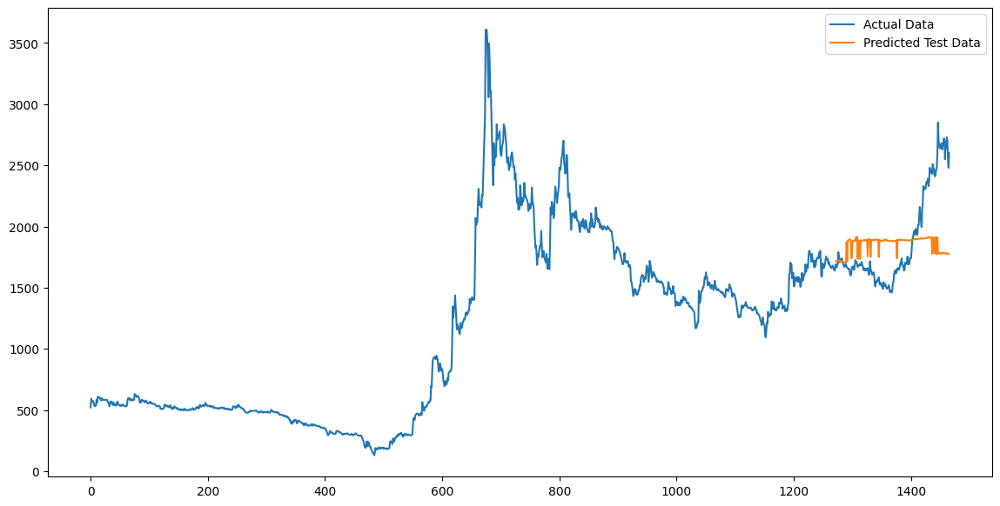

In [ ]:
# Membuat gambar (figure) dengan ukuran 14x7
plt.figure(figsize=(14, 7))
# Membuat plot garis untuk data aktual dengan label 'Actual Data'
plt.plot(bris_hist3, label='Actual Data')
# Membuat plot garis untuk data prediksi pada dengan label 'Predicted Test Data'
plt.plot(testPredictPlot_bris_gru, label='Predicted Test Data')
# Menambahkan legenda ke plot berdasarkan label-label yang telah ditentukan sebelumnya
plt.legend()
# Menampilkan plot
plt.show()

In [ ]:
# Fungsi menghitung MAPE
def mean_absolute_percentage_error(y_true, y_pred):
    y_true, y_pred = np.array(y_true), np.array(y_pred)
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100

In [ ]:
# Melihat Metric Evaluation RMSE dan MAPE
mape_gru_l6_bris = mean_absolute_percentage_error(Y_test_bris_gru,test_predict_bris_gru)
print("RMSE of gru:", np.sqrt(mean_squared_error(Y_test_bris_gru,test_predict_bris_gru)))
print("MAPE of gru:", mape_gru_l6_bris)

RMSE of gru: 397.6309066028274
MAPE of gru: 15.880271689538098


Dapat diamati hasil tuning 6 layer ini memiliki error yang sangat besar jika dibandingkan dengan baseline dan best model. Sehingga tidak akan digunakan untuk melakukan prediksi.

#### Forecasting using Best Model

**Hasil modeling terbaik** baik dari baseline hingga Hyperparameter Tuning & Optimazation adalah **Tuning 4 Layer dengan error yang kecil** yakni RMSE of gru: 70.31893879870066 dan MAPE of gru: 3.198899955260883

In [ ]:
# Mengambil kolom close
bris_hist2 = bris_hist

In [ ]:
# Train-Test Split
train_size = int(len(bris_hist2) * 0.80)
test_size = len(bris_hist2) - train_size
train_data_bris_gru, test_data_bris_gru = bris_hist2[:train_size], bris_hist2[train_size:]

In [ ]:
test_data_bris_gru.head()

,Date,Open,High,Low,Close,Volume,Dividends,Stock Splits,Average
Date,,,,,,,,,
2023-01-17,2023-01-17 00:00:00+07:00,1327.914210,1372.675363,1322.940749,1342.834595,22158500,0.0,0.0,1346.150236
2023-01-18,2023-01-18 00:00:00+07:00,1347.808056,1357.754979,1327.914210,1342.834595,8691400,0.0,0.0,1342.834595
2023-01-19,2023-01-19 00:00:00+07:00,1342.834618,1347.808080,1327.914234,1332.887695,8683200,0.0,0.0,1336.203336
2023-01-20,2023-01-20 00:00:00+07:00,1332.887769,1387.595849,1327.914308,1377.648926,42525300,0.0,0.0,1364.386361
2023-01-24,2023-01-24 00:00:00+07:00,1377.648827,1382.622289,1342.834597,1367.701904,25831500,0.0,0.0,1364.386263


In [ ]:
# Data yang digunakan untuk prediksi adalah data test (data terbaru)
df_bris = test_data_bris_gru.copy()

# Menampilkan 5 baris pertama dari Dataframe
print("DataFrame awal:")
print(df_bris.head())

# Menampilkan 5 baris terakhir dari Dataframe
print("\nDataFrame akhir:")
print(df_bris.tail())

# 1. Load model
model_bris = load_model('/content/drive/MyDrive/Dataset_Bank/model_bris_gru_l4.h5')

# 2. Prepare data (gunakan data dari 100 hari terakhir)
last_n_days = 100  # Menggunakan 100 hari terakhir sesuai kebutuhan model
data_to_predict_bris = bris_hist['Close'][-last_n_days:].values

# 3. Scaling data (misalnya menggunakan MinMaxScaler)
scaler = MinMaxScaler(feature_range=(0, 1))
data_to_predict_scaled = scaler.fit_transform(data_to_predict_bris.reshape(-1, 1))

# 4. Reshape data
data_to_predict_bris_scaled = np.reshape(data_to_predict_scaled, (1, last_n_days, 1))

# 5. Predict multiple days into the future
n_days_to_predict = 30
predictions_bris = []

for i in range(n_days_to_predict):
    # Predict
    predicted_scaled_bris = model_bris.predict(data_to_predict_bris_scaled)
    predicted_bris = scaler.inverse_transform(predicted_scaled_bris)
    # Save prediction
    predictions_bris.append(predicted_bris[0][0])
    # Update data_to_predict_scaled for the next prediction
    data_to_predict_bris_scaled = np.append(data_to_predict_bris_scaled[:, 1:, :], np.reshape(predicted_scaled_bris, (1, 1, 1)), axis=1)

# Print the predicted values
print("\nPredicted values for the next days:")
print(predictions_bris)

# Mendapatkan tanggal terakhir dari data asli
last_date = bris_hist.index[-1]

# Membuat rangkaian tanggal hari kerja untuk hasil prediksi
prediction_dates = pd.date_range(start=last_date + pd.Timedelta(days=1), periods=n_days_to_predict, freq='B')

# Membuat DataFrame baru untuk hasil prediksi
prediction_df_bris = pd.DataFrame({'Date': prediction_dates, 'Predicted_Close': predictions_bris})

# Menampilkan DataFrame prediksi
print("\nPrediction DataFrame:")
print(prediction_df_bris)

DataFrame awal:
                                Date         Open         High          Low  \
Date                                                                          
2023-01-17 2023-01-17 00:00:00+07:00  1327.914210  1372.675363  1322.940749   
2023-01-18 2023-01-18 00:00:00+07:00  1347.808056  1357.754979  1327.914210   
2023-01-19 2023-01-19 00:00:00+07:00  1342.834618  1347.808080  1327.914234   
2023-01-20 2023-01-20 00:00:00+07:00  1332.887769  1387.595849  1327.914308   
2023-01-24 2023-01-24 00:00:00+07:00  1377.648827  1382.622289  1342.834597   

                  Close    Volume  Dividends  Stock Splits  
Date                                                        
2023-01-17  1342.834595  22158500        0.0           0.0  
2023-01-18  1342.834595   8691400        0.0           0.0  
2023-01-19  1332.887695   8683200        0.0           0.0  
2023-01-20  1377.648926  42525300        0.0           0.0  
2023-01-24  1367.701904  25831500        0.0           0.0  

Da

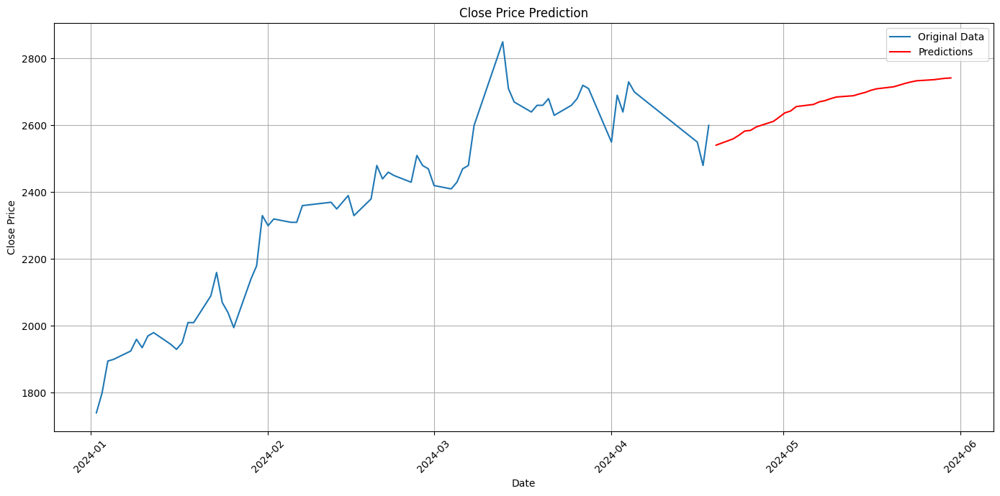

In [ ]:
# Plotting the results
plt.figure(figsize=(14, 7))
# Plot the original data
plt.plot(bris_hist[bris_hist['Date'] > '2024-01-01']['Date'], bris_hist[bris_hist['Date'] > '2024-01-01']['Close'], label='Original Data')
# Plot the predictions
plt.plot(prediction_df_bris['Date'], prediction_df_bris['Predicted_Close'], label='Predictions', color='red')
# Formatting the plot
plt.xlabel('Date')
plt.ylabel('Close Price')
plt.title('Close Price Prediction')
plt.legend()
plt.grid(True)
plt.xticks(rotation=45)
plt.tight_layout()
# Display the plot
plt.show()

Dapat diamati bahwa berdasarkan Hasil prediksi **harga saham Bank BSI Syariah selama 30 hari kedepan akan mengalami kenaikan harga saham.** Prediksi dilakukan dengan model terbaik yakni menggunakan Model 4 layers. Dimana Model ini memiliki RMSE dan MAPE terkecil yakni 70.31893879870066 untuk RMSE dan untuk MAPE sebesar 3.198899955260883.

### Bank Mega (MEGA)

#### Baseline Model

In [ ]:
# Mengambil kolom close
mega_hist2 = mega_hist['Close']

In [ ]:
# Train-Test Split
train_size = int(len(mega_hist2) * 0.80)
test_size = len(mega_hist2) - train_size
train_data_mega_gru, test_data_mega_gru = mega_hist2[:train_size], mega_hist2[train_size:]

# Scalling data
scaler = MinMaxScaler()
mega_hist2 = scaler.fit_transform(np.array(mega_hist2).reshape(-1,1))
train_data_mega_gru = scaler.fit_transform(np.array(train_data_mega_gru).reshape(-1, 1))
test_data_mega_gru = scaler.transform(np.array(test_data_mega_gru).reshape(-1, 1))

In [ ]:
def create_dataset(dataset, time_step = 1):
    dataX,dataY = [],[]
    for i in range(len(dataset)-time_step-1):
                   a = dataset[i:(i+time_step),0]
                   dataX.append(a)
                   dataY.append(dataset[i + time_step,0])
    return np.array(dataX),np.array(dataY)

In [ ]:
# Memanggil fungsi create_dataset untuk membagi data menjadi dataset input dan output dataset dengan times step 100
time_step = 100
X_train_mega_gru,Y_train_mega_gru =  create_dataset(train_data_mega_gru,time_step)
X_test_mega_gru,Y_test_mega_gru =  create_dataset(test_data_mega_gru,time_step)

In [ ]:
Y_train_mega_gru

array([0.00693747, 0.00693747, 0.00693747, ..., 0.89401102, 0.88644032,
       0.85237244])

In [ ]:
# Memeriksa value
print(X_train_mega_gru.shape)
print(X_train_mega_gru)
print(X_test_mega_gru.shape)
print(Y_test_mega_gru.shape)

(1879, 100)
[[3.46875320e-03 1.04065307e-03 3.46894397e-04 ... 6.93746625e-03
  6.93746625e-03 6.93746625e-03]
 [1.04065307e-03 3.46894397e-04 3.46894397e-04 ... 6.93746625e-03
  6.93746625e-03 6.93746625e-03]
 [3.46894397e-04 3.46894397e-04 3.46875320e-03 ... 6.93746625e-03
  6.93746625e-03 6.93746625e-03]
 ...
 [5.36291900e-01 5.34261196e-01 5.34261196e-01 ... 9.12937589e-01
  8.97796282e-01 8.97796282e-01]
 [5.34261196e-01 5.34261196e-01 5.74875320e-01 ... 8.97796282e-01
  8.97796282e-01 8.94011016e-01]
 [5.34261196e-01 5.74875320e-01 5.36291900e-01 ... 8.97796282e-01
  8.94011016e-01 8.86440323e-01]]
(394, 100)
(394,)


In [ ]:
# Tetapkan seed untuk inisialisasi acak
seed_value = 42
tf.random.set_seed(seed_value)
np.random.seed(seed_value)

# Membangun model GRU
model_mega_gru1 = tf.keras.Sequential([
      # Menambahkan layer GRU pertama dengan 50 unit dan pengembalian urutan yang digunakan untuk menjaga urutan output
      # Input_shape adalah bentuk input, yaitu jumlah langkah waktu (X_train_mega.shape[1]) dan fitur (1)
      tf.keras.layers.GRU(50, return_sequences=True, input_shape=(X_train_mega_gru.shape[1], 1)),
      # Menambahkan layer GRU kedua dengan 50 unit, tidak ada pengembalian urutan karena ini adalah lapisan terakhir LSTM
      tf.keras.layers.GRU(50),
      # Menambahkan layer Dense dengan 1 unit sebagai output layer
      tf.keras.layers.Dense(1)
])
# Mengompilasi model dengan loss function 'mean_squared_error' dan optimizer 'adam'
model_mega_gru1.compile(loss='mean_squared_error', optimizer='adam')

In [ ]:
# Melihat rangkuman model
model_mega_gru1.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 gru (GRU)                   (None, 100, 50)           7950      
                                                                 
 gru_1 (GRU)                 (None, 50)                15300     
                                                                 
 dense (Dense)               (None, 1)                 51        
                                                                 
Total params: 23301 (91.02 KB)
Trainable params: 23301 (91.02 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________


In [ ]:
# Menetapkan seed untuk TensorFlow untuk memastikan hasil yang konsisten dari operasi stokastik (jika ada)
tf.random.set_seed(seed_value)

# Melatih model menggunakan data pelatihan (X_train_bbca dan Y_train_bbca) dengan data validasi (X_test_bbca dan Y_test_bbca)
# Epochs adalah jumlah kali seluruh dataset akan diberikan kepada model selama proses pelatihan
# Batch_size adalah jumlah sampel data yang akan diproses sebelum pembaharuan bobot model
# verbose = 1 menghasilkan output detail pada setiap epoch selama pelatihan
model_mega_gru1.fit(X_train_mega_gru, Y_train_mega_gru, validation_data=(X_test_mega_gru, Y_test_mega_gru), epochs=50, batch_size=64, verbose=1)
model_mega_gru1.save("model_mega_gru1.h5")

Epoch 1/50
30/30 [==============================] - 11s 189ms/step - loss: 0.0085 - val_loss: 0.0035
Epoch 2/50
30/30 [==============================] - 3s 98ms/step - loss: 6.6582e-04 - val_loss: 3.1952e-04
Epoch 3/50
30/30 [==============================] - 3s 99ms/step - loss: 4.3060e-04 - val_loss: 3.3406e-04
Epoch 4/50
30/30 [==============================] - 3s 101ms/step - loss: 4.0204e-04 - val_loss: 2.2982e-04
Epoch 5/50
30/30 [==============================] - 4s 146ms/step - loss: 3.9107e-04 - val_loss: 2.1920e-04
Epoch 6/50
30/30 [==============================] - 4s 116ms/step - loss: 3.8357e-04 - val_loss: 4.6287e-04
Epoch 7/50
30/30 [==============================] - 3s 99ms/step - loss: 3.6987e-04 - val_loss: 3.5669e-04
Epoch 8/50
30/30 [==============================] - 3s 97ms/step - loss: 3.7217e-04 - val_loss: 2.1258e-04
Epoch 9/50
30/30 [==============================] - 3s 116ms/step - loss: 3.3895e-04 - val_loss: 2.3696e-04
Epoch 10/50
30/30 [====================

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


In [ ]:
# Memprediksi data menggunakan model yang telah dilatih
train_predict_mega_gru = model_mega_gru1.predict(X_train_mega_gru)
test_predict_mega_gru = model_mega_gru1.predict(X_test_mega_gru)

13/13 [==============================] - 0s 19ms/step


In [ ]:
Y_train_mega_gru[:5]

array([0.00693747, 0.00693747, 0.00693747, 0.00693747, 0.00693747])

In [ ]:
train_predict_mega_gru[:5]

array([[0.01040373],
       [0.01040144],
       [0.01040094],
       [0.01040143],
       [0.01040211]], dtype=float32)

In [ ]:
# Transformasi data ke bentuk awal
Y_train_mega_gru = scaler.inverse_transform(Y_train_mega_gru.reshape(-1, 1))
Y_test_mega_gru = scaler.inverse_transform(Y_test_mega_gru.reshape(-1, 1))
train_predict_mega_gru = scaler.inverse_transform(train_predict_mega_gru)
test_predict_mega_gru = scaler.inverse_transform(test_predict_mega_gru)

In [ ]:
Y_test_mega_gru[:5]

array([[4740.38378906],
       [4809.41845703],
       [5246.63818359],
       [5016.52246094],
       [5085.55712891]])

In [ ]:
test_predict_mega_gru[:5]

array([[4889.8594],
       [4816.023 ],
       [4887.5703],
       [5353.666 ],
       [5106.135 ]], dtype=float32)

In [ ]:
# Mendefinisikan jumlah langkah waktu sebelumnya yang akan digunakan sebagai input untuk memprediksi langkah waktu saat ini
look_back = 100

# Membuat array kosong dengan ukuran yang sama dengan bbca_hist2
trainPredictPlot_mega = np.empty_like(mega_hist2)
# Mengisi array dengan nilai yang sama dengan NaN (untuk plot)
trainPredictPlot_mega[:,:] = np.nan
# Mengisi bagian dari array dengan hasil prediksi pada data pelatihan
# Menempatkan hasil prediksi pada posisi yang sesuai dalam array untuk plotting
trainPredictPlot_mega[look_back : len(train_predict_mega_gru)+look_back,:] = train_predict_mega_gru

# Membuat array kosong dengan ukuran yang sama dengan bbca_hist2
testPredictPlot_mega_gru = np.empty_like(mega_hist2)
# Mengisi array dengan nilai yang sama dengan NaN (untuk plot)
testPredictPlot_mega_gru[:,:] = np.nan
# Mengisi bagian dari array dengan hasil prediksi pada data uji
# Menempatkan hasil prediksi pada posisi yang sesuai dalam array untuk plotting
testPredictPlot_mega_gru[len(train_predict_mega_gru) + (look_back) * 2 + 1 : len(mega_hist2) - 1, :] = test_predict_mega_gru

In [ ]:
# Mengambil data harga saham close dan dijadikan dalam bentuk array numpy
mega_hist3=mega_hist['Close'].to_numpy()

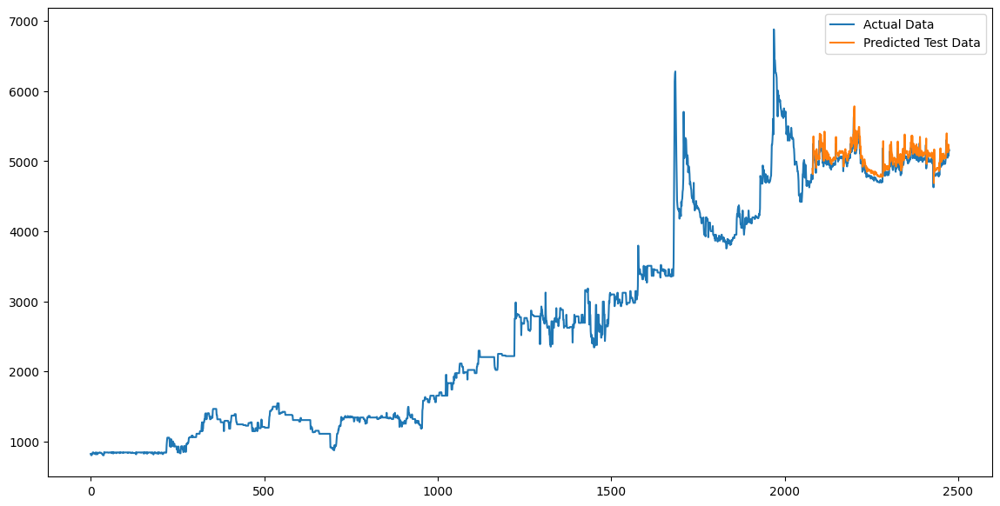

In [ ]:
# Membuat gambar (figure) dengan ukuran 14x7
plt.figure(figsize=(14, 7))
# Membuat plot garis untuk data aktual dengan label 'Actual Data'
plt.plot(mega_hist3, label='Actual Data')
# Membuat plot garis untuk data prediksi pada dengan label 'Predicted Test Data'
plt.plot(testPredictPlot_mega_gru, label='Predicted Test Data')
# Menambahkan legenda ke plot berdasarkan label-label yang telah ditentukan sebelumnya
plt.legend()
# Menampilkan plot
plt.show()

In [ ]:
# Fungsi menghitung MAPE
def mean_absolute_percentage_error(y_true, y_pred):
    y_true, y_pred = np.array(y_true), np.array(y_pred)
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100

In [ ]:
# Melihat Metric Evaluation RMSE dan MAPE
mape_gru1_mega = mean_absolute_percentage_error(Y_test_mega_gru,test_predict_mega_gru)
print("RMSE of GRU:", np.sqrt(mean_squared_error(Y_test_mega_gru,test_predict_mega_gru)))
print("MAPE of GRU:", mape_gru1_mega)

RMSE of GRU: 126.13379985992466
MAPE of GRU: 2.020536908711894


#### Hyperparameter Tuning & Optimization Using 4 Layer - Best Model

In [ ]:
# Mengambil kolom close
mega_hist2 = mega_hist['Close']

In [ ]:
# Train-Test Split
train_size = int(len(mega_hist2) * 0.80)
test_size = len(mega_hist2) - train_size
train_data_mega_gru, test_data_mega_gru = mega_hist2[:train_size], mega_hist2[train_size:]

# Scalling data
scaler = MinMaxScaler()
mega_hist2 = scaler.fit_transform(np.array(mega_hist2).reshape(-1,1))
train_data_mega_gru = scaler.fit_transform(np.array(train_data_mega_gru).reshape(-1, 1))
test_data_mega_gru = scaler.transform(np.array(test_data_mega_gru).reshape(-1, 1))

In [ ]:
def create_dataset(dataset, time_step = 1):
    dataX,dataY = [],[]
    for i in range(len(dataset)-time_step-1):
                   a = dataset[i:(i+time_step),0]
                   dataX.append(a)
                   dataY.append(dataset[i + time_step,0])
    return np.array(dataX),np.array(dataY)

In [ ]:
# Memanggil fungsi create_dataset untuk membagi data menjadi dataset input dan output dataset dengan times step 100
time_step = 100
X_train_mega_gru,Y_train_mega_gru =  create_dataset(train_data_mega_gru,time_step)
X_test_mega_gru,Y_test_mega_gru =  create_dataset(test_data_mega_gru,time_step)

In [ ]:
Y_train_mega_gru

array([0.00693747, 0.00693747, 0.00693747, ..., 0.89401102, 0.88644032,
       0.85237244])

In [ ]:
# Memeriksa value
print(X_train_mega_gru.shape)
print(X_train_mega_gru)
print(X_test_mega_gru.shape)
print(Y_test_mega_gru.shape)

(1879, 100)
[[3.46875320e-03 1.04065307e-03 3.46894397e-04 ... 6.93746625e-03
  6.93746625e-03 6.93746625e-03]
 [1.04065307e-03 3.46894397e-04 3.46894397e-04 ... 6.93746625e-03
  6.93746625e-03 6.93746625e-03]
 [3.46894397e-04 3.46894397e-04 3.46875320e-03 ... 6.93746625e-03
  6.93746625e-03 6.93746625e-03]
 ...
 [5.36291900e-01 5.34261196e-01 5.34261196e-01 ... 9.12937589e-01
  8.97796282e-01 8.97796282e-01]
 [5.34261196e-01 5.34261196e-01 5.74875320e-01 ... 8.97796282e-01
  8.97796282e-01 8.94011016e-01]
 [5.34261196e-01 5.74875320e-01 5.36291900e-01 ... 8.97796282e-01
  8.94011016e-01 8.86440323e-01]]
(394, 100)
(394,)


In [ ]:
# Tetapkan seed untuk inisialisasi acak
seed_value = 42
tf.random.set_seed(seed_value)
np.random.seed(seed_value)

# Definisikan fungsi untuk membuat model GRU dengan hyperparameter
def build_model_l4(hp):
    model = tf.keras.Sequential()
    model.add(tf.keras.layers.GRU(
        units=hp.Int('units_1', min_value=50, max_value=200, step=50),
        return_sequences=True,
        input_shape=(X_train_mega_gru.shape[1], 1)
    ))
    model.add(tf.keras.layers.GRU(
        units=hp.Int('units_2', min_value=50, max_value=200, step=50),
        return_sequences=True
    ))
    model.add(tf.keras.layers.GRU(
        units=hp.Int('units_3', min_value=50, max_value=200, step=50)
    ))
    model.add(tf.keras.layers.Dense(1))

    model.compile(
        optimizer=tf.keras.optimizers.Adam(
            hp.Choice('learning_rate', values=[1e-2, 1e-3, 1e-4])
        ),
        loss='mean_squared_error'
    )
    return model


<ipython-input-16-3ef83ed161e1>:2: DeprecationWarning: `import kerastuner` is deprecated, please use `import keras_tuner`.
  from kerastuner import HyperModel, RandomSearch


In [ ]:
# Atur pencarian hyperparameter menggunakan RandomSearch
tuner = RandomSearch(
    build_model_l4,
    objective='val_loss',
    max_trials=10,  # Jumlah percobaan untuk menemukan kombinasi hyperparameter terbaik
    executions_per_trial=1,  # Jumlah eksekusi per percobaan untuk akurasi lebih baik
    directory='hyperparameter_tuning_l4',
    project_name='gru_tuning_l4'
)

# Tentukan data pelatihan dan validasi
tuner.search(X_train_mega_gru, Y_train_mega_gru, validation_data=(X_test_mega_gru, Y_test_mega_gru), epochs=30, batch_size=64, verbose=1)

# Mendapatkan hasil terbaik
best_hps_l4 = tuner.get_best_hyperparameters(num_trials=1)[0]

# Membangun model dengan hyperparameter terbaik
model_mega_gru_l4 = build_model_l4(best_hps_l4)

Trial 10 Complete [00h 12m 28s]
val_loss: 0.0002214774867752567

Best val_loss So Far: 0.00021858890249859542
Total elapsed time: 02h 21m 02s


In [ ]:
print(best_hps_l4)

In [ ]:
# Melihat rangkuman model
model_mega_gru_l4.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 gru_3 (GRU)                 (None, 100, 200)          121800    
                                                                 
 gru_4 (GRU)                 (None, 100, 100)          90600     
                                                                 
 gru_5 (GRU)                 (None, 200)               181200    
                                                                 
 dense_1 (Dense)             (None, 1)                 201       
                                                                 
Total params: 393801 (1.50 MB)
Trainable params: 393801 (1.50 MB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________


In [ ]:
# Menetapkan seed untuk TensorFlow untuk memastikan hasil yang konsisten dari operasi stokastik (jika ada)
tf.random.set_seed(seed_value)

# Melatih model menggunakan data pelatihan (X_train_mega dan Y_train_mega) dengan data validasi (X_test_mega dan Y_test_mega)
# Epochs adalah jumlah kali seluruh dataset akan diberikan kepada model selama proses pelatihan
# Batch_size adalah jumlah sampel data yang akan diproses sebelum pembaharuan bobot model
# verbose = 1 menghasilkan output detail pada setiap epoch selama pelatihan
model_mega_gru_l4.fit(X_train_mega_gru, Y_train_mega_gru, validation_data=(X_test_mega_gru, Y_test_mega_gru), epochs=50, batch_size=64, verbose=1)
model_mega_gru_l4.save("model_mega_gru_l4.h5")

Epoch 1/50
30/30 [==============================] - 33s 865ms/step - loss: 0.0099 - val_loss: 7.4330e-04
Epoch 2/50
30/30 [==============================] - 25s 819ms/step - loss: 7.0519e-04 - val_loss: 2.7413e-04
Epoch 3/50
30/30 [==============================] - 26s 871ms/step - loss: 5.5685e-04 - val_loss: 2.5800e-04
Epoch 4/50
30/30 [==============================] - 23s 781ms/step - loss: 5.1891e-04 - val_loss: 3.5739e-04
Epoch 5/50
30/30 [==============================] - 26s 873ms/step - loss: 4.9328e-04 - val_loss: 2.3571e-04
Epoch 6/50
30/30 [==============================] - 26s 874ms/step - loss: 4.5055e-04 - val_loss: 3.6586e-04
Epoch 7/50
30/30 [==============================] - 23s 784ms/step - loss: 4.2508e-04 - val_loss: 8.0190e-04
Epoch 8/50
30/30 [==============================] - 27s 924ms/step - loss: 3.9332e-04 - val_loss: 2.3136e-04
Epoch 9/50
30/30 [==============================] - 25s 851ms/step - loss: 3.9018e-04 - val_loss: 4.7343e-04
Epoch 10/50
30/30 [====

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


In [ ]:
# Memprediksi data menggunakan model yang telah dilatih
train_predict_mega_gru = model_mega_gru_l4.predict(X_train_mega_gru)
test_predict_mega_gru = model_mega_gru_l4.predict(X_test_mega_gru)

13/13 [==============================] - 5s 348ms/step


In [ ]:
Y_train_mega_gru[:5]

array([0.00693747, 0.00693747, 0.00693747, 0.00693747, 0.00693747])

In [ ]:
train_predict_mega_gru[:5]

array([[0.00585902],
       [0.00585441],
       [0.00585531],
       [0.0058586 ],
       [0.00586218]], dtype=float32)

In [ ]:
# Transformasi data ke bentuk awal
Y_train_mega_gru = scaler.inverse_transform(Y_train_mega_gru.reshape(-1, 1))
Y_test_mega_gru = scaler.inverse_transform(Y_test_mega_gru.reshape(-1, 1))
train_predict_mega_gru = scaler.inverse_transform(train_predict_mega_gru)
test_predict_mega_gru = scaler.inverse_transform(test_predict_mega_gru)

In [ ]:
Y_test_mega_gru[:5]

array([[4740.38378906],
       [4809.41845703],
       [5246.63818359],
       [5016.52246094],
       [5085.55712891]])

In [ ]:
test_predict_mega_gru[:5]

array([[4799.919 ],
       [4721.9414],
       [4799.398 ],
       [5284.505 ],
       [5001.364 ]], dtype=float32)

In [ ]:
# Mendefinisikan jumlah langkah waktu sebelumnya yang akan digunakan sebagai input untuk memprediksi langkah waktu saat ini
look_back = 100

# Membuat array kosong dengan ukuran yang sama dengan bbri_hist2
trainPredictPlot_mega = np.empty_like(mega_hist2)
# Mengisi array dengan nilai yang sama dengan NaN (untuk plot)
trainPredictPlot_mega[:,:] = np.nan
# Mengisi bagian dari array dengan hasil prediksi pada data pelatihan
# Menempatkan hasil prediksi pada posisi yang sesuai dalam array untuk plotting
trainPredictPlot_mega[look_back : len(train_predict_mega_gru)+look_back,:] = train_predict_mega_gru

# Membuat array kosong dengan ukuran yang sama dengan bbri_hist2
testPredictPlot_mega_gru = np.empty_like(mega_hist2)
# Mengisi array dengan nilai yang sama dengan NaN (untuk plot)
testPredictPlot_mega_gru[:,:] = np.nan
# Mengisi bagian dari array dengan hasil prediksi pada data uji
# Menempatkan hasil prediksi pada posisi yang sesuai dalam array untuk plotting
testPredictPlot_mega_gru[len(train_predict_mega_gru) + (look_back) * 2 + 1 : len(mega_hist2) - 1, :] = test_predict_mega_gru

In [ ]:
# Mengambil data harga saham close dan dijadikan dalam bentuk array numpy
mega_hist3=mega_hist['Close'].to_numpy()

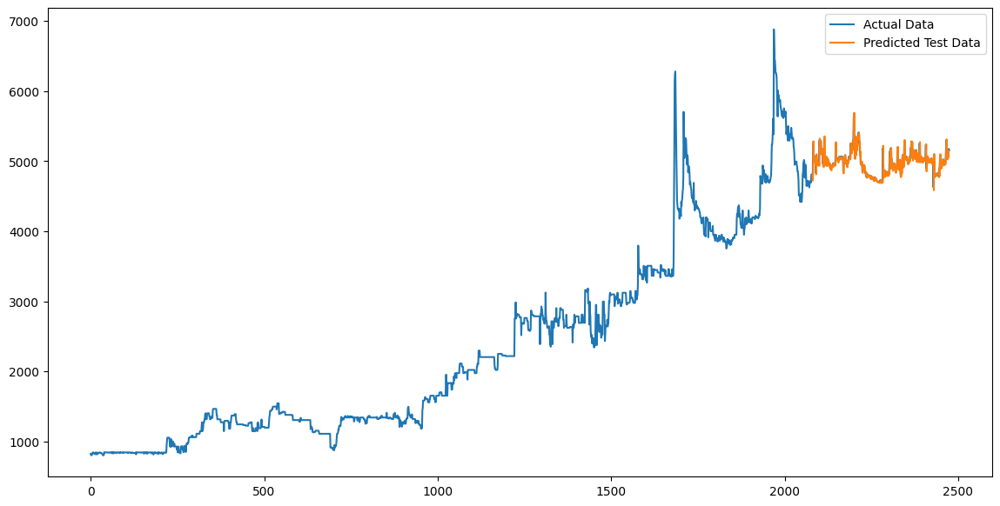

In [ ]:
# Membuat gambar (figure) dengan ukuran 14x7
plt.figure(figsize=(14, 7))
# Membuat plot garis untuk data aktual dengan label 'Actual Data'
plt.plot(mega_hist3, label='Actual Data')
# Membuat plot garis untuk data prediksi pada dengan label 'Predicted Test Data'
plt.plot(testPredictPlot_mega_gru, label='Predicted Test Data')
# Menambahkan legenda ke plot berdasarkan label-label yang telah ditentukan sebelumnya
plt.legend()
# Menampilkan plot
plt.show()

In [ ]:
# Fungsi menghitung MAPE
def mean_absolute_percentage_error(y_true, y_pred):
    y_true, y_pred = np.array(y_true), np.array(y_pred)
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100

In [ ]:
# Melihat Metric Evaluation RMSE dan MAPE
mape_gru_l4_mega = mean_absolute_percentage_error(Y_test_mega_gru,test_predict_mega_gru)
print("RMSE of gru:", np.sqrt(mean_squared_error(Y_test_mega_gru,test_predict_mega_gru)))
print("MAPE of gru:", mape_gru_l4_mega)

RMSE of gru: 100.78737972932925
MAPE of gru: 1.2096643898410382


#### Hyperparameter Tuning & Optimization Using 6 Layer - Worst Model

In [ ]:
# Mengambil kolom close
mega_hist2 = mega_hist['Close']

In [ ]:
# Train-Test Split
train_size = int(len(mega_hist2) * 0.80)
test_size = len(mega_hist2) - train_size
train_data_mega_gru, test_data_mega_gru = mega_hist2[:train_size], mega_hist2[train_size:]

# Scalling data
scaler = MinMaxScaler()
mega_hist2 = scaler.fit_transform(np.array(mega_hist2).reshape(-1,1))
train_data_mega_gru = scaler.fit_transform(np.array(train_data_mega_gru).reshape(-1, 1))
test_data_mega_gru = scaler.transform(np.array(test_data_mega_gru).reshape(-1, 1))

In [ ]:
def create_dataset(dataset, time_step = 1):
    dataX,dataY = [],[]
    for i in range(len(dataset)-time_step-1):
                   a = dataset[i:(i+time_step),0]
                   dataX.append(a)
                   dataY.append(dataset[i + time_step,0])
    return np.array(dataX),np.array(dataY)

In [ ]:
# Memanggil fungsi create_dataset untuk membagi data menjadi dataset input dan output dataset dengan times step 100
time_step = 100
X_train_mega_gru,Y_train_mega_gru =  create_dataset(train_data_mega_gru,time_step)
X_test_mega_gru,Y_test_mega_gru =  create_dataset(test_data_mega_gru,time_step)

In [ ]:
Y_train_mega_gru

array([0.00693747, 0.00693747, 0.00693747, ..., 0.89401102, 0.88644032,
       0.85237244])

In [ ]:
# Memeriksa value
print(X_train_mega_gru.shape)
print(X_train_mega_gru)
print(X_test_mega_gru.shape)
print(Y_test_mega_gru.shape)

(1879, 100)
[[3.46875320e-03 1.04065307e-03 3.46894397e-04 ... 6.93746625e-03
  6.93746625e-03 6.93746625e-03]
 [1.04065307e-03 3.46894397e-04 3.46894397e-04 ... 6.93746625e-03
  6.93746625e-03 6.93746625e-03]
 [3.46894397e-04 3.46894397e-04 3.46875320e-03 ... 6.93746625e-03
  6.93746625e-03 6.93746625e-03]
 ...
 [5.36291900e-01 5.34261196e-01 5.34261196e-01 ... 9.12937589e-01
  8.97796282e-01 8.97796282e-01]
 [5.34261196e-01 5.34261196e-01 5.74875320e-01 ... 8.97796282e-01
  8.97796282e-01 8.94011016e-01]
 [5.34261196e-01 5.74875320e-01 5.36291900e-01 ... 8.97796282e-01
  8.94011016e-01 8.86440323e-01]]
(394, 100)
(394,)


In [ ]:
# Tetapkan seed untuk inisialisasi acak
seed_value = 42
tf.random.set_seed(seed_value)
np.random.seed(seed_value)

# Definisikan fungsi untuk membuat model GRU dengan hyperparameter
def build_model_l6(hp):
    model = tf.keras.Sequential()
    model.add(tf.keras.layers.GRU(
        units=hp.Int('units_1', min_value=50, max_value=200, step=50),
        return_sequences=True,
        input_shape=(X_train_mega_gru.shape[1], 1)
    ))
    model.add(tf.keras.layers.GRU(
        units=hp.Int('units_2', min_value=50, max_value=200, step=50),
        return_sequences=True
    ))
    model.add(tf.keras.layers.GRU(
        units=hp.Int('units_3', min_value=50, max_value=200, step=50),
        return_sequences=True
    ))
    model.add(tf.keras.layers.GRU(
        units=hp.Int('units_4', min_value=50, max_value=200, step=50),
        return_sequences=True
    ))
    model.add(tf.keras.layers.GRU(
        units=hp.Int('units_5', min_value=50, max_value=200, step=50)
    ))
    model.add(tf.keras.layers.Dense(1))

    model.compile(
        optimizer=tf.keras.optimizers.Adam(
            hp.Choice('learning_rate', values=[1e-2, 1e-3, 1e-4])
        ),
        loss='mean_squared_error'
    )
    return model

<ipython-input-16-fed3f88260b6>:2: DeprecationWarning: `import kerastuner` is deprecated, please use `import keras_tuner`.
  from kerastuner import HyperModel, RandomSearch


In [ ]:
# Atur pencarian hyperparameter menggunakan RandomSearch
tuner = RandomSearch(
    build_model_l6,
    objective='val_loss',
    max_trials=10,  # Jumlah percobaan untuk menemukan kombinasi hyperparameter terbaik
    executions_per_trial=1,  # Jumlah eksekusi per percobaan untuk akurasi lebih baik
    directory='hyperparameter_tuning_l6',
    project_name='gru_tuning_l6'
)

# Tentukan data pelatihan dan validasi
tuner.search(X_train_mega_gru, Y_train_mega_gru, validation_data=(X_test_mega_gru, Y_test_mega_gru), epochs=30, batch_size=64, verbose=1)

# Mendapatkan hasil terbaik
best_hps_l6 = tuner.get_best_hyperparameters(num_trials=1)[0]

# Membangun model dengan hyperparameter terbaik
model_mega_gru_l6 = build_model_l6(best_hps_l6)

Trial 10 Complete [00h 15m 32s]
val_loss: 0.00030354002956300974

Best val_loss So Far: 0.00021752620523329824
Total elapsed time: 02h 42m 17s


In [ ]:
print(best_hps_l6)

In [ ]:
# Melihat rangkuman model
model_mega_gru_l6.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 gru_5 (GRU)                 (None, 100, 150)          68850     
                                                                 
 gru_6 (GRU)                 (None, 100, 150)          135900    
                                                                 
 gru_7 (GRU)                 (None, 100, 100)          75600     
                                                                 
 gru_8 (GRU)                 (None, 100, 150)          113400    
                                                                 
 gru_9 (GRU)                 (None, 200)               211200    
                                                                 
 dense_1 (Dense)             (None, 1)                 201       
                                                                 
Total params: 605151 (2.31 MB)
Trainable params: 60515

In [ ]:
# Menetapkan seed untuk TensorFlow untuk memastikan hasil yang konsisten dari operasi stokastik (jika ada)
tf.random.set_seed(seed_value)

# Melatih model menggunakan data pelatihan (X_train_bbri dan Y_train_bbri) dengan data validasi (X_test_bbri dan Y_test_bbri)
# Epochs adalah jumlah kali seluruh dataset akan diberikan kepada model selama proses pelatihan
# Batch_size adalah jumlah sampel data yang akan diproses sebelum pembaharuan bobot model
# verbose = 1 menghasilkan output detail pada setiap epoch selama pelatihan
model_mega_gru_l6.fit(X_train_mega_gru, Y_train_mega_gru, validation_data=(X_test_mega_gru, Y_test_mega_gru), epochs=50, batch_size=64, verbose=1)
model_mega_gru_l6.save("model_mega_gru_l6.h5")

Epoch 1/50
30/30 [==============================] - 47s 1s/step - loss: 3.8845 - val_loss: 0.2945
Epoch 2/50
30/30 [==============================] - 35s 1s/step - loss: 0.0346 - val_loss: 0.0658
Epoch 3/50
30/30 [==============================] - 39s 1s/step - loss: 0.0048 - val_loss: 8.5065e-04
Epoch 4/50
30/30 [==============================] - 36s 1s/step - loss: 0.0013 - val_loss: 3.8873e-04
Epoch 5/50
30/30 [==============================] - 38s 1s/step - loss: 7.4135e-04 - val_loss: 3.3567e-04
Epoch 6/50
30/30 [==============================] - 35s 1s/step - loss: 0.0020 - val_loss: 0.0011
Epoch 7/50
30/30 [==============================] - 36s 1s/step - loss: 0.0040 - val_loss: 9.0480e-04
Epoch 8/50
30/30 [==============================] - 37s 1s/step - loss: 0.0014 - val_loss: 0.0014
Epoch 9/50
30/30 [==============================] - 35s 1s/step - loss: 9.9473e-04 - val_loss: 6.1829e-04
Epoch 10/50
30/30 [==============================] - 37s 1s/step - loss: 8.8554e-04 - val_

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


In [ ]:
# Memprediksi data menggunakan model yang telah dilatih
train_predict_mega_gru = model_mega_gru_l6.predict(X_train_mega_gru)
test_predict_mega_gru = model_mega_gru_l6.predict(X_test_mega_gru)

13/13 [==============================] - 4s 280ms/step


In [ ]:
Y_train_mega_gru[:5]

array([0.00693747, 0.00693747, 0.00693747, 0.00693747, 0.00693747])

In [ ]:
train_predict_mega_gru[:5]

array([[0.02272763],
       [0.02252651],
       [0.02273587],
       [0.02265053],
       [0.02270791]], dtype=float32)

In [ ]:
# Transformasi data ke bentuk awal
Y_train_mega_gru = scaler.inverse_transform(Y_train_mega_gru.reshape(-1, 1))
Y_test_mega_gru = scaler.inverse_transform(Y_test_mega_gru.reshape(-1, 1))
train_predict_mega_gru = scaler.inverse_transform(train_predict_mega_gru)
test_predict_mega_gru = scaler.inverse_transform(test_predict_mega_gru)

In [ ]:
Y_test_mega_gru[:5]

array([[4740.38378906],
       [4809.41845703],
       [5246.63818359],
       [5016.52246094],
       [5085.55712891]])

In [ ]:
test_predict_mega_gru[:5]

array([[4962.785 ],
       [4885.2295],
       [4948.7676],
       [5395.442 ],
       [5208.542 ]], dtype=float32)

In [ ]:
# Mendefinisikan jumlah langkah waktu sebelumnya yang akan digunakan sebagai input untuk memprediksi langkah waktu saat ini
look_back = 100

# Membuat array kosong dengan ukuran yang sama dengan bbri_hist2
trainPredictPlot_mega = np.empty_like(mega_hist2)
# Mengisi array dengan nilai yang sama dengan NaN (untuk plot)
trainPredictPlot_mega[:,:] = np.nan
# Mengisi bagian dari array dengan hasil prediksi pada data pelatihan
# Menempatkan hasil prediksi pada posisi yang sesuai dalam array untuk plotting
trainPredictPlot_mega[look_back : len(train_predict_mega_gru)+look_back,:] = train_predict_mega_gru

# Membuat array kosong dengan ukuran yang sama dengan bbri_hist2
testPredictPlot_mega_gru = np.empty_like(mega_hist2)
# Mengisi array dengan nilai yang sama dengan NaN (untuk plot)
testPredictPlot_mega_gru[:,:] = np.nan
# Mengisi bagian dari array dengan hasil prediksi pada data uji
# Menempatkan hasil prediksi pada posisi yang sesuai dalam array untuk plotting
testPredictPlot_mega_gru[len(train_predict_mega_gru) + (look_back) * 2 + 1 : len(mega_hist2) - 1, :] = test_predict_mega_gru

In [ ]:
# Mengambil data harga saham close dan dijadikan dalam bentuk array numpy
mega_hist3=mega_hist['Close'].to_numpy()

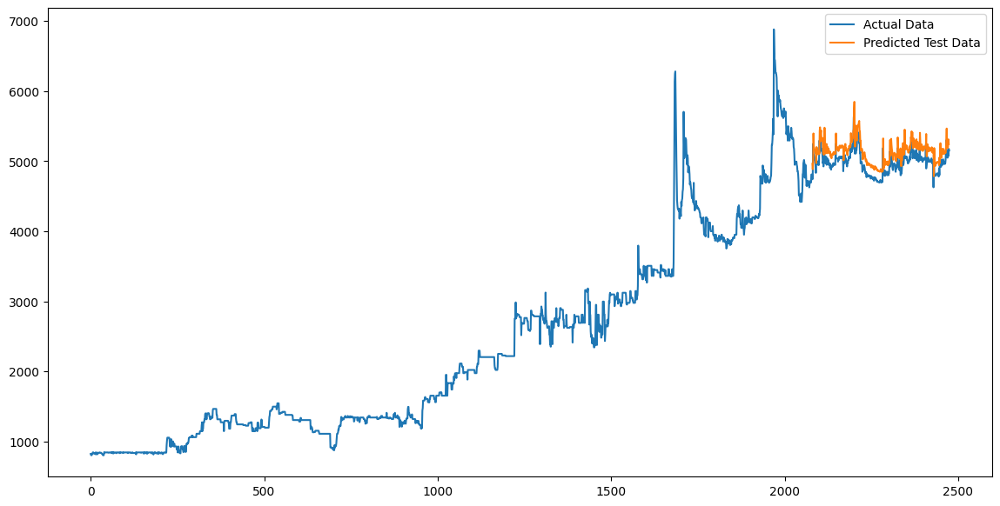

In [ ]:
# Membuat gambar (figure) dengan ukuran 14x7
plt.figure(figsize=(14, 7))
# Membuat plot garis untuk data aktual dengan label 'Actual Data'
plt.plot(mega_hist3, label='Actual Data')
# Membuat plot garis untuk data prediksi pada dengan label 'Predicted Test Data'
plt.plot(testPredictPlot_mega_gru, label='Predicted Test Data')
# Menambahkan legenda ke plot berdasarkan label-label yang telah ditentukan sebelumnya
plt.legend()
# Menampilkan plot
plt.show()

In [ ]:
# Fungsi menghitung MAPE
def mean_absolute_percentage_error(y_true, y_pred):
    y_true, y_pred = np.array(y_true), np.array(y_pred)
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100

In [ ]:
# Melihat Metric Evaluation RMSE dan MAPE
mape_gru_l6_mega = mean_absolute_percentage_error(Y_test_mega_gru,test_predict_mega_gru)
print("RMSE of gru:", np.sqrt(mean_squared_error(Y_test_mega_gru,test_predict_mega_gru)))
print("MAPE of gru:", mape_gru_l6_mega)

RMSE of gru: 183.37654279836408
MAPE of gru: 3.3372186394305494


#### Forecasting using Best Model

Hasil modeling terbaik baik dari baseline hingga Hyperparameter Tuning & Optimazation adalah Hyperparameter Tuning Using 4 Layer karena memiliki nilai RMSE (Root Mean Squared Error) terendah yaitu 100.78737972932925 dan nilai MAPE (Mean Absolute Percentage Error) terendah yaitu 1.2096643898410382. Hal ini menunjukkan bahwa model ini memiliki performa prediksi yang lebih akurat dibandingkan dengan dua model lainnya.

Dari model best tersebut akan dilakukan prediksi harga saham MEGA 30 hari ke depan menggunakan model tersebut.

In [ ]:
# Bank MEGA
# Mengonversi kolom 'date' menjadi tipe data datetime
mega_hist['Date'] = pd.to_datetime(mega_hist['Date'])
# Mengambil bagian tanggal saja dan mengatur hasilnya sebagai indeks data
mega_hist.index = mega_hist['Date'].dt.date

In [ ]:
# Mengambil kolom close
mega_hist2 = mega_hist.copy()

In [ ]:
# Train-Test Split
train_size = int(len(mega_hist2) * 0.80)
test_size = len(mega_hist2) - train_size
train_data_mega_gru, test_data_mega_gru = mega_hist2[:train_size], mega_hist2[train_size:]

In [ ]:
test_data_mega_gru.head()

,Date,Open,High,Low,Close,Volume,Dividends,Stock Splits
Date,,,,,,,,
2022-03-25,2022-03-25 00:00:00+07:00,5729.880750,5752.892319,5545.788196,5637.834473,48500,0.0,0.0
2022-03-28,2022-03-28 00:00:00+07:00,5660.845995,6144.088946,5637.834426,6006.019531,248600,0.0,0.0
2022-03-29,2022-03-29 00:00:00+07:00,6052.042904,6052.042904,5890.961914,5890.961914,173700,0.0,0.0
2022-03-30,2022-03-30 00:00:00+07:00,6052.043207,6052.043207,5890.962209,5936.985352,78500,0.0,0.0
2022-03-31,2022-03-31 00:00:00+07:00,5936.985054,5936.985054,5798.915634,5890.961914,76200,0.0,0.0


In [ ]:
# Mengasumsikan test_data_mega_gru sudah ada
df = test_data_mega_gru.copy()

# Menampilkan 5 baris pertama dari DataFrame
print("DataFrame awal:")
print(df.head())

# Menampilkan 5 baris terakhir dari DataFrame
print("\nDataFrame akhir:")
print(df.tail())

DataFrame awal:
                                Date         Open         High          Low  \
Date                                                                          
2022-03-25 2022-03-25 00:00:00+07:00  5729.880750  5752.892319  5545.788196   
2022-03-28 2022-03-28 00:00:00+07:00  5660.845995  6144.088946  5637.834426   
2022-03-29 2022-03-29 00:00:00+07:00  6052.042904  6052.042904  5890.961914   
2022-03-30 2022-03-30 00:00:00+07:00  6052.043207  6052.043207  5890.962209   
2022-03-31 2022-03-31 00:00:00+07:00  5936.985054  5936.985054  5798.915634   

                  Close  Volume  Dividends  Stock Splits  
Date                                                      
2022-03-25  5637.834473   48500        0.0           0.0  
2022-03-28  6006.019531  248600        0.0           0.0  
2022-03-29  5890.961914  173700        0.0           0.0  
2022-03-30  5936.985352   78500        0.0           0.0  
2022-03-31  5890.961914   76200        0.0           0.0  

DataFrame akhir:

DataFrame awal:
                                Date         Open         High          Low  \
Date                                                                          
2022-03-25 2022-03-25 00:00:00+07:00  5729.880750  5752.892319  5545.788196   
2022-03-28 2022-03-28 00:00:00+07:00  5660.845995  6144.088946  5637.834426   
2022-03-29 2022-03-29 00:00:00+07:00  6052.042904  6052.042904  5890.961914   
2022-03-30 2022-03-30 00:00:00+07:00  6052.043207  6052.043207  5890.962209   
2022-03-31 2022-03-31 00:00:00+07:00  5936.985054  5936.985054  5798.915634   

                  Close  Volume  Dividends  Stock Splits  
Date                                                      
2022-03-25  5637.834473   48500        0.0           0.0  
2022-03-28  6006.019531  248600        0.0           0.0  
2022-03-29  5890.961914  173700        0.0           0.0  
2022-03-30  5936.985352   78500        0.0           0.0  
2022-03-31  5890.961914   76200        0.0           0.0  

DataFrame akhir:

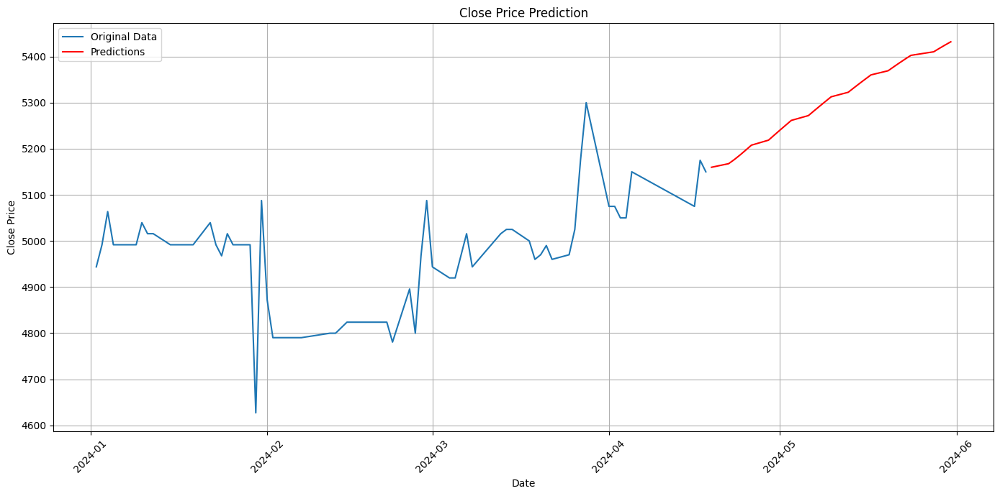

In [ ]:
df = test_data_mega_gru.copy()

# Menampilkan 5 baris pertama dari DataFrame
print("DataFrame awal:")
print(df.head())

# Menampilkan 5 baris terakhir dari DataFrame
print("\nDataFrame akhir:")
print(df.tail())

# 1. Load model
model = load_model('/content/model_mega_gru_l4.h5')

# 2. Prepare data (gunakan data dari 100 hari terakhir)
last_n_days = 100  # Menggunakan 100 hari terakhir sesuai kebutuhan model
data_to_predict = df['Close'][-last_n_days:].values

# 3. Scaling data (misalnya menggunakan MinMaxScaler)
scaler = MinMaxScaler(feature_range=(0, 1))
data_to_predict_scaled = scaler.fit_transform(data_to_predict.reshape(-1, 1))

# 4. Reshape data
data_to_predict_scaled = np.reshape(data_to_predict_scaled, (1, last_n_days, 1))

# 5. Predict multiple business days into the future, skipping weekends and holidays
n_days_to_predict = 30
predictions = []

# Get Jakarta (WIB) timezone
wib_timezone = timezone('Asia/Jakarta')

# Get NYSE calendar
nyse = mcal.get_calendar('NYSE')

# Get next business day from the last available date in the dataframe
last_date = df['Date'].iloc[-1].astimezone(wib_timezone)  # Konversi ke zona waktu Jakarta
current_date = last_date

# List to hold predicted dates
predicted_dates = []

for _ in range(n_days_to_predict):
    # Get next business day
    current_date = nyse.valid_days(start_date=current_date + pd.Timedelta(days=1), end_date=current_date + pd.Timedelta(days=30), tz='Asia/Jakarta')[0]

    # Predict only if it's a business day
    if current_date.weekday() < 5:  # Monday=0, Sunday=6
        # Predict
        predicted_scaled = model.predict(data_to_predict_scaled)
        predicted = scaler.inverse_transform(predicted_scaled)

        # Save prediction
        predictions.append(predicted[0][0])

        # Update data_to_predict_scaled for the next prediction
        data_to_predict_scaled = np.append(data_to_predict_scaled[:, 1:, :], np.reshape(predicted_scaled, (1, 1, 1)), axis=1)

        # Save predicted date
        predicted_dates.append(current_date)

# Print the predicted values
print("\nPredicted values for the next business days:")
print(predictions)

# Mendapatkan tanggal terakhir dari data asli
last_date = df['Date'].iloc[-1].astimezone(wib_timezone)  # Konversi ke zona waktu Jakarta

# Membuat DataFrame baru untuk hasil prediksi
prediction_df = pd.DataFrame({'Date': predicted_dates, 'Predicted_Close': predictions})

# Menampilkan DataFrame prediksi
print("\nPrediction DataFrame:")
print(prediction_df)

# Plotting the results
plt.figure(figsize=(14, 7))

# Plot the original data
plt.plot(df[df['Date'] > '2024-01-01']['Date'], df[df['Date'] > '2024-01-01']['Close'], label='Original Data')

# Plot the predictions
plt.plot(prediction_df['Date'], prediction_df['Predicted_Close'], label='Predictions', color='red')

# Formatting the plot
plt.xlabel('Date')
plt.ylabel('Close Price')
plt.title('Close Price Prediction')
plt.legend()
plt.grid(True)
plt.xticks(rotation=45)
plt.tight_layout()

# Display the plot
plt.show()


 Dapat disimpulkan bahwa hasil dari best model tersebut memprediksi kenaikan harga saham Bank Mega dalam 30 hari ke depan, dengan tren yang terus meningkat.

### Bank OCBC NISP (NISP)

#### Baseline Model

In [ ]:
# Mengambil kolom close
nisp_hist2 = nisp_hist['Close']

In [ ]:
# Train-Test Split
train_size = int(len(nisp_hist2) * 0.80)
test_size = len(nisp_hist2) - train_size
train_data_nisp_gru, test_data_nisp_gru = nisp_hist2[:train_size], nisp_hist2[train_size:]

# Scalling data
scaler = MinMaxScaler()
nisp_hist2 = scaler.fit_transform(np.array(nisp_hist2).reshape(-1,1))
train_data_nisp_gru = scaler.fit_transform(np.array(train_data_nisp_gru).reshape(-1, 1))
test_data_nisp_gru = scaler.transform(np.array(test_data_nisp_gru).reshape(-1, 1))

In [ ]:
def create_dataset(dataset, time_step = 1):
    dataX,dataY = [],[]
    for i in range(len(dataset)-time_step-1):
                   a = dataset[i:(i+time_step),0]
                   dataX.append(a)
                   dataY.append(dataset[i + time_step,0])
    return np.array(dataX),np.array(dataY)

In [ ]:
# Memanggil fungsi create_dataset untuk membagi data menjadi dataset input dan output dataset dengan times step 100
time_step = 100
X_train_nisp_gru,Y_train_nisp_gru =  create_dataset(train_data_nisp_gru,time_step)
X_test_nisp_gru,Y_test_nisp_gru =  create_dataset(test_data_nisp_gru,time_step)

In [ ]:
Y_train_nisp_gru

array([0.24344574, 0.2247191 , 0.2247191 , ..., 0.17602994, 0.17602994,
       0.1835206 ])

In [ ]:
# Memeriksa value
print(X_train_nisp_gru.shape)
print(X_train_nisp_gru)
print(X_test_nisp_gru.shape)
print(Y_test_nisp_gru.shape)

(1879, 100)
[[0.25842706 0.25842706 0.25842706 ... 0.26591771 0.26591771 0.24344574]
 [0.25842706 0.25842706 0.25842706 ... 0.26591771 0.24344574 0.24344574]
 [0.25842706 0.25842706 0.25842706 ... 0.24344574 0.24344574 0.2247191 ]
 ...
 [0.27340837 0.26591771 0.24344574 ... 0.17602994 0.17602994 0.17602994]
 [0.26591771 0.24344574 0.25842706 ... 0.17602994 0.17602994 0.17602994]
 [0.24344574 0.25842706 0.25842706 ... 0.17602994 0.17602994 0.17602994]]
(394, 100)
(394,)


In [ ]:
# Tetapkan seed untuk inisialisasi acak
seed_value = 42
tf.random.set_seed(seed_value)
np.random.seed(seed_value)

# Membangun model GRU
model_nisp_gru1 = tf.keras.Sequential([
      # Menambahkan layer GRU pertama dengan 50 unit dan pengembalian urutan yang digunakan untuk menjaga urutan output
      # Input_shape adalah bentuk input, yaitu jumlah langkah waktu (X_train_nisp.shape[1]) dan fitur (1)
      tf.keras.layers.GRU(50, return_sequences=True, input_shape=(X_train_nisp_gru.shape[1], 1)),
      # Menambahkan layer LSTM kedua dengan 50 unit dan pengembalian urutan untuk menjaga urutan output
      tf.keras.layers.GRU(50),
      # Menambahkan layer Dense dengan 1 unit sebagai output layer
      tf.keras.layers.Dense(1)
])
# Mengompilasi model dengan loss function 'mean_squared_error' dan optimizer 'adam'
model_nisp_gru1.compile(loss='mean_squared_error', optimizer='adam')

In [ ]:
# Melihat rangkuman model
model_nisp_gru1.summary()

Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 gru_6 (GRU)                 (None, 100, 50)           7950      
                                                                 
 gru_7 (GRU)                 (None, 50)                15300     
                                                                 
 dense_3 (Dense)             (None, 1)                 51        
                                                                 
Total params: 23301 (91.02 KB)
Trainable params: 23301 (91.02 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________


In [ ]:
# Menetapkan seed untuk TensorFlow untuk memastikan hasil yang konsisten dari operasi stokastik (jika ada)
tf.random.set_seed(seed_value)

# Melatih model menggunakan data pelatihan (X_train_bbca dan Y_train_bbca) dengan data validasi (X_test_bbca dan Y_test_bbca)
# Epochs adalah jumlah kali seluruh dataset akan diberikan kepada model selama proses pelatihan
# Batch_size adalah jumlah sampel data yang akan diproses sebelum pembaharuan bobot model
# verbose = 1 menghasilkan output detail pada setiap epoch selama pelatihan
model_nisp_gru1.fit(X_train_nisp_gru, Y_train_nisp_gru, validation_data=(X_test_nisp_gru, Y_test_nisp_gru), epochs=50, batch_size=64, verbose=1)
model_nisp_gru1.save("model_gru_gru1.h5")

Epoch 1/50
30/30 [==============================] - 8s 191ms/step - loss: 0.0098 - val_loss: 0.0146
Epoch 2/50
30/30 [==============================] - 5s 154ms/step - loss: 0.0033 - val_loss: 0.0056
Epoch 3/50
30/30 [==============================] - 3s 111ms/step - loss: 0.0024 - val_loss: 0.0033
Epoch 4/50
30/30 [==============================] - 3s 110ms/step - loss: 0.0023 - val_loss: 0.0027
Epoch 5/50
30/30 [==============================] - 4s 144ms/step - loss: 0.0022 - val_loss: 0.0027
Epoch 6/50
30/30 [==============================] - 5s 153ms/step - loss: 0.0022 - val_loss: 0.0024
Epoch 7/50
30/30 [==============================] - 3s 113ms/step - loss: 0.0020 - val_loss: 0.0019
Epoch 8/50
30/30 [==============================] - 3s 112ms/step - loss: 0.0020 - val_loss: 0.0021
Epoch 9/50
30/30 [==============================] - 4s 141ms/step - loss: 0.0019 - val_loss: 0.0022
Epoch 10/50
30/30 [==============================] - 5s 155ms/step - loss: 0.0019 - val_loss: 0.0022

In [ ]:
# Memprediksi data menggunakan model yang telah dilatih
train_predict_nisp_gru = model_nisp_gru1.predict(X_train_nisp_gru)
test_predict_nisp_gru = model_nisp_gru1.predict(X_test_nisp_gru)

13/13 [==============================] - 0s 23ms/step


In [ ]:
Y_train_nisp_gru[:5]

array([0.24344574, 0.2247191 , 0.2247191 , 0.2247191 , 0.2247191 ])

In [ ]:
train_predict_nisp_gru[:5]

array([[0.24983436],
       [0.24778613],
       [0.23492539],
       [0.23260364],
       [0.2322461 ]], dtype=float32)

In [ ]:
# Transformasi data ke bentuk awal
Y_train_nisp_gru = scaler.inverse_transform(Y_train_nisp_gru.reshape(-1, 1))
Y_test_nisp_gru = scaler.inverse_transform(Y_test_nisp_gru.reshape(-1, 1))
train_predict_nisp_gru = scaler.inverse_transform(train_predict_nisp_gru)
test_predict_nisp_gru = scaler.inverse_transform(test_predict_nisp_gru)

In [ ]:
Y_test_nisp_gru[:5]

array([[632.35150146],
       [632.35150146],
       [623.50750732],
       [654.46173096],
       [663.30584717]])

In [ ]:
test_predict_nisp_gru[:5]

array([[630.6277 ],
       [628.9997 ],
       [628.74695],
       [623.03687],
       [644.6078 ]], dtype=float32)

In [ ]:
# Mendefinisikan jumlah langkah waktu sebelumnya yang akan digunakan sebagai input untuk memprediksi langkah waktu saat ini
look_back = 100

# Membuat array kosong dengan ukuran yang sama dengan bbca_hist2
trainPredictPlot_nisp = np.empty_like(nisp_hist2)
# Mengisi array dengan nilai yang sama dengan NaN (untuk plot)
trainPredictPlot_nisp[:,:] = np.nan
# Mengisi bagian dari array dengan hasil prediksi pada data pelatihan
# Menempatkan hasil prediksi pada posisi yang sesuai dalam array untuk plotting
trainPredictPlot_nisp[look_back : len(train_predict_nisp_gru)+look_back,:] = train_predict_nisp_gru

# Membuat array kosong dengan ukuran yang sama dengan bbca_hist2
testPredictPlot_nisp_gru = np.empty_like(nisp_hist2)
# Mengisi array dengan nilai yang sama dengan NaN (untuk plot)
testPredictPlot_nisp_gru[:,:] = np.nan
# Mengisi bagian dari array dengan hasil prediksi pada data uji
# Menempatkan hasil prediksi pada posisi yang sesuai dalam array untuk plotting
testPredictPlot_nisp_gru[len(train_predict_nisp_gru) + (look_back) * 2 + 1 : len(nisp_hist2) - 1, :] = test_predict_nisp_gru

In [ ]:
# Mengambil data harga saham close dan dijadikan dalam bentuk array numpy
nisp_hist3=nisp_hist['Close'].to_numpy()

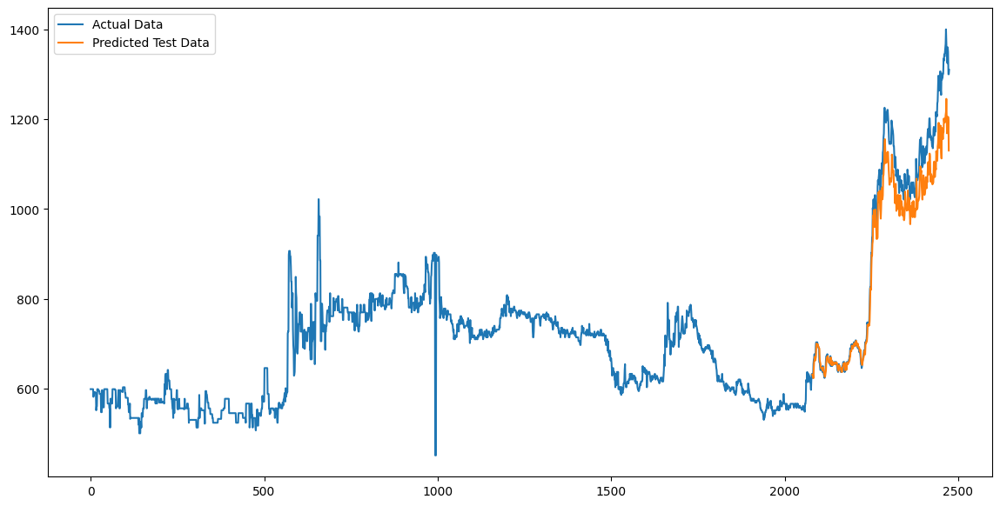

In [ ]:
# Membuat gambar (figure) dengan ukuran 14x7
plt.figure(figsize=(14, 7))
# Membuat plot garis untuk data aktual dengan label 'Actual Data'
plt.plot(nisp_hist3, label='Actual Data')
# Membuat plot garis untuk data prediksi pada dengan label 'Predicted Test Data'
plt.plot(testPredictPlot_nisp_gru, label='Predicted Test Data')
# Menambahkan legenda ke plot berdasarkan label-label yang telah ditentukan sebelumnya
plt.legend()
# Menampilkan plot
plt.show()

In [ ]:
# Fungsi menghitung MAPE
def mean_absolute_percentage_error(y_true, y_pred):
    y_true, y_pred = np.array(y_true), np.array(y_pred)
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100

In [ ]:
# Melihat Metric Evaluation RMSE dan MAPE
mape_gru1_nisp = mean_absolute_percentage_error(Y_test_nisp_gru,test_predict_nisp_gru)
print("RMSE of GRU:", np.sqrt(mean_squared_error(Y_test_nisp_gru,test_predict_nisp_gru)))
print("MAPE of GRU:", mape_gru1_nisp)

RMSE of GRU: 63.03907292620058
MAPE of GRU: 4.093177896444668


#### Hyperparameter Tuning & Optimization Using 4 Layer - Best Model

In [ ]:
# Mengambil kolom close
nisp_hist2 = nisp_hist['Close']

In [ ]:
# Train-Test Split
train_size = int(len(nisp_hist2) * 0.80)
test_size = len(nisp_hist2) - train_size
train_data_nisp_gru, test_data_nisp_gru = nisp_hist2[:train_size], nisp_hist2[train_size:]

# Scalling data
scaler = MinMaxScaler()
nisp_hist2 = scaler.fit_transform(np.array(nisp_hist2).reshape(-1,1))
train_data_nisp_gru = scaler.fit_transform(np.array(train_data_nisp_gru).reshape(-1, 1))
test_data_nisp_gru = scaler.transform(np.array(test_data_nisp_gru).reshape(-1, 1))

In [ ]:
def create_dataset(dataset, time_step = 1):
    dataX,dataY = [],[]
    for i in range(len(dataset)-time_step-1):
                   a = dataset[i:(i+time_step),0]
                   dataX.append(a)
                   dataY.append(dataset[i + time_step,0])
    return np.array(dataX),np.array(dataY)

In [ ]:
# Memanggil fungsi create_dataset untuk membagi data menjadi dataset input dan output dataset dengan times step 100
time_step = 100
X_train_nisp_gru,Y_train_nisp_gru =  create_dataset(train_data_nisp_gru,time_step)
X_test_nisp_gru,Y_test_nisp_gru =  create_dataset(test_data_nisp_gru,time_step)

In [ ]:
Y_train_nisp_gru

array([0.24344574, 0.2247191 , 0.2247191 , ..., 0.17602994, 0.17602994,
       0.1835206 ])

In [ ]:
# Memeriksa value
print(X_train_nisp_gru.shape)
print(X_train_nisp_gru)
print(X_test_nisp_gru.shape)
print(Y_test_nisp_gru.shape)

(1879, 100)
[[0.25842706 0.25842706 0.25842706 ... 0.26591771 0.26591771 0.24344574]
 [0.25842706 0.25842706 0.25842706 ... 0.26591771 0.24344574 0.24344574]
 [0.25842706 0.25842706 0.25842706 ... 0.24344574 0.24344574 0.2247191 ]
 ...
 [0.27340837 0.26591771 0.24344574 ... 0.17602994 0.17602994 0.17602994]
 [0.26591771 0.24344574 0.25842706 ... 0.17602994 0.17602994 0.17602994]
 [0.24344574 0.25842706 0.25842706 ... 0.17602994 0.17602994 0.17602994]]
(394, 100)
(394,)


In [ ]:
# Tetapkan seed untuk inisialisasi acak
seed_value = 42
tf.random.set_seed(seed_value)
np.random.seed(seed_value)

# Definisikan fungsi untuk membuat model GRU dengan hyperparameter
def build_model_l4(hp):
    model = tf.keras.Sequential()
    model.add(tf.keras.layers.GRU(
        units=hp.Int('units_1', min_value=50, max_value=200, step=50),
        return_sequences=True,
        input_shape=(X_train_nisp_gru.shape[1], 1)
    ))
    model.add(tf.keras.layers.GRU(
        units=hp.Int('units_2', min_value=50, max_value=200, step=50),
        return_sequences=True
    ))
    model.add(tf.keras.layers.GRU(
        units=hp.Int('units_3', min_value=50, max_value=200, step=50)
    ))
    model.add(tf.keras.layers.Dense(1))

    model.compile(
        optimizer=tf.keras.optimizers.Adam(
            hp.Choice('learning_rate', values=[1e-2, 1e-3, 1e-4])
        ),
        loss='mean_squared_error'
    )
    return model

In [ ]:
# Atur pencarian hyperparameter menggunakan RandomSearch
tuner = RandomSearch(
    build_model_l4,
    objective='val_loss',
    max_trials=10,  # Jumlah percobaan untuk menemukan kombinasi hyperparameter terbaik
    executions_per_trial=1,  # Jumlah eksekusi per percobaan untuk akurasi lebih baik
    directory='hyperparameter_tuning_l4_nisp',
    project_name='gru_tuning_l4_nisp'
)

# Tentukan data pelatihan dan validasi
tuner.search(X_train_nisp_gru, Y_train_nisp_gru, validation_data=(X_test_nisp_gru, Y_test_nisp_gru), epochs=30, batch_size=64, verbose=1)

# Mendapatkan hasil terbaik
best_hps_l4 = tuner.get_best_hyperparameters(num_trials=1)[0]

# Membangun model dengan hyperparameter terbaik
model_nisp_gru_l4 = build_model_l4(best_hps_l4)

Trial 10 Complete [00h 06m 29s]
val_loss: 0.0030308670829981565

Best val_loss So Far: 0.0011965354206040502
Total elapsed time: 01h 28m 51s


In [ ]:
print(best_hps_l4)

In [ ]:
# Melihat rangkuman model
model_nisp_gru_l4.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 gru_3 (GRU)                 (None, 100, 200)          121800    
                                                                 
 gru_4 (GRU)                 (None, 100, 150)          158400    
                                                                 
 gru_5 (GRU)                 (None, 150)               135900    
                                                                 
 dense_1 (Dense)             (None, 1)                 151       
                                                                 
Total params: 416251 (1.59 MB)
Trainable params: 416251 (1.59 MB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________


In [ ]:
# Menetapkan seed untuk TensorFlow untuk memastikan hasil yang konsisten dari operasi stokastik (jika ada)
tf.random.set_seed(seed_value)

# Melatih model menggunakan data pelatihan (X_train_bbtn dan Y_train_bbtn) dengan data validasi (X_test_bbtn dan Y_test_bbtn)
# Epochs adalah jumlah kali seluruh dataset akan diberikan kepada model selama proses pelatihan
# Batch_size adalah jumlah sampel data yang akan diproses sebelum pembaharuan bobot model
# verbose = 1 menghasilkan output detail pada setiap epoch selama pelatihan
model_nisp_gru_l4.fit(X_train_nisp_gru, Y_train_nisp_gru, validation_data=(X_test_nisp_gru, Y_test_nisp_gru), epochs=50, batch_size=64, verbose=1)
model_nisp_gru_l4.save("model_nisp_gru_l4.h5")

Epoch 1/50
30/30 [==============================] - 36s 975ms/step - loss: 0.0217 - val_loss: 0.0036
Epoch 2/50
30/30 [==============================] - 25s 834ms/step - loss: 0.0036 - val_loss: 0.0037
Epoch 3/50
30/30 [==============================] - 28s 935ms/step - loss: 0.0027 - val_loss: 0.0028
Epoch 4/50
30/30 [==============================] - 29s 985ms/step - loss: 0.0024 - val_loss: 0.0020
Epoch 5/50
30/30 [==============================] - 29s 979ms/step - loss: 0.0024 - val_loss: 0.0022
Epoch 6/50
30/30 [==============================] - 28s 943ms/step - loss: 0.0023 - val_loss: 0.0020
Epoch 7/50
30/30 [==============================] - 26s 890ms/step - loss: 0.0020 - val_loss: 0.0036
Epoch 8/50
30/30 [==============================] - 27s 879ms/step - loss: 0.0019 - val_loss: 0.0032
Epoch 9/50
30/30 [==============================] - 28s 939ms/step - loss: 0.0018 - val_loss: 0.0056
Epoch 10/50
30/30 [==============================] - 28s 931ms/step - loss: 0.0017 - val_lo

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


In [ ]:
# Memprediksi data menggunakan model yang telah dilatih
train_predict_nisp_gru = model_nisp_gru_l4.predict(X_train_nisp_gru)
test_predict_nisp_gru = model_nisp_gru_l4.predict(X_test_nisp_gru)

13/13 [==============================] - 2s 160ms/step


In [ ]:
Y_train_nisp_gru[:5]

array([0.24344574, 0.2247191 , 0.2247191 , 0.2247191 , 0.2247191 ])

In [ ]:
train_predict_nisp_gru[:5]

array([[0.25968942],
       [0.25418085],
       [0.24290656],
       [0.23898864],
       [0.2388496 ]], dtype=float32)

In [ ]:
# Transformasi data ke bentuk awal
Y_train_nisp_gru = scaler.inverse_transform(Y_train_nisp_gru.reshape(-1, 1))
Y_test_nisp_gru = scaler.inverse_transform(Y_test_nisp_gru.reshape(-1, 1))
train_predict_nisp_gru = scaler.inverse_transform(train_predict_nisp_gru)
test_predict_nisp_gru = scaler.inverse_transform(test_predict_nisp_gru)

In [ ]:
Y_test_nisp_gru[:5]

array([[632.35150146],
       [632.35150146],
       [623.50750732],
       [654.46173096],
       [663.30584717]])

In [ ]:
test_predict_nisp_gru[:5]

array([[637.7398 ],
       [634.90985],
       [634.7528 ],
       [629.93805],
       [651.70886]], dtype=float32)

In [ ]:
# Mendefinisikan jumlah langkah waktu sebelumnya yang akan digunakan sebagai input untuk memprediksi langkah waktu saat ini
look_back = 100

# Membuat array kosong dengan ukuran yang sama dengan bbtn_hist2
trainPredictPlot_nisp = np.empty_like(nisp_hist2)
# Mengisi array dengan nilai yang sama dengan NaN (untuk plot)
trainPredictPlot_nisp[:,:] = np.nan
# Mengisi bagian dari array dengan hasil prediksi pada data pelatihan
# Menempatkan hasil prediksi pada posisi yang sesuai dalam array untuk plotting
trainPredictPlot_nisp[look_back : len(train_predict_nisp_gru)+look_back,:] = train_predict_nisp_gru

# Membuat array kosong dengan ukuran yang sama dengan bbtn_hist2
testPredictPlot_nisp_gru = np.empty_like(nisp_hist2)
# Mengisi array dengan nilai yang sama dengan NaN (untuk plot)
testPredictPlot_nisp_gru[:,:] = np.nan
# Mengisi bagian dari array dengan hasil prediksi pada data uji
# Menempatkan hasil prediksi pada posisi yang sesuai dalam array untuk plotting
testPredictPlot_nisp_gru[len(train_predict_nisp_gru) + (look_back) * 2 + 1 : len(nisp_hist2) - 1, :] = test_predict_nisp_gru

In [ ]:
# Mengambil data harga saham close dan dijadikan dalam bentuk array numpy
nisp_hist3=nisp_hist['Close'].to_numpy()

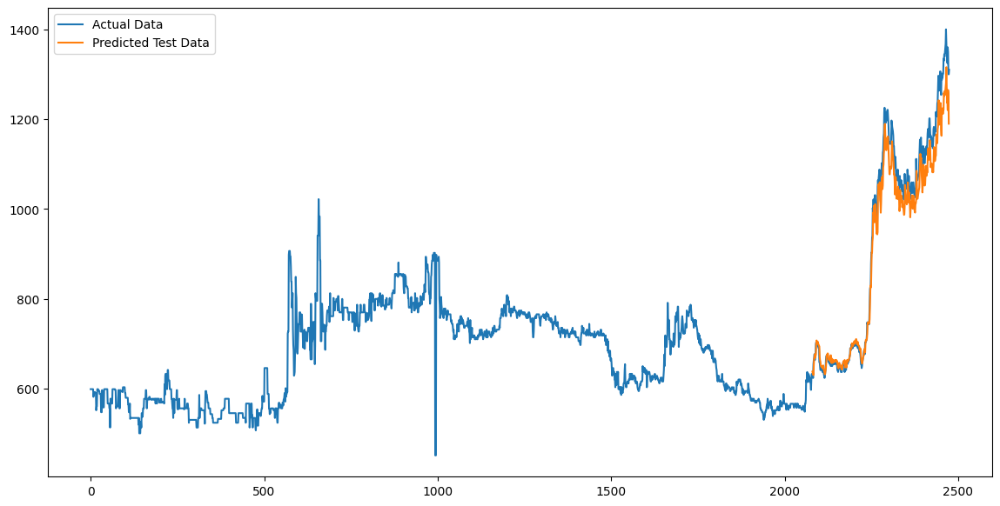

In [ ]:
# Membuat gambar (figure) dengan ukuran 14x7
plt.figure(figsize=(14, 7))
# Membuat plot garis untuk data aktual dengan label 'Actual Data'
plt.plot(nisp_hist3, label='Actual Data')
# Membuat plot garis untuk data prediksi pada dengan label 'Predicted Test Data'
plt.plot(testPredictPlot_nisp_gru, label='Predicted Test Data')
# Menambahkan legenda ke plot berdasarkan label-label yang telah ditentukan sebelumnya
plt.legend()
# Menampilkan plot
plt.show()

In [ ]:
# Fungsi menghitung MAPE
def mean_absolute_percentage_error(y_true, y_pred):
    y_true, y_pred = np.array(y_true), np.array(y_pred)
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100

In [ ]:
# Melihat Metric Evaluation RMSE dan MAPE
mape_gru_l4_nisp = mean_absolute_percentage_error(Y_test_nisp_gru,test_predict_nisp_gru)
print("RMSE of gru:", np.sqrt(mean_squared_error(Y_test_nisp_gru,test_predict_nisp_gru)))
print("MAPE of gru:", mape_gru_l4_nisp)

RMSE of gru: 42.16434008350971
MAPE of gru: 2.884840236281357


#### Hyperparameter Tuning & Optimization Using 6 Layer - Worst Model

In [ ]:
# Mengambil kolom close
nisp_hist2 = nisp_hist['Close']

In [ ]:
# Train-Test Split
train_size = int(len(nisp_hist2) * 0.80)
test_size = len(nisp_hist2) - train_size
train_data_nisp_gru, test_data_nisp_gru = nisp_hist2[:train_size], nisp_hist2[train_size:]

# Scalling data
scaler = MinMaxScaler()
nisp_hist2 = scaler.fit_transform(np.array(nisp_hist2).reshape(-1,1))
train_data_nisp_gru = scaler.fit_transform(np.array(train_data_nisp_gru).reshape(-1, 1))
test_data_nisp_gru = scaler.transform(np.array(test_data_nisp_gru).reshape(-1, 1))

In [ ]:
def create_dataset(dataset, time_step = 1):
    dataX,dataY = [],[]
    for i in range(len(dataset)-time_step-1):
                   a = dataset[i:(i+time_step),0]
                   dataX.append(a)
                   dataY.append(dataset[i + time_step,0])
    return np.array(dataX),np.array(dataY)

In [ ]:
# Memanggil fungsi create_dataset untuk membagi data menjadi dataset input dan output dataset dengan times step 100
time_step = 100
X_train_nisp_gru,Y_train_nisp_gru =  create_dataset(train_data_nisp_gru,time_step)
X_test_nisp_gru,Y_test_nisp_gru =  create_dataset(test_data_nisp_gru,time_step)

In [ ]:
Y_train_nisp_gru

array([0.24344574, 0.2247191 , 0.2247191 , ..., 0.17602994, 0.17602994,
       0.1835206 ])

In [ ]:
# Memeriksa value
print(X_train_nisp_gru.shape)
print(X_train_nisp_gru)
print(X_test_nisp_gru.shape)
print(Y_test_nisp_gru.shape)

(1879, 100)
[[0.25842706 0.25842706 0.25842706 ... 0.26591771 0.26591771 0.24344574]
 [0.25842706 0.25842706 0.25842706 ... 0.26591771 0.24344574 0.24344574]
 [0.25842706 0.25842706 0.25842706 ... 0.24344574 0.24344574 0.2247191 ]
 ...
 [0.27340837 0.26591771 0.24344574 ... 0.17602994 0.17602994 0.17602994]
 [0.26591771 0.24344574 0.25842706 ... 0.17602994 0.17602994 0.17602994]
 [0.24344574 0.25842706 0.25842706 ... 0.17602994 0.17602994 0.17602994]]
(394, 100)
(394,)


In [ ]:
# Tetapkan seed untuk inisialisasi acak
seed_value = 42
tf.random.set_seed(seed_value)
np.random.seed(seed_value)

# Definisikan fungsi untuk membuat model GRU dengan hyperparameter
def build_model_l6(hp):
    model = tf.keras.Sequential()
    model.add(tf.keras.layers.GRU(
        units=hp.Int('units_1', min_value=50, max_value=200, step=50),
        return_sequences=True,
        input_shape=(X_train_nisp_gru.shape[1], 1)
    ))
    model.add(tf.keras.layers.GRU(
        units=hp.Int('units_2', min_value=50, max_value=200, step=50),
        return_sequences=True
    ))
    model.add(tf.keras.layers.GRU(
        units=hp.Int('units_3', min_value=50, max_value=200, step=50),
        return_sequences=True
    ))
    model.add(tf.keras.layers.GRU(
        units=hp.Int('units_4', min_value=50, max_value=200, step=50),
        return_sequences=True
    ))
    model.add(tf.keras.layers.GRU(
        units=hp.Int('units_5', min_value=50, max_value=200, step=50)
    ))
    model.add(tf.keras.layers.Dense(1))

    model.compile(
        optimizer=tf.keras.optimizers.Adam(
            hp.Choice('learning_rate', values=[1e-2, 1e-3, 1e-4])
        ),
        loss='mean_squared_error'
    )
    return model

In [ ]:
# Atur pencarian hyperparameter menggunakan RandomSearch
tuner = RandomSearch(
    build_model_l6,
    objective='val_loss',
    max_trials=10,  # Jumlah percobaan untuk menemukan kombinasi hyperparameter terbaik
    executions_per_trial=1,  # Jumlah eksekusi per percobaan untuk akurasi lebih baik
    directory='hyperparameter_tuning_l6_nisp',
    project_name='gru_tuning_l6_nisp'
)

# Tentukan data pelatihan dan validasi
tuner.search(X_train_nisp_gru, Y_train_nisp_gru, validation_data=(X_test_nisp_gru, Y_test_nisp_gru), epochs=30, batch_size=64, verbose=1)

# Mendapatkan hasil terbaik
best_hps_l6 = tuner.get_best_hyperparameters(num_trials=1)[0]

# Membangun model dengan hyperparameter terbaik
model_nisp_gru_l6 = build_model_l6(best_hps_l6)

Trial 10 Complete [00h 18m 37s]
val_loss: 0.003420840250328183

Best val_loss So Far: 0.003420840250328183
Total elapsed time: 02h 54m 24s


In [ ]:
print(best_hps_l6)

In [ ]:
# Melihat rangkuman model
model_nisp_gru_l6.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 gru_5 (GRU)                 (None, 100, 200)          121800    
                                                                 
 gru_6 (GRU)                 (None, 100, 50)           37800     
                                                                 
 gru_7 (GRU)                 (None, 100, 100)          45600     
                                                                 
 gru_8 (GRU)                 (None, 100, 150)          113400    
                                                                 
 gru_9 (GRU)                 (None, 150)               135900    
                                                                 
 dense_1 (Dense)             (None, 1)                 151       
                                                                 
Total params: 454651 (1.73 MB)
Trainable params: 45465

In [ ]:
# Menetapkan seed untuk TensorFlow untuk memastikan hasil yang konsisten dari operasi stokastik (jika ada)
tf.random.set_seed(seed_value)

# Melatih model menggunakan data pelatihan (X_train_nisp dan Y_train_nisp) dengan data validasi (X_test_nisp dan Y_test_bbri)
# Epochs adalah jumlah kali seluruh dataset akan diberikan kepada model selama proses pelatihan
# Batch_size adalah jumlah sampel data yang akan diproses sebelum pembaharuan bobot model
# verbose = 1 menghasilkan output detail pada setiap epoch selama pelatihan
model_nisp_gru_l6.fit(X_train_nisp_gru, Y_train_nisp_gru, validation_data=(X_test_nisp_gru, Y_test_nisp_gru), epochs=50, batch_size=64, verbose=1)
model_nisp_gru_l6.save("model_nisp_gru_l6.h5")

Epoch 1/50
30/30 [==============================] - 47s 1s/step - loss: 3.8845 - val_loss: 0.2945
Epoch 2/50
30/30 [==============================] - 35s 1s/step - loss: 0.0346 - val_loss: 0.0658
Epoch 3/50
30/30 [==============================] - 39s 1s/step - loss: 0.0048 - val_loss: 8.5065e-04
Epoch 4/50
30/30 [==============================] - 36s 1s/step - loss: 0.0013 - val_loss: 3.8873e-04
Epoch 5/50
30/30 [==============================] - 38s 1s/step - loss: 7.4135e-04 - val_loss: 3.3567e-04
Epoch 6/50
30/30 [==============================] - 35s 1s/step - loss: 0.0020 - val_loss: 0.0011
Epoch 7/50
30/30 [==============================] - 36s 1s/step - loss: 0.0040 - val_loss: 9.0480e-04
Epoch 8/50
30/30 [==============================] - 37s 1s/step - loss: 0.0014 - val_loss: 0.0014
Epoch 9/50
30/30 [==============================] - 35s 1s/step - loss: 9.9473e-04 - val_loss: 6.1829e-04
Epoch 10/50
30/30 [==============================] - 37s 1s/step - loss: 8.8554e-04 - val_

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


In [ ]:
# Memprediksi data menggunakan model yang telah dilatih
train_predict_nisp_gru = model_nisp_gru_l6.predict(X_train_nisp_gru)
test_predict_nisp_gru = model_nisp_gru_l6.predict(X_test_nisp_gru)

13/13 [==============================] - 2s 188ms/step


In [ ]:
Y_train_nisp_gru[:5]

array([0.24344574, 0.2247191 , 0.2247191 , 0.2247191 , 0.2247191 ])

In [ ]:
train_predict_nisp_gru[:5]

array([[0.26733863],
       [0.2606141 ],
       [0.2515861 ],
       [0.24351574],
       [0.23852652]], dtype=float32)

In [ ]:
# Transformasi data ke bentuk awal
Y_train_nisp_gru = scaler.inverse_transform(Y_train_nisp_gru.reshape(-1, 1))
Y_test_nisp_gru = scaler.inverse_transform(Y_test_nisp_gru.reshape(-1, 1))
train_predict_nisp_gru = scaler.inverse_transform(train_predict_nisp_gru)
test_predict_nisp_gru = scaler.inverse_transform(test_predict_nisp_gru)

In [ ]:
Y_test_nisp_gru[:5]

array([[632.35150146],
       [632.35150146],
       [623.50750732],
       [654.46173096],
       [663.30584717]])

In [ ]:
test_predict_nisp_gru[:5]

array([[629.70087],
       [635.1912 ],
       [637.467  ],
       [635.56085],
       [639.7493 ]], dtype=float32)

In [ ]:
# Mendefinisikan jumlah langkah waktu sebelumnya yang akan digunakan sebagai input untuk memprediksi langkah waktu saat ini
look_back = 100

# Membuat array kosong dengan ukuran yang sama dengan bbtn_hist2
trainPredictPlot_nisp = np.empty_like(nisp_hist2)
# Mengisi array dengan nilai yang sama dengan NaN (untuk plot)
trainPredictPlot_nisp[:,:] = np.nan
# Mengisi bagian dari array dengan hasil prediksi pada data pelatihan
# Menempatkan hasil prediksi pada posisi yang sesuai dalam array untuk plotting
trainPredictPlot_nisp[look_back : len(train_predict_nisp_gru)+look_back,:] = train_predict_nisp_gru

# Membuat array kosong dengan ukuran yang sama dengan bbtn_hist2
testPredictPlot_nisp_gru = np.empty_like(nisp_hist2)
# Mengisi array dengan nilai yang sama dengan NaN (untuk plot)
testPredictPlot_nisp_gru[:,:] = np.nan
# Mengisi bagian dari array dengan hasil prediksi pada data uji
# Menempatkan hasil prediksi pada posisi yang sesuai dalam array untuk plotting
testPredictPlot_nisp_gru[len(train_predict_nisp_gru) + (look_back) * 2 + 1 : len(nisp_hist2) - 1, :] = test_predict_nisp_gru

In [ ]:
# Mengambil data harga saham close dan dijadikan dalam bentuk array numpy
nisp_hist3=nisp_hist['Close'].to_numpy()

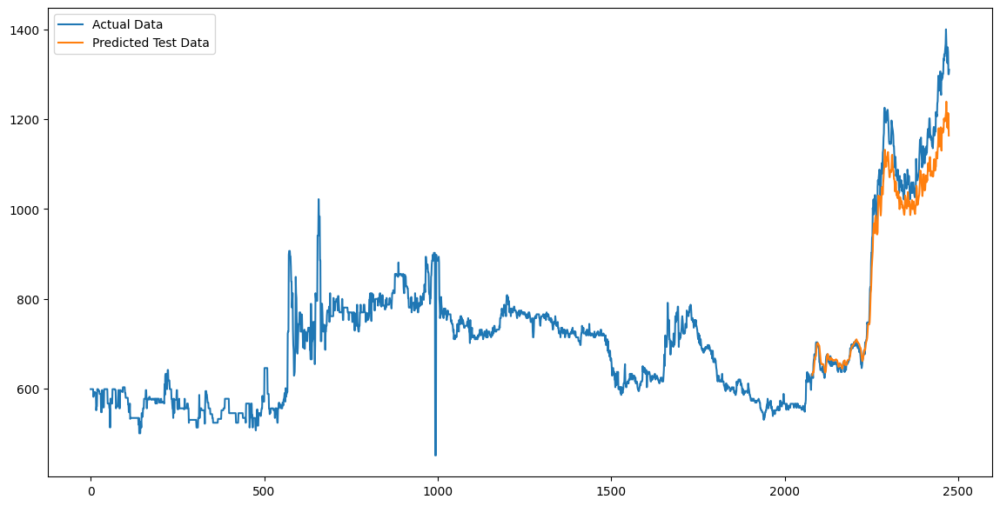

In [ ]:
# Membuat gambar (figure) dengan ukuran 14x7
plt.figure(figsize=(14, 7))
# Membuat plot garis untuk data aktual dengan label 'Actual Data'
plt.plot(nisp_hist3, label='Actual Data')
# Membuat plot garis untuk data prediksi pada dengan label 'Predicted Test Data'
plt.plot(testPredictPlot_nisp_gru, label='Predicted Test Data')
# Menambahkan legenda ke plot berdasarkan label-label yang telah ditentukan sebelumnya
plt.legend()
# Menampilkan plot
plt.show()

In [ ]:
# Fungsi menghitung MAPE
def mean_absolute_percentage_error(y_true, y_pred):
    y_true, y_pred = np.array(y_true), np.array(y_pred)
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100

In [ ]:
# Melihat Metric Evaluation RMSE dan MAPE
mape_gru_l6_nisp = mean_absolute_percentage_error(Y_test_nisp_gru,test_predict_nisp_gru)
print("RMSE of gru:", np.sqrt(mean_squared_error(Y_test_nisp_gru,test_predict_nisp_gru)))
print("MAPE of gru:", mape_gru_l6_nisp)

RMSE of gru: 60.647990616232086
MAPE of gru: 4.113921505787807


#### Forecasting using Best Model

Model terbaik untuk prediksi harga saham Bank NISP adalah Hyperparameter Tuning Using 4 Layer dengan nilai RMSE terendah yaitu 42.16434008350971 dan nilai MAPE terendah yaitu 2.884840236281357. Hal ini menunjukkan bahwa model ini lebih akurat dalam memprediksi banding dengan dua model lainnya, yaitu Baseline Model Layer 3 dan Hyperparameter Tuning using 6 layer.

Dari model best tersebut akan dilakukan prediksi harga saham NISP 30 hari ke depan menggunakan model tersebut.

In [ ]:
# Bank NISP
# Mengonversi kolom 'date' menjadi tipe data datetime
nisp_hist['Date'] = pd.to_datetime(nisp_hist['Date'])
# Mengambil bagian tanggal saja dan mengatur hasilnya sebagai indeks data
nisp_hist.index = nisp_hist['Date'].dt.date

In [ ]:
# Mengambil kolom close
nisp_hist2 = nisp_hist.copy()

In [ ]:
# Train-Test Split
train_size = int(len(nisp_hist2) * 0.80)
test_size = len(nisp_hist2) - train_size
train_data_nisp_gru, test_data_nisp_gru = nisp_hist2[:train_size], nisp_hist2[train_size:]

# Scalling data
# scaler = MinMaxScaler()
# bbtn_hist2 = scaler.fit_transform(np.array(nisp_hist2).reshape(-1,1))
# train_data_nisp_gru = scaler.fit_transform(np.array(train_data_nisp_gru).reshape(-1, 1))
# test_data_nisp_gru = scaler.transform(np.array(test_data_nisp_gru).reshape(-1, 1))

In [ ]:
test_data_nisp_gru.head()

,Date,Open,High,Low,Close,Volume,Dividends,Stock Splits
Date,,,,,,,,
2022-03-25,2022-03-25 00:00:00+07:00,551.571189,560.122681,551.571189,560.122681,611800,0.0,0.0
2022-03-28,2022-03-28 00:00:00+07:00,560.122681,560.122681,555.846935,560.122681,4398700,0.0,0.0
2022-03-29,2022-03-29 00:00:00+07:00,555.846912,560.122658,551.571167,551.571167,5197300,0.0,0.0
2022-03-30,2022-03-30 00:00:00+07:00,551.571178,560.122669,551.571178,555.846924,1123000,0.0,0.0
2022-03-31,2022-03-31 00:00:00+07:00,560.122669,560.122669,547.295433,555.846924,1461600,0.0,0.0


DataFrame awal:
                                Date        Open        High         Low  \
Date                                                                       
2022-03-25 2022-03-25 00:00:00+07:00  551.571189  560.122681  551.571189   
2022-03-28 2022-03-28 00:00:00+07:00  560.122681  560.122681  555.846935   
2022-03-29 2022-03-29 00:00:00+07:00  555.846912  560.122658  551.571167   
2022-03-30 2022-03-30 00:00:00+07:00  551.571178  560.122669  551.571178   
2022-03-31 2022-03-31 00:00:00+07:00  560.122669  560.122669  547.295433   

                 Close   Volume  Dividends  Stock Splits  
Date                                                      
2022-03-25  560.122681   611800        0.0           0.0  
2022-03-28  560.122681  4398700        0.0           0.0  
2022-03-29  551.571167  5197300        0.0           0.0  
2022-03-30  555.846924  1123000        0.0           0.0  
2022-03-31  555.846924  1461600        0.0           0.0  

DataFrame akhir:
                    

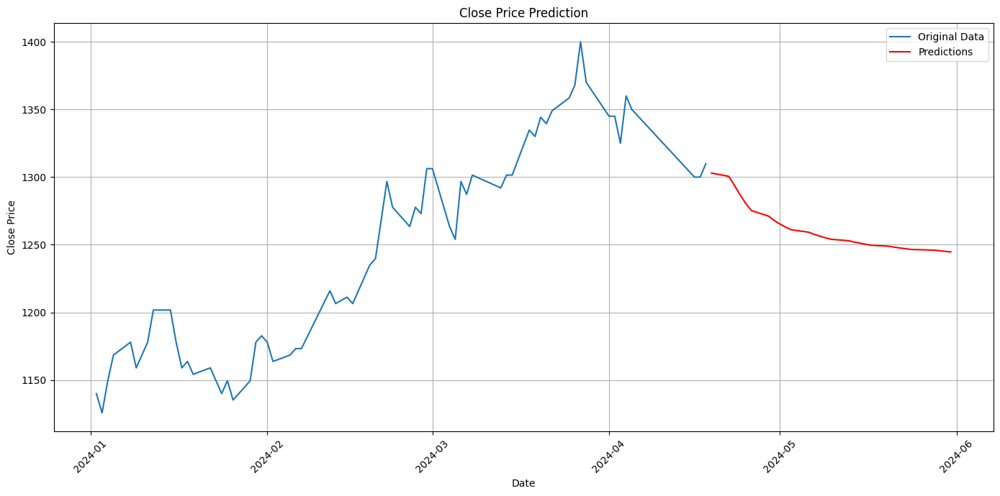

In [ ]:
df = test_data_nisp_gru.copy()

# Menampilkan 5 baris pertama dari DataFrame
print("DataFrame awal:")
print(df.head())

# Menampilkan 5 baris terakhir dari DataFrame
print("\nDataFrame akhir:")
print(df.tail())

# 1. Load model
model = load_model('/content/model_nisp_gru_l4.h5')

# 2. Prepare data (gunakan data dari 100 hari terakhir)
last_n_days = 100  # Menggunakan 100 hari terakhir sesuai kebutuhan model
data_to_predict = df['Close'][-last_n_days:].values

# 3. Scaling data (misalnya menggunakan MinMaxScaler)
scaler = MinMaxScaler(feature_range=(0, 1))
data_to_predict_scaled = scaler.fit_transform(data_to_predict.reshape(-1, 1))

# 4. Reshape data
data_to_predict_scaled = np.reshape(data_to_predict_scaled, (1, last_n_days, 1))

# 5. Predict multiple business days into the future, skipping weekends and holidays
n_days_to_predict = 30
predictions = []

# Get Jakarta (WIB) timezone
wib_timezone = timezone('Asia/Jakarta')

# Get NYSE calendar
nyse = mcal.get_calendar('NYSE')

# Get next business day from the last available date in the dataframe
last_date = df['Date'].iloc[-1].astimezone(wib_timezone)  # Konversi ke zona waktu Jakarta
current_date = last_date

# List to hold predicted dates
predicted_dates = []

for _ in range(n_days_to_predict):
    # Get next business day
    current_date = nyse.valid_days(start_date=current_date + pd.Timedelta(days=1), end_date=current_date + pd.Timedelta(days=30), tz='Asia/Jakarta')[0]

    # Predict only if it's a business day
    if current_date.weekday() < 5:  # Monday=0, Sunday=6
        # Predict
        predicted_scaled = model.predict(data_to_predict_scaled)
        predicted = scaler.inverse_transform(predicted_scaled)

        # Save prediction
        predictions.append(predicted[0][0])

        # Update data_to_predict_scaled for the next prediction
        data_to_predict_scaled = np.append(data_to_predict_scaled[:, 1:, :], np.reshape(predicted_scaled, (1, 1, 1)), axis=1)

        # Save predicted date
        predicted_dates.append(current_date)

# Print the predicted values
print("\nPredicted values for the next business days:")
print(predictions)

# Mendapatkan tanggal terakhir dari data asli
last_date = df['Date'].iloc[-1].astimezone(wib_timezone)  # Konversi ke zona waktu Jakarta

# Membuat DataFrame baru untuk hasil prediksi
prediction_df = pd.DataFrame({'Date': predicted_dates, 'Predicted_Close': predictions})

# Menampilkan DataFrame prediksi
print("\nPrediction DataFrame:")
print(prediction_df)

# Plotting the results
plt.figure(figsize=(14, 7))

# Plot the original data
plt.plot(df[df['Date'] > '2024-01-01']['Date'], df[df['Date'] > '2024-01-01']['Close'], label='Original Data')

# Plot the predictions
plt.plot(prediction_df['Date'], prediction_df['Predicted_Close'], label='Predictions', color='red')

# Formatting the plot
plt.xlabel('Date')
plt.ylabel('Close Price')
plt.title('Close Price Prediction')
plt.legend()
plt.grid(True)
plt.xticks(rotation=45)
plt.tight_layout()

# Display the plot
plt.show()


Dapat disimpulkan bahwa hasil dari best model menunjukkan prediksi harga saham Bank NISP selama 30 hari ke depan berdasarkan data historis dan model terbaik yang ditemukan. Model tersebut menunjukkan penurunan harga saham secara umum selama periode prediksi.

# Mencari Saham Terbaik

Penentuan saham terbaik ini berdasarkan Fundamental Analysis dan Technical Analysis

In [ ]:
# Perhitungan pergerakan saham dilakukan di sheet 'Metric Mestro Dashboard' di Google Drive
# Cara menghitungnya adalah menghitung selisih harga terakhir prediksi dengan harga terakhir data asli
# kemudian dibagi dengan harga terakhir data asli dan dikali 100 (dalam persen)
df_results['Pergerakan Saham'] = [-2.333328796 , 7.324747475, 0.25998722, 0.744665755,
                                  0.3913296804, -3.828809859, -15.43206024, -1.73502125,
                                  -1.155395495, 5.456186154, 5.47774765, -4.983674275]
df_results

,Bank,ROA,ROE,NPM,Label ROA,Label ROE,Label NPM,Status,Pergerakan Saham
0,ARTO,-0.028942,-0.058493,-0.422750,tidak bagus,tidak bagus,tidak bagus,Swasta,-2.333329
1,BANK,-3.859069,-7.175967,-152.071359,tidak bagus,tidak bagus,tidak bagus,Swasta,7.324747
2,BBCA,2.942826,17.389374,42.473488,normal,bagus,bagus,Swasta,0.259987
3,BBNI,362.772831,674.578764,22.793161,bagus,bagus,bagus,BUMN,0.744666
4,BBRI,2.261495,14.293731,27.184906,normal,bagus,bagus,BUMN,0.391330
5,BBTN,0.668667,10.763268,17.990356,normal,bagus,bagus,BUMN,-3.828810
6,BBYB,-4.270469,-21.056514,-41.236743,tidak bagus,tidak bagus,tidak bagus,Swasta,-15.432060
7,BMRI,1.897389,15.946066,33.266971,normal,bagus,bagus,BUMN,-1.735021
8,BNGA,1.429911,9.859434,24.631380,normal,bagus,bagus,Swasta,-1.155395
9,BRIS,1.303856,12.755923,22.705414,normal,bagus,bagus,BUMN,5.456186


Selanjutnya untuk menghitung skor tiap saham bank dilakukan normalisasi karena 4 variabel yang digunakan untuk perhitungan skor (ROA, ROE, NPM, dan Pergerakan Saham) memiliki skala nilai yang sangat berbeda. Dengan dilakukan normalisasi, semua variabel berada pada skala yang sama (0 hingga 1), sehingga tidak ada variabel yang mendominasi perhitungan skor total hanya karena skala yang lebih besar dan memiliki bobot yang sama untuk setiap variabelnya.  

In [ ]:
# Fungsi normalisasi Min-Max
def min_max_normalize(series):
    return (series - series.min()) / (series.max() - series.min())

# Normalisasi nilai
df_results['ROA Normalized'] = min_max_normalize(df_results['ROA'])
df_results['ROE Normalized'] = min_max_normalize(df_results['ROE'])
df_results['NPM Normalized'] = min_max_normalize(df_results['NPM'])
df_results['Pergerakan Saham Normalized'] = min_max_normalize(df_results['Pergerakan Saham'])

# Menghitung skor total
df_results['Total Score'] = (df_results['ROA Normalized'] + df_results['ROE Normalized'] +
                             df_results['NPM Normalized'] + df_results['Pergerakan Saham Normalized']) / 4 * 100

# Mengurutkan berdasarkan skor total
df_results_sorted = df_results.sort_values(by='Total Score', ascending=False)
df_results_sorted.reset_index(drop=True, inplace=True)

# Menampilkan rekomendasi 4 saham terbaik berdasarkan fundamental & technical analysis
recommendations = df_results_sorted.head(4)

In [ ]:
# Fungsi label skor fundamental analysis
def label_fundamental(skor):
    if skor >= 0 and skor < 40:
        return "Not Good"
    elif skor >= 40 and skor <= 60:
        return "Good"
    else:
        return "Very Good"

# Fungsi label skor technical analysis
def label_technical(skor):
    if skor < 0:
        return "Not Good"
    elif skor >= 0 and skor <= 10:
        return "Good"
    else:
        return "Very Good"

# Menghitung skor total
df_results_sorted['Total Score Fundamental'] = (df_results_sorted['ROA Normalized'] + df_results_sorted['ROE Normalized'] +
                             df_results_sorted['NPM Normalized'])/ 3 * 100
# Menerapkan fungsi label menggunakan apply
df_results_sorted['Label Fundamental'] = df_results_sorted['Total Score Fundamental'].apply(label_fundamental)
df_results_sorted['Label Technical'] = df_results_sorted['Pergerakan Saham'].apply(label_technical)

In [ ]:
# Hasil akhir
df_results_sorted

,Bank,ROA,ROE,NPM,Label ROA,Label ROE,Label NPM,Status,Pergerakan Saham,ROA Normalized,ROE Normalized,NPM Normalized,Pergerakan Saham Normalized,Total Score,Total Score Fundamental,Label Fundamental,Label Technical
0,MEGA,2.809831,18.283662,50.993986,normal,bagus,bagus,Swasta,5.477748,0.981563,1.000000,1.000000,0.918837,97.510000,99.385418,Very Good,Good
1,BBCA,2.942826,17.389374,42.473488,normal,bagus,bagus,Swasta,0.259987,1.000000,0.977268,0.958041,0.689554,90.621560,97.843614,Very Good,Good
2,BRIS,1.303856,12.755923,22.705414,normal,bagus,bagus,BUMN,5.456186,0.772785,0.859489,0.860692,0.917890,85.271395,83.098860,Very Good,Good
3,BBRI,2.261495,14.293731,27.184906,normal,bagus,bagus,BUMN,0.391330,0.905545,0.898579,0.882752,0.695326,84.555026,89.562516,Very Good,Good
4,BMRI,1.897389,15.946066,33.266971,normal,bagus,bagus,BUMN,-1.735021,0.855068,0.940580,0.912703,0.601888,82.755961,90.278363,Very Good,Not Good
5,BBNI,1.344193,10.271735,22.793161,normal,bagus,bagus,BUMN,0.744666,0.778377,0.796342,0.861124,0.710852,78.667396,81.194790,Very Good,Good
6,BNGA,1.429911,9.859434,24.631380,normal,bagus,bagus,Swasta,-1.155395,0.790260,0.785862,0.870177,0.627358,76.841422,81.543297,Very Good,Not Good
7,NISP,1.324518,9.005488,29.281731,normal,bagus,bagus,Swasta,-4.983674,0.775649,0.764155,0.893077,0.459132,72.300359,81.096068,Very Good,Not Good
8,BBTN,0.668667,10.763268,17.990356,normal,bagus,bagus,BUMN,-3.828810,0.684727,0.808837,0.837473,0.509880,71.022919,77.701212,Very Good,Not Good
9,ARTO,-0.028942,-0.058493,-0.422750,tidak bagus,tidak bagus,tidak bagus,Swasta,-2.333329,0.588015,0.533755,0.746797,0.575596,61.104089,62.285580,Very Good,Not Good


In [ ]:
# Mengkonversi skor total dari skala 0-100 ke 0-5
df_results_sorted['Total Score (0-5)'] = df_results_sorted['Total Score'] / 20
df_results_sorted['Total Score (0-5)'] = df_results_sorted['Total Score (0-5)'].round(2)
df_results_sorted

,Bank,ROA,ROE,NPM,Label ROA,Label ROE,Label NPM,Status,Pergerakan Saham,ROA Normalized,ROE Normalized,NPM Normalized,Pergerakan Saham Normalized,Total Score,Total Score Fundamental,Label Fundamental,Label Technical,Total Score (0-5)
0,MEGA,2.809831,18.283662,50.993986,normal,bagus,bagus,Swasta,5.477748,0.981563,1.000000,1.000000,0.918837,97.510000,99.385418,Very Good,Good,4.88
1,BBCA,2.942826,17.389374,42.473488,normal,bagus,bagus,Swasta,0.259987,1.000000,0.977268,0.958041,0.689554,90.621560,97.843614,Very Good,Good,4.53
2,BRIS,1.303856,12.755923,22.705414,normal,bagus,bagus,BUMN,5.456186,0.772785,0.859489,0.860692,0.917890,85.271395,83.098860,Very Good,Good,4.26
3,BBRI,2.261495,14.293731,27.184906,normal,bagus,bagus,BUMN,0.391330,0.905545,0.898579,0.882752,0.695326,84.555026,89.562516,Very Good,Good,4.23
4,BMRI,1.897389,15.946066,33.266971,normal,bagus,bagus,BUMN,-1.735021,0.855068,0.940580,0.912703,0.601888,82.755961,90.278363,Very Good,Not Good,4.14
5,BBNI,1.344193,10.271735,22.793161,normal,bagus,bagus,BUMN,0.744666,0.778377,0.796342,0.861124,0.710852,78.667396,81.194790,Very Good,Good,3.93
6,BNGA,1.429911,9.859434,24.631380,normal,bagus,bagus,Swasta,-1.155395,0.790260,0.785862,0.870177,0.627358,76.841422,81.543297,Very Good,Not Good,3.84
7,NISP,1.324518,9.005488,29.281731,normal,bagus,bagus,Swasta,-4.983674,0.775649,0.764155,0.893077,0.459132,72.300359,81.096068,Very Good,Not Good,3.62
8,BBTN,0.668667,10.763268,17.990356,normal,bagus,bagus,BUMN,-3.828810,0.684727,0.808837,0.837473,0.509880,71.022919,77.701212,Very Good,Not Good,3.55
9,ARTO,-0.028942,-0.058493,-0.422750,tidak bagus,tidak bagus,tidak bagus,Swasta,-2.333329,0.588015,0.533755,0.746797,0.575596,61.104089,62.285580,Very Good,Not Good,3.06


In [ ]:
# Melihat 4 saham terbaik untuk investasi berdasarkan fundamental & technical analysis
print("4 Saham Terbaik untuk Diinvestasi Secara Keseluruhan:")
df_results_sorted[['Bank','Total Score','Total Score (0-5)']].head(4)

4 Saham Terbaik untuk Diinvestasi Secara Keseluruhan:


,Bank,Total Score,Total Score (0-5)
0,MEGA,97.510000,4.88
1,BBCA,90.621560,4.53
2,BRIS,85.271395,4.26
3,BBRI,84.555026,4.23


In [ ]:
# Mengurutkan berdasarkan skor fundamental
df_results_sorted2 = df_results_sorted.sort_values(by='Total Score Fundamental', ascending=False)
df_results_sorted2.reset_index(drop=True, inplace=True)

# Melihat 4 saham terbaik untuk investasi berdasarkan fundamental
print("4 Saham Terbaik untuk Diinvestasi Berdasarkan Fundamental Analysis:")
df_results_sorted2[['Bank','Total Score Fundamental', 'Label Fundamental']].head(4)

4 Saham Terbaik untuk Diinvestasi Berdasarkan Fundamental Analysis:


,Bank,Total Score Fundamental,Label Fundamental
0,MEGA,99.385418,Very Good
1,BBCA,97.843614,Very Good
2,BMRI,90.278363,Very Good
3,BBRI,89.562516,Very Good


In [ ]:
# Mengurutkan berdasarkan technical analysis
df_results_sorted3 = df_results_sorted.sort_values(by='Pergerakan Saham', ascending=False)
df_results_sorted3.reset_index(drop=True, inplace=True)

# Melihat 4 saham terbaik untuk investasi berdasarkan fundamental
print("4 Saham Terbaik untuk Diinvestasi Berdasarkan Technical Analysis:")
df_results_sorted3[['Bank','Pergerakan Saham', 'Label Technical']].head(4)

4 Saham Terbaik untuk Diinvestasi Berdasarkan Technical Analysis:


,Bank,Pergerakan Saham,Label Technical
0,BANK,7.324747,Good
1,MEGA,5.477748,Good
2,BRIS,5.456186,Good
3,BBNI,0.744666,Good


# Kesimpulan

## Fundamental Analysis

In [ ]:
# Melihat 4 saham terbaik berdasarkan fundamental
df_results_sorted2[['Bank','Total Score Fundamental', 'Label Fundamental']].head(4)

,Bank,Total Score Fundamental,Label Fundamental
0,MEGA,99.385418,Very Good
1,BBCA,97.843614,Very Good
2,BMRI,90.278363,Very Good
3,BBRI,89.562516,Very Good


Berdasarkan Fundamental Analysis yang telah dilakukan, diperoleh 4 bank yang memiliki skor fundamental terbesar yaitu bank MEGA, Bank Central Asia (BCA), bank Mandiri, dan Bank Rakyat Indonesia (BRI). Hal ini berarti bahwa 4 bank ini secara keseluruhan memiliki ROA, ROE, dan NPM (fundamental) paling baik di antara 12 bank yang ada.

## Technical Analysis

Dari 3 metode yang dilakukan, diketahui bahwa metode Gated Recurrent Unit (GRU) merupakan metode terbaik untuk memprediksi harga saham. Setelah dilakukan modelling & hyperparameter tuning pada 12 bank yang ada, diperoleh model terbaik untuk masing-masing bank yaitu:

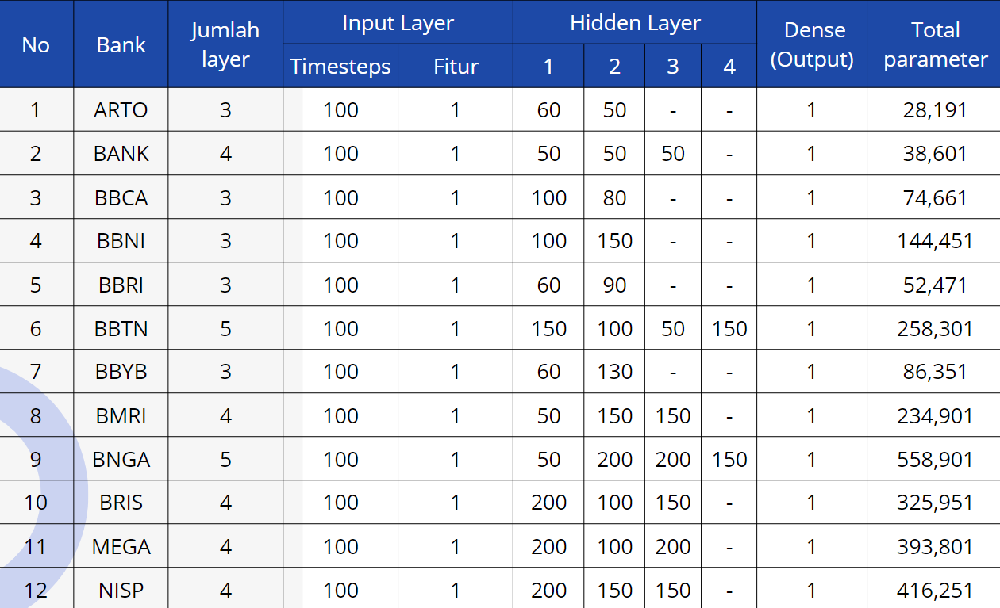

In [ ]:
# Path ke file di Google Drive
image_path = '/content/drive/MyDrive/Tabel Model.png'
# Menampilkan foto dari Google Drive
display(Image(filename=image_path))

Model-model tersebut menghasilkan error sebesar:

**Bank Jago (ARTO)**:

    - RMSE of gru: 125.09832787957707
    - MAPE of gru: 3.1207640285666147

**Bank Aladin Syariah (BANK)**:

    - RMSE of gru: 40.973955382861554
    - MAPE of gru: 2.669262087235768

**Bank Central Asia (BBCA)**:

    - RMSE of GRU: 102.15549359192005
    - MAPE of GRU: 0.8871233526273846

**Bank Negara Indonesia (BBNI)**:

    - RMSE of GRU: 64.40996848630262
    - MAPE of GRU: 1.0318176725502963

**Bank Rakyat Indonesia (BBRI)**:

    - RMSE of gru: 75.40549319309066
    - MAPE of gru: 1.1954905663470743

**Bank Tabungan Negara (BBTN)**:

    - RMSE of gru: 22.95529564917089
    - MAPE of gru: 1.2772993758368423

**Bank Neo Commerce (BBYB)**:

    - RMSE of GRU: 28.411036957858418
    - MAPE of GRU: 4.01910757334151

**Bank Mandiri (BMRI)**:

    - RMSE of gru: 161.63399083147084
    - MAPE of gru: 2.2939338276165797

**Bank CIMB Niaga (BNGA)**:

    - RMSE of gru: 53.456580014414186
    - MAPE of gru: 2.419101213357724

**Bank Syariah Indonesia (BRIS)**:

    - RMSE of gru: 70.31893879870066
    - MAPE of gru: 3.198899955260883

**Bank MEGA (MEGA)**:

    - RMSE of gru: 100.78737972932925
    - MAPE of gru: 1.2096643898410382

**Bank OCBC NISP (NISP)**:

    - RMSE of gru: 42.16434008350971
    - MAPE of gru: 2.884840236281357

Kemudian dengan model terbaik, dilakukan prediksi harga saham 30 hari ke depan sejak data terakhir (18 April 2024). Selanjutnya dihitung persentase pergerakan harga sahamnya yaitu selisih harga saham hari terakhir prediksi dengan harga saham terakhir data asli, dibagi harga saham terakhir data asli, dan dikalikan dengan 100. Berikut adalah 4 bank dengan pergerakan harga saham terbaik.

In [ ]:
# Melihat 4 saham terbaik berdasarkan fundamental
df_results_sorted3[['Bank','Pergerakan Saham', 'Label Technical']].head(4)

,Bank,Pergerakan Saham,Label Technical
0,BANK,7.324747,Good
1,MEGA,5.477748,Good
2,BRIS,5.456186,Good
3,BBNI,0.744666,Good


Berdasarkan Technical Analysis yang telah dilakukan, diperoleh 4 bank yang memiliki pergerakan saham terbesar yaitu bank Aladin Syariah, bank MEGA, Bank Syariah Indonesia (BSI), dan Bank Negara Indonesia. Hal ini berarti bahwa dalam 30 hari sejak 18 April 2024, ke-empat harga saham bank tersebut diprediksi akan meningkat sebesar persentase yang ditampilkan di atas (kolom pergerakan saham).

## Rekomendasi Bank Terbaik untuk Investasi

In [ ]:
# Melihat 4 saham terbaik untuk investasi berdasarkan fundamental & technical analysis
print("4 Saham Terbaik untuk Diinvestasi Secara Keseluruhan:")
df_results_sorted[['Bank','Total Score','Total Score (0-5)']].head(4)

4 Saham Terbaik untuk Diinvestasi Secara Keseluruhan:


,Bank,Total Score,Total Score (0-5)
0,MEGA,97.510000,4.88
1,BBCA,90.621560,4.53
2,BRIS,85.271395,4.26
3,BBRI,84.555026,4.23


Berdasarkan Fundamental & Technical Analysis yang telah dilakukan, diperoleh 4 bank dengan fundamental & pergerakan saham yang paling baik yaitu bank MEGA, Bank Central Asia (BCA), Bank Syariah Indonesia (BSI), dan Bank Rakyat Indonesia (BRI). Oleh karena itu, 4 bank tersebut merupakan bank yang paling tim Metric Mestro sarankan untuk investasi.